### Loading the dataset

In [4]:
import re
import numpy as np

with open('insurance50003p.jkl','r') as file:
    filedata = file.readlines()

    
line = filedata[6]
#print(line)
#print(re.findall(r'\d+', line))

max_parents= 3
n_nodes= 27
n_parents_set=[]
cache ={}

t=1
vertices=[]
for i in range (n_nodes):
    line = filedata[t]
    vertices.append(int(re.findall(r'\d+', line)[0]))
    t+=2953
#print(vertices)

t=1
for i in vertices :
    line = filedata[t]
    now_n_parents_set =int(re.findall(r'\d+', line)[1])
    #print(now_n_parents_set)
    n_parents_set.append(now_n_parents_set)
    now_dict= {}
    #print(filedata[t])
    for j in range(now_n_parents_set):
        now_parents=()
        for k in range (len(re.findall(r'\d+', filedata[t+j+1]))-3):
            #print(re.findall(r'\d+', filedata[t+j+1]))
            now_parents= now_parents + (int(re.findall(r'\d+', filedata[t+j+1])[k+3]),)
        #now_dict[float(filedata[t+j+1].split(' ')[0])]=now_parents
        now_parents=tuple(sorted(now_parents))
        #if now_parents==(12,18):
            #print(i)
        now_dict[now_parents]=float(filedata[t+j+1].split(' ')[0])
    cache[i]=now_dict
    t=t+now_n_parents_set+1
    

cache
#n_parents_set

{0: {(1, 2): -551.8476886532735,
  (1, 2, 15): -558.4776999102869,
  (1, 2, 13): -560.1702102419513,
  (1, 2, 11): -573.6754423787097,
  (1, 2, 21): -576.3086606707402,
  (1, 2, 24): -577.3339170706749,
  (1, 11): -577.3586068853583,
  (1, 2, 4): -578.261744415533,
  (1, 2, 18): -578.4838405977716,
  (1, 11, 15): -580.8801328140689,
  (1, 11, 13): -581.5321542797828,
  (1, 4): -584.7993105033747,
  (1, 17): -585.4971058052251,
  (1, 2, 25): -586.3334535875583,
  (1, 24): -586.344410144462,
  (1, 18): -586.898387814701,
  (1, 4, 15): -588.1539528378671,
  (1,): -588.2577223331355,
  (1, 11, 18): -588.984385242722,
  (1, 4, 13): -589.6821310604282,
  (1, 15, 18): -590.2114465440827,
  (1, 13): -590.4926032346339,
  (1, 8): -590.6377331883159,
  (1, 15, 17): -591.0539346095866,
  (1, 11, 21): -591.2025985258115,
  (1, 13, 24): -591.2245979845393,
  (1, 11, 24): -591.5207890610836,
  (1, 4, 11): -591.7396483184311,
  (1, 13, 18): -591.7718454487258,
  (1, 15): -592.3293052964145,
  (1, 4, 

### Igraph REV functions

In [6]:
import numpy as np
import igraph as ig
from tqdm import tqdm
import random
import igraph as ig
import numpy as np
from scipy.special import binom


class ScoreManager:
    def __init__(self, score_name: str):
        self.scores = read_scores_from_file(f'{score_name}.jkl')

    def P(self, M: ig.Graph):
        def f(n, G_i_count):
            return 1 / binom(n - 1, G_i_count)

        G_i_count = np.fromiter(
            map(lambda v: len(list(M.predecessors(v))), M.vs), int)

        return f(len(list(M.vs)), G_i_count).prod()

    def get_local_likelihood(self, v, pa_i, n):
        try:
            res = self.scores[v][pa_i]
        except KeyError:
            res = -np.inf

        return res

    def get_local_prior(self, v, pa_i, n):
        k = len(pa_i)

        # Use Koivisto prior
        prior = np.log(1 / binom(n, k))
        return prior

    def get_local_score(self, v, pa_i, n):
        return self.get_local_likelihood(v, pa_i, n) + self.get_local_prior(v, pa_i, n)

    def get_score(self, G: ig.Graph):
        likelihood = 0
        prior = 0

        n = len(G.vs)

        for v in G.vs:
            pi = frozenset(map(lambda x: x, G.predecessors(v)))
            local_score, local_prior = self.get_local_likelihood(
                v.index, pi, n), self.get_local_prior(v.index, pi, n)

            # If it is inf, just return
            if (local_score == -np.inf):
                return local_score, local_prior

            likelihood += local_score
            prior += local_prior

        return likelihood, prior


def R(likelihood_i, likelihood_i_p_1, prior_i, prior_i_p_1):
    if (likelihood_i_p_1 == -np.inf):
        return 0

    # Prevent overlow
    if (likelihood_i_p_1 - likelihood_i > 400):
        res = 1
    else:
        res = np.exp(likelihood_i_p_1 + prior_i_p_1 - likelihood_i - prior_i)

    return res



def sample(G: ig.Graph, N: int, additional_steps, beta, score_manager: ScoreManager, show_progress=False):
    """ Generator. 
        yields (Graph, score)
    """
    G_i: ig.Graph = G.copy()

    is_REV = 'rev' in additional_steps

    pbar = tqdm(
        range(N), bar_format='{desc}: {bar}') if show_progress else iter(lambda: True, None)

    for i in pbar:
        G_i_plus_1, step_type = propose_next(G_i, is_REV, beta, score_manager)
        likelihood_i, prior_i = score_manager.get_score(G_i)
        likelihood_i_p_1, prior_i_p_1 = score_manager.get_score(G_i_plus_1)

        #print('done')

        if (step_type == 'REV'):
            G_i, likelihood_i, prior_i = G_i_plus_1, likelihood_i_p_1, prior_i_p_1
        else:
            A = np.min(
                [1, R(likelihood_i*beta, likelihood_i_p_1*beta, prior_i, prior_i_p_1)])
            if (np.random.uniform() <= A):
                G_i, likelihood_i, prior_i = G_i_plus_1, likelihood_i_p_1, prior_i_p_1

        score = likelihood_i + prior_i
        if (show_progress):
            pbar.set_description(f'Score: {score:.2f}')
        #print('done')
        return G_i, score


def propose_next(G_i: ig.Graph, is_REV, beta, score_manager: ScoreManager):
    a, b = random.sample(list(G_i.vs), k=2)
    G_i_plus_1: ig.Graph = G_i.copy()
    #print(G_i_plus_1.is_dag(),'beginning',score_manager.get_score(G_i))
    new_edge_reversal_move = REV(beta, score_manager).new_edge_reversal_move

    if (is_REV and np.random.uniform() < 2):
        return new_edge_reversal_move(G_i_plus_1)

    if (G_i.are_connected(a, b)):
        print('remove')
        G_i_plus_1.delete_edges([(a, b)])
        #return G_i_plus_1, 'remove'
    elif (G_i.are_connected(b, a)):
        G_i_plus_1.delete_edges([(b, a)])
        G_i_plus_1.add_edges([(a, b)])
        print('reverse')
        #if G_i_plus_1.is_dag(): 
            #print('cycle')
            #print(score_manager.get_score(G_i))
            #return G_i, 'reverse'
    else:
        G_i_plus_1.add_edges([(a, b)])
        print('add')
        #if G_i_plus_1.is_dag():
            #print('cycle')
            #return G_i, 'add'
            
    if G_i_plus_1.is_dag():
        print('prime is not dag', G_i.is_dag())
        return G_i,False
    
    print(G_i_plus_1.is_dag(),'step1',score_manager.get_score(G_i_plus_1))
    likelihood_i, prior_i = score_manager.get_score(G_i)
    likelihood_i_p_1, prior_i_p_1 = score_manager.get_score(G_i_plus_1)
    
    print(likelihood_i-likelihood_i_p_1)
    A = np.min([1, R(likelihood_i*beta, likelihood_i_p_1*beta, prior_i, prior_i_p_1)])
    if (np.random.uniform() <= A):
        G_i, likelihood_i, prior_i = G_i_plus_1, likelihood_i_p_1, prior_i_p_1

    return G_i, False


import random
from matplotlib import pyplot as plt
import networkx as nx
import numpy as np
import hashlib
from itertools import chain
import igraph as ig

def read_graph_from_file(filename, random_weights=False):

    # file = open('./sample.gr', 'r')
    file = open(filename, 'r')
    G = nx.Graph()
    lines = [tuple(map(int, line.strip().split(" "))) for line in file.readlines()]
    nodes_count = lines[0][0]
    edges = lines[1:]
    
    nodes = np.arange(1, nodes_count + 1)
    G.add_nodes_from(nodes)
    for edge in edges:
        weight = np.round(np.random.normal(), 2) if random_weights else 1

        G.add_edge(edge[0], edge[1], weight=weight)
    G.add_edges_from(edges)

    return G

def read_scores_from_file(filename):
    scores = {}

    with open(filename, 'r') as file:
        n = int(next(file).strip())
        
        for _ in range(n):
            v, j_count = map(int, next(file).strip().split(" ")[:2])
            scores[v] = {}

            for _ in range(j_count):
                line = next(file).strip().split(" ")
                scores[v][frozenset(map(int, line[2:]))] = float(line[0])

    return scores

def get_graph_hash(G: nx.Graph) -> str:
    sorted_edges = sorted([tuple(edge) for edge in G.edges()])
    edges_str = str(sorted_edges)
    hash_object = hashlib.sha256()
    hash_object.update(edges_str.encode())

    return hash_object.hexdigest()
# Get the default color cycle from Matplotlib
default_colors = plt.rcParams['axes.prop_cycle'].by_key()['color']

counter = 0
# Function to get the next color from the default color cycle
def get_next_color():
    global counter
    color = default_colors[counter % len(default_colors)]
    counter += 1
    return color

# Works only for undirected
# Edit: I think should work for both
def get_graph_hash_ig(G: ig.Graph) -> str:
    sorted_edges = sorted([tuple(sorted(edge)) for edge in G.get_edgelist()])
    edges_str = str(sorted_edges)
    hash_object = hashlib.sha256()
    hash_object.update(edges_str.encode())

    return hash_object.hexdigest()
    
memo = {}

def memo_by_graph(G: nx.DiGraph, key: str, value):
    if (key not in memo):
        memo[key] = {}

def plot(G, title=""):
    _, ax = plt.subplots()
    visual_style = {}
    visual_style["vertex_label"] = list(map(lambda x: x, G.vs.indices))
    ig.plot(G, target=ax, **visual_style)
    plt.show()

def get_es_diff(G1: ig.Graph, G2: ig.Graph):
    G1_set = {e.tuple for e in G1.es}
    G2_set = {e.tuple for e in G2.es}

    both = G1_set.intersection(G2_set)
    return (G1_set - both).union(G2_set - both)

def seed(s):
    np.random.seed(s * 1 + 1)
    random.seed(s * 2 + 3)
    
    

    
import igraph as ig
import numpy as np
from scipy.special import logsumexp


class REV:
    def __init__(self, beta, score_manager: ScoreManager):
        self.score_manager = score_manager
        self.beta=beta

    # Calculates Z (18)
    def get_Z1(self, M: ig.Graph, X) -> (int, list[set]):
        parent_sets = self.score_manager.scores[X].keys()

        # Checks the descendants to find cycles
        descendants = set(M.subcomponent(X, mode="out")) - set({X})
        parent_sets = list(filter(lambda parent_set: len(
            parent_set & descendants) == 0, parent_sets))

        return self.sum_scores(X, parent_sets)* self.beta, parent_sets

    def sum_scores(self, X, parent_sets):
        if (len(parent_sets) == 0):
            return -np.inf
        scores_dict = self.score_manager.scores[X]
        scores = [scores_dict[pa] for pa in parent_sets]
        return logsumexp(scores)

    # Calculates Z (19)
    def get_Z2(self, M, Xn, Xm) -> (int, list[set]):
        parent_sets = self.score_manager.scores[Xn].keys()
        # Checks the descendants to find cycles
        descendants = set(M.subcomponent(Xn, mode="out")) - set({Xn})
        parent_sets = list(filter(lambda parent_set: self.I(parent_set, Xm) and len(
            parent_set & descendants) == 0, parent_sets))

        return self.sum_scores(Xn, parent_sets)*self.beta, parent_sets

    def orphan_nodes(self, M, nodes):
        M_prime = M.copy()
        for node in nodes:
            M_prime.delete_edges([(parent, node)
                                  for parent in M.predecessors(node)])

        return M_prime

    def I(self, pa, Xj):
        return Xj in pa

    def new_edge_reversal_move(self, G: ig.Graph):
        M = G.copy()
        n = len(M.vs)

        if (len(M.es) < 2):
            return G, False

        edge = np.random.choice(M.es)
        Xi, Xj = edge.tuple

        M_prime = self.orphan_nodes(M, [Xi, Xj])

        ## Second step, sample parent set for Xi ##
        Z2_i, parent_sets = self.get_Z2(M_prime, Xi, Xj)
        Q_i_p = np.array([self.score_manager.get_local_score(Xi, frozenset(parent_set), n) -
                          Z2_i for parent_set in parent_sets])

        # Normalize probability
        max_prob = np.max(Q_i_p)
        Q_i_p_norm = np.exp(Q_i_p - max_prob)
        Q_i_p_norm /= np.sum(Q_i_p_norm)

        new_pi = np.random.choice(parent_sets, p=Q_i_p_norm)
        M_plus = M_prime.copy()
        edges = [(parent, Xi) for parent in new_pi]
        M_plus.add_edges(edges)

        ## Third step, sample patern set pj ##
        Z1_j, parent_sets = self.get_Z1(M_plus, Xj)
        Q_j_p = np.array([self.score_manager.get_local_score(Xj, frozenset(parent_set), n) -
                          Z1_j for parent_set in parent_sets])
        max_prob = np.max(Q_j_p)
        Q_j_p_norm = np.exp(Q_j_p - max_prob)
        Q_j_p_norm /= np.sum(Q_j_p_norm)

        new_pj = np.random.choice(parent_sets, p=Q_j_p_norm)
        M_tilda = M_plus.copy()
        edges = [(parent, Xj) for parent in new_pj]
        M_tilda.add_edges(edges)

        if (np.random.uniform() < self.A(M, M_tilda, M_prime, Xi, Xj, Z2_i, Z1_j)):
            return M_tilda, 'REV'

        return G, False

    # Acceptance rate
    def A(self, M, M_tilda, M_prime, Xi, Xj, Z2_i, Z1_j):
        first = (len(M.es) / len(M_tilda.es))
        second = Z2_i - self.get_Z2(M_prime, Xj, Xi)[0]

        M_tilda_plus = self.orphan_nodes(M, [Xi])
        third = Z1_j - self.get_Z1(M_tilda_plus, Xi)[0]

        #return np.min([1, first * np.exp(second + third)])
        acceptance=np.min([0, np.log(first) + second + third])
        return np.exp(acceptance)

    
score_manager = ScoreManager('insurance50003p')  

### Functions for DAGs

In [7]:
import random

def is_dag(adjacency_matrix):
    num_nodes = adjacency_matrix.shape[0]

    # Color codes: 0 for not visited, 1 for visiting, 2 for visited
    colors = np.zeros(num_nodes, dtype=int)

    def dfs(node):
        nonlocal colors

        colors[node] = 1  # Mark the current node as visiting

        for neighbor in np.where(adjacency_matrix[node] == 1)[0]:
            if colors[neighbor] == 1:
                return False  # Found a backward edge (cycle)
            elif colors[neighbor] == 0:
                if not dfs(neighbor):
                    return False

        colors[node] = 2  # Mark the current node as visited
        return True

    # Start DFS from each unvisited node
    for node in range(num_nodes):
        if colors[node] == 0:
            if not dfs(node):
                return False  # Found a cycle

    return True  # No cycles found

def generate_random_dag_adjacency_matrix(num_nodes,max_parents):
    # Ensure a valid number of nodes
    if num_nodes <= 0:
        raise ValueError("Number of nodes must be greater than 0.")

    # Randomly order the nodes
    nodes = np.random.permutation(num_nodes)

    # Initialize an empty adjacency matrix
    adjacency_matrix = np.zeros((num_nodes, num_nodes), dtype=int)

    # Add edges to form a DAG
    for i in range(num_nodes - 1):
        # Randomly choose the number of edges from the current node
        num_edges = np.random.randint(1, num_nodes - i)

        # Randomly select nodes to connect
        target_nodes = np.random.choice(nodes[i+1:], size=num_edges, replace=False)

        # Add edges to the adjacency matrix
        adjacency_matrix[nodes[i], target_nodes] = 1

    new_dag= np.zeros((num_nodes,num_nodes),dtype=np.int8)
    for i in range (num_nodes_example):
        a=list(np.where(adjacency_matrix[:,i]==1)[0])
        b=random.randint(0,max_parents)
        c=random.sample(sorted(a), min(len(a),b))
        for j in c:
            new_dag[j,i]=1
    #is_dag(new_dag)
    #new_dag
    return new_dag


num_nodes_example = 8
random_dag_matrix = generate_random_dag_adjacency_matrix(num_nodes_example,3)

print("Random DAG Adjacency Matrix:")
print(random_dag_matrix)
print(is_dag(random_dag_matrix))

np.where(random_dag_matrix==1)

Random DAG Adjacency Matrix:
[[0 0 1 1 0 0 0 0]
 [0 0 0 0 0 0 0 0]
 [0 0 0 1 0 0 0 0]
 [0 0 0 0 0 0 0 0]
 [0 0 0 0 0 0 0 0]
 [0 0 0 1 0 0 0 1]
 [0 0 1 0 0 0 0 1]
 [0 0 1 0 0 0 0 0]]
True


(array([0, 0, 2, 5, 5, 6, 6, 7], dtype=int64),
 array([2, 3, 3, 3, 7, 2, 7, 2], dtype=int64))

### 1 step of MCMCMC

The while cycle is useless now but It may be useful if I want to handle the constraints in a different way.

In [8]:
from math import comb

def mcmcmc (dag_now_p, loglik_now_p, prior_now_p, score_now_p, heating=1):
    global score_now, dag_now, loglik_now, prior_now, retained, banned,tot_swaps

    if heating==None:
        heating=1
    
    dag0=np.copy(dag_now_p)
    
    condition=False
    n_variables=len(dag_now_p[0])
    while(condition==False):
        u=random.randint(0, n_variables-1)
        v=list(range(n_variables))
        v.remove(u)
        v=random.choice(v)
        dag1=np.copy(dag_now_p)
        if (dag_now_p[u,v]==1) :
            dag1[u,v]=0
            if retained[u,v]==1:
                dag1[u,v]=1
        elif (dag_now_p[v,u]==1):
            dag1[u,v]=1
            dag1[v,u]=0
            if ((retained[v,u]==1) or (banned[u,v]==1) or (np.sum(dag_now_p[:,v])>=max_parents)):
                dag1[u,v]=0
                dag1[v,u]=1
            if (is_dag(dag1)==False):
                dag1[u,v]=0
                dag1[v,u]=1
        elif (dag_now_p[u,v]==0 and dag_now_p[v,u]==0):
            dag1[u,v]=1
            if (banned[u,v]==1 or np.sum(dag_now_p[:,v])>=max_parents):
                dag1[u,v]=0
            if (is_dag(dag1)==False):
                dag1[u,v]=0
        condition=True

    prior_1=1
    loglik_1=0
    prior_0=1
    loglik_0=0

    for i in range(n_variables):
        prior_1= prior_1*(1/comb((n_variables-1),np.sum(dag1[:,i])))
        loglik_1+= cache[i][tuple(np.where(dag1[:,i]==1)[0])]
        prior_0= prior_0*(1/comb((n_variables-1),np.sum(dag0[:,i])))
        loglik_0+= cache[i][tuple(np.where(dag0[:,i]==1)[0])]
    prior_1=np.log(prior_1)
    prior_0=np.log(prior_0)
    
    #print(np.log(prior_1),loglik_1,np.log(prior_now_p),loglik_now_p)
    
    alpha= min(heating*(loglik_1-loglik_0)+prior_1-prior_0,0)
    #print(np.exp(alpha))
    #print((loglik_1-loglik_now_p),np.log(prior_1)-np.log(prior_now_p))
    #print(np.exp(alpha))
    #print(heating*(loglik_1-loglik_now_p)+np.log(prior_1)-np.log(prior_now_p))
    rand=random.random()
    #print(rand)


    if rand < np.exp(alpha):
        if (loglik_1-loglik_0)!=0:
            tot_swaps+=1
            #print((loglik_1-loglik_now_p),np.log(prior_1)-np.log(prior_now_p))
            #print(np.exp(alpha))
        #print('accepted')
        #print(dag_now-dag1)
        dag_now=np.copy(dag1)
        prior_now = np.copy(prior_1)
        loglik_now= np.copy(loglik_1)
        score_now= np.copy(loglik_1+prior_1)



### Main function basic structure MCMC

In [9]:
def structure_mcmc (n_variables, max_parents, n_iter, cache, prob_rev=0, seed=None, retained_adj=None, banned_adj=None):
    global score_now, dag_now, loglik_now, prior_now, retained, banned, tot_swaps

    tot_swaps=0
    random.seed(seed)
    np.random.seed(seed)

    if retained_adj==None:
        retained=np.zeros((n_variables,n_variables))
    else:
        retained= np.copy(retained_adj)


    if banned_adj==None:
        banned=np.zeros((n_variables,n_variables))
    else:
        banned= np.copy(banned_adj)

    dag_now= generate_random_dag_adjacency_matrix(n_variables,max_parents)

    dags =np.zeros((n_variables, n_variables, n_iter))
    scores=np.zeros(n_iter)

    prior_now=1
    loglik_now=0

    for i in range(n_variables):
        prior_now= prior_now*(1/comb((n_variables-1),np.sum(dag_now[:,i])))
        loglik_now+= cache[i][tuple(np.where(dag_now[:,i]==1)[0])]
    
    prior_now=np.log(prior_now)
    score_now= loglik_now+prior_now

    dags[:,:,0]=dag_now
    scores[0]=score_now

    for i in range(n_iter-1):
        if random.random() > prob_rev:
            mcmcmc(dag_now, loglik_now, prior_now, score_now)
            dags[:,:,i+1]=np.copy(dag_now)
            scores[i+1]=np.copy(score_now)
        else:
            G=ig.Graph.Adjacency(dag_now)
            G=propose_next(G, True, 1, score_manager)[0]
            dag_now=np.array(ig.Graph.get_adjacency(G).data)
            dags[:,:,i+1]=np.array(ig.Graph.get_adjacency(G).data)
            loglik_now, prior_now=score_manager.get_score(G)
            scores[i+1]= loglik_now+ prior_now

    print(tot_swaps,'swaps')

    return None,dags, scores



### Functions for parallel tempering

3.000000305263711

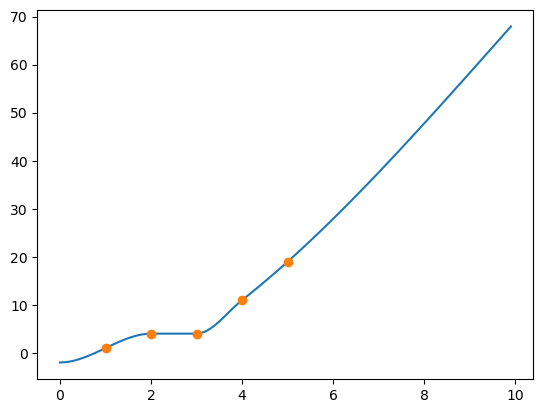

In [10]:
import scipy
import matplotlib.pyplot as plt
import splines

x=[1,2,3,4,5]
y=[1,4,4,11,19]
pchip=scipy.interpolate.PchipInterpolator(x, y, axis=0, extrapolate=None)

X=np.arange(0,10,.1)
plt.plot(X,pchip(X))
plt.plot(x,y,'o')


def bisection_at_x (f,a,b,x,max_iter=100,tol=1e-6):
    for i in range (max_iter):
        c = (a + b) / 2
        if ((f(c) == x) or ((b - a) / 2 < tol)):
            return(c)
        if (f(c)< x):
            a = c
        else:
            b = c
    return (c)

x=np.array([1,2,3,4,5])

def y(x):
    return x**2

bisection_at_x(y,1,5,3,100)**2

### DEO main function (parallel tempering)

1) t training steps are performed at the beginning to find the optimal number of chains and the values of the temperatures.

2)  outputs: \
    a) dags and scores of the posterior during the training steps(post_dags, post_scores) \
    b) dags and scores of the posterior after the training steps(final_post_dags, final_post_scores) \
    c) dags and scores of each chain after the training steps (final_dags, final_scores) \
    d) the indexes of the chains to keep track of the swaps (indexes_matrix, indexes_matrix_train)
    


In [12]:
import math
import scipy

def pt_structure_mcmc (n_variables_p, max_parents, n_iter, cache, training_iter, n_chains_p, prob_rev=.2, seed=None,retained_adj=None, banned_adj=None):
    global retained, banned, dags_now, loglik_now, prior_now, iterator, n_variables, n_chains, steps, rev_post, rev_tot, rand_steps

    random.seed(seed)
    n_variables=int(n_variables_p)
    np.random.seed(seed)

    if retained_adj==None:
        retained=np.zeros((n_variables,n_variables))
    else:
        retained= np.copy(retained_adj)

    if banned_adj==None:
        banned=np.zeros((n_variables,n_variables))
    else:
        banned= np.copy(banned_adj)

    n_variables= n_variables_p
    n_chains=n_chains_p

    chain_rej=1/(n_chains-1)
    betas=np.zeros(n_chains)
    betas[n_chains-1]=1
    for i in range (n_chains-1):
        betas[i]=chain_rej*i

    training_steps= math.log2(training_iter)
    training_list= []
    training_counter=0
    for i in range (int(training_steps-2)):
        training_list.append(2**(i+1))
        training_counter+=2**(i+1)
    training_list.append(training_iter-training_counter)

    dags_now= np.zeros((n_variables,n_variables,n_chains),dtype=np.int8)
    loglik_now=np.zeros((n_chains))
    prior_now= np.zeros((n_chains))
    post_scores=  np.zeros(training_iter)
    post_dags= np.zeros((n_variables,n_variables,training_iter),dtype=np.int8)
    indexes_matrix_train=np.zeros((n_chains,training_iter))
    indexes_matrix_train[:,0]=np.array(list(range(n_chains)))


    for i in range(n_chains):
        dags_now[:,:,i]= generate_random_dag_adjacency_matrix(n_variables,max_parents)
        #print(is_dag( dags_now[:,:,i]))

    for j in range (n_chains):
        prior_t=1
        loglik_t=0
        for i in range(n_variables):
            #print(i)
            prior_t= prior_t*(1/math.comb((n_variables-1),int(np.sum(dags_now[:,i,j]))))
            loglik_t+= cache[i][tuple(np.where(dags_now[:,i,j]==1)[0])]
        prior_t=np.log(prior_t)
        prior_now[j]= prior_t
        loglik_now[j]= loglik_t

    steps=0
    counter=0
    rev_post=0
    rev_tot=0

    for i in training_list:
        r=np.zeros(n_chains)
        for k in range(i):
            for j in range (n_chains):
                iterator=j

                if random.random() > prob_rev:
                    pt_mcmcmc (dags_now, loglik_now, prior_now, betas[j])
                else:
                    G=ig.Graph.Adjacency(dags_now[:,:,j])
                    G=propose_next(G, True, betas[j], score_manager)[0]
                    dags_now[:,:,j]=np.array(ig.Graph.get_adjacency(G).data)
                    loglik_now[j], prior_now[j]=score_manager.get_score(G)
                    #print (loglik_now[j], prior_now[j])

            for j in range (n_chains-1):
                alpha= np.exp(min((loglik_now[j]-loglik_now[j+1])*(betas[j+1]-betas[j]),0))
                if alpha== np.nan:
                    alpha=0
                #print(alpha,j)
                r[j+1]+=(1-alpha)
                accepted= np.random.binomial(1, alpha, 1)
                #accepted=0
                if accepted==1 :
                    if (((j%2+k%2)==0) or ((j%2+k%2)==2)):
                        #print('swap',j)
                        ind1=np.copy(indexes_matrix_train[j,counter])
                        ind2=np.copy(indexes_matrix_train[j+1,counter])
                        indexes_matrix_train[j,counter]=ind2
                        indexes_matrix_train[j+1,counter]=ind1
                        d1=np.copy(dags_now[:,:,j])
                        d2=np.copy(dags_now[:,:,j+1])
                        dags_now[:,:,j+1]=d1
                        dags_now[:,:,j]=d2
                        l1=np.copy(loglik_now[j])
                        l2=np.copy(loglik_now[j+1])
                        loglik_now[j+1]=l1
                        loglik_now[j]=l2
                        p1=np.copy(prior_now[j])
                        p2=np.copy(prior_now[j+1])
                        prior_now[j+1]=p1
                        prior_now[j]=p2

            #print('after swap')
            #print(loglik_now)

            post_dags[:,:,counter]=dags_now[:,:,n_chains-1]
            post_scores[counter]=loglik_now[n_chains-1]+prior_now[n_chains-1]
            counter+=1
            if counter <training_iter:
                indexes_matrix_train[:,counter]=np.copy(indexes_matrix_train[:,counter-1])

            #print(dags_now[:,:,49]-dags_now[:,:,48])
        #print('post',loglik_now[-1]+prior_now[-1])
        r=r/(k+1)
        arr_lambda= np.cumsum(r)
        #print(arr_lambda)
        #print(betas)
        lambda_1=arr_lambda[-1]
        r_star=lambda_1/(n_chains-1)

        pchip=scipy.interpolate.PchipInterpolator(betas, arr_lambda, axis=0, extrapolate=None)
        X=np.arange(0,1,.001)
        plt.plot(X,pchip(X))
        plt.show()

        #print(betas,'betas_before')

        for j in range (n_chains):
            betas[j]=bisection_at_x(pchip,0,1,r_star*j)
        #print(betas)
        betas[0]=0
        betas[n_chains-1]=1
        #print(betas,'betas_after')

    print(steps,'steps')

    n_chains= int(2*lambda_1)
    r_star= lambda_1/(n_chains-1)
    betas= np.zeros(n_chains)
    for j in range (n_chains):
        betas[j]=bisection_at_x(pchip,0,1,r_star*j)
    betas[n_chains-1]=1
    betas[0]=0

    print('betas',betas)
    print('n_chains', n_chains)

    final_scores=  np.zeros((n_chains, n_iter))
    final_dags= np.zeros((n_variables,n_variables, n_chains, n_iter),dtype=np.int8)
    final_post_scores= np.zeros(n_iter)
    final_post_dags= np.zeros((n_variables, n_variables, n_iter),dtype=np.int8)
    indexes_matrix=np.zeros((n_chains,n_iter))
    indexes_matrix[:,0]=np.array(list(range(n_chains)))


    dags_now= dags_now[:,:,-n_chains:]
    loglik_now=loglik_now[-n_chains:]
    prior_now= prior_now[-n_chains:]

    #steps=0
    rev_post=0
    rev_tot=0

    counter=0
    r=np.zeros(n_chains)
    for k in range(n_iter):
        for j in range (n_chains):
            iterator=j
            if random.random() > prob_rev:
                pt_mcmcmc (dags_now, loglik_now, prior_now, betas[j])
            else:
                G=ig.Graph.Adjacency(dags_now[:,:,j])
                G=propose_next(G, True, betas[j], score_manager)[0]
                dags_now[:,:,j]=np.array(ig.Graph.get_adjacency(G).data)
                loglik_now[j], prior_now[j]=score_manager.get_score(G)
                #print (loglik_now[j], prior_now[j])
                #if prior_now[j]== np.nan:
                #   print('nan')

        
        #print ('before_swap',loglik_now, prior_now)
        for j in range (n_chains-1):
            alpha= np.exp(min((loglik_now[j]-loglik_now[j+1])*(betas[j+1]-betas[j]),0))
            if alpha== np.nan:
                alpha=0
            #print(alpha,j)
            r[j+1]+=(1-alpha)
            accepted= np.random.binomial(1, alpha, 1)
            #accepted=0
            
            if accepted==1 :
                #print('before swap', loglik_now)
                if (((j%2+k%2)==0) or ((j%2+k%2)==2)):
                    #print('swap',j)
                    ind1=np.copy(indexes_matrix[j,k])
                    ind2=np.copy(indexes_matrix[j+1,k])
                    indexes_matrix[j,k]=ind2
                    indexes_matrix[j+1,k]=ind1
                    d1=np.copy(dags_now[:,:,j])
                    d2=np.copy(dags_now[:,:,j+1])
                    dags_now[:,:,j+1]=d1
                    dags_now[:,:,j]=d2
                    l1=np.copy(loglik_now[j])
                    l2=np.copy(loglik_now[j+1])
                    loglik_now[j+1]=l1
                    loglik_now[j]=l2
                    p1=np.copy(prior_now[j])
                    p2=np.copy(prior_now[j+1])
                    prior_now[j+1]=p1
                    prior_now[j]=p2
                    #print('after swap', loglik_now)
        #print ('after_swap',loglik_now, prior_now)
        
        #print(loglik_now)

        for j in range (n_chains):
            #if prior_now[j]== np.nan:
                #print('nan')
            final_scores[j,k]=loglik_now[j]+prior_now[j]
            final_dags[:,:,j,k]=dags_now[:,:,j]
            #print(loglik_now[j]+np.log(prior_now[j]),loglik_now[j],np.log(prior_now[j]))
            if j==(n_chains-1):
                final_post_dags[:,:,k]=dags_now[:,:,j]
                final_post_scores[k]=loglik_now[j]+prior_now[j]
                #print('post',final_post_scores[k])
        if k <(n_iter-1):
                indexes_matrix[:,k+1]=np.copy(indexes_matrix[:,k])

        counter+=1

        if k%3000==0:
            r=r/(counter)
            arr_lambda= np.cumsum(r)
            #print(arr_lambda)
            #print(betas)
            lambda_1=arr_lambda[-1]
            r_star=lambda_1/(n_chains-1)

            print(betas,'betas')
            print(r,'r')
            print(loglik_now[-1]+prior_now[-1],'score post')

            pchip=scipy.interpolate.PchipInterpolator(betas, arr_lambda, axis=0, extrapolate=None)
            X=np.arange(0,1,.001)
            plt.plot(X,pchip(X))
            plt.show()

            #print(betas,'betas_before')

            for j in range (n_chains):
                betas[j]=bisection_at_x(pchip,0,1,r_star*j)
            #print(betas)
            betas[0]=0
            betas[n_chains-1]=1

            r=np.zeros(n_chains)
            counter=0



    #r=r/(k+1)
    #print('r',r)
    #arr_lambda= np.cumsum(r)
    #lambda_1=arr_lambda[-1]
    #r_star=lambda_1/(n_chains-1)

    #pchip=scipy.interpolate.PchipInterpolator(betas, arr_lambda, axis=0, extrapolate=None)
    #X=np.arange(0,1,.001)
    #plt.plot(X,pchip(X))
    #plt.show()

    print(steps,'steps_after')
    #print(rev_post,'rev_post')
    #print(rev_tot,'rev_tot')
    
    tot_post=np.concatenate([post_scores,final_post_scores])
    
    return tot_post, final_post_dags, final_post_scores, final_dags, final_scores, post_dags, post_scores, indexes_matrix, indexes_matrix_train


### SEO main function

In [12]:
import math
import scipy

def seo_structure_mcmc (n_variables_p, max_parents, n_iter, cache, training_iter, n_chains_p, prob_rev=.2, seed=None,retained_adj=None, banned_adj=None):
    global retained, banned, dags_now, loglik_now, prior_now, iterator, n_variables, n_chains, steps, rev_post, rev_tot, rand_steps

    random.seed(seed)
    n_variables=int(n_variables_p)
    np.random.seed(seed)

    if retained_adj==None:
        retained=np.zeros((n_variables,n_variables))
    else:
        retained= np.copy(retained_adj)

    if banned_adj==None:
        banned=np.zeros((n_variables,n_variables))
    else:
        banned= np.copy(banned_adj)

    n_variables= n_variables_p
    n_chains=n_chains_p

    chain_rej=1/(n_chains-1)
    betas=np.zeros(n_chains)
    betas[n_chains-1]=1
    for i in range (n_chains-1):
        betas[i]=chain_rej*i

    training_steps= math.log2(training_iter)
    training_list= []
    training_counter=0
    for i in range (int(training_steps-2)):
        training_list.append(2**(i+1))
        training_counter+=2**(i+1)
    training_list.append(training_iter-training_counter)

    dags_now= np.zeros((n_variables,n_variables,n_chains),dtype=np.int8)
    loglik_now=np.zeros((n_chains))
    prior_now= np.zeros((n_chains))
    post_scores=  np.zeros(training_iter)
    post_dags= np.zeros((n_variables,n_variables,training_iter),dtype=np.int8)
    indexes_matrix_train=np.zeros((n_chains,training_iter))
    indexes_matrix_train[:,0]=np.array(list(range(n_chains)))


    for i in range(n_chains):
        dags_now[:,:,i]= generate_random_dag_adjacency_matrix(n_variables,max_parents)

    for j in range (n_chains):
        prior_t=1
        loglik_t=0
        for i in range(n_variables):
            prior_t= prior_t*(1/math.comb((n_variables-1),int(np.sum(dags_now[:,i,j]))))
            loglik_t+= cache[i][tuple(np.where(dags_now[:,i,j]==1)[0])]
        prior_t=np.log(prior_t)
        prior_now[j]= prior_t
        loglik_now[j]= loglik_t

    steps=0
    counter=0
    rev_post=0
    rev_tot=0

    for i in training_list:
        r=np.zeros(n_chains)
        for k in range(i):
            
            K=random.random()
            if K<.5:
                K=1
            else:
                K=2
                
            for j in range (n_chains):
                iterator=j

                if random.random() > prob_rev:
                    pt_mcmcmc (dags_now, loglik_now, prior_now, betas[j])
                else:
                    G=ig.Graph.Adjacency(dags_now[:,:,j])
                    G=propose_next(G, True, betas[j], score_manager)[0]
                    dags_now[:,:,j]=np.array(ig.Graph.get_adjacency(G).data)
                    loglik_now[j], prior_now[j]=score_manager.get_score(G)
                    #print (loglik_now[j], prior_now[j])

            for j in range (n_chains-1):
                alpha= np.exp(min((loglik_now[j]-loglik_now[j+1])*(betas[j+1]-betas[j]),0))
                if alpha== np.nan:
                    alpha=0
                #print(alpha,j)
                r[j+1]+=(1-alpha)
                accepted= np.random.binomial(1, alpha, 1)
                #accepted=0
                if accepted==1 :
                    if (((j%2+K%2)==0) or ((j%2+K%2)==2)):
                        #print('swap',j)
                        ind1=np.copy(indexes_matrix_train[j,counter])
                        ind2=np.copy(indexes_matrix_train[j+1,counter])
                        indexes_matrix_train[j,counter]=ind2
                        indexes_matrix_train[j+1,counter]=ind1
                        d1=np.copy(dags_now[:,:,j])
                        d2=np.copy(dags_now[:,:,j+1])
                        dags_now[:,:,j+1]=d1
                        dags_now[:,:,j]=d2
                        l1=np.copy(loglik_now[j])
                        l2=np.copy(loglik_now[j+1])
                        loglik_now[j+1]=l1
                        loglik_now[j]=l2
                        p1=np.copy(prior_now[j])
                        p2=np.copy(prior_now[j+1])
                        prior_now[j+1]=p1
                        prior_now[j]=p2

            #print('after swap')
            #print(loglik_now)

            post_dags[:,:,counter]=dags_now[:,:,n_chains-1]
            post_scores[counter]=loglik_now[n_chains-1]+prior_now[n_chains-1]
            counter+=1
            if counter <training_iter:
                indexes_matrix_train[:,counter]=np.copy(indexes_matrix_train[:,counter-1])

            #print(dags_now[:,:,49]-dags_now[:,:,48])
        #print('post',loglik_now[-1]+prior_now[-1])
        r=r/(k+1)
        arr_lambda= np.cumsum(r)
        #print(arr_lambda)
        #print(betas)
        lambda_1=arr_lambda[-1]
        r_star=lambda_1/(n_chains-1)

        pchip=scipy.interpolate.PchipInterpolator(betas, arr_lambda, axis=0, extrapolate=None)
        X=np.arange(0,1,.001)
        plt.plot(X,pchip(X))
        plt.show()

        #print(betas,'betas_before')

        for j in range (n_chains):
            betas[j]=bisection_at_x(pchip,0,1,r_star*j)
        #print(betas)
        betas[0]=0
        betas[n_chains-1]=1
        #print(betas,'betas_after')

    print(steps,'steps')

    n_chains= int(2*lambda_1)
    r_star= lambda_1/(n_chains-1)
    betas= np.zeros(n_chains)
    for j in range (n_chains):
        betas[j]=bisection_at_x(pchip,0,1,r_star*j)
    betas[n_chains-1]=1
    betas[0]=0

    print('betas',betas)
    print('n_chains', n_chains)

    final_scores=  np.zeros((n_chains, n_iter))
    final_dags= np.zeros((n_variables,n_variables, n_chains, n_iter),dtype=np.int8)
    final_post_scores= np.zeros(n_iter)
    final_post_dags= np.zeros((n_variables, n_variables, n_iter),dtype=np.int8)
    indexes_matrix=np.zeros((n_chains,n_iter))
    indexes_matrix[:,0]=np.array(list(range(n_chains)))


    dags_now= dags_now[:,:,-n_chains:]
    loglik_now=loglik_now[-n_chains:]
    prior_now= prior_now[-n_chains:]

    #steps=0
    rev_post=0
    rev_tot=0

    counter=0
    r=np.zeros(n_chains)
    for k in range(n_iter):
        K=random.random()
        if K<.5:
            K=1
        else:
            K=2
        
        for j in range (n_chains):
            iterator=j
            if random.random() > prob_rev:
                pt_mcmcmc (dags_now, loglik_now, prior_now, betas[j])
            else:
                G=ig.Graph.Adjacency(dags_now[:,:,j])
                G=propose_next(G, True, betas[j], score_manager)[0]
                dags_now[:,:,j]=np.array(ig.Graph.get_adjacency(G).data)
                loglik_now[j], prior_now[j]=score_manager.get_score(G)
                #print (loglik_now[j], prior_now[j])
                #if prior_now[j]== np.nan:
                #   print('nan')

        
        #print ('before_swap',loglik_now, prior_now)
        for j in range (n_chains-1):
            alpha= np.exp(min((loglik_now[j]-loglik_now[j+1])*(betas[j+1]-betas[j]),0))
            if alpha== np.nan:
                alpha=0
            #print(alpha,j)
            r[j+1]+=(1-alpha)
            accepted= np.random.binomial(1, alpha, 1)
            #accepted=0
            
            if accepted==1 :
                #print('before swap', loglik_now)
                if (((j%2+K%2)==0) or ((j%2+K%2)==2)):
                    #print('swap',j)
                    ind1=np.copy(indexes_matrix[j,k])
                    ind2=np.copy(indexes_matrix[j+1,k])
                    indexes_matrix[j,k]=ind2
                    indexes_matrix[j+1,k]=ind1
                    d1=np.copy(dags_now[:,:,j])
                    d2=np.copy(dags_now[:,:,j+1])
                    dags_now[:,:,j+1]=d1
                    dags_now[:,:,j]=d2
                    l1=np.copy(loglik_now[j])
                    l2=np.copy(loglik_now[j+1])
                    loglik_now[j+1]=l1
                    loglik_now[j]=l2
                    p1=np.copy(prior_now[j])
                    p2=np.copy(prior_now[j+1])
                    prior_now[j+1]=p1
                    prior_now[j]=p2
                    #print('after swap', loglik_now)
        #print ('after_swap',loglik_now, prior_now)
        
        #print(loglik_now)

        for j in range (n_chains):
            #if prior_now[j]== np.nan:
                #print('nan')
            final_scores[j,k]=loglik_now[j]+prior_now[j]
            final_dags[:,:,j,k]=dags_now[:,:,j]
            #print(loglik_now[j]+np.log(prior_now[j]),loglik_now[j],np.log(prior_now[j]))
            if j==(n_chains-1):
                final_post_dags[:,:,k]=dags_now[:,:,j]
                final_post_scores[k]=loglik_now[j]+prior_now[j]
                #print('post',final_post_scores[k])
        if k <(n_iter-1):
                indexes_matrix[:,k+1]=np.copy(indexes_matrix[:,k])

        counter+=1

        if k%3000==0:
            r=r/(counter)
            arr_lambda= np.cumsum(r)
            #print(arr_lambda)
            #print(betas)
            lambda_1=arr_lambda[-1]
            r_star=lambda_1/(n_chains-1)

            print(betas,'betas')
            print(r,'r')
            print(loglik_now[-1]+prior_now[-1],'score post')

            pchip=scipy.interpolate.PchipInterpolator(betas, arr_lambda, axis=0, extrapolate=None)
            X=np.arange(0,1,.001)
            plt.plot(X,pchip(X))
            plt.show()

            #print(betas,'betas_before')

            for j in range (n_chains):
                betas[j]=bisection_at_x(pchip,0,1,r_star*j)
            #print(betas)
            betas[0]=0
            betas[n_chains-1]=1

            r=np.zeros(n_chains)
            counter=0



    #r=r/(k+1)
    #print('r',r)
    #arr_lambda= np.cumsum(r)
    #lambda_1=arr_lambda[-1]
    #r_star=lambda_1/(n_chains-1)

    #pchip=scipy.interpolate.PchipInterpolator(betas, arr_lambda, axis=0, extrapolate=None)
    #X=np.arange(0,1,.001)
    #plt.plot(X,pchip(X))
    #plt.show()

    print(steps,'steps_after')
    #print(rev_post,'rev_post')
    #print(rev_tot,'rev_tot')
    
    tot_post=np.concatenate([post_scores,final_post_scores])
    
    return tot_post, final_post_dags, final_post_scores, final_dags, final_scores, post_dags, post_scores, indexes_matrix, indexes_matrix_train


### Random swap PT main function

In [13]:
import math
import scipy

def rand_pt_structure_mcmc (n_variables_p, max_parents, n_iter, cache, training_iter, n_chains_p, prob_rev=.2, seed=None,retained_adj=None, banned_adj=None):
    global retained, banned, dags_now, loglik_now, prior_now, iterator, n_variables, n_chains, steps, rev_post, rev_tot, rand_steps

    random.seed(seed)
    n_variables=int(n_variables_p)
    np.random.seed(seed)

    if retained_adj==None:
        retained=np.zeros((n_variables,n_variables))
    else:
        retained= np.copy(retained_adj)

    if banned_adj==None:
        banned=np.zeros((n_variables,n_variables))
    else:
        banned= np.copy(banned_adj)

    n_variables= n_variables_p
    n_chains=n_chains_p

    chain_rej=1/(n_chains-1)
    betas=np.zeros(n_chains)
    betas[n_chains-1]=1
    for i in range (n_chains-1):
        betas[i]=chain_rej*i

    training_steps= math.log2(training_iter)
    training_list= []
    training_counter=0
    for i in range (int(training_steps-2)):
        training_list.append(2**(i+1))
        training_counter+=2**(i+1)
    training_list.append(training_iter-training_counter)

    dags_now= np.zeros((n_variables,n_variables,n_chains),dtype=np.int8)
    loglik_now=np.zeros((n_chains))
    prior_now= np.zeros((n_chains))
    post_scores=  np.zeros(training_iter)
    post_dags= np.zeros((n_variables,n_variables,training_iter),dtype=np.int8)
    indexes_matrix_train=np.zeros((n_chains,training_iter))
    indexes_matrix_train[:,0]=np.array(list(range(n_chains)))


    for i in range(n_chains):
        dags_now[:,:,i]= generate_random_dag_adjacency_matrix(n_variables,max_parents)

    for j in range (n_chains):
        prior_t=1
        loglik_t=0
        for i in range(n_variables):
            prior_t= prior_t*(1/math.comb((n_variables-1),int(np.sum(dags_now[:,i,j]))))
            loglik_t+= cache[i][tuple(np.where(dags_now[:,i,j]==1)[0])]
        prior_t=np.log(prior_t)
        prior_now[j]= prior_t
        loglik_now[j]= loglik_t

    steps=0
    counter=0
    rev_post=0
    rev_tot=0

    for i in training_list:
        r=np.zeros(n_chains)
        for k in range(i):
            
            for j in range (n_chains):
                iterator=j

                if random.random() > prob_rev:
                    pt_mcmcmc (dags_now, loglik_now, prior_now, betas[j])
                else:
                    G=ig.Graph.Adjacency(dags_now[:,:,j])
                    G=propose_next(G, True, betas[j], score_manager)[0]
                    dags_now[:,:,j]=np.array(ig.Graph.get_adjacency(G).data)
                    loglik_now[j], prior_now[j]=score_manager.get_score(G)
                    #print (loglik_now[j], prior_now[j])

            for j in range (n_chains-1):
                alpha= np.exp(min((loglik_now[j]-loglik_now[j+1])*(betas[j+1]-betas[j]),0))
                if alpha== np.nan:
                    alpha=0
                #print(alpha,j)
                r[j+1]+=(1-alpha)
                accepted= np.random.binomial(1, alpha, 1)
                #accepted=0
        
                if accepted==1 :
                    K=random.random()
                    if (K<.5):
                        #print('swap',j)
                        ind1=np.copy(indexes_matrix_train[j,counter])
                        ind2=np.copy(indexes_matrix_train[j+1,counter])
                        indexes_matrix_train[j,counter]=ind2
                        indexes_matrix_train[j+1,counter]=ind1
                        d1=np.copy(dags_now[:,:,j])
                        d2=np.copy(dags_now[:,:,j+1])
                        dags_now[:,:,j+1]=d1
                        dags_now[:,:,j]=d2
                        l1=np.copy(loglik_now[j])
                        l2=np.copy(loglik_now[j+1])
                        loglik_now[j+1]=l1
                        loglik_now[j]=l2
                        p1=np.copy(prior_now[j])
                        p2=np.copy(prior_now[j+1])
                        prior_now[j+1]=p1
                        prior_now[j]=p2

            #print('after swap')
            #print(loglik_now)

            post_dags[:,:,counter]=dags_now[:,:,n_chains-1]
            post_scores[counter]=loglik_now[n_chains-1]+prior_now[n_chains-1]
            counter+=1
            if counter <training_iter:
                indexes_matrix_train[:,counter]=np.copy(indexes_matrix_train[:,counter-1])

            #print(dags_now[:,:,49]-dags_now[:,:,48])
        #print('post',loglik_now[-1]+prior_now[-1])
        r=r/(k+1)
        arr_lambda= np.cumsum(r)
        #print(arr_lambda)
        #print(betas)
        lambda_1=arr_lambda[-1]
        r_star=lambda_1/(n_chains-1)

        pchip=scipy.interpolate.PchipInterpolator(betas, arr_lambda, axis=0, extrapolate=None)
        X=np.arange(0,1,.001)
        plt.plot(X,pchip(X))
        plt.show()

        #print(betas,'betas_before')

        for j in range (n_chains):
            betas[j]=bisection_at_x(pchip,0,1,r_star*j)
        #print(betas)
        betas[0]=0
        betas[n_chains-1]=1
        #print(betas,'betas_after')

    print(steps,'steps')

    n_chains= int(2*lambda_1)
    r_star= lambda_1/(n_chains-1)
    betas= np.zeros(n_chains)
    for j in range (n_chains):
        betas[j]=bisection_at_x(pchip,0,1,r_star*j)
    betas[n_chains-1]=1
    betas[0]=0

    print('betas',betas)
    print('n_chains', n_chains)

    final_scores=  np.zeros((n_chains, n_iter))
    final_dags= np.zeros((n_variables,n_variables, n_chains, n_iter),dtype=np.int8)
    final_post_scores= np.zeros(n_iter)
    final_post_dags= np.zeros((n_variables, n_variables, n_iter),dtype=np.int8)
    indexes_matrix=np.zeros((n_chains,n_iter))
    indexes_matrix[:,0]=np.array(list(range(n_chains)))


    dags_now= dags_now[:,:,-n_chains:]
    loglik_now=loglik_now[-n_chains:]
    prior_now= prior_now[-n_chains:]

    #steps=0
    rev_post=0
    rev_tot=0

    counter=0
    r=np.zeros(n_chains)
    for k in range(n_iter):
        
        for j in range (n_chains):
            iterator=j
            if random.random() > prob_rev:
                pt_mcmcmc (dags_now, loglik_now, prior_now, betas[j])
            else:
                G=ig.Graph.Adjacency(dags_now[:,:,j])
                G=propose_next(G, True, betas[j], score_manager)[0]
                dags_now[:,:,j]=np.array(ig.Graph.get_adjacency(G).data)
                loglik_now[j], prior_now[j]=score_manager.get_score(G)
                #print (loglik_now[j], prior_now[j])
                #if prior_now[j]== np.nan:
                #   print('nan')

        
        #print ('before_swap',loglik_now, prior_now)
        for j in range (n_chains-1):
            alpha= np.exp(min((loglik_now[j]-loglik_now[j+1])*(betas[j+1]-betas[j]),0))
            if alpha== np.nan:
                alpha=0
            #print(alpha,j)
            r[j+1]+=(1-alpha)
            accepted= np.random.binomial(1, alpha, 1)
            #accepted=0
            
            if accepted==1 :
                K=random.random()
                #print('before swap', loglik_now)
                if (K<.5):
                    #print('swap',j)
                    ind1=np.copy(indexes_matrix[j,k])
                    ind2=np.copy(indexes_matrix[j+1,k])
                    indexes_matrix[j,k]=ind2
                    indexes_matrix[j+1,k]=ind1
                    d1=np.copy(dags_now[:,:,j])
                    d2=np.copy(dags_now[:,:,j+1])
                    dags_now[:,:,j+1]=d1
                    dags_now[:,:,j]=d2
                    l1=np.copy(loglik_now[j])
                    l2=np.copy(loglik_now[j+1])
                    loglik_now[j+1]=l1
                    loglik_now[j]=l2
                    p1=np.copy(prior_now[j])
                    p2=np.copy(prior_now[j+1])
                    prior_now[j+1]=p1
                    prior_now[j]=p2
                    #print('after swap', loglik_now)
        #print ('after_swap',loglik_now, prior_now)
        
        #print(loglik_now)

        for j in range (n_chains):
            #if prior_now[j]== np.nan:
                #print('nan')
            final_scores[j,k]=loglik_now[j]+prior_now[j]
            final_dags[:,:,j,k]=dags_now[:,:,j]
            #print(loglik_now[j]+np.log(prior_now[j]),loglik_now[j],np.log(prior_now[j]))
            if j==(n_chains-1):
                final_post_dags[:,:,k]=dags_now[:,:,j]
                final_post_scores[k]=loglik_now[j]+prior_now[j]
                #print('post',final_post_scores[k])
        if k <(n_iter-1):
                indexes_matrix[:,k+1]=np.copy(indexes_matrix[:,k])

        counter+=1

        if k%3000==0:
            r=r/(counter)
            arr_lambda= np.cumsum(r)
            #print(arr_lambda)
            #print(betas)
            lambda_1=arr_lambda[-1]
            r_star=lambda_1/(n_chains-1)

            print(betas,'betas')
            print(r,'r')
            print(loglik_now[-1]+prior_now[-1],'score post')

            pchip=scipy.interpolate.PchipInterpolator(betas, arr_lambda, axis=0, extrapolate=None)
            X=np.arange(0,1,.001)
            plt.plot(X,pchip(X))
            plt.show()

            #print(betas,'betas_before')

            for j in range (n_chains):
                betas[j]=bisection_at_x(pchip,0,1,r_star*j)
            #print(betas)
            betas[0]=0
            betas[n_chains-1]=1

            r=np.zeros(n_chains)
            counter=0



    #r=r/(k+1)
    #print('r',r)
    #arr_lambda= np.cumsum(r)
    #lambda_1=arr_lambda[-1]
    #r_star=lambda_1/(n_chains-1)

    #pchip=scipy.interpolate.PchipInterpolator(betas, arr_lambda, axis=0, extrapolate=None)
    #X=np.arange(0,1,.001)
    #plt.plot(X,pchip(X))
    #plt.show()

    print(steps,'steps_after')
    #print(rev_post,'rev_post')
    #print(rev_tot,'rev_tot')
    
    tot_post=np.concatenate([post_scores,final_post_scores])
    
    return tot_post, final_post_dags, final_post_scores, final_dags, final_scores, post_dags, post_scores, indexes_matrix, indexes_matrix_train


### Random step parallel temprering

In [91]:
def pt_random (dags_now_p, loglik_now_p, prior_now_p, beta):
    global retained, banned, dags_now, loglik_now, prior_now, iterator, n_variables, n_chains, steps, rev_post, rev_tot, rand_steps

    dag0=np.copy(dags_now_p[:,:,iterator])
    
    dag1= generate_random_dag_adjacency_matrix(n_variables,max_parents)

    prior_1=1
    loglik_1=0

    prior_0=1
    loglik_0=0

    for i in range(n_variables):
        prior_1= prior_1*(1/math.comb((n_variables-1),int(np.sum(dag1[:,i]))))
        loglik_1+= cache[i][tuple(np.where(dag1[:,i]==1)[0])]
        prior_0= prior_0*(1/math.comb((n_variables-1),int(np.sum(dag0[:,i]))))
        loglik_0+= cache[i][tuple(np.where(dag0[:,i]==1)[0])]

    alpha= min(beta*(loglik_1-loglik_0)+np.log(prior_1)-np.log(prior_0),0)
    
    rand=random.random()
    
    print(np.exp(alpha),iterator)
    
    if rand < np.exp(alpha):
        if (np.sum(np.abs(dags_now_p[:,:,iterator]-dag1))!=0) :
            steps+=1

        dags_now[:,:,iterator]=np.copy(dag1)
        prior_now[iterator] = prior_1
        loglik_now[iterator]= loglik_1
        #print(dags_now)

### MCMCMC step parallel tempering

In [14]:
def pt_mcmcmc (dags_now_p, loglik_now_p, prior_now_p, beta):
    global retained, banned, dags_now, loglik_now, prior_now, iterator, n_variables, n_chains, steps, rev_post, rev_tot, rand_steps

    condition=False
    while(condition==False):
        u=random.randint(0, n_variables-1)
        v=list(range(n_variables))
        v.remove(u)
        v=random.choice(v)
        dag1=np.copy(dags_now_p[:,:,iterator])
        if (dags_now_p[u,v,iterator]==1) :
            dag1[u,v]=0
            if retained[u,v]==1:
                dag1[u,v]=1
                #continue
        elif (dags_now_p[v,u,iterator]==1):
            dag1[u,v]=1
            dag1[v,u]=0
            if ((retained[v,u]==1) or (banned[u,v]==1) or (np.sum(dags_now_p[:,v,iterator])>=max_parents)):
                dag1[u,v]=0
                dag1[v,u]=1
                #continue
            if (is_dag(dag1)==False):
                dag1[u,v]=0
                dag1[v,u]=1
        elif (dags_now_p[u,v,iterator]==0 and dags_now_p[v,u,iterator]==0):
            dag1[u,v]=1
            if (banned[u,v]==1 or np.sum(dags_now_p[:,v,iterator])>=max_parents):
                dag1[u,v]=0
                #continue
            if (is_dag(dag1)==False):
                dag1[u,v]=0
        condition=True

    dag0=np.copy(dags_now_p[:,:,iterator])
    prior_1=1
    loglik_1=0

    prior_0=1
    loglik_0=0

    for i in range(n_variables):
        prior_1= prior_1*(1/math.comb((n_variables-1),int(np.sum(dag1[:,i]))))
        loglik_1+= cache[i][tuple(np.where(dag1[:,i]==1)[0])]
        prior_0= prior_0*(1/math.comb((n_variables-1),int(np.sum(dag0[:,i]))))
        loglik_0+= cache[i][tuple(np.where(dag0[:,i]==1)[0])]
        
    prior_0=np.log(prior_0)
    prior_1=np.log(prior_1)
    ###print(np.log(prior_1),loglik_1,np.log(prior_0),loglik_0)
    #if iterator==n_chains -1:
        #print ('post')
        #print(dag1-dags_now_p[:,:,iterator])
    #print(iterator,dags_now_p[:,:,iterator])
    alpha= min(beta*(loglik_1-loglik_0)+prior_1-prior_0,0)
    #print(beta*(loglik_1-loglik_now_p[iterator]),'lik')
    #print(np.log(prior_1)-np.log(prior_now_p[iterator]),'prior')
    #print(loglik_1,loglik_now[iterator])
    ###print(np.exp(alpha),'alpha',iterator)
    #print(np.exp(alpha))
    #print(heating*(loglik_1-loglik_now_p)+np.log(prior_1)-np.log(prior_now_p))
    rand=random.random()
    #print(rand)
    #print(np.log(prior_1),loglik_1,np.log(prior_now_p[iterator]),loglik_now_p[iterator])
    #print(np.sum(np.abs(dags_now_p[:,:,iterator]-dag1)),np.exp(alpha),'alpha',iterator)
    if rand < np.exp(alpha):
        #print('accepted')
        #print(dags_now[:,:,iterator]-dag1)
        #print('mc3',iterator)
        #if np.sum(dag1 -dags_now_p[:,:,iterator])!=0:
        #    print(np.log(prior_1),loglik_1,np.log(prior_now_p[iterator]),loglik_now_p[iterator])
        #   print(np.exp(alpha),'alpha',iterator)
        #print(dags_now_p[:,:,iterator]-dag1)
        if (np.sum(np.abs(dags_now_p[:,:,iterator]-dag1))!=0) :
            steps+=1

        dags_now[:,:,iterator]=np.copy(dag1)
        prior_now[iterator] = prior_1
        loglik_now[iterator]= loglik_1
        #print(dags_now)

### REV step parallel tempering

In [8]:
def pt_rev (dags_now_p, loglik_now_p, prior_now_p, beta):
    global retained, banned, dags_now, loglik_now, prior_now, iterator, n_variables, n_chains, steps, rev_post, rev_tot,rand_steps

    condition= False
    dag1=np.copy(dags_now_p[:,:,iterator])
    dag0=dags_now_p[:,:,iterator]
    #print(dag0)

    if np.sum(dag0)==0:
        return None

    while(condition==False):
        ind=np.where(dag0==1)
        indexes=[]
        #print(ind,ind[0][1])
        for i in range (len(ind[0])):
            indexes.append([ind[0][i],ind[1][i]])

        edge= random.sample(indexes,1)[0]
        u=edge[0]
        v=edge[1]
        #print(u,v)

        pi_j=np.where(dag0[:,v])

        dag1[:,u]=np.zeros(n_variables)
        dag1[:,v]=np.zeros(n_variables)

        #print(dag1)

        d_u=np.where(dag1[u,:]==1)[0]
        dd_u=list(np.copy(d_u))
        #print(dd_u)
        visited=[]
        while len(dd_u)!=0:
            child=dd_u.pop()
            #print(child,'child')
            if child not in visited:
                visited.append(child)
                for nephew in np.where(dag1[child,:]==1)[0]:
                    #print(nephew,'nephew')
                    d_u=np.append(d_u,nephew)
                    dd_u.append(nephew)
                #print(dd_u)
                dd_u=list(set(dd_u))
                #print(dd_u)
        d_u=set(d_u)
        #print(d_u)

        d_v=np.where(dag1[v,:]==1)[0]
        dd_v=list(np.copy(d_v))
        #print(dd_v)
        visited=[]
        while len(dd_v)!=0:
            child=dd_v.pop()
            #rint(child,'child')
            if child not in visited:
                visited.append(child)
                for nephew in np.where(dag1[child,:]==1)[0]:
                    #print(nephew,'nephew')
                    d_v=np.append(d_v,nephew)
                    dd_v.append(nephew)
                #print(dd_u)
                dd_v=list(set(dd_v))
                #print(dd_v)
        d_v=set(d_v)
        #print(d_v)

        pi_i_set=[item for item in cache[u] if v in item]
        for i in d_u:
            pi_i_set=[item for item in pi_i_set if i not in item]

        pi_i_tilde=random.sample(list(cache[u].keys()),1)[0]
        if pi_i_tilde not in pi_i_set:
            dag1=np.copy(dag0)
            break
        for i in pi_i_tilde:
            dag1[i,u]=1

        d_v_plus=np.where(dag1[v,:]==1)[0]
        dd_v=list(np.copy(d_v_plus))
        #print(dd_v)
        visited=[]
        while len(dd_v)!=0:
            child=dd_v.pop()
            #print(child,'child')
            if child not in visited:
                visited.append(child)
                for nephew in np.where(dag1[child,:]==1)[0]:
                    #print(nephew,'nephew')
                    d_v_plus=np.append(d_v_plus,nephew)
                    dd_v.append(nephew)
                #print(dd_u)
                dd_v=list(set(dd_v))
                #print(dd_v)
        d_v_plus=set(d_v_plus)
        #print(d_v_plus)

        pi_j_set=[item for item in cache[v]]
        for i in d_v_plus:
            pi_j_set=[item for item in pi_j_set if i not in item]

        pi_j_tilde=random.sample(list(cache[v].keys()),1)[0]
        if pi_j_tilde not in pi_j_set:
            dag1=np.copy(dag0)
            break
        for i in pi_j_tilde:
            dag1[i,v]=1

        condition= True

    prior_1=1
    loglik_1=0

    prior_0=1
    loglik_0=0

    for i in range(n_variables):
        prior_1= prior_1*(1/math.comb((n_variables-1),int(np.sum(dag1[:,i]))))
        loglik_1+= cache[i][tuple(np.where(dag1[:,i]==1)[0])]
        prior_0= prior_0*(1/math.comb((n_variables-1),int(np.sum(dag0[:,i]))))
        loglik_0+= cache[i][tuple(np.where(dag0[:,i]==1)[0])]
    #print(np.log(prior_1),loglik_1,np.log(prior_now_p),loglik_now_p)

    alpha= min(beta*(loglik_1-loglik_0)+np.log(prior_1)-np.log(prior_0),0)
    #print(np.exp(alpha),iterator)
    #print(beta*(loglik_1-loglik_now_p[iterator]))
    rand=random.random()
    #print(rand)
    if rand < np.exp(alpha):
        #print('rev',iterator)
        #print('accepted')
        #print(dag_now-dag1)
        dags_now[:,:,iterator]=np.copy(dag1)
        prior_now[iterator] = prior_1
        loglik_now[iterator]= loglik_1

        if np.sum(np.abs(dag0-dag1))!=0:
            rev_tot+=1
            if iterator== (n_chains-1):
                rev_post+=1

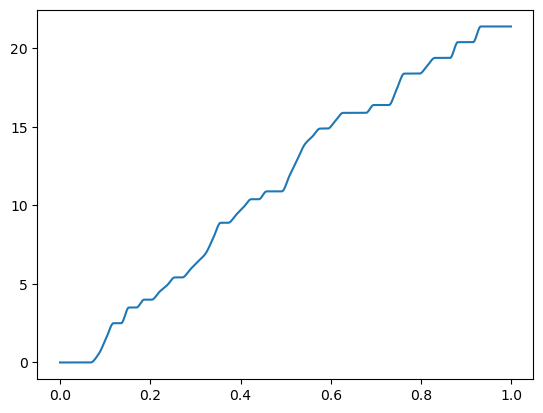

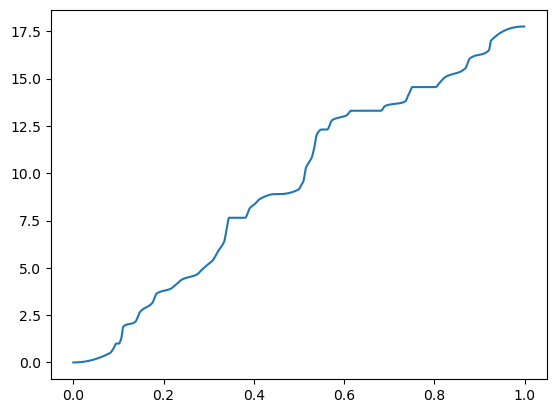

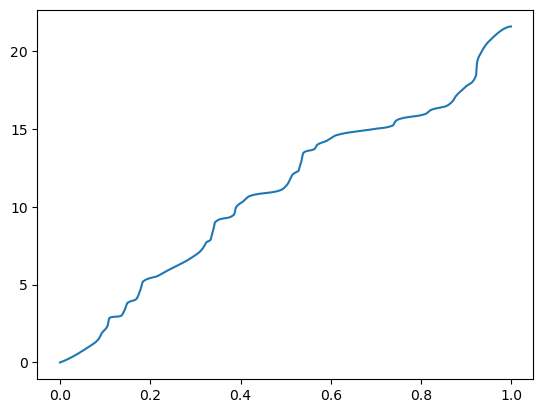

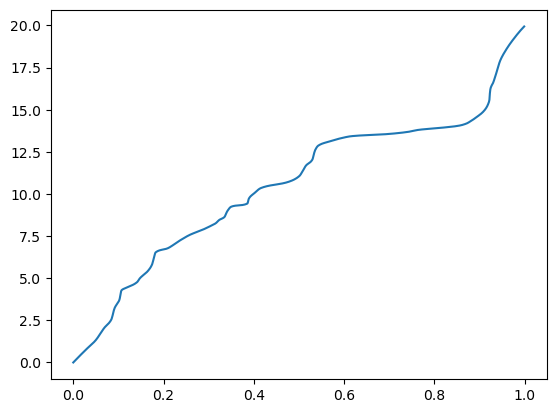

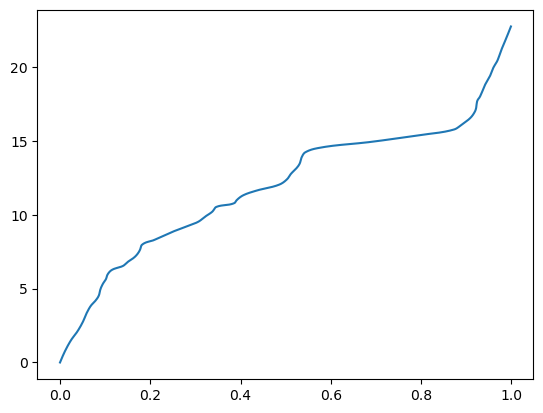

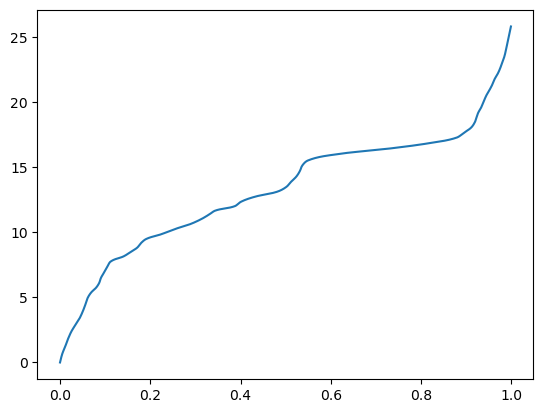

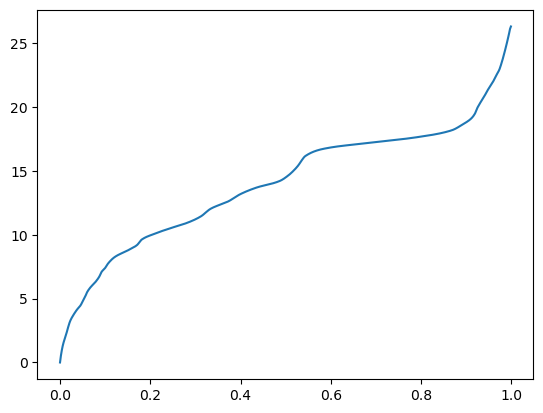

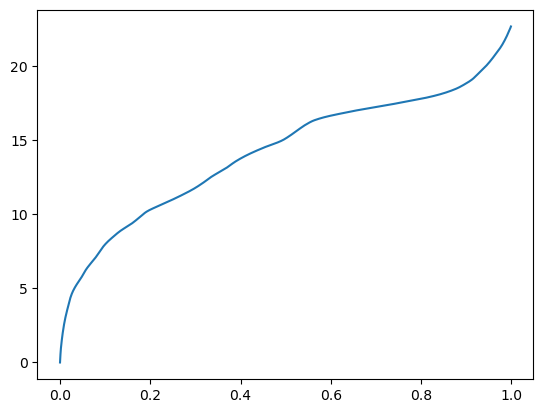

2835 steps
betas [0.00000000e+00 9.22203064e-04 2.21157074e-03 4.09984589e-03
 6.33907318e-03 9.04941559e-03 1.24464035e-02 1.65643692e-02
 2.07242966e-02 2.63986588e-02 3.50790024e-02 4.64715958e-02
 5.63325882e-02 6.91576004e-02 8.25567245e-02 9.41820145e-02
 1.10117912e-01 1.30036354e-01 1.55877113e-01 1.77693367e-01
 2.02307701e-01 2.40170479e-01 2.75605202e-01 3.05903435e-01
 3.30073357e-01 3.58210564e-01 3.83309364e-01 4.12581444e-01
 4.50364113e-01 4.93426323e-01 5.19145012e-01 5.43816566e-01
 5.86144447e-01 6.68368340e-01 7.64431953e-01 8.43150139e-01
 8.87816429e-01 9.14788246e-01 9.32314873e-01 9.48781013e-01
 9.62283134e-01 9.74892616e-01 9.84953880e-01 9.93090630e-01
 1.00000000e+00]
n_chains 45
[0.00000000e+00 9.22203064e-04 2.21157074e-03 4.09984589e-03
 6.33907318e-03 9.04941559e-03 1.24464035e-02 1.65643692e-02
 2.07242966e-02 2.63986588e-02 3.50790024e-02 4.64715958e-02
 5.63325882e-02 6.91576004e-02 8.25567245e-02 9.41820145e-02
 1.10117912e-01 1.30036354e-01 1.558771

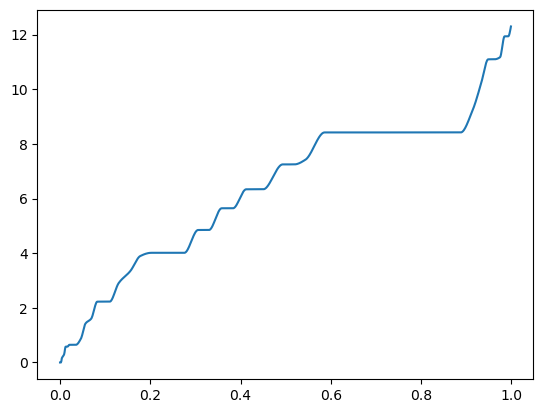

[0.         0.0086813  0.01189899 0.0453825  0.05094242 0.05581188
 0.07151127 0.07616901 0.11282635 0.12064266 0.12707233 0.14041805
 0.15731907 0.16701794 0.18408298 0.28555965 0.29258633 0.30091381
 0.3398447  0.34664822 0.35626316 0.39577961 0.40406704 0.46101475
 0.47082043 0.48009968 0.53378391 0.55315495 0.56228733 0.57116413
 0.89187145 0.90197659 0.90884495 0.91560841 0.92151165 0.92665577
 0.93170834 0.93615246 0.93995953 0.94448948 0.97690868 0.97973728
 0.98252392 0.99692822 1.        ] betas
[0.         0.99882637 0.49330036 0.98578357 0.30725606 0.22673843
 0.49361826 0.12995242 0.65737632 0.12770675 0.10071866 0.19595153
 0.22816456 0.12438503 0.20714636 0.72839618 0.07533702 0.08871222
 0.39007553 0.07405712 0.10472798 0.38225857 0.09215918 0.54611954
 0.11372795 0.12398011 0.56870114 0.24785049 0.10575317 0.08960357
 0.85962998 0.14180841 0.10771485 0.11077358 0.10137953 0.0823309
 0.0814786  0.06445652 0.05256289 0.06023185 0.360305   0.02808511
 0.02654695 0.12325274

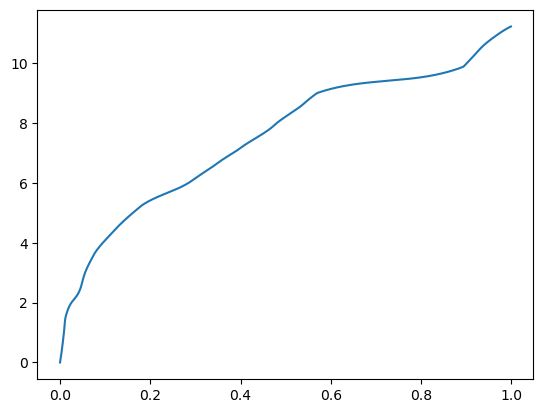

[0.         0.00262165 0.0048666  0.00691319 0.00883961 0.01029682
 0.01256275 0.01795483 0.02739239 0.04001713 0.04690456 0.05138874
 0.05716038 0.06502438 0.07381725 0.08534718 0.10002613 0.11560154
 0.13193226 0.15007877 0.16977024 0.19329548 0.22959232 0.26915836
 0.29679585 0.32214642 0.3469038  0.37202549 0.39818287 0.42354488
 0.45110607 0.4738493  0.49546528 0.52083683 0.54270458 0.56359768
 0.61400318 0.75179005 0.85706806 0.89857006 0.91449261 0.92989635
 0.94854832 0.97155094 1.        ] betas
[0.         0.9562464  0.740348   0.63456362 0.49299558 0.30164289
 0.3805953  0.65393671 0.74608008 0.57645091 0.29750768 0.21534562
 0.2634103  0.26542461 0.26233264 0.27476377 0.33431664 0.32695277
 0.23936631 0.23582627 0.26042919 0.28679178 0.35586612 0.3192723
 0.20850077 0.16888533 0.15024311 0.14238971 0.1460484  0.13548439
 0.15158006 0.13130524 0.1013308  0.09913659 0.06650833 0.05361149
 0.09599959 0.14206212 0.04727395 0.01370398 0.0045481  0.0039935
 0.00464476 0.00478252 

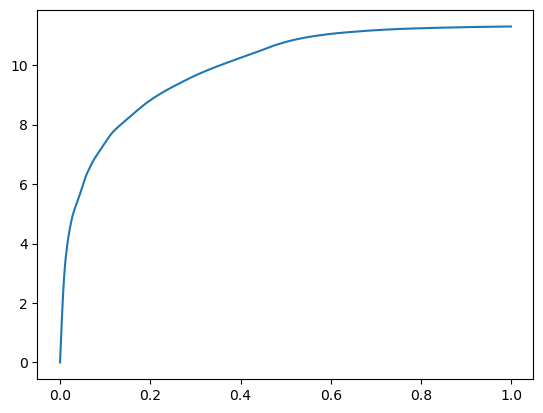

[0.00000000e+00 6.78062439e-04 1.37424469e-03 2.08950043e-03
 2.82764435e-03 3.59249115e-03 4.38022614e-03 5.18131256e-03
 5.98621368e-03 6.84070587e-03 7.78865814e-03 8.84151459e-03
 1.00622177e-02 1.14870071e-02 1.31864548e-02 1.51510239e-02
 1.74322128e-02 2.01406479e-02 2.32133865e-02 2.69250870e-02
 3.18422318e-02 3.78980637e-02 4.38928604e-02 4.95176315e-02
 5.49039841e-02 6.17017746e-02 6.99033737e-02 7.97338486e-02
 9.08498764e-02 1.02295876e-01 1.14470482e-01 1.31737709e-01
 1.51465416e-01 1.70918465e-01 1.91899300e-01 2.17062950e-01
 2.46521950e-01 2.79442787e-01 3.15762520e-01 3.58338356e-01
 4.04471397e-01 4.51745033e-01 5.02064705e-01 5.95149040e-01
 1.00000000e+00] betas
[0.         0.56778414 0.52612704 0.42140593 0.38356818 0.37910638
 0.33164168 0.27245732 0.2354907  0.231023   0.23531946 0.24167718
 0.23991916 0.28195808 0.27799778 0.26685486 0.25581602 0.26852037
 0.3057028  0.31720625 0.34495821 0.31479597 0.26397902 0.26195253
 0.23426342 0.24537773 0.24702849 0.27

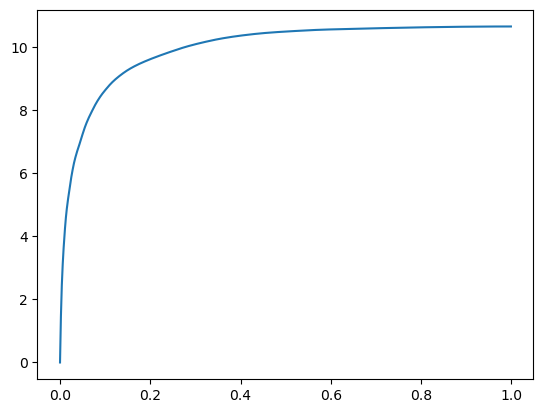

15147 steps_after


In [15]:
prova_deo3=pt_structure_mcmc(27, 3, 10000, cache, 1000, 60, 0.2,13522)

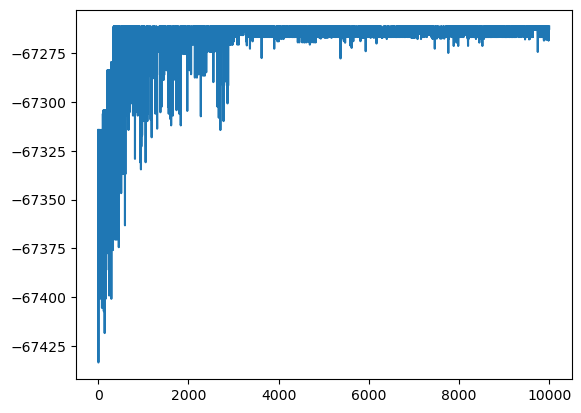

In [17]:
plt.plot(prova_deo3[0][1000:])

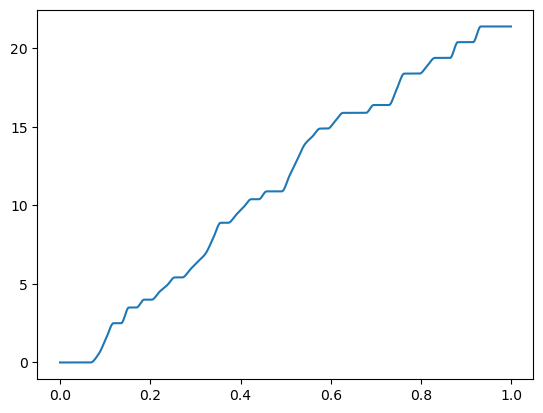

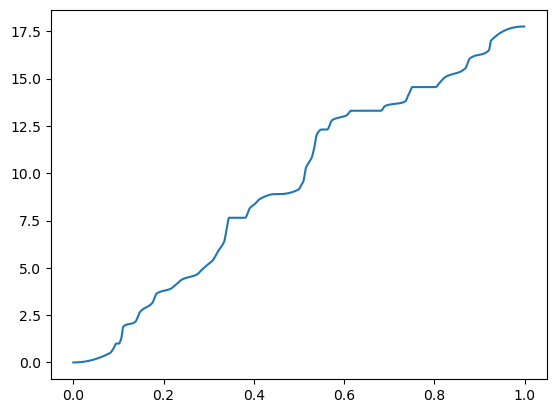

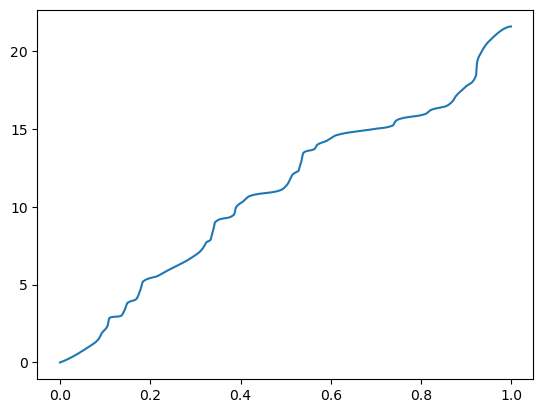

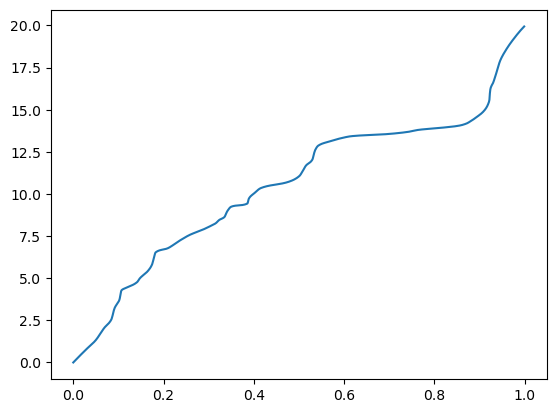

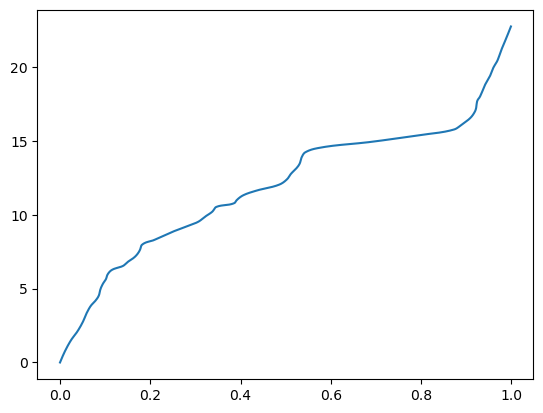

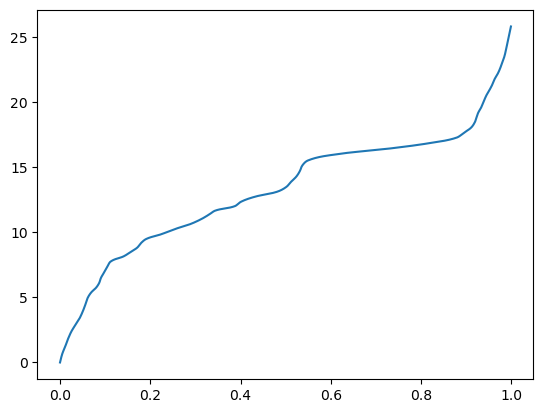

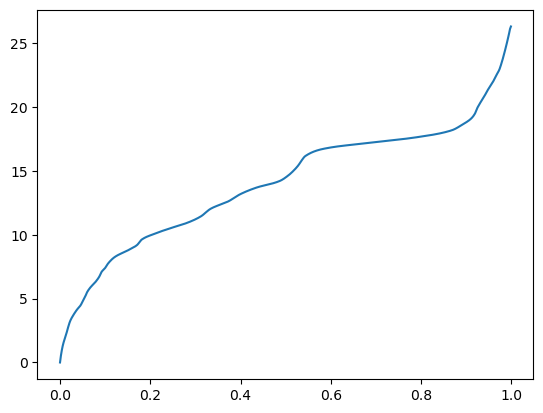

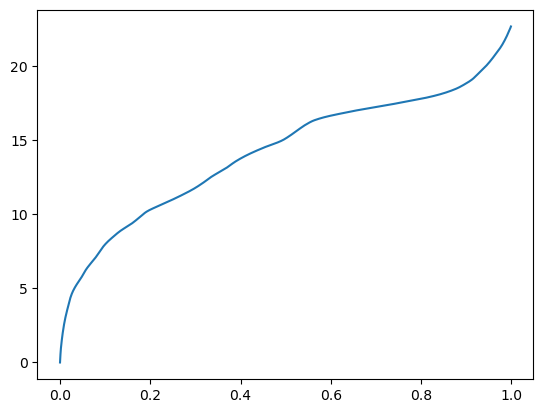

2835 steps
betas [0.00000000e+00 9.22203064e-04 2.21157074e-03 4.09984589e-03
 6.33907318e-03 9.04941559e-03 1.24464035e-02 1.65643692e-02
 2.07242966e-02 2.63986588e-02 3.50790024e-02 4.64715958e-02
 5.63325882e-02 6.91576004e-02 8.25567245e-02 9.41820145e-02
 1.10117912e-01 1.30036354e-01 1.55877113e-01 1.77693367e-01
 2.02307701e-01 2.40170479e-01 2.75605202e-01 3.05903435e-01
 3.30073357e-01 3.58210564e-01 3.83309364e-01 4.12581444e-01
 4.50364113e-01 4.93426323e-01 5.19145012e-01 5.43816566e-01
 5.86144447e-01 6.68368340e-01 7.64431953e-01 8.43150139e-01
 8.87816429e-01 9.14788246e-01 9.32314873e-01 9.48781013e-01
 9.62283134e-01 9.74892616e-01 9.84953880e-01 9.93090630e-01
 1.00000000e+00]
n_chains 45
[0.00000000e+00 9.22203064e-04 2.21157074e-03 4.09984589e-03
 6.33907318e-03 9.04941559e-03 1.24464035e-02 1.65643692e-02
 2.07242966e-02 2.63986588e-02 3.50790024e-02 4.64715958e-02
 5.63325882e-02 6.91576004e-02 8.25567245e-02 9.41820145e-02
 1.10117912e-01 1.30036354e-01 1.558771

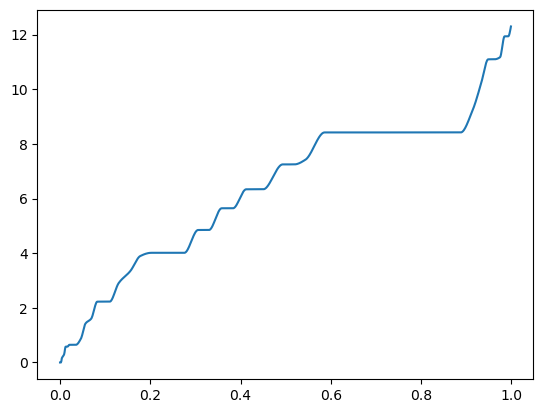

[0.         0.0086813  0.01189899 0.0453825  0.05094242 0.05581188
 0.07151127 0.07616901 0.11282635 0.12064266 0.12707233 0.14041805
 0.15731907 0.16701794 0.18408298 0.28555965 0.29258633 0.30091381
 0.3398447  0.34664822 0.35626316 0.39577961 0.40406704 0.46101475
 0.47082043 0.48009968 0.53378391 0.55315495 0.56228733 0.57116413
 0.89187145 0.90197659 0.90884495 0.91560841 0.92151165 0.92665577
 0.93170834 0.93615246 0.93995953 0.94448948 0.97690868 0.97973728
 0.98252392 0.99692822 1.        ] betas
[0.         0.99882637 0.49330036 0.98578357 0.30725606 0.22673843
 0.49361826 0.12995242 0.65737632 0.12770675 0.10071866 0.19595153
 0.22816456 0.12438503 0.20714636 0.72839618 0.07533702 0.08871222
 0.39007553 0.07405712 0.10472798 0.38225857 0.09215918 0.54611954
 0.11372795 0.12398011 0.56870114 0.24785049 0.10575317 0.08960357
 0.85962998 0.14180841 0.10771485 0.11077358 0.10137953 0.0823309
 0.0814786  0.06445652 0.05256289 0.06023185 0.360305   0.02808511
 0.02654695 0.12325274

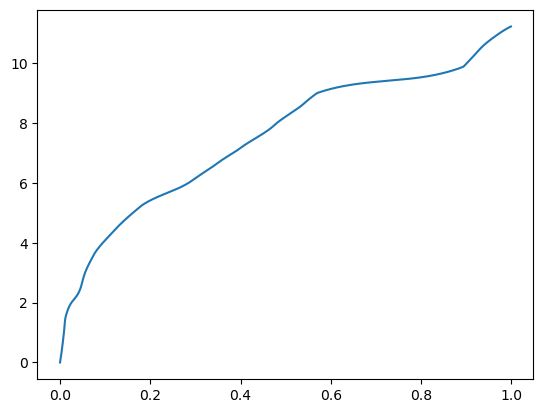

[0.         0.00262165 0.0048666  0.00691319 0.00883961 0.01029682
 0.01256275 0.01795483 0.02739239 0.04001713 0.04690456 0.05138874
 0.05716038 0.06502438 0.07381725 0.08534718 0.10002613 0.11560154
 0.13193226 0.15007877 0.16977024 0.19329548 0.22959232 0.26915836
 0.29679585 0.32214642 0.3469038  0.37202549 0.39818287 0.42354488
 0.45110607 0.4738493  0.49546528 0.52083683 0.54270458 0.56359768
 0.61400318 0.75179005 0.85706806 0.89857006 0.91449261 0.92989635
 0.94854832 0.97155094 1.        ] betas
[0.         0.9562464  0.740348   0.63456362 0.49299558 0.30164289
 0.3805953  0.65393671 0.74608008 0.57645091 0.29750768 0.21534562
 0.2634103  0.26542461 0.26233264 0.27476377 0.33431664 0.32695277
 0.23936631 0.23582627 0.26042919 0.28679178 0.35586612 0.3192723
 0.20850077 0.16888533 0.15024311 0.14238971 0.1460484  0.13548439
 0.15158006 0.13130524 0.1013308  0.09913659 0.06650833 0.05361149
 0.09599959 0.14206212 0.04727395 0.01370398 0.0045481  0.0039935
 0.00464476 0.00478252 

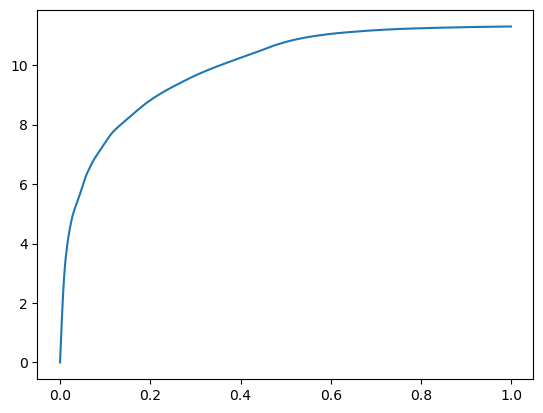

[0.00000000e+00 6.78062439e-04 1.37424469e-03 2.08950043e-03
 2.82764435e-03 3.59249115e-03 4.38022614e-03 5.18131256e-03
 5.98621368e-03 6.84070587e-03 7.78865814e-03 8.84151459e-03
 1.00622177e-02 1.14870071e-02 1.31864548e-02 1.51510239e-02
 1.74322128e-02 2.01406479e-02 2.32133865e-02 2.69250870e-02
 3.18422318e-02 3.78980637e-02 4.38928604e-02 4.95176315e-02
 5.49039841e-02 6.17017746e-02 6.99033737e-02 7.97338486e-02
 9.08498764e-02 1.02295876e-01 1.14470482e-01 1.31737709e-01
 1.51465416e-01 1.70918465e-01 1.91899300e-01 2.17062950e-01
 2.46521950e-01 2.79442787e-01 3.15762520e-01 3.58338356e-01
 4.04471397e-01 4.51745033e-01 5.02064705e-01 5.95149040e-01
 1.00000000e+00] betas
[0.         0.56778414 0.52612704 0.42140593 0.38356818 0.37910638
 0.33164168 0.27245732 0.2354907  0.231023   0.23531946 0.24167718
 0.23991916 0.28195808 0.27799778 0.26685486 0.25581602 0.26852037
 0.3057028  0.31720625 0.34495821 0.31479597 0.26397902 0.26195253
 0.23426342 0.24537773 0.24702849 0.27

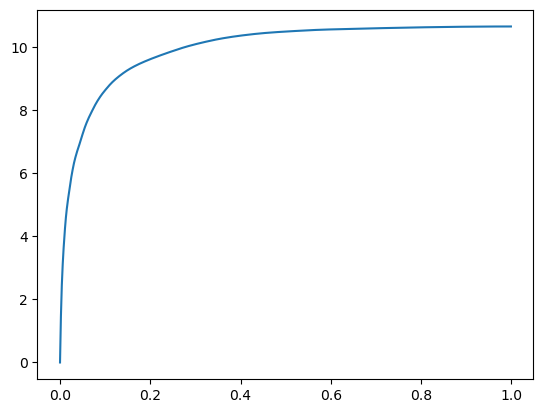

15147 steps_after


In [291]:
prova_deo2=pt_structure_mcmc(27, 3, 10000, cache, 1000, 60, 0.2,13522)

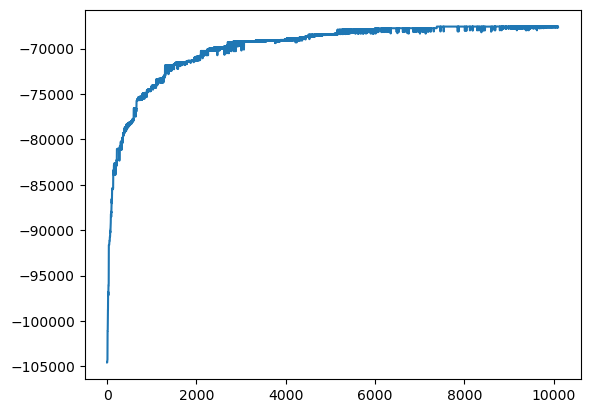

In [281]:
plt.plot(prova_deo2[0])

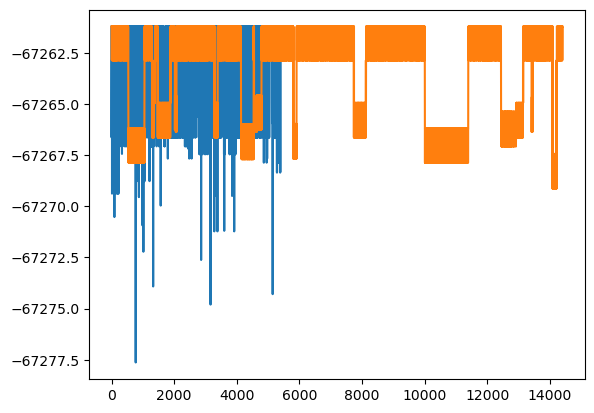

In [19]:
#prova_post=structure_mcmc(27, 3, 20000, cache, .2)
plt.plot(prova_deo3[0][600:][5000:])
plt.plot(prova_post[2][600:][5000:])

#plt.plot(prova_deo[0][000:])


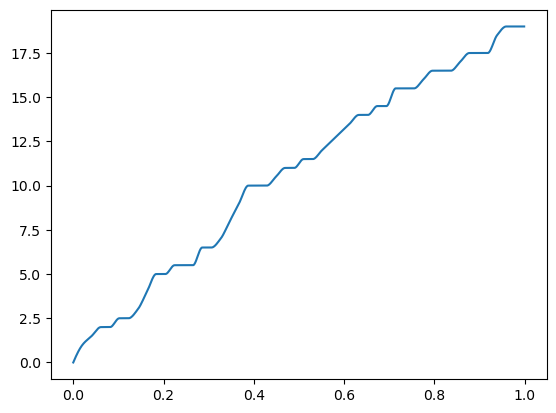

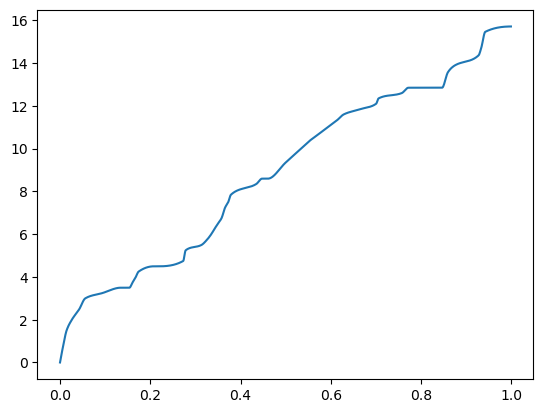

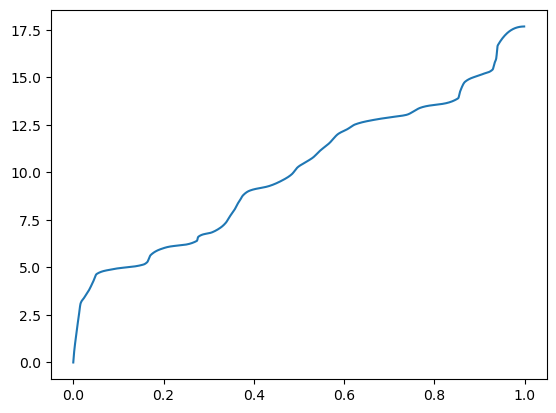

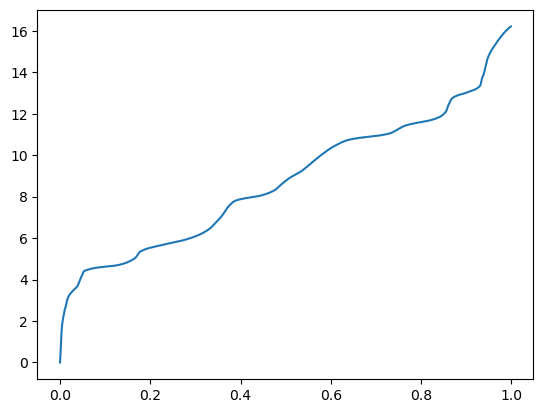

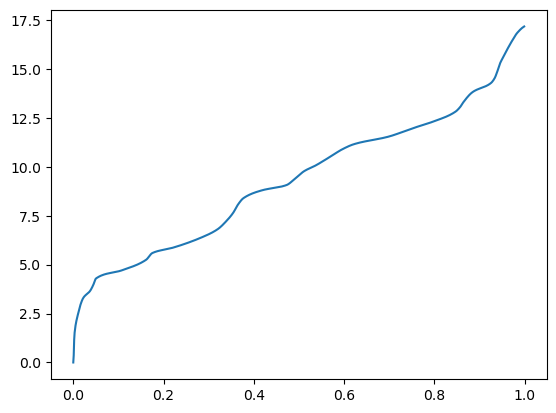

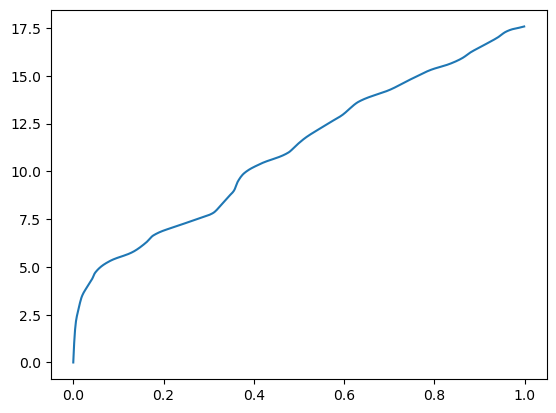

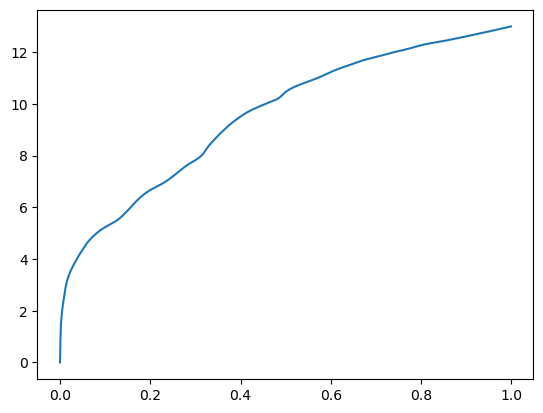

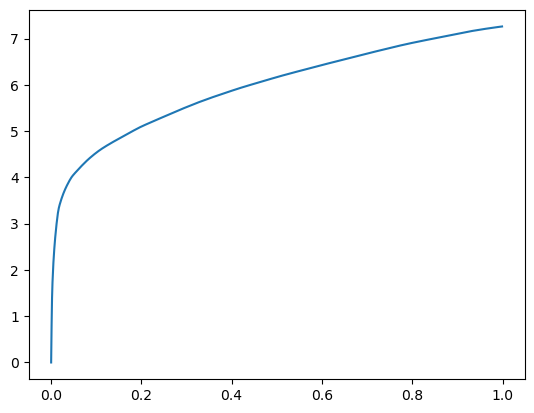

10273 steps
betas [0.00000000e+00 6.62803650e-04 1.45244598e-03 2.80666351e-03
 5.48076630e-03 9.88101959e-03 1.73368454e-02 3.95383835e-02
 9.17520523e-02 1.85742378e-01 3.17128181e-01 4.92381096e-01
 7.11709023e-01 1.00000000e+00]
n_chains 14
[0.00000000e+00 6.62803650e-04 1.45244598e-03 2.80666351e-03
 5.48076630e-03 9.88101959e-03 1.73368454e-02 3.95383835e-02
 9.17520523e-02 1.85742378e-01 3.17128181e-01 4.92381096e-01
 7.11709023e-01 1.00000000e+00] betas
[0.         0.         0.         0.         0.         0.00066616
 0.03919661 0.05569515 0.3014565  0.         0.24789501 0.
 0.         0.        ] r
-22480.269231963164 score post


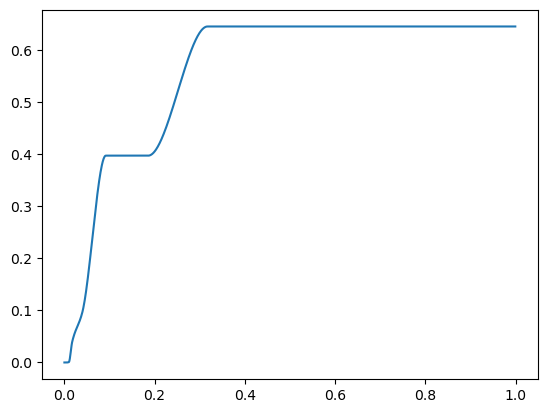

[0.         0.02035046 0.04057407 0.04993916 0.05681705 0.06312084
 0.06952    0.07681561 0.09100819 0.22341824 0.2425909  0.26022625
 0.27938938 1.        ] betas
[0.         0.99643145 0.3779686  0.12089704 0.07169453 0.06038643
 0.05492256 0.05929741 0.10520463 0.62950946 0.08186051 0.07325154
 0.07549591 0.90862429] r
-22486.68677378638 score post


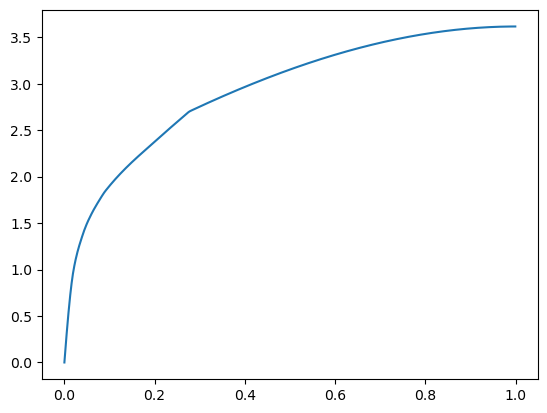

[0.         0.00448895 0.00946522 0.01550961 0.02513981 0.04168034
 0.06789494 0.10810184 0.16510677 0.22955418 0.31246281 0.44835567
 0.61803341 1.        ] betas
[0.         0.99084332 0.67526628 0.44721287 0.34620705 0.26604799
 0.24494671 0.27440121 0.33136764 0.30109095 0.30451109 0.37518092
 0.36083051 0.45863262] r
-22482.458794922564 score post


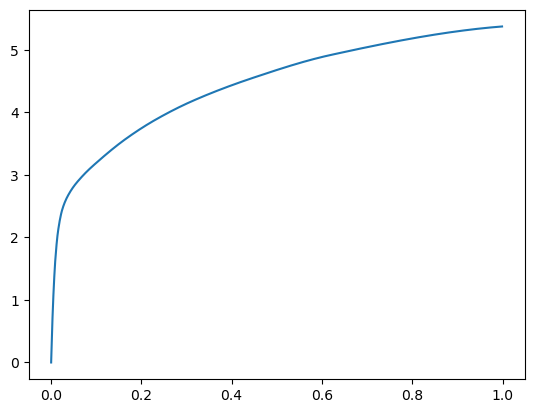

[0.         0.00166225 0.00358486 0.00605488 0.00934505 0.01465702
 0.02611828 0.05863667 0.1183157  0.19453335 0.29838467 0.44517612
 0.64655209 1.        ] betas
[0.         0.88557292 0.59266672 0.4550871  0.43005661 0.45408317
 0.36478224 0.44320629 0.39936498 0.39526791 0.41687657 0.42088338
 0.4411616  0.46979646] r
-22484.489001339873 score post


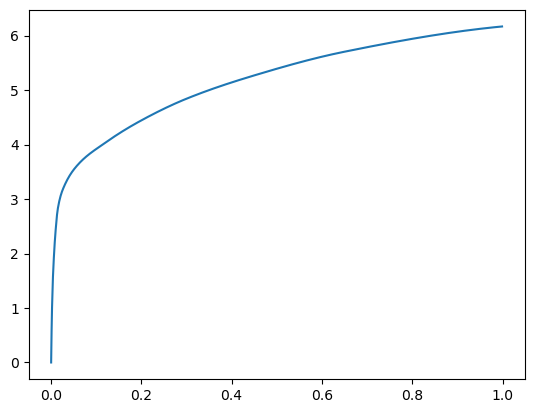

41319 steps_after


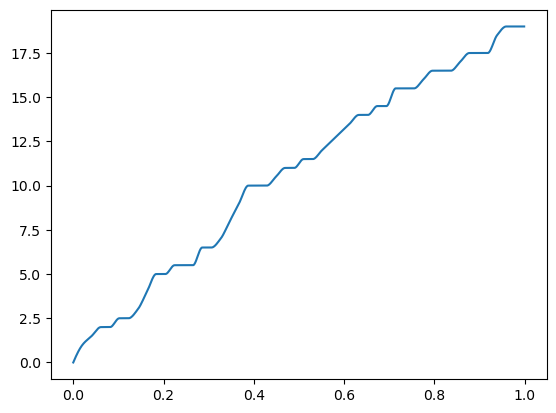

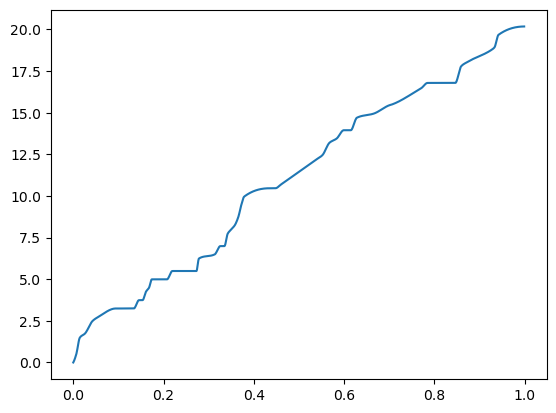

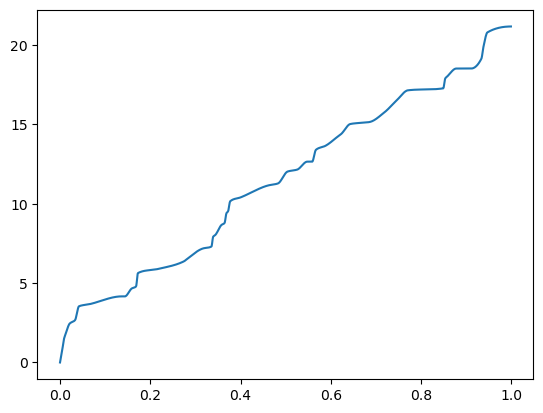

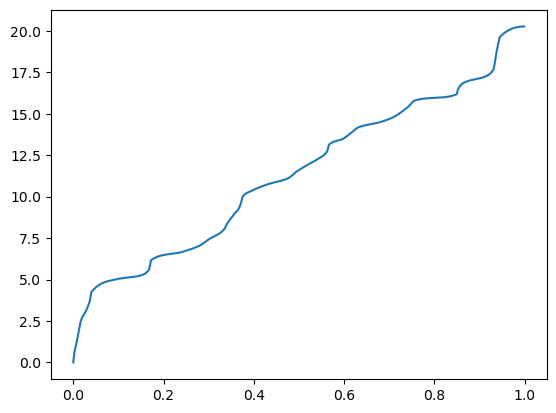

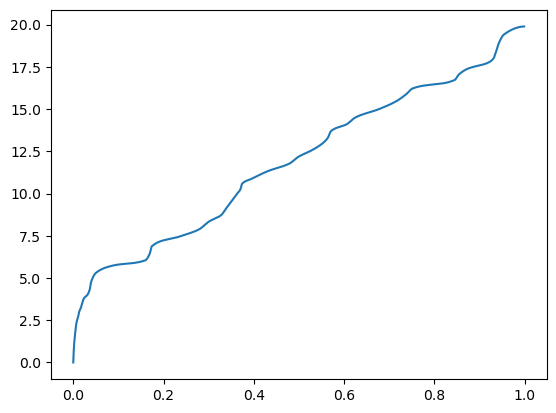

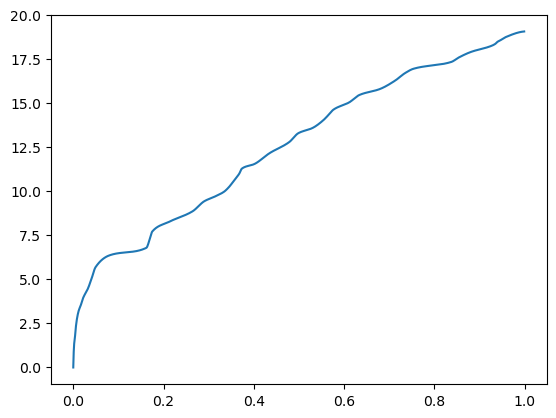

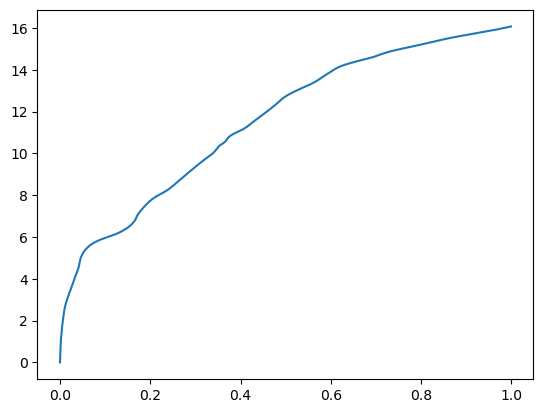

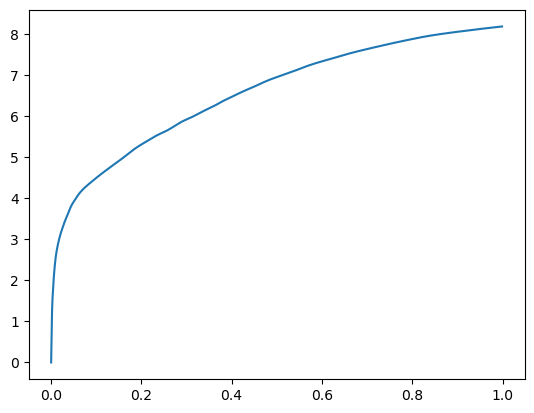

9799 steps
betas [0.00000000e+00 7.67707825e-04 1.63745880e-03 3.41320038e-03
 6.63280487e-03 1.23720169e-02 2.50978470e-02 4.47988510e-02
 8.55741501e-02 1.50427818e-01 2.22153664e-01 3.16290855e-01
 4.14816856e-01 5.37018776e-01 7.02017784e-01 1.00000000e+00]
n_chains 16
[0.00000000e+00 7.67707825e-04 1.63745880e-03 3.41320038e-03
 6.63280487e-03 1.23720169e-02 2.50978470e-02 4.47988510e-02
 8.55741501e-02 1.50427818e-01 2.22153664e-01 3.16290855e-01
 4.14816856e-01 5.37018776e-01 7.02017784e-01 1.00000000e+00] betas
[0.         0.         0.         0.         0.04213697 0.07387036
 0.         0.         0.09241009 0.09166289 0.29488603 0.
 0.         0.58885917 0.         0.45248454] r
-22481.990460408004 score post


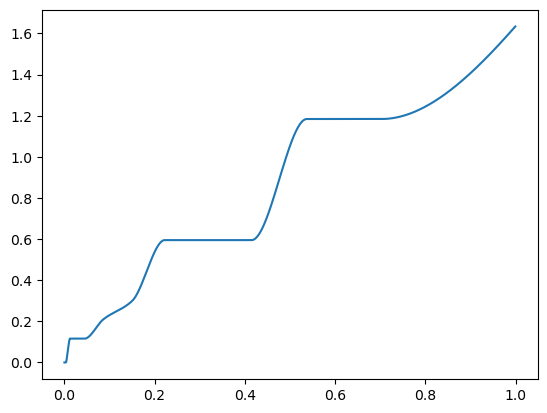

[0.         0.01104832 0.09147167 0.15944195 0.18103886 0.20170689
 0.43889141 0.45800304 0.47360706 0.48889446 0.5062952  0.75142193
 0.84607601 0.90524006 0.95487309 1.        ] betas
[0.         0.99839145 0.93804407 0.43397268 0.1158154  0.10815947
 0.79387391 0.05438517 0.04288985 0.04180798 0.04641138 0.46864945
 0.13154939 0.07407683 0.05365558 0.04482753] r
-22480.269231963164 score post


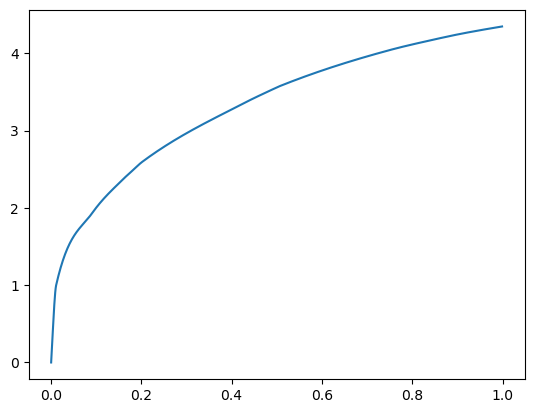

[0.         0.00269032 0.00531292 0.00849056 0.01783657 0.03416538
 0.06324673 0.10340977 0.15026188 0.20483112 0.28002644 0.3712492
 0.47056484 0.59563351 0.76070118 1.        ] betas
[0.         0.97129636 0.54054426 0.49569734 0.57973298 0.34612231
 0.30880308 0.27462024 0.27234697 0.27159793 0.29272109 0.27813121
 0.25234225 0.24216222 0.26194505 0.25373203] r
-22480.269231963164 score post


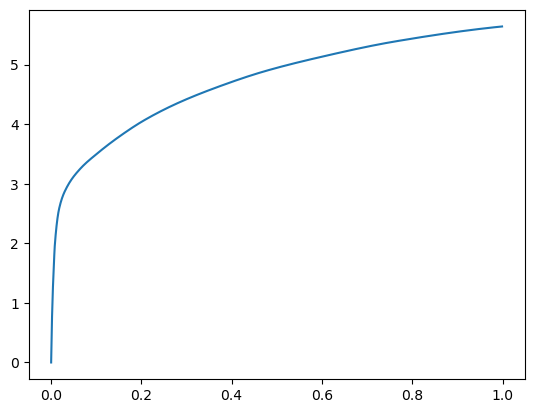

[0.00000000e+00 8.99314880e-04 1.94454193e-03 3.33690643e-03
 5.27095795e-03 7.46250153e-03 1.14603043e-02 1.92785263e-02
 3.97367477e-02 8.25605392e-02 1.45098686e-01 2.22764015e-01
 3.30092430e-01 4.73107338e-01 6.77540779e-01 1.00000000e+00] betas
[0.         0.72582752 0.54989842 0.38060576 0.40324367 0.35098123
 0.39597    0.43230871 0.41803424 0.3620018  0.34920174 0.35834886
 0.40632651 0.42094325 0.38184956 0.43829823] r
-22484.348467993714 score post


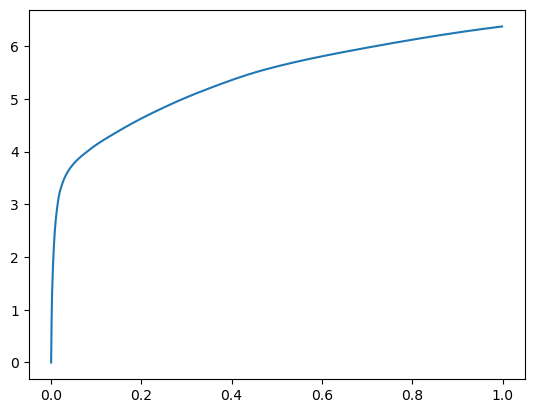

42599 steps_after


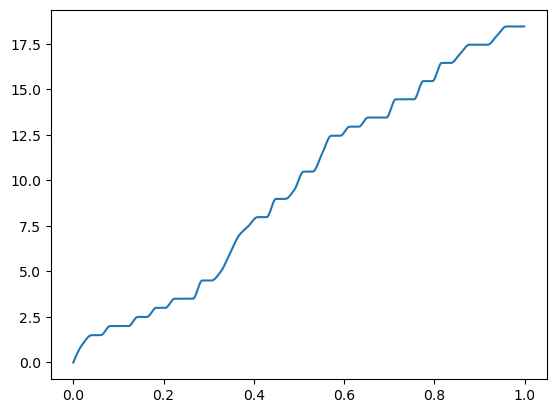

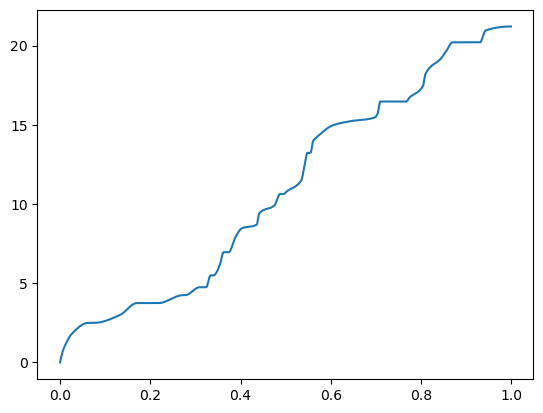

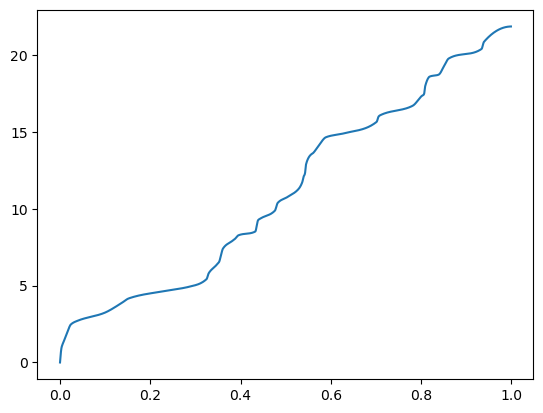

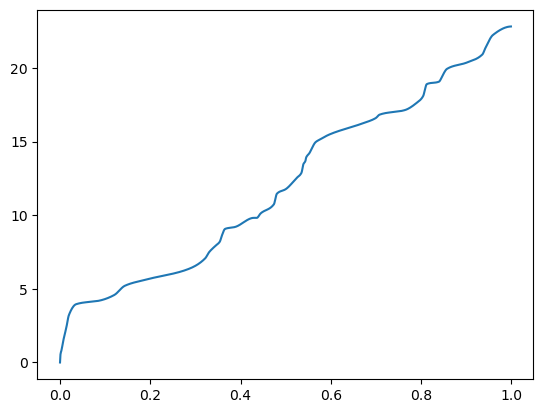

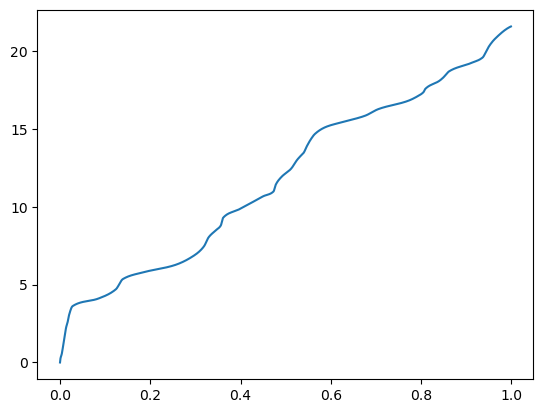

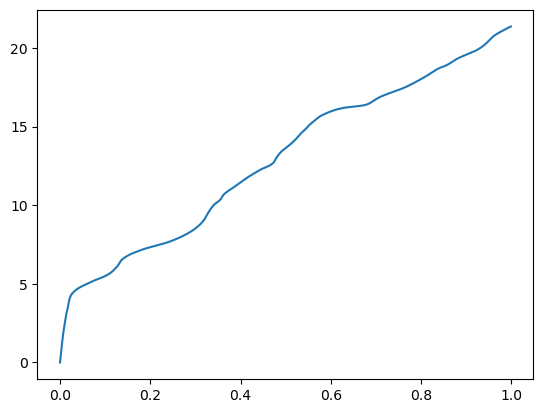

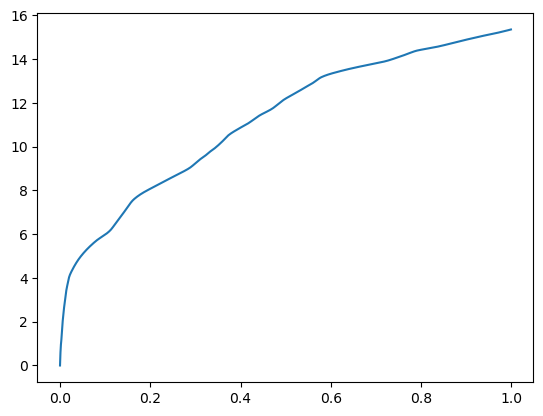

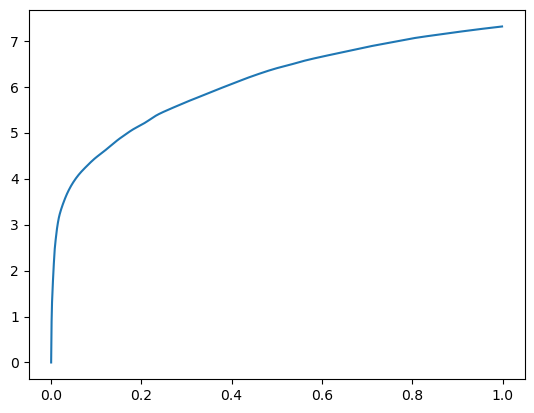

9954 steps
betas [0.00000000e+00 5.48362732e-04 1.47151947e-03 3.60012054e-03
 6.55269623e-03 1.16357803e-02 2.35376358e-02 5.00497818e-02
 1.04557991e-01 1.79823875e-01 2.89448738e-01 4.33650017e-01
 6.44457817e-01 1.00000000e+00]
n_chains 14
[0.00000000e+00 5.48362732e-04 1.47151947e-03 3.60012054e-03
 6.55269623e-03 1.16357803e-02 2.35376358e-02 5.00497818e-02
 1.04557991e-01 1.79823875e-01 2.89448738e-01 4.33650017e-01
 6.44457817e-01 1.00000000e+00] betas
[0.         0.00538775 0.01788712 0.02225661 0.0046029  0.0372011
 0.01780794 0.         0.08477986 0.         0.37350726 0.
 0.         0.34971806] r
-22481.990460408004 score post


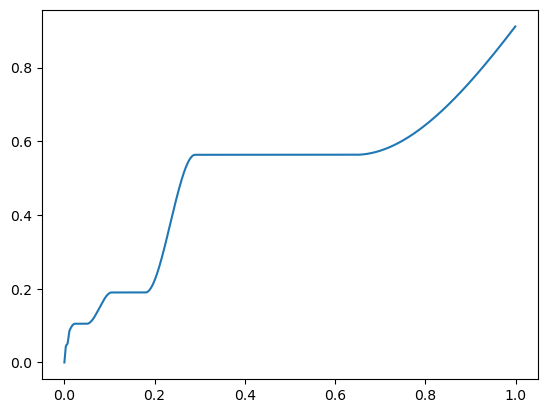

[0.         0.00926876 0.07426929 0.19552898 0.21507931 0.22964001
 0.24347401 0.25868511 0.28539753 0.78700352 0.85313129 0.90698147
 0.95507336 1.        ] betas
[0.         0.9999717  0.92807217 0.6274677  0.09243907 0.0656393
 0.05852468 0.06132629 0.10719317 0.85654864 0.08867442 0.06271388
 0.05307701 0.04396648] r
-22481.990460408004 score post


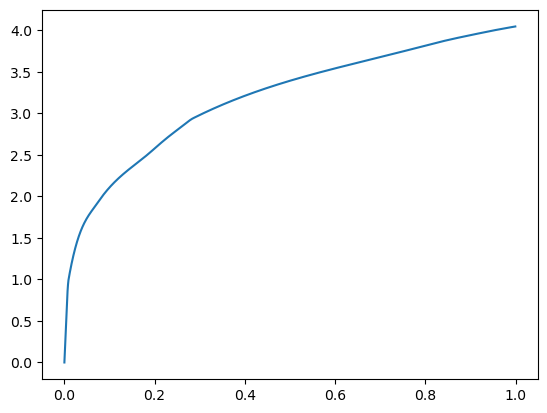

[0.         0.00241184 0.00479603 0.00794506 0.01812649 0.0343771
 0.06626606 0.11250591 0.18139553 0.25053883 0.35409069 0.51983547
 0.74273014 1.        ] betas
[0.         0.95891513 0.53095577 0.40469568 0.63158884 0.40384912
 0.36054512 0.3099605  0.35697577 0.31526751 0.36770723 0.42313796
 0.36402664 0.29436372] r
-22480.269231963164 score post


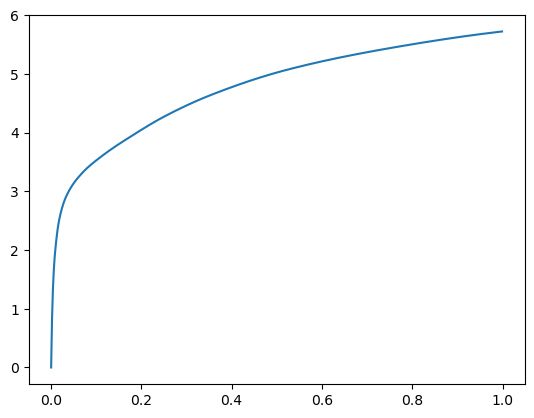

[0.00000000e+00 9.64164734e-04 2.15053558e-03 3.88431549e-03
 6.67667389e-03 1.18551254e-02 2.15349197e-02 4.51097488e-02
 9.91029739e-02 1.82198524e-01 2.83654213e-01 4.25099373e-01
 6.42441750e-01 1.00000000e+00] betas
[0.         0.69840019 0.59084464 0.39473707 0.45467961 0.60312798
 0.37839918 0.41176368 0.42291084 0.46159421 0.41357836 0.41747439
 0.46062136 0.47194694] r
-22480.269231963164 score post


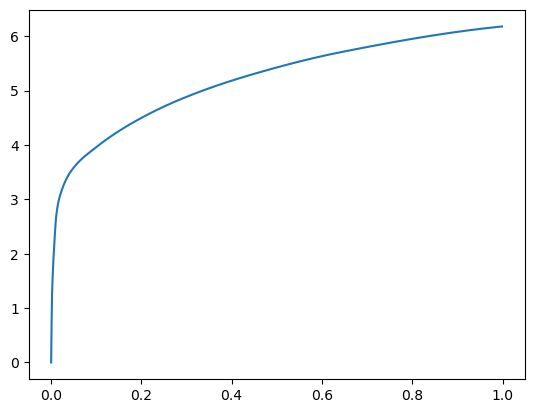

39657 steps_after


TypeError: 'int' object is not subscriptable

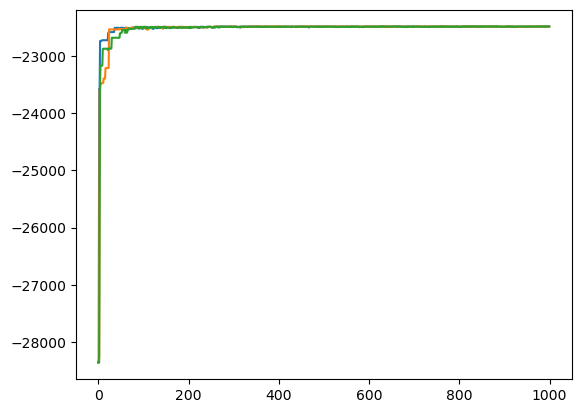

In [18]:
prova_deo=pt_structure_mcmc(8, 3, 10000, cache, 1000, 50, 0,1001)
prova_seo=seo_structure_mcmc(8, 3, 10000, cache, 1000, 50, 0,1001)
prova_post=rand_pt_structure_mcmc(8, 3, 10000, cache, 1000, 50, 0,1001)

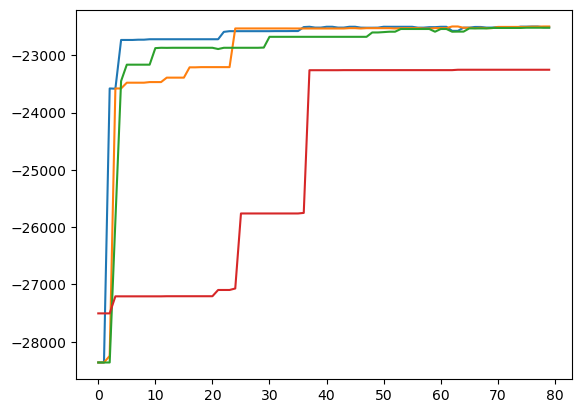

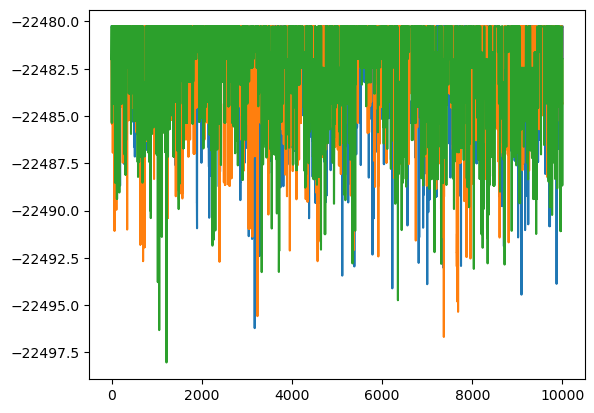

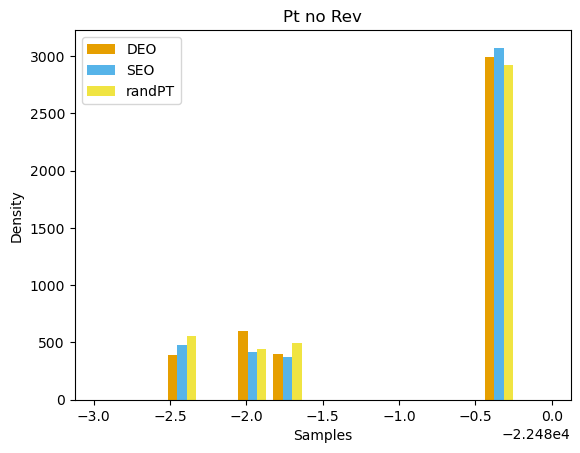

In [32]:
#prova_post=structure_mcmc(8, 3, 10000, cache)
plt.plot(prova_deo[0][0:80])
plt.plot(prova_seo[0][0:80])
plt.plot(prova_rand[0][0:80])
plt.plot(prova_post[2][0:80])
plt.show()

plt.plot(prova_deo[0][1000:])
plt.plot(prova_seo[0][1000:])
plt.plot(prova_rand[0][1000:])
#plt.plot(prova_post[2][1000:])
plt.show()

# Make a separate list for each airline
x1 = prova_deo[0][5000:]
x2 = prova_seo[0][5000:]
x3 = prova_rand[0][5000:]


# Assign colors for each airline and the names
colors = ['#E69F00', '#56B4E9', '#F0E442']
names = ['DEO', 'SEO', 'randPT']
         
# Make the histogram using a list of lists
# Normalize the flights and assign colors and names
plt.hist([x1, x2, x3],range=[-22483, -22480], bins = int(200/15), 
         color = colors, label=names)

# Plot formatting
plt.legend()
plt.xlabel('Samples')
plt.ylabel('Density')
plt.title('Pt no Rev')
plt.show()

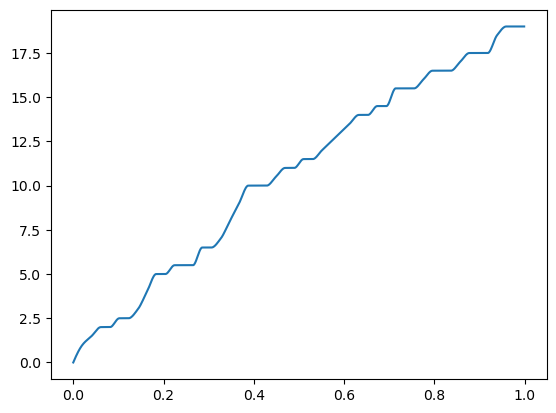

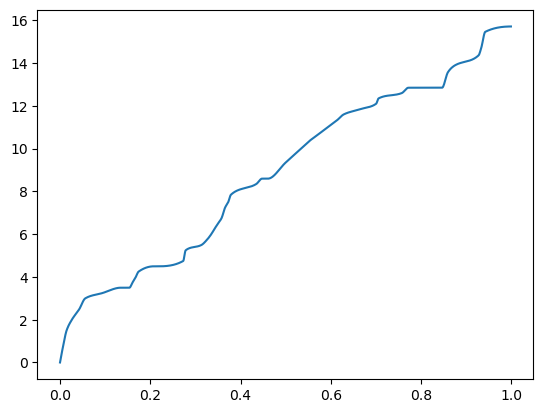

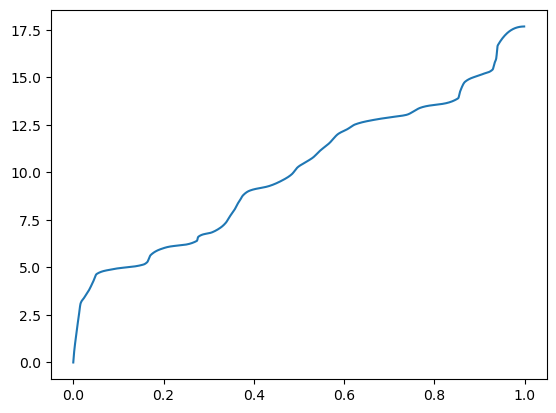

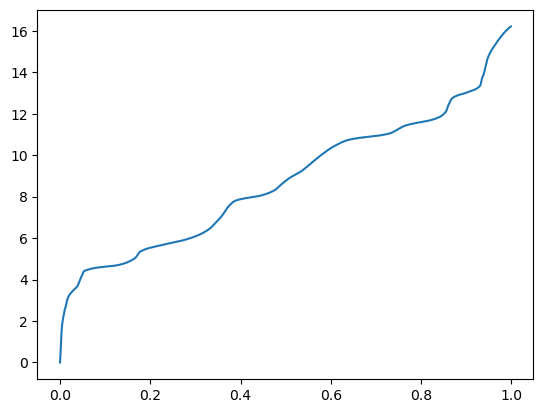

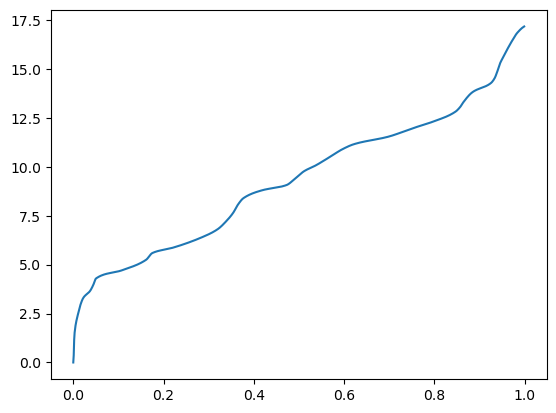

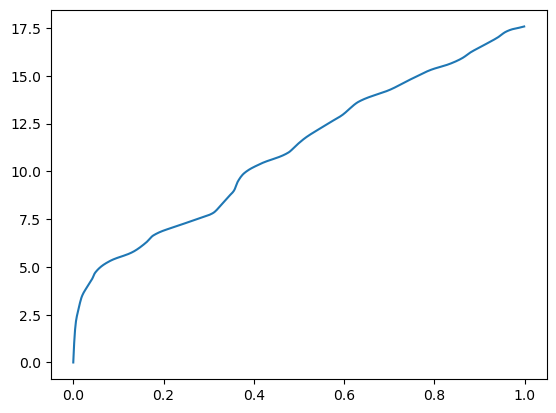

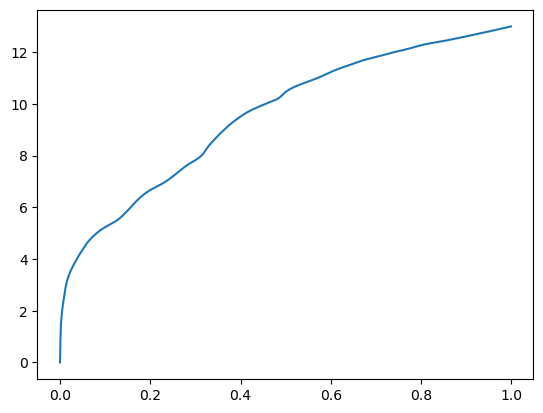

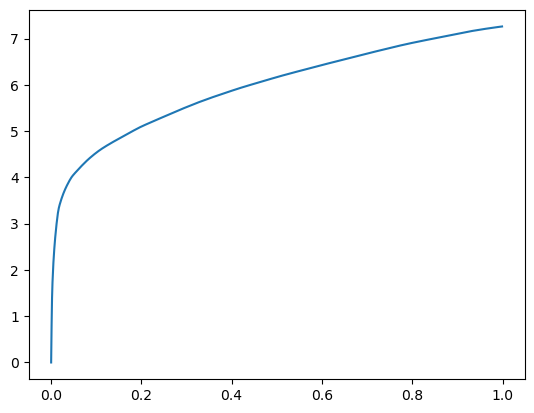

10273 steps
betas [0.00000000e+00 6.62803650e-04 1.45244598e-03 2.80666351e-03
 5.48076630e-03 9.88101959e-03 1.73368454e-02 3.95383835e-02
 9.17520523e-02 1.85742378e-01 3.17128181e-01 4.92381096e-01
 7.11709023e-01 1.00000000e+00]
n_chains 14
[0.00000000e+00 6.62803650e-04 1.45244598e-03 2.80666351e-03
 5.48076630e-03 9.88101959e-03 1.73368454e-02 3.95383835e-02
 9.17520523e-02 1.85742378e-01 3.17128181e-01 4.92381096e-01
 7.11709023e-01 1.00000000e+00] betas
[0.         0.         0.         0.         0.         0.00066616
 0.03919661 0.05569515 0.3014565  0.         0.24789501 0.
 0.         0.        ] r
-22480.269231963164 score post


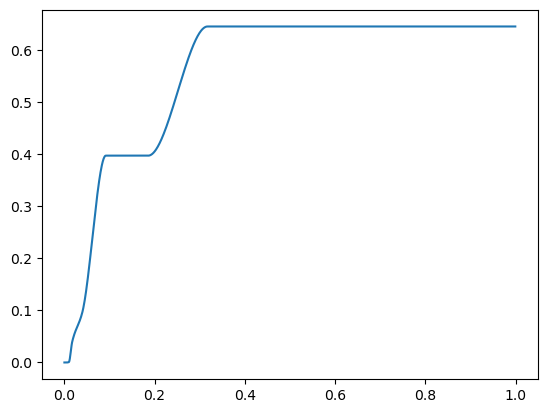

[0.         0.02035046 0.04057407 0.04993916 0.05681705 0.06312084
 0.06952    0.07681561 0.09100819 0.22341824 0.2425909  0.26022625
 0.27938938 1.        ] betas
[0.         0.99643145 0.3779686  0.12089704 0.07169453 0.06038643
 0.05492256 0.05929741 0.10520463 0.62950946 0.08186051 0.07325154
 0.07549591 0.90862429] r
-22486.68677378638 score post


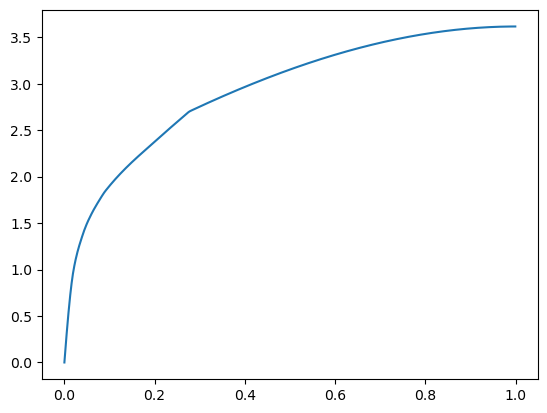

[0.         0.00448895 0.00946522 0.01550961 0.02513981 0.04168034
 0.06789494 0.10810184 0.16510677 0.22955418 0.31246281 0.44835567
 0.61803341 1.        ] betas
[0.         0.99084332 0.67526628 0.44721287 0.34620705 0.26604799
 0.24494671 0.27440121 0.33136764 0.30109095 0.30451109 0.37518092
 0.36083051 0.45863262] r
-22482.458794922564 score post


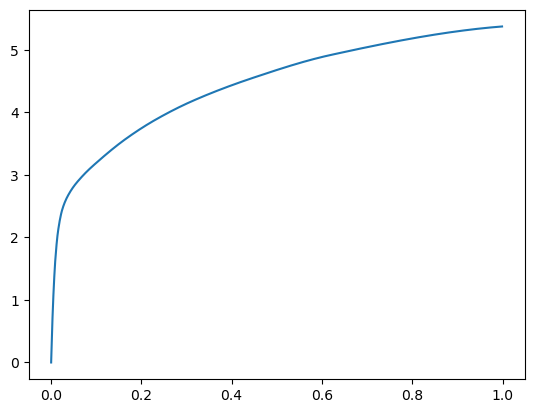

[0.         0.00166225 0.00358486 0.00605488 0.00934505 0.01465702
 0.02611828 0.05863667 0.1183157  0.19453335 0.29838467 0.44517612
 0.64655209 1.        ] betas
[0.         0.88557292 0.59266672 0.4550871  0.43005661 0.45408317
 0.36478224 0.44320629 0.39936498 0.39526791 0.41687657 0.42088338
 0.4411616  0.46979646] r
-22484.489001339873 score post


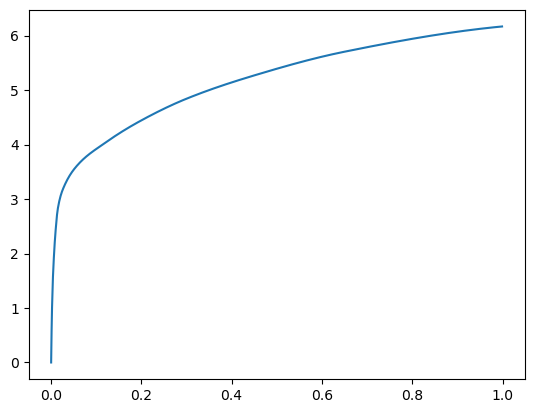

[0.00000000e+00 7.96318054e-04 1.82628632e-03 3.35788727e-03
 5.82790375e-03 9.43279266e-03 1.52769089e-02 3.37038040e-02
 8.01305771e-02 1.63407326e-01 2.72570610e-01 4.30094719e-01
 6.43774986e-01 1.00000000e+00] betas
[0.         0.66355906 0.56902007 0.47964933 0.452128   0.45196475
 0.4413295  0.55870316 0.45416321 0.46994145 0.44338114 0.45931495
 0.42203147 0.44260913] r
-22485.841550972513 score post


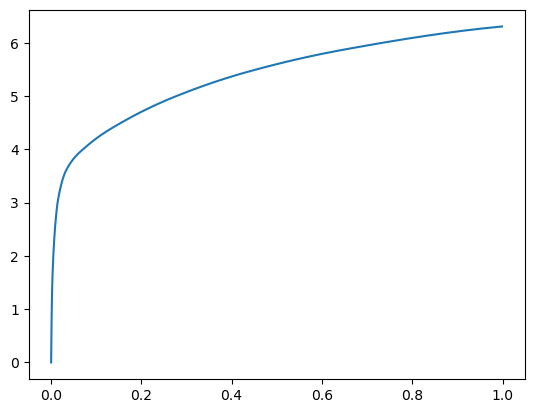

[0.00000000e+00 5.52177429e-04 1.29032135e-03 2.43663788e-03
 4.46033478e-03 7.71999359e-03 1.28622055e-02 2.41155624e-02
 5.56058884e-02 1.28230095e-01 2.36243248e-01 3.88213158e-01
 6.17293358e-01 1.00000000e+00] betas
[0.         0.49352211 0.53887967 0.41872559 0.43275919 0.47546956
 0.44174045 0.42774813 0.46129916 0.48375034 0.51291593 0.54909523
 0.47558244 0.46686476] r
-22483.215759872455 score post


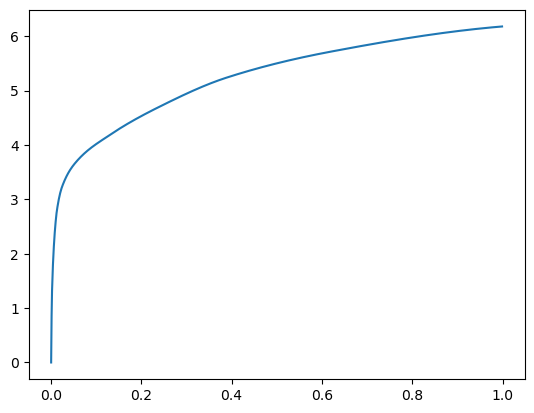

[0.00000000e+00 5.29289246e-04 1.14536285e-03 2.34699249e-03
 4.55760956e-03 7.87448883e-03 1.38006210e-02 2.87446976e-02
 6.82668686e-02 1.47316933e-01 2.52211571e-01 3.85237694e-01
 6.11981392e-01 1.00000000e+00] betas
[0.         0.49219526 0.45357034 0.49999804 0.44433922 0.51154677
 0.52931164 0.48142396 0.48168267 0.48924596 0.44250752 0.42952376
 0.50568809 0.53223013] r
-22481.990460408004 score post


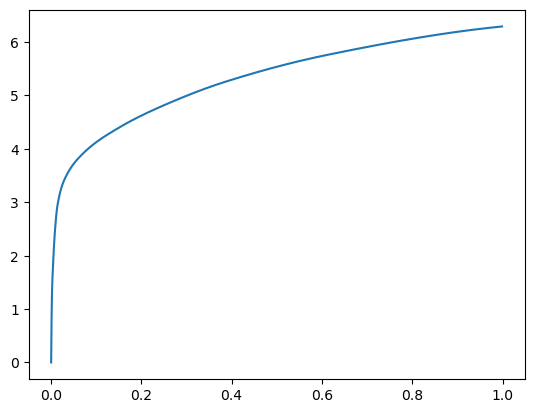

[0.00000000e+00 5.19752502e-04 1.18732452e-03 2.36988068e-03
 4.82082367e-03 8.03661346e-03 1.33199692e-02 2.75373459e-02
 6.57815933e-02 1.42094612e-01 2.56344795e-01 4.11721230e-01
 6.39956474e-01 1.00000000e+00] betas
[0.         0.46758932 0.51750846 0.49134765 0.53486123 0.49499052
 0.4629823  0.47468517 0.5057665  0.48618447 0.48272129 0.50224545
 0.46664919 0.42663312] r
-22480.269231963164 score post


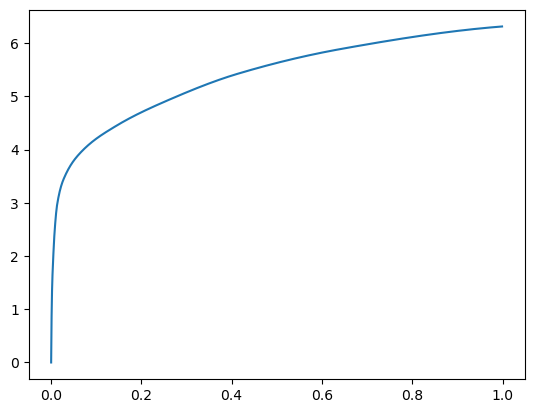

[0.00000000e+00 5.40733337e-04 1.16252899e-03 2.30503082e-03
 4.44507599e-03 7.40909576e-03 1.23949051e-02 2.54907608e-02
 5.88941574e-02 1.29591942e-01 2.39777565e-01 3.82842064e-01
 6.03388786e-01 1.00000000e+00] betas
[0.         0.50008354 0.5087637  0.49677118 0.48319154 0.48244571
 0.48384405 0.50031855 0.4903641  0.46623174 0.53340183 0.5191234
 0.53508635 0.5164797 ] r
-22487.170350548633 score post


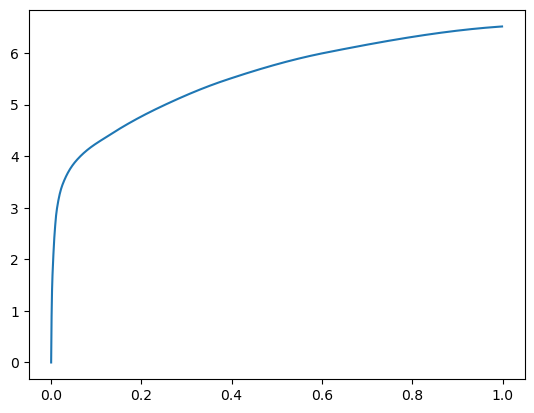

[0.00000000e+00 5.42640686e-04 1.15108490e-03 2.29930878e-03
 4.52899933e-03 7.69329071e-03 1.33142471e-02 2.79226303e-02
 6.59723282e-02 1.47631645e-01 2.56011009e-01 3.99647713e-01
 6.12141609e-01 1.00000000e+00] betas
[0.         0.44313493 0.48861867 0.49679226 0.48161805 0.52533714
 0.5213615  0.48373333 0.50263355 0.52164568 0.48981659 0.40512148
 0.384019   0.49368195] r
-22482.458794922564 score post


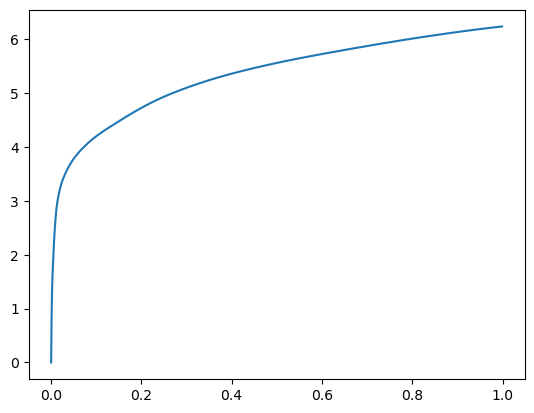

[0.00000000e+00 5.86509705e-04 1.19876862e-03 2.33554840e-03
 4.57668304e-03 7.40909576e-03 1.20801926e-02 2.42357254e-02
 5.51023483e-02 1.20198250e-01 2.16128349e-01 3.64893913e-01
 6.21294975e-01 1.00000000e+00] betas
[0.         0.53246146 0.46017313 0.46099316 0.48797486 0.48545861
 0.46251002 0.47478843 0.43233494 0.47457465 0.49071809 0.50707779
 0.52998932 0.45183249] r
-22489.569152232263 score post


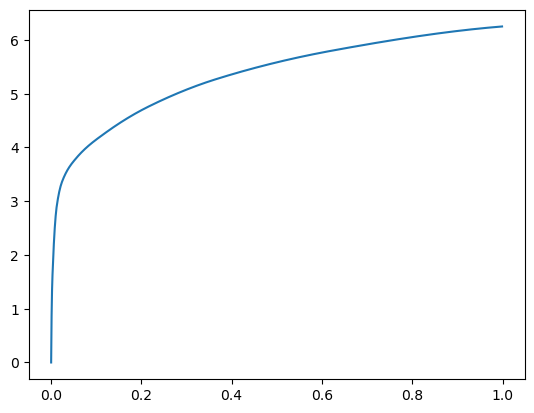

[0.00000000e+00 5.23567200e-04 1.14536285e-03 2.29740143e-03
 4.48131561e-03 7.23552704e-03 1.20058060e-02 2.43043900e-02
 6.02884293e-02 1.29599571e-01 2.27450371e-01 3.72605324e-01
 6.02877617e-01 1.00000000e+00] betas
[0.         0.45257148 0.47824818 0.42951332 0.46725371 0.44604631
 0.49326056 0.46819927 0.48389579 0.45651047 0.48523735 0.44657057
 0.48777521 0.49197908] r
-22481.621781595804 score post


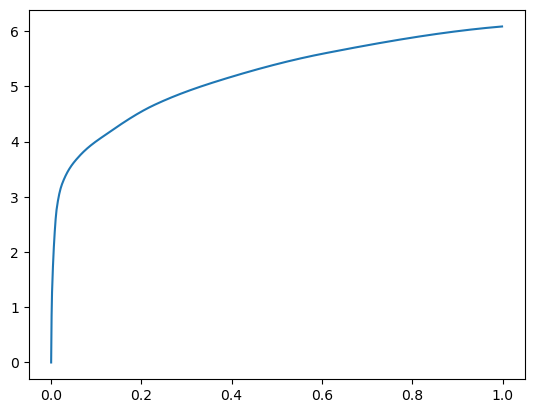

[0.00000000e+00 5.42640686e-04 1.15680695e-03 2.45952606e-03
 4.72736359e-03 7.76386261e-03 1.27363205e-02 2.63414383e-02
 6.32791519e-02 1.36404991e-01 2.33115196e-01 3.89788628e-01
 6.17774010e-01 1.00000000e+00] betas
[0.         0.47153034 0.46729701 0.53824114 0.51854223 0.46468142
 0.4364748  0.44915593 0.40927349 0.48236177 0.48815789 0.51486421
 0.512146   0.47071731] r
-22485.350609475372 score post


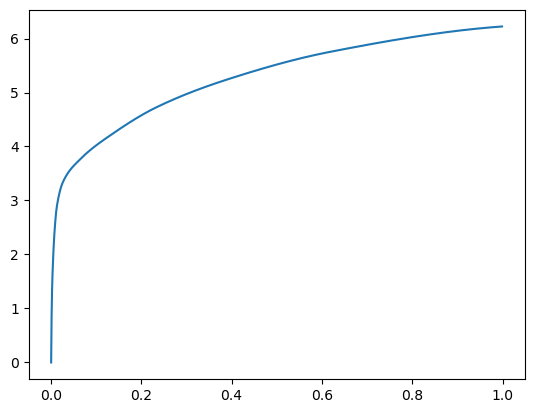

[0.00000000e+00 5.52177429e-04 1.19113922e-03 2.32791901e-03
 4.30011749e-03 7.21836090e-03 1.22976303e-02 2.66294479e-02
 7.24344254e-02 1.48865700e-01 2.48669624e-01 3.99243355e-01
 6.12912178e-01 1.00000000e+00] betas
[0.         0.44796886 0.45359991 0.52099897 0.47769045 0.4515177
 0.48141927 0.54755719 0.56922221 0.46774368 0.44362077 0.47354371
 0.44956359 0.51986919] r
-22480.269231963164 score post


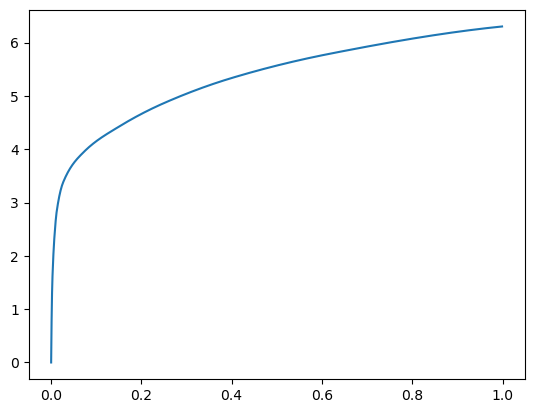

[0.00000000e+00 5.99861145e-04 1.31320953e-03 2.42900848e-03
 4.50992584e-03 7.83634186e-03 1.36575699e-02 2.73103714e-02
 6.41946793e-02 1.38537407e-01 2.45505333e-01 3.99062157e-01
 6.33883476e-01 1.00000000e+00] betas
[0.         0.48897308 0.48815691 0.46261804 0.46398485 0.52028139
 0.5330105  0.4409225  0.4569326  0.45753801 0.43532676 0.44566896
 0.54418567 0.54942027] r
-22480.269231963164 score post


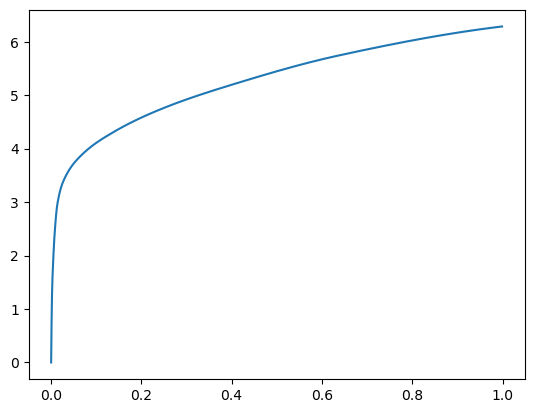

[0.00000000e+00 5.92231750e-04 1.29413605e-03 2.46715546e-03
 4.67586517e-03 7.78675079e-03 1.27248764e-02 2.66656876e-02
 6.58540726e-02 1.46771431e-01 2.72294044e-01 4.48239326e-01
 6.69856071e-01 1.00000000e+00] betas
[0.         0.51448455 0.47760727 0.48947524 0.48963504 0.46464991
 0.4613421  0.50836673 0.45383681 0.48449945 0.51247077 0.50627392
 0.42634279 0.42094299] r
-22480.269231963164 score post


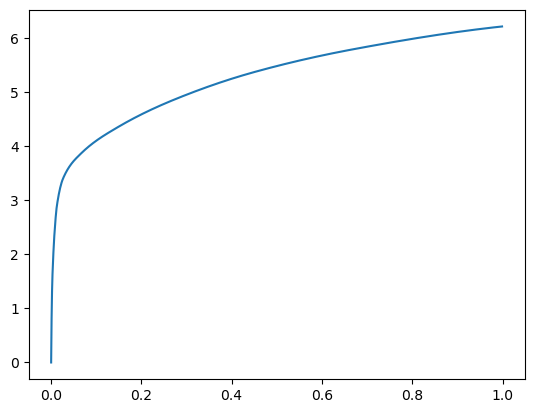

[0.00000000e+00 5.44548035e-04 1.22737885e-03 2.31266022e-03
 4.34398651e-03 7.39574432e-03 1.22194290e-02 2.38828659e-02
 6.12096786e-02 1.37696266e-01 2.49617577e-01 4.04404640e-01
 6.34591103e-01 1.00000000e+00] betas
[0.         0.4743953  0.51296271 0.49402615 0.45910977 0.46922413
 0.4864141  0.58007994 0.55096613 0.54979843 0.45127495 0.46423358
 0.477745   0.4806564 ] r
-22480.269231963164 score post


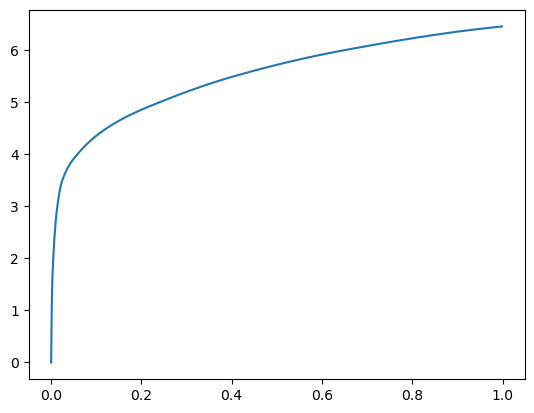

[0.00000000e+00 5.71250916e-04 1.23691559e-03 2.33554840e-03
 4.58621979e-03 7.98130035e-03 1.34096146e-02 2.37779617e-02
 5.54971695e-02 1.17800713e-01 2.30586052e-01 3.90955925e-01
 6.25197411e-01 1.00000000e+00] betas
[0.         0.47908283 0.52331201 0.46805456 0.49740003 0.53536416
 0.48739453 0.43702826 0.44835565 0.4423653  0.54201445 0.55195669
 0.5074522  0.53132283] r
-22482.458794922564 score post


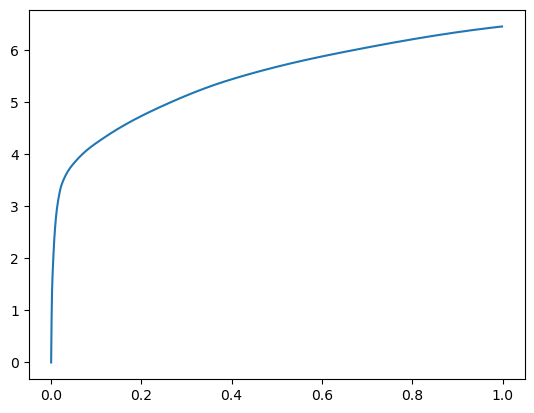

[0.00000000e+00 5.92231750e-04 1.21974945e-03 2.39658356e-03
 4.67777252e-03 7.79819489e-03 1.31940842e-02 2.58474350e-02
 6.57491684e-02 1.44452095e-01 2.56278038e-01 4.08423424e-01
 6.45462990e-01 1.00000000e+00] betas
[0.         0.47050435 0.47765447 0.51592475 0.49438597 0.42737252
 0.49975943 0.48457916 0.46202249 0.40548499 0.45858972 0.50696981
 0.57800127 0.44569428] r
-22480.269231963164 score post


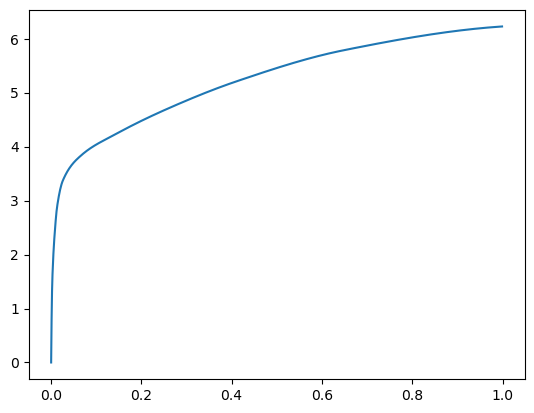

[0.00000000e+00 6.03675842e-04 1.23691559e-03 2.30884552e-03
 4.42981720e-03 7.88021088e-03 1.29976273e-02 2.50196457e-02
 6.57167435e-02 1.60685539e-01 2.81931877e-01 4.31578636e-01
 6.26732826e-01 1.00000000e+00] betas
[0.         0.51039212 0.4736201  0.42937954 0.49996712 0.51949684
 0.46238276 0.49859956 0.54309119 0.52817954 0.55225391 0.4355207
 0.35749651 0.45201326] r
-22480.269231963164 score post


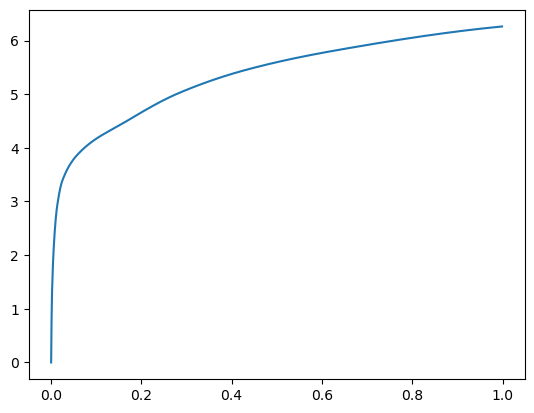

[0.00000000e+00 5.67436218e-04 1.20067596e-03 2.41374969e-03
 4.50229645e-03 7.67230988e-03 1.29156113e-02 2.41041183e-02
 5.62524796e-02 1.33273125e-01 2.33038902e-01 3.70602608e-01
 6.07127190e-01 1.00000000e+00] betas
[0.         0.48413962 0.45491537 0.52259461 0.45192988 0.50890649
 0.55114405 0.49309704 0.46016155 0.50573462 0.47773146 0.43249827
 0.52322475 0.48634254] r
-22481.990460408004 score post


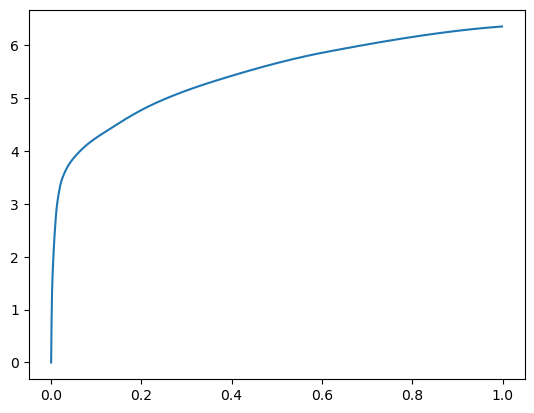

[0.00000000e+00 5.73158264e-04 1.27124786e-03 2.42900848e-03
 4.72354889e-03 7.83252716e-03 1.23300552e-02 2.23703384e-02
 5.43928146e-02 1.26959801e-01 2.26925850e-01 3.82905006e-01
 6.05713844e-01 1.00000000e+00] betas
[0.         0.48766212 0.52994051 0.47533971 0.49560126 0.47442198
 0.41740323 0.49675708 0.44719407 0.47470966 0.46167063 0.57562422
 0.52600473 0.49651706] r
-22483.17300509828 score post


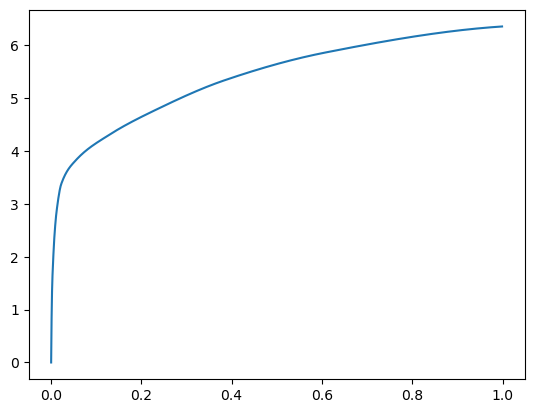

[0.00000000e+00 5.75065613e-04 1.20449066e-03 2.34317780e-03
 4.54616547e-03 7.68756866e-03 1.31521225e-02 2.43940353e-02
 6.45475388e-02 1.46664619e-01 2.58822441e-01 3.98232460e-01
 6.10081673e-01 1.00000000e+00] betas
[0.         0.45442309 0.46860509 0.49561213 0.49128079 0.49721613
 0.45275601 0.40602626 0.54506391 0.58344823 0.4752674  0.43258248
 0.47235968 0.51313928] r
-22480.269231963164 score post


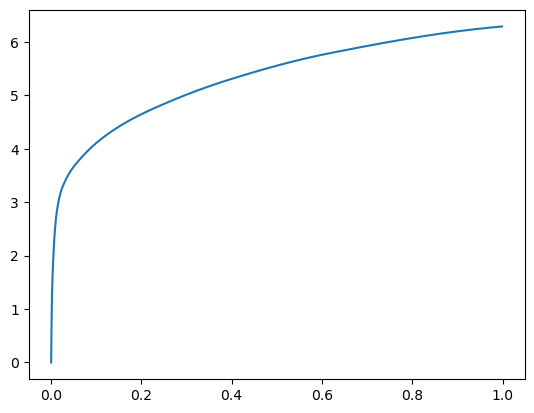

[0.00000000e+00 6.13212585e-04 1.28459930e-03 2.45189667e-03
 4.67967987e-03 7.78865814e-03 1.39741898e-02 3.04327011e-02
 7.07483292e-02 1.39101982e-01 2.49712944e-01 4.05169487e-01
 6.27514839e-01 1.00000000e+00] betas
[0.         0.56407329 0.47098107 0.47542955 0.4473528  0.44372079
 0.49724578 0.59364857 0.46531389 0.44440069 0.49820612 0.48589445
 0.4582756  0.47433986] r
-22480.269231963164 score post


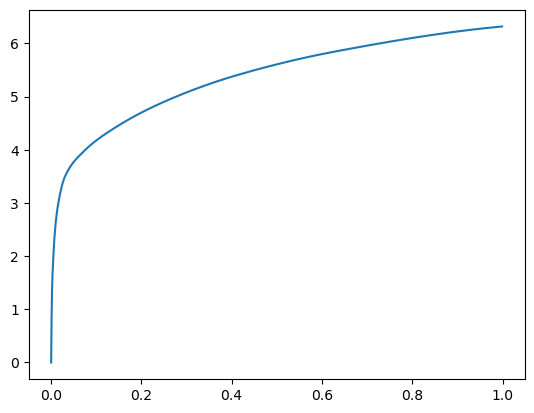

[0.00000000e+00 5.17845154e-04 1.17397308e-03 2.27642059e-03
 4.59957123e-03 8.06331635e-03 1.43098831e-02 2.65245438e-02
 6.25486374e-02 1.34015083e-01 2.39243507e-01 3.89824867e-01
 6.20280266e-01 1.00000000e+00] betas
[0.         0.49407855 0.48093562 0.51883988 0.54362417 0.49402612
 0.5177288  0.50651936 0.43839413 0.44523107 0.51117109 0.48966185
 0.50854926 0.48616421] r
-22480.269231963164 score post


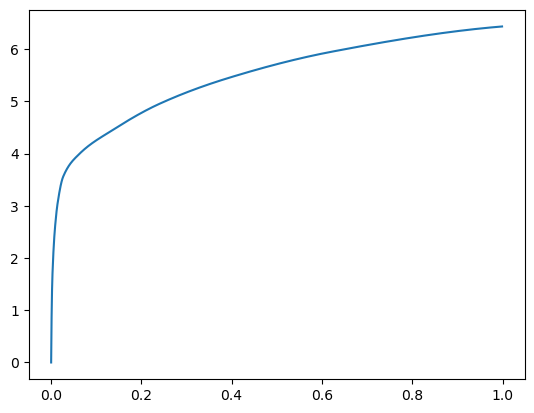

[0.00000000e+00 5.19752502e-04 1.19876862e-03 2.24971771e-03
 4.28485870e-03 7.55977631e-03 1.30453110e-02 2.32000351e-02
 5.85088730e-02 1.36849403e-01 2.39089012e-01 3.91600609e-01
 6.14996910e-01 1.00000000e+00] betas
[0.         0.50594479 0.53456026 0.39951949 0.44330206 0.50044608
 0.53323847 0.46350388 0.45262652 0.47455932 0.44566319 0.5116987
 0.48690354 0.47442967] r
-22480.269231963164 score post


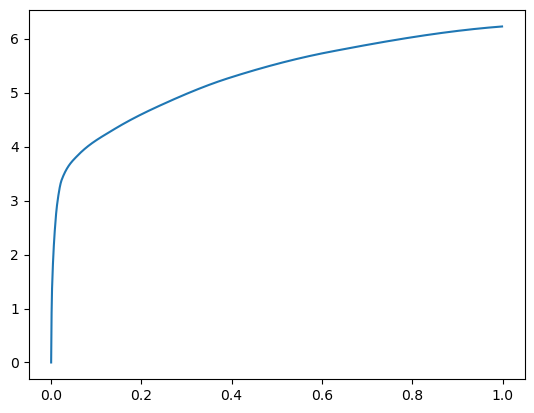

[0.00000000e+00 4.89234924e-04 1.06334686e-03 2.23827362e-03
 4.46414948e-03 7.65132904e-03 1.24177933e-02 2.20994949e-02
 5.83333969e-02 1.37413979e-01 2.48589516e-01 3.92880440e-01
 6.12208366e-01 1.00000000e+00] betas
[0.         0.41619174 0.46074096 0.51231084 0.43818962 0.52788737
 0.49236451 0.44294252 0.48749044 0.4617049  0.50473126 0.49547022
 0.43492704 0.4914846 ] r
-22481.990460408004 score post


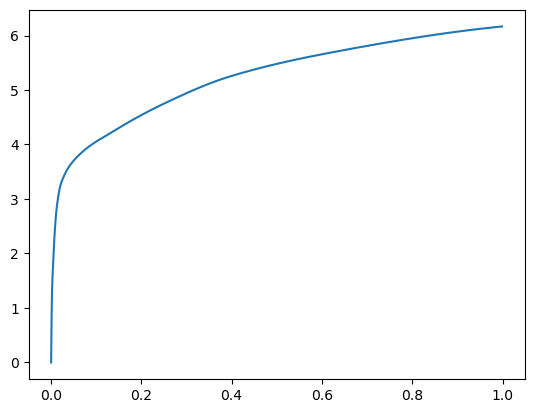

[0.00000000e+00 5.57899475e-04 1.18923187e-03 2.36225128e-03
 4.84943390e-03 7.77912140e-03 1.23929977e-02 2.34098434e-02
 6.02998734e-02 1.43134117e-01 2.48299599e-01 3.84421349e-01
 6.23101234e-01 1.00000000e+00] betas
[0.         0.46396312 0.5326142  0.52167627 0.52182183 0.47093637
 0.46735472 0.4979435  0.47730527 0.52247796 0.49871324 0.47345892
 0.48069948 0.43123432] r
-22480.269231963164 score post


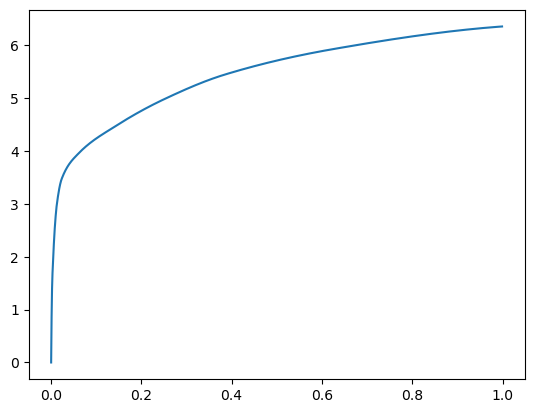

[0.00000000e+00 5.88417053e-04 1.16062164e-03 2.20203400e-03
 4.38404083e-03 7.29465485e-03 1.17940903e-02 2.14757919e-02
 5.57928085e-02 1.29519463e-01 2.28560448e-01 3.60720634e-01
 5.85949898e-01 1.00000000e+00] betas
[0.         0.50003149 0.42932278 0.46680967 0.45126997 0.43421757
 0.46350928 0.42604866 0.52438036 0.48403019 0.46548415 0.41938281
 0.4927428  0.52018948] r
-22481.621781595804 score post


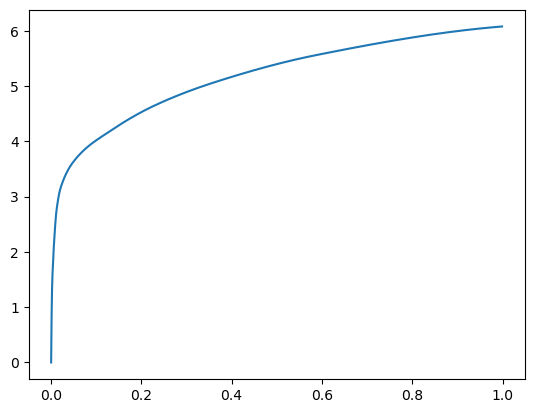

[0.00000000e+00 5.48362732e-04 1.17015839e-03 2.22301483e-03
 4.51374054e-03 7.74860382e-03 1.27496719e-02 2.58264542e-02
 6.05478287e-02 1.34593010e-01 2.36454964e-01 3.90879631e-01
 6.18365288e-01 1.00000000e+00] betas
[0.         0.4439368  0.47768615 0.51970842 0.52624192 0.50551203
 0.45431079 0.50852129 0.47638674 0.4661608  0.45265736 0.53816313
 0.4677808  0.45770255] r
-22485.310960374136 score post


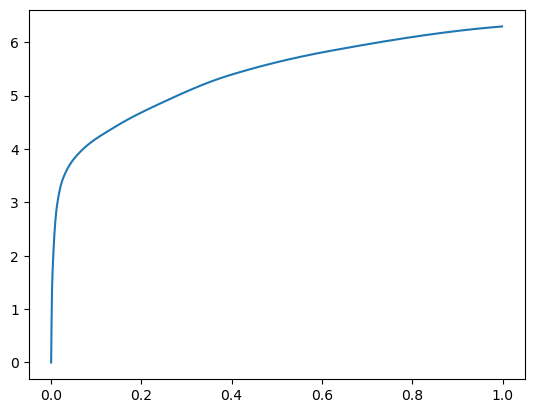

[0.00000000e+00 5.97953796e-04 1.24645233e-03 2.25734711e-03
 4.34970856e-03 7.32517242e-03 1.23853683e-02 2.39019394e-02
 5.63669205e-02 1.30661964e-01 2.39251137e-01 3.75279427e-01
 6.01609230e-01 1.00000000e+00] betas
[0.         0.53345803 0.42613808 0.41646236 0.48885808 0.45448402
 0.52557435 0.46907103 0.4389724  0.47120113 0.52111336 0.46822023
 0.44706918 0.52058043] r
-22480.269231963164 score post


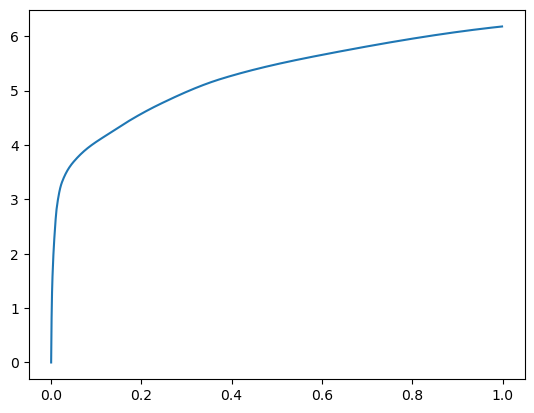

[0.00000000e+00 5.23567200e-04 1.22928619e-03 2.42519379e-03
 4.54998016e-03 7.78675079e-03 1.25131607e-02 2.45580673e-02
 6.21976852e-02 1.40769005e-01 2.41593361e-01 3.81840706e-01
 6.29969597e-01 1.00000000e+00] betas
[0.         0.45312549 0.50587225 0.53079328 0.49338273 0.47746509
 0.48778355 0.40018088 0.45716382 0.49678215 0.47002    0.45388992
 0.52582514 0.48975222] r
-22483.215759872455 score post


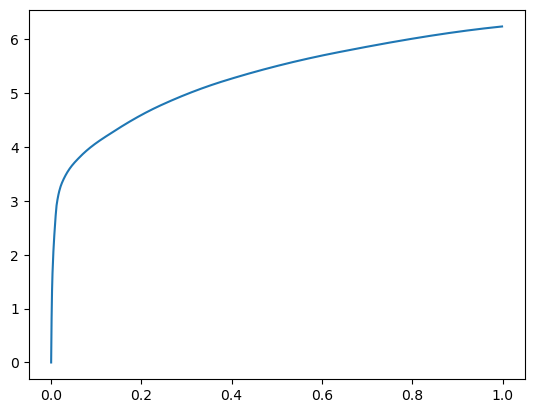

[0.00000000e+00 5.57899475e-04 1.23119354e-03 2.27642059e-03
 4.21428680e-03 7.30800629e-03 1.15385056e-02 2.52103806e-02
 6.64014816e-02 1.44276619e-01 2.49175072e-01 4.03370857e-01
 6.35779381e-01 1.00000000e+00] betas
[0.         0.53198504 0.49414222 0.40993225 0.43885556 0.51748513
 0.44896665 0.55580931 0.47143359 0.43580616 0.50790205 0.54386927
 0.44288447 0.45491334] r
-22485.2760344757 score post


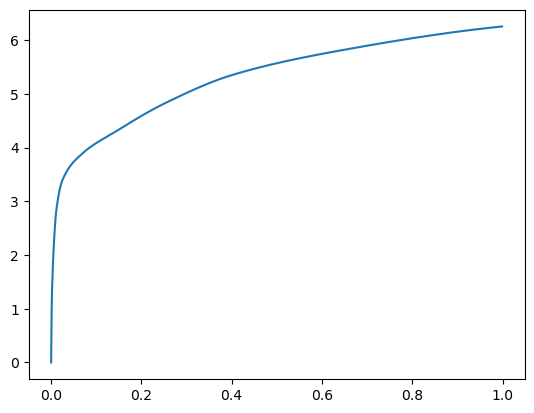

[0.00000000e+00 4.98771667e-04 1.11865997e-03 2.30121613e-03
 4.46987152e-03 7.40718842e-03 1.22594833e-02 2.38389969e-02
 6.38208389e-02 1.49127007e-01 2.48797417e-01 3.79807472e-01
 6.18824959e-01 1.00000000e+00] betas
[0.         0.4269334  0.51059549 0.49849746 0.47940803 0.4672546
 0.48580767 0.5511337  0.56315374 0.48067806 0.44420277 0.47322391
 0.54068603 0.49212534] r
-22480.269231963164 score post


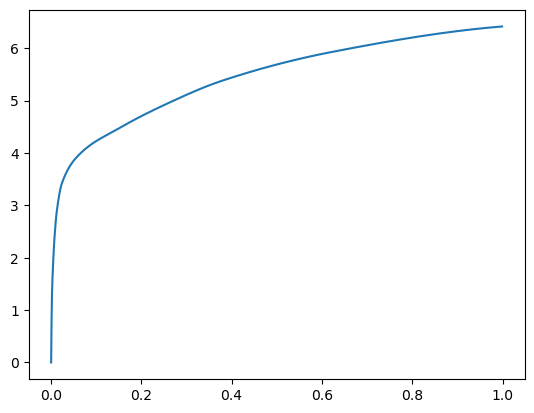

[0.00000000e+00 5.75065613e-04 1.20639801e-03 2.45189667e-03
 4.78458405e-03 8.09383392e-03 1.36537552e-02 2.52733231e-02
 5.96723557e-02 1.44402504e-01 2.55274773e-01 3.96235466e-01
 6.18088722e-01 1.00000000e+00] betas
[0.         0.43126628 0.46666496 0.55737216 0.47949128 0.48821043
 0.501779   0.45637429 0.47398437 0.52698774 0.53105588 0.42520712
 0.44904108 0.54453421] r
-22483.17300509828 score post


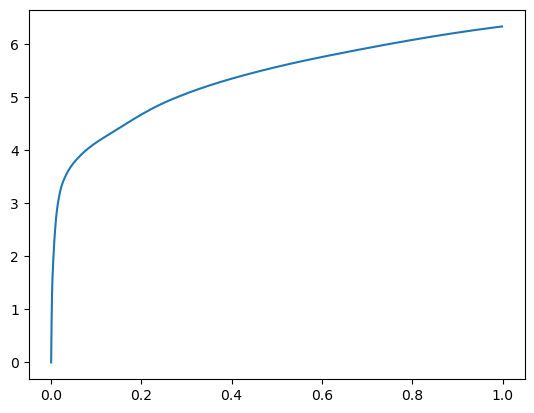

[0.00000000e+00 6.47544861e-04 1.34181976e-03 2.47287750e-03
 4.86278534e-03 8.20255280e-03 1.36137009e-02 2.65798569e-02
 6.43892288e-02 1.44684792e-01 2.44322777e-01 4.04200554e-01
 6.52224541e-01 1.00000000e+00] betas
[0.         0.56137447 0.48399393 0.40096628 0.46120186 0.50896038
 0.49419606 0.47622831 0.43539474 0.47060731 0.47892238 0.56473182
 0.48290036 0.40514779] r
-22481.621781595804 score post


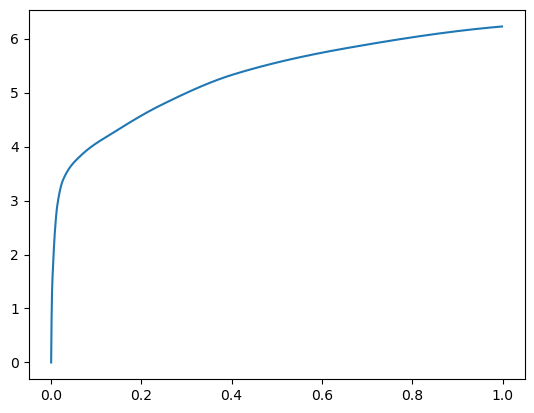

[0.00000000e+00 5.42640686e-04 1.18350983e-03 2.43473053e-03
 4.90856171e-03 8.01563263e-03 1.29919052e-02 2.49242783e-02
 6.54134750e-02 1.47789955e-01 2.48290062e-01 3.79046440e-01
 6.04557991e-01 1.00000000e+00] betas
[0.         0.45102419 0.49963999 0.53610334 0.47371782 0.4992409
 0.47393271 0.46870716 0.54743274 0.54882314 0.47311511 0.41158626
 0.53136516 0.5001919 ] r
-22480.269231963164 score post


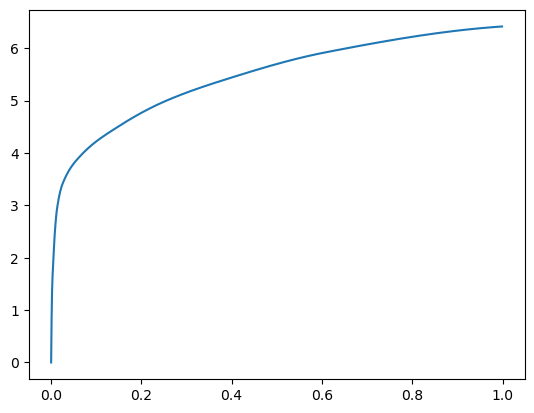

[0.00000000e+00 5.94139099e-04 1.24835968e-03 2.41184235e-03
 4.98485565e-03 8.07666779e-03 1.34572983e-02 2.73542404e-02
 6.51788712e-02 1.37368202e-01 2.38739967e-01 3.95449638e-01
 6.08544350e-01 1.00000000e+00] betas
[0.         0.528418   0.4681099  0.51253403 0.50747093 0.43501888
 0.51916153 0.46243301 0.49825337 0.39196279 0.45026913 0.58909781
 0.50078699 0.49997718] r
-22481.990460408004 score post


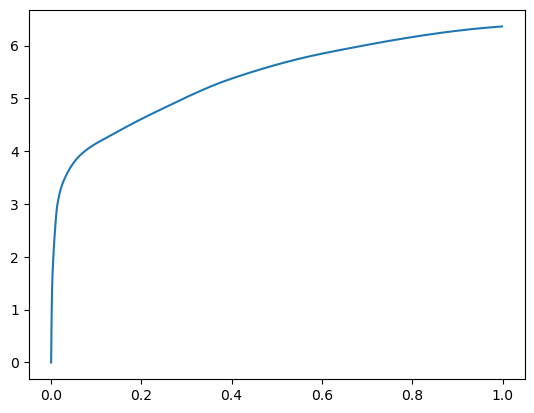

[0.00000000e+00 5.46455383e-04 1.21784210e-03 2.28023529e-03
 4.62436676e-03 8.04233551e-03 1.28946304e-02 2.70280838e-02
 6.33001328e-02 1.54419899e-01 2.68279076e-01 4.02932167e-01
 6.14701271e-01 1.00000000e+00] betas
[0.         0.48865849 0.49184122 0.47684269 0.48156455 0.4940495
 0.45693173 0.5215815  0.48667801 0.57788292 0.48810026 0.42460735
 0.42072398 0.53220224] r
-22482.458794922564 score post


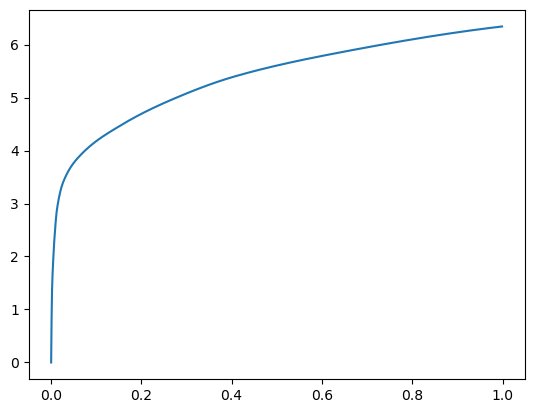

[0.00000000e+00 5.44548035e-04 1.21021271e-03 2.30121613e-03
 4.69684601e-03 8.09574127e-03 1.35564804e-02 2.71825790e-02
 6.37884140e-02 1.37753487e-01 2.45310783e-01 3.93973351e-01
 6.41657829e-01 1.00000000e+00] betas
[0.         0.46581662 0.49444482 0.48410997 0.48899138 0.47676835
 0.46943091 0.44663427 0.51177662 0.53735015 0.42493859 0.46619958
 0.44981567 0.43487133] r
-22480.269231963164 score post


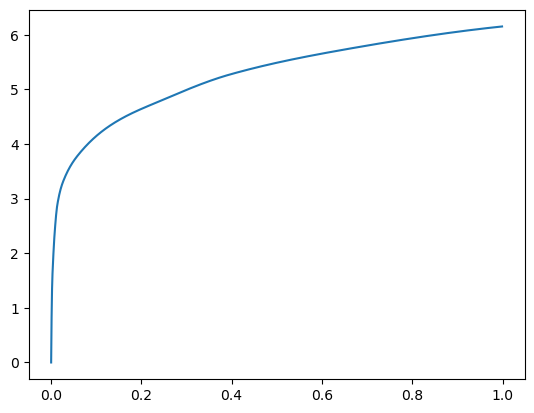

[0.00000000e+00 5.54084778e-04 1.18541718e-03 2.21920013e-03
 4.45270538e-03 7.70282745e-03 1.28412247e-02 2.65188217e-02
 5.85985184e-02 1.17129326e-01 2.25556374e-01 3.69660378e-01
 6.15963936e-01 1.00000000e+00] betas
[0.         0.51644038 0.51980149 0.40795265 0.50480295 0.46957227
 0.46570585 0.52586514 0.43000705 0.40854648 0.51279059 0.44351964
 0.52276746 0.47257052] r
-22481.990460408004 score post


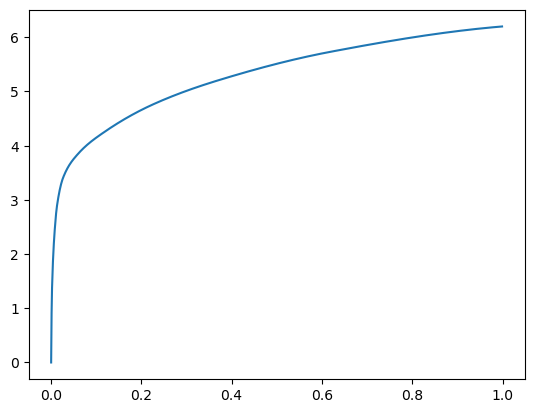

[0.00000000e+00 5.08308411e-04 1.05762482e-03 2.17533112e-03
 4.22573090e-03 7.41100311e-03 1.24692917e-02 2.36120224e-02
 5.60140610e-02 1.24859810e-01 2.27690697e-01 3.86033058e-01
 6.13219261e-01 1.00000000e+00] betas
[0.         0.42662593 0.42666319 0.52013527 0.46115869 0.47271316
 0.4919868  0.56600664 0.46060921 0.47369447 0.49255252 0.5473196
 0.46748722 0.42835204] r
-22481.990460408004 score post


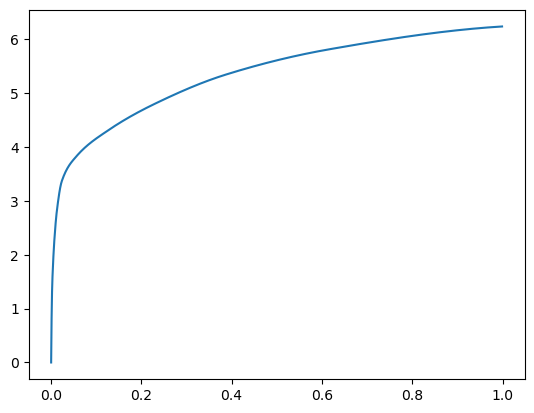

[0.00000000e+00 5.73158264e-04 1.24073029e-03 2.39276886e-03
 4.70256805e-03 8.18920135e-03 1.36194229e-02 2.33049393e-02
 5.71813583e-02 1.27879143e-01 2.28735924e-01 3.63123894e-01
 5.80431938e-01 1.00000000e+00] betas
[0.         0.57075193 0.42854283 0.43400661 0.50413714 0.51308047
 0.49123282 0.4633901  0.49894193 0.47820353 0.45200095 0.43983037
 0.48695744 0.55797286] r
-22481.990460408004 score post


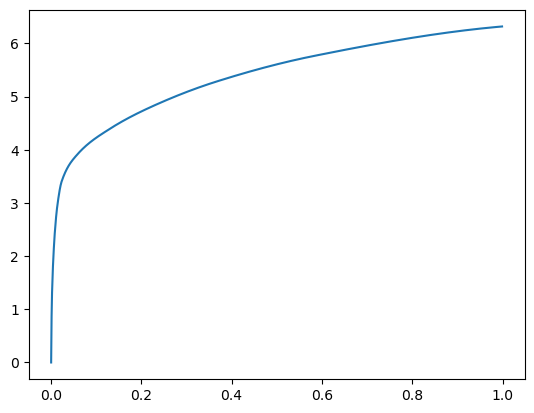

[0.00000000e+00 4.70161438e-04 1.18732452e-03 2.48050690e-03
 4.74071503e-03 8.01563263e-03 1.32398605e-02 2.32038498e-02
 5.55887222e-02 1.26492500e-01 2.35741615e-01 3.90591621e-01
 6.22820854e-01 1.00000000e+00] betas
[0.         0.37545125 0.51428274 0.54980709 0.50837226 0.49148862
 0.50440307 0.4123985  0.44545548 0.45886838 0.51942267 0.50868226
 0.48066456 0.46619944] r
-22485.31087175447 score post


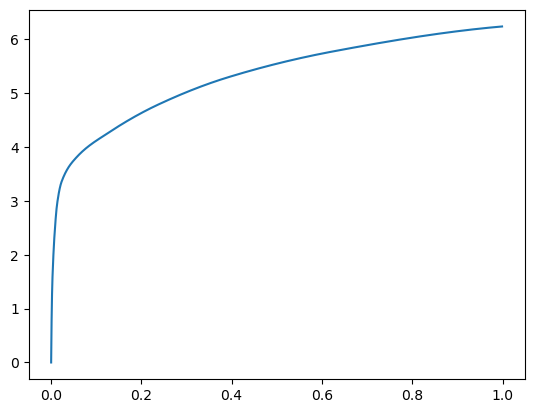

[0.00000000e+00 6.05583191e-04 1.31702423e-03 2.47859955e-03
 4.58049774e-03 7.67993927e-03 1.22861862e-02 2.32648849e-02
 5.95560074e-02 1.36792183e-01 2.39981651e-01 3.85809898e-01
 6.14394188e-01 1.00000000e+00] betas
[0.         0.49409514 0.50424613 0.45451195 0.45476282 0.48474813
 0.42843582 0.44772473 0.48158157 0.46607472 0.44534606 0.53095026
 0.56025542 0.50043912] r
-22480.269231963164 score post


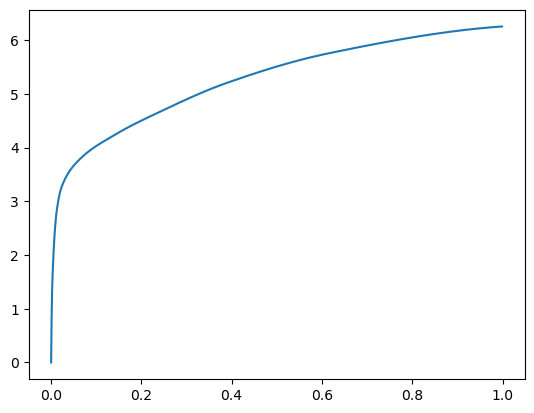

[0.00000000e+00 5.88417053e-04 1.25026703e-03 2.44426727e-03
 4.67014313e-03 7.78675079e-03 1.34134293e-02 2.81019211e-02
 7.17382431e-02 1.60178185e-01 2.77607918e-01 4.19611931e-01
 6.25573158e-01 1.00000000e+00] betas
[0.         0.5225912  0.48786136 0.46959514 0.46430412 0.48482217
 0.51590092 0.46877789 0.44042095 0.49215651 0.49493325 0.4004234
 0.47556353 0.4340171 ] r
-22480.269231963164 score post


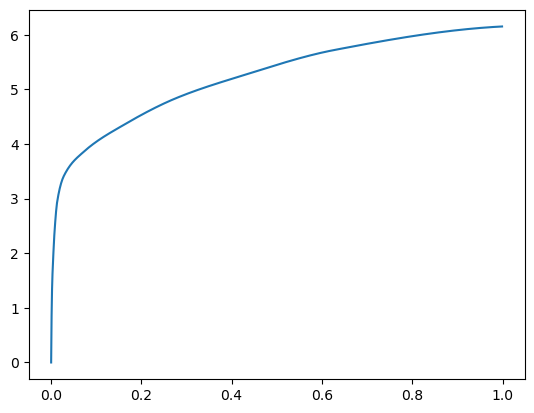

[0.00000000e+00 5.27381897e-04 1.13964081e-03 2.24018097e-03
 4.38022614e-03 7.28511810e-03 1.17979050e-02 2.32439041e-02
 6.23311996e-02 1.41879082e-01 2.47570992e-01 4.05201912e-01
 6.02799416e-01 1.00000000e+00] betas
[0.         0.47602697 0.48109149 0.50804692 0.46650831 0.44274071
 0.46902654 0.54542181 0.48754183 0.52007669 0.45943134 0.53715562
 0.37115154 0.47150844] r
-22488.312942629327 score post


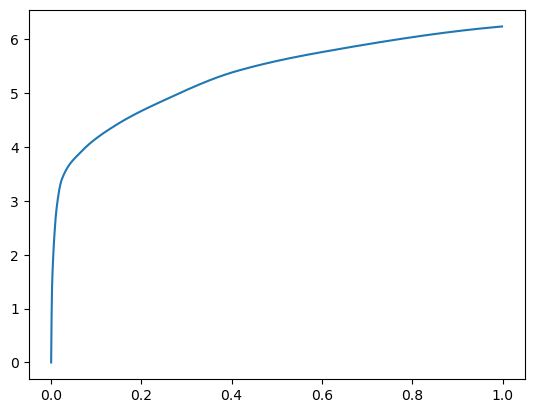

[0.00000000e+00 5.31196594e-04 1.14345551e-03 2.15816498e-03
 4.30774689e-03 7.47585297e-03 1.23052597e-02 2.20117569e-02
 5.78374863e-02 1.27011299e-01 2.32272148e-01 3.63560677e-01
 5.97350121e-01 1.00000000e+00] betas
[0.         0.49946656 0.45534042 0.4681445  0.48672773 0.56129214
 0.44843516 0.38528444 0.46757009 0.51717203 0.46769386 0.42546413
 0.48678141 0.50355517] r
-22480.269231963164 score post


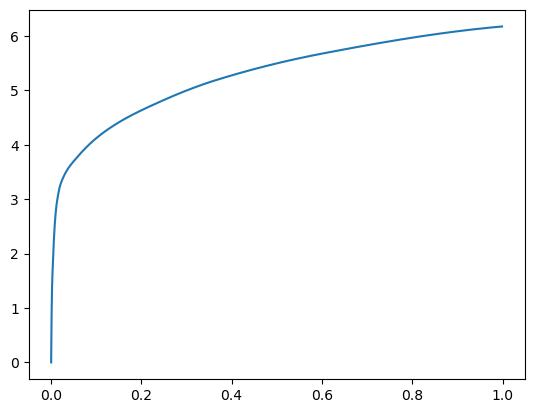

[0.00000000e+00 5.02586365e-04 1.13391876e-03 2.16388702e-03
 4.25624847e-03 6.78920746e-03 1.12447739e-02 2.29082108e-02
 6.05726242e-02 1.24239922e-01 2.29960442e-01 3.79490852e-01
 6.15410805e-01 1.00000000e+00] betas
[0.         0.43093054 0.50781665 0.48394749 0.52354029 0.40481854
 0.44589446 0.46532018 0.5082999  0.40145928 0.48823629 0.55997839
 0.51745084 0.41169999] r
-22485.70121138277 score post


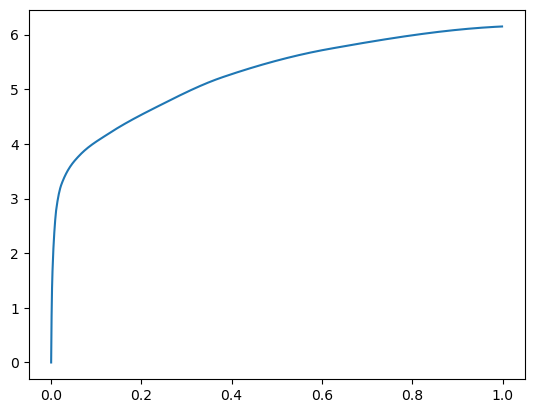

[0.00000000e+00 5.52177429e-04 1.14536285e-03 2.15244293e-03
 3.98540497e-03 6.90174103e-03 1.19371414e-02 2.52027512e-02
 6.21328354e-02 1.40515327e-01 2.46777534e-01 3.73612404e-01
 5.77235222e-01 1.00000000e+00] betas
[0.         0.44229782 0.4945596  0.47560218 0.46809766 0.53856826
 0.48866666 0.53871137 0.46470423 0.50181521 0.50470421 0.42522516
 0.44274032 0.50385976] r
-22485.70121138277 score post


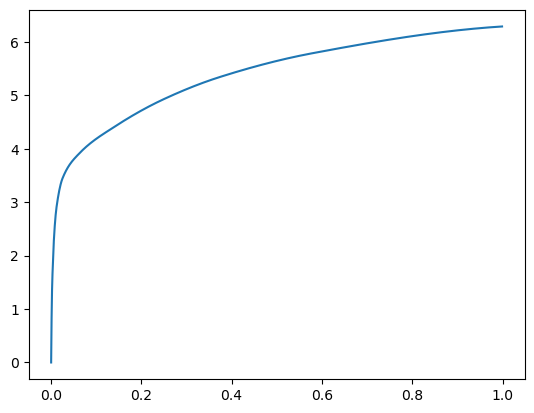

[0.00000000e+00 6.01768494e-04 1.19495392e-03 2.26879120e-03
 4.23908234e-03 6.90174103e-03 1.18570328e-02 2.27575302e-02
 5.75037003e-02 1.29719734e-01 2.27381706e-01 3.65902901e-01
 5.89848518e-01 1.00000000e+00] betas
[0.         0.53206603 0.4876064  0.48245465 0.45785162 0.41817851
 0.51454817 0.47706496 0.49666105 0.44287455 0.44054732 0.52481705
 0.46553883 0.52928621] r
-22480.269231963164 score post


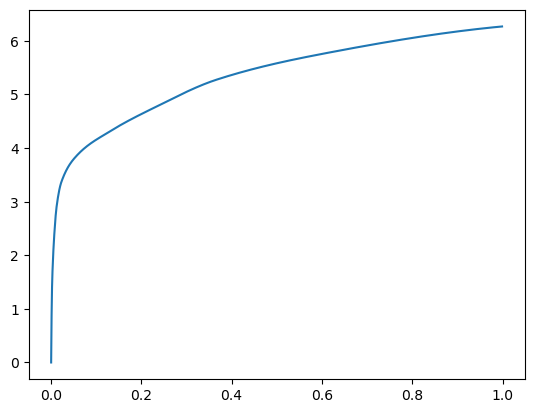

[0.00000000e+00 5.42640686e-04 1.11103058e-03 2.10285187e-03
 4.07695770e-03 7.16304779e-03 1.18703842e-02 2.30169296e-02
 5.65881729e-02 1.35735512e-01 2.44843483e-01 3.77104759e-01
 6.18926048e-01 1.00000000e+00] betas
[0.         0.46915617 0.4220662  0.42944333 0.48357064 0.53692617
 0.50363884 0.5380986  0.50468637 0.52995985 0.5222662  0.45758063
 0.55007447 0.43577746] r
-22481.990460408004 score post


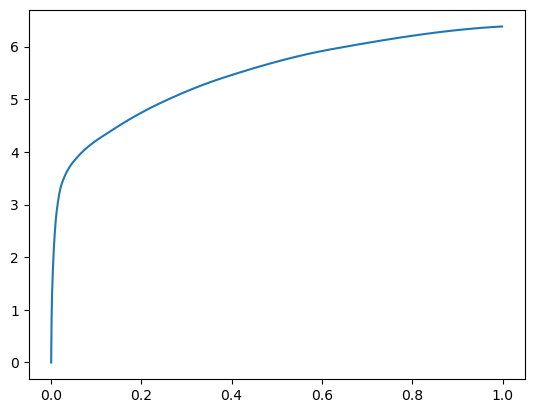

[0.00000000e+00 5.69343567e-04 1.28078461e-03 2.61974335e-03
 4.87995148e-03 8.03279877e-03 1.33752823e-02 2.52618790e-02
 6.08568192e-02 1.36023521e-01 2.37584114e-01 3.78466606e-01
 5.86037636e-01 1.00000000e+00] betas
[0.         0.51827584 0.54696697 0.53820455 0.44538986 0.47359609
 0.52471927 0.4278066  0.48170661 0.47935574 0.44603083 0.57440664
 0.47780261 0.4490592 ] r
-22486.27574969735 score post


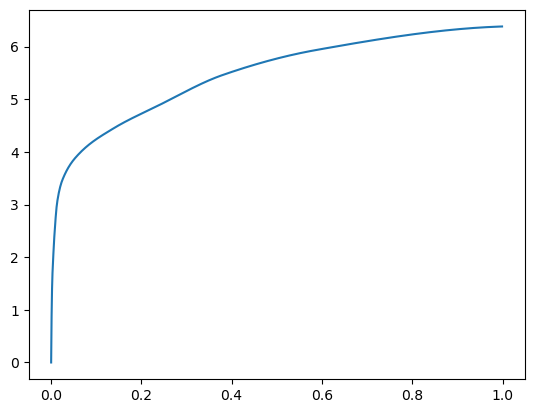

[0.00000000e+00 5.36918640e-04 1.14536285e-03 2.20012665e-03
 4.37831879e-03 7.50255585e-03 1.19524002e-02 2.35967636e-02
 5.77573776e-02 1.32813454e-01 2.44185448e-01 3.61355782e-01
 5.60420036e-01 1.00000000e+00] betas
[0.         0.51035663 0.47996703 0.4628165  0.50486063 0.48988491
 0.47398199 0.50296144 0.46858967 0.45545243 0.54312971 0.38465405
 0.46559954 0.57673443] r
-22480.269231963164 score post


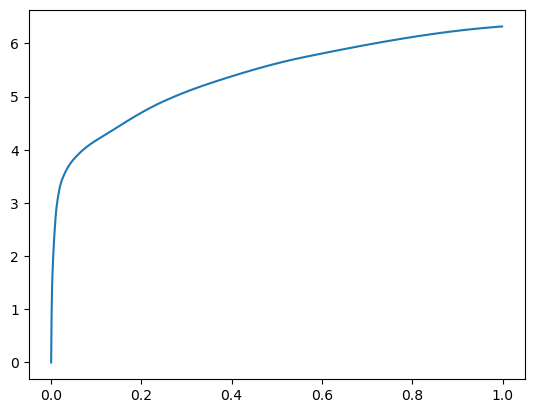

[0.00000000e+00 5.08308411e-04 1.11484528e-03 2.21729279e-03
 4.30583954e-03 7.36713409e-03 1.18703842e-02 2.26755142e-02
 5.72137833e-02 1.37560844e-01 2.36416817e-01 3.87022972e-01
 6.13125801e-01 1.00000000e+00] betas
[0.         0.43155534 0.45943618 0.46666896 0.48066226 0.47780178
 0.46710228 0.46961522 0.4732739  0.5269307  0.473079   0.48750392
 0.44638223 0.5198373 ] r
-22480.269231963164 score post


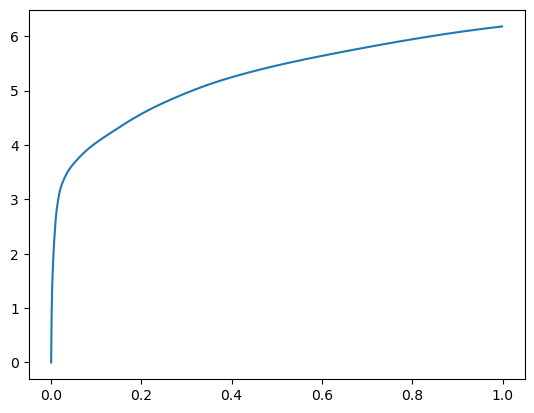

[0.00000000e+00 5.61714172e-04 1.22547150e-03 2.44808197e-03
 4.64916229e-03 7.85160065e-03 1.29728317e-02 2.61430740e-02
 6.59093857e-02 1.42136574e-01 2.43521690e-01 3.93277168e-01
 6.40681267e-01 1.00000000e+00] betas
[0.         0.44815119 0.5339052  0.52677631 0.45584113 0.51102895
 0.4318084  0.41490258 0.49536708 0.43541069 0.45308425 0.51763321
 0.48870766 0.39798631] r
-22485.2760344757 score post


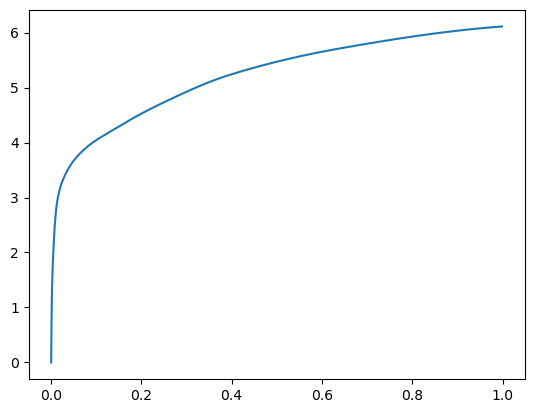

[0.00000000e+00 5.88417053e-04 1.15871429e-03 2.14290619e-03
 4.17423248e-03 6.89983368e-03 1.15289688e-02 2.45504379e-02
 5.91783524e-02 1.37566566e-01 2.42045403e-01 3.73742104e-01
 5.93739510e-01 1.00000000e+00] betas
[0.         0.50945306 0.42005623 0.49631701 0.50877267 0.45151937
 0.46719978 0.59294684 0.52886211 0.53643643 0.49176278 0.51699451
 0.49022954 0.50677125] r
-22484.52742382129 score post


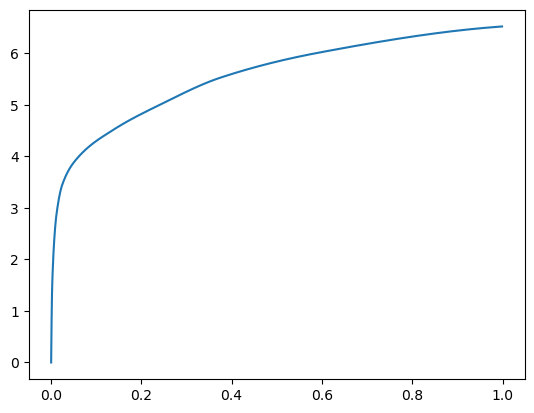

[0.00000000e+00 5.78880310e-04 1.28078461e-03 2.37751007e-03
 4.53281403e-03 7.87639618e-03 1.39970779e-02 2.72092819e-02
 6.28366470e-02 1.37642860e-01 2.44370461e-01 3.71811867e-01
 5.97046852e-01 1.00000000e+00] betas
[0.         0.47542141 0.53976148 0.49299877 0.47161381 0.48425736
 0.51466074 0.45865304 0.43008853 0.50837973 0.46113953 0.4239152
 0.49667644 0.54011971] r
-22480.269231963164 score post


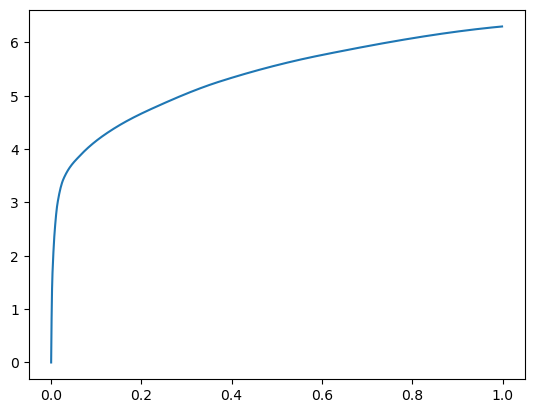

[0.00000000e+00 5.90324402e-04 1.20639801e-03 2.21157074e-03
 4.29630280e-03 7.50827789e-03 1.27820969e-02 2.50673294e-02
 6.37350082e-02 1.34688377e-01 2.46333122e-01 3.97479057e-01
 6.29979134e-01 1.00000000e+00] betas
[0.         0.46462702 0.46936553 0.43099144 0.45231034 0.52697105
 0.51053623 0.50468837 0.47833343 0.44902642 0.48348182 0.49726369
 0.53273573 0.50719626] r
-22482.458794922564 score post


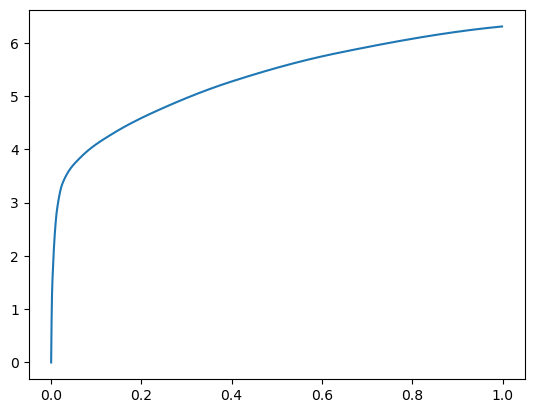

[0.00000000e+00 6.17027283e-04 1.27315521e-03 2.53582001e-03
 4.96006012e-03 8.17966461e-03 1.37300491e-02 2.68793106e-02
 6.89439774e-02 1.50507927e-01 2.68357277e-01 4.23272133e-01
 6.42609596e-01 1.00000000e+00] betas
[0.         0.52018704 0.4634475  0.47333575 0.54820493 0.49118848
 0.52736375 0.43173747 0.39894188 0.43469211 0.49617175 0.48310328
 0.45650261 0.46853709] r
-22482.458794922564 score post


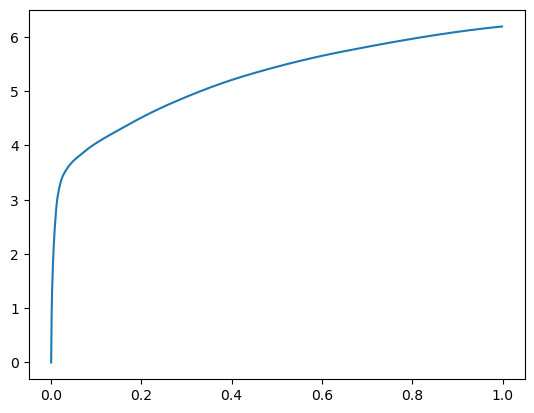

[0.00000000e+00 5.59806824e-04 1.21593475e-03 2.44045258e-03
 4.43553925e-03 7.29274750e-03 1.14927292e-02 2.14910507e-02
 6.26535416e-02 1.50221825e-01 2.62558937e-01 4.12472725e-01
 6.37827873e-01 1.00000000e+00] betas
[0.         0.53218929 0.46205681 0.48103538 0.43576038 0.45447421
 0.46051599 0.4831781  0.52074491 0.56557603 0.52591676 0.47390532
 0.46322671 0.48762237] r
-22480.269231963164 score post


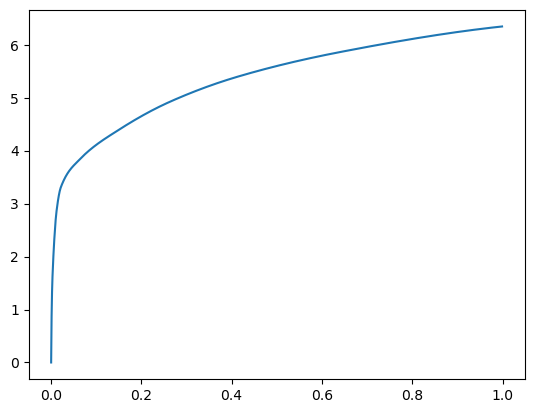

[0.00000000e+00 5.06401062e-04 1.18160248e-03 2.40421295e-03
 4.66251373e-03 7.87067413e-03 1.30109787e-02 2.66866684e-02
 7.15036392e-02 1.49853706e-01 2.52354622e-01 4.02546883e-01
 6.37497902e-01 1.00000000e+00] betas
[0.         0.44406315 0.55233456 0.47835046 0.48593583 0.47639423
 0.4137271  0.48715707 0.5417955  0.49535076 0.47886294 0.52180611
 0.49105379 0.43691793] r
-22480.269231963164 score post


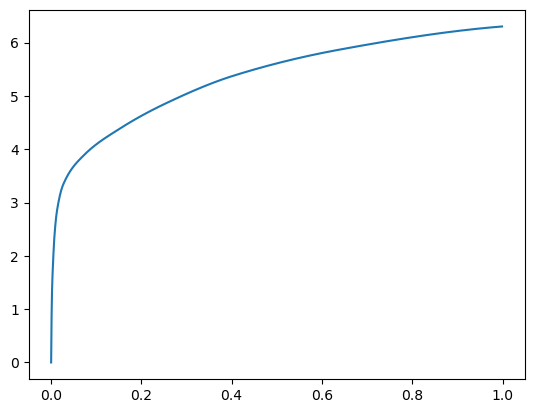

[0.00000000e+00 5.54084778e-04 1.13582611e-03 2.33554840e-03
 4.54425812e-03 7.75432587e-03 1.41611099e-02 2.96506882e-02
 7.14426041e-02 1.47820473e-01 2.51130104e-01 3.87415886e-01
 6.07905388e-01 1.00000000e+00] betas
[0.         0.49793996 0.48479959 0.52056466 0.46975663 0.47433302
 0.52477713 0.50107061 0.51806509 0.46088432 0.49087007 0.45917412
 0.49070139 0.47931986] r
-22480.269231963164 score post


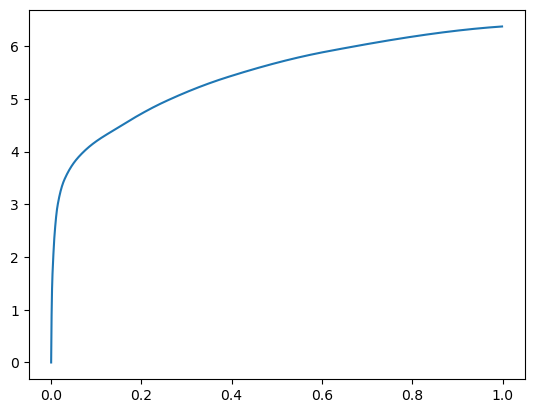

[0.00000000e+00 5.44548035e-04 1.13201141e-03 2.22873688e-03
 4.47368622e-03 7.78675079e-03 1.35717392e-02 2.76021957e-02
 6.34298325e-02 1.40103340e-01 2.40967751e-01 3.83650780e-01
 6.01300240e-01 1.00000000e+00] betas
[0.         0.43017258 0.4649738  0.51044637 0.50773827 0.53571518
 0.54080221 0.51251375 0.49040859 0.47255424 0.49052748 0.4619353
 0.49235515 0.45615431] r
-22480.269231963164 score post


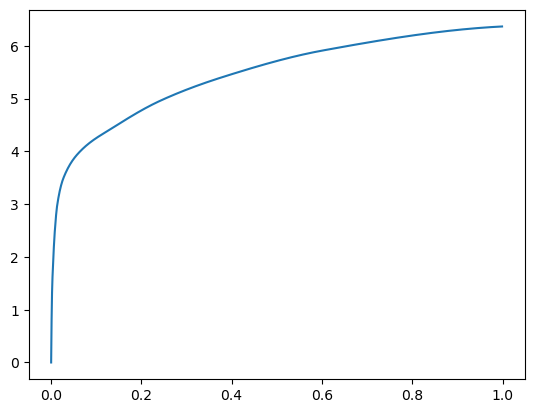

[0.00000000e+00 6.17027283e-04 1.27506256e-03 2.43854523e-03
 4.71401215e-03 7.78293610e-03 1.27458572e-02 2.44989395e-02
 5.55067062e-02 1.29212379e-01 2.26666451e-01 3.72317314e-01
 5.81036568e-01 1.00000000e+00] betas
[0.         0.51534859 0.49699435 0.46693153 0.49400502 0.47017283
 0.48179211 0.4502361  0.45320797 0.52516587 0.45406129 0.40877994
 0.48231155 0.52635369] r
-22481.990460408004 score post


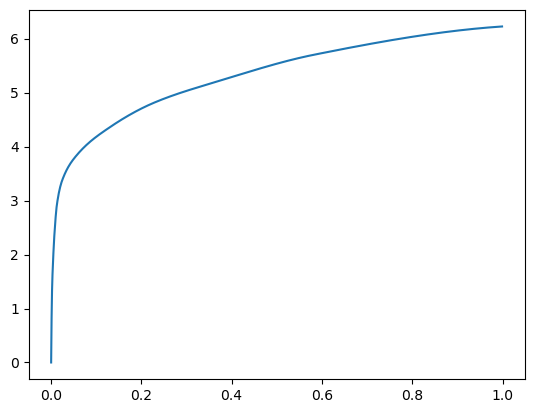

[0.00000000e+00 5.71250916e-04 1.18350983e-03 2.29740143e-03
 4.39548492e-03 7.39192963e-03 1.19638443e-02 2.35109329e-02
 5.57355881e-02 1.21495247e-01 2.21375465e-01 3.92205238e-01
 6.09436989e-01 1.00000000e+00] betas
[0.         0.57463801 0.42191476 0.47440246 0.42610164 0.45209889
 0.44386303 0.44293275 0.40017542 0.41607247 0.52070265 0.56112053
 0.46203239 0.50300115] r
-22483.215759872455 score post


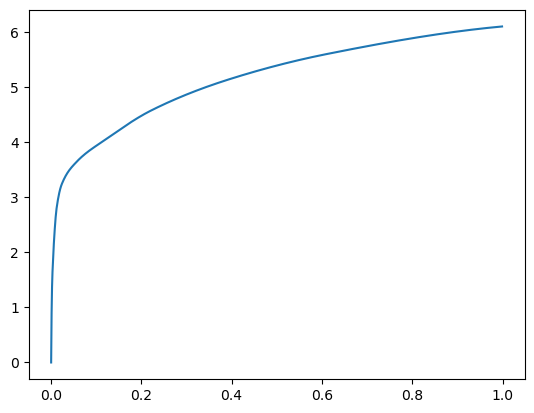

[0.00000000e+00 4.49180603e-04 1.08051300e-03 2.09522247e-03
 4.27722931e-03 7.36331940e-03 1.23434067e-02 2.59809494e-02
 7.06586838e-02 1.51305199e-01 2.51460075e-01 4.02554512e-01
 6.30160332e-01 1.00000000e+00] betas
[0.         0.42331758 0.48253223 0.51797188 0.4890719  0.469752
 0.43761967 0.5573832  0.53630496 0.43622112 0.439272   0.52503633
 0.46916424 0.47392229] r
-22480.269231963164 score post


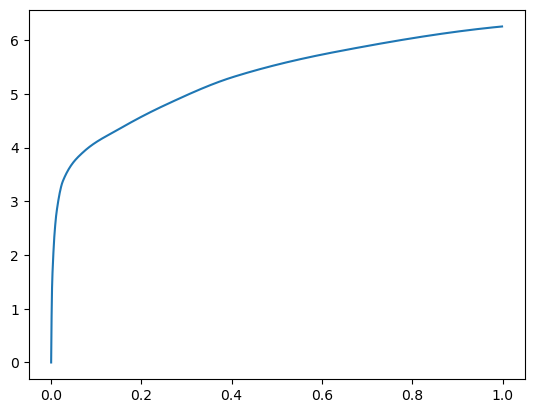

732092 steps_after


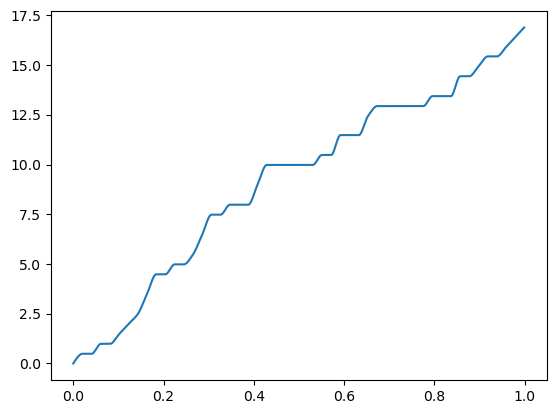

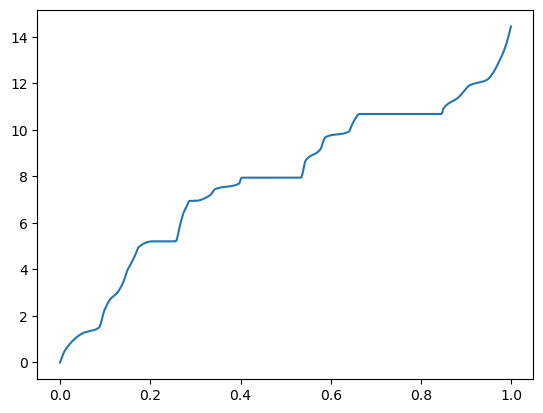

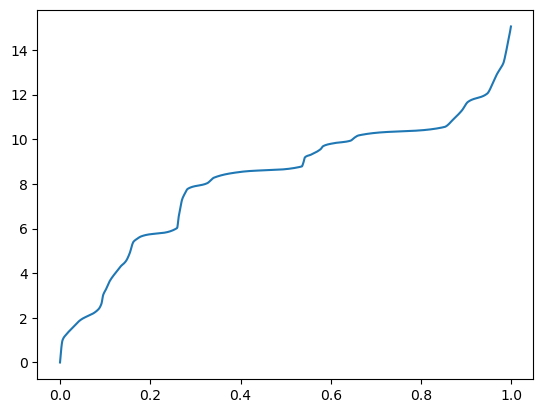

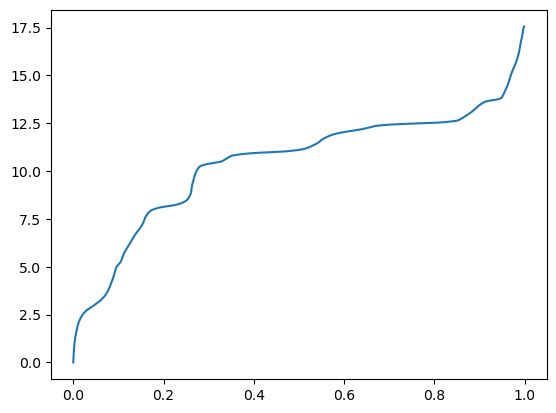

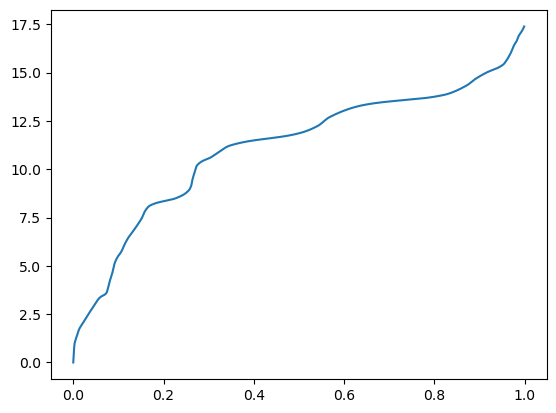

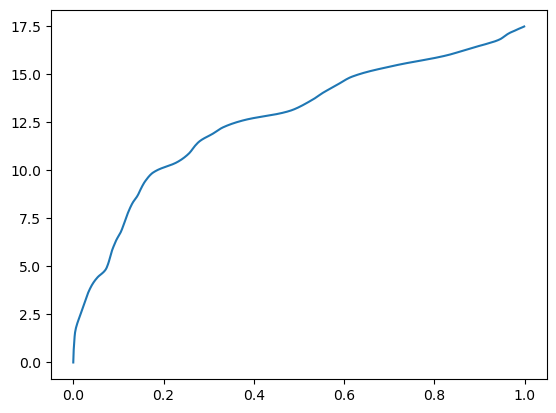

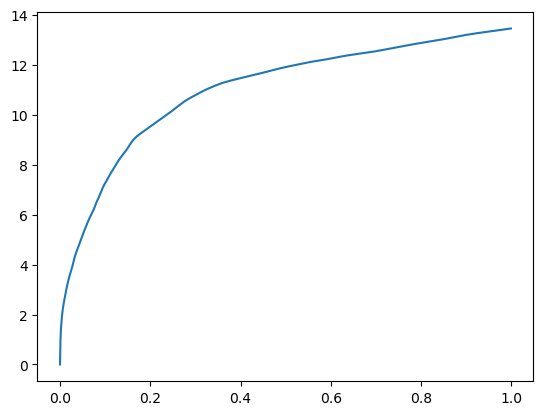

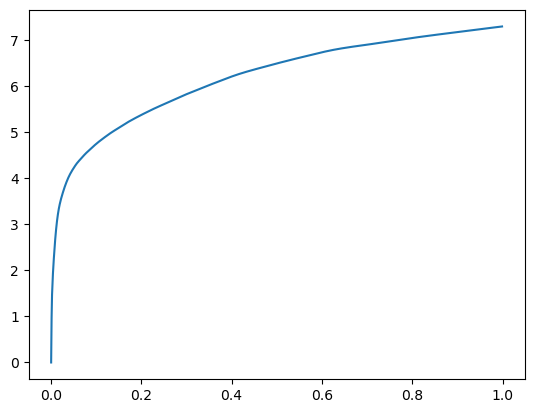

11138 steps
betas [0.00000000e+00 5.65528870e-04 1.23882294e-03 2.80094147e-03
 5.87749481e-03 1.01804733e-02 1.75828934e-02 3.44781876e-02
 7.19938278e-02 1.42765999e-01 2.50844002e-01 3.90343666e-01
 6.00047112e-01 1.00000000e+00]
n_chains 14
[0.00000000e+00 5.65528870e-04 1.23882294e-03 2.80094147e-03
 5.87749481e-03 1.01804733e-02 1.75828934e-02 3.44781876e-02
 7.19938278e-02 1.42765999e-01 2.50844002e-01 3.90343666e-01
 6.00047112e-01 1.00000000e+00] betas
[0.         0.17145218 0.19785887 0.         0.         0.68327986
 0.         0.         0.         0.07983638 0.         0.43142248
 0.62459247 0.        ] r
-22480.269231963164 score post


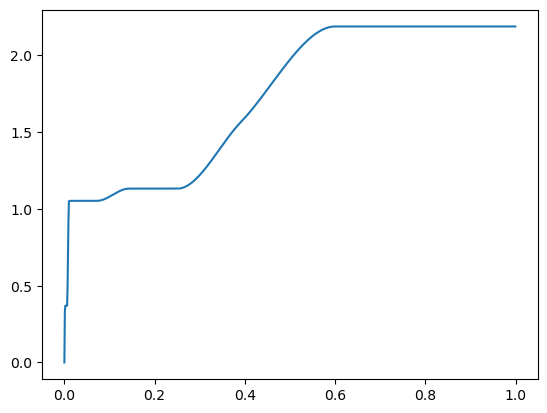

[0.00000000e+00 5.55992126e-04 1.02710724e-03 7.10773468e-03
 7.87067413e-03 8.59165192e-03 9.52625275e-03 2.85090446e-01
 3.33510399e-01 3.75737190e-01 4.25175667e-01 4.68211174e-01
 5.13283730e-01 1.00000000e+00] betas
[0.         0.52087844 0.40020864 0.91743428 0.1039238  0.08636549
 0.09960759 0.98420452 0.18033134 0.14931778 0.15742677 0.12042298
 0.11462861 0.61733847] r
-22480.269231963164 score post


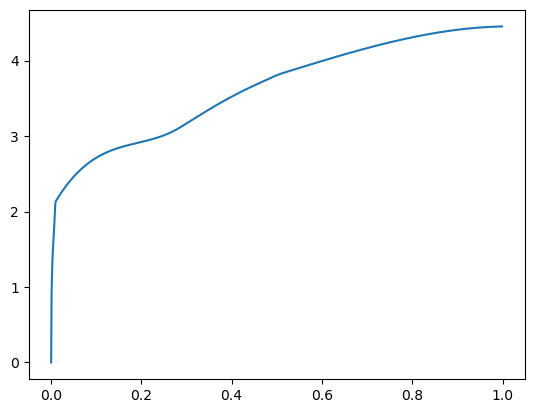

[0.00000000e+00 3.59535217e-04 7.21931458e-04 1.37996674e-03
 2.96688080e-03 6.05678558e-03 8.79573822e-03 4.06885147e-02
 1.07947350e-01 2.76301384e-01 3.70545387e-01 4.85312462e-01
 6.65925026e-01 1.00000000e+00] betas
[0.         0.32241806 0.32161575 0.48533533 0.52474882 0.53092636
 0.38947956 0.85068067 0.5127131  0.65180207 0.3227349  0.28249572
 0.32174972 0.37659493] r
-22481.990460408004 score post


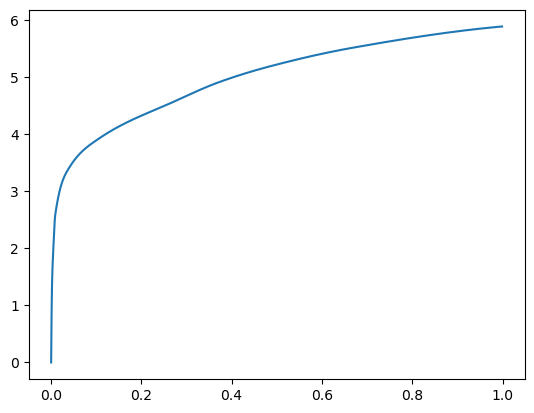

[0.00000000e+00 5.04493713e-04 1.04236603e-03 1.93309784e-03
 3.72409821e-03 6.55460358e-03 1.16014481e-02 2.48479843e-02
 5.95064163e-02 1.36641502e-01 2.60319710e-01 3.97292137e-01
 6.15668297e-01 1.00000000e+00] betas
[0.         0.44573182 0.44526365 0.49256732 0.45837155 0.48442352
 0.55444377 0.54253222 0.4462262  0.50608533 0.5265674  0.44338682
 0.47324868 0.46133385] r
-22481.990460408004 score post


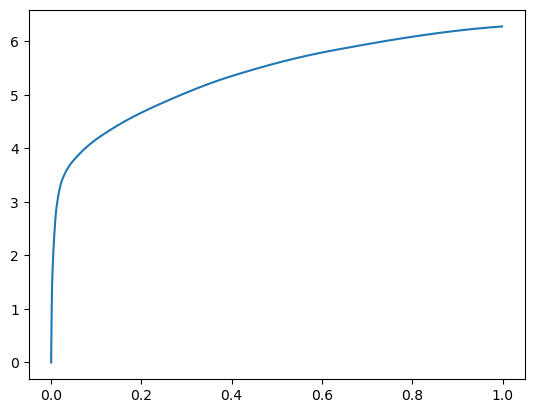

[0.00000000e+00 5.48362732e-04 1.15489960e-03 2.12192535e-03
 4.17232513e-03 7.21263885e-03 1.18818283e-02 2.30722427e-02
 5.89723587e-02 1.31354332e-01 2.41150856e-01 3.85584831e-01
 6.02309227e-01 1.00000000e+00] betas
[0.         0.49419452 0.45046782 0.49286628 0.50403539 0.50801635
 0.46763155 0.44167634 0.54453935 0.50596174 0.51112422 0.55934299
 0.52369815 0.49380257] r
-22480.269231963164 score post


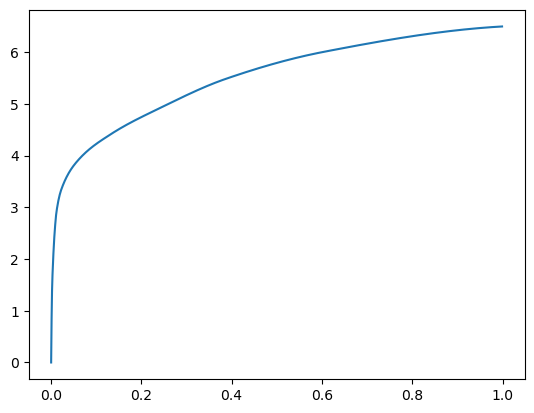

[0.00000000e+00 5.55992126e-04 1.24454498e-03 2.30884552e-03
 4.46224213e-03 7.60364532e-03 1.33123398e-02 2.95038223e-02
 6.91118240e-02 1.47675514e-01 2.59369850e-01 3.91535759e-01
 5.98797798e-01 1.00000000e+00] betas
[0.         0.45043757 0.48715985 0.49097343 0.52170327 0.4957623
 0.53813914 0.51133945 0.41714993 0.47321817 0.48755375 0.40931825
 0.44957694 0.51053258] r
-22480.269231963164 score post


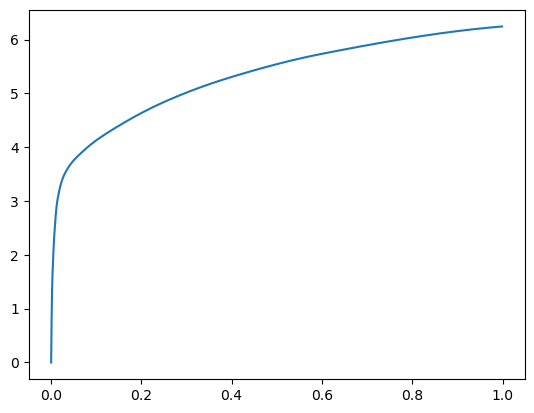

[0.00000000e+00 5.96046448e-04 1.28459930e-03 2.34508514e-03
 4.31156158e-03 7.24506378e-03 1.17597580e-02 2.32419968e-02
 6.00538254e-02 1.35209084e-01 2.40427971e-01 3.91407967e-01
 6.17260933e-01 1.00000000e+00] betas
[0.         0.49374721 0.48195923 0.46719009 0.41559824 0.46821573
 0.48708554 0.48200392 0.41081092 0.46292526 0.47167692 0.49723819
 0.49960509 0.48546067] r
-22481.621781595804 score post


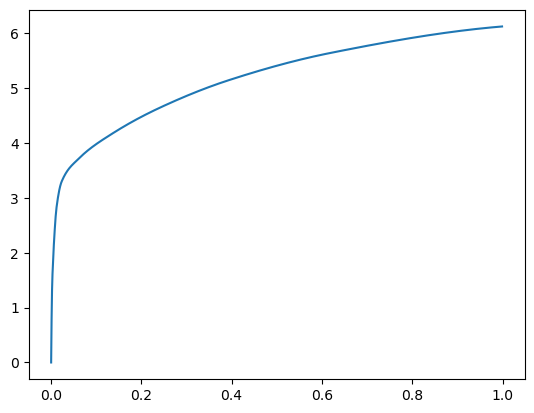

[0.00000000e+00 5.65528870e-04 1.22547150e-03 2.24971771e-03
 4.45270538e-03 7.46440887e-03 1.19543076e-02 2.33182907e-02
 6.78739548e-02 1.48829460e-01 2.58757591e-01 4.07605171e-01
 6.26017570e-01 1.00000000e+00] betas
[0.         0.51011787 0.4739616  0.46984229 0.50840562 0.49860765
 0.49193791 0.50279532 0.56190795 0.47090198 0.52040138 0.48569081
 0.46584178 0.4607513 ] r
-22481.990460408004 score post


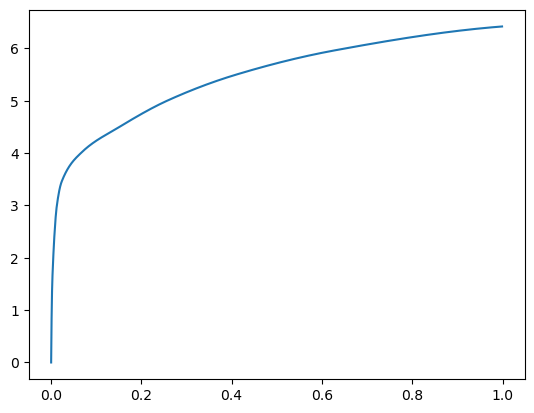

[0.00000000e+00 5.44548035e-04 1.23119354e-03 2.33936310e-03
 4.52136993e-03 7.52925873e-03 1.21145248e-02 2.34041214e-02
 5.98993301e-02 1.40440941e-01 2.41681099e-01 3.85027885e-01
 6.05938911e-01 1.00000000e+00] betas
[0.         0.46612607 0.5161983  0.47271076 0.47004851 0.46599705
 0.46704408 0.48400971 0.47725957 0.49617699 0.44805792 0.49569446
 0.44350365 0.54263402] r
-22484.525554730924 score post


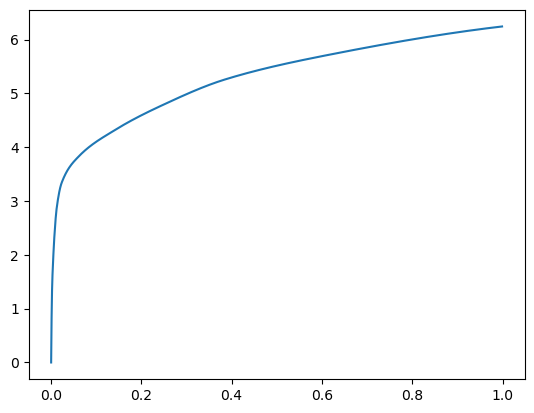

[0.00000000e+00 5.61714172e-04 1.19304657e-03 2.29358673e-03
 4.50229645e-03 7.61699677e-03 1.24998093e-02 2.43597031e-02
 6.26783371e-02 1.42029762e-01 2.52070427e-01 3.94936562e-01
 6.43746376e-01 1.00000000e+00] betas
[0.         0.50682982 0.47676294 0.42908286 0.49294265 0.47016123
 0.48683179 0.46717312 0.52412583 0.50297164 0.44126419 0.46449828
 0.5044064  0.4526746 ] r
-22491.03982278365 score post


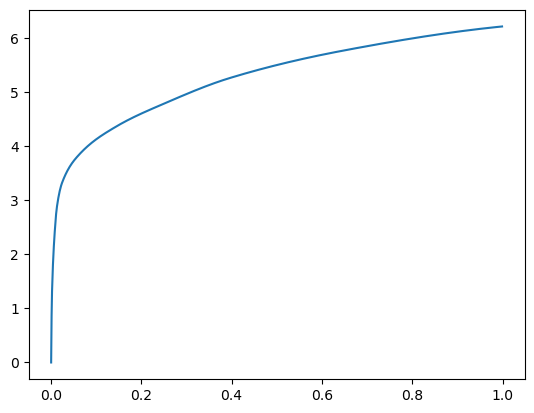

[0.00000000e+00 5.27381897e-04 1.14536285e-03 2.37178802e-03
 4.54807281e-03 7.75241852e-03 1.26333237e-02 2.52408981e-02
 5.97867966e-02 1.31840706e-01 2.48255730e-01 3.95014763e-01
 6.27717018e-01 1.00000000e+00] betas
[0.         0.45145248 0.43911429 0.53039327 0.45411194 0.43963823
 0.46911943 0.54524523 0.44383596 0.46303381 0.57425492 0.44713223
 0.51561056 0.52274518] r
-22480.269231963164 score post


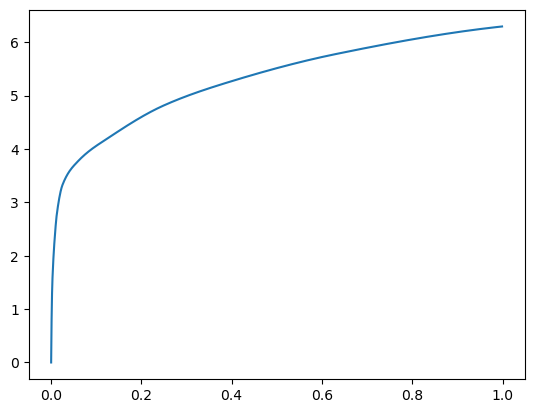

[0.00000000e+00 5.69343567e-04 1.29032135e-03 2.48432159e-03
 4.92763519e-03 8.69464874e-03 1.46570206e-02 2.82125473e-02
 7.20720291e-02 1.53849602e-01 2.56983757e-01 4.22266960e-01
 6.49855614e-01 1.00000000e+00] betas
[0.         0.45834438 0.51796207 0.49680052 0.52797402 0.53612117
 0.46565115 0.42866867 0.48211026 0.52259598 0.47782133 0.45499492
 0.45540783 0.43046398] r
-22480.269231963164 score post


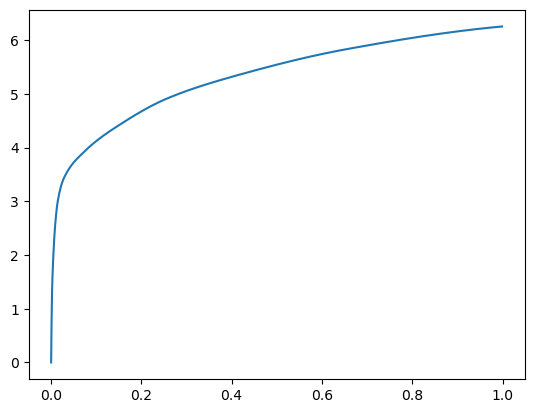

[0.00000000e+00 5.99861145e-04 1.26552582e-03 2.38704681e-03
 4.49275970e-03 7.56549835e-03 1.26886368e-02 2.51283646e-02
 6.41870499e-02 1.34491920e-01 2.30496407e-01 3.89920235e-01
 6.18662834e-01 1.00000000e+00] betas
[0.         0.49282819 0.50133755 0.46191273 0.466217   0.49119714
 0.45663359 0.48428043 0.50797232 0.43200305 0.48137703 0.52733004
 0.50613845 0.49223812] r
-22480.269231963164 score post


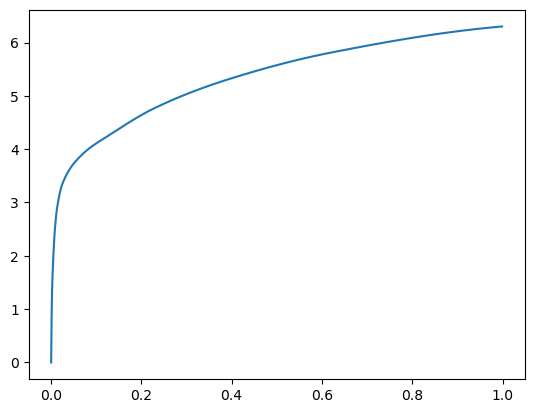

[0.00000000e+00 5.90324402e-04 1.22165680e-03 2.38132477e-03
 4.58240509e-03 7.65323639e-03 1.33676529e-02 2.69918442e-02
 6.59990311e-02 1.46821022e-01 2.48568535e-01 4.00774956e-01
 6.23173714e-01 1.00000000e+00] betas
[0.         0.49315922 0.4582544  0.51824479 0.52489267 0.48111914
 0.49781971 0.47031066 0.50677686 0.51517389 0.49271859 0.5320097
 0.44358608 0.447933  ] r
-22480.269231963164 score post


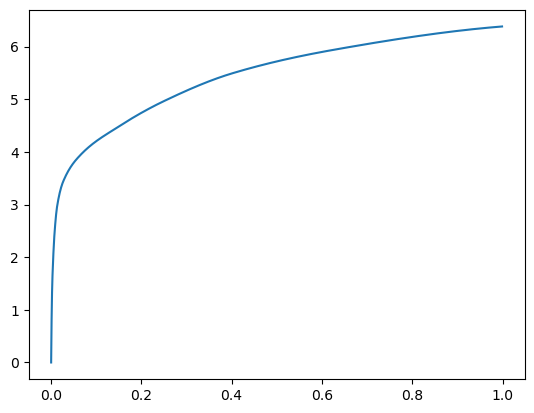

[0.00000000e+00 5.86509705e-04 1.27506256e-03 2.39086151e-03
 4.42218781e-03 7.47394562e-03 1.28698349e-02 2.66351700e-02
 6.34145737e-02 1.38133049e-01 2.36828804e-01 3.68807793e-01
 5.95759392e-01 1.00000000e+00] betas
[0.         0.50740854 0.49285502 0.45883367 0.45507723 0.46281606
 0.47384086 0.50323472 0.4519614  0.45674838 0.44648006 0.46102929
 0.51258399 0.44867458] r
-22480.269231963164 score post


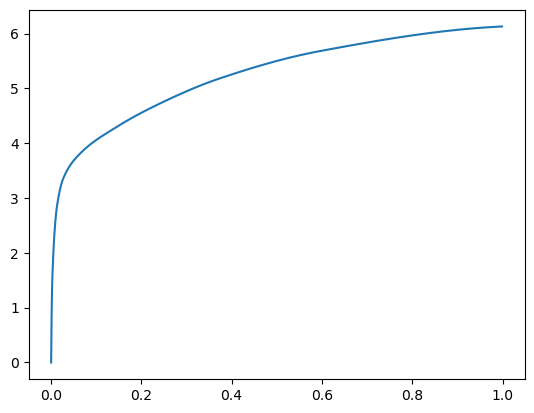

[0.00000000e+00 5.40733337e-04 1.17588043e-03 2.24971771e-03
 4.27150726e-03 7.31372833e-03 1.25074387e-02 2.43005753e-02
 5.95731735e-02 1.34705544e-01 2.38675117e-01 3.75248909e-01
 5.81343651e-01 1.00000000e+00] betas
[0.         0.46986637 0.44177366 0.47498963 0.48498599 0.47724319
 0.4768818  0.51607673 0.44808326 0.50307746 0.47563156 0.47483246
 0.47688656 0.55689291] r
-22481.990460408004 score post


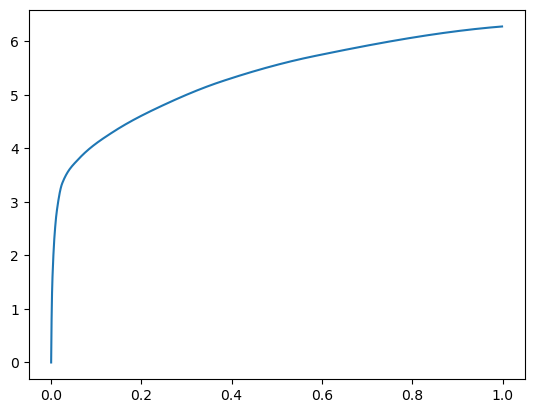

[0.00000000e+00 5.57899475e-04 1.27506256e-03 2.44998932e-03
 4.58812714e-03 7.87830353e-03 1.36861801e-02 2.61259079e-02
 6.79445267e-02 1.44522667e-01 2.53926277e-01 3.99870872e-01
 6.24308586e-01 1.00000000e+00] betas
[0.         0.46596426 0.52585861 0.43856532 0.45351345 0.52052582
 0.5163135  0.49090038 0.54607653 0.48487362 0.46476181 0.43196308
 0.49774691 0.43921402] r
-22480.269231963164 score post


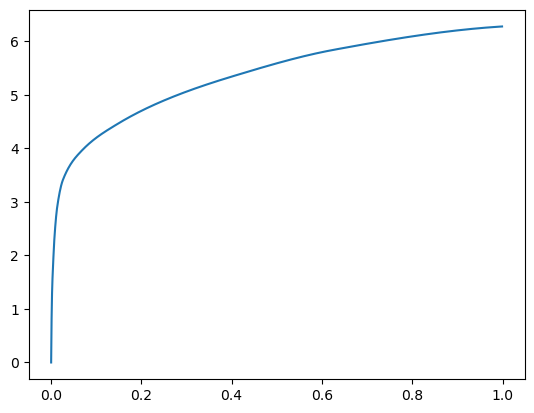

[0.00000000e+00 5.78880310e-04 1.22547150e-03 2.51483917e-03
 4.84752655e-03 7.96031952e-03 1.32837296e-02 2.47621536e-02
 5.74426651e-02 1.25752449e-01 2.32087135e-01 3.88779640e-01
 5.98332405e-01 1.00000000e+00] betas
[0.         0.49556048 0.4866091  0.48322253 0.50435548 0.45061413
 0.48557919 0.46970225 0.44432357 0.44572364 0.51809908 0.52551162
 0.4416814  0.51389779] r
-22483.343010040644 score post


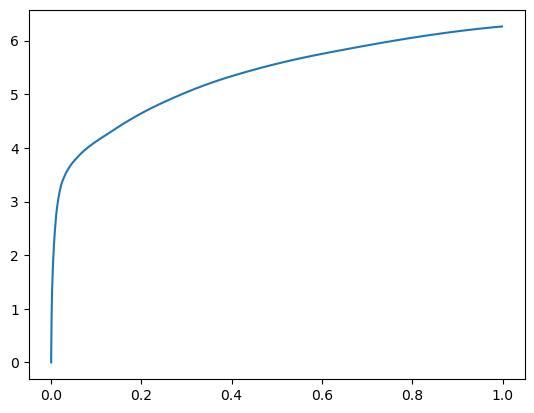

[0.00000000e+00 5.61714172e-04 1.19113922e-03 2.44617462e-03
 4.60910797e-03 7.86685944e-03 1.30472183e-02 2.46610641e-02
 6.13927841e-02 1.38630867e-01 2.40954399e-01 3.85647774e-01
 6.18006706e-01 1.00000000e+00] betas
[0.         0.49037744 0.47522621 0.49247395 0.42267146 0.47376464
 0.48767806 0.46066647 0.50810402 0.44399924 0.46313744 0.51472696
 0.48476467 0.48018094] r
-22481.621781595804 score post


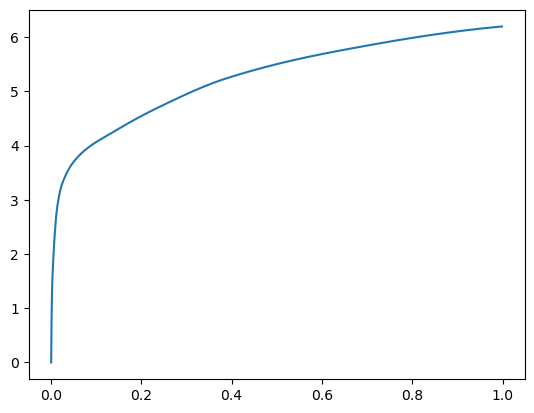

[0.00000000e+00 5.44548035e-04 1.16825104e-03 2.34508514e-03
 4.76551056e-03 8.11862946e-03 1.33619308e-02 2.62327194e-02
 6.17513657e-02 1.45720482e-01 2.53293037e-01 3.89931679e-01
 6.20150566e-01 1.00000000e+00] betas
[0.         0.47482599 0.42503605 0.56891831 0.50626805 0.49408189
 0.49226701 0.45816659 0.4748533  0.490602   0.48360912 0.50531807
 0.46877892 0.45090442] r
-22480.269231963164 score post


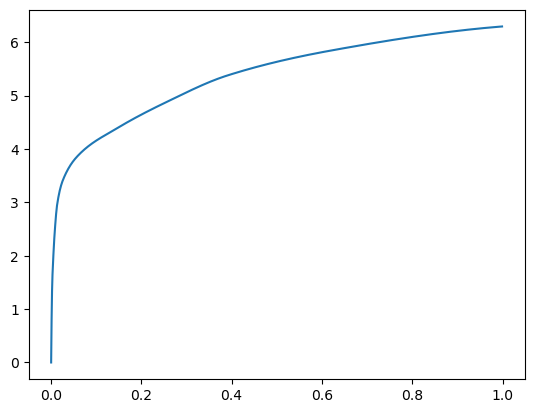

[0.00000000e+00 5.55992126e-04 1.28650665e-03 2.29358673e-03
 4.54235077e-03 7.71617889e-03 1.24750137e-02 2.48403549e-02
 5.93004227e-02 1.40179634e-01 2.46598244e-01 3.73095512e-01
 5.98942757e-01 1.00000000e+00] betas
[0.         0.46166152 0.5370688  0.39710213 0.5055209  0.47901048
 0.4697992  0.49879793 0.40178933 0.5421733  0.47431352 0.39934944
 0.50819954 0.50598896] r
-22480.269231963164 score post


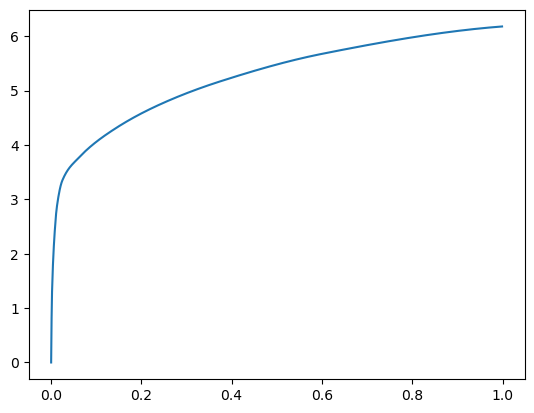

[0.00000000e+00 5.73158264e-04 1.20067596e-03 2.39849091e-03
 4.54425812e-03 7.68947601e-03 1.25169754e-02 2.38656998e-02
 6.54306412e-02 1.37610435e-01 2.43168831e-01 3.97061348e-01
 6.17430687e-01 1.00000000e+00] betas
[0.         0.50501984 0.5141016  0.56800749 0.44959237 0.46072967
 0.44027707 0.47316273 0.50095891 0.42052103 0.52618868 0.48234615
 0.4430458  0.46928872] r
-22481.990460408004 score post


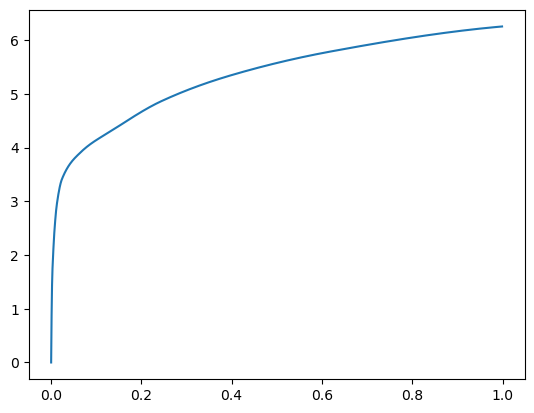

[0.00000000e+00 5.44548035e-04 1.11484528e-03 2.00366974e-03
 3.89385223e-03 6.93798065e-03 1.17387772e-02 2.20766068e-02
 5.75704575e-02 1.37015343e-01 2.31345177e-01 3.77581596e-01
 6.09971046e-01 1.00000000e+00] betas
[0.         0.46662709 0.42558879 0.4715305  0.46252024 0.48652861
 0.49226855 0.50275554 0.43288675 0.52436308 0.43584409 0.51576876
 0.47088055 0.51717633] r
-22480.269231963164 score post


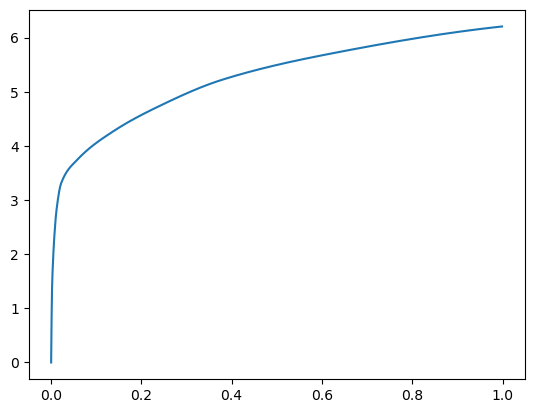

[0.00000000e+00 5.57899475e-04 1.21402740e-03 2.20775604e-03
 4.32872772e-03 7.52735138e-03 1.26047134e-02 2.36425400e-02
 6.66761398e-02 1.42668724e-01 2.49255180e-01 3.90542030e-01
 6.34589195e-01 1.00000000e+00] betas
[0.         0.47440463 0.50197729 0.4583299  0.50303712 0.54046867
 0.47317828 0.42725801 0.49929814 0.49112703 0.49760006 0.46273616
 0.57286133 0.45668722] r
-22483.215759872455 score post


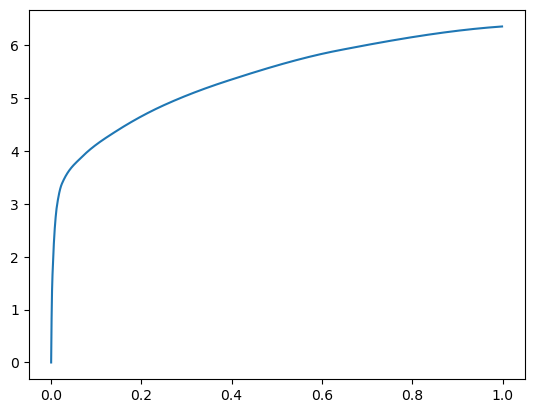

[0.00000000e+00 5.76972961e-04 1.21784210e-03 2.31075287e-03
 4.42409515e-03 7.27367401e-03 1.23300552e-02 2.60019302e-02
 7.08951950e-02 1.48804665e-01 2.55705833e-01 4.09104347e-01
 6.15880013e-01 1.00000000e+00] betas
[0.         0.44106925 0.44905136 0.42714847 0.46204268 0.49566906
 0.50479087 0.47155734 0.50550553 0.47529639 0.48602356 0.45798156
 0.43052693 0.46580793] r
-22483.215759872455 score post


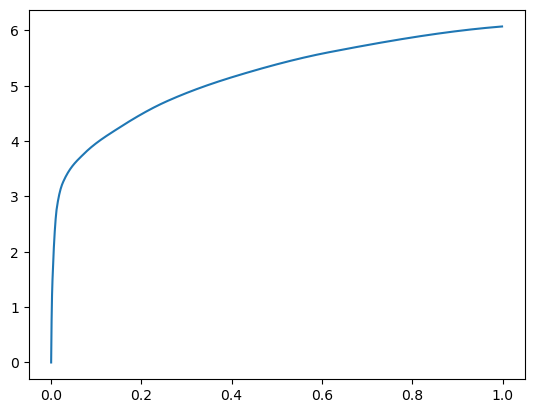

[0.00000000e+00 6.11305237e-04 1.30558014e-03 2.61783600e-03
 4.88185883e-03 7.74478912e-03 1.27496719e-02 2.70051956e-02
 6.84289932e-02 1.43433571e-01 2.43245125e-01 3.94019127e-01
 6.15052223e-01 1.00000000e+00] betas
[0.         0.50801995 0.47707133 0.50412686 0.45922564 0.40125994
 0.42333129 0.61320016 0.44546565 0.44879484 0.47330365 0.54466346
 0.45378281 0.46036463] r
-22481.990460408004 score post


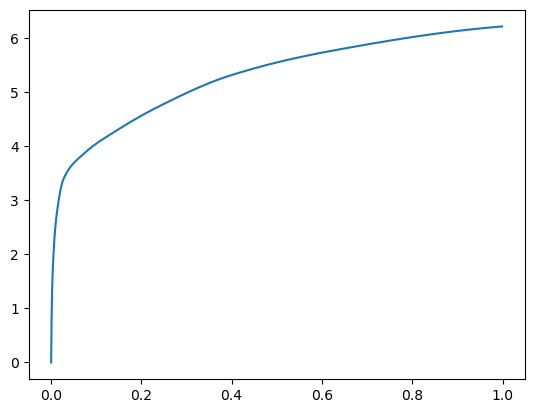

[0.00000000e+00 5.71250916e-04 1.25026703e-03 2.42519379e-03
 4.66251373e-03 8.11862946e-03 1.43499374e-02 2.52103806e-02
 6.73379898e-02 1.47311211e-01 2.49323845e-01 3.79124641e-01
 6.03877068e-01 1.00000000e+00] betas
[0.         0.5238987  0.49138735 0.47213815 0.46053103 0.50114072
 0.53569722 0.39037195 0.46467352 0.49436189 0.42844358 0.42552455
 0.4715656  0.51126549] r
-22481.990460408004 score post


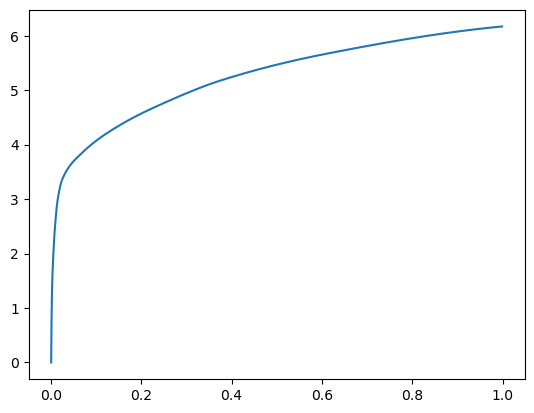

[0.00000000e+00 5.12123108e-04 1.13582611e-03 2.21538544e-03
 4.37641144e-03 7.47776031e-03 1.22690201e-02 2.28910446e-02
 6.20355606e-02 1.35174751e-01 2.45083809e-01 3.92100334e-01
 6.26400948e-01 1.00000000e+00] betas
[0.         0.46034678 0.49084055 0.48605121 0.52146361 0.46184227
 0.4666538  0.49175439 0.52630816 0.43316483 0.5384824  0.48449404
 0.49595189 0.4250301 ] r
-22483.17300509828 score post


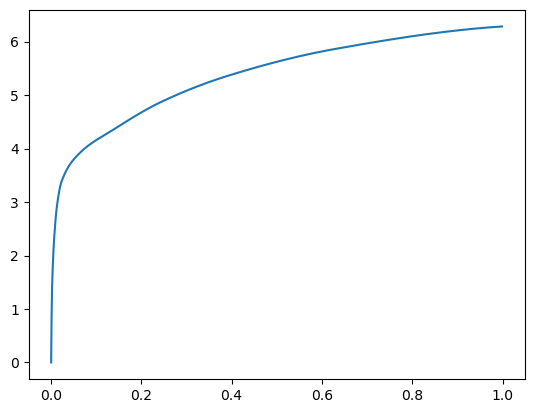

[0.00000000e+00 5.38825989e-04 1.16252899e-03 2.25353241e-03
 4.24098969e-03 7.44152069e-03 1.24578476e-02 2.30569839e-02
 5.74884415e-02 1.37198448e-01 2.34293938e-01 3.75220299e-01
 5.90451241e-01 1.00000000e+00] betas
[0.         0.4724775  0.49443814 0.49471115 0.47178941 0.48647573
 0.48848018 0.51242508 0.44407271 0.45910342 0.44516974 0.49184635
 0.45942666 0.53475159] r
-22480.269231963164 score post


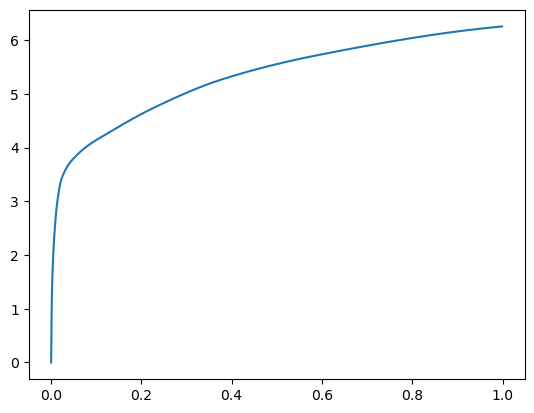

[0.00000000e+00 5.48362732e-04 1.15489960e-03 2.19821930e-03
 4.19521332e-03 7.32517242e-03 1.21507645e-02 2.11896896e-02
 5.56306839e-02 1.38474464e-01 2.44982719e-01 3.87198448e-01
 6.22981071e-01 1.00000000e+00] betas
[0.         0.46927088 0.45692454 0.47439792 0.46561566 0.4937336
 0.46672183 0.45426533 0.47693607 0.55948433 0.50278611 0.44667634
 0.50560556 0.50375925] r
-22481.990460408004 score post


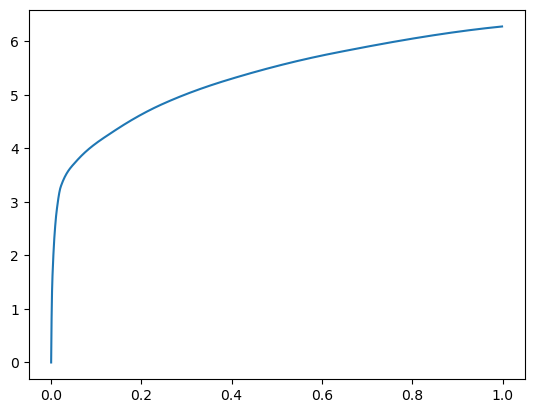

[0.00000000e+00 5.65528870e-04 1.22356415e-03 2.35271454e-03
 4.54235077e-03 7.77530670e-03 1.31959915e-02 2.55956650e-02
 6.73036575e-02 1.43456459e-01 2.47008324e-01 4.04318810e-01
 6.35540962e-01 1.00000000e+00] betas
[0.         0.47510606 0.45572878 0.45335794 0.46405915 0.48716522
 0.4918803  0.48081008 0.55202828 0.49068234 0.45876687 0.54532649
 0.46044599 0.43931281] r
-22482.458794922564 score post


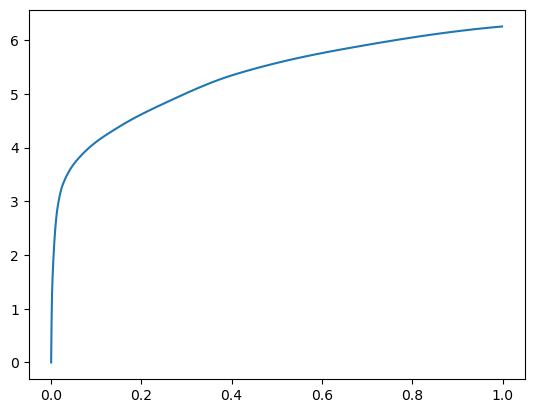

[0.00000000e+00 5.73158264e-04 1.28459930e-03 2.56633759e-03
 4.97722626e-03 8.39328766e-03 1.42660141e-02 2.84700394e-02
 6.60657883e-02 1.39552116e-01 2.47441292e-01 3.81644249e-01
 6.08918190e-01 1.00000000e+00] betas
[0.         0.51612298 0.50519633 0.49123169 0.52610425 0.47925861
 0.4490996  0.45373634 0.46211361 0.4160263  0.46657905 0.49923775
 0.44103253 0.47109929] r
-22480.269231963164 score post


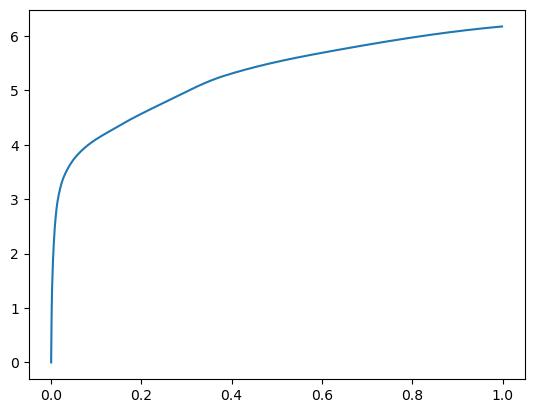

[0.00000000e+00 5.21659851e-04 1.15871429e-03 2.27832794e-03
 4.22000885e-03 7.17639923e-03 1.22728348e-02 2.42166519e-02
 5.66282272e-02 1.34926796e-01 2.43937492e-01 3.68048668e-01
 6.06259346e-01 1.00000000e+00] betas
[0.         0.47576062 0.48312466 0.4972444  0.43750892 0.48907711
 0.53571207 0.51599764 0.44411031 0.52890049 0.4789535  0.42765723
 0.49521985 0.52459638] r
-22480.269231963164 score post


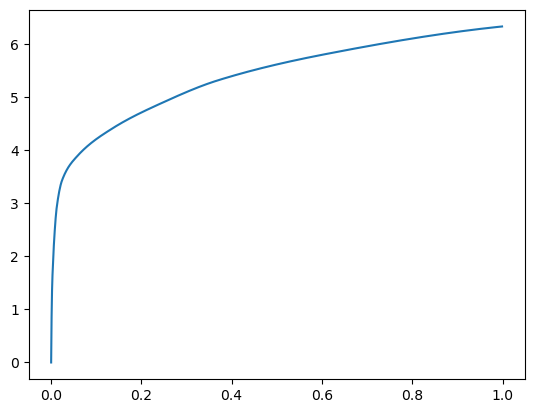

[0.00000000e+00 5.35011292e-04 1.18541718e-03 2.29549408e-03
 4.50992584e-03 7.58647919e-03 1.23491287e-02 2.32305527e-02
 5.86767197e-02 1.30761147e-01 2.40275383e-01 3.85439873e-01
 6.29010201e-01 1.00000000e+00] betas
[0.         0.42285323 0.48576452 0.54289415 0.516554   0.46643062
 0.44150979 0.48495039 0.49422827 0.50213694 0.50460096 0.4561178
 0.47349939 0.44341862] r
-22481.621781595804 score post


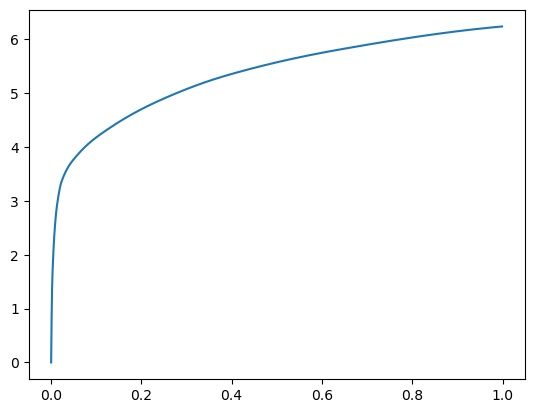

[0.00000000e+00 6.07490540e-04 1.26934052e-03 2.25734711e-03
 4.24480438e-03 7.28321075e-03 1.23758316e-02 2.30760574e-02
 5.67770004e-02 1.23522758e-01 2.23298073e-01 3.68762016e-01
 6.05530739e-01 1.00000000e+00] betas
[0.         0.52928666 0.47534269 0.42715964 0.49175759 0.49146021
 0.46415889 0.49937908 0.57967194 0.47007935 0.45963403 0.50621509
 0.52320094 0.50701629] r
-22482.458794922564 score post


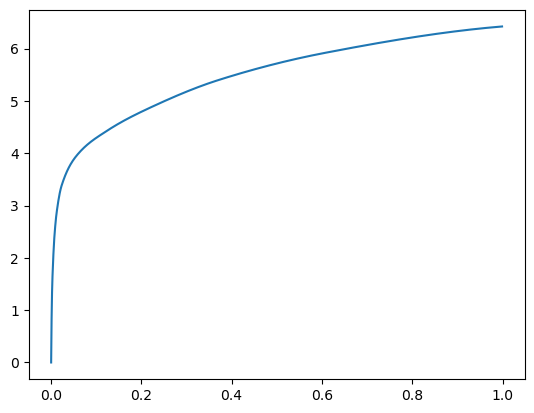

[0.00000000e+00 5.63621521e-04 1.24073029e-03 2.41756439e-03
 4.51564789e-03 7.76195526e-03 1.37586594e-02 2.61678696e-02
 5.63249588e-02 1.26976967e-01 2.36876488e-01 3.84165764e-01
 6.13270760e-01 1.00000000e+00] betas
[0.         0.49405686 0.49772064 0.52367096 0.5205612  0.49749237
 0.51631711 0.41896806 0.40807036 0.44787535 0.51858064 0.51642001
 0.4766804  0.47402244] r
-22480.269231963164 score post


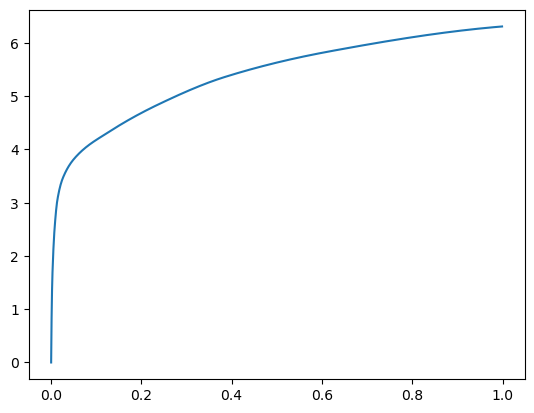

[0.00000000e+00 5.52177429e-04 1.20449066e-03 2.24590302e-03
 4.04644012e-03 6.90364838e-03 1.16510391e-02 2.30932236e-02
 5.70440292e-02 1.35119438e-01 2.39562035e-01 3.76757622e-01
 6.06106758e-01 1.00000000e+00] betas
[0.         0.46504528 0.49997831 0.44453672 0.391824   0.44568134
 0.51324226 0.52337859 0.44137471 0.49097733 0.48912576 0.48898349
 0.50318127 0.46764089] r
-22488.679155155733 score post


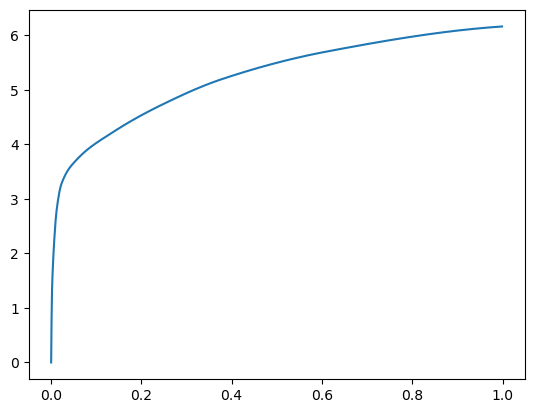

[0.00000000e+00 5.63621521e-04 1.17588043e-03 2.28977203e-03
 4.58240509e-03 7.87067413e-03 1.29461288e-02 2.47564316e-02
 6.51788712e-02 1.44879341e-01 2.48713493e-01 3.84884834e-01
 6.01973534e-01 1.00000000e+00] betas
[0.         0.51943736 0.47619337 0.46741379 0.5183892  0.52536031
 0.48807362 0.44941868 0.41890543 0.47107527 0.45445271 0.4727016
 0.50321641 0.53922964] r
-22481.990460408004 score post


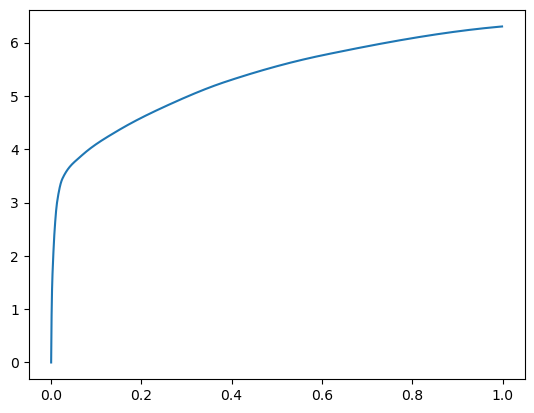

[0.00000000e+00 5.23567200e-04 1.13201141e-03 2.26306915e-03
 4.36115265e-03 7.24124908e-03 1.17158890e-02 2.24905014e-02
 6.72750473e-02 1.50855064e-01 2.64334679e-01 4.11120415e-01
 6.33191109e-01 1.00000000e+00] betas
[0.         0.46231463 0.42311379 0.50612327 0.50486533 0.45043916
 0.48030461 0.46507872 0.61622001 0.51199533 0.47454222 0.51877555
 0.4607149  0.43578558] r
-22481.990460408004 score post


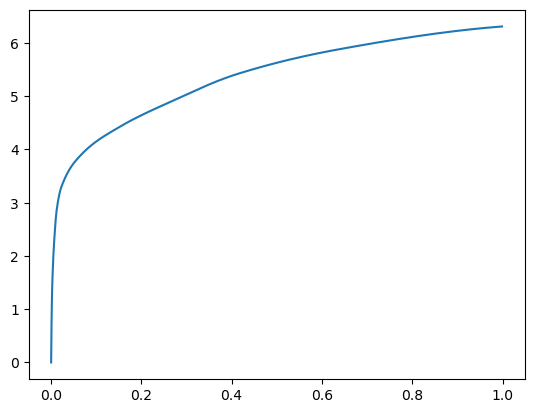

[0.00000000e+00 5.54084778e-04 1.28841400e-03 2.47097015e-03
 4.60147858e-03 7.86495209e-03 1.30834579e-02 2.73237228e-02
 6.44273758e-02 1.40460014e-01 2.53655434e-01 3.85455132e-01
 6.02404594e-01 1.00000000e+00] betas
[0.         0.47023133 0.49360697 0.47482472 0.47854802 0.48649672
 0.48280153 0.51638057 0.42136608 0.46379031 0.53139963 0.41478684
 0.48179556 0.4699885 ] r
-22490.392337886344 score post


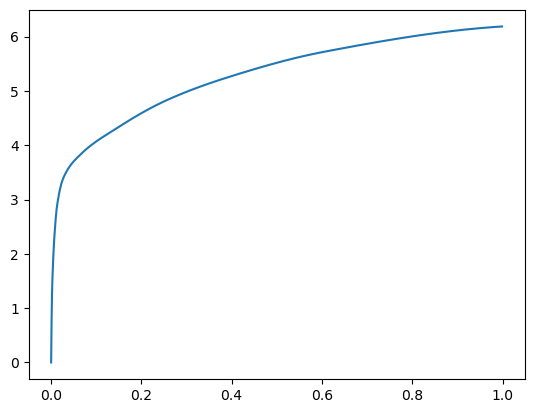

[0.00000000e+00 5.61714172e-04 1.26552582e-03 2.43473053e-03
 4.52518463e-03 7.65895844e-03 1.25646591e-02 2.41041183e-02
 6.22892380e-02 1.39445305e-01 2.38183022e-01 3.85489464e-01
 5.98753929e-01 1.00000000e+00] betas
[0.         0.47261095 0.56047074 0.47352744 0.45636527 0.51340987
 0.43461422 0.45331567 0.50949951 0.45193345 0.48070266 0.48631878
 0.45078851 0.48870124] r
-22481.621781595804 score post


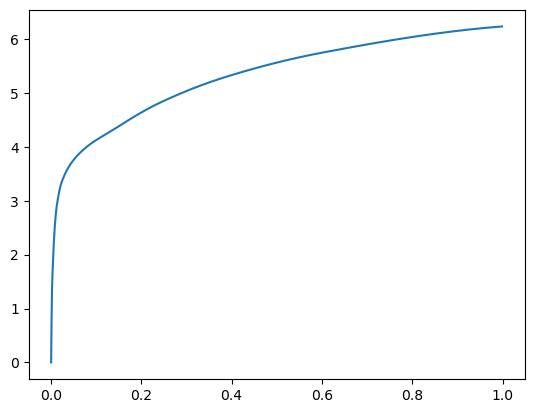

[0.00000000e+00 5.69343567e-04 1.14727020e-03 2.21347809e-03
 4.28295135e-03 7.04860687e-03 1.20000839e-02 2.37245560e-02
 5.78546524e-02 1.37347221e-01 2.35100746e-01 3.78190041e-01
 6.04613304e-01 1.00000000e+00] betas
[0.         0.5091737  0.43043199 0.45808273 0.45310969 0.44655821
 0.49241165 0.49896946 0.47377663 0.53092898 0.43954118 0.45368997
 0.48954846 0.51568553] r
-22480.269231963164 score post


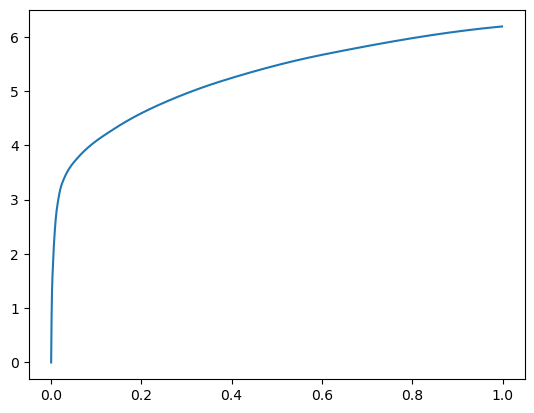

[0.00000000e+00 5.29289246e-04 1.17015839e-03 2.32028961e-03
 4.57668304e-03 7.72953033e-03 1.31158829e-02 2.57844925e-02
 6.30693436e-02 1.36101723e-01 2.43159294e-01 3.98653984e-01
 6.28437996e-01 1.00000000e+00] betas
[0.         0.47469237 0.48545598 0.51976328 0.50697449 0.52189783
 0.47011893 0.42277002 0.44457111 0.43002182 0.46446792 0.483402
 0.49684727 0.4689275 ] r
-22487.326696201602 score post


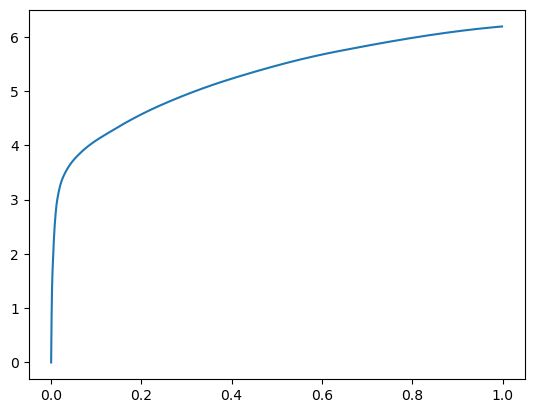

[0.00000000e+00 5.31196594e-04 1.15680695e-03 2.16579437e-03
 4.14371490e-03 6.78920746e-03 1.12428665e-02 2.26507187e-02
 5.85889816e-02 1.37902260e-01 2.48858452e-01 4.03893471e-01
 6.24035835e-01 1.00000000e+00] betas
[0.         0.5241109  0.47205556 0.45449468 0.43680315 0.46625001
 0.48914061 0.52336111 0.50772277 0.54653579 0.5159591  0.43109971
 0.51041909 0.41030167] r
-22480.269231963164 score post


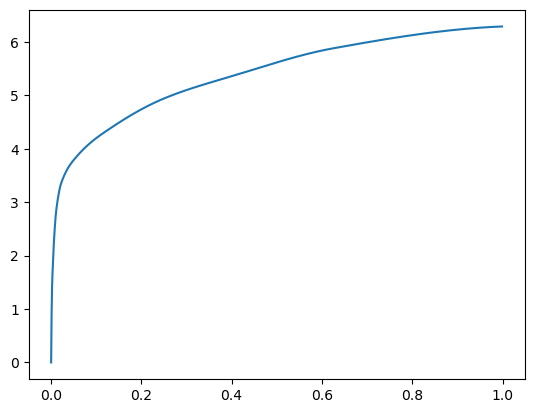

[0.00000000e+00 4.85420227e-04 1.10912323e-03 2.16770172e-03
 4.38404083e-03 7.26604462e-03 1.21297836e-02 2.34937668e-02
 5.81502914e-02 1.25952721e-01 2.22861290e-01 3.85336876e-01
 5.82486153e-01 1.00000000e+00] betas
[0.         0.42953825 0.4873862  0.54626511 0.47445401 0.43858354
 0.47188806 0.53896683 0.53714642 0.44062507 0.49774826 0.51688264
 0.41958876 0.50285007] r
-22480.269231963164 score post


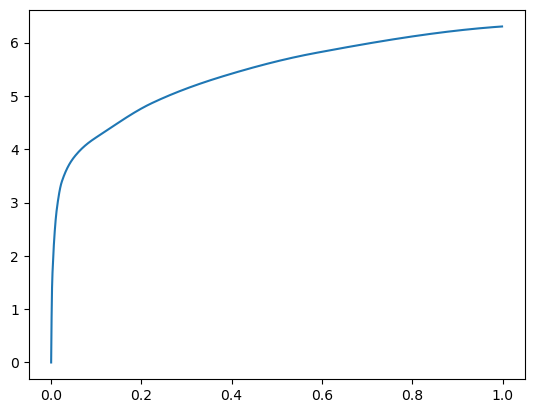

[0.00000000e+00 5.52177429e-04 1.19304657e-03 2.14099884e-03
 4.39167023e-03 7.66468048e-03 1.30548477e-02 2.37398148e-02
 5.34887314e-02 1.25609398e-01 2.19182014e-01 3.67321968e-01
 5.93884468e-01 1.00000000e+00] betas
[0.         0.46715832 0.47178631 0.4389558  0.49255013 0.5511448
 0.4812479  0.40111818 0.44126759 0.47607287 0.42116004 0.55079266
 0.50781738 0.49779256] r
-22480.269231963164 score post


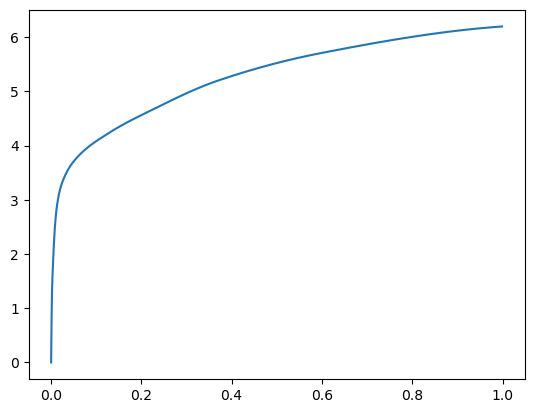

[0.00000000e+00 5.63621521e-04 1.21784210e-03 2.31647491e-03
 4.58431244e-03 7.36904144e-03 1.23586655e-02 2.52618790e-02
 6.10742569e-02 1.39098167e-01 2.49871254e-01 3.85891914e-01
 6.06781960e-01 1.00000000e+00] betas
[0.         0.50065214 0.46674991 0.46383445 0.48912446 0.44573633
 0.44135657 0.49698693 0.43166186 0.49588471 0.48732054 0.46298597
 0.49095902 0.45628473] r
-22487.142152705124 score post


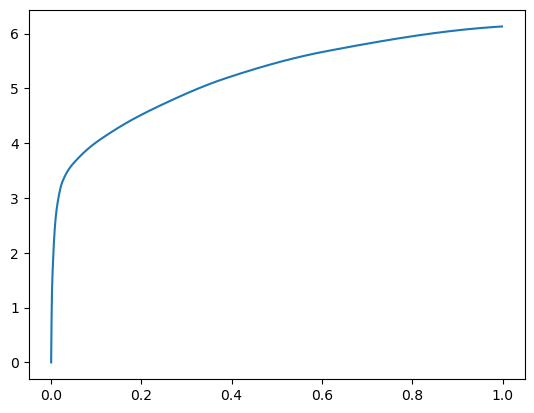

[0.00000000e+00 5.27381897e-04 1.17397308e-03 2.26116180e-03
 4.39739227e-03 7.29656219e-03 1.27401352e-02 2.50692368e-02
 6.53162003e-02 1.41303062e-01 2.48761177e-01 3.87442589e-01
 5.97298622e-01 1.00000000e+00] betas
[0.         0.49133065 0.46319448 0.47835975 0.45857497 0.50856252
 0.49585719 0.48515185 0.48840631 0.4959936  0.48487258 0.44857951
 0.47819223 0.47617406] r
-22480.269231963164 score post


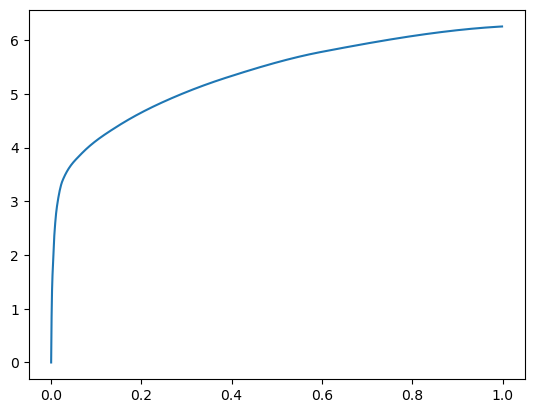

[0.00000000e+00 5.14030457e-04 1.18732452e-03 2.29549408e-03
 4.56523895e-03 7.33852386e-03 1.25741959e-02 2.44226456e-02
 6.28652573e-02 1.34593010e-01 2.38341331e-01 3.84617805e-01
 5.94313622e-01 1.00000000e+00] betas
[0.         0.44987279 0.47885015 0.45156004 0.47741043 0.42387958
 0.52156697 0.46352589 0.52076883 0.44828026 0.510237   0.44923898
 0.51671209 0.50411771] r
-22480.269231963164 score post


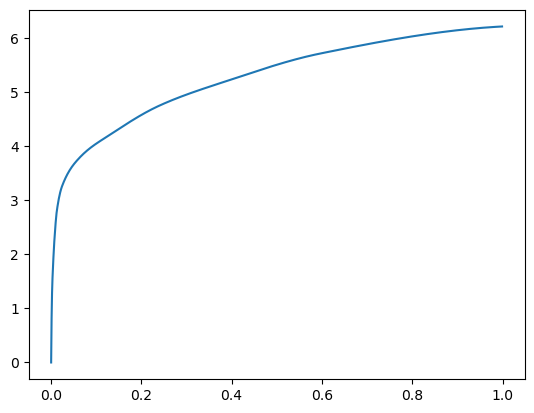

[0.00000000e+00 5.50270081e-04 1.24073029e-03 2.49004364e-03
 4.87804413e-03 8.23688507e-03 1.37224197e-02 2.82869339e-02
 6.72559738e-02 1.46857262e-01 2.47822762e-01 4.07942772e-01
 6.09526634e-01 1.00000000e+00] betas
[0.         0.46824502 0.5100861  0.48886258 0.54370942 0.48332348
 0.44119658 0.53373132 0.49681209 0.45512967 0.43589852 0.50654657
 0.49378009 0.50038127] r
-22486.210229784712 score post


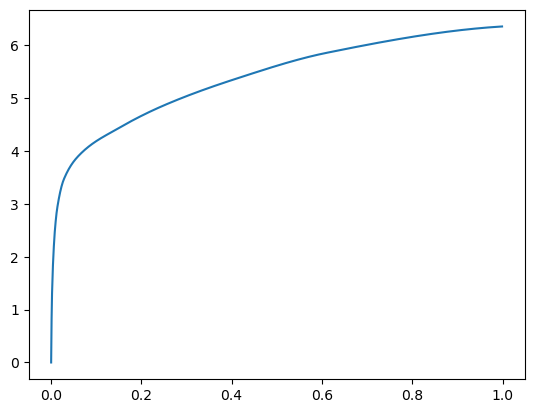

[0.00000000e+00 5.76972961e-04 1.24073029e-03 2.49004364e-03
 4.57859039e-03 7.79628754e-03 1.37014389e-02 2.62632370e-02
 6.09941483e-02 1.42855644e-01 2.56997108e-01 4.13725853e-01
 6.16044044e-01 1.00000000e+00] betas
[0.         0.49654973 0.50563069 0.53136539 0.47669776 0.47482373
 0.51548383 0.51858332 0.52867368 0.55055511 0.51975978 0.46265484
 0.47207599 0.48790718] r
-22480.269231963164 score post


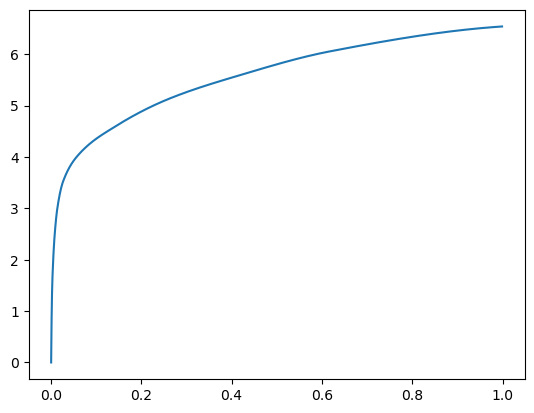

[0.00000000e+00 5.84602356e-04 1.24835968e-03 2.41184235e-03
 4.59194183e-03 8.07094574e-03 1.40161514e-02 2.63814926e-02
 5.87186813e-02 1.29946709e-01 2.34210014e-01 3.96079063e-01
 6.07287407e-01 1.00000000e+00] betas
[0.         0.50419808 0.47805348 0.49410743 0.46743764 0.50856432
 0.4562927  0.40973619 0.402032   0.46113381 0.48840608 0.49007431
 0.42744111 0.4579785 ] r
-22482.458794922564 score post


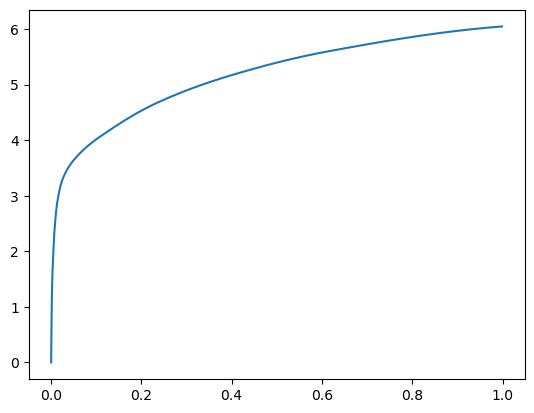

[0.00000000e+00 5.35011292e-04 1.15871429e-03 2.16197968e-03
 4.12082672e-03 7.00473785e-03 1.19905472e-02 2.35433578e-02
 5.87034225e-02 1.30631447e-01 2.29035378e-01 3.78211021e-01
 6.02684975e-01 1.00000000e+00] betas
[0.         0.51217344 0.46274625 0.46556663 0.47151304 0.49957831
 0.49670703 0.46526898 0.42638272 0.47527273 0.44559699 0.52216643
 0.51604249 0.48148518] r
-22482.458794922564 score post


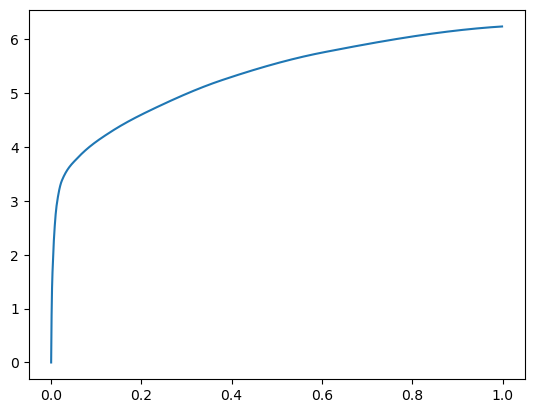

[0.00000000e+00 4.96864319e-04 1.13391876e-03 2.16007233e-03
 4.16088104e-03 6.91890717e-03 1.15575790e-02 2.29253769e-02
 6.33745193e-02 1.39113426e-01 2.49224663e-01 3.91625404e-01
 6.03569984e-01 1.00000000e+00] betas
[0.         0.45857486 0.4999914  0.45034226 0.45116725 0.45462086
 0.46556328 0.46831827 0.52506354 0.50367583 0.50749656 0.45705581
 0.41153571 0.51703433] r
-22480.269231963164 score post


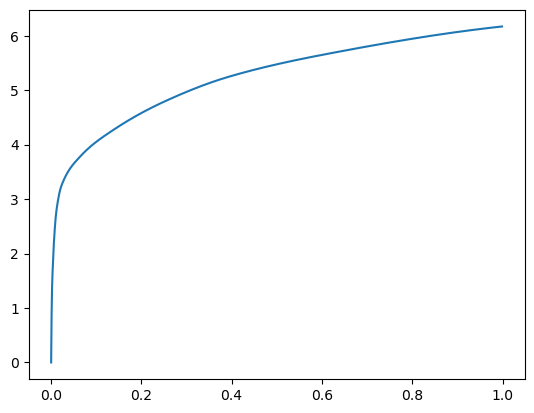

[0.00000000e+00 5.15937805e-04 1.11865997e-03 2.20966339e-03
 4.36306000e-03 7.38430023e-03 1.26886368e-02 2.65016556e-02
 6.60028458e-02 1.38119698e-01 2.39338875e-01 3.83370399e-01
 6.30387306e-01 1.00000000e+00] betas
[0.         0.45188922 0.51046251 0.457072   0.47403378 0.50575595
 0.54880372 0.49882605 0.44498316 0.47004462 0.45144737 0.47709565
 0.54869269 0.46840846] r
-22480.269231963164 score post


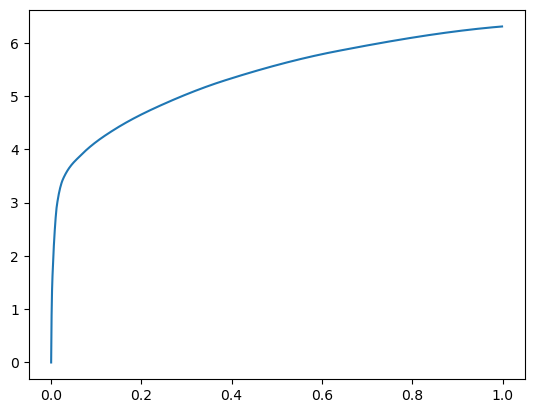

[0.00000000e+00 5.54084778e-04 1.13201141e-03 2.33364105e-03
 4.61101532e-03 7.59029388e-03 1.21164322e-02 2.41155624e-02
 6.47821426e-02 1.39031410e-01 2.49491692e-01 4.00815010e-01
 6.20341301e-01 1.00000000e+00] betas
[0.         0.50792429 0.41088528 0.4691286  0.47686482 0.43187203
 0.40546186 0.46975944 0.51649239 0.46950582 0.48420711 0.46034205
 0.47524726 0.5080568 ] r
-22480.269231963164 score post


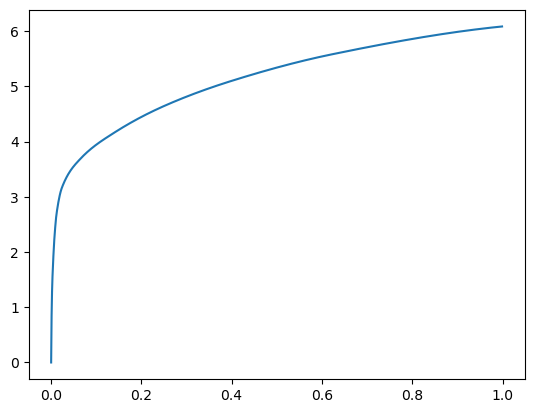

[0.00000000e+00 5.04493713e-04 1.16634369e-03 2.39276886e-03
 4.65679169e-03 7.98511505e-03 1.40638351e-02 2.95000076e-02
 7.15303421e-02 1.49777412e-01 2.60462761e-01 4.19409752e-01
 6.44137383e-01 1.00000000e+00] betas
[0.         0.44986992 0.49883456 0.52985969 0.48160215 0.4760339
 0.54190149 0.45235749 0.50348492 0.48575816 0.48136474 0.47166361
 0.47105682 0.44798755] r
-22484.348661750126 score post


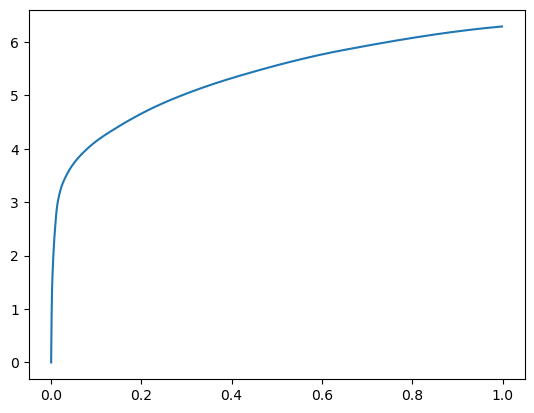

[0.00000000e+00 5.46455383e-04 1.20067596e-03 2.30503082e-03
 4.51755524e-03 7.84206390e-03 1.28087997e-02 2.72493362e-02
 6.43701553e-02 1.37431145e-01 2.43824959e-01 4.00059700e-01
 6.22454643e-01 1.00000000e+00] betas
[0.         0.48518431 0.48338424 0.49551024 0.4778489  0.51188515
 0.4600555  0.49768439 0.3916168  0.46630932 0.51774    0.53946749
 0.44918479 0.43560976] r
-22481.621781595804 score post


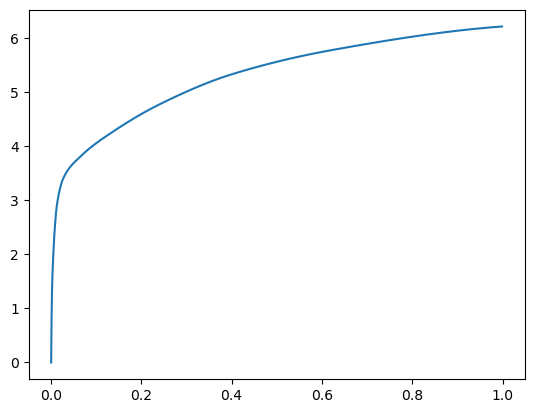

[0.00000000e+00 5.36918640e-04 1.17778778e-03 2.20775604e-03
 4.34780121e-03 7.32135773e-03 1.20496750e-02 2.40316391e-02
 6.67562485e-02 1.42991066e-01 2.41593361e-01 3.74421120e-01
 5.95423698e-01 1.00000000e+00] betas
[0.         0.45006022 0.49296995 0.49544849 0.49236061 0.50838539
 0.41093927 0.49075302 0.51832977 0.4944509  0.44057924 0.4718953
 0.47028107 0.5233004 ] r
-22482.458794922564 score post


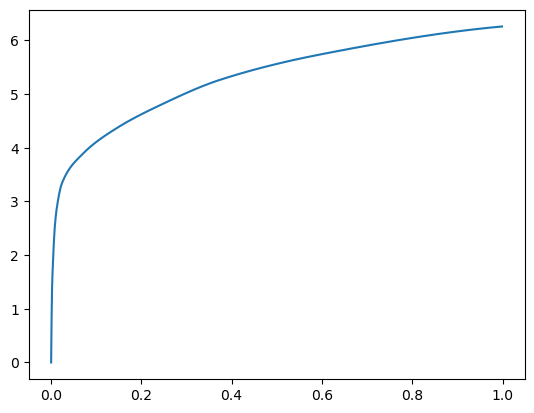

[0.00000000e+00 5.75065613e-04 1.21021271e-03 2.22682953e-03
 4.32300568e-03 7.06768036e-03 1.27229691e-02 2.54907608e-02
 6.59379959e-02 1.39241219e-01 2.46850014e-01 3.85807991e-01
 6.20949745e-01 1.00000000e+00] betas
[0.         0.51008587 0.47409011 0.43228666 0.50983336 0.42703584
 0.54419222 0.46722048 0.50450875 0.41695388 0.5160626  0.48178656
 0.48911434 0.44230857] r
-22480.269231963164 score post


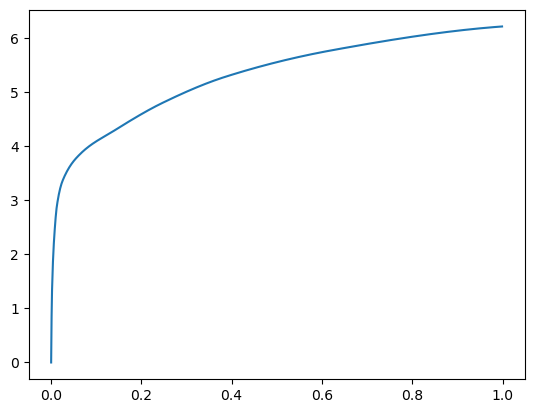

[0.00000000e+00 5.35011292e-04 1.16252899e-03 2.28404999e-03
 4.25052643e-03 7.37476349e-03 1.22480392e-02 2.46438980e-02
 6.05840683e-02 1.42457008e-01 2.41698265e-01 3.76702309e-01
 5.98282814e-01 1.00000000e+00] betas
[0.         0.45476191 0.50156968 0.51165545 0.45591044 0.47666212
 0.45214258 0.52704556 0.46181325 0.50045079 0.50954534 0.5117171
 0.46710811 0.47105848] r
-22484.52742382129 score post


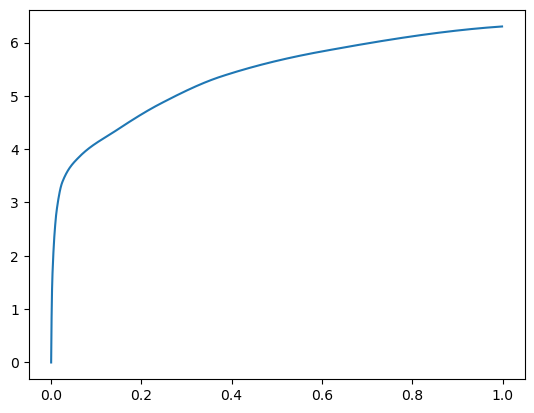

[0.00000000e+00 5.71250916e-04 1.18541718e-03 2.24208832e-03
 4.33063507e-03 7.57312775e-03 1.31711960e-02 2.52676010e-02
 6.48756027e-02 1.46128654e-01 2.40723610e-01 3.65859032e-01
 5.89562416e-01 1.00000000e+00] betas
[0.         0.51686844 0.47235297 0.46183152 0.45153601 0.52702819
 0.53164231 0.44830722 0.47985548 0.46825954 0.4462939  0.4574738
 0.57008744 0.50876203] r
-22481.621781595804 score post


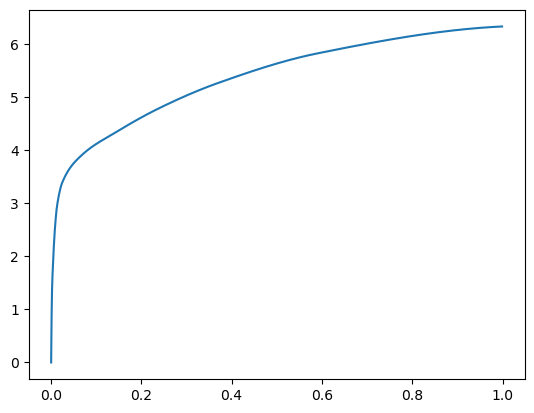

[0.00000000e+00 5.36918640e-04 1.16252899e-03 2.28214264e-03
 4.59003448e-03 7.64560699e-03 1.26008987e-02 2.54888535e-02
 6.64014816e-02 1.52264595e-01 2.58624077e-01 4.00126457e-01
 6.01782799e-01 1.00000000e+00] betas
[0.         0.44269988 0.50636335 0.49152049 0.53488556 0.48162638
 0.44324768 0.49492925 0.4850216  0.55601905 0.4786538  0.45446657
 0.40958508 0.49727936] r
-22480.269231963164 score post


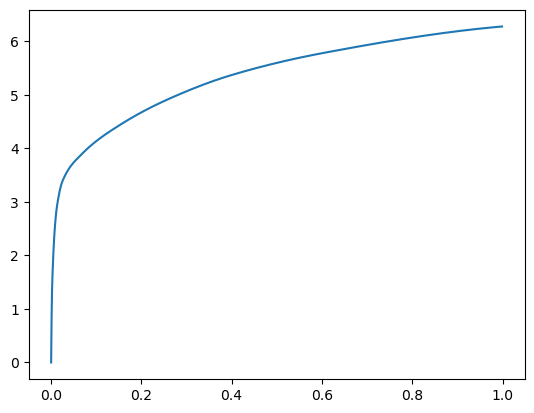

[0.00000000e+00 5.84602356e-04 1.19113922e-03 2.30693817e-03
 4.35733795e-03 7.29274750e-03 1.25379562e-02 2.47392654e-02
 6.43129349e-02 1.35371208e-01 2.36357689e-01 3.77936363e-01
 6.10926628e-01 1.00000000e+00] betas
[0.         0.48157714 0.4661372  0.46032005 0.41643216 0.45262364
 0.56793829 0.42617861 0.53424653 0.45886163 0.44631225 0.46904826
 0.52377774 0.48242924] r
-22483.215759872455 score post


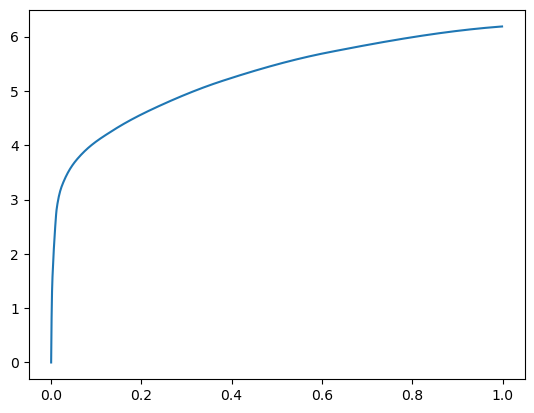

[0.00000000e+00 5.76972961e-04 1.19876862e-03 2.37751007e-03
 4.81128693e-03 8.07666779e-03 1.27153397e-02 2.76727676e-02
 6.44502640e-02 1.38831139e-01 2.48990059e-01 3.98203850e-01
 6.14954948e-01 1.00000000e+00] betas
[0.         0.54571589 0.4833885  0.48368227 0.55090936 0.50953152
 0.40812543 0.56773683 0.47161895 0.46468035 0.52173409 0.48086918
 0.41749396 0.48683758] r
-22482.458794922564 score post


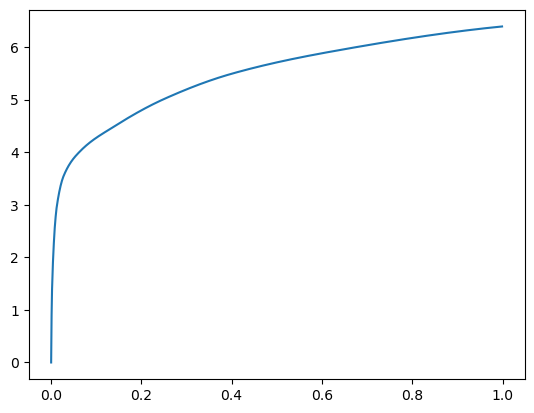

[0.00000000e+00 5.14030457e-04 1.12247467e-03 2.25543976e-03
 4.29821014e-03 7.18212128e-03 1.22060776e-02 2.34231949e-02
 5.48849106e-02 1.27614021e-01 2.26899147e-01 3.68071556e-01
 6.11826897e-01 1.00000000e+00] betas
[0.         0.44204654 0.49436215 0.51573191 0.46372183 0.44381478
 0.48285888 0.45853052 0.45010543 0.5194511  0.49817634 0.45880932
 0.45566921 0.48838303] r
-22481.621781595804 score post


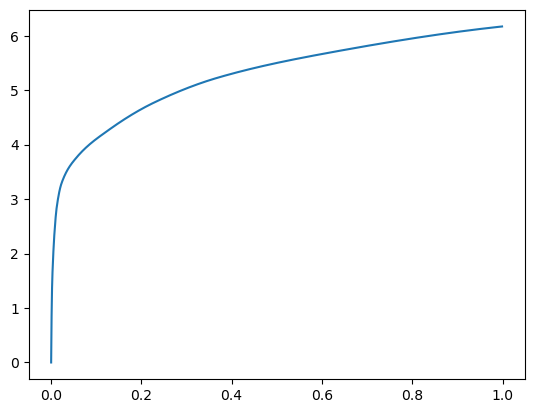

[0.00000000e+00 5.52177429e-04 1.14345551e-03 2.16960907e-03
 4.20665741e-03 7.29846954e-03 1.23052597e-02 2.44054794e-02
 5.97181320e-02 1.27961159e-01 2.21627235e-01 3.65849495e-01
 6.20783806e-01 1.00000000e+00] betas
[0.         0.44445796 0.46789068 0.48984951 0.45269526 0.51443494
 0.51950177 0.4721976  0.48017665 0.47904304 0.47386606 0.45352122
 0.54540893 0.46233088] r
-22480.269231963164 score post


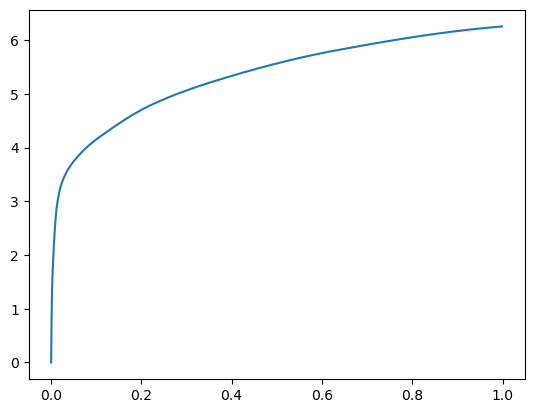

737918 steps_after


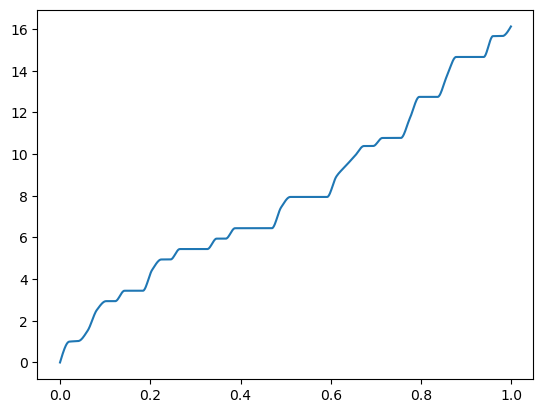

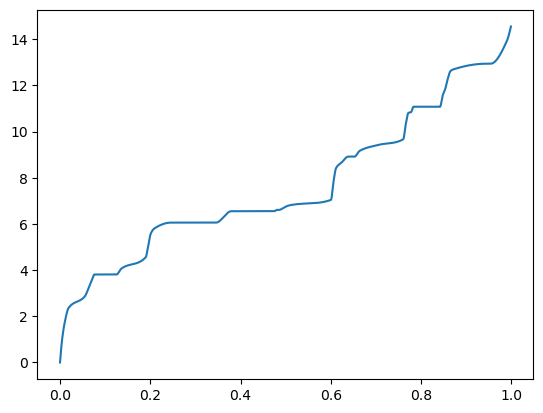

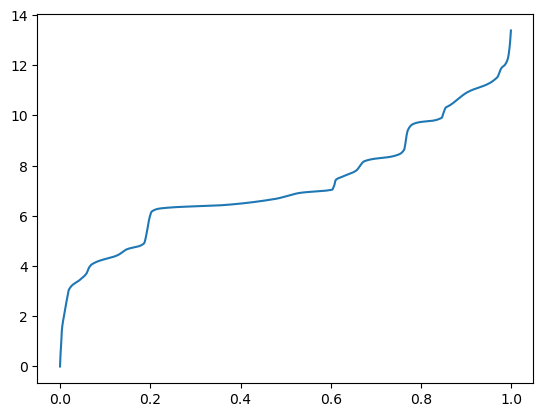

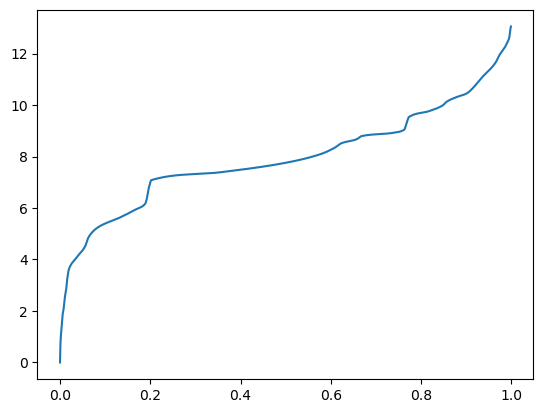

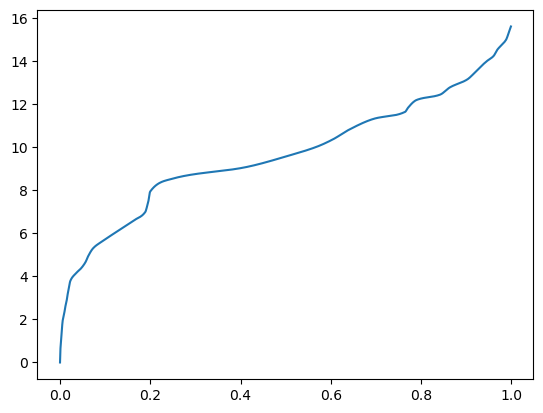

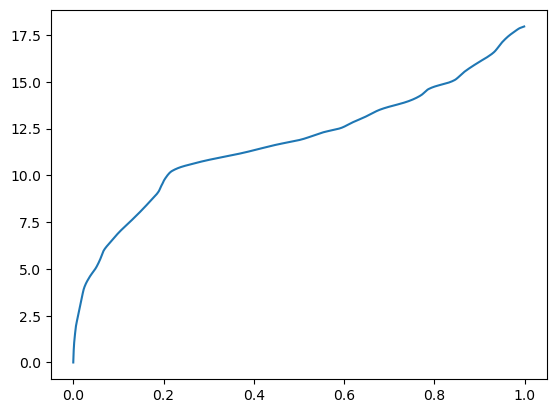

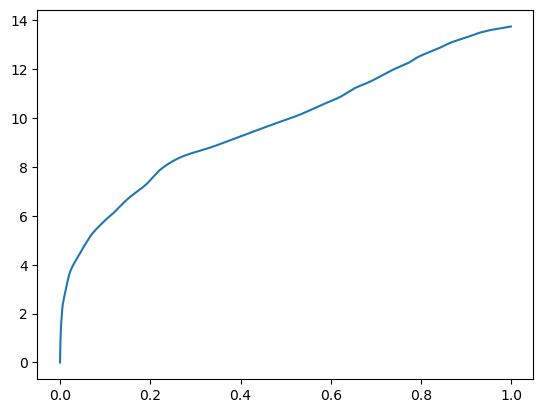

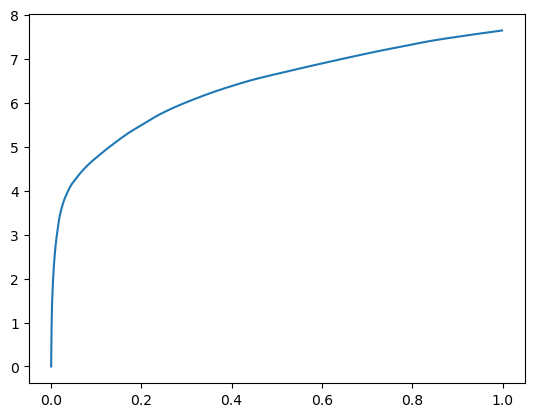

10560 steps
betas [0.00000000e+00 5.97953796e-04 1.24454498e-03 2.77614594e-03
 5.39493561e-03 9.66548920e-03 1.65109634e-02 3.01980972e-02
 6.22014999e-02 1.19156837e-01 1.95046425e-01 2.98817635e-01
 4.58468437e-01 6.90806389e-01 1.00000000e+00]
n_chains 15
[0.00000000e+00 5.97953796e-04 1.24454498e-03 2.77614594e-03
 5.39493561e-03 9.66548920e-03 1.65109634e-02 3.01980972e-02
 6.22014999e-02 1.19156837e-01 1.95046425e-01 2.98817635e-01
 4.58468437e-01 6.90806389e-01 1.00000000e+00] betas
[0.         0.00377321 0.0040795  0.         0.         0.
 0.         0.         0.         0.         0.         0.41807802
 0.         0.67398215 0.86746139] r
-22481.990460408004 score post


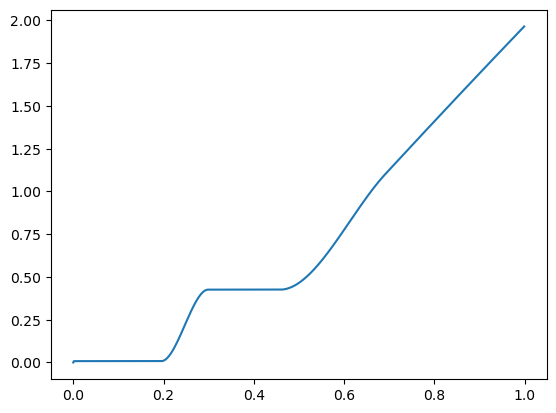

[0.         0.23402882 0.25770473 0.2925806  0.53948498 0.58079433
 0.61756229 0.65499973 0.6993227  0.7487154  0.79837132 0.84830761
 0.89854336 0.94909954 1.        ] betas
[0.         0.99904158 0.09713234 0.12302167 0.6019231  0.08291634
 0.06664894 0.06227554 0.07117469 0.07243617 0.06819872 0.0608744
 0.05541589 0.05059477 0.0475755 ] r
-22482.458794922564 score post


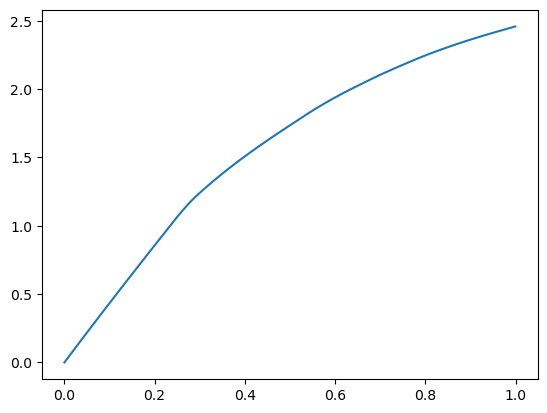

[0.         0.04003239 0.08061504 0.1216917  0.16320133 0.20507336
 0.24714756 0.29604244 0.35888767 0.43054485 0.50954342 0.5959425
 0.70179081 0.82957363 1.        ] betas
[0.         1.         0.28555682 0.24507203 0.22080643 0.20806742
 0.18132205 0.17674844 0.19464665 0.19044102 0.17862043 0.17137365
 0.1914311  0.19256295 0.18798035] r
-22480.269231963164 score post


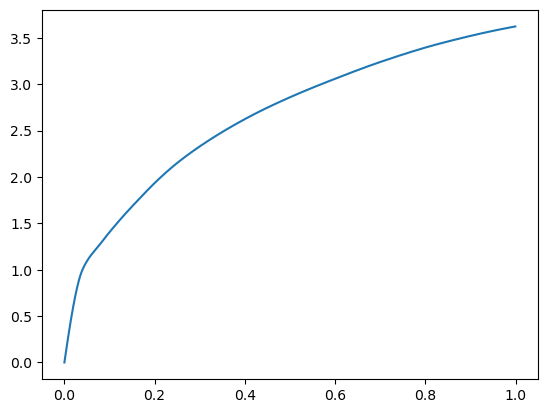

[0.         0.00785923 0.01646137 0.02671909 0.04345608 0.0820055
 0.12577152 0.17507458 0.23018742 0.29980946 0.38645077 0.4939394
 0.62466526 0.77862644 1.        ] betas
[0.         0.99957554 0.64906442 0.31826684 0.22739087 0.32044566
 0.28959729 0.25777508 0.27238816 0.27979233 0.28611791 0.28414875
 0.24463312 0.21922852 0.24612476] r
-22484.348661750126 score post


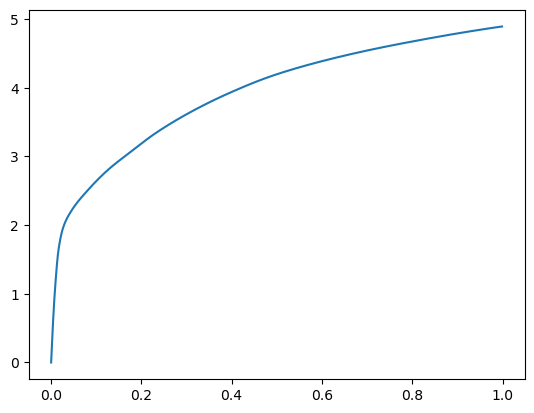

[0.         0.00239658 0.00508213 0.00837994 0.01241779 0.01888752
 0.0349741  0.07282734 0.12450314 0.19157124 0.26867199 0.3683691
 0.49885845 0.7010088  1.        ] betas
[0.         0.96864009 0.5130039  0.4567132  0.37668087 0.34365923
 0.39201759 0.43352172 0.35611187 0.32328441 0.32990681 0.3239194
 0.3368464  0.35229355 0.36858323] r
-22480.269231963164 score post


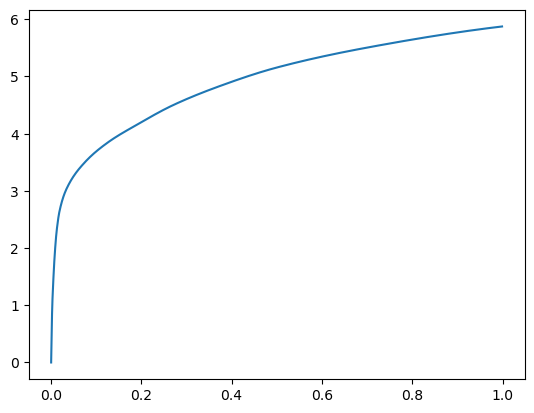

[0.00000000e+00 8.78334045e-04 1.95598602e-03 3.74126434e-03
 6.36768341e-03 9.88292694e-03 1.57213211e-02 2.89239883e-02
 5.90333939e-02 1.13667488e-01 1.98821068e-01 3.03444862e-01
 4.48067665e-01 6.66869164e-01 1.00000000e+00] betas
[0.         0.70085462 0.55509356 0.45377146 0.45582631 0.4203706
 0.42530638 0.40772505 0.4006455  0.39749513 0.45061218 0.45322619
 0.38233878 0.46414826 0.46278846] r
-22481.990460408004 score post


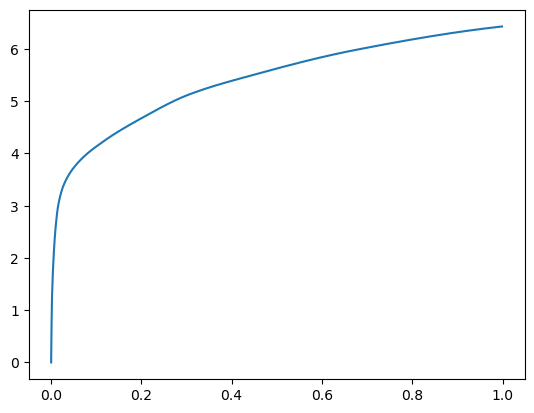

[0.00000000e+00 5.35011292e-04 1.23882294e-03 2.33554840e-03
 4.38022614e-03 7.32135773e-03 1.18227005e-02 2.09474564e-02
 4.54092026e-02 1.00255013e-01 1.83306694e-01 2.84346581e-01
 4.51584816e-01 6.68917656e-01 1.00000000e+00] betas
[0.         0.4642406  0.47778747 0.45386919 0.4769618  0.45841333
 0.45313349 0.46169585 0.43391739 0.40771302 0.47544481 0.43907883
 0.44439088 0.41103569 0.40111133] r
-22480.269231963164 score post


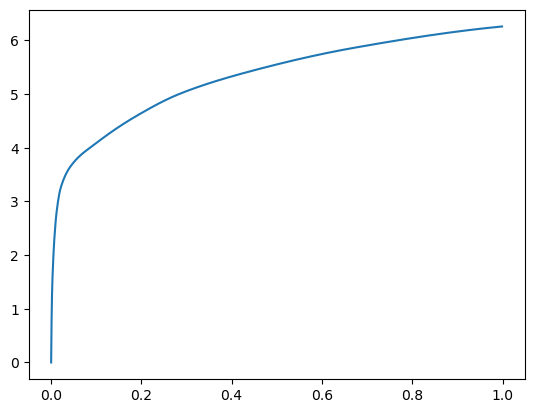

[0.00000000e+00 5.12123108e-04 1.15108490e-03 2.16579437e-03
 3.94344330e-03 6.59275055e-03 1.05485916e-02 1.77717209e-02
 3.70893478e-02 9.00354385e-02 1.65225029e-01 2.61183739e-01
 4.15513039e-01 6.39454842e-01 1.00000000e+00] betas
[0.         0.44638616 0.46993485 0.48789337 0.4479496  0.43867686
 0.46912784 0.45486935 0.50503638 0.45025947 0.41767338 0.40795388
 0.46435054 0.44747677 0.4425114 ] r
-22480.269231963164 score post


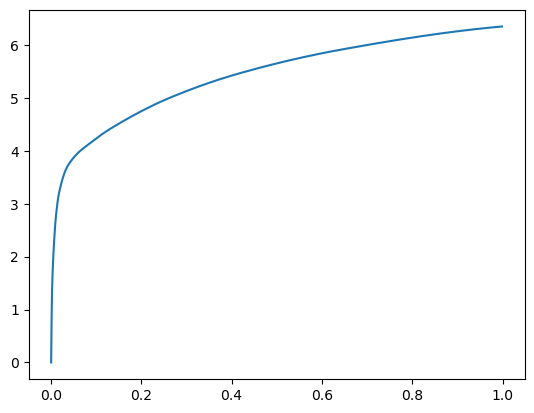

[0.00000000e+00 5.21659851e-04 1.13582611e-03 2.04563141e-03
 3.75843048e-03 6.42871857e-03 1.01194382e-02 1.68390274e-02
 3.17506790e-02 7.65676498e-02 1.54561043e-01 2.59400368e-01
 4.08528328e-01 6.32378578e-01 1.00000000e+00] betas
[0.         0.47506008 0.48925857 0.41893152 0.41720143 0.43384027
 0.46056561 0.46733674 0.36672685 0.44127756 0.41494167 0.4785103
 0.47802795 0.50964631 0.4085444 ] r
-22484.348467993714 score post


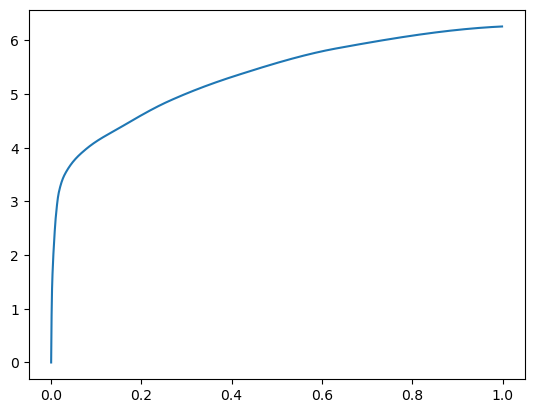

[0.00000000e+00 4.89234924e-04 1.02901459e-03 1.92546844e-03
 3.69739532e-03 6.43825531e-03 9.98973846e-03 1.60875320e-02
 3.50522995e-02 8.45212936e-02 1.72062874e-01 2.74064064e-01
 4.17426109e-01 6.08912468e-01 1.00000000e+00] betas
[0.         0.4443778  0.38789687 0.50725657 0.48000303 0.44872413
 0.4309862  0.47621215 0.46110959 0.43093266 0.48312175 0.44790225
 0.44743889 0.43056249 0.49721312] r
-22480.269231963164 score post


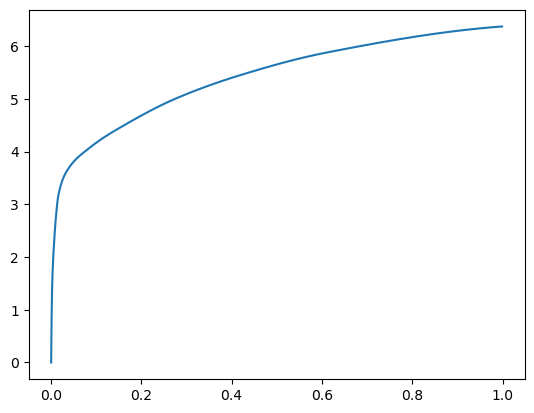

[0.00000000e+00 5.02586365e-04 1.15108490e-03 1.99604034e-03
 3.70502472e-03 6.49547577e-03 1.03235245e-02 1.63698196e-02
 3.54585648e-02 8.89234543e-02 1.72480583e-01 2.76627541e-01
 4.23989296e-01 6.34083748e-01 1.00000000e+00] betas
[0.         0.46052467 0.49219773 0.41186777 0.43318169 0.48656751
 0.44248751 0.4138719  0.46717283 0.44069368 0.44249584 0.43965351
 0.42180665 0.41712616 0.44740203] r
-22484.252724367707 score post


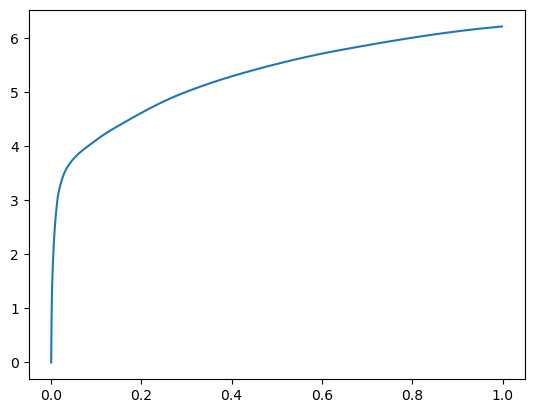

[0.00000000e+00 4.83512878e-04 1.04999542e-03 1.90639496e-03
 3.60202789e-03 6.05678558e-03 9.65213776e-03 1.56373978e-02
 3.17621231e-02 8.07714462e-02 1.61810875e-01 2.63789177e-01
 4.14134026e-01 6.36237144e-01 1.00000000e+00] betas
[0.         0.38879324 0.49580976 0.46722059 0.44320067 0.43682216
 0.4693582  0.41865351 0.38841333 0.41256436 0.48118636 0.44774663
 0.48709004 0.50395373 0.44335441] r
-22480.269231963164 score post


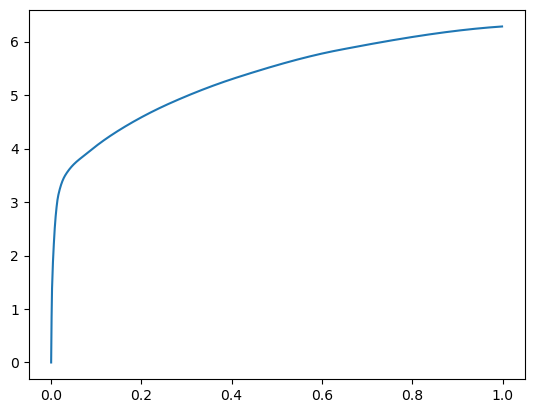

[0.00000000e+00 5.52177429e-04 1.06906891e-03 1.89304352e-03
 3.60393524e-03 6.13880157e-03 9.56821442e-03 1.62210464e-02
 3.84130478e-02 9.83343124e-02 1.79316521e-01 2.87621498e-01
 4.32631493e-01 6.32870674e-01 1.00000000e+00] betas
[0.         0.4804972  0.38591571 0.410535   0.42983376 0.50904158
 0.42644649 0.49661874 0.52576063 0.49211372 0.46012708 0.4338466
 0.41347395 0.41290952 0.45443589] r
-22480.269231963164 score post


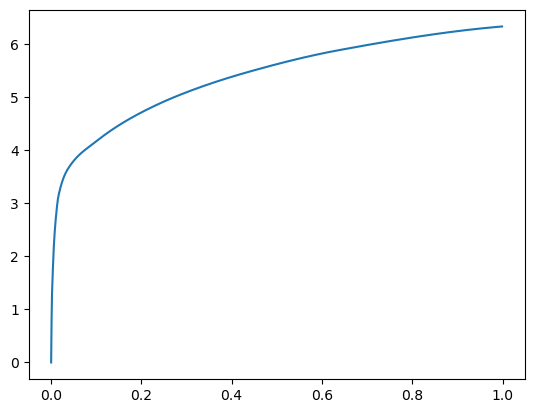

[0.00000000e+00 5.17845154e-04 1.13201141e-03 2.13909149e-03
 4.06169891e-03 6.43634796e-03 1.03197098e-02 1.69115067e-02
 3.50961685e-02 8.50038528e-02 1.60191536e-01 2.65770912e-01
 4.17483330e-01 6.34247780e-01 1.00000000e+00] betas
[0.         0.46392439 0.4691098  0.47974205 0.46702611 0.41371685
 0.46411173 0.41996869 0.42184965 0.42347169 0.42428928 0.52557072
 0.48282485 0.41247352 0.45322797] r
-22484.52742382129 score post


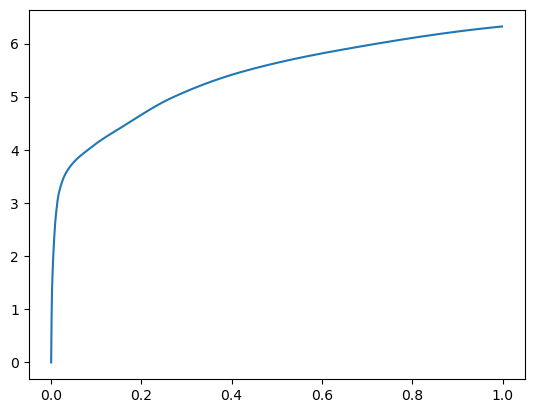

[0.00000000e+00 5.02586365e-04 1.08432770e-03 1.97696686e-03
 3.69930267e-03 6.19220734e-03 9.78755951e-03 1.64747238e-02
 3.60574722e-02 9.10844803e-02 1.72917366e-01 2.64245033e-01
 4.02510643e-01 6.35363579e-01 1.00000000e+00] betas
[0.         0.415461   0.42618001 0.46409375 0.45265852 0.47777101
 0.42935311 0.4397283  0.49679509 0.51218124 0.4503863  0.42187245
 0.47095337 0.45780247 0.41340889] r
-22480.269231963164 score post


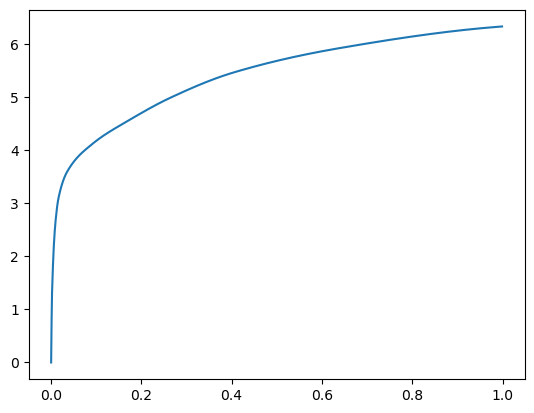

[0.00000000e+00 5.50270081e-04 1.18732452e-03 2.12192535e-03
 3.92436981e-03 6.35433197e-03 1.03311539e-02 1.80253983e-02
 3.70416641e-02 8.45212936e-02 1.64052010e-01 2.60748863e-01
 3.90112877e-01 6.09833717e-01 1.00000000e+00] betas
[0.         0.49293508 0.48889894 0.40421237 0.44649195 0.42308055
 0.46710103 0.43526112 0.43352787 0.43925759 0.45472474 0.45118594
 0.41066199 0.4539986  0.52679123] r
-22480.269231963164 score post


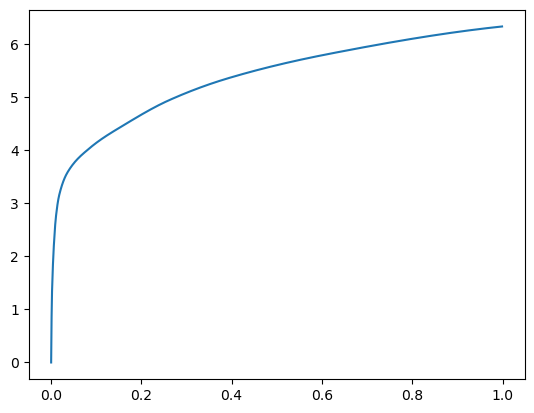

[0.00000000e+00 5.00679016e-04 1.06334686e-03 2.03227997e-03
 3.80611420e-03 6.38484955e-03 1.01995468e-02 1.82027817e-02
 3.88307571e-02 8.98122787e-02 1.70777321e-01 2.70155907e-01
 4.21177864e-01 6.55333519e-01 1.00000000e+00] betas
[0.         0.46596732 0.43532741 0.45681406 0.46427738 0.43354833
 0.50197114 0.43834184 0.47097474 0.43871142 0.48735309 0.42167987
 0.47450745 0.45740053 0.39333107] r
-22480.269231963164 score post


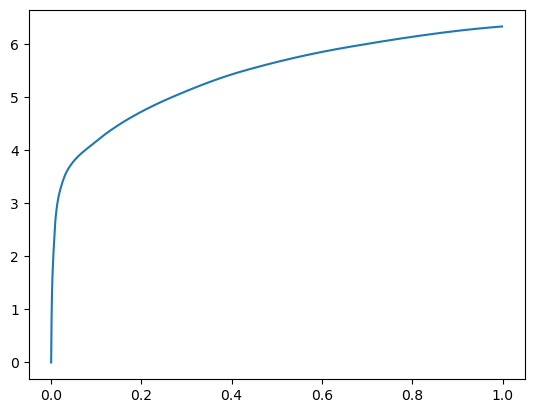

[0.00000000e+00 4.85420227e-04 1.07097626e-03 2.03418732e-03
 3.75461578e-03 6.44207001e-03 9.75131989e-03 1.74703598e-02
 3.57809067e-02 8.55417252e-02 1.58226967e-01 2.61105537e-01
 3.99779320e-01 6.16780281e-01 1.00000000e+00] betas
[0.         0.47939799 0.43358226 0.44142292 0.42663735 0.50749192
 0.39896502 0.47775254 0.46390313 0.45085974 0.46363143 0.49379473
 0.44603657 0.46994442 0.47240522] r
-22481.621781595804 score post


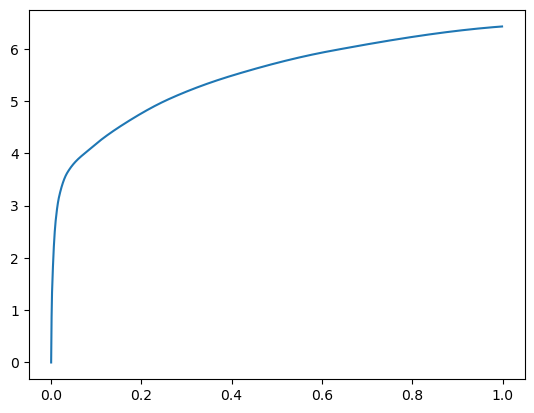

[0.00000000e+00 4.62532043e-04 1.08051300e-03 2.10285187e-03
 4.01020050e-03 6.48593903e-03 1.05504990e-02 1.87559128e-02
 3.88689041e-02 9.23910141e-02 1.66666985e-01 2.64054298e-01
 4.09117699e-01 6.25123024e-01 1.00000000e+00] betas
[0.         0.38914058 0.5171208  0.50445801 0.45635784 0.40639284
 0.44480843 0.44148513 0.40641089 0.39951208 0.4127881  0.42079118
 0.45275904 0.44567764 0.46724276] r
-22483.215759872455 score post


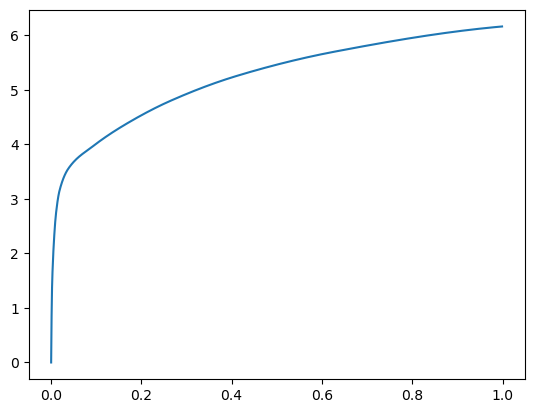

[0.00000000e+00 5.21659851e-04 1.04236603e-03 1.86443329e-03
 3.47614288e-03 5.97286224e-03 9.64832306e-03 1.66826248e-02
 3.54757309e-02 9.20000076e-02 1.71818733e-01 2.76373863e-01
 4.22045708e-01 6.42128944e-01 1.00000000e+00] betas
[0.         0.48120228 0.42657625 0.4739844  0.40757266 0.41282904
 0.47440156 0.48466016 0.47008474 0.57627738 0.43426423 0.44265647
 0.43567811 0.42047304 0.42893831] r
-22481.990460408004 score post


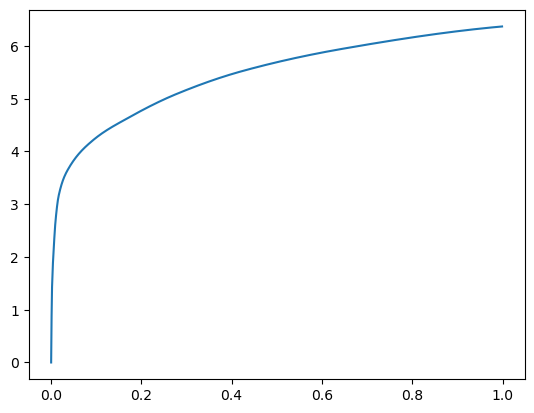

[0.00000000e+00 4.91142273e-04 1.04618073e-03 1.82056427e-03
 3.62873077e-03 6.47068024e-03 1.02319717e-02 1.72891617e-02
 3.60212326e-02 7.70311356e-02 1.52379036e-01 2.54828453e-01
 3.97658348e-01 6.25100136e-01 1.00000000e+00] betas
[0.         0.4463032  0.45769504 0.38696521 0.45988782 0.51988256
 0.44022374 0.46508113 0.50491824 0.41646972 0.45290496 0.42674958
 0.46929134 0.44913669 0.48702052] r
-22480.269231963164 score post


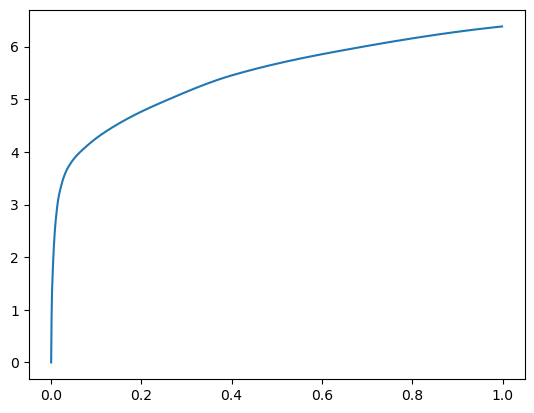

[0.00000000e+00 5.02586365e-04 1.05762482e-03 2.05135345e-03
 3.97205353e-03 6.53171539e-03 1.05161667e-02 1.76649094e-02
 3.39860916e-02 7.77597427e-02 1.54120445e-01 2.65057564e-01
 4.07465935e-01 6.44740105e-01 1.00000000e+00] betas
[0.         0.45155365 0.45150842 0.4891353  0.51042763 0.45258397
 0.46884452 0.3842279  0.37401261 0.41616559 0.46028148 0.45376136
 0.52826071 0.41451873 0.41353445] r
-22483.215759872455 score post


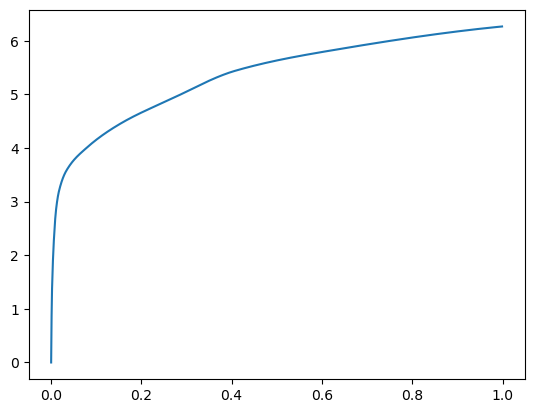

[0.00000000e+00 4.98771667e-04 1.04618073e-03 1.92165375e-03
 3.46660614e-03 5.76877594e-03 9.07039642e-03 1.57537460e-02
 3.39784622e-02 8.20016861e-02 1.58011436e-01 2.68374443e-01
 3.83460045e-01 6.20556831e-01 1.00000000e+00] betas
[0.         0.42814581 0.44852769 0.4444066  0.41712607 0.4161652
 0.43498231 0.53002946 0.46540675 0.44056333 0.45329802 0.46834982
 0.39737841 0.55132305 0.42808153] r
-22482.458794922564 score post


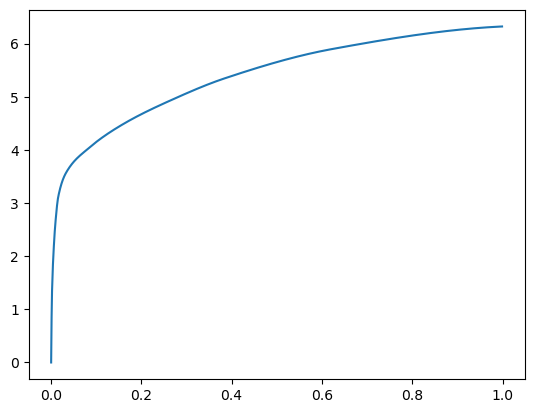

[0.00000000e+00 5.27381897e-04 1.08814240e-03 2.01702118e-03
 3.78894806e-03 6.46114349e-03 1.02796555e-02 1.67970657e-02
 3.60136032e-02 8.75368118e-02 1.65780067e-01 2.74073601e-01
 4.10517693e-01 6.05996132e-01 1.00000000e+00] betas
[0.         0.52792419 0.43274316 0.49310138 0.44391978 0.48994922
 0.44709149 0.43991617 0.45865459 0.45116939 0.44483064 0.43659761
 0.43318972 0.41729703 0.48720883] r
-22480.269231963164 score post


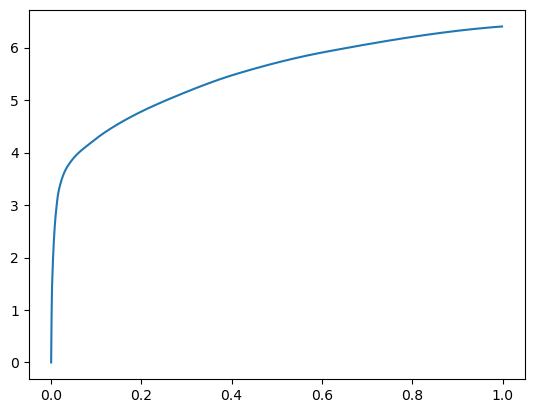

[0.00000000e+00 4.49180603e-04 1.01757050e-03 1.81484222e-03
 3.46660614e-03 5.81455231e-03 9.33170319e-03 1.52425766e-02
 3.12280655e-02 7.75957108e-02 1.54372215e-01 2.64458656e-01
 4.06567574e-01 6.24550819e-01 1.00000000e+00] betas
[0.         0.42064429 0.45728315 0.4222061  0.47186089 0.39196183
 0.44778188 0.45281533 0.45477771 0.43844885 0.49328741 0.50683008
 0.45658561 0.44618505 0.43848947] r
-22480.269231963164 score post


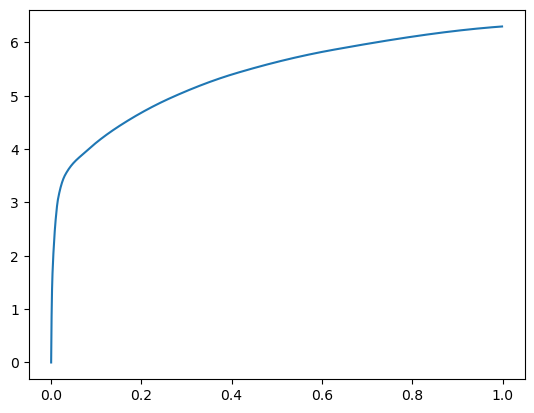

[0.00000000e+00 4.83512878e-04 1.05190277e-03 1.94835663e-03
 3.59821320e-03 6.40964508e-03 1.02491379e-02 1.72548294e-02
 3.68490219e-02 8.97970200e-02 1.63407326e-01 2.62223244e-01
 4.00652885e-01 6.17129326e-01 1.00000000e+00] betas
[0.         0.41093933 0.44217833 0.45660485 0.46820346 0.49753858
 0.45573171 0.43747177 0.41336925 0.44452664 0.39816887 0.42199059
 0.43160828 0.50049963 0.50345732] r
-22480.269231963164 score post


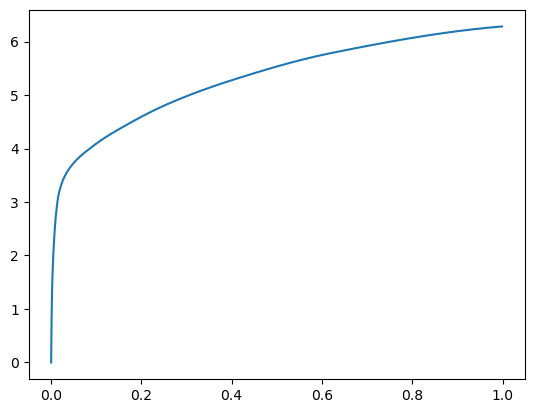

[0.00000000e+00 5.29289246e-04 1.12438202e-03 2.04753876e-03
 3.67450714e-03 6.19029999e-03 9.81426239e-03 1.65262222e-02
 3.74631882e-02 9.16204453e-02 1.76613808e-01 2.87549019e-01
 4.40861702e-01 6.49243355e-01 1.00000000e+00] betas
[0.         0.42124391 0.45646534 0.45594964 0.41515859 0.40631497
 0.42793926 0.47701172 0.56710831 0.46091489 0.45557768 0.46592338
 0.45137124 0.42212301 0.45538341] r
-22481.621781595804 score post


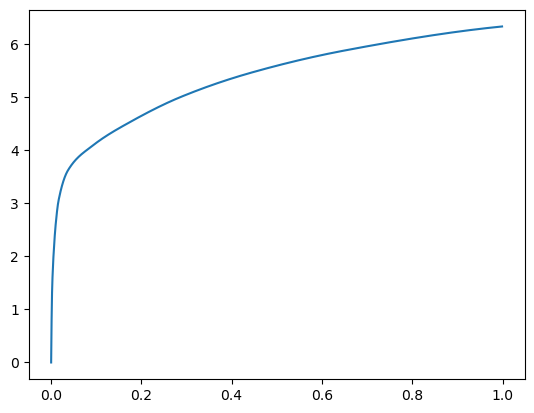

[0.00000000e+00 5.69343567e-04 1.17015839e-03 2.12001801e-03
 3.99494171e-03 6.99710846e-03 1.13306046e-02 1.92403793e-02
 3.70969772e-02 8.96024704e-02 1.73192024e-01 2.79295921e-01
 4.29480553e-01 6.50877953e-01 1.00000000e+00] betas
[0.         0.53528148 0.46977536 0.43474291 0.43746331 0.48684826
 0.51229046 0.45990691 0.41229268 0.52847973 0.48864252 0.48326829
 0.42528837 0.44701134 0.42777136] r
-22482.458794922564 score post


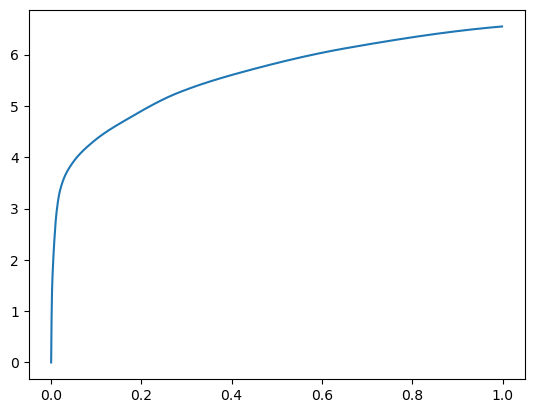

[0.00000000e+00 4.91142273e-04 1.06143951e-03 2.01129913e-03
 3.96442413e-03 6.81591034e-03 1.05562210e-02 1.76820755e-02
 3.66811752e-02 8.08305740e-02 1.56058311e-01 2.52635002e-01
 4.04376030e-01 6.26109123e-01 1.00000000e+00] betas
[0.         0.4437327  0.44021282 0.44447589 0.46334914 0.48085861
 0.43840038 0.45002935 0.45409845 0.48627848 0.46701952 0.44212741
 0.47004266 0.4658513  0.47812297] r
-22480.269231963164 score post


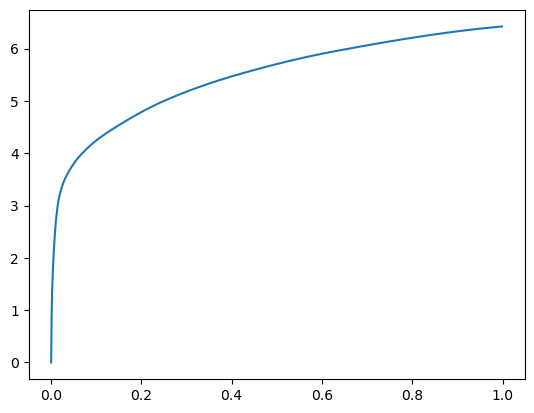

[0.00000000e+00 5.10215759e-04 1.11865997e-03 2.16388702e-03
 4.18758392e-03 6.97422028e-03 1.10635757e-02 1.91106796e-02
 4.03432846e-02 8.44144821e-02 1.59951210e-01 2.62721062e-01
 4.14780617e-01 6.37991905e-01 1.00000000e+00] betas
[0.         0.45295011 0.4961107  0.47150855 0.50854132 0.47018897
 0.42857917 0.40377069 0.44152589 0.44852187 0.48198943 0.43223497
 0.4584044  0.44049595 0.40547779] r
-22480.269231963164 score post


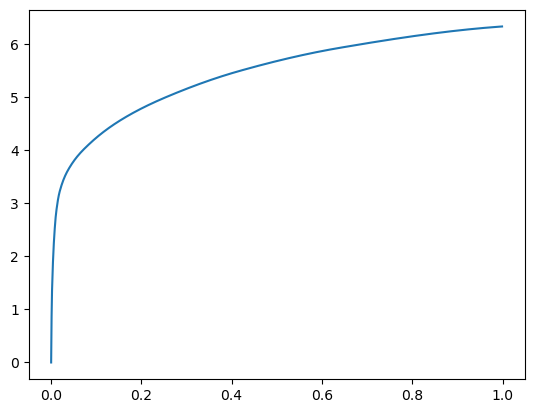

[0.00000000e+00 5.10215759e-04 1.04999542e-03 1.98650360e-03
 3.62873077e-03 6.03961945e-03 9.73796844e-03 1.73616409e-02
 3.69424820e-02 7.87420273e-02 1.45827293e-01 2.47704506e-01
 3.91045570e-01 6.07207298e-01 1.00000000e+00] betas
[0.         0.44335826 0.43458375 0.48645727 0.47693992 0.48000495
 0.43415512 0.41966653 0.40866729 0.42858293 0.42785637 0.44560025
 0.46362195 0.44620366 0.52467629] r
-22482.458794922564 score post


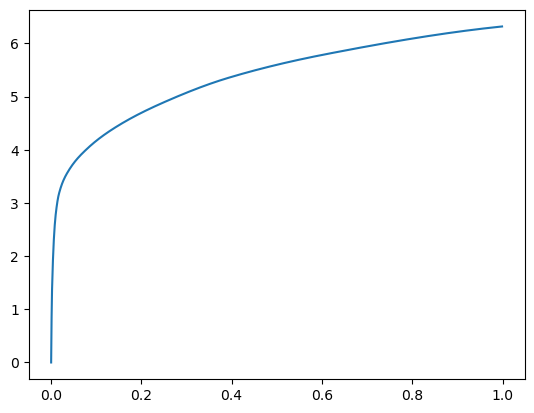

[0.00000000e+00 5.19752502e-04 1.08814240e-03 1.95980072e-03
 3.48186493e-03 5.63907623e-03 9.18674469e-03 1.69172287e-02
 3.89204025e-02 8.52346420e-02 1.60397530e-01 2.69404411e-01
 4.18383598e-01 6.51995659e-01 1.00000000e+00] betas
[0.         0.45156696 0.45273086 0.4380138  0.42885168 0.38330565
 0.45630954 0.49505411 0.50329732 0.40723847 0.41419327 0.46119011
 0.45292126 0.46793097 0.48345688] r
-22480.269231963164 score post


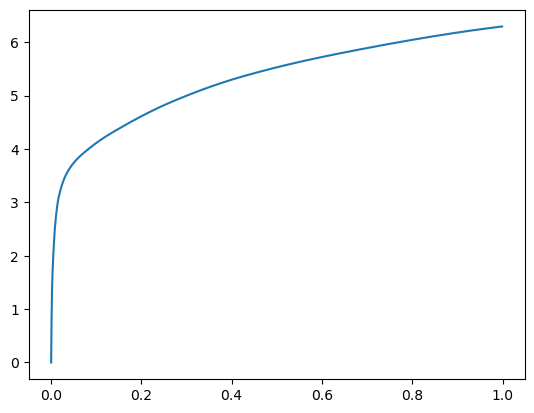

[0.00000000e+00 5.17845154e-04 1.08051300e-03 1.97887421e-03
 3.60965729e-03 6.26850128e-03 1.02033615e-02 1.81055069e-02
 3.80849838e-02 8.98256302e-02 1.74403191e-01 2.85080910e-01
 4.40014839e-01 6.72446251e-01 1.00000000e+00] betas
[0.         0.43062942 0.46485069 0.47124882 0.43069345 0.49104689
 0.45769899 0.45099861 0.45316027 0.44817127 0.43061127 0.43906148
 0.46234285 0.49662263 0.40213344] r
-22481.990460408004 score post


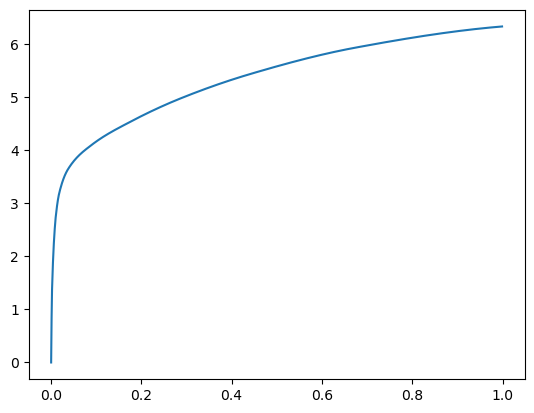

[0.00000000e+00 5.42640686e-04 1.09386444e-03 1.95026398e-03
 3.65924835e-03 6.07967377e-03 9.80281830e-03 1.72281265e-02
 3.57255936e-02 8.52746964e-02 1.72572136e-01 2.86488533e-01
 4.37865257e-01 6.42600060e-01 1.00000000e+00] betas
[0.         0.49217397 0.38705616 0.42500554 0.42635017 0.41033806
 0.48346596 0.47222885 0.39096498 0.41872083 0.50091751 0.46883756
 0.46864248 0.40504807 0.42593177] r
-22487.170350548633 score post


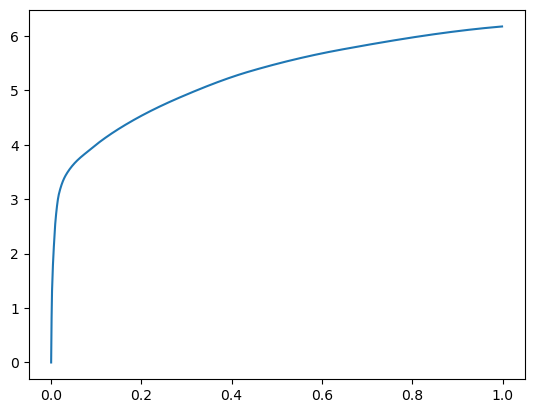

[0.00000000e+00 4.79698181e-04 1.09958649e-03 2.00557709e-03
 3.82709503e-03 6.51454926e-03 1.00564957e-02 1.69801712e-02
 3.90539169e-02 9.46588516e-02 1.73398018e-01 2.79860497e-01
 4.17763710e-01 6.32758141e-01 1.00000000e+00] betas
[0.         0.46438752 0.50012807 0.42055528 0.42047997 0.43866363
 0.40649136 0.43471775 0.51661903 0.42839328 0.4196146  0.4509654
 0.43870818 0.45249464 0.47714117] r
-22480.269231963164 score post


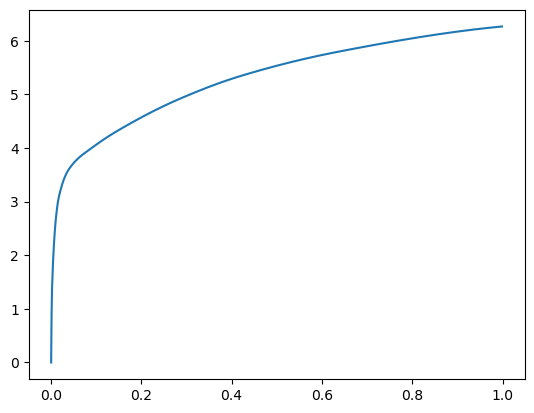

[0.00000000e+00 4.60624695e-04 9.94682312e-04 1.88350677e-03
 3.75270844e-03 6.47640228e-03 1.04932785e-02 1.83477402e-02
 3.75585556e-02 9.46378708e-02 1.79341316e-01 2.86705971e-01
 4.31141853e-01 6.50734901e-01 1.00000000e+00] betas
[0.         0.45907402 0.45201315 0.44242318 0.48185509 0.50025607
 0.42443298 0.47382582 0.48897582 0.51588214 0.47452834 0.49558514
 0.41656504 0.42790035 0.49225454] r
-22480.269231963164 score post


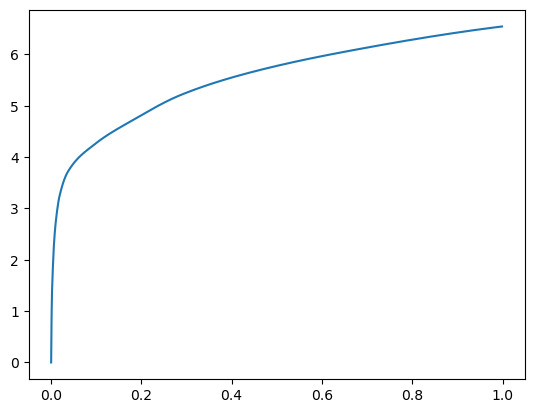

[0.00000000e+00 4.70161438e-04 1.03282928e-03 2.02655792e-03
 3.91483307e-03 6.49166107e-03 1.10731125e-02 1.93929672e-02
 3.87811661e-02 9.01861191e-02 1.71851158e-01 2.69501686e-01
 4.24851418e-01 6.65722847e-01 1.00000000e+00] betas
[0.         0.40993014 0.49699304 0.47896063 0.4622398  0.41303556
 0.54960455 0.43836373 0.41206974 0.40725279 0.45301997 0.48097254
 0.49751286 0.51705138 0.40534191] r
-22480.269231963164 score post


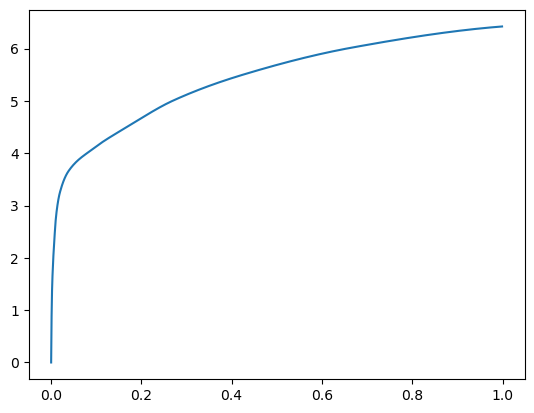

[0.00000000e+00 5.23567200e-04 1.04999542e-03 1.99794769e-03
 3.84807587e-03 6.72435760e-03 1.03921890e-02 1.82924271e-02
 3.94906998e-02 9.95702744e-02 1.84372902e-01 2.80758858e-01
 4.26737785e-01 6.33610725e-01 1.00000000e+00] betas
[0.         0.46668825 0.40683857 0.47556958 0.44552388 0.45570379
 0.42269758 0.45660917 0.42376336 0.51569683 0.50313039 0.37879613
 0.4098822  0.43072191 0.4352011 ] r
-22480.269231963164 score post


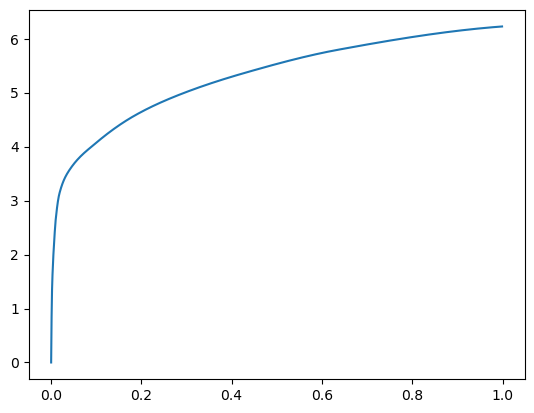

[0.00000000e+00 4.96864319e-04 1.07669830e-03 1.95598602e-03
 3.76796722e-03 6.52790070e-03 1.03387833e-02 1.78136826e-02
 3.98645401e-02 9.00678635e-02 1.59941673e-01 2.63518333e-01
 4.17021751e-01 6.27526283e-01 1.00000000e+00] betas
[0.         0.46093614 0.42974606 0.44920228 0.44817573 0.49501038
 0.50016703 0.49906719 0.52035783 0.47228672 0.42441956 0.46548187
 0.49251531 0.4322667  0.48031538] r
-22480.269231963164 score post


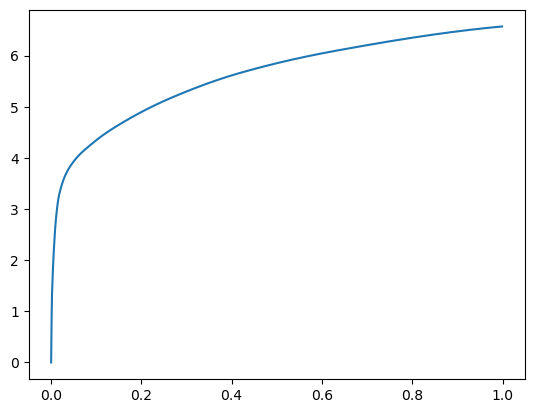

[0.00000000e+00 5.06401062e-04 1.15489960e-03 2.16197968e-03
 4.20284271e-03 6.94370270e-03 1.06973648e-02 1.78842545e-02
 3.66392136e-02 8.31117630e-02 1.58688545e-01 2.62793541e-01
 4.06964302e-01 6.34356499e-01 1.00000000e+00] betas
[0.         0.43354865 0.49721323 0.52065156 0.47697031 0.46649751
 0.40302246 0.44394264 0.45281592 0.41761749 0.42284197 0.45641827
 0.45287299 0.46192433 0.44774857] r
-22480.269231963164 score post


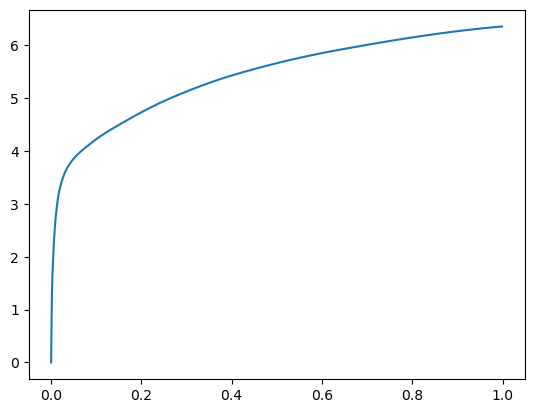

[0.00000000e+00 5.31196594e-04 1.11865997e-03 1.93119049e-03
 3.62300873e-03 6.08730316e-03 9.83715057e-03 1.63850784e-02
 3.25822830e-02 7.91559219e-02 1.59398079e-01 2.63052940e-01
 4.07740593e-01 6.30452156e-01 1.00000000e+00] betas
[0.         0.48105978 0.49727755 0.35874551 0.44943031 0.40407646
 0.48722625 0.45814894 0.47924128 0.52372371 0.49711416 0.46017671
 0.43835886 0.47688128 0.46450024] r
-22481.621781595804 score post


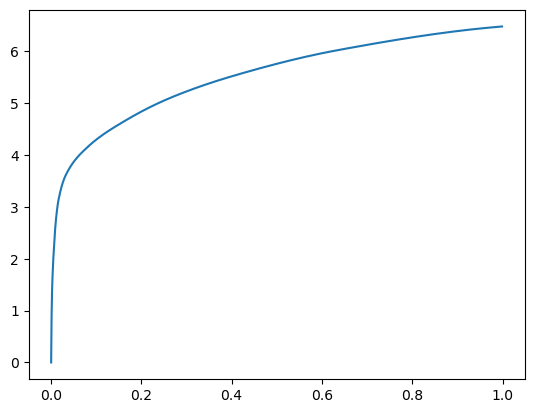

[0.00000000e+00 5.10215759e-04 1.03664398e-03 2.08377838e-03
 3.94535065e-03 6.92462921e-03 1.09224319e-02 1.88379288e-02
 3.77397537e-02 8.21466446e-02 1.57408714e-01 2.60874748e-01
 4.14156914e-01 6.31646156e-01 1.00000000e+00] betas
[0.         0.47575853 0.37356226 0.49205585 0.43458315 0.52153843
 0.41790221 0.4191128  0.38601429 0.39743095 0.41900477 0.48481623
 0.47975576 0.41334483 0.43850174] r
-22481.990460408004 score post


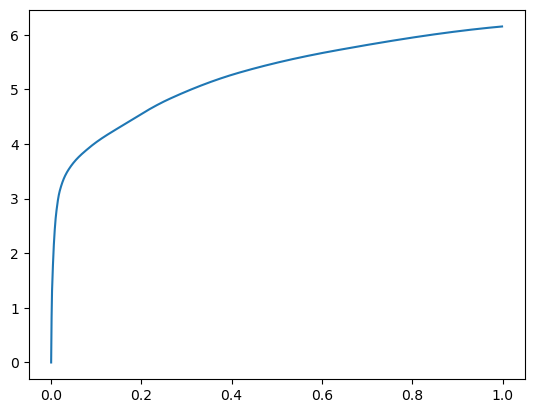

[0.00000000e+00 4.66346741e-04 1.08814240e-03 2.01511383e-03
 3.85570526e-03 6.23607635e-03 9.95922089e-03 1.72319412e-02
 3.74135971e-02 8.76779556e-02 1.68820381e-01 2.64311790e-01
 4.03077126e-01 6.30959511e-01 1.00000000e+00] betas
[0.         0.41938518 0.49631886 0.44017199 0.46070621 0.41209415
 0.44630624 0.44526886 0.44426363 0.41094257 0.45877019 0.43481557
 0.44428332 0.49634942 0.45713537] r
-22481.990460408004 score post


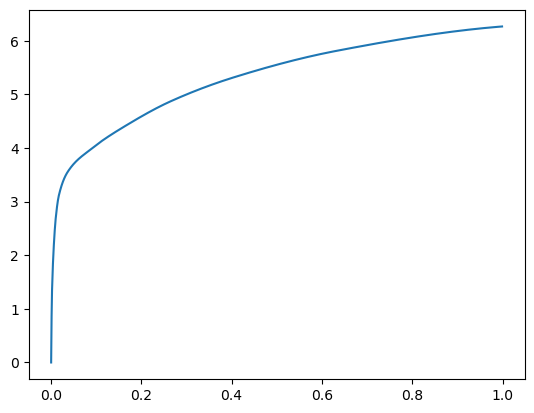

[0.00000000e+00 4.98771667e-04 1.05571747e-03 1.97696686e-03
 3.72982025e-03 6.30283356e-03 1.00889206e-02 1.76115036e-02
 3.87296677e-02 9.57117081e-02 1.77176476e-01 2.79007912e-01
 4.25488472e-01 6.36858940e-01 1.00000000e+00] betas
[0.         0.42970573 0.44556798 0.44730071 0.43801371 0.48856999
 0.44111602 0.48659171 0.50823331 0.47103827 0.44745782 0.444992
 0.48724722 0.3965391  0.41939013] r
-22480.269231963164 score post


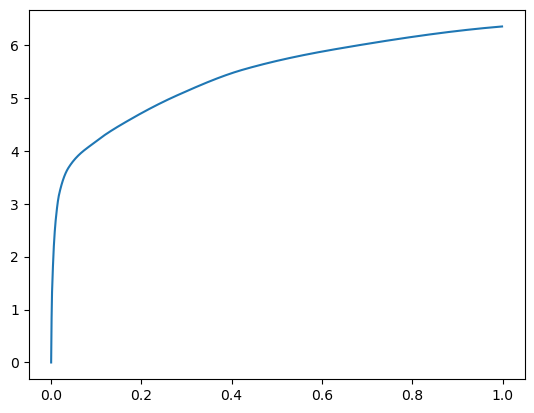

[0.00000000e+00 5.27381897e-04 1.10912323e-03 2.09331512e-03
 3.97968292e-03 6.43634796e-03 1.04646683e-02 1.75848007e-02
 3.49721909e-02 8.44087601e-02 1.63601875e-01 2.64142036e-01
 3.91806602e-01 6.13850594e-01 1.00000000e+00] betas
[0.         0.47676747 0.43187538 0.45322056 0.40648529 0.41076195
 0.47529505 0.4797872  0.44703728 0.47629279 0.45425804 0.40912912
 0.40338771 0.4928387  0.48734246] r
-22485.31087175447 score post


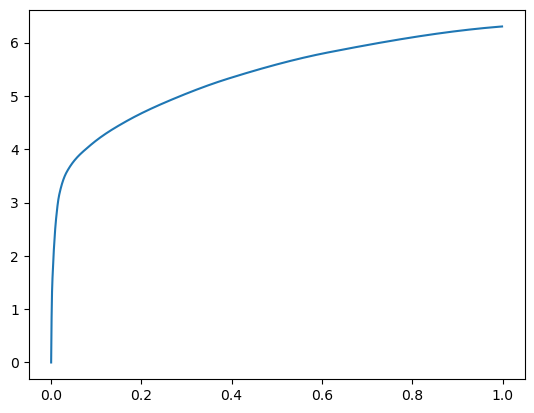

[0.00000000e+00 4.94956970e-04 1.09577179e-03 2.05898285e-03
 4.15515900e-03 6.96086884e-03 1.10120773e-02 1.80444717e-02
 3.64065170e-02 8.37755203e-02 1.61814690e-01 2.73324013e-01
 4.22320366e-01 6.36433601e-01 1.00000000e+00] betas
[0.         0.45437508 0.4517323  0.47562522 0.48033676 0.48594619
 0.46475232 0.4497716  0.39626798 0.45805991 0.47644469 0.48759447
 0.48782092 0.4467217  0.44196462] r
-22480.269231963164 score post


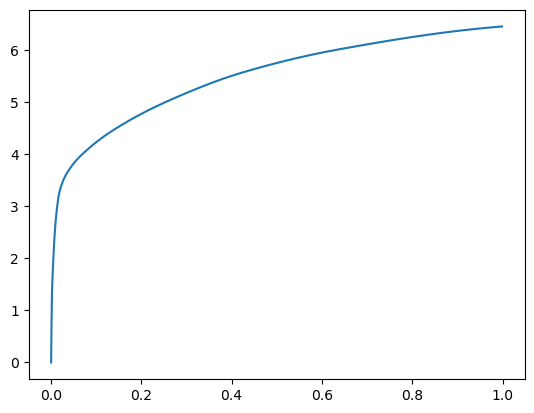

[0.00000000e+00 5.02586365e-04 1.12247467e-03 2.06470490e-03
 4.06932831e-03 6.67095184e-03 1.05009079e-02 1.71842575e-02
 3.86590958e-02 8.83493423e-02 1.65555000e-01 2.71410942e-01
 4.09598351e-01 6.24398232e-01 1.00000000e+00] betas
[0.         0.4303616  0.50820694 0.42804193 0.49175298 0.46788391
 0.44524958 0.41716633 0.49231456 0.38738028 0.39431535 0.47003671
 0.43792883 0.4741333  0.49598498] r
-22480.269231963164 score post


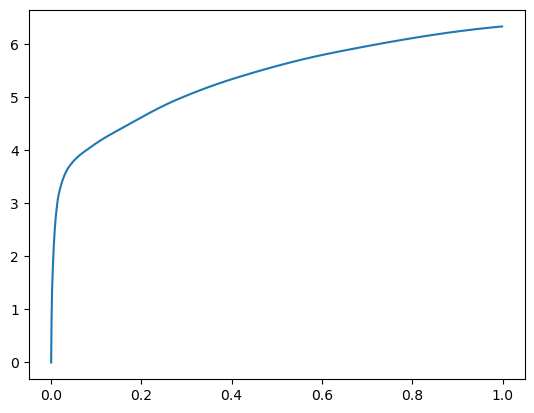

[0.00000000e+00 5.29289246e-04 1.07097626e-03 2.04181671e-03
 3.84426117e-03 6.25896454e-03 9.89627838e-03 1.67112350e-02
 3.45335007e-02 8.96081924e-02 1.79486275e-01 2.84848213e-01
 4.34367180e-01 6.50067329e-01 1.00000000e+00] betas
[0.         0.47048124 0.42278194 0.48209038 0.45723731 0.41821941
 0.44598789 0.46796719 0.49210782 0.4658651  0.51737264 0.4734831
 0.42501697 0.43330596 0.41701795] r
-22481.621781595804 score post


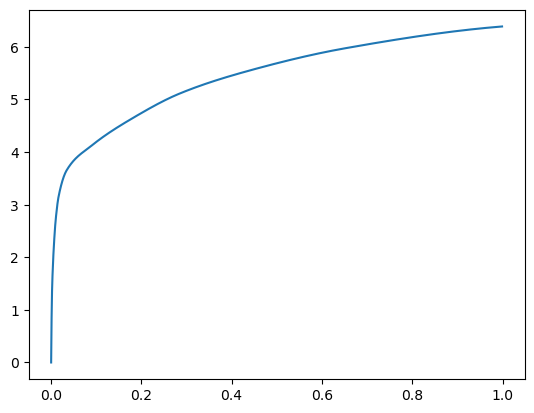

[0.00000000e+00 5.12123108e-04 1.10340118e-03 2.02465057e-03
 3.80992889e-03 6.47258759e-03 1.03578568e-02 1.74283981e-02
 3.41176987e-02 8.73346329e-02 1.64494514e-01 2.60336876e-01
 4.08663750e-01 6.25380516e-01 1.00000000e+00] betas
[0.         0.4834863  0.44853985 0.47049595 0.49365938 0.4556139
 0.47603565 0.43110121 0.41510158 0.49519302 0.48687958 0.40270904
 0.45040502 0.47087337 0.46668871] r
-22484.348661750126 score post


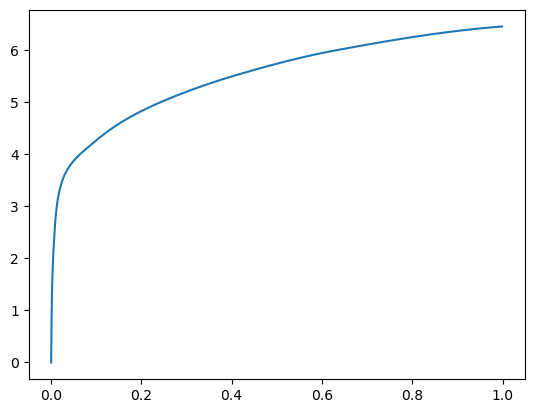

[0.00000000e+00 4.85420227e-04 1.08623505e-03 1.96933746e-03
 3.56197357e-03 6.13307953e-03 9.66358185e-03 1.65491104e-02
 3.47929001e-02 8.40177536e-02 1.54692650e-01 2.62166023e-01
 4.15163994e-01 6.29208565e-01 1.00000000e+00] betas
[0.         0.40926221 0.4715002  0.45012316 0.47919541 0.45056694
 0.44926168 0.47407925 0.41824553 0.39584907 0.39865929 0.46314378
 0.46834694 0.40915982 0.41452263] r
-22485.11013607975 score post


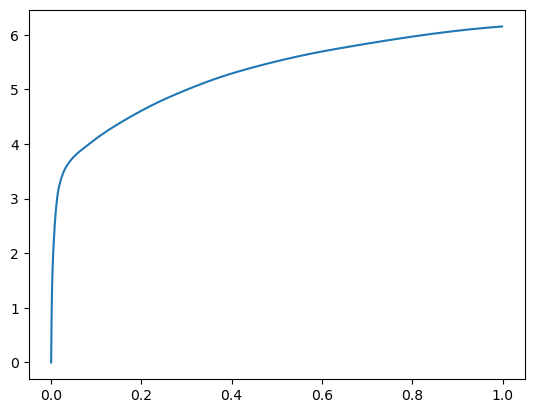

[0.00000000e+00 5.21659851e-04 1.08242035e-03 1.93691254e-03
 3.33881378e-03 5.70774078e-03 8.94260406e-03 1.43480301e-02
 2.90479660e-02 7.73344040e-02 1.54183388e-01 2.55009651e-01
 3.93073082e-01 6.12395287e-01 1.00000000e+00] betas
[0.         0.48567806 0.45764308 0.39354861 0.40716635 0.472474
 0.46543015 0.4207837  0.39668226 0.44679402 0.43025795 0.42418306
 0.43632202 0.42778283 0.5287158 ] r
-22480.269231963164 score post


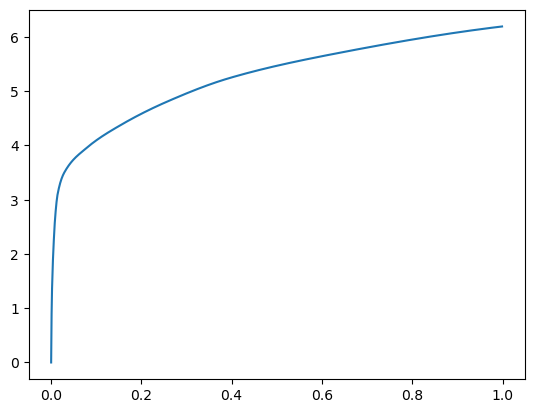

[0.00000000e+00 4.72068787e-04 9.92774963e-04 1.91020966e-03
 3.44562531e-03 5.68103790e-03 8.68701935e-03 1.42126083e-02
 3.17735672e-02 8.24060440e-02 1.64134026e-01 2.73247719e-01
 4.23411369e-01 6.66090965e-01 1.00000000e+00] betas
[0.         0.47505703 0.45407527 0.48360297 0.36931779 0.41295505
 0.40150264 0.47243046 0.50224909 0.51438954 0.43715819 0.48188851
 0.46050469 0.50500475 0.40197235] r
-22480.269231963164 score post


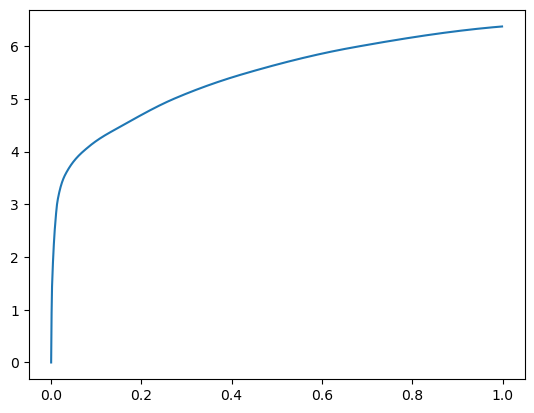

[0.00000000e+00 4.51087952e-04 9.66072083e-04 1.78241730e-03
 3.63063812e-03 6.20937347e-03 9.96875763e-03 1.69153214e-02
 3.63073349e-02 8.39185715e-02 1.70062065e-01 2.73802757e-01
 4.22093391e-01 6.33469582e-01 1.00000000e+00] betas
[0.         0.39401716 0.44398717 0.46554454 0.492645   0.4819797
 0.45095164 0.39289331 0.51234132 0.42767502 0.48785156 0.45126383
 0.45067498 0.43586343 0.46586461] r
-22480.269231963164 score post


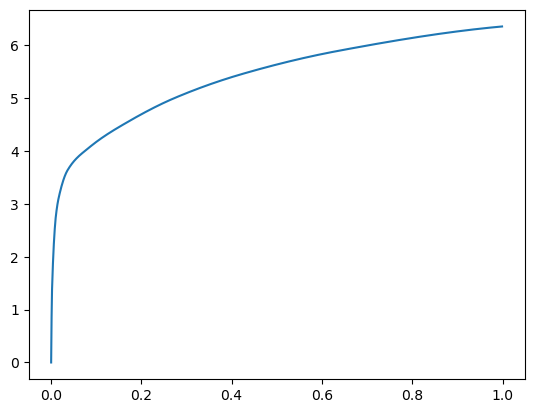

[0.00000000e+00 5.17845154e-04 1.06716156e-03 1.94072723e-03
 3.71646881e-03 6.14833832e-03 9.89246368e-03 1.83820724e-02
 3.60498428e-02 8.71076584e-02 1.67708397e-01 2.71307945e-01
 4.19718742e-01 6.40978813e-01 1.00000000e+00] betas
[0.         0.47727733 0.40217725 0.42006849 0.47771831 0.49983447
 0.48967402 0.45136295 0.37322658 0.46357387 0.45241923 0.48308191
 0.46289912 0.45665468 0.42219073] r
-22480.269231963164 score post


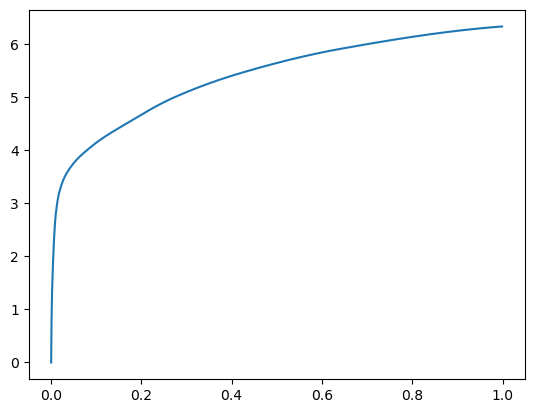

[0.00000000e+00 4.87327576e-04 1.11103058e-03 2.10857391e-03
 3.85379791e-03 6.05297089e-03 9.30690765e-03 1.68867111e-02
 3.80830765e-02 8.93602371e-02 1.70767784e-01 2.67354012e-01
 4.09640312e-01 6.21964455e-01 1.00000000e+00] betas
[0.         0.45368238 0.49560832 0.4486333  0.42281859 0.39524843
 0.40164885 0.4480959  0.46212877 0.4545396  0.44730535 0.38046086
 0.41438888 0.39546141 0.46280385] r
-22484.252724367707 score post


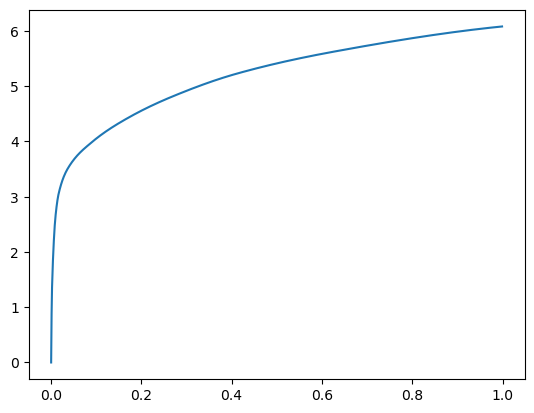

[0.00000000e+00 4.64439392e-04 9.87052917e-04 1.84345245e-03
 3.45516205e-03 5.76686859e-03 9.18292999e-03 1.62210464e-02
 3.44343185e-02 7.89079666e-02 1.52773857e-01 2.58355141e-01
 4.05041695e-01 6.40862465e-01 1.00000000e+00] betas
[0.         0.41955659 0.40482374 0.4715821  0.47647232 0.4257701
 0.44462357 0.44840507 0.50659982 0.4395444  0.4230491  0.46778604
 0.48817007 0.48918121 0.39780667] r
-22481.990460408004 score post


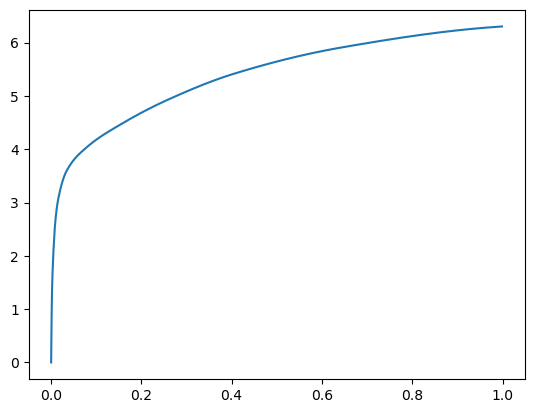

[0.00000000e+00 5.00679016e-04 1.10530853e-03 1.98650360e-03
 3.58104706e-03 6.11209869e-03 9.86194611e-03 1.77354813e-02
 3.46975327e-02 8.09221268e-02 1.61194801e-01 2.64756203e-01
 3.99922371e-01 6.07438087e-01 1.00000000e+00] betas
[0.         0.41443456 0.47213805 0.48073582 0.44942756 0.46800524
 0.46347855 0.4836323  0.38466429 0.43360378 0.48079429 0.46730324
 0.45779734 0.45280922 0.50405688] r
-22480.269231963164 score post


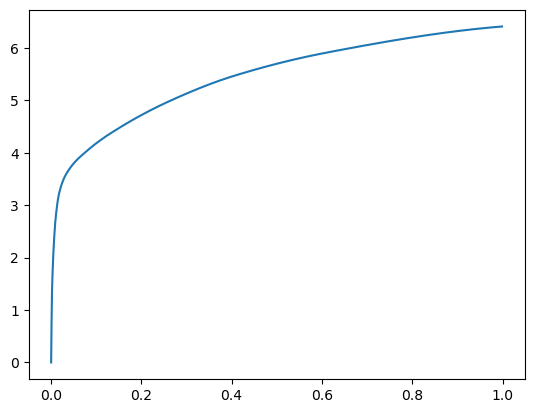

[0.00000000e+00 5.54084778e-04 1.15108490e-03 2.00366974e-03
 3.64971161e-03 6.14833832e-03 9.86385345e-03 1.70583725e-02
 3.82242203e-02 9.09814835e-02 1.70920372e-01 2.75219917e-01
 4.15251732e-01 6.35346413e-01 1.00000000e+00] betas
[0.         0.50403002 0.47221184 0.38592719 0.40413628 0.44561414
 0.45231319 0.49053709 0.49216555 0.50741592 0.43313232 0.44203586
 0.42368036 0.47578523 0.45628937] r
-22483.17300509828 score post


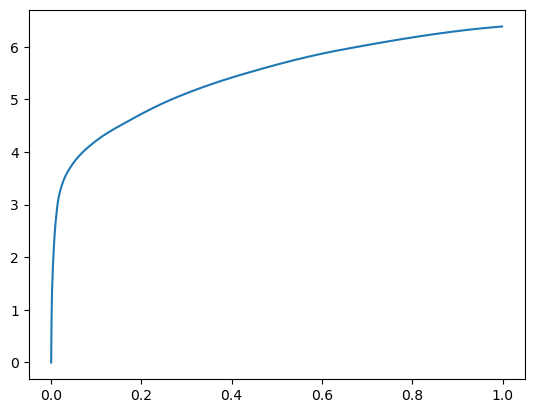

[0.00000000e+00 4.98771667e-04 1.05190277e-03 2.02274323e-03
 3.93199921e-03 6.62326813e-03 1.06821060e-02 1.80883408e-02
 3.83481979e-02 8.40444565e-02 1.65337563e-01 2.71729469e-01
 4.23069954e-01 6.35468483e-01 1.00000000e+00] betas
[0.         0.39027999 0.44763131 0.50718436 0.49830168 0.45898279
 0.44852205 0.47639129 0.45340828 0.41960923 0.4667804  0.452035
 0.4739677  0.42906041 0.42147491] r
-22488.679155155733 score post


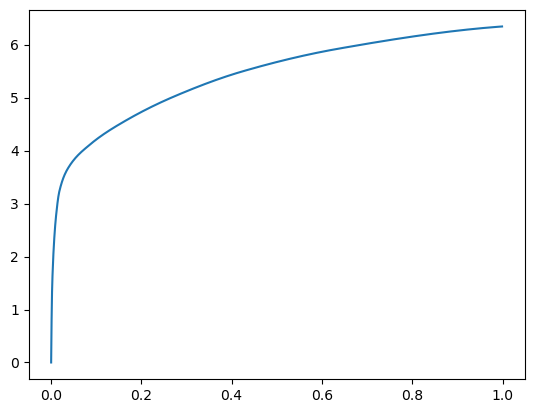

[0.00000000e+00 5.75065613e-04 1.15871429e-03 2.06279755e-03
 3.78513336e-03 6.35814667e-03 1.03082657e-02 1.67760849e-02
 3.45373154e-02 8.09469223e-02 1.58061028e-01 2.62280464e-01
 4.01602745e-01 6.15183830e-01 1.00000000e+00] betas
[0.         0.50680867 0.42992606 0.42382249 0.3966277  0.44051242
 0.47710207 0.45992067 0.49500546 0.45637012 0.48073229 0.46225881
 0.43875153 0.47714544 0.48837699] r
-22480.269231963164 score post


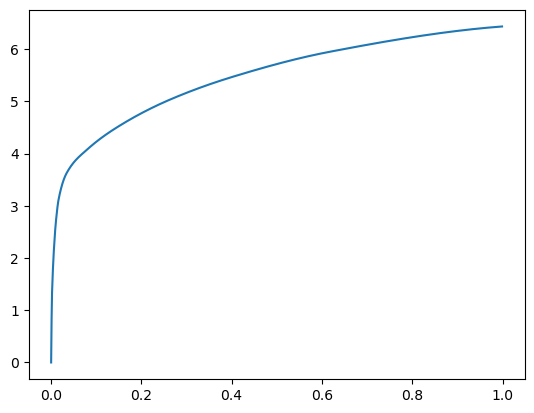

[0.00000000e+00 5.15937805e-04 1.12819672e-03 2.12001801e-03
 4.20284271e-03 7.06958771e-03 1.12276077e-02 1.87768936e-02
 3.76291275e-02 8.74757767e-02 1.63546562e-01 2.69259453e-01
 4.19316292e-01 6.32622719e-01 1.00000000e+00] betas
[0.         0.4941799  0.47448414 0.46242748 0.52753789 0.45643776
 0.43350063 0.43481562 0.37266901 0.45312056 0.46802916 0.50354652
 0.41650806 0.44204684 0.45369773] r
-22480.269231963164 score post


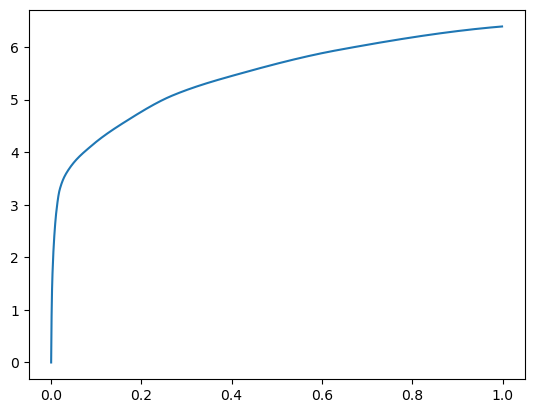

[0.00000000e+00 4.72068787e-04 1.04045868e-03 1.95026398e-03
 3.56769562e-03 6.10446930e-03 9.96112823e-03 1.66311264e-02
 3.74078751e-02 8.75577927e-02 1.61557198e-01 2.54092216e-01
 4.11986351e-01 6.30768776e-01 1.00000000e+00] betas
[0.         0.41282129 0.44094823 0.45525181 0.3946129  0.4353105
 0.47350523 0.51170727 0.46513611 0.43453736 0.40657019 0.37895443
 0.50365979 0.42938147 0.49364034] r
-22480.269231963164 score post


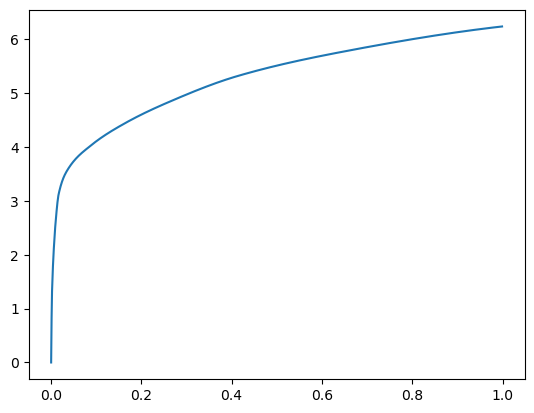

[0.00000000e+00 5.12123108e-04 1.10149384e-03 2.03227997e-03
 3.96060944e-03 6.72626495e-03 1.05867386e-02 1.64766312e-02
 3.55043411e-02 8.53548050e-02 1.66670799e-01 2.79232979e-01
 4.25261497e-01 6.60857201e-01 1.00000000e+00] betas
[0.         0.44423814 0.45169397 0.46312615 0.49921025 0.50589259
 0.41672244 0.36872634 0.42696214 0.48582893 0.44428433 0.47858647
 0.42925405 0.51058673 0.44173395] r
-22480.269231963164 score post


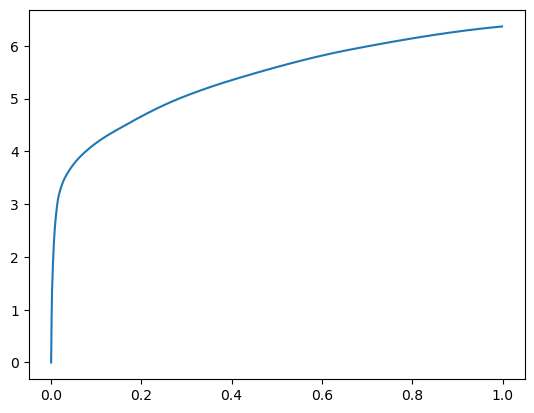

[0.00000000e+00 5.25474548e-04 1.12438202e-03 2.04753876e-03
 3.77941132e-03 6.12163544e-03 9.97066498e-03 1.74417496e-02
 3.99541855e-02 8.97111893e-02 1.75253868e-01 2.84190178e-01
 4.42305565e-01 6.53065681e-01 1.00000000e+00] betas
[0.         0.50310619 0.46836732 0.39988396 0.41993582 0.45867685
 0.46282329 0.43155382 0.46477506 0.49702186 0.46643496 0.44431758
 0.50252584 0.40510097 0.4475312 ] r
-22480.269231963164 score post


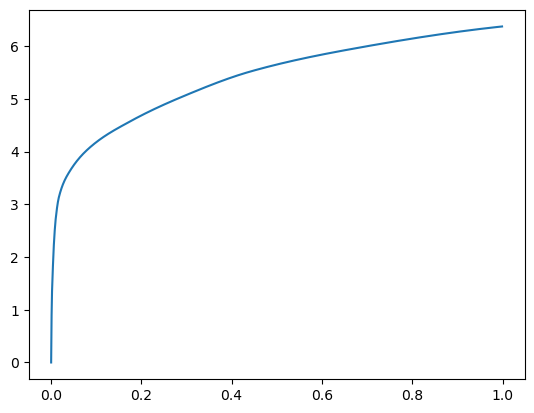

[0.00000000e+00 4.70161438e-04 1.02519989e-03 2.02846527e-03
 3.91483307e-03 6.29329681e-03 1.01957321e-02 1.87444687e-02
 4.22716141e-02 8.83626938e-02 1.70744896e-01 2.81340599e-01
 4.19880867e-01 6.48226738e-01 1.00000000e+00] betas
[0.         0.42382879 0.43838748 0.50181002 0.46762052 0.39002186
 0.46063754 0.45323743 0.45676946 0.38899919 0.45119472 0.46439193
 0.45026029 0.48064296 0.40895928] r
-22480.269231963164 score post


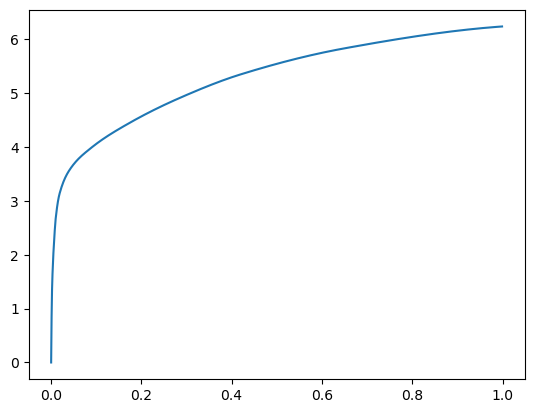

[0.00000000e+00 4.94956970e-04 1.07097626e-03 1.95217133e-03
 3.66687775e-03 6.33525848e-03 1.00755692e-02 1.82065964e-02
 4.00171280e-02 9.25569534e-02 1.75436974e-01 2.82267570e-01
 4.19356346e-01 6.25315666e-01 1.00000000e+00] betas
[0.         0.49752105 0.45409166 0.43381605 0.45927309 0.46266777
 0.46836671 0.45332297 0.381853   0.37817053 0.44579814 0.491338
 0.41899802 0.40945827 0.51463175] r
-22480.269231963164 score post


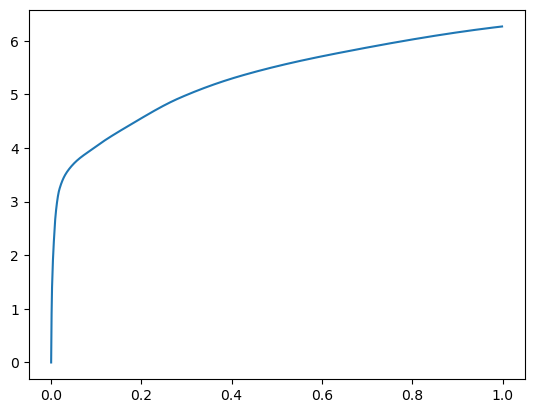

[0.00000000e+00 4.39643860e-04 9.85145569e-04 1.83963776e-03
 3.42082977e-03 5.87749481e-03 9.15050507e-03 1.56927109e-02
 3.74574661e-02 9.92841721e-02 1.84105873e-01 2.82177925e-01
 4.31166649e-01 6.66197777e-01 1.00000000e+00] betas
[0.         0.37184821 0.42368181 0.47163478 0.45007344 0.46047102
 0.40723988 0.55342046 0.49720861 0.50133533 0.52267781 0.39499512
 0.44320688 0.38791777 0.42818802] r
-22480.269231963164 score post


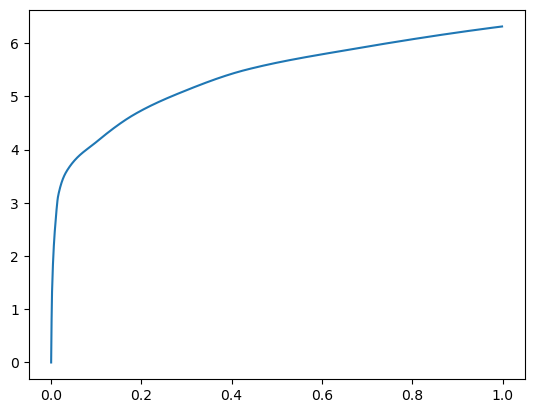

775366 steps_after


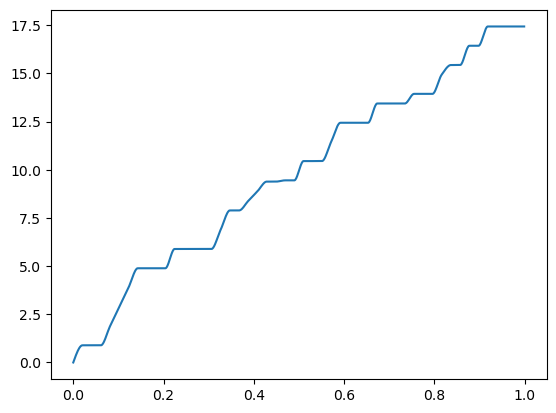

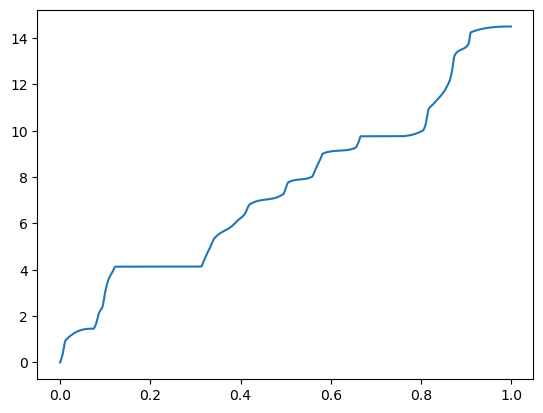

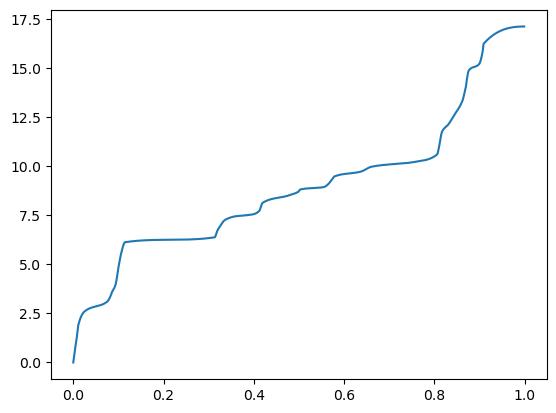

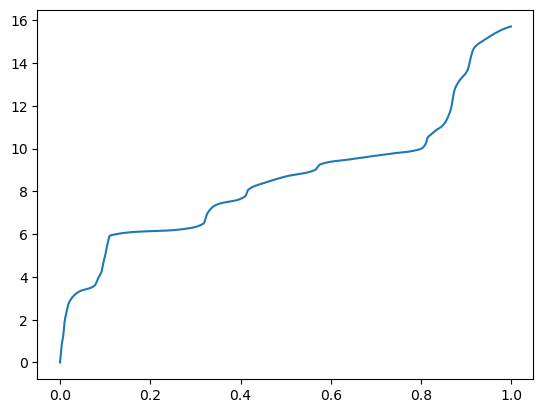

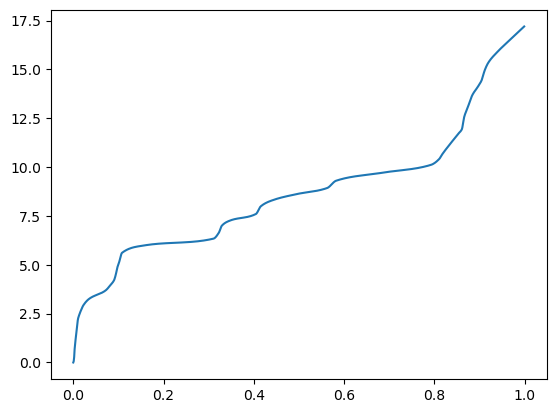

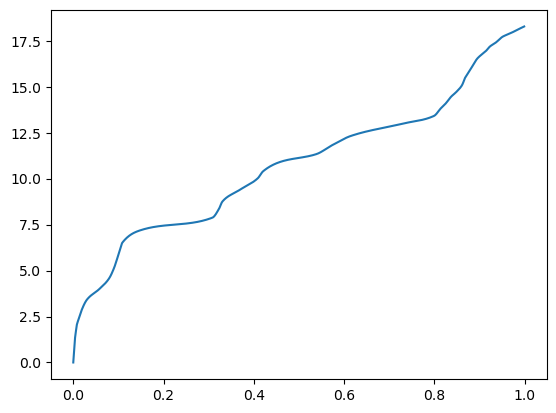

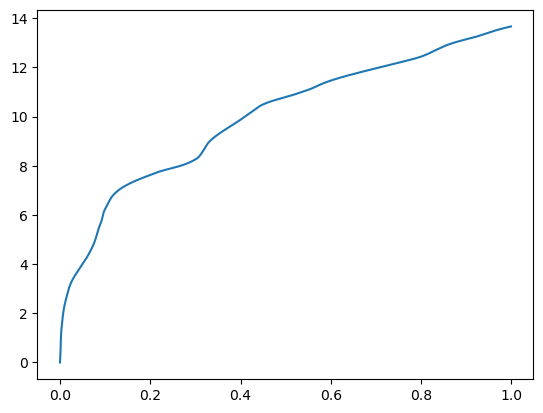

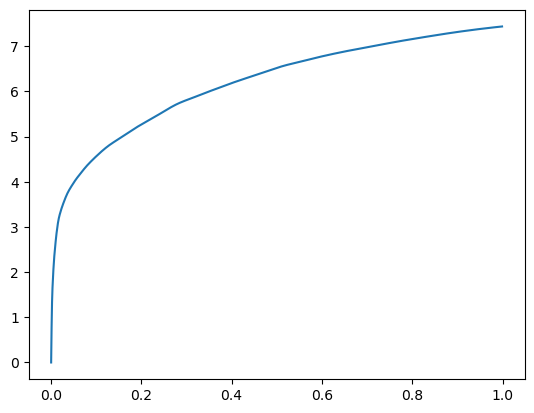

10210 steps
betas [0.00000000e+00 7.48634338e-04 1.58023834e-03 3.27396393e-03
 6.50119781e-03 1.19771957e-02 2.38122940e-02 5.16920090e-02
 1.01424217e-01 1.80291176e-01 2.79313087e-01 4.32318687e-01
 6.41709328e-01 1.00000000e+00]
n_chains 14
[0.00000000e+00 7.48634338e-04 1.58023834e-03 3.27396393e-03
 6.50119781e-03 1.19771957e-02 2.38122940e-02 5.16920090e-02
 1.01424217e-01 1.80291176e-01 2.79313087e-01 4.32318687e-01
 6.41709328e-01 1.00000000e+00] betas
[0.         0.         0.00289517 0.00599968 0.         0.01877374
 0.09692722 0.         0.         0.27775575 0.         0.56444024
 0.         0.        ] r
-22480.269231963164 score post


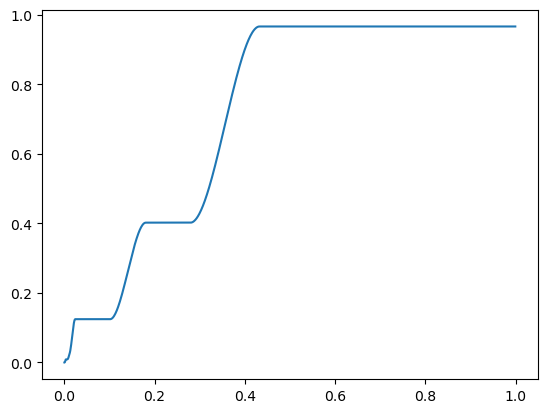

[0.         0.01713085 0.11574268 0.13311672 0.14735317 0.16404247
 0.30547428 0.32441616 0.33936596 0.35305882 0.36657047 0.38082981
 0.39750385 1.        ] betas
[0.         0.99929741 0.80997103 0.11300339 0.08618305 0.09115765
 0.53493363 0.06181797 0.04651326 0.04096806 0.03871039 0.04088287
 0.04495911 0.78004384] r
-22483.215759872455 score post


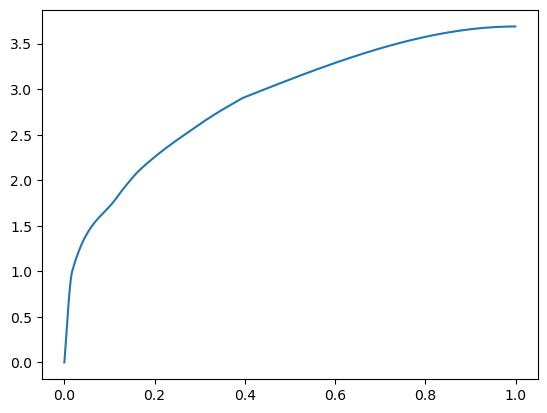

[0.         0.00405216 0.00803852 0.01279354 0.02557468 0.05063915
 0.09816074 0.14352894 0.20338535 0.28176975 0.371665   0.50723171
 0.67074108 1.        ] betas
[0.         0.98913242 0.61468034 0.44706985 0.5126181  0.4037082
 0.38201966 0.28415091 0.30505164 0.31844356 0.30267518 0.3303845
 0.29806416 0.41321279] r
-22480.269231963164 score post


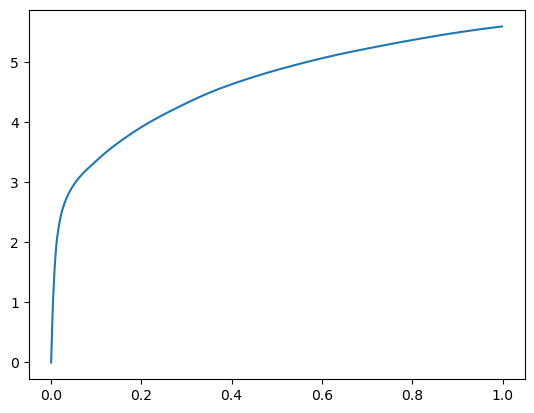

[0.         0.0015707  0.00341129 0.00579357 0.00908566 0.01462078
 0.0264883  0.05523205 0.11262035 0.19037914 0.29589367 0.44019794
 0.65929127 1.        ] betas
[0.         0.92459832 0.51080255 0.45679569 0.41605041 0.41666448
 0.38702624 0.39578903 0.42637247 0.40627494 0.40838901 0.43795801
 0.41720016 0.39036339] r
-22480.269231963164 score post


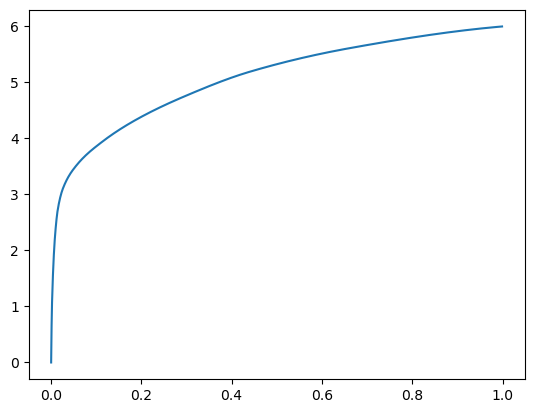

[0.00000000e+00 6.72340393e-04 1.56497955e-03 3.18431854e-03
 5.49221039e-03 9.05704498e-03 1.55191422e-02 3.27291489e-02
 7.59000778e-02 1.50734901e-01 2.57084846e-01 3.96653175e-01
 6.13537788e-01 1.00000000e+00] betas
[0.         0.56652413 0.54560978 0.48575213 0.40827524 0.51431023
 0.48116676 0.45018146 0.44608368 0.44526502 0.47467549 0.48485424
 0.45397537 0.48515404] r
-22480.269231963164 score post


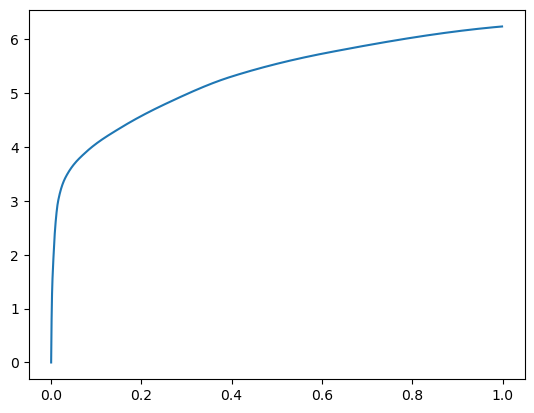

[0.00000000e+00 5.55992126e-04 1.26361847e-03 2.54154205e-03
 4.95052338e-03 8.04996490e-03 1.32951736e-02 2.76212692e-02
 6.85968399e-02 1.46470070e-01 2.52917290e-01 3.88888359e-01
 6.16660118e-01 1.00000000e+00] betas
[0.         0.53231119 0.47559047 0.57893641 0.5195245  0.44392697
 0.4583617  0.38864903 0.4569178  0.45753526 0.47950828 0.42065364
 0.45754899 0.48589442] r
-22480.269231963164 score post


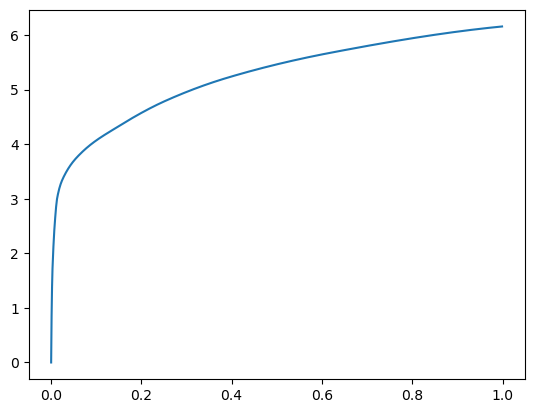

[0.00000000e+00 4.83512878e-04 1.15680695e-03 2.08950043e-03
 3.78704071e-03 6.60419464e-03 1.08747482e-02 2.31332779e-02
 6.04848862e-02 1.36559486e-01 2.38196373e-01 3.87467384e-01
 6.24505043e-01 1.00000000e+00] betas
[0.         0.40021538 0.48457425 0.46579427 0.43212916 0.47100546
 0.482585   0.55325763 0.5065671  0.47391502 0.45155293 0.50766857
 0.49551995 0.5089273 ] r
-22484.59972536877 score post


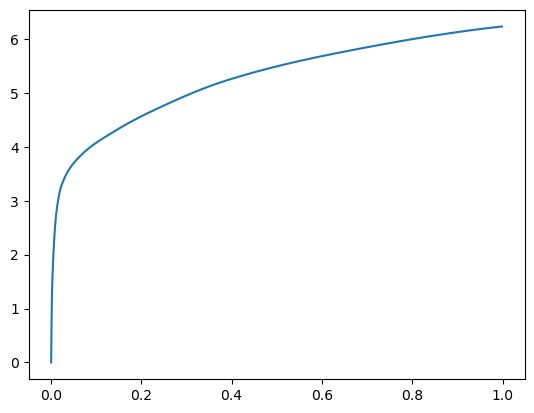

[0.00000000e+00 5.86509705e-04 1.28269196e-03 2.35843658e-03
 4.48322296e-03 7.67421722e-03 1.30510330e-02 2.62079239e-02
 6.51063919e-02 1.45428658e-01 2.57281303e-01 4.05016899e-01
 6.42195702e-01 1.00000000e+00] betas
[0.         0.4999545  0.51196678 0.45220784 0.49335992 0.48872086
 0.49514382 0.49381023 0.47203407 0.47489404 0.46807228 0.50738258
 0.48381047 0.44828366] r
-22482.458794922564 score post


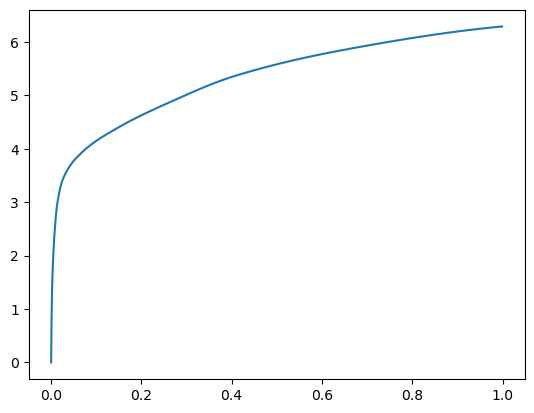

[0.00000000e+00 5.65528870e-04 1.20639801e-03 2.31838226e-03
 4.36496735e-03 7.44915009e-03 1.24292374e-02 2.40697861e-02
 6.06966019e-02 1.39796257e-01 2.54120827e-01 3.91957283e-01
 6.20144844e-01 1.00000000e+00] betas
[0.         0.47991944 0.4936335  0.48588443 0.46360542 0.5184404
 0.47598932 0.5081853  0.43315372 0.4795966  0.54299549 0.46904064
 0.49981998 0.48314482] r
-22484.89423354312 score post


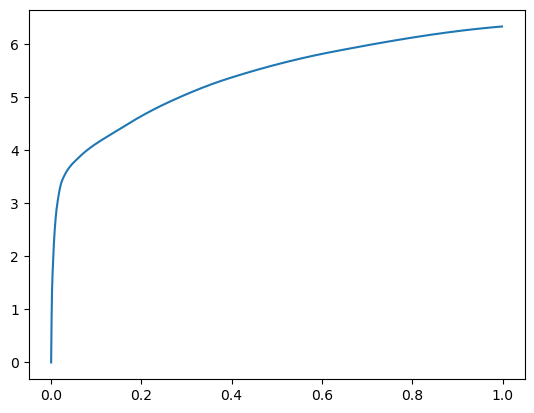

[0.00000000e+00 5.75065613e-04 1.20830536e-03 2.32601166e-03
 4.49657440e-03 7.40528107e-03 1.25188828e-02 2.33793259e-02
 6.54592514e-02 1.48476601e-01 2.51736641e-01 3.95133018e-01
 6.17697716e-01 1.00000000e+00] betas
[0.         0.48144728 0.45644353 0.53208523 0.45427482 0.43090422
 0.55223695 0.40243841 0.47486015 0.47389068 0.4728552  0.47954891
 0.43730086 0.45564461] r
-22480.269231963164 score post


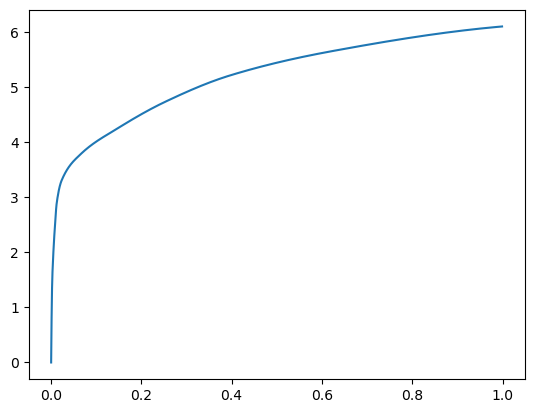

[0.00000000e+00 5.59806824e-04 1.21021271e-03 2.14481354e-03
 4.22954559e-03 7.34615326e-03 1.13267899e-02 2.22673416e-02
 6.18124008e-02 1.41968727e-01 2.42644310e-01 3.77734184e-01
 6.08622551e-01 1.00000000e+00] betas
[0.         0.4543929  0.50789819 0.44336277 0.48763304 0.50955389
 0.42446096 0.52960723 0.50491575 0.49876168 0.46741788 0.45069082
 0.48885999 0.51898288] r
-22485.907070885154 score post


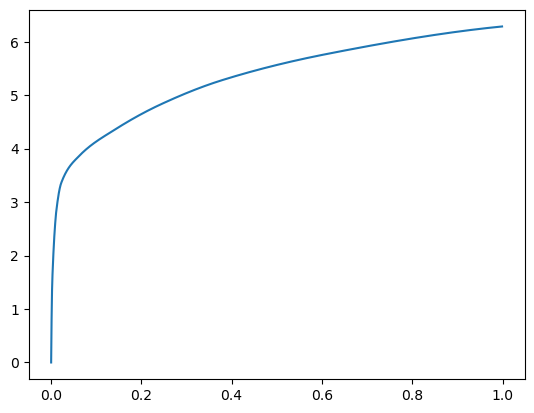

[0.00000000e+00 5.96046448e-04 1.21784210e-03 2.28595734e-03
 4.44316864e-03 7.46250153e-03 1.24044418e-02 2.35357285e-02
 6.25982285e-02 1.40398979e-01 2.44639397e-01 3.93368721e-01
 6.30034447e-01 1.00000000e+00] betas
[0.         0.50555984 0.4902802  0.44331603 0.48392693 0.4504716
 0.4788     0.43892629 0.50211079 0.43875851 0.53631486 0.44128576
 0.4848575  0.45259411] r
-22480.269231963164 score post


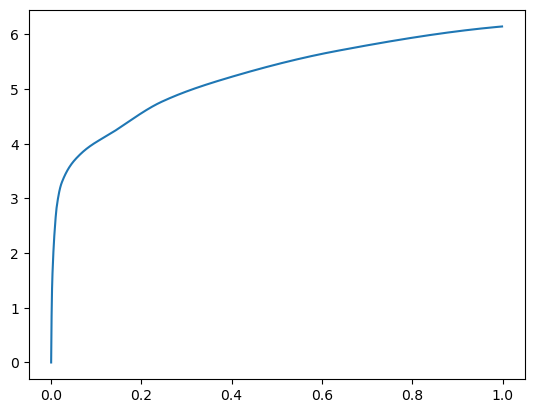

[0.00000000e+00 5.55992126e-04 1.13582611e-03 2.21920013e-03
 4.26959991e-03 7.38620758e-03 1.21583939e-02 2.44226456e-02
 6.13222122e-02 1.44749641e-01 2.34778404e-01 3.90007973e-01
 6.17295265e-01 1.00000000e+00] betas
[0.         0.50497553 0.42017872 0.44754181 0.45544827 0.47700293
 0.48995372 0.42253387 0.44120869 0.45736253 0.41513849 0.48333547
 0.49278537 0.48912483] r
-22482.458794922564 score post


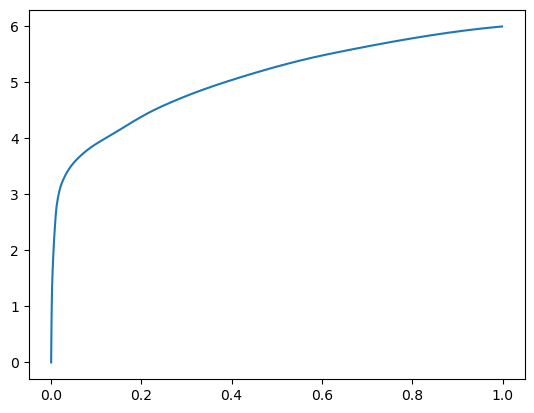

[0.00000000e+00 5.02586365e-04 1.13010406e-03 2.25734711e-03
 4.36306000e-03 7.39574432e-03 1.17158890e-02 2.50120163e-02
 6.54020309e-02 1.51785851e-01 2.56966591e-01 4.13264275e-01
 6.34316444e-01 1.00000000e+00] betas
[0.         0.41588284 0.48668994 0.52544124 0.43929505 0.48994539
 0.43213155 0.55991141 0.50153436 0.51260753 0.42625459 0.54425384
 0.5059378  0.4652709 ] r
-22480.269231963164 score post


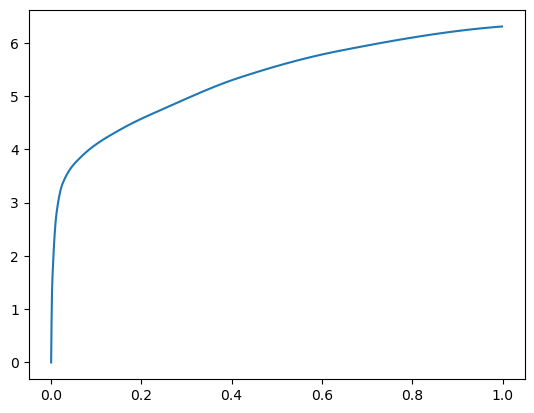

[0.00000000e+00 5.86509705e-04 1.24454498e-03 2.34889984e-03
 4.76169586e-03 7.94506073e-03 1.37147903e-02 2.72588730e-02
 6.89554214e-02 1.52131081e-01 2.72982597e-01 4.13687706e-01
 6.22786522e-01 1.00000000e+00] betas
[0.         0.48929681 0.47960283 0.4694646  0.51872956 0.4949265
 0.57355412 0.50423477 0.52983377 0.51985306 0.55340003 0.45638645
 0.4128282  0.48469725] r
-22480.269231963164 score post


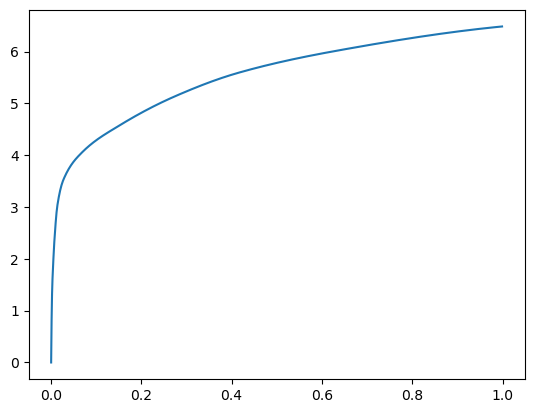

[0.00000000e+00 5.99861145e-04 1.29795074e-03 2.55298615e-03
 4.97722626e-03 8.29219818e-03 1.32093430e-02 2.56013870e-02
 6.12974167e-02 1.35319710e-01 2.37572670e-01 3.76828194e-01
 6.13856316e-01 1.00000000e+00] betas
[0.         0.51374596 0.5145009  0.53122314 0.48226729 0.46034
 0.43789394 0.51694521 0.49162103 0.51653817 0.47335664 0.49693034
 0.47306343 0.48261962] r
-22480.269231963164 score post


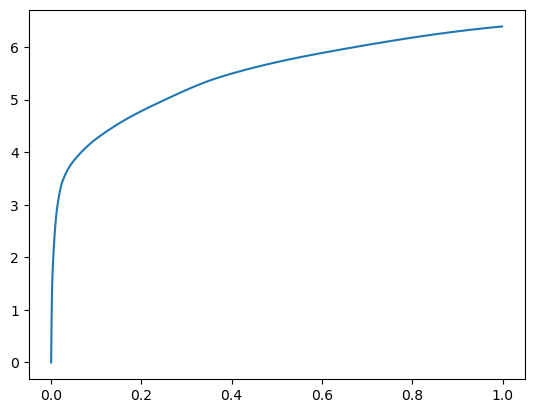

[0.00000000e+00 5.71250916e-04 1.22165680e-03 2.28404999e-03
 4.51755524e-03 7.90500641e-03 1.33733749e-02 2.49414444e-02
 5.96761703e-02 1.28142357e-01 2.32102394e-01 3.66709709e-01
 6.08130455e-01 1.00000000e+00] betas
[0.         0.48033185 0.46202244 0.51005311 0.50426105 0.53742625
 0.46353307 0.40990205 0.48981391 0.44168903 0.50338536 0.46950152
 0.55787827 0.54623284] r
-22484.52742382129 score post


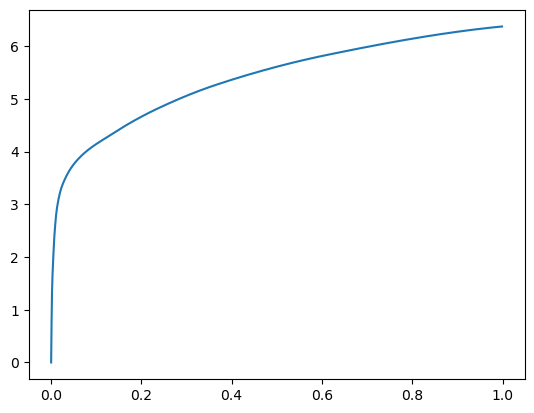

[0.00000000e+00 5.84602356e-04 1.28841400e-03 2.34317780e-03
 4.54425812e-03 7.55405426e-03 1.31006241e-02 2.80981064e-02
 6.72788620e-02 1.49319649e-01 2.57794380e-01 4.11684990e-01
 6.39874458e-01 1.00000000e+00] betas
[0.         0.48728096 0.48164121 0.45313471 0.52030303 0.47056817
 0.47079915 0.49153549 0.45193526 0.47724944 0.47597772 0.49980472
 0.47419703 0.45198652] r
-22480.269231963164 score post


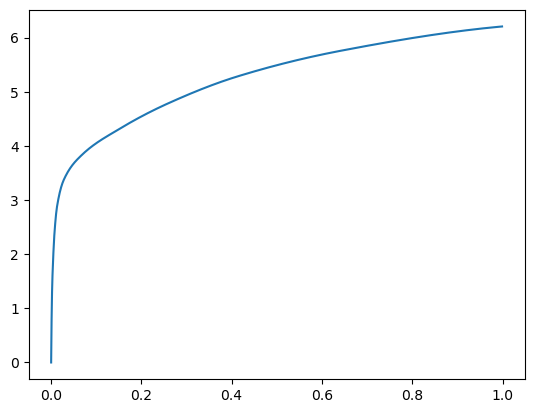

[0.00000000e+00 5.71250916e-04 1.26171112e-03 2.37560272e-03
 4.37259674e-03 7.33280182e-03 1.27401352e-02 2.64005661e-02
 6.63022995e-02 1.47786140e-01 2.56134987e-01 4.00790215e-01
 6.24243736e-01 1.00000000e+00] betas
[0.         0.51904583 0.47203589 0.48531676 0.44441166 0.44332515
 0.54060953 0.45560227 0.49997119 0.48968051 0.47442028 0.48583809
 0.47984344 0.52673733] r
-22481.990460408004 score post


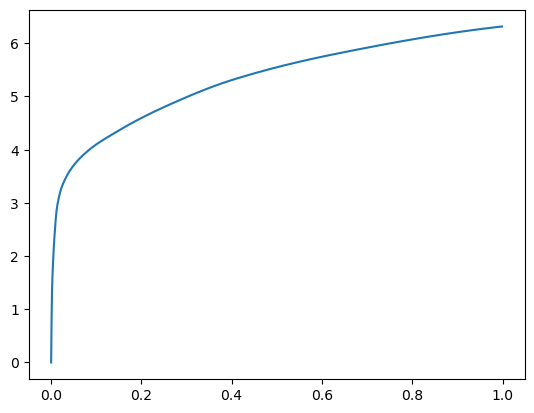

[0.00000000e+00 5.29289246e-04 1.22737885e-03 2.31647491e-03
 4.50038910e-03 7.86876678e-03 1.29404068e-02 2.85444260e-02
 6.95486069e-02 1.52365685e-01 2.65240669e-01 4.14027214e-01
 6.48051262e-01 1.00000000e+00] betas
[0.         0.48947785 0.51585124 0.48679662 0.47025115 0.53239236
 0.51854762 0.5336941  0.46960405 0.52792231 0.46851755 0.43026735
 0.46537358 0.46955036] r
-22484.25291812412 score post


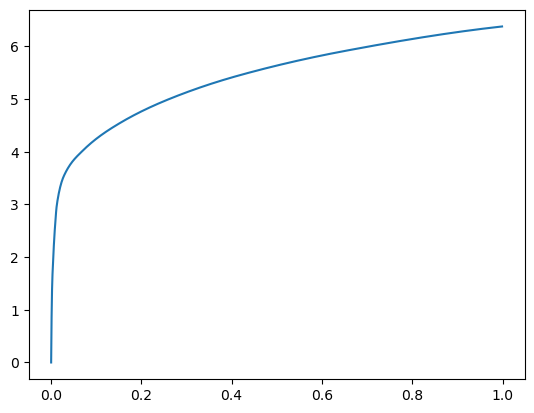

[0.00000000e+00 5.31196594e-04 1.18541718e-03 2.25162506e-03
 4.50038910e-03 7.54833221e-03 1.19295120e-02 2.34899521e-02
 5.87224960e-02 1.28045082e-01 2.35457420e-01 3.95100594e-01
 6.35172844e-01 1.00000000e+00] betas
[0.         0.49409617 0.46482884 0.47735741 0.50873282 0.49433956
 0.43948655 0.45916434 0.46644764 0.48432768 0.54348884 0.50415837
 0.49016484 0.51957708] r
-22484.52742382129 score post


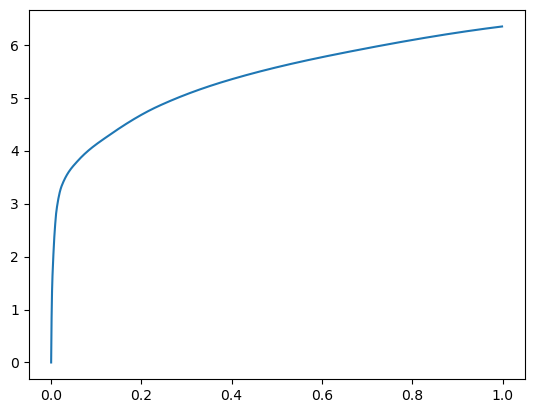

[0.00000000e+00 5.23567200e-04 1.21593475e-03 2.34317780e-03
 4.54044342e-03 7.55977631e-03 1.27782822e-02 2.73904800e-02
 7.01074600e-02 1.46029472e-01 2.48208046e-01 4.08556938e-01
 6.53763771e-01 1.00000000e+00] betas
[0.         0.47036731 0.48350912 0.45085968 0.56999125 0.44611087
 0.46539072 0.56121474 0.52535353 0.43442324 0.43305584 0.55144452
 0.52853973 0.46005482] r
-22483.17300509828 score post


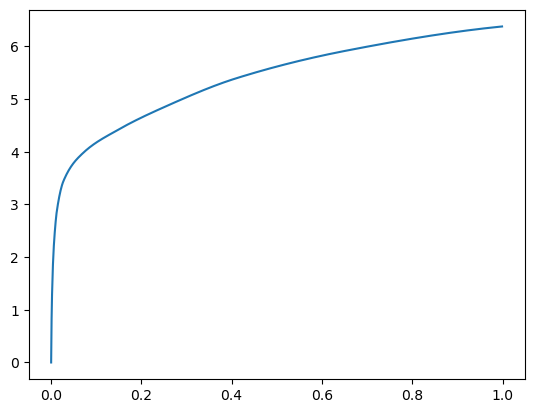

[0.00000000e+00 5.50270081e-04 1.26934052e-03 2.55680084e-03
 4.48131561e-03 7.85350800e-03 1.38254166e-02 2.68239975e-02
 6.44445419e-02 1.48058891e-01 2.65925407e-01 4.11164284e-01
 6.35674477e-01 1.00000000e+00] betas
[0.         0.56368298 0.54042984 0.45173706 0.4322786  0.5098958
 0.50149429 0.44795733 0.44187755 0.54639612 0.532828   0.46027436
 0.47216403 0.46628503] r
-22480.269231963164 score post


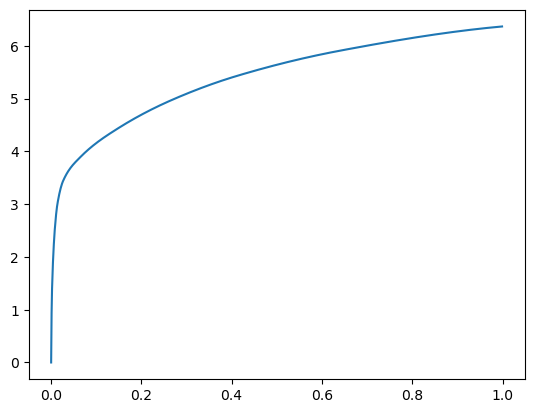

[0.00000000e+00 4.68254089e-04 1.06143951e-03 2.24971771e-03
 4.32682037e-03 7.43389130e-03 1.27782822e-02 2.58798599e-02
 6.78224564e-02 1.42952919e-01 2.47595787e-01 3.95539284e-01
 6.21462822e-01 1.00000000e+00] betas
[0.         0.40942437 0.48117964 0.54364365 0.47786954 0.50178857
 0.52851316 0.44741622 0.48250879 0.42668626 0.4611236  0.47140574
 0.52474242 0.49988351] r
-22480.269231963164 score post


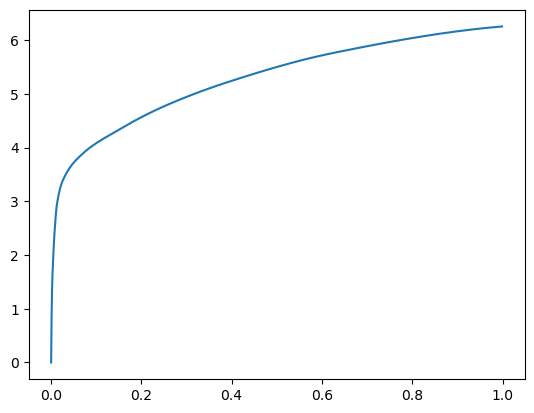

[0.00000000e+00 5.52177429e-04 1.18350983e-03 2.28023529e-03
 4.39357758e-03 7.37285614e-03 1.19199753e-02 2.48079300e-02
 6.49785995e-02 1.49432182e-01 2.61832237e-01 4.18595314e-01
 6.32309914e-01 1.00000000e+00] betas
[0.         0.45762856 0.48075942 0.40664951 0.45651971 0.46688012
 0.47256901 0.51518845 0.49099925 0.5086501  0.60102421 0.45426947
 0.44171523 0.43439379] r
-22480.269231963164 score post


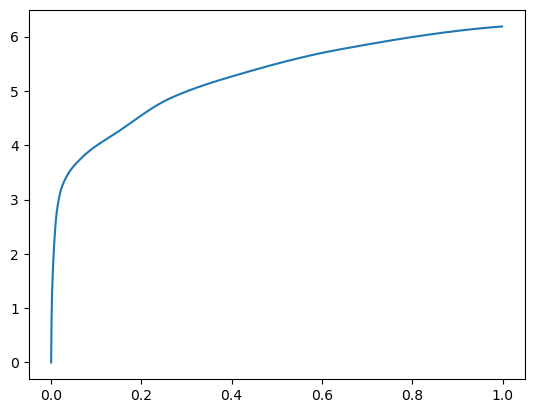

[0.00000000e+00 5.75065613e-04 1.21021271e-03 2.58922577e-03
 4.96578217e-03 8.26168060e-03 1.38826370e-02 2.86970139e-02
 7.24935532e-02 1.54267311e-01 2.39268303e-01 3.87698174e-01
 6.06671333e-01 1.00000000e+00] betas
[0.         0.49491949 0.46359889 0.55331136 0.50984431 0.46000193
 0.49061315 0.50616205 0.4455587  0.49747754 0.42044797 0.4948497
 0.48125659 0.45465915] r
-22480.269231963164 score post


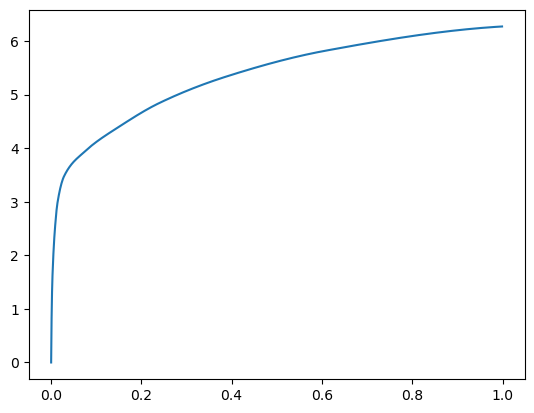

[0.00000000e+00 5.59806824e-04 1.22165680e-03 2.37560272e-03
 4.44316864e-03 7.66086578e-03 1.26447678e-02 2.41384506e-02
 6.40192032e-02 1.39691353e-01 2.35190392e-01 3.77018929e-01
 5.89495659e-01 1.00000000e+00] betas
[0.         0.48662062 0.5326125  0.5076552  0.4535302  0.47175105
 0.49964657 0.40462836 0.49659448 0.52485565 0.43164996 0.43631529
 0.47814245 0.55367008] r
-22480.269231963164 score post


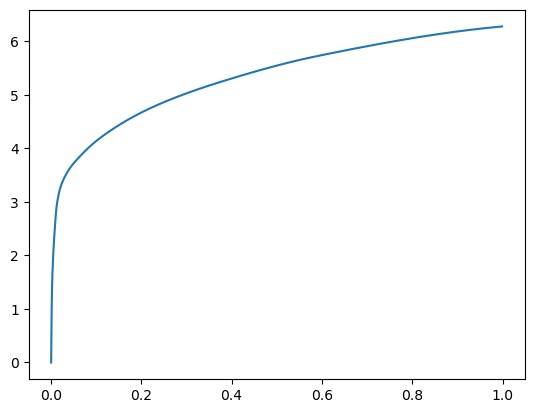

[0.00000000e+00 5.55992126e-04 1.13773346e-03 2.13909149e-03
 4.17041779e-03 7.35378265e-03 1.18246078e-02 2.53419876e-02
 6.51292801e-02 1.33976936e-01 2.40475655e-01 4.02445793e-01
 6.30810738e-01 1.00000000e+00] betas
[0.         0.5202266  0.43755821 0.43695871 0.49634844 0.54778103
 0.44886073 0.50820211 0.45675917 0.39770827 0.49951167 0.53432256
 0.49736994 0.46073037] r
-22480.269231963164 score post


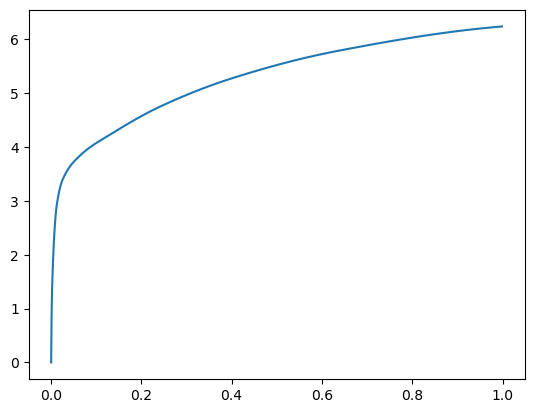

[0.00000000e+00 5.08308411e-04 1.14154816e-03 2.28404999e-03
 4.31537628e-03 7.06958771e-03 1.17139816e-02 2.37016678e-02
 6.37044907e-02 1.47736549e-01 2.53880501e-01 4.01595116e-01
 6.19050026e-01 1.00000000e+00] betas
[0.         0.4672397  0.49579356 0.49947271 0.48965621 0.44360913
 0.47980385 0.54108086 0.48467609 0.46987537 0.44668104 0.46698748
 0.5228991  0.46957524] r
-22484.556296744664 score post


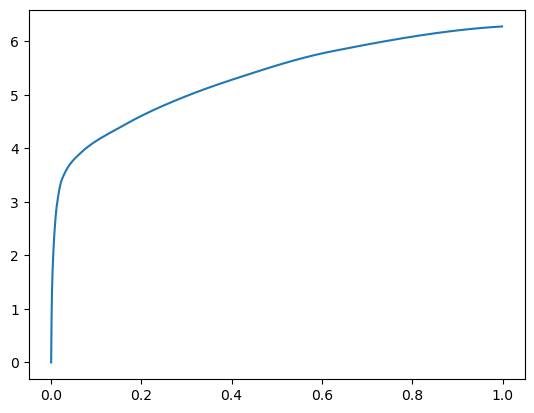

[0.00000000e+00 5.27381897e-04 1.14536285e-03 2.24018097e-03
 4.21047211e-03 7.21454620e-03 1.20420456e-02 2.22120285e-02
 5.88865280e-02 1.42432213e-01 2.56869316e-01 4.11293983e-01
 6.11308098e-01 1.00000000e+00] betas
[0.         0.48228643 0.48487188 0.4777536  0.44908034 0.46769488
 0.45121578 0.4417885  0.55343222 0.60951587 0.49595616 0.45947522
 0.44839474 0.46745562] r
-22484.55452125251 score post


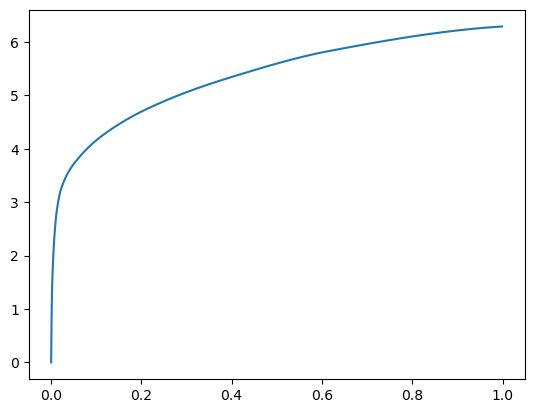

[0.00000000e+00 5.29289246e-04 1.14536285e-03 2.26116180e-03
 4.43172455e-03 7.70282745e-03 1.35545731e-02 2.80675888e-02
 6.50873184e-02 1.31064415e-01 2.36010551e-01 3.91448021e-01
 6.01494789e-01 1.00000000e+00] betas
[0.         0.47004947 0.48049005 0.49689678 0.52117402 0.51532617
 0.51270541 0.50332336 0.4389984  0.4033591  0.4359586  0.52303893
 0.4715717  0.58039213] r
-22481.990460408004 score post


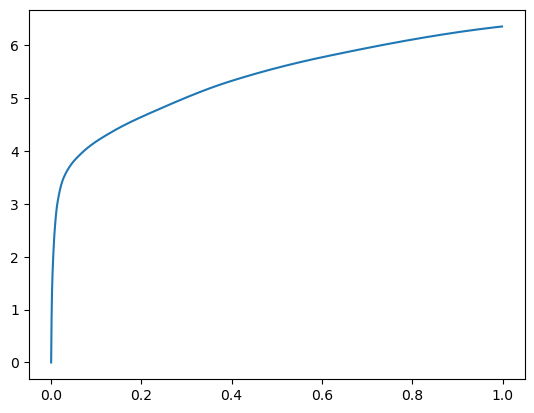

[0.00000000e+00 5.52177429e-04 1.19113922e-03 2.32028961e-03
 4.36115265e-03 7.36713409e-03 1.24864578e-02 2.45351791e-02
 6.15797043e-02 1.42560005e-01 2.65330315e-01 4.19548988e-01
 6.53000832e-01 1.00000000e+00] betas
[0.         0.47865854 0.46081147 0.53464923 0.46034738 0.45705416
 0.4699065  0.53143518 0.47687261 0.51400804 0.50116944 0.48613297
 0.52198243 0.44757105] r
-22480.269231963164 score post


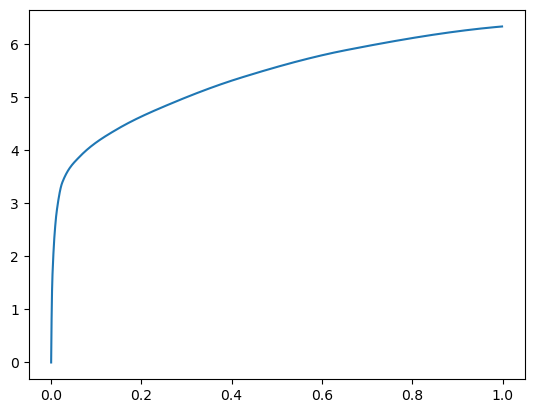

[0.00000000e+00 5.63621521e-04 1.25408173e-03 2.28595734e-03
 4.45079803e-03 7.77721405e-03 1.35488510e-02 2.55212784e-02
 6.52742386e-02 1.43733025e-01 2.63224602e-01 4.17317390e-01
 6.29862785e-01 1.00000000e+00] betas
[0.         0.52200186 0.48545898 0.45444438 0.47673344 0.50159354
 0.51868039 0.42458584 0.49214202 0.46552811 0.48651091 0.49872301
 0.43173816 0.47572798] r
-22481.621781595804 score post


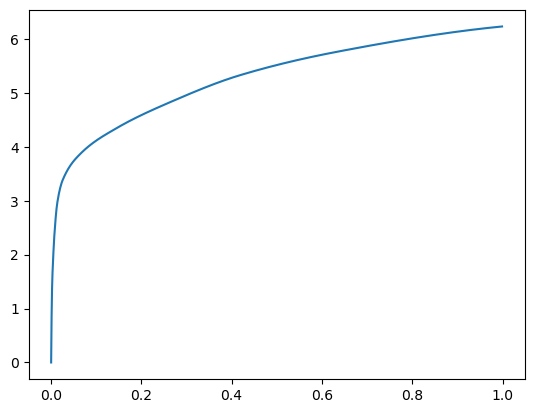

[0.00000000e+00 5.12123108e-04 1.17015839e-03 2.21157074e-03
 4.33826447e-03 7.42053986e-03 1.22632980e-02 2.42719650e-02
 6.06031418e-02 1.38522148e-01 2.54303932e-01 3.97862434e-01
 6.27503395e-01 1.00000000e+00] betas
[0.         0.43542014 0.50032613 0.46794111 0.51612093 0.4930901
 0.46450447 0.56186167 0.41120088 0.47842346 0.49100011 0.42767867
 0.48189281 0.43224011] r
-22480.269231963164 score post


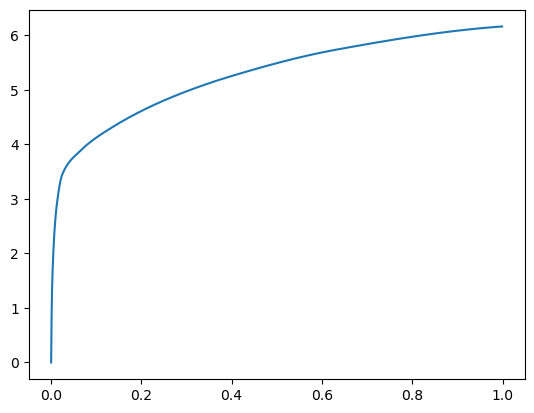

[0.00000000e+00 5.59806824e-04 1.19113922e-03 2.26879120e-03
 4.21619415e-03 7.08103180e-03 1.17807388e-02 2.03084946e-02
 5.31988144e-02 1.26162529e-01 2.32295036e-01 3.84524345e-01
 6.01590157e-01 1.00000000e+00] betas
[0.         0.45053942 0.52778723 0.48712505 0.43390422 0.50535259
 0.48007039 0.40103589 0.53749759 0.52089733 0.50834004 0.49646003
 0.44052908 0.46034274] r
-22483.17300509828 score post


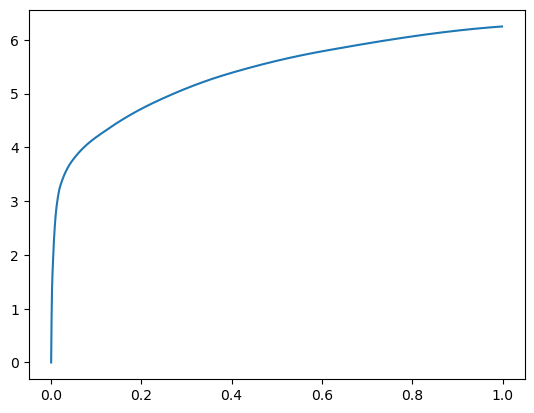

[0.00000000e+00 5.96046448e-04 1.16443634e-03 2.19631195e-03
 4.33635712e-03 7.07340240e-03 1.17769241e-02 2.34365463e-02
 5.54094315e-02 1.23158455e-01 2.21064568e-01 3.61664772e-01
 5.88377953e-01 1.00000000e+00] betas
[0.         0.47990498 0.45984571 0.43509715 0.49534159 0.46315342
 0.46638722 0.58789953 0.51051935 0.52200053 0.47598446 0.42811827
 0.46797888 0.57284639] r
-22485.310960374136 score post


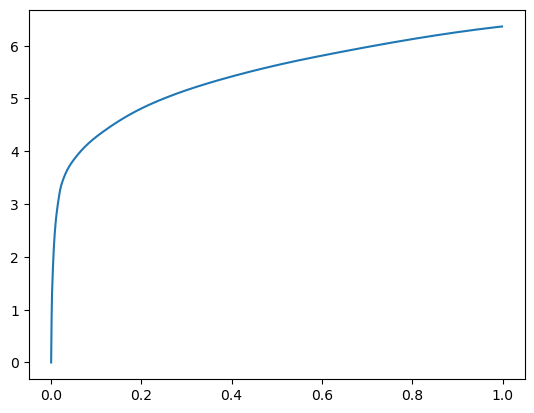

[0.00000000e+00 6.07490540e-04 1.23500824e-03 2.51865387e-03
 4.79221344e-03 8.01181793e-03 1.38292313e-02 2.49872208e-02
 5.71641922e-02 1.20919228e-01 2.21085548e-01 3.86868477e-01
 6.38163567e-01 1.00000000e+00] betas
[0.         0.55047407 0.47570783 0.44791222 0.45203184 0.49067032
 0.57820502 0.45991081 0.45869586 0.43773365 0.49217233 0.61421468
 0.49577412 0.44575226] r
-22480.269231963164 score post


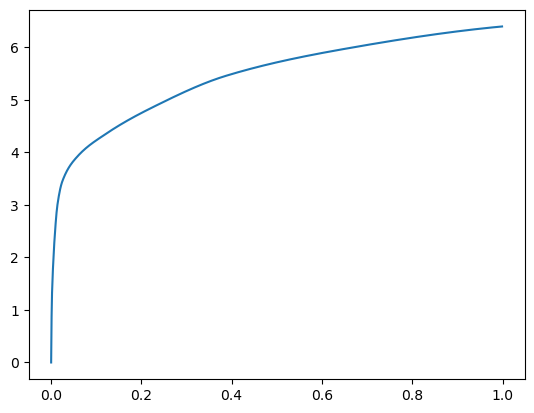

[0.00000000e+00 5.36918640e-04 1.15871429e-03 2.52819061e-03
 5.04016876e-03 8.37612152e-03 1.32055283e-02 2.45981216e-02
 5.97429276e-02 1.34896278e-01 2.39624977e-01 3.71371269e-01
 6.08477592e-01 1.00000000e+00] betas
[0.         0.47970877 0.50763218 0.55954624 0.5133443  0.52012523
 0.45252983 0.44122671 0.44168133 0.46413526 0.49467889 0.48647011
 0.47214343 0.49641239] r
-22482.458794922564 score post


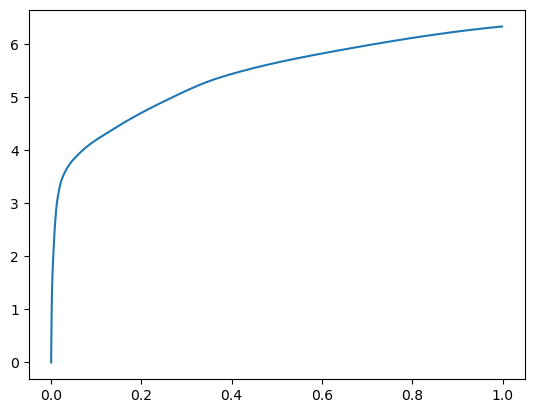

[0.00000000e+00 5.44548035e-04 1.13582611e-03 2.24399567e-03
 4.39739227e-03 7.28893280e-03 1.16529465e-02 2.19354630e-02
 5.73530197e-02 1.35291100e-01 2.38268852e-01 3.69423866e-01
 6.14518166e-01 1.00000000e+00] betas
[0.         0.51510245 0.49865828 0.45707726 0.45748488 0.46356968
 0.4473207  0.48372397 0.4878415  0.51626926 0.50365106 0.44633127
 0.47244181 0.54516594] r
-22480.269231963164 score post


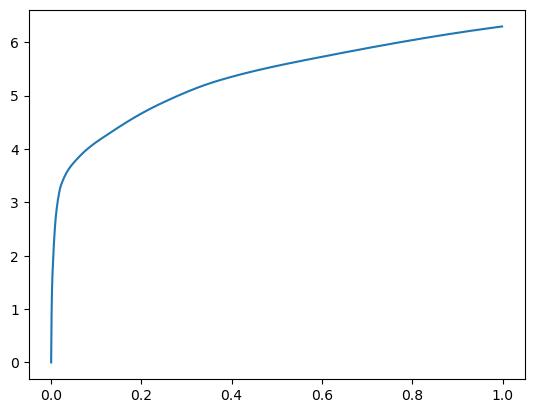

[0.00000000e+00 5.10215759e-04 1.06334686e-03 2.18296051e-03
 4.44316864e-03 7.51972198e-03 1.26523972e-02 2.48994827e-02
 6.43625259e-02 1.40759468e-01 2.41078377e-01 3.89441490e-01
 6.51822090e-01 1.00000000e+00] betas
[0.         0.43211851 0.41056017 0.49211237 0.49910326 0.48816686
 0.56917977 0.4960591  0.52638205 0.50004781 0.44724377 0.48702527
 0.56100925 0.46869602] r
-22481.990460408004 score post


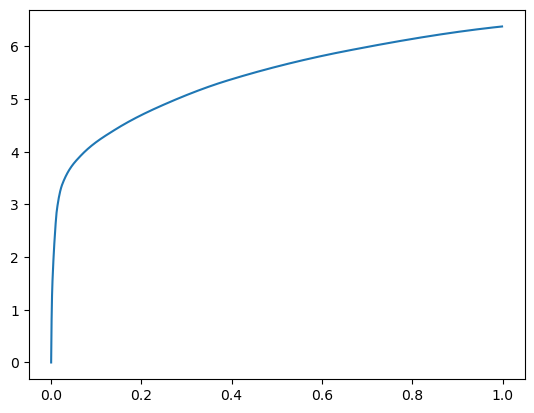

[0.00000000e+00 5.82695007e-04 1.31893158e-03 2.67505646e-03
 5.15842438e-03 8.50772858e-03 1.35030746e-02 2.70986557e-02
 6.55851364e-02 1.41058922e-01 2.52959251e-01 4.08080101e-01
 6.38876915e-01 1.00000000e+00] betas
[0.         0.49899299 0.52351885 0.52775889 0.48367887 0.5102393
 0.44022691 0.4783617  0.40936184 0.48740383 0.46376988 0.47560913
 0.51338166 0.39293238] r
-22481.990460408004 score post


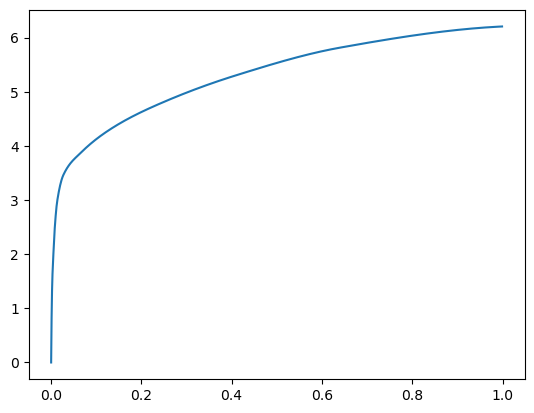

[0.00000000e+00 5.55992126e-04 1.19876862e-03 2.28214264e-03
 4.41646576e-03 7.31182098e-03 1.17311478e-02 2.20365524e-02
 5.88712692e-02 1.28994942e-01 2.38997459e-01 3.89885902e-01
 5.89577675e-01 1.00000000e+00] betas
[0.         0.54389536 0.51670166 0.4641308  0.47291509 0.44331886
 0.43998548 0.47088998 0.55409691 0.44827295 0.48304956 0.52224165
 0.47868777 0.59340194] r
-22480.269231963164 score post


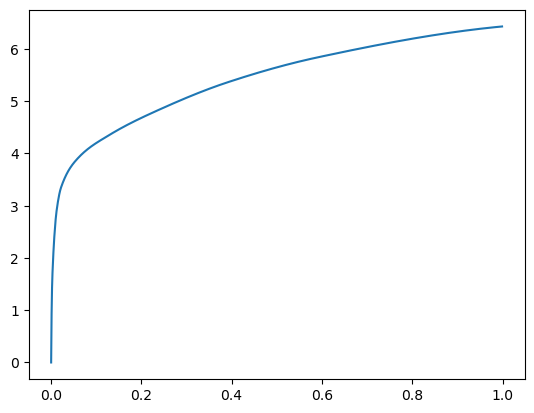

[0.00000000e+00 5.00679016e-04 1.08623505e-03 2.15435028e-03
 4.31346893e-03 7.58075714e-03 1.31139755e-02 2.68316269e-02
 6.46600723e-02 1.48428917e-01 2.67682076e-01 4.19402122e-01
 6.43527031e-01 1.00000000e+00] betas
[0.         0.43218888 0.48769597 0.471618   0.45887156 0.51014074
 0.54725092 0.58268766 0.51175804 0.51104913 0.51004553 0.42937822
 0.46638034 0.44230859] r
-22481.990460408004 score post


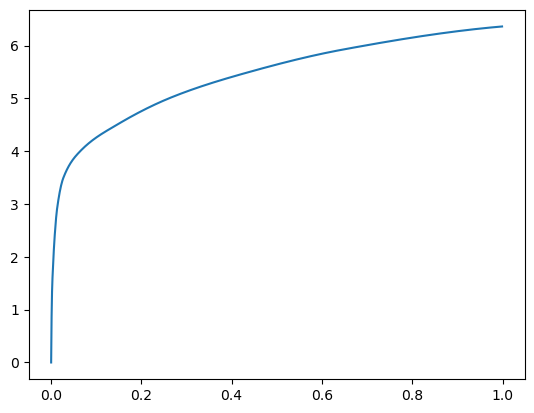

[0.00000000e+00 5.65528870e-04 1.18732452e-03 2.42519379e-03
 4.91428375e-03 8.29029083e-03 1.35679245e-02 2.43234634e-02
 5.51862717e-02 1.26656532e-01 2.32478142e-01 3.91051292e-01
 6.15275383e-01 1.00000000e+00] betas
[0.         0.53002218 0.504775   0.51411946 0.52116948 0.48490648
 0.47401144 0.38365696 0.4278393  0.51883659 0.50721082 0.50417134
 0.41561442 0.46673283] r
-22489.21889293895 score post


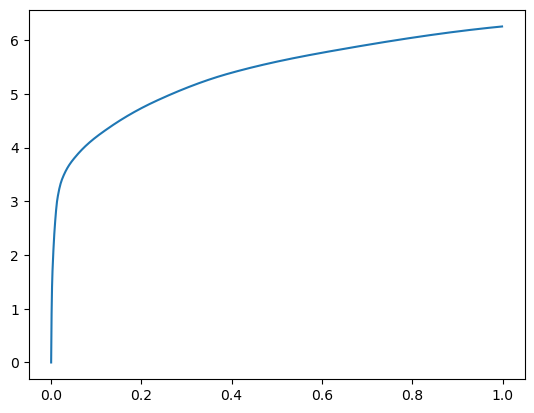

[0.00000000e+00 5.10215759e-04 1.07288361e-03 2.09140778e-03
 4.08077240e-03 7.08293915e-03 1.15461349e-02 2.23798752e-02
 5.59473038e-02 1.21493340e-01 2.18289375e-01 3.59837532e-01
 6.05776787e-01 1.00000000e+00] betas
[0.         0.45657433 0.47516452 0.49142788 0.49346041 0.46583665
 0.46704558 0.55269307 0.50680241 0.46756065 0.44595863 0.4970849
 0.58817426 0.55049383] r
-22480.269231963164 score post


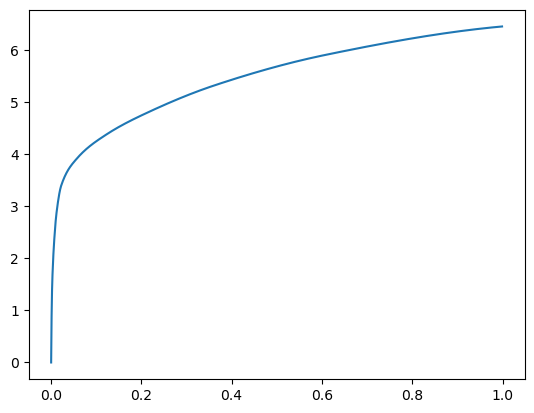

[0.00000000e+00 5.55992126e-04 1.17397308e-03 2.29740143e-03
 4.45652008e-03 7.90119171e-03 1.34496689e-02 2.54888535e-02
 6.27260208e-02 1.38962746e-01 2.55497932e-01 4.11589622e-01
 6.35884285e-01 1.00000000e+00] betas
[0.         0.46161767 0.44376061 0.50331231 0.48993348 0.53754099
 0.4283003  0.39829953 0.45128827 0.47581014 0.5129598  0.51233448
 0.46689389 0.46198807] r
-22481.621781595804 score post


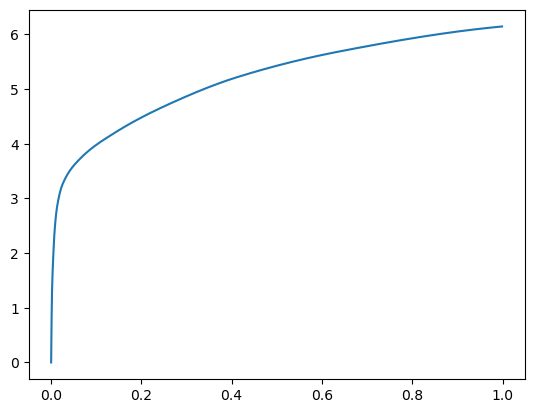

[0.00000000e+00 5.69343567e-04 1.24454498e-03 2.32601166e-03
 4.41265106e-03 7.28130341e-03 1.28908157e-02 2.79417038e-02
 7.09028244e-02 1.51410103e-01 2.61687279e-01 4.05341148e-01
 6.29324913e-01 1.00000000e+00] betas
[0.         0.49005192 0.51100838 0.49500659 0.47238139 0.44401029
 0.54320699 0.53033755 0.50474676 0.45732383 0.50439736 0.41850336
 0.50768195 0.47011972] r
-22481.990460408004 score post


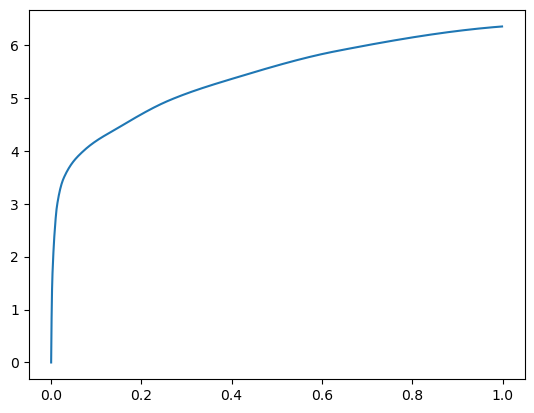

[0.00000000e+00 5.67436218e-04 1.20449066e-03 2.23255157e-03
 4.33254242e-03 7.52353668e-03 1.24654770e-02 2.48441696e-02
 6.06737137e-02 1.40818596e-01 2.43662834e-01 4.05755043e-01
 6.18636131e-01 1.00000000e+00] betas
[0.         0.46032298 0.52584201 0.46869161 0.45729219 0.47596634
 0.4878603  0.56199008 0.4674647  0.50371612 0.48687192 0.54440742
 0.44789517 0.53029112] r
-22480.269231963164 score post


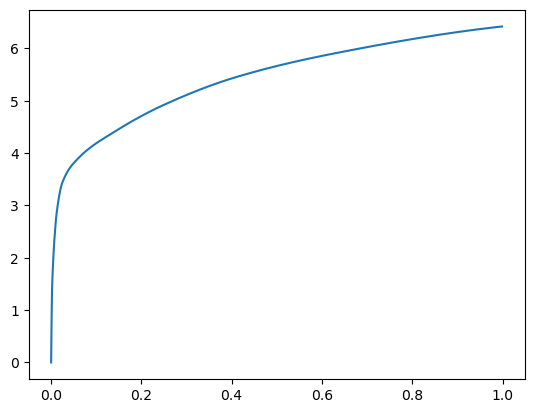

[0.00000000e+00 6.07490540e-04 1.20639801e-03 2.32028961e-03
 4.68921661e-03 8.20064545e-03 1.38216019e-02 2.56738663e-02
 6.58426285e-02 1.47217751e-01 2.54145622e-01 4.02226448e-01
 6.40175819e-01 1.00000000e+00] betas
[0.         0.54025431 0.45044882 0.47807251 0.49458148 0.52890216
 0.52181745 0.42032932 0.48533805 0.50408141 0.49729127 0.4561483
 0.43855499 0.4730214 ] r
-22482.458794922564 score post


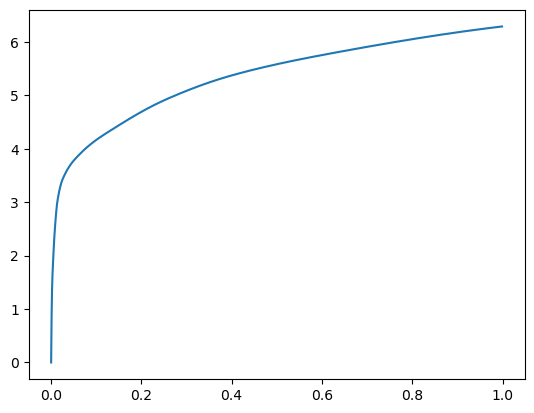

[0.00000000e+00 5.38825989e-04 1.16634369e-03 2.26116180e-03
 4.52709198e-03 7.60746002e-03 1.21908188e-02 2.35071182e-02
 6.00023270e-02 1.33975029e-01 2.33038902e-01 3.79591942e-01
 6.33269310e-01 1.00000000e+00] betas
[0.         0.48177052 0.48522756 0.48337557 0.47113469 0.46561348
 0.45261089 0.48910152 0.48001161 0.43096713 0.44904541 0.54294351
 0.53744729 0.48857749] r
-22480.269231963164 score post


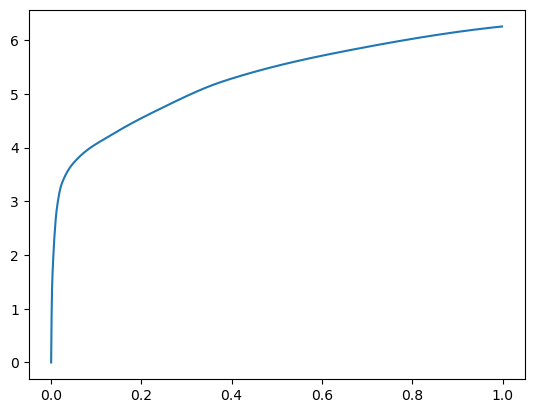

[0.00000000e+00 5.38825989e-04 1.15871429e-03 2.24018097e-03
 4.54998016e-03 7.77149200e-03 1.29690170e-02 2.53973007e-02
 6.51807785e-02 1.52508736e-01 2.63415337e-01 4.03138161e-01
 6.37619972e-01 1.00000000e+00] betas
[0.         0.50499445 0.47888236 0.49663952 0.49055487 0.50389588
 0.46733685 0.44821843 0.48946607 0.53565175 0.50841307 0.42480621
 0.4681519  0.49566122] r
-22480.269231963164 score post


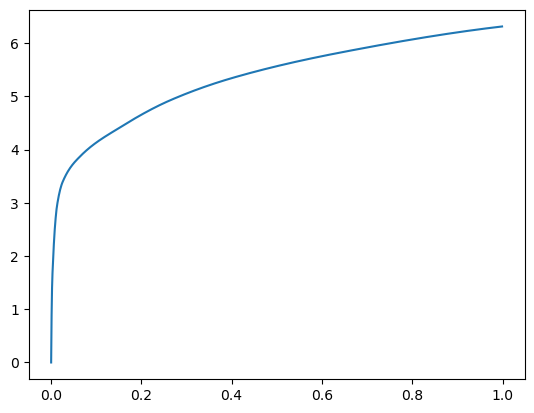

[0.00000000e+00 5.15937805e-04 1.13773346e-03 2.16579437e-03
 4.38976288e-03 7.38811493e-03 1.24788284e-02 2.58283615e-02
 6.57358170e-02 1.43830299e-01 2.45739937e-01 4.00149345e-01
 6.43752098e-01 1.00000000e+00] betas
[0.         0.45938815 0.49470839 0.4440023  0.47970045 0.48976072
 0.51346011 0.51344721 0.47348508 0.4421093  0.49503682 0.48641284
 0.49567272 0.42481058] r
-22482.458794922564 score post


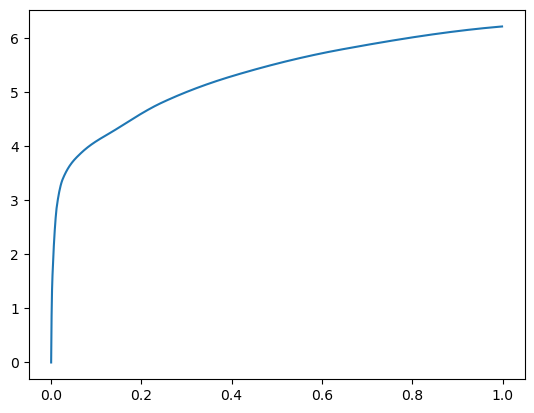

[0.00000000e+00 5.36918640e-04 1.13964081e-03 2.28786469e-03
 4.56905365e-03 7.55977631e-03 1.22537613e-02 2.36330032e-02
 6.01015091e-02 1.42018318e-01 2.39045143e-01 3.86408806e-01
 6.10621452e-01 1.00000000e+00] betas
[0.         0.44548254 0.4961434  0.50802186 0.53801188 0.43207314
 0.45022314 0.45270359 0.51767483 0.50637876 0.40266394 0.50177851
 0.45522423 0.52045594] r
-22484.252724367707 score post


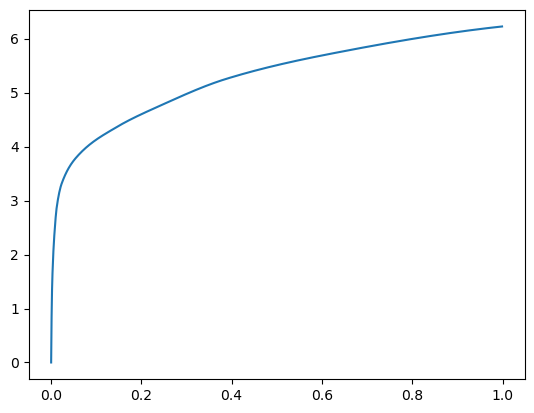

[0.00000000e+00 5.76972961e-04 1.16825104e-03 2.24781036e-03
 4.18376923e-03 7.34996796e-03 1.23205185e-02 2.49853134e-02
 5.91764450e-02 1.34797096e-01 2.49785423e-01 3.93307686e-01
 6.36052132e-01 1.00000000e+00] betas
[0.         0.50820664 0.46104884 0.47502375 0.43191038 0.50842681
 0.48416061 0.47063788 0.48178819 0.48192804 0.542257   0.42727167
 0.47449792 0.5083035 ] r
-22485.404341027654 score post


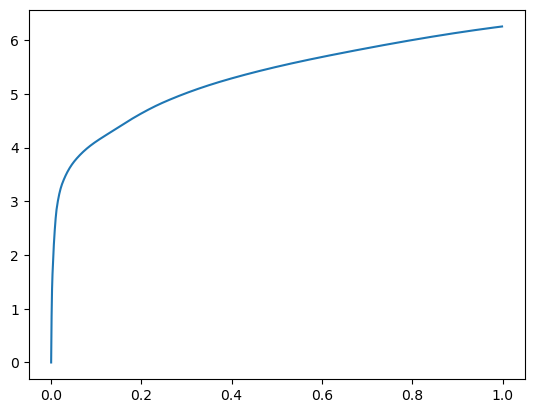

[0.00000000e+00 5.44548035e-04 1.15680695e-03 2.24590302e-03
 4.44316864e-03 7.52353668e-03 1.26428604e-02 2.63280869e-02
 6.23159409e-02 1.39851570e-01 2.40923882e-01 4.01881218e-01
 6.52588844e-01 1.00000000e+00] betas
[0.         0.52918075 0.45129444 0.50910985 0.48049411 0.47600134
 0.4846798  0.47774823 0.41131815 0.46618521 0.4593014  0.56057911
 0.49163475 0.44538337] r
-22481.990460408004 score post


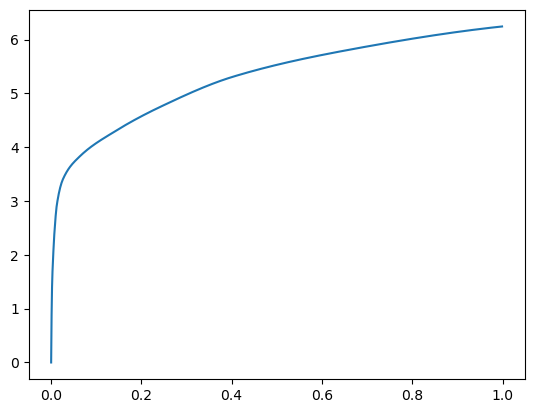

[0.00000000e+00 4.87327576e-04 1.12247467e-03 2.10094452e-03
 4.17232513e-03 7.16304779e-03 1.18570328e-02 2.40716934e-02
 6.50377274e-02 1.46834373e-01 2.55251884e-01 3.92987251e-01
 6.30620003e-01 1.00000000e+00] betas
[0.         0.43120648 0.53830971 0.46131956 0.47036516 0.47632564
 0.43271939 0.56538379 0.57278809 0.49023183 0.51920124 0.4557583
 0.51321729 0.47714743] r
-22480.269231963164 score post


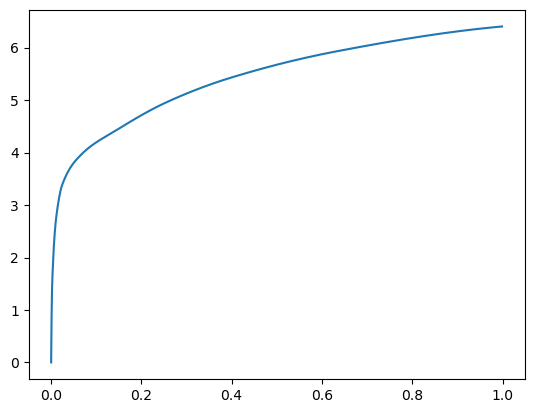

[0.00000000e+00 5.55992126e-04 1.14727020e-03 2.25353241e-03
 4.54425812e-03 7.90691376e-03 1.42068863e-02 2.72760391e-02
 6.41832352e-02 1.45873070e-01 2.47368813e-01 3.94919395e-01
 6.21342659e-01 1.00000000e+00] betas
[0.         0.48158511 0.46768658 0.50393777 0.49622224 0.50388914
 0.54849719 0.43249733 0.46539737 0.51999234 0.44879434 0.40897217
 0.46330507 0.5047241 ] r
-22480.269231963164 score post


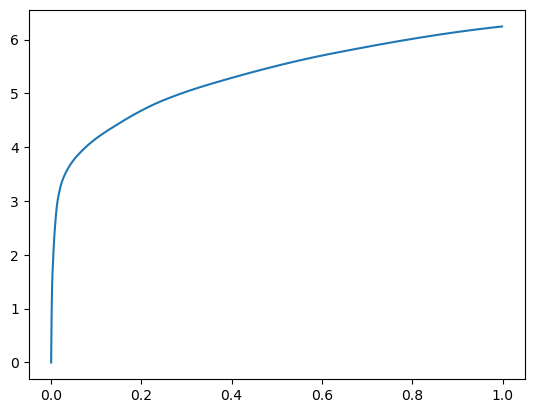

[0.00000000e+00 5.54084778e-04 1.16634369e-03 2.21538544e-03
 4.38976288e-03 7.47585297e-03 1.23319626e-02 2.40621567e-02
 5.79290390e-02 1.27667427e-01 2.29729652e-01 3.97942543e-01
 6.36193275e-01 1.00000000e+00] betas
[0.         0.46945084 0.46239186 0.51879805 0.52180297 0.46004731
 0.46129081 0.47698146 0.41137362 0.42234263 0.46993478 0.52506019
 0.48613911 0.44858562] r
-22481.621781595804 score post


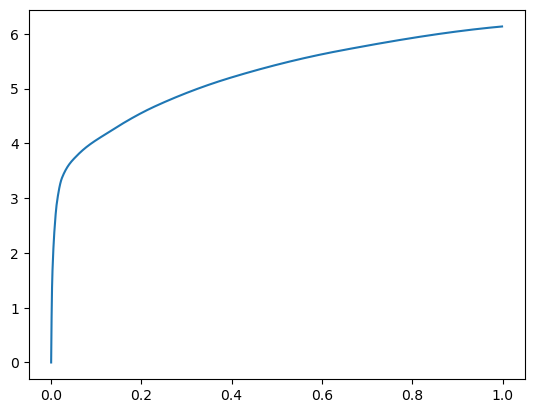

[0.00000000e+00 5.57899475e-04 1.18541718e-03 2.11620331e-03
 3.94344330e-03 6.88076019e-03 1.14183426e-02 2.13747025e-02
 5.70650101e-02 1.35743141e-01 2.41576195e-01 3.94358635e-01
 6.21594429e-01 1.00000000e+00] betas
[0.         0.51942016 0.46505356 0.38881062 0.43849627 0.49002446
 0.51509714 0.44488613 0.51172146 0.53050039 0.50120376 0.45447375
 0.45768555 0.5037288 ] r
-22480.269231963164 score post


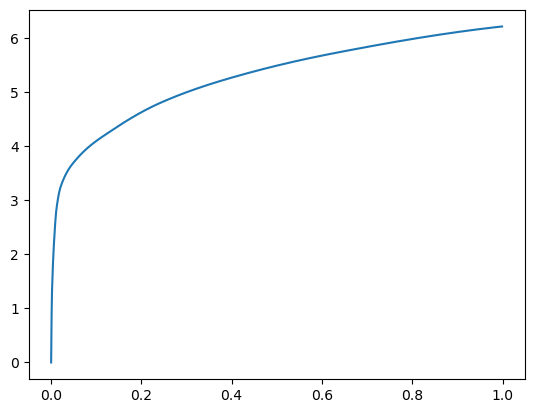

[0.00000000e+00 5.08308411e-04 1.13773346e-03 2.32219696e-03
 4.47368622e-03 7.54833221e-03 1.22461319e-02 2.52904892e-02
 6.29835129e-02 1.36261940e-01 2.36329079e-01 3.96138191e-01
 6.37106895e-01 1.00000000e+00] betas
[0.         0.39992887 0.50894154 0.55235633 0.45108964 0.47746914
 0.50651279 0.58772273 0.47138795 0.42677505 0.45280396 0.53041249
 0.49742233 0.47667971] r
-22484.52742382129 score post


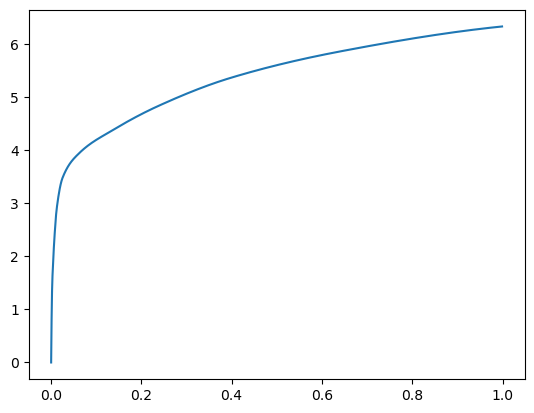

[0.00000000e+00 6.15119934e-04 1.24835968e-03 2.32791901e-03
 4.68921661e-03 7.92598724e-03 1.26867294e-02 2.26278305e-02
 5.64680099e-02 1.37570381e-01 2.47126579e-01 3.95672798e-01
 6.30414009e-01 1.00000000e+00] betas
[0.         0.52558967 0.47609753 0.4462562  0.47523638 0.48943876
 0.46141394 0.43667127 0.52638781 0.52158412 0.49991306 0.45865492
 0.50393972 0.50037305] r
-22482.458794922564 score post


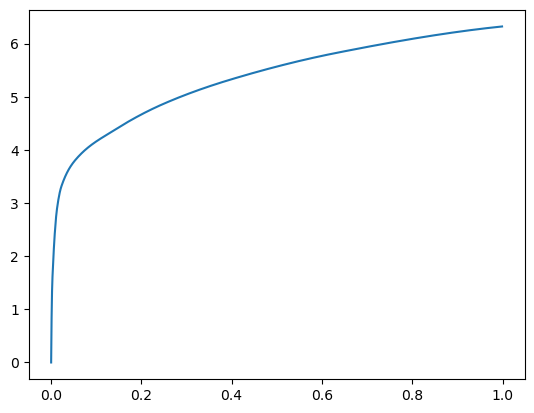

[0.00000000e+00 5.65528870e-04 1.19686127e-03 2.36606598e-03
 4.81510162e-03 8.08238983e-03 1.33924484e-02 2.65684128e-02
 6.21900558e-02 1.40889168e-01 2.48242378e-01 4.08144951e-01
 6.38783455e-01 1.00000000e+00] betas
[0.         0.46226341 0.49190114 0.50552351 0.55607488 0.50505468
 0.46640388 0.44496876 0.45548786 0.54944195 0.54171588 0.44404592
 0.48687487 0.40320253] r
-22482.458794922564 score post


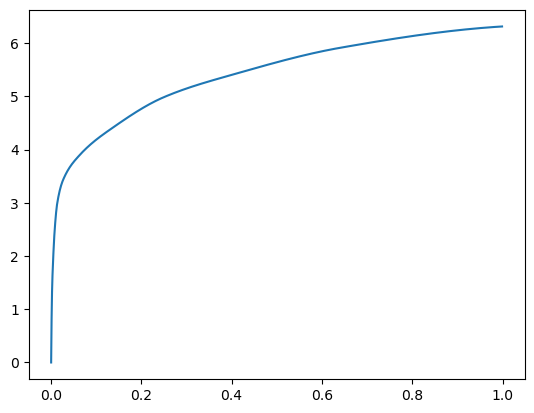

[0.00000000e+00 5.94139099e-04 1.22737885e-03 2.35652924e-03
 4.42218781e-03 7.34233856e-03 1.22003555e-02 2.50082016e-02
 6.18944168e-02 1.29597664e-01 2.18623161e-01 3.74447823e-01
 5.89653969e-01 1.00000000e+00] betas
[0.         0.5016434  0.5081184  0.4437846  0.40278774 0.45278559
 0.51409184 0.52793041 0.45332147 0.41683524 0.42720397 0.54747352
 0.43223518 0.49572828] r
-22485.404341027654 score post


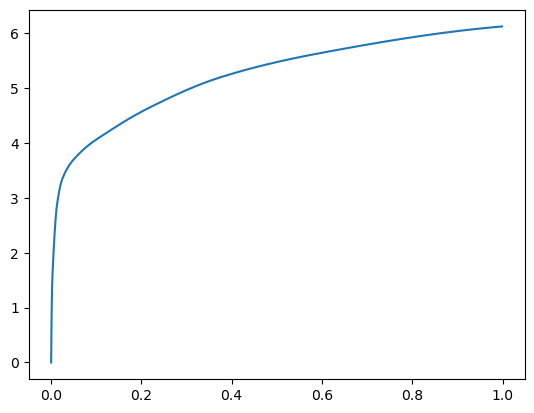

[0.00000000e+00 5.57899475e-04 1.11865997e-03 2.21347809e-03
 4.58431244e-03 7.70473480e-03 1.22518539e-02 2.27785110e-02
 5.76448441e-02 1.32994652e-01 2.33859062e-01 3.69067192e-01
 6.05639458e-01 1.00000000e+00] betas
[0.         0.45233139 0.42477692 0.54180907 0.56967316 0.49693953
 0.44324162 0.48630307 0.48926427 0.48282776 0.43771512 0.44551527
 0.55282189 0.47604797] r
-22480.269231963164 score post


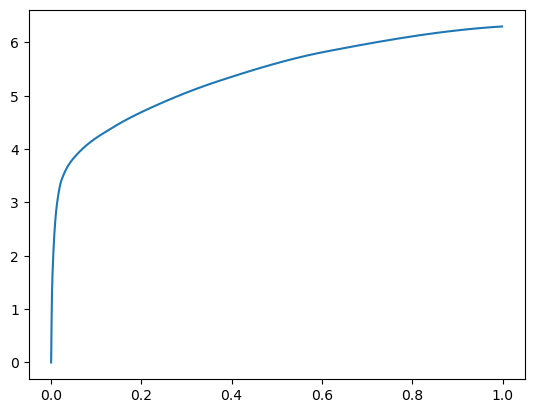

[0.00000000e+00 5.97953796e-04 1.27124786e-03 2.31838226e-03
 4.32491302e-03 7.21836090e-03 1.19390488e-02 2.18839645e-02
 5.46312332e-02 1.27968788e-01 2.39377022e-01 3.90727043e-01
 6.00501060e-01 1.00000000e+00] betas
[0.         0.48857648 0.50382166 0.46674383 0.47467648 0.47357334
 0.48232745 0.49758508 0.40514506 0.4490129  0.45709921 0.45260774
 0.44857941 0.58537257] r
-22484.348661750126 score post


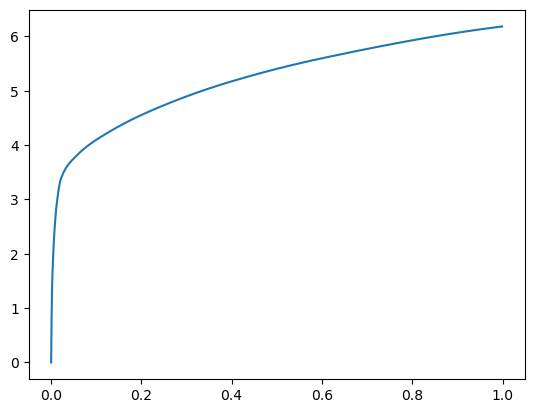

[0.00000000e+00 5.80787659e-04 1.20258331e-03 2.22301483e-03
 4.16851044e-03 7.00092316e-03 1.14641190e-02 1.99213028e-02
 5.62562943e-02 1.36246681e-01 2.56651878e-01 4.24302101e-01
 6.63393974e-01 1.00000000e+00] betas
[0.         0.53285634 0.48278916 0.42026812 0.4504474  0.46436921
 0.53515286 0.45457158 0.53537026 0.48068014 0.48500692 0.50101582
 0.49455219 0.41948061] r
-22480.269231963164 score post


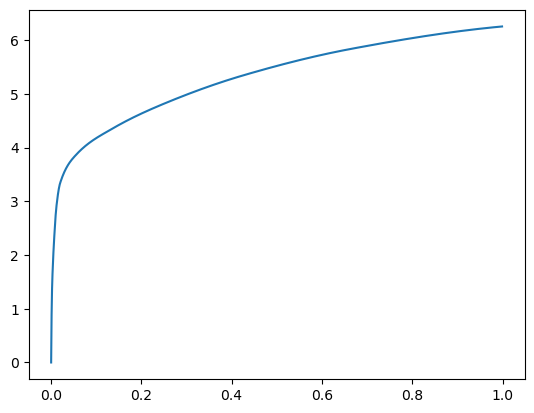

[0.00000000e+00 5.19752502e-04 1.11484528e-03 2.24971771e-03
 4.37068939e-03 7.39765167e-03 1.14870071e-02 2.10275650e-02
 5.34219742e-02 1.31079674e-01 2.48383522e-01 4.05163765e-01
 6.26286507e-01 1.00000000e+00] betas
[0.         0.44841296 0.43915817 0.51671117 0.51906357 0.47535608
 0.43380234 0.4942929  0.46404296 0.44836627 0.4605684  0.49597374
 0.47394619 0.60742684] r
-22480.269231963164 score post


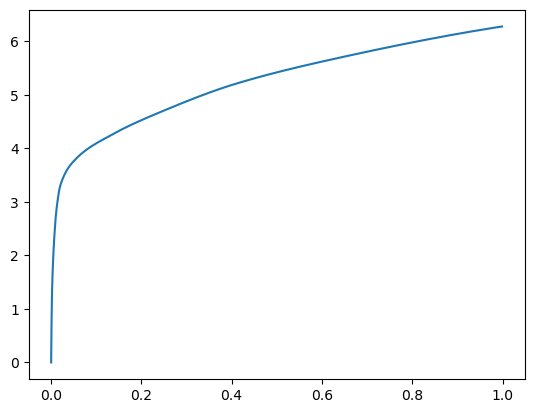

730017 steps_after


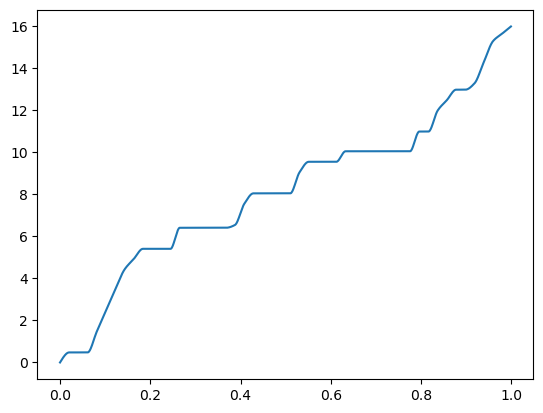

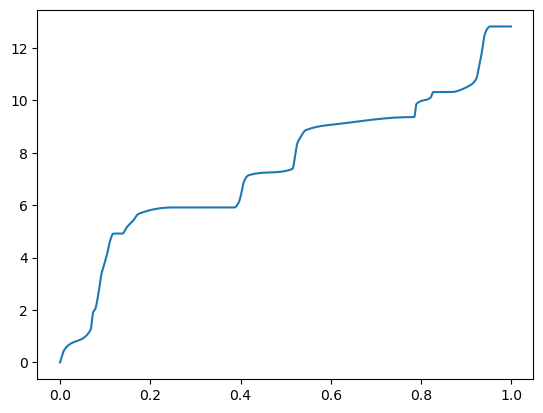

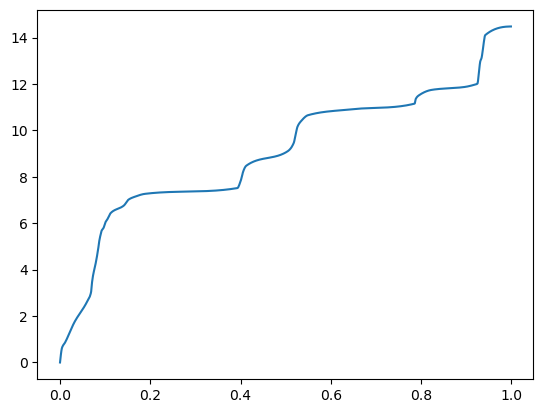

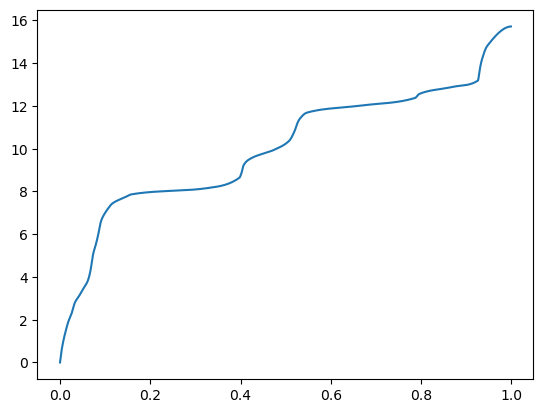

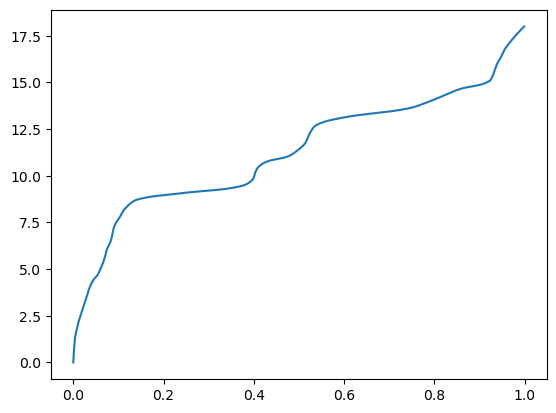

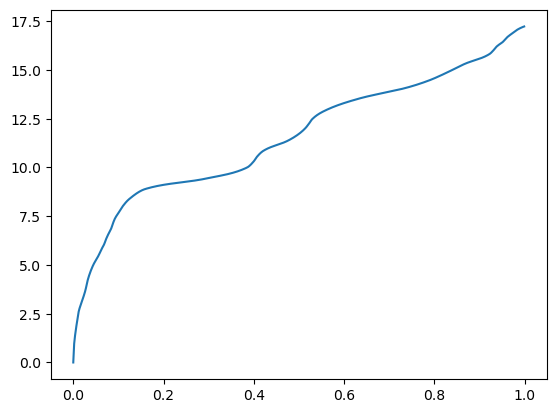

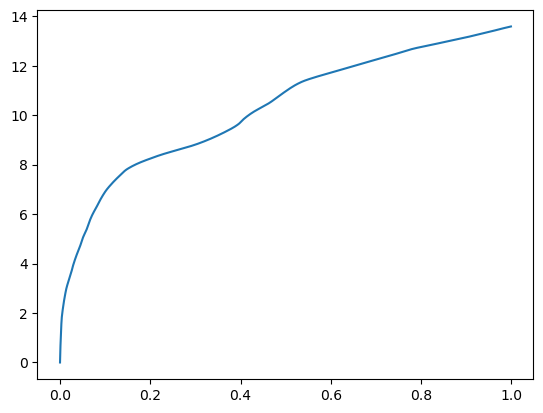

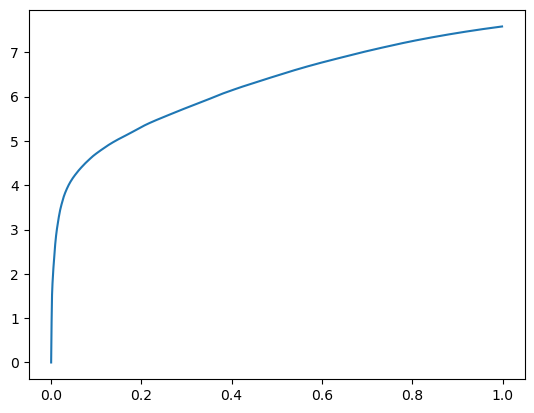

10470 steps
betas [0.00000000e+00 5.99861145e-04 1.19304657e-03 2.32028961e-03
 5.26905060e-03 9.37747955e-03 1.64766312e-02 2.96468735e-02
 6.09865189e-02 1.22250557e-01 2.20883369e-01 3.53257179e-01
 5.09043694e-01 7.06398964e-01 1.00000000e+00]
n_chains 15
[0.00000000e+00 5.99861145e-04 1.19304657e-03 2.32028961e-03
 5.26905060e-03 9.37747955e-03 1.64766312e-02 2.96468735e-02
 6.09865189e-02 1.22250557e-01 2.20883369e-01 3.53257179e-01
 5.09043694e-01 7.06398964e-01 1.00000000e+00] betas
[0.         0.00268025 0.00126477 0.         0.00110843 0.
 0.         0.08949759 0.18076426 0.04531585 0.21356104 0.
 0.         0.13450705 0.47186322] r
-22482.458794922564 score post


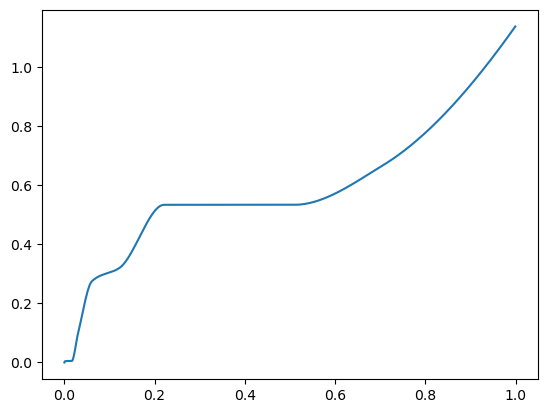

[0.         0.02783871 0.03947735 0.05201817 0.12646961 0.16051579
 0.18889332 0.59702206 0.68846798 0.76568508 0.82474232 0.87495518
 0.91987896 0.96123219 1.        ] betas
[0.         0.99745122 0.18928987 0.15834063 0.52315212 0.19508618
 0.15655403 0.87035921 0.17010297 0.13354046 0.09420595 0.07685512
 0.05870368 0.04956907 0.0432107 ] r
-22490.39224926668 score post


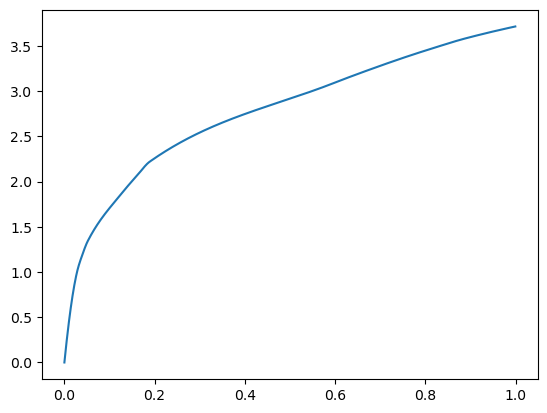

[0.         0.00565434 0.01212025 0.01996708 0.03118801 0.05028248
 0.08241177 0.124856   0.17055035 0.2416048  0.35101032 0.50142384
 0.64723301 0.80107212 1.        ] betas
[0.         0.99807677 0.7072453  0.40365683 0.27363136 0.25270263
 0.23667063 0.24747002 0.24044091 0.32236242 0.38372947 0.38120605
 0.27296499 0.24041951 0.22677116] r
-22484.489001339873 score post


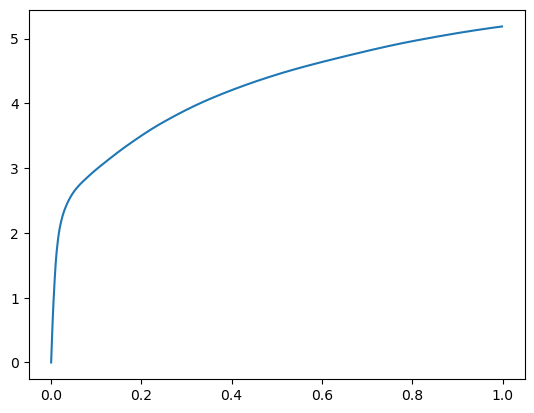

[0.         0.0018568  0.00394154 0.00650311 0.00960445 0.0143919
 0.02377033 0.04624271 0.09728909 0.16546345 0.24739742 0.35431957
 0.50100803 0.70499706 1.        ] betas
[0.         0.87919777 0.55993717 0.46831143 0.45016861 0.39285488
 0.35374273 0.3531608  0.38115188 0.41859148 0.3781402  0.40941431
 0.39654428 0.35354272 0.35542415] r
-22480.269231963164 score post


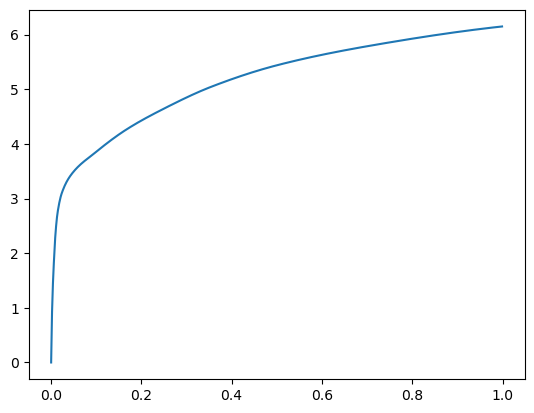

[0.00000000e+00 8.21113586e-04 1.85489655e-03 3.40747833e-03
 5.59902191e-03 8.34178925e-03 1.26276016e-02 2.26087570e-02
 5.19342422e-02 1.14603996e-01 1.92585945e-01 2.95472145e-01
 4.31059837e-01 6.48962975e-01 1.00000000e+00] betas
[0.         0.74320123 0.52085676 0.38744446 0.3864679  0.38298789
 0.3846571  0.4240958  0.45471811 0.4887501  0.45051925 0.42687908
 0.41666337 0.41889972 0.41524975] r
-22483.17300509828 score post


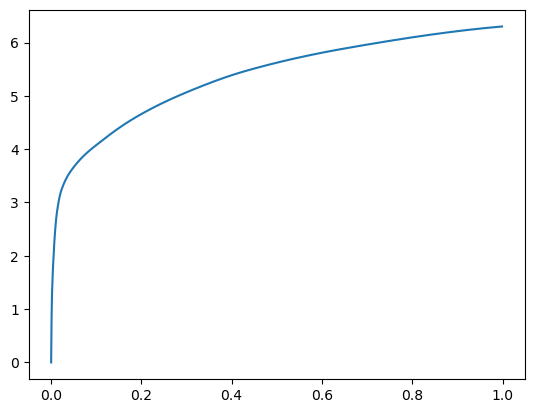

[0.00000000e+00 4.49180603e-04 1.07479095e-03 2.12574005e-03
 4.17232513e-03 7.00855255e-03 1.11742020e-02 1.99193954e-02
 4.44478989e-02 9.61141586e-02 1.68749809e-01 2.68488884e-01
 4.05287743e-01 6.26215935e-01 1.00000000e+00] betas
[0.         0.38794154 0.46776418 0.51097952 0.53071755 0.4728457
 0.44731405 0.49647481 0.47772095 0.36997816 0.37238963 0.41703181
 0.46944553 0.43454385 0.44565659] r
-22486.32095381361 score post


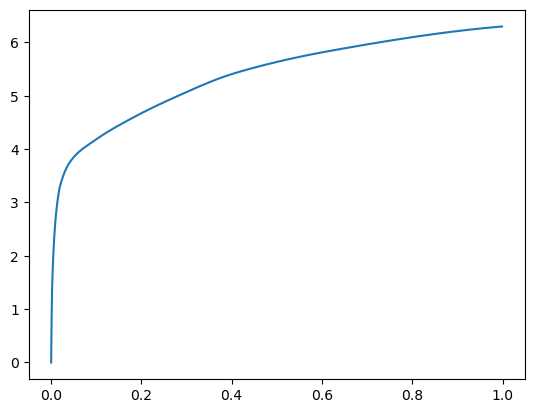

[0.00000000e+00 5.25474548e-04 1.14917755e-03 2.07996368e-03
 3.71265411e-03 6.16168976e-03 9.84096527e-03 1.61619186e-02
 3.13997269e-02 7.69376755e-02 1.61524773e-01 2.68349648e-01
 3.97717476e-01 6.23322487e-01 1.00000000e+00] betas
[0.         0.46434668 0.48958449 0.43549813 0.4132464  0.48318913
 0.46167176 0.38841444 0.46363568 0.48239028 0.47856862 0.4966688
 0.38758973 0.4175623  0.46213224] r
-22480.269231963164 score post


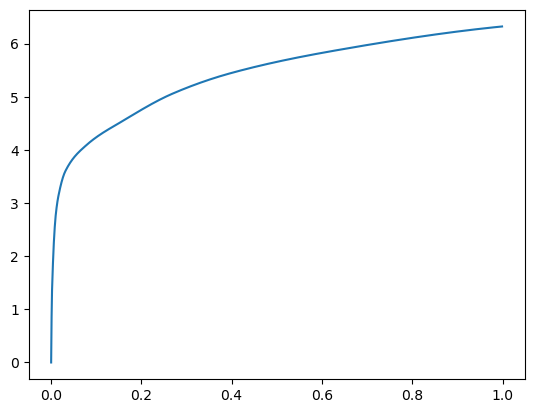

[0.00000000e+00 5.10215759e-04 1.06906891e-03 1.98268890e-03
 3.73172760e-03 5.99193573e-03 9.43279266e-03 1.67856216e-02
 3.22523117e-02 7.47995377e-02 1.52998924e-01 2.46117592e-01
 3.87747765e-01 6.30251884e-01 1.00000000e+00] betas
[0.         0.43569719 0.45544638 0.45681689 0.47070177 0.41263857
 0.40649849 0.51095944 0.42918109 0.44031326 0.41460757 0.38470963
 0.50264524 0.51037988 0.45191869] r
-22481.990460408004 score post


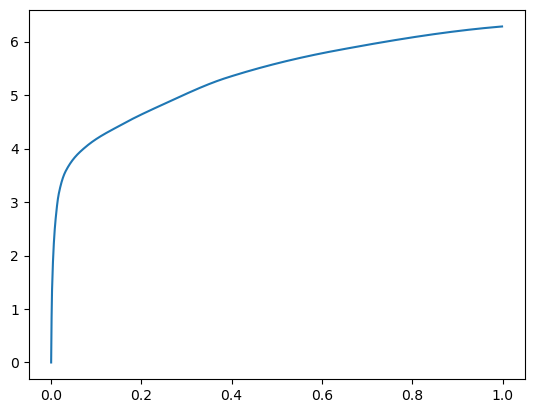

[0.00000000e+00 5.25474548e-04 1.07860565e-03 1.97887421e-03
 3.62491608e-03 6.07776642e-03 1.00469589e-02 1.66101456e-02
 3.30038071e-02 7.76777267e-02 1.64967537e-01 2.76785851e-01
 4.12329674e-01 6.32264137e-01 1.00000000e+00] betas
[0.         0.47290566 0.43818021 0.48383804 0.41218151 0.4000867
 0.46847795 0.48757877 0.50156714 0.43766274 0.45554334 0.48345493
 0.39498876 0.46806307 0.44373565] r
-22481.990460408004 score post


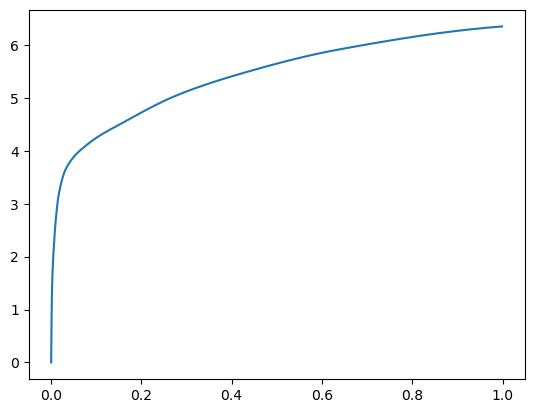

[0.00000000e+00 5.02586365e-04 1.07288361e-03 1.88732147e-03
 3.65924835e-03 6.51645660e-03 1.05352402e-02 1.68466568e-02
 3.09171677e-02 7.46145248e-02 1.59958839e-01 2.62137413e-01
 4.14299965e-01 6.26183510e-01 1.00000000e+00] betas
[0.         0.40806319 0.46822251 0.44756207 0.43347802 0.45843563
 0.46892986 0.45002253 0.36716177 0.46796592 0.50576746 0.46807666
 0.4718537  0.41841224 0.50903112] r
-22480.269231963164 score post


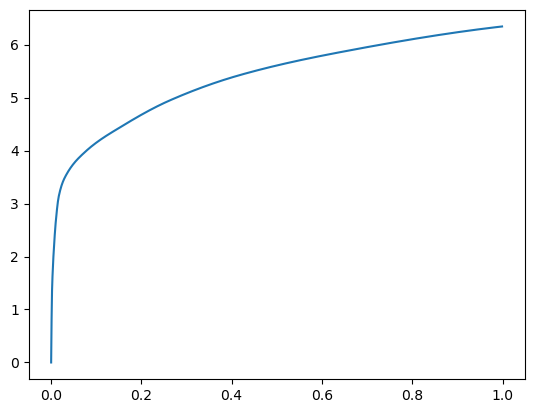

[0.00000000e+00 5.55992126e-04 1.11865997e-03 1.99031830e-03
 3.94535065e-03 6.88266754e-03 1.09109879e-02 1.77812576e-02
 3.91740799e-02 8.92438889e-02 1.70666695e-01 2.72969246e-01
 4.23110008e-01 6.60653114e-01 1.00000000e+00] betas
[0.         0.46489563 0.45288383 0.40210132 0.48746353 0.51094035
 0.42420702 0.42015527 0.49946622 0.44739794 0.4858183  0.45099117
 0.48541034 0.44383844 0.44128839] r
-22484.25291812412 score post


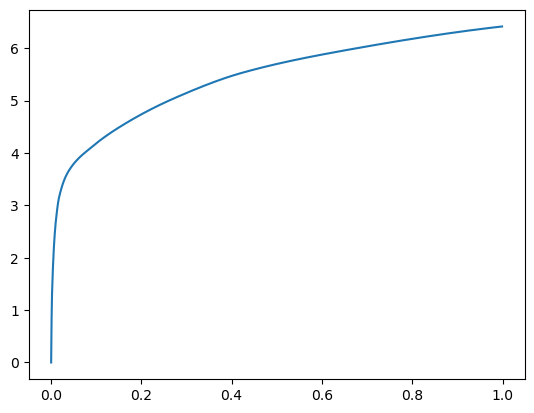

[0.00000000e+00 5.48362732e-04 1.11675262e-03 2.16007233e-03
 4.07123566e-03 6.68811798e-03 1.10063553e-02 1.90668106e-02
 3.95154953e-02 9.14049149e-02 1.68347359e-01 2.71775246e-01
 4.10517693e-01 6.49678230e-01 1.00000000e+00] betas
[0.         0.45360768 0.46329035 0.48541321 0.42527649 0.43751574
 0.47942933 0.46845201 0.45534792 0.40899848 0.37720727 0.39823571
 0.47868852 0.52824188 0.43786181] r
-22480.269231963164 score post


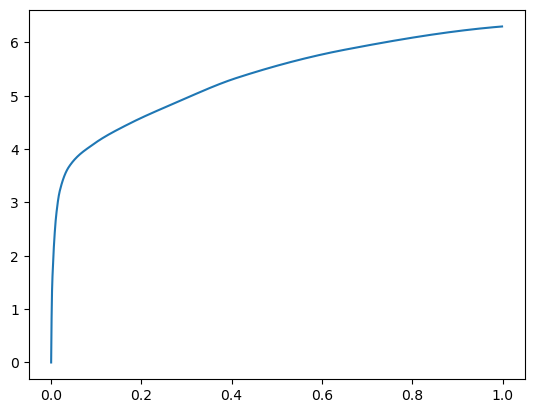

[0.00000000e+00 5.44548035e-04 1.09004974e-03 2.00366974e-03
 3.92246246e-03 6.57176971e-03 1.04608536e-02 1.74474716e-02
 3.46689224e-02 8.66346359e-02 1.78599358e-01 2.97616005e-01
 4.35170174e-01 6.42399788e-01 1.00000000e+00] betas
[0.         0.51104214 0.40882009 0.43782424 0.46325443 0.46652879
 0.47446333 0.41604725 0.40115247 0.45854972 0.48640444 0.46977174
 0.43178825 0.42287788 0.46722622] r
-22482.458794922564 score post


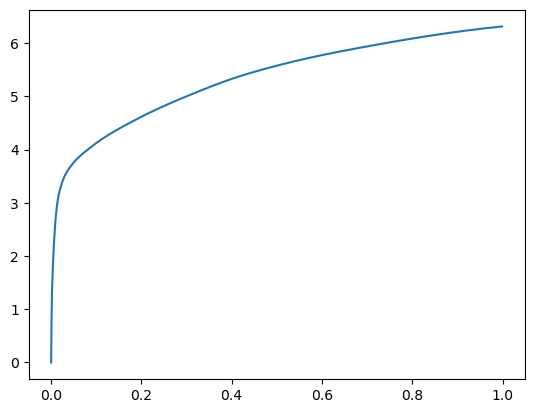

[0.00000000e+00 4.73976135e-04 1.06143951e-03 1.99031830e-03
 3.84235382e-03 6.35623932e-03 9.85431671e-03 1.69115067e-02
 3.68795395e-02 8.99896622e-02 1.75778389e-01 2.88693428e-01
 4.30388451e-01 6.52338982e-01 1.00000000e+00] betas
[0.         0.42766284 0.44836299 0.47714393 0.46266481 0.43179056
 0.46166769 0.4495813  0.47378487 0.39394944 0.47359    0.4674461
 0.48075623 0.43760288 0.42002902] r
-22481.621781595804 score post


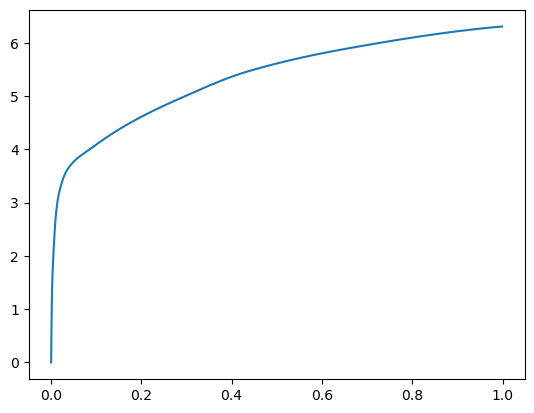

[0.00000000e+00 5.00679016e-04 1.10149384e-03 1.98459625e-03
 3.77368927e-03 6.38675690e-03 9.77993011e-03 1.67570114e-02
 3.46879959e-02 9.42811966e-02 1.76642418e-01 2.85250664e-01
 4.14319038e-01 6.32781029e-01 1.00000000e+00] betas
[0.         0.42714191 0.46618236 0.43463847 0.47062332 0.43622634
 0.39189348 0.47562996 0.53529169 0.57116692 0.42353987 0.44423161
 0.42223118 0.48549204 0.42831174] r
-22482.458794922564 score post


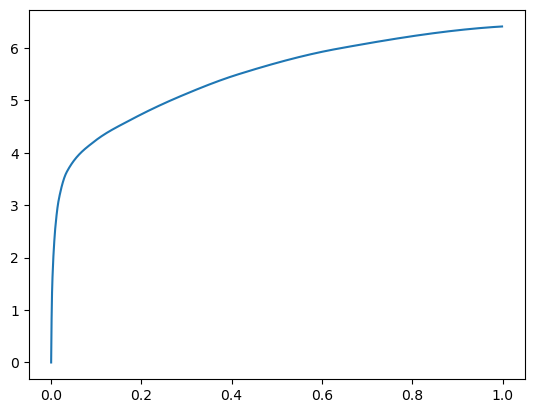

[0.00000000e+00 5.38825989e-04 1.13964081e-03 2.11811066e-03
 3.93772125e-03 6.79492950e-03 1.12123489e-02 1.92289352e-02
 3.63893509e-02 8.15553665e-02 1.65177345e-01 2.74912834e-01
 4.13472176e-01 6.14644051e-01 1.00000000e+00] betas
[0.         0.51175329 0.44392448 0.4636847  0.43794057 0.50859358
 0.48460884 0.40601777 0.38329244 0.42660663 0.45674287 0.46000766
 0.45190626 0.42815577 0.52756381] r
-22480.269231963164 score post


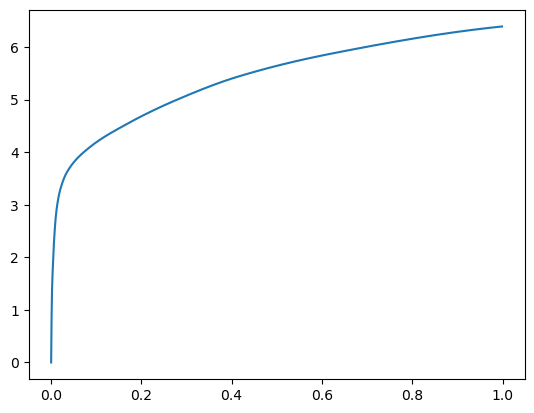

[0.00000000e+00 4.73976135e-04 1.06906891e-03 1.97696686e-03
 3.78513336e-03 6.23035431e-03 9.90009308e-03 1.75237656e-02
 3.72514725e-02 8.76111984e-02 1.74010277e-01 2.85311699e-01
 4.30136681e-01 6.56849861e-01 1.00000000e+00] betas
[0.         0.38303798 0.48217953 0.46217027 0.48572889 0.41797977
 0.45222199 0.49971993 0.45510615 0.45545743 0.48597262 0.48668399
 0.43000052 0.45925259 0.43790701] r
-22480.269231963164 score post


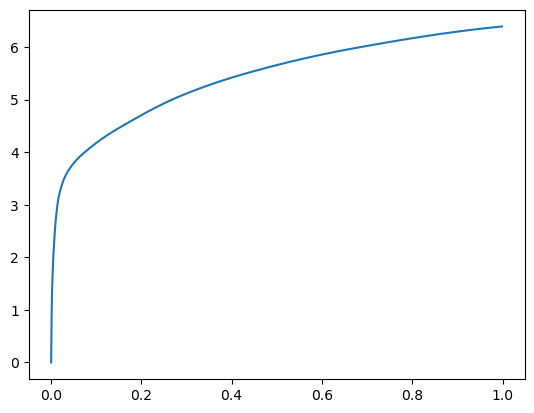

[0.00000000e+00 5.61714172e-04 1.14536285e-03 2.09712982e-03
 3.84998322e-03 6.59465790e-03 1.05504990e-02 1.78995132e-02
 3.83634567e-02 8.99553299e-02 1.71412468e-01 2.73642540e-01
 4.23565865e-01 6.45220757e-01 1.00000000e+00] betas
[0.         0.48825115 0.46332388 0.45804185 0.45975806 0.49419526
 0.43758131 0.38055624 0.42420013 0.42256218 0.49482555 0.43951215
 0.461711   0.41836799 0.44026459] r
-22483.215759872455 score post


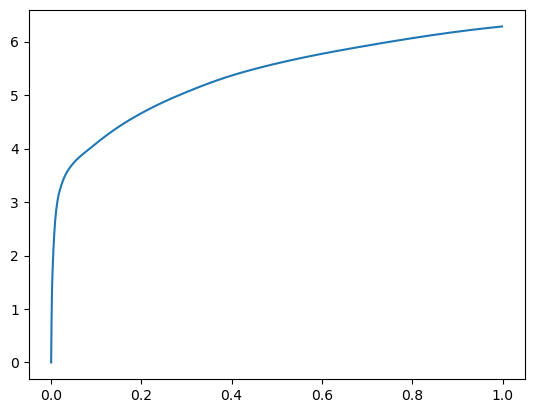

[0.00000000e+00 5.14030457e-04 1.06334686e-03 1.92737579e-03
 3.51047516e-03 5.80692291e-03 9.30309296e-03 1.67436600e-02
 3.71541977e-02 9.14754868e-02 1.64557457e-01 2.66539574e-01
 4.07765388e-01 6.39636040e-01 1.00000000e+00] betas
[0.         0.44784042 0.45418075 0.45384293 0.3982551  0.41394003
 0.44592074 0.53635836 0.58417857 0.44728053 0.40756414 0.46198849
 0.42822401 0.4742802  0.46238265] r
-22485.404341027654 score post


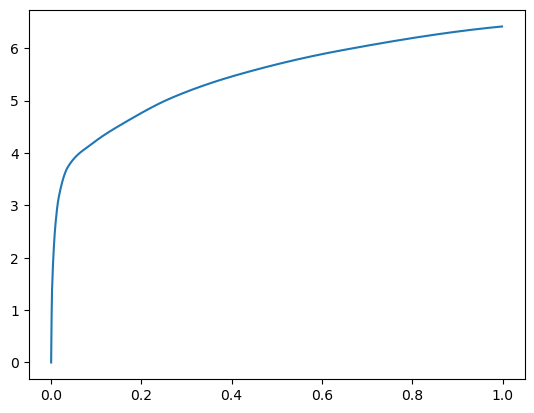

[0.00000000e+00 5.25474548e-04 1.08623505e-03 1.98268890e-03
 3.89385223e-03 6.64615631e-03 1.07889175e-02 1.80921555e-02
 3.30934525e-02 8.25376511e-02 1.63296700e-01 2.63834953e-01
 4.15896416e-01 6.42182350e-01 1.00000000e+00] betas
[0.         0.45635116 0.49030831 0.45235536 0.4683157  0.47672592
 0.48038123 0.40752518 0.38865588 0.49678457 0.43669266 0.45831195
 0.46933044 0.42648326 0.43464047] r
-22484.4517533122 score post


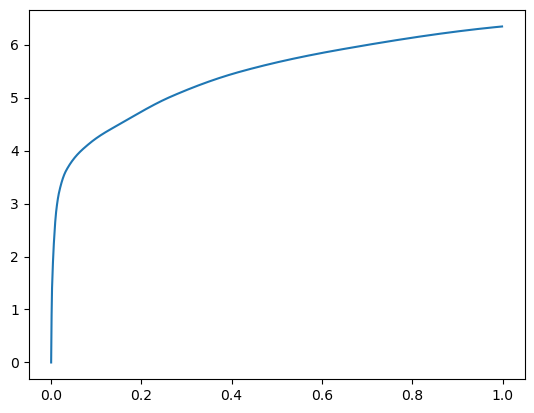

[0.00000000e+00 5.21659851e-04 1.02901459e-03 1.87397003e-03
 3.62300873e-03 6.11019135e-03 9.62543488e-03 1.65891647e-02
 3.33414078e-02 7.70349503e-02 1.58516884e-01 2.56316185e-01
 3.97675514e-01 6.30036354e-01 1.00000000e+00] betas
[0.         0.4897858  0.45012941 0.41385814 0.47360959 0.46603946
 0.44952181 0.4548665  0.42833313 0.45490553 0.49992636 0.43383943
 0.44674546 0.44384548 0.49441214] r
-22480.269231963164 score post


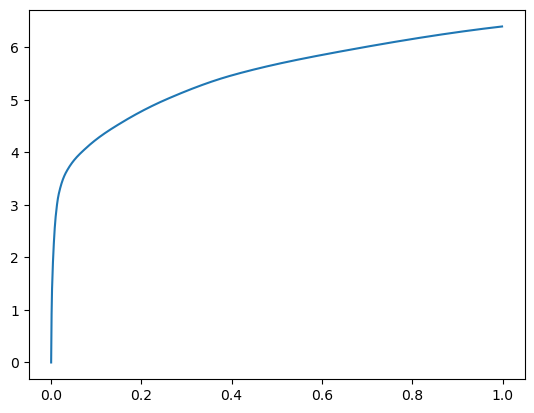

[0.00000000e+00 4.85420227e-04 9.90867615e-04 1.92356110e-03
 3.62873077e-03 6.06060028e-03 9.62352753e-03 1.66425705e-02
 3.53460312e-02 8.12845230e-02 1.56647682e-01 2.59976387e-01
 4.07679558e-01 6.53584480e-01 1.00000000e+00] betas
[0.         0.43785933 0.39408501 0.50275682 0.44414805 0.41034847
 0.4426891  0.52666501 0.43759006 0.46403792 0.46105282 0.49312827
 0.41134102 0.53382812 0.43972786] r
-22480.269231963164 score post


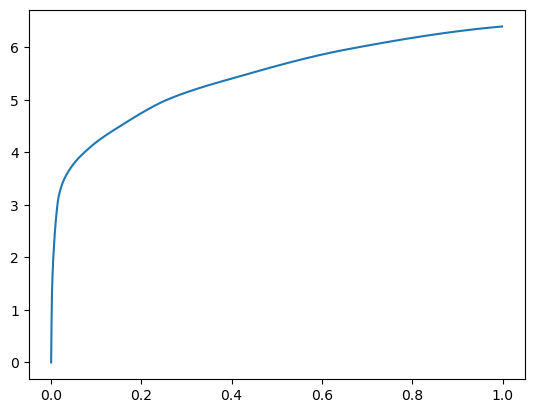

[0.00000000e+00 5.08308411e-04 1.11865997e-03 2.02655792e-03
 3.87287140e-03 6.73961639e-03 1.07908249e-02 1.77392960e-02
 3.95860672e-02 8.83989334e-02 1.65865898e-01 2.63825417e-01
 4.31830406e-01 6.43122673e-01 1.00000000e+00] betas
[0.         0.48574549 0.48853117 0.45048596 0.42212599 0.47269794
 0.44442422 0.40396973 0.52851246 0.48204421 0.46476592 0.42261839
 0.50258698 0.49437536 0.4771421 ] r
-22481.990460408004 score post


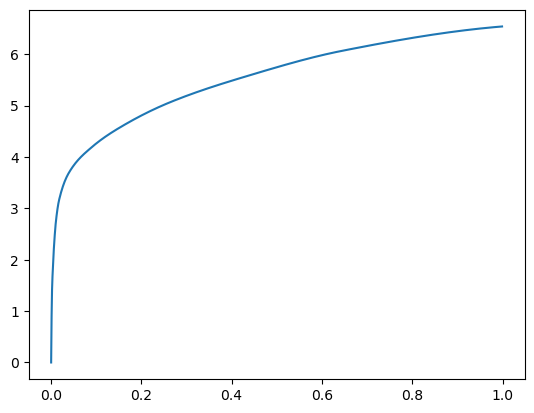

[0.00000000e+00 4.87327576e-04 1.05762482e-03 1.95789337e-03
 3.98540497e-03 6.86168671e-03 1.12962723e-02 2.06785202e-02
 4.24127579e-02 9.18321609e-02 1.71484947e-01 2.84651756e-01
 4.45948601e-01 6.48871422e-01 1.00000000e+00] betas
[0.         0.46096558 0.45250707 0.4370066  0.48027872 0.48376206
 0.48146205 0.50226021 0.39356014 0.42764378 0.45279237 0.45914708
 0.52816291 0.41555965 0.41300054] r
-22480.269231963164 score post


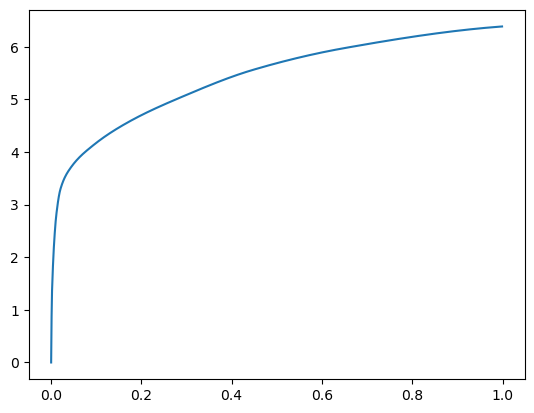

[0.00000000e+00 4.81605530e-04 1.05571747e-03 2.01320648e-03
 3.95679474e-03 6.62136078e-03 1.05810165e-02 1.78651810e-02
 3.90996933e-02 8.99934769e-02 1.69545174e-01 2.81321526e-01
 4.15247917e-01 6.21855736e-01 1.00000000e+00] betas
[0.         0.44502119 0.45881767 0.47625389 0.42921836 0.44978353
 0.45654735 0.40223914 0.44484456 0.43895954 0.44807071 0.4763477
 0.37078989 0.40832548 0.4891012 ] r
-22486.71698678069 score post


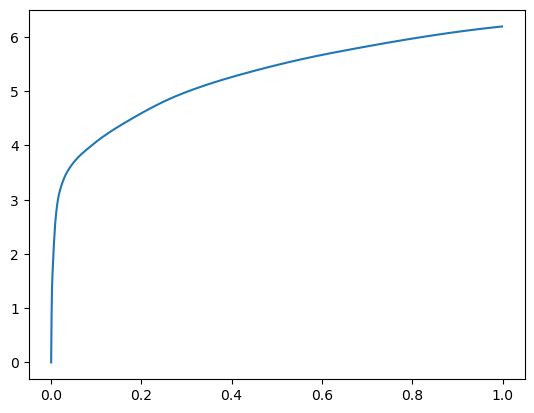

[0.00000000e+00 4.77790833e-04 1.02519989e-03 1.86443329e-03
 3.74698639e-03 6.29329681e-03 9.87529755e-03 1.72662735e-02
 3.73640060e-02 8.71400833e-02 1.64399147e-01 2.64628410e-01
 4.20634270e-01 6.51333809e-01 1.00000000e+00] betas
[0.         0.45735544 0.44822669 0.40830638 0.4356164  0.40492381
 0.46295147 0.50558994 0.48693537 0.42567268 0.44668088 0.45784308
 0.46248881 0.42891328 0.45588508] r
-22483.215759872455 score post


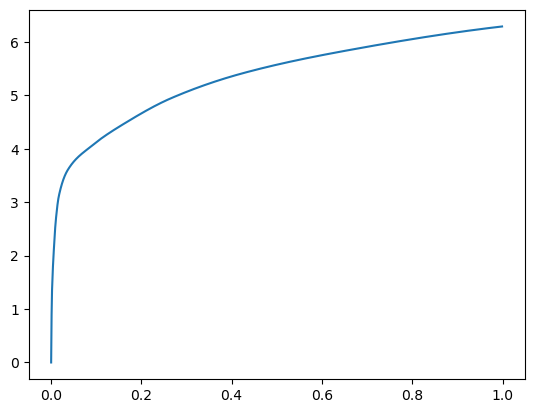

[0.00000000e+00 4.68254089e-04 1.01375580e-03 1.96933746e-03
 3.99875641e-03 6.92462921e-03 1.07278824e-02 1.78098679e-02
 3.61413956e-02 8.80460739e-02 1.66102409e-01 2.64624596e-01
 4.14912224e-01 6.55707359e-01 1.00000000e+00] betas
[0.         0.44184199 0.46980719 0.48815524 0.41767453 0.49289039
 0.41803956 0.44991812 0.43843572 0.46328778 0.43092676 0.44025559
 0.45202548 0.48789616 0.44863968] r
-22482.458794922564 score post


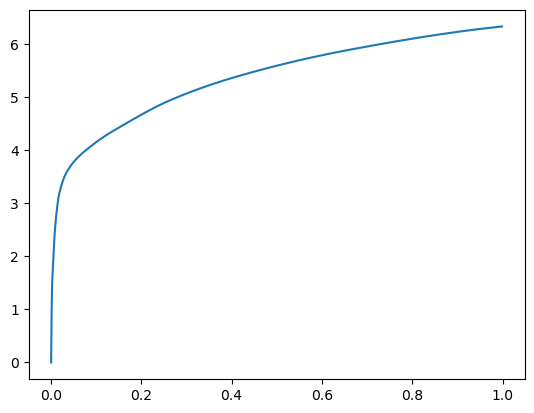

[0.00000000e+00 4.79698181e-04 1.00421906e-03 1.84917450e-03
 3.96633148e-03 6.59465790e-03 1.05924606e-02 1.75905228e-02
 3.65705490e-02 8.73994827e-02 1.69625282e-01 2.72955894e-01
 4.27582741e-01 6.53098106e-01 1.00000000e+00] betas
[0.         0.4347973  0.44462406 0.47221558 0.51838921 0.4364626
 0.44784398 0.42753436 0.4469126  0.47424716 0.44015311 0.44793368
 0.47534489 0.40330854 0.43433645] r
-22480.269231963164 score post


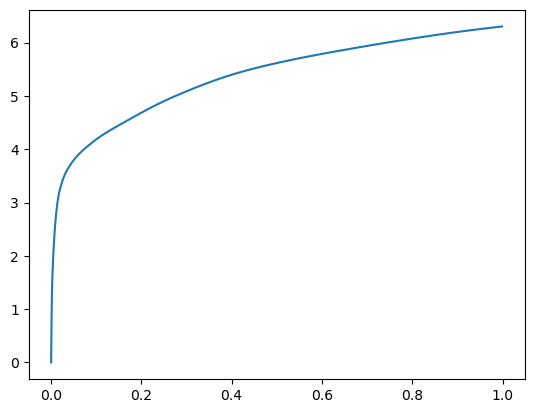

[0.00000000e+00 4.96864319e-04 1.03473663e-03 1.84726715e-03
 3.61728668e-03 6.20174408e-03 9.98783112e-03 1.68371201e-02
 3.47909927e-02 8.01725388e-02 1.61183357e-01 2.62787819e-01
 4.01961327e-01 6.42432213e-01 1.00000000e+00] betas
[0.         0.39746237 0.41337725 0.44795193 0.47732289 0.45773228
 0.44456044 0.48037779 0.44149199 0.42380264 0.53246358 0.44173044
 0.45474306 0.46500923 0.42381431] r
-22480.269231963164 score post


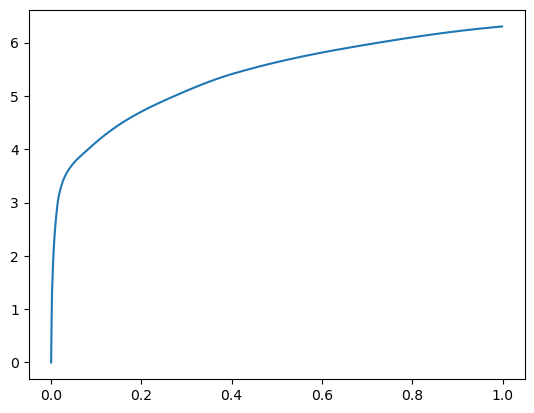

[0.00000000e+00 5.63621521e-04 1.17397308e-03 2.10475922e-03
 3.92246246e-03 6.60610199e-03 1.06897354e-02 1.76744461e-02
 3.77187729e-02 8.88757706e-02 1.58320427e-01 2.60973930e-01
 3.97423744e-01 6.25088692e-01 1.00000000e+00] betas
[0.         0.50324321 0.49397263 0.47097459 0.45117945 0.45564804
 0.49469229 0.45497903 0.42223472 0.42648492 0.39290487 0.49213839
 0.44148785 0.46016516 0.4941564 ] r
-22484.525554730924 score post


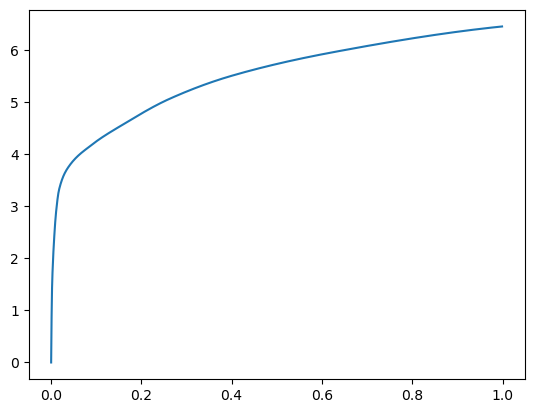

[0.00000000e+00 5.14030457e-04 1.06334686e-03 1.88541412e-03
 3.55434418e-03 6.12926483e-03 9.63497162e-03 1.55439377e-02
 3.34100723e-02 8.52708817e-02 1.66728020e-01 2.64256477e-01
 4.10328865e-01 6.45625114e-01 1.00000000e+00] betas
[0.         0.44359605 0.44266652 0.45005853 0.45336638 0.45952398
 0.44758562 0.41726253 0.50720791 0.46562304 0.4264727  0.42755707
 0.48114365 0.5143257  0.44681112] r
-22485.162923996515 score post


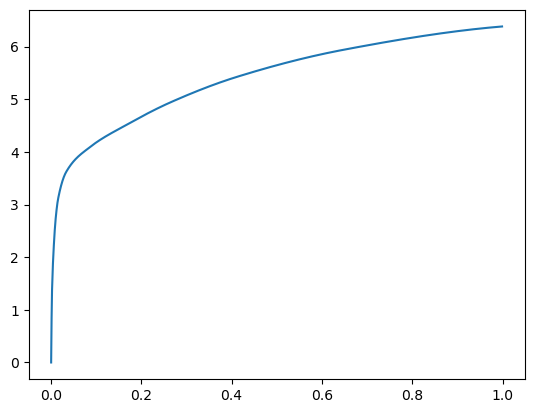

[0.00000000e+00 5.29289246e-04 1.10149384e-03 1.97124481e-03
 3.71265411e-03 6.33335114e-03 1.00584030e-02 1.73959732e-02
 3.52125168e-02 8.77599716e-02 1.76402092e-01 2.84148216e-01
 4.29007530e-01 6.40069008e-01 1.00000000e+00] betas
[0.         0.48592141 0.45480134 0.45161339 0.46599519 0.41326476
 0.43325607 0.46764286 0.36253446 0.47753952 0.4367417  0.45980027
 0.46294399 0.43203256 0.47647852] r
-22481.990460408004 score post


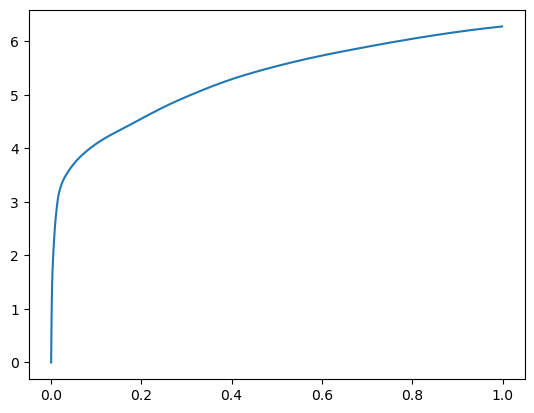

[0.00000000e+00 4.85420227e-04 1.03664398e-03 1.85298920e-03
 3.40747833e-03 6.12163544e-03 9.90581512e-03 1.65414810e-02
 3.93762589e-02 9.16376114e-02 1.84439659e-01 2.91136742e-01
 4.33489799e-01 6.57166481e-01 1.00000000e+00] betas
[0.         0.4423719  0.4512452  0.4010051  0.41617389 0.49980068
 0.44723594 0.43492019 0.58361521 0.44064329 0.48637091 0.45808133
 0.46713221 0.47775484 0.4262493 ] r
-22480.269231963164 score post


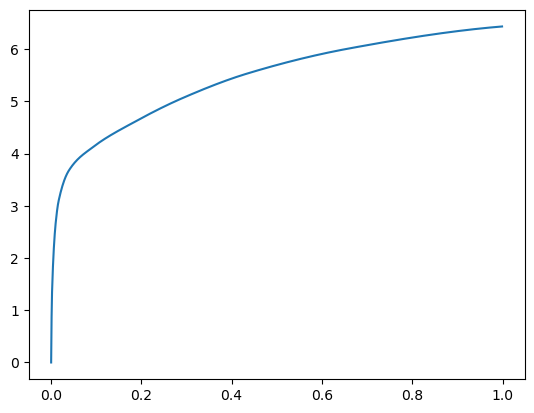

[0.00000000e+00 5.04493713e-04 1.07860565e-03 2.10094452e-03
 4.00257111e-03 6.73389435e-03 1.10921860e-02 1.98259354e-02
 3.93323898e-02 9.44242477e-02 1.82604790e-01 2.89198875e-01
 4.27876472e-01 6.37066841e-01 1.00000000e+00] betas
[0.         0.44326622 0.3954388  0.47245839 0.50428286 0.46765633
 0.43332841 0.45837875 0.33343067 0.43298107 0.48379989 0.41697274
 0.41764925 0.4635189  0.47654404] r
-22486.74408421191 score post


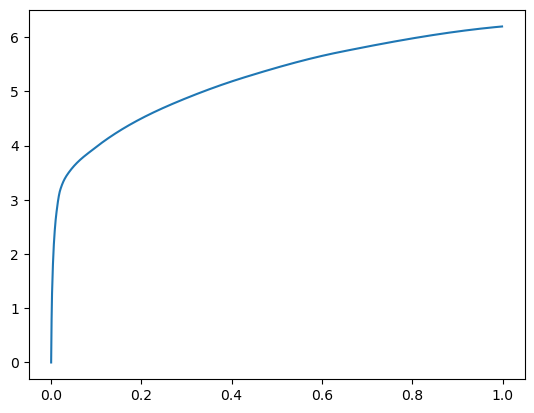

[0.00000000e+00 5.04493713e-04 1.16252899e-03 2.15053558e-03
 3.79657745e-03 6.23035431e-03 1.03120804e-02 1.76763535e-02
 4.24299240e-02 1.01286888e-01 1.83333397e-01 2.97791481e-01
 4.49141502e-01 6.57164574e-01 1.00000000e+00] betas
[0.         0.44792678 0.49819586 0.40651535 0.4097379  0.43260861
 0.47475566 0.47493533 0.50054038 0.50592505 0.4432574  0.43421499
 0.40935841 0.40777264 0.43926279] r
-22486.11953300757 score post


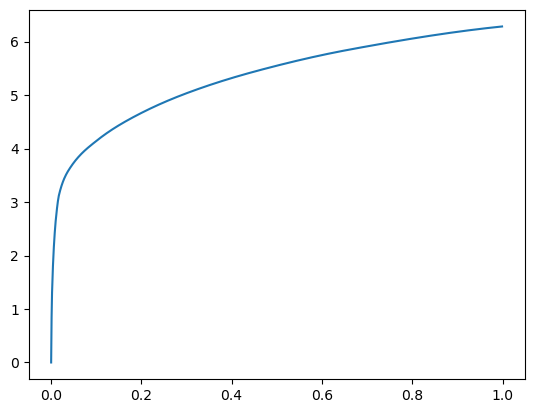

[0.00000000e+00 5.06401062e-04 1.08051300e-03 2.13146210e-03
 3.95679474e-03 6.58130646e-03 1.05924606e-02 1.76134109e-02
 3.83329391e-02 8.49485397e-02 1.60805702e-01 2.70489693e-01
 4.27453041e-01 6.51082039e-01 1.00000000e+00] betas
[0.         0.45318946 0.45729327 0.44643864 0.4630846  0.47219115
 0.47361019 0.39930194 0.50183044 0.4581386  0.40904036 0.45029578
 0.46542528 0.45771656 0.4242318 ] r
-22480.269231963164 score post


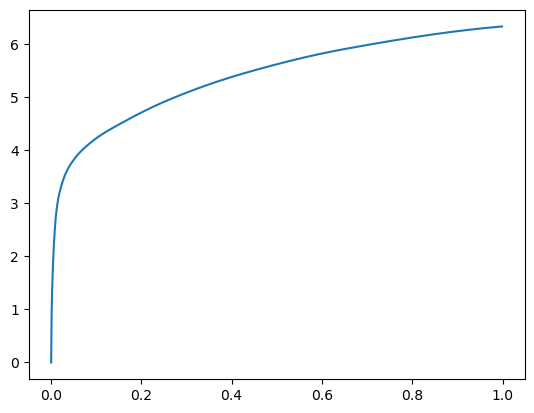

[0.00000000e+00 5.04493713e-04 1.07097626e-03 2.13146210e-03
 3.90529633e-03 6.37149811e-03 9.98973846e-03 1.76343918e-02
 3.52544785e-02 7.74221420e-02 1.58371925e-01 2.67786980e-01
 4.18337822e-01 6.33553505e-01 1.00000000e+00] betas
[0.         0.43587902 0.46588384 0.53034935 0.44721443 0.44103004
 0.45294428 0.4729204  0.41804666 0.42544385 0.46737565 0.47910998
 0.44982475 0.44811633 0.43093457] r
-22484.348661750126 score post


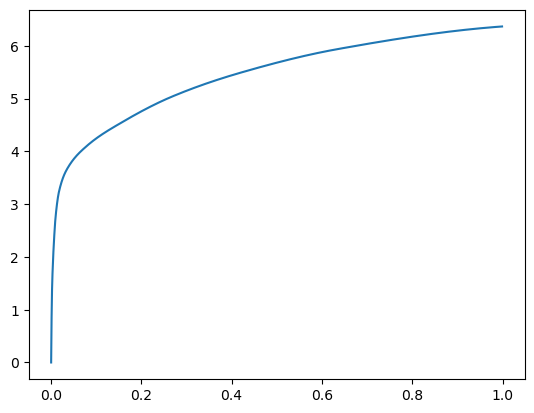

[0.00000000e+00 5.27381897e-04 1.08242035e-03 1.94835663e-03
 3.61728668e-03 6.06250763e-03 9.50336456e-03 1.61066055e-02
 3.35073471e-02 7.77025223e-02 1.56254768e-01 2.58229256e-01
 4.06306267e-01 6.18611336e-01 1.00000000e+00] betas
[0.         0.44841046 0.46204208 0.45561049 0.45051106 0.42678382
 0.39094001 0.49570382 0.44820565 0.42878076 0.48216038 0.43169503
 0.46435025 0.44568039 0.49820565] r
-22480.269231963164 score post


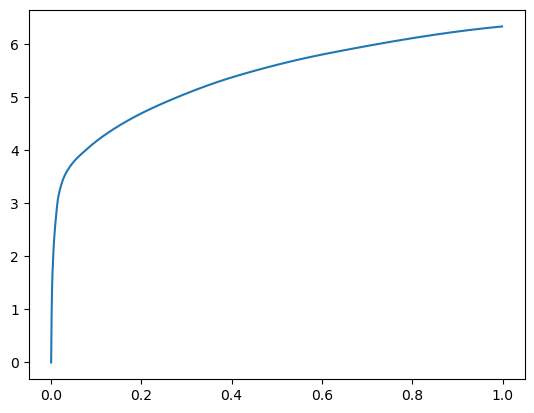

[0.00000000e+00 5.31196594e-04 1.07288361e-03 1.92165375e-03
 3.57913971e-03 6.18648529e-03 1.03521347e-02 1.69610977e-02
 3.61433029e-02 8.59575272e-02 1.62594795e-01 2.72694588e-01
 4.22122002e-01 6.46855354e-01 1.00000000e+00] betas
[0.         0.4593856  0.39650028 0.48600217 0.47068926 0.45005679
 0.50221886 0.36389915 0.51086494 0.45329514 0.4316756  0.47887273
 0.45153647 0.43225496 0.42425796] r
-22481.990460408004 score post


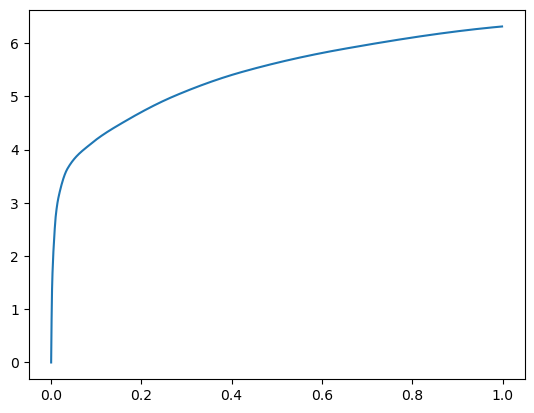

[0.00000000e+00 5.19752502e-04 1.14345551e-03 1.94835663e-03
 3.53717804e-03 6.12735748e-03 9.66739655e-03 1.76782608e-02
 3.40757370e-02 8.08553696e-02 1.59285545e-01 2.60676384e-01
 4.03851509e-01 6.29536629e-01 1.00000000e+00] betas
[0.         0.48886423 0.48324378 0.40632581 0.4158749  0.48878145
 0.44371258 0.44342946 0.43636579 0.48037452 0.49974631 0.46583936
 0.43629119 0.48202427 0.46042753] r
-22480.269231963164 score post


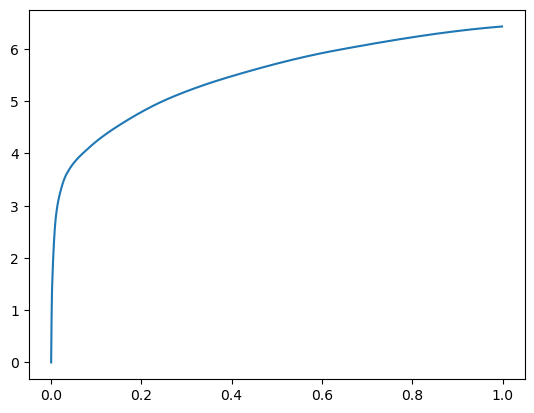

[0.00000000e+00 4.85420227e-04 1.06143951e-03 1.94835663e-03
 3.73363495e-03 6.21891022e-03 1.00393295e-02 1.89180374e-02
 3.86075974e-02 8.68997574e-02 1.60601616e-01 2.60840416e-01
 4.13207054e-01 6.30190849e-01 1.00000000e+00] betas
[0.         0.41050973 0.43597368 0.44228609 0.51624194 0.47602966
 0.4318997  0.49473568 0.45621751 0.43392105 0.41934772 0.45226086
 0.47072064 0.46846216 0.49597764] r
-22480.269231963164 score post


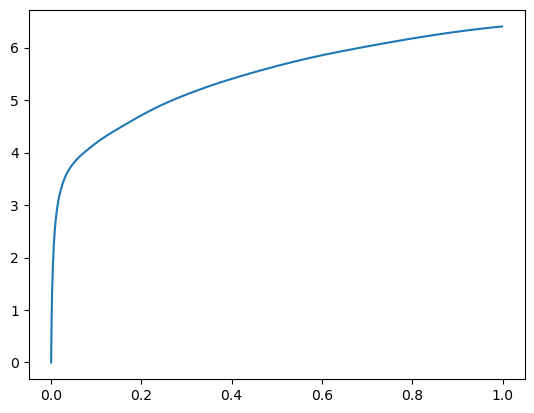

[0.00000000e+00 5.44548035e-04 1.17588043e-03 2.17914581e-03
 3.84044647e-03 6.26277924e-03 1.04532242e-02 1.87635422e-02
 3.83100510e-02 8.96749496e-02 1.72053337e-01 2.78107643e-01
 4.32723045e-01 6.53153419e-01 1.00000000e+00] betas
[0.         0.47294392 0.46311516 0.48636114 0.40045775 0.41728268
 0.53459786 0.44884687 0.44105587 0.48990839 0.47160355 0.4238193
 0.48741827 0.42826772 0.44380652] r
-22480.269231963164 score post


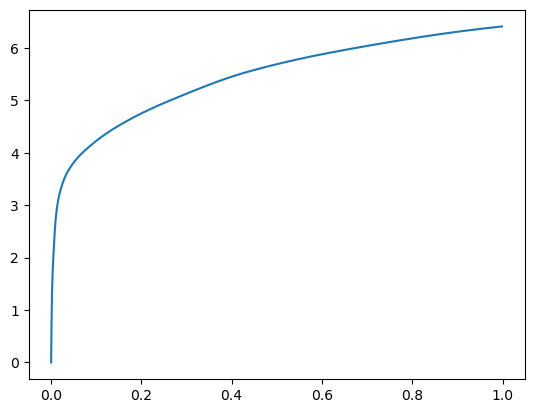

[0.00000000e+00 5.25474548e-04 1.14154816e-03 2.04181671e-03
 3.88240814e-03 6.59084320e-03 1.01270676e-02 1.82199478e-02
 3.81631851e-02 8.49885941e-02 1.62056923e-01 2.74180412e-01
 4.15625572e-01 6.44268990e-01 1.00000000e+00] betas
[0.         0.51290036 0.44130935 0.39032056 0.46921944 0.42038325
 0.45654481 0.4841603  0.38541211 0.43698549 0.45783798 0.47588843
 0.46773683 0.47325764 0.40793129] r
-22480.269231963164 score post


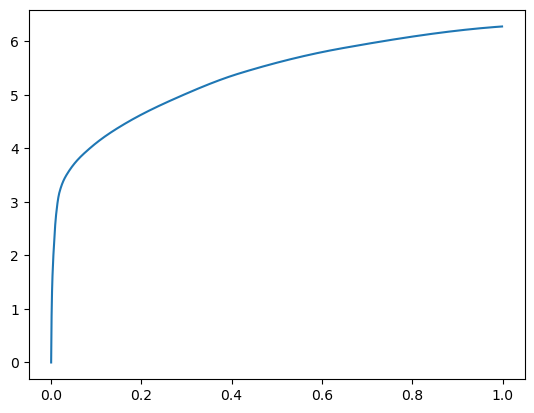

[0.00000000e+00 4.49180603e-04 1.04427338e-03 2.04563141e-03
 3.78322601e-03 6.65187836e-03 1.01346970e-02 1.72281265e-02
 4.03470993e-02 9.04779434e-02 1.68232918e-01 2.75046349e-01
 4.09577370e-01 6.18464470e-01 1.00000000e+00] betas
[0.         0.38300683 0.48097967 0.50807363 0.49244366 0.48686327
 0.38150519 0.47805196 0.53625204 0.42159889 0.40540312 0.40015913
 0.42695111 0.45690141 0.55242328] r
-22486.533998302537 score post


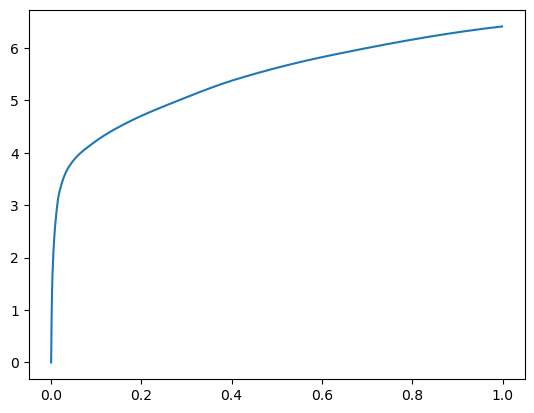

[0.00000000e+00 5.36918640e-04 1.12628937e-03 2.04944611e-03
 3.63445282e-03 6.20365143e-03 1.03044510e-02 1.70831680e-02
 3.46555710e-02 8.31079483e-02 1.69333458e-01 2.93223381e-01
 4.46345329e-01 6.72509193e-01 1.00000000e+00] betas
[0.         0.47737558 0.46045516 0.42764244 0.39342705 0.50078227
 0.49994899 0.41422065 0.41507464 0.45554581 0.46697134 0.47091332
 0.45421061 0.43142104 0.43902381] r
-22481.990460408004 score post


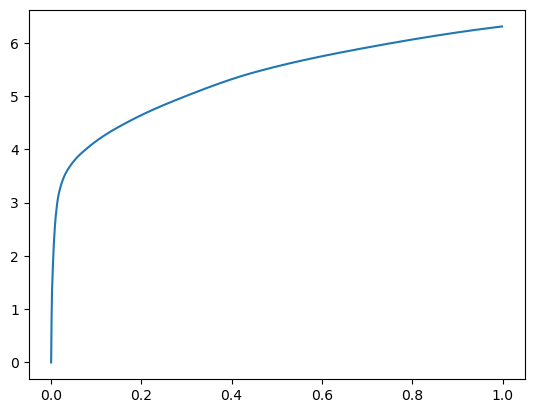

[0.00000000e+00 5.04493713e-04 1.06716156e-03 2.00748444e-03
 3.83090973e-03 6.15787506e-03 9.67884064e-03 1.65548325e-02
 3.57141495e-02 8.45384598e-02 1.67908669e-01 2.85233498e-01
 4.33732033e-01 6.65324211e-01 1.00000000e+00] betas
[0.         0.44208154 0.44667786 0.48564347 0.44677758 0.44716134
 0.42380251 0.45289312 0.49456816 0.44337122 0.42962434 0.49241386
 0.47855618 0.46080919 0.39843781] r
-22484.25291812412 score post


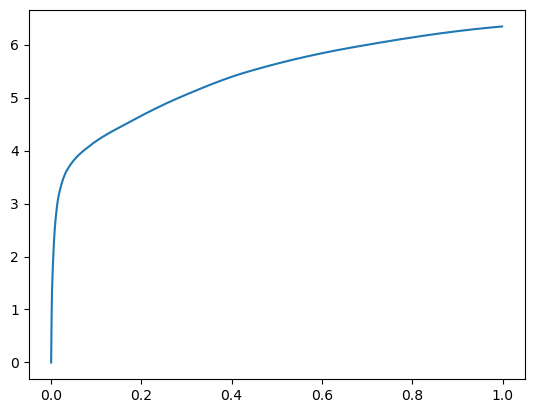

[0.00000000e+00 5.17845154e-04 1.09386444e-03 1.96552277e-03
 3.78894806e-03 6.13689423e-03 9.98020172e-03 1.72262192e-02
 3.46994400e-02 8.37278366e-02 1.71784401e-01 2.79448509e-01
 4.15839195e-01 6.30740166e-01 1.00000000e+00] betas
[0.         0.472005   0.48230244 0.43840374 0.45774655 0.39977172
 0.45262179 0.48539103 0.42707344 0.50094075 0.50789151 0.44218451
 0.42099041 0.47050876 0.46532491] r
-22482.458794922564 score post


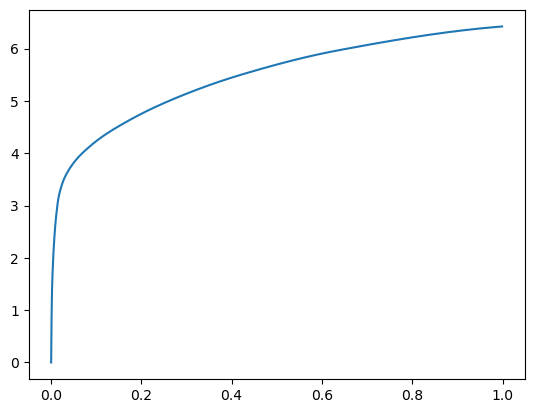

[0.00000000e+00 5.02586365e-04 1.03855133e-03 1.91974640e-03
 3.71456146e-03 6.44969940e-03 1.05562210e-02 1.78461075e-02
 3.84092331e-02 8.54444504e-02 1.64305687e-01 2.73961067e-01
 4.22892570e-01 6.34728432e-01 1.00000000e+00] betas
[0.         0.48175095 0.37977086 0.39440278 0.44244372 0.48246135
 0.53903933 0.40725259 0.48457261 0.43357989 0.44974157 0.51301939
 0.45972582 0.46655    0.4500223 ] r
-22484.55452125251 score post


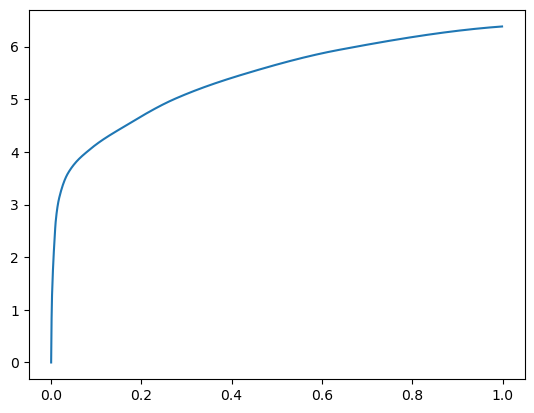

[0.00000000e+00 4.72068787e-04 1.13010406e-03 2.28786469e-03
 4.34398651e-03 7.10010529e-03 1.07584000e-02 1.97515488e-02
 4.10871506e-02 9.39397812e-02 1.76957130e-01 2.76156425e-01
 4.24635887e-01 6.31054878e-01 1.00000000e+00] betas
[0.         0.39037113 0.54086656 0.52207515 0.43536227 0.45790087
 0.41794468 0.44622611 0.37421528 0.44026561 0.45362952 0.39785537
 0.42896764 0.45366038 0.4333146 ] r
-22483.215759872455 score post


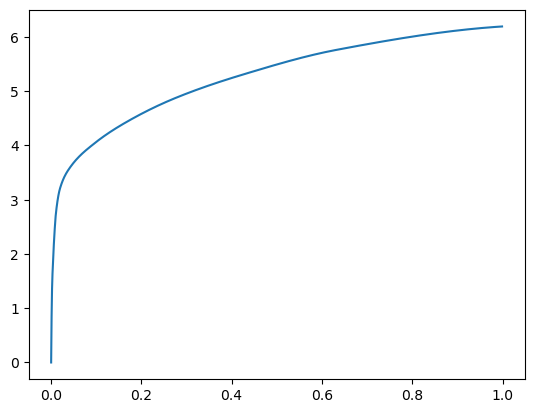

[0.00000000e+00 5.33103943e-04 1.05762482e-03 1.92356110e-03
 3.68595123e-03 6.19029999e-03 9.54341888e-03 1.65033340e-02
 3.73029709e-02 8.73308182e-02 1.65171623e-01 2.72919655e-01
 4.25555229e-01 6.25422478e-01 1.00000000e+00] betas
[0.         0.44808151 0.42830961 0.44965523 0.46325391 0.42330179
 0.43743527 0.49794973 0.47051477 0.42131128 0.45073919 0.47449114
 0.43373783 0.39045604 0.50891433] r
-22480.269231963164 score post


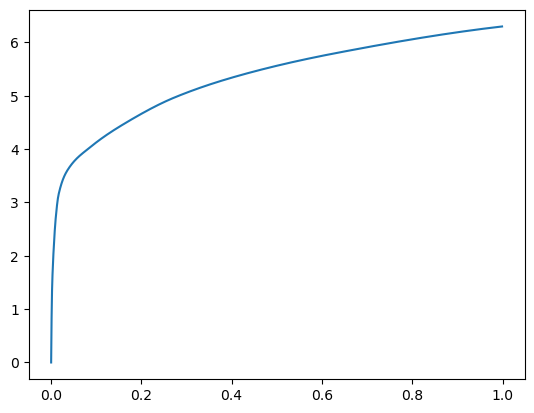

[0.00000000e+00 5.35011292e-04 1.09386444e-03 1.99031830e-03
 3.73554230e-03 6.43825531e-03 1.00641251e-02 1.65319443e-02
 3.58438492e-02 8.86297226e-02 1.66785240e-01 2.68269539e-01
 4.25398827e-01 6.61967278e-01 1.00000000e+00] betas
[0.         0.48800617 0.44683833 0.4263659  0.47159904 0.48512537
 0.4141705  0.45449192 0.47135563 0.45133472 0.45714147 0.40772667
 0.47052649 0.4763753  0.37873075] r
-22484.348661750126 score post


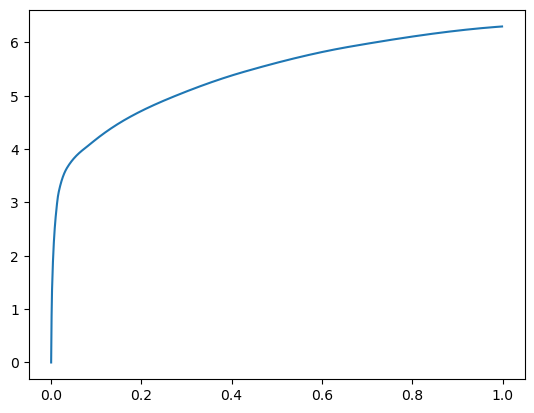

[0.00000000e+00 4.91142273e-04 1.03855133e-03 1.95980072e-03
 3.58676910e-03 5.97667694e-03 9.71126556e-03 1.57098770e-02
 3.20062637e-02 7.98692703e-02 1.53368950e-01 2.61301994e-01
 4.07534599e-01 6.17081642e-01 1.00000000e+00] betas
[0.         0.43824464 0.41720651 0.49669234 0.42652836 0.40808288
 0.48451773 0.42656814 0.49341045 0.48137179 0.41608716 0.54242876
 0.39975747 0.48225342 0.53779674] r
-22480.269231963164 score post


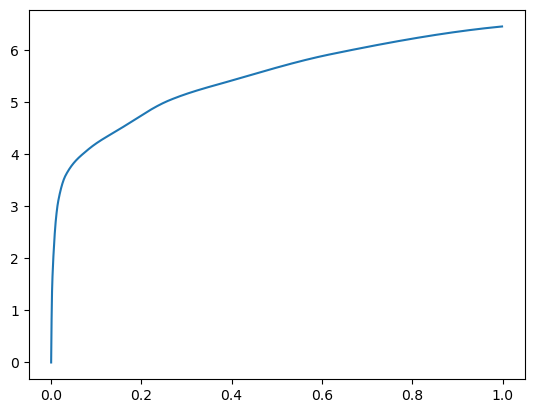

[0.00000000e+00 5.17845154e-04 1.14154816e-03 2.04372406e-03
 3.90529633e-03 6.77013397e-03 1.07431412e-02 1.87253952e-02
 3.82585526e-02 9.05561447e-02 1.75185204e-01 2.72042274e-01
 4.46635246e-01 6.60767555e-01 1.00000000e+00] betas
[0.         0.47671212 0.46004911 0.44365768 0.49428958 0.49090932
 0.43929463 0.47031024 0.44353619 0.45987141 0.46124641 0.41974846
 0.52996261 0.40845981 0.41502043] r
-22484.52742382129 score post


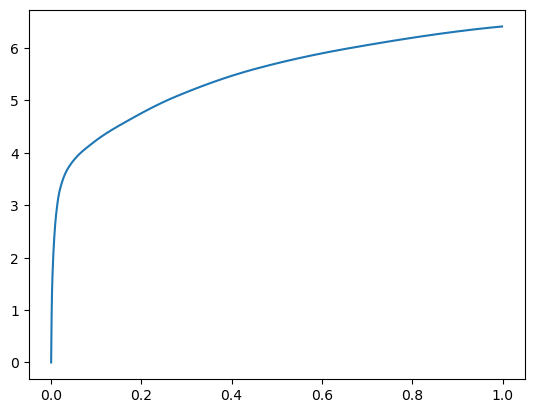

[0.00000000e+00 4.94956970e-04 1.10721588e-03 2.02655792e-03
 3.70693207e-03 6.23989105e-03 1.00831985e-02 1.70335770e-02
 3.46040726e-02 8.23068619e-02 1.62947655e-01 2.66398430e-01
 4.09808159e-01 6.33154869e-01 1.00000000e+00] betas
[0.         0.43507937 0.4593023  0.44461261 0.42451063 0.43693589
 0.47773513 0.44773855 0.42479799 0.48197578 0.41310647 0.42838324
 0.45018423 0.49617238 0.42975672] r
-22480.269231963164 score post


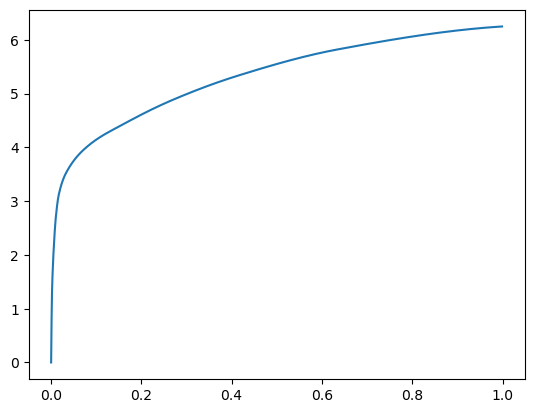

[0.00000000e+00 5.08308411e-04 1.10530853e-03 2.02846527e-03
 3.81565094e-03 6.45732880e-03 1.00889206e-02 1.70125961e-02
 3.59964371e-02 8.02278519e-02 1.67025566e-01 2.76701927e-01
 4.22396660e-01 6.22811317e-01 1.00000000e+00] betas
[0.         0.43690134 0.42536425 0.5173904  0.46223531 0.45912232
 0.42316557 0.43449833 0.44698127 0.48007948 0.48646189 0.4462674
 0.44098636 0.45717803 0.52039453] r
-22480.269231963164 score post


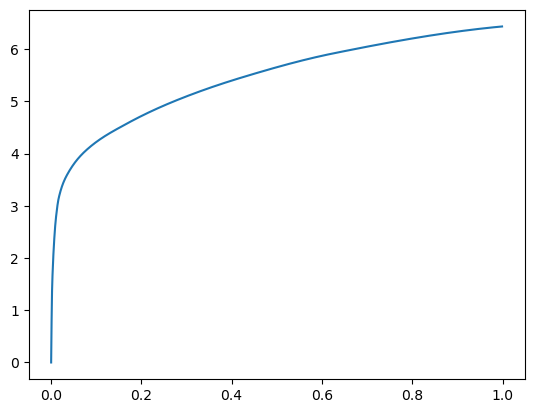

[0.00000000e+00 5.36918640e-04 1.19495392e-03 2.02846527e-03
 3.80229950e-03 6.44207001e-03 1.05047226e-02 1.87120438e-02
 4.08563614e-02 8.73022079e-02 1.72482491e-01 2.88048744e-01
 4.44697380e-01 6.57534599e-01 1.00000000e+00] betas
[0.         0.54010445 0.46466329 0.40859222 0.43396561 0.44175791
 0.47698825 0.53454682 0.43822742 0.39739856 0.43358972 0.45843663
 0.45972554 0.39747927 0.44354048] r
-22480.269231963164 score post


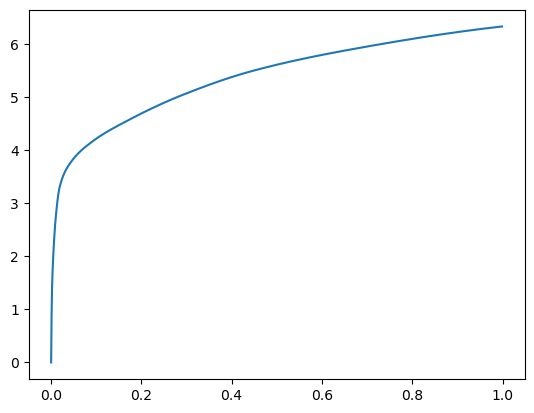

[0.00000000e+00 4.35829163e-04 1.03092194e-03 1.87587738e-03
 3.60774994e-03 6.23989105e-03 9.92107391e-03 1.58071518e-02
 3.21016312e-02 7.71379471e-02 1.61494255e-01 2.72122383e-01
 4.18768883e-01 6.52052879e-01 1.00000000e+00] betas
[0.         0.36986882 0.51003477 0.48533535 0.44140753 0.4444664
 0.4503485  0.42479852 0.45212287 0.42750785 0.46576566 0.48825777
 0.4254936  0.47486599 0.45411147] r
-22480.269231963164 score post


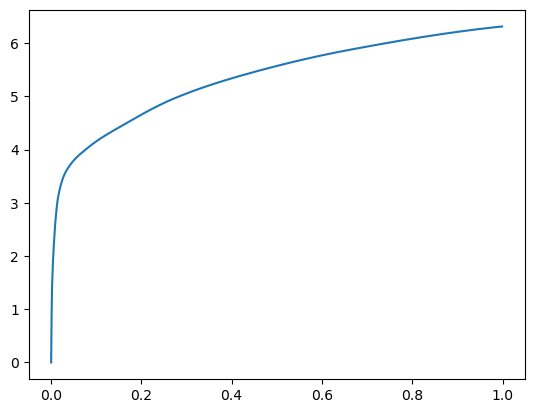

[0.00000000e+00 5.29289246e-04 1.06334686e-03 1.84345245e-03
 3.59630585e-03 6.26850128e-03 9.97257233e-03 1.65395737e-02
 3.41024399e-02 8.48321915e-02 1.69346809e-01 2.72515297e-01
 4.29949760e-01 6.53965950e-01 1.00000000e+00] betas
[0.         0.45733886 0.46665655 0.42412533 0.4679983  0.48449978
 0.49303807 0.45532377 0.42217873 0.52296331 0.47659432 0.44348744
 0.52157752 0.46951898 0.45744974] r
-22480.269231963164 score post


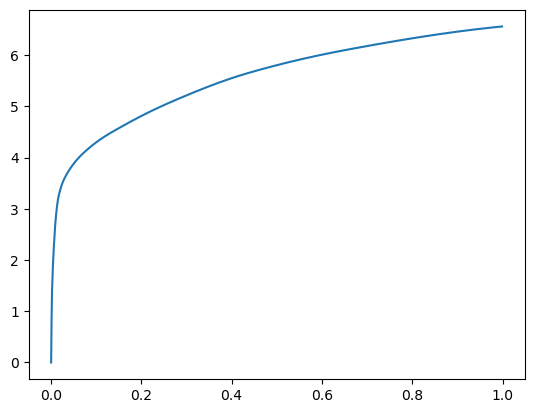

[0.00000000e+00 5.42640686e-04 1.08242035e-03 2.00557709e-03
 3.87096405e-03 6.54888153e-03 1.01747513e-02 1.74016953e-02
 3.94868851e-02 8.82005692e-02 1.72823906e-01 2.83751488e-01
 4.25925255e-01 6.47147179e-01 1.00000000e+00] betas
[0.         0.45859919 0.43952484 0.4711071  0.45974009 0.41194716
 0.46722155 0.48543259 0.46053159 0.42165575 0.44322148 0.48434364
 0.44820175 0.43489788 0.45908339] r
-22482.458794922564 score post


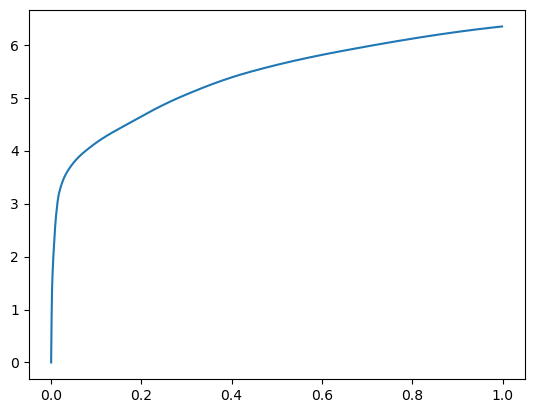

[0.00000000e+00 5.36918640e-04 1.09577179e-03 1.97887421e-03
 3.78894806e-03 6.72817230e-03 1.02987289e-02 1.68523788e-02
 3.73468399e-02 8.87250900e-02 1.75654411e-01 2.79036522e-01
 4.20903206e-01 6.50818825e-01 1.00000000e+00] betas
[0.         0.47006718 0.42723041 0.4443487  0.49706575 0.50470791
 0.40949317 0.42268203 0.45193181 0.43150649 0.44459361 0.39015282
 0.43372959 0.49155126 0.5105462 ] r
-22480.269231963164 score post


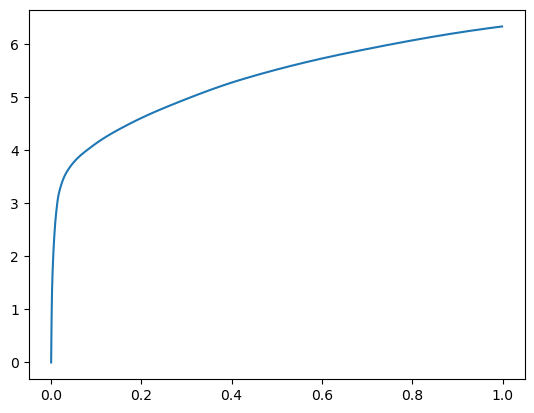

[0.00000000e+00 5.15937805e-04 1.10721588e-03 2.01892853e-03
 3.64971161e-03 6.15024567e-03 9.84859467e-03 1.65643692e-02
 3.65419388e-02 9.02738571e-02 1.79699898e-01 3.02670479e-01
 4.60434914e-01 6.84393883e-01 1.00000000e+00] betas
[0.         0.4753115  0.44654669 0.4270091  0.39999864 0.446496
 0.49156542 0.45913679 0.46049244 0.42593122 0.4681678  0.45939677
 0.45433851 0.42355026 0.37968164] r
-22487.746031937157 score post


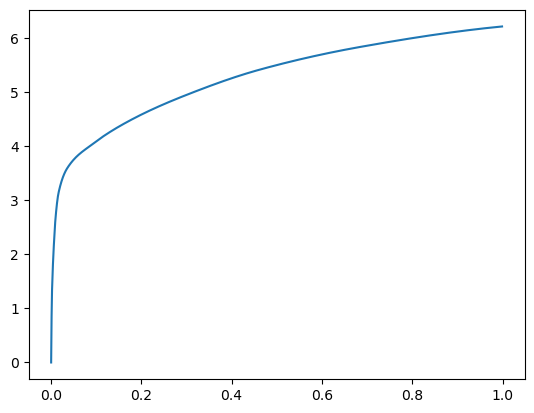

[0.00000000e+00 4.79698181e-04 1.05190277e-03 1.97124481e-03
 3.78322601e-03 6.31427765e-03 9.61971283e-03 1.56831741e-02
 3.27291489e-02 8.46147537e-02 1.66419029e-01 2.80184746e-01
 4.25961494e-01 6.43109322e-01 1.00000000e+00] betas
[0.         0.37797028 0.52530791 0.45216336 0.4568499  0.46266701
 0.40595885 0.4337392  0.47186943 0.50313626 0.46149069 0.50665601
 0.41395224 0.4319836  0.44719525] r
-22480.269231963164 score post


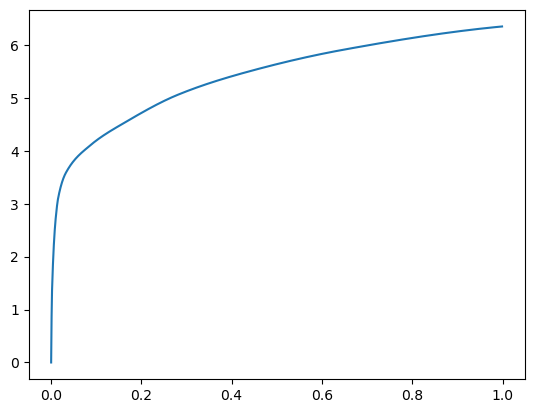

[0.00000000e+00 5.63621521e-04 1.05762482e-03 1.98650360e-03
 3.79467010e-03 6.26850128e-03 1.00660324e-02 1.71537399e-02
 3.55443954e-02 8.36610794e-02 1.63464546e-01 2.61897087e-01
 4.14210320e-01 6.39018059e-01 1.00000000e+00] betas
[0.         0.47964688 0.42540253 0.47065172 0.46229255 0.42670721
 0.46996961 0.46305189 0.46167063 0.42103749 0.40667662 0.42932854
 0.46363909 0.44816825 0.44167468] r
-22481.990460408004 score post


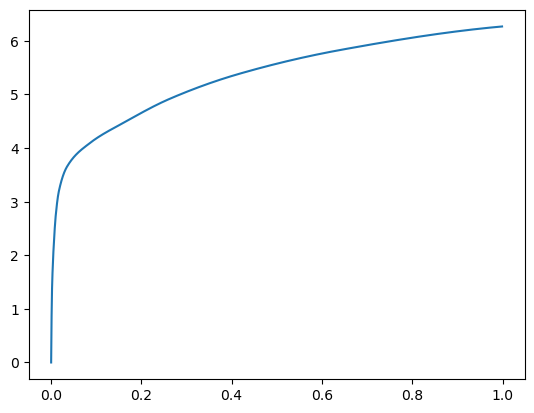

[0.00000000e+00 5.27381897e-04 1.04427338e-03 1.89876556e-03
 3.57151031e-03 6.09493256e-03 9.56249237e-03 1.57480240e-02
 3.08542252e-02 7.60259628e-02 1.61635399e-01 2.64637947e-01
 4.11820412e-01 6.35041237e-01 1.00000000e+00] betas
[0.         0.44464145 0.37993925 0.43750995 0.42576444 0.42714621
 0.44655257 0.46852856 0.4462083  0.42157    0.52217094 0.46672583
 0.42368726 0.41958753 0.43138719] r
-22480.269231963164 score post


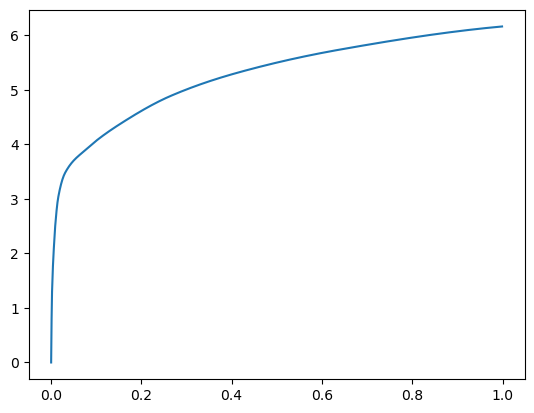

[0.00000000e+00 5.21659851e-04 1.13582611e-03 2.07042694e-03
 3.93581390e-03 6.68048859e-03 1.03883743e-02 1.69000626e-02
 3.38544846e-02 8.46109390e-02 1.58003807e-01 2.52339363e-01
 3.99365425e-01 6.29185677e-01 1.00000000e+00] betas
[0.         0.41600908 0.46444539 0.48562411 0.4728835  0.48176057
 0.45548475 0.39214911 0.39599824 0.47596399 0.43453159 0.42128772
 0.45796378 0.45603786 0.49578939] r
-22485.220960759736 score post


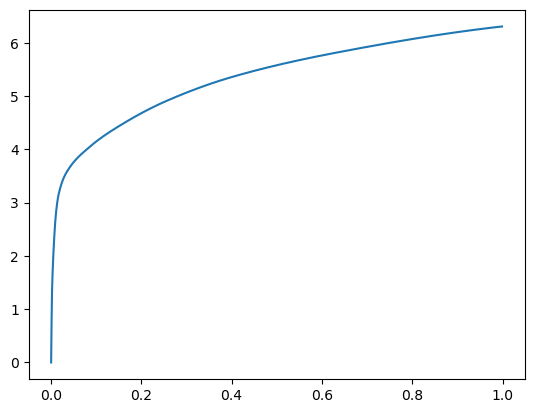

[0.00000000e+00 5.65528870e-04 1.16825104e-03 2.03037262e-03
 3.75843048e-03 6.22272491e-03 9.60826874e-03 1.64899826e-02
 3.66487503e-02 8.64572525e-02 1.63781166e-01 2.68342018e-01
 4.20516014e-01 6.57385826e-01 1.00000000e+00] betas
[0.         0.49566591 0.45991102 0.38526459 0.40588997 0.45676939
 0.44070389 0.43368241 0.43646212 0.40843054 0.47318362 0.48186148
 0.43282193 0.4117872  0.42455295] r
-22480.269231963164 score post


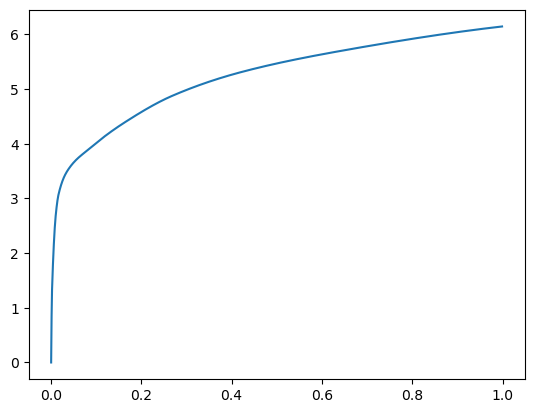

[0.00000000e+00 4.96864319e-04 1.04618073e-03 1.95789337e-03
 3.80420685e-03 6.16931915e-03 9.49954987e-03 1.63660049e-02
 3.65095139e-02 9.05656815e-02 1.62789345e-01 2.55478859e-01
 4.02073860e-01 6.47484779e-01 1.00000000e+00] betas
[0.         0.4650445  0.44718913 0.48399382 0.47960236 0.39550447
 0.39521626 0.53173208 0.50160603 0.46738959 0.42991301 0.4283849
 0.46952782 0.42765052 0.4425831 ] r
-22480.269231963164 score post


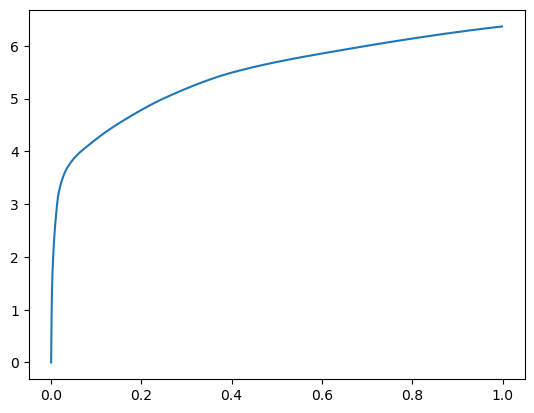

780827 steps_after
0 swaps
0 swaps
0 swaps
0 swaps
0 swaps
4426 swaps
4673 swaps
4633 swaps
2986 swaps
4651 swaps


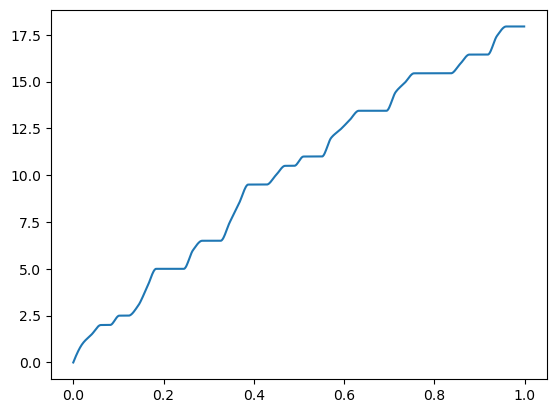

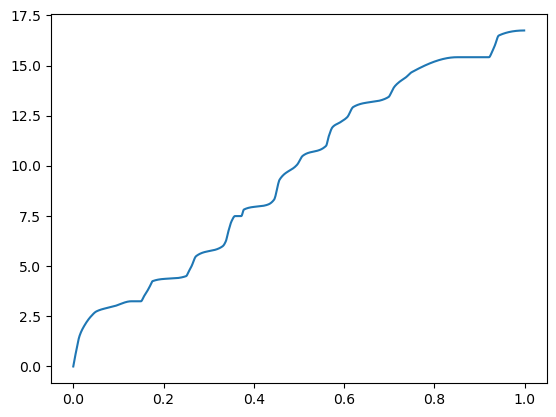

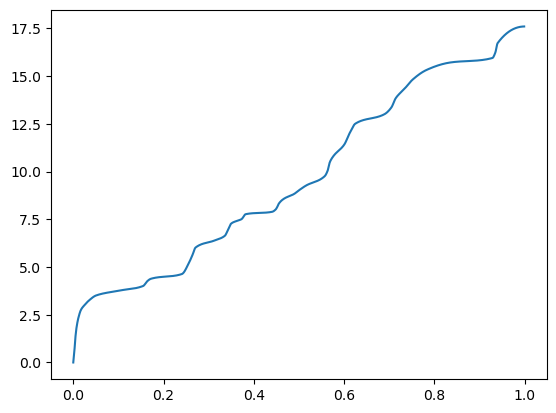

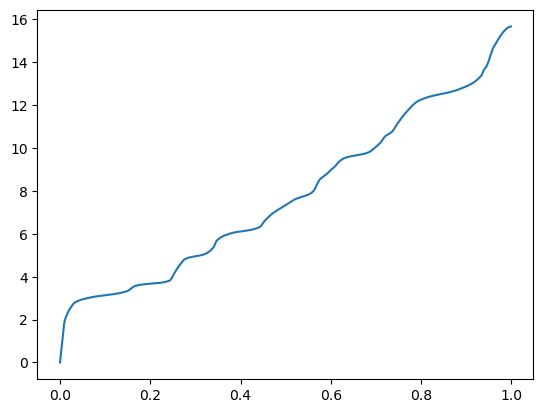

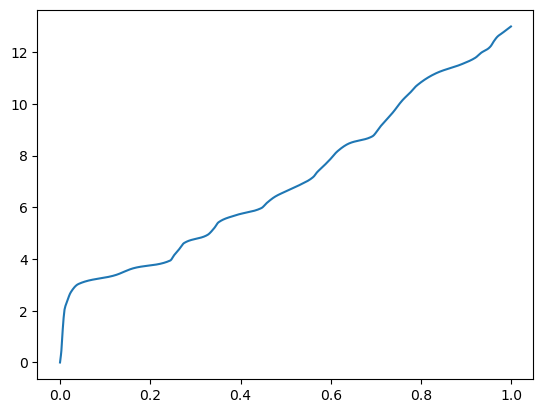

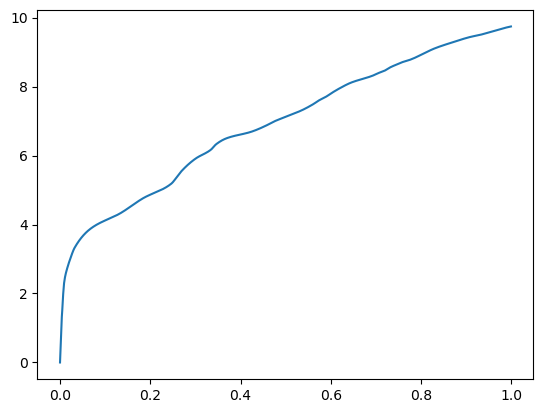

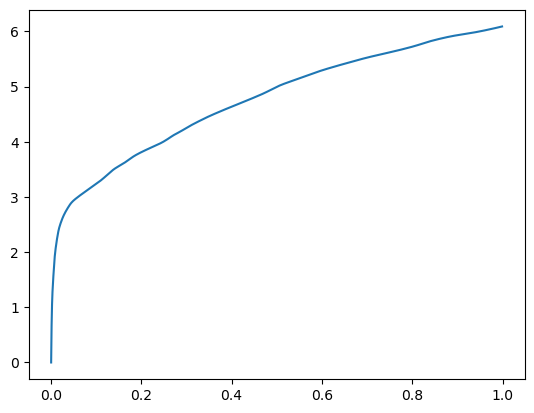

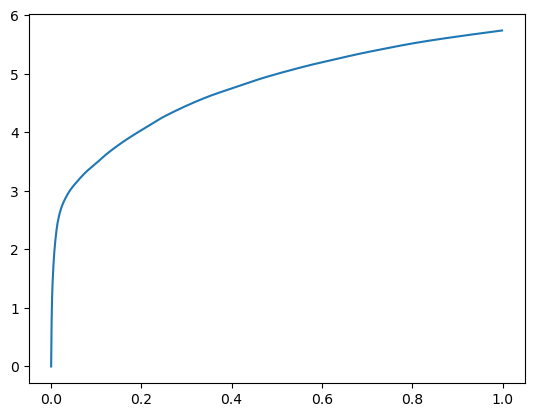

10222 steps
betas [0.00000000e+00 7.18116760e-04 2.00748444e-03 5.04589081e-03
 1.13954544e-02 3.14512253e-02 9.56487656e-02 1.96015358e-01
 3.42055321e-01 5.83571434e-01 1.00000000e+00]
n_chains 11
[0.00000000e+00 7.18116760e-04 2.00748444e-03 5.04589081e-03
 1.13954544e-02 3.14512253e-02 9.56487656e-02 1.96015358e-01
 3.42055321e-01 5.83571434e-01 1.00000000e+00] betas
[0.         0.         0.         0.04243394 0.11815446 0.
 0.         0.         0.         0.53377614 0.        ] r
-22481.378721678564 score post


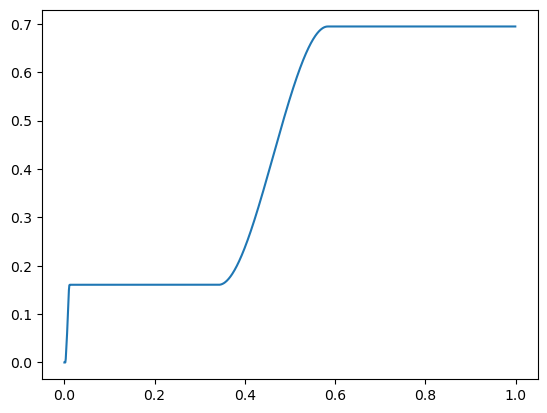

[0.         0.00640011 0.00935841 0.38657284 0.41517735 0.43825436
 0.45953655 0.48061275 0.50290012 0.52900219 1.        ] betas
[0.         0.93377711 0.28974544 0.99051995 0.0934148  0.06621938
 0.05593257 0.05209067 0.05301282 0.06115886 0.63175232] r
-22481.990460408004 score post


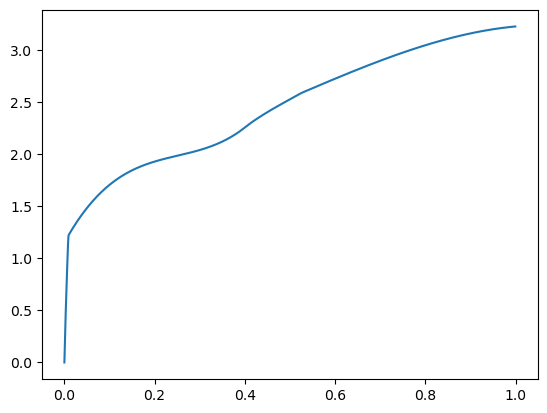

[0.         0.00191402 0.00410175 0.00669003 0.01876545 0.07651234
 0.20527363 0.40050411 0.52234745 0.7039175  1.        ] betas
[0.         0.7568792  0.3713468  0.3253521  0.5908408  0.5829303
 0.64907133 0.62044445 0.29873829 0.36190186 0.3644482 ] r
-22484.348661750126 score post


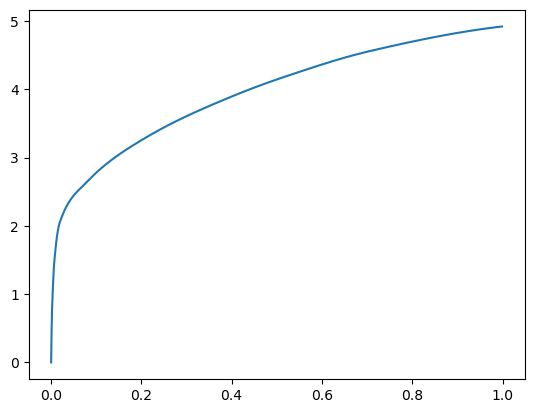

[0.         0.00108624 0.00310993 0.00698757 0.01591778 0.05194187
 0.13117123 0.25073719 0.4155798  0.63210583 1.        ] betas
[0.         0.62225048 0.5284436  0.47880855 0.49118495 0.54414925
 0.48177882 0.53960841 0.55945954 0.46267494 0.48135033] r
-22482.458794922564 score post


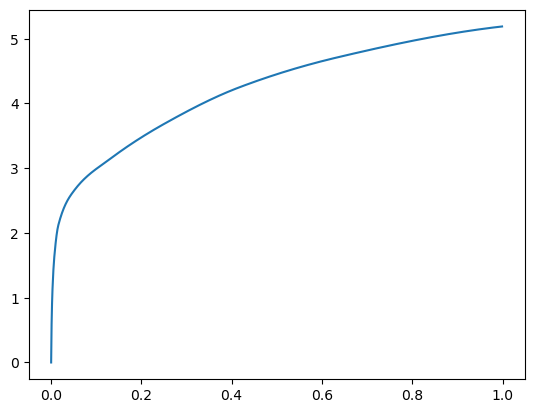

[0.00000000e+00 8.47816467e-04 2.52819061e-03 6.16359711e-03
 1.45025253e-02 4.45356369e-02 1.24787331e-01 2.37250328e-01
 3.82473946e-01 6.10018730e-01 1.00000000e+00] betas
[0.         0.59679102 0.53589289 0.50490027 0.57451766 0.48794562
 0.52084003 0.53336099 0.49424628 0.49365033 0.54171259] r
-22481.378721678564 score post


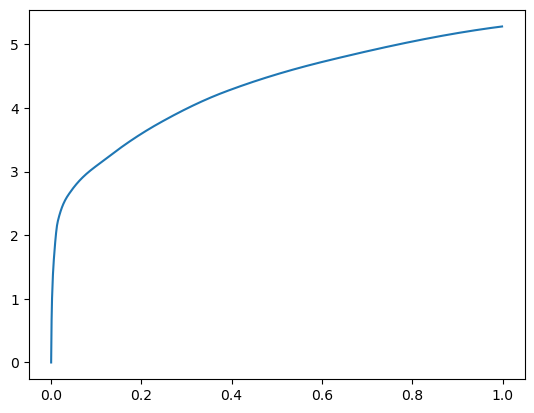

[0.00000000e+00 7.14302063e-04 2.18677521e-03 5.63907623e-03
 1.22041702e-02 3.87372971e-02 1.15397453e-01 2.23629951e-01
 3.74655724e-01 6.17753029e-01 1.00000000e+00] betas
[0.         0.45741704 0.54993542 0.5474126  0.52672121 0.57141573
 0.53613159 0.49742925 0.56887203 0.54575417 0.4784999 ] r
-22480.269231963164 score post


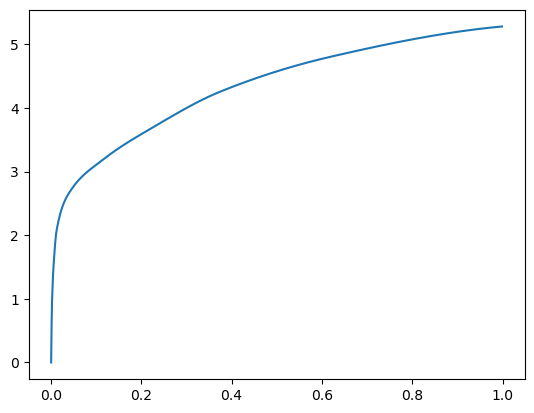

[0.00000000e+00 8.61167908e-04 2.39849091e-03 5.90419769e-03
 1.30090714e-02 3.76119614e-02 1.11550331e-01 2.25850105e-01
 3.63980293e-01 5.88852882e-01 1.00000000e+00] betas
[0.         0.48995738 0.46191469 0.47532583 0.4788637  0.50120715
 0.50658915 0.50189468 0.47984096 0.55070748 0.54104817] r
-22485.862765050628 score post


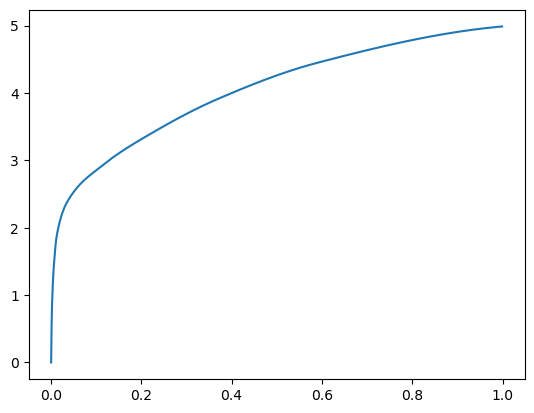

[0.00000000e+00 8.82148743e-04 2.63690948e-03 6.65950775e-03
 1.57346725e-02 4.59165573e-02 1.26549721e-01 2.45427132e-01
 3.96800041e-01 6.12986565e-01 1.00000000e+00] betas
[0.         0.57530404 0.51173144 0.48406792 0.56316834 0.50705992
 0.58250565 0.57048246 0.47670888 0.43038943 0.52527229] r
-22481.378721678564 score post


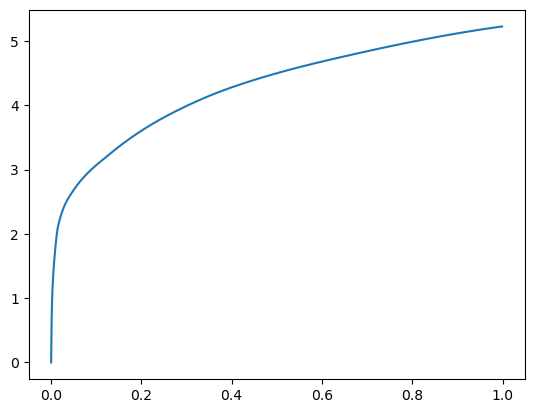

[0.00000000e+00 7.67707825e-04 2.41947174e-03 6.62326813e-03
 1.44910812e-02 4.33130264e-02 1.11340523e-01 2.12246895e-01
 3.62620354e-01 6.14571571e-01 1.00000000e+00] betas
[0.         0.57026436 0.58038449 0.53738997 0.47452712 0.48943081
 0.47070621 0.5130208  0.52023687 0.53422809 0.46652882] r
-22486.24865226613 score post


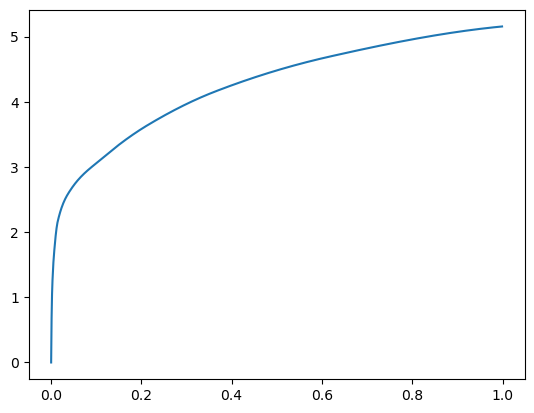

[0.00000000e+00 6.66618347e-04 1.93500519e-03 5.11264801e-03
 1.20267868e-02 3.65343094e-02 1.06417656e-01 2.06095695e-01
 3.51479530e-01 5.84517479e-01 1.00000000e+00] betas
[0.         0.42969642 0.47372905 0.50153807 0.54163894 0.50176125
 0.50977137 0.44092089 0.47143615 0.54130444 0.54277104] r
-22480.269231963164 score post


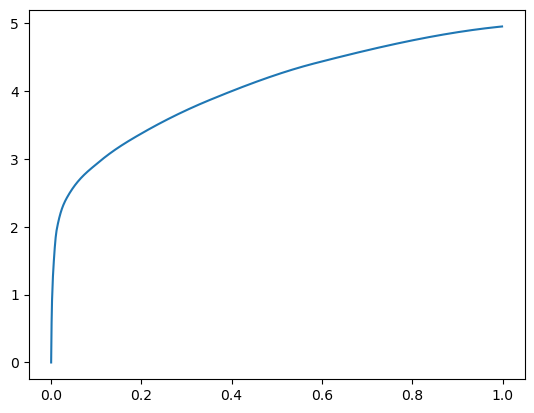

[0.00000000e+00 8.03947449e-04 2.32791901e-03 5.87368011e-03
 1.30186081e-02 3.90729904e-02 1.09051704e-01 2.24753380e-01
 3.85941505e-01 6.12269402e-01 1.00000000e+00] betas
[0.         0.55244121 0.50339987 0.52690472 0.50090213 0.53228208
 0.49833088 0.56451207 0.52515299 0.47751761 0.4312027 ] r
-22480.269231963164 score post


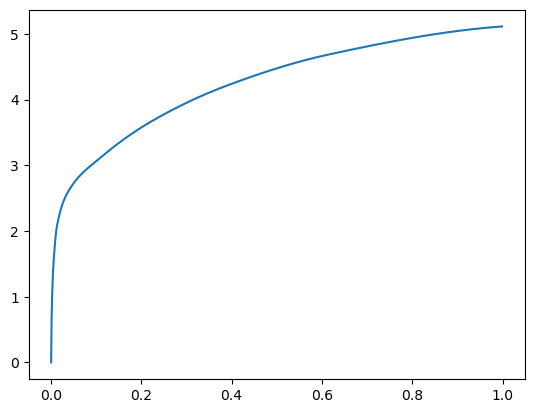

[0.00000000e+00 7.20024109e-04 2.18105316e-03 5.40256500e-03
 1.20687485e-02 3.41882706e-02 1.00880623e-01 2.00572014e-01
 3.44672203e-01 5.63759804e-01 1.00000000e+00] betas
[0.         0.53633232 0.51516868 0.51186147 0.49713897 0.53117651
 0.51767271 0.51104579 0.52717243 0.53218946 0.62318253] r
-22482.597739918583 score post


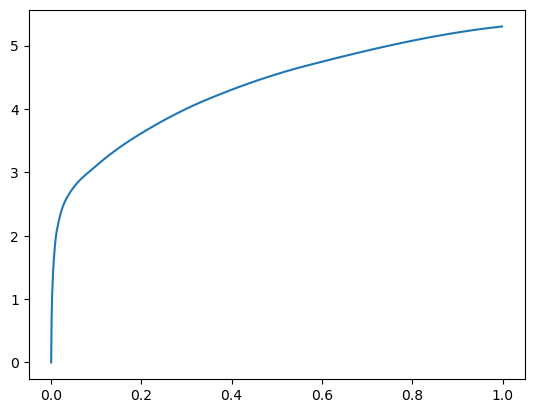

[0.00000000e+00 7.08580017e-04 2.22110748e-03 5.66577911e-03
 1.36423111e-02 3.90825272e-02 1.12771034e-01 2.22292900e-01
 3.77505302e-01 6.14581108e-01 1.00000000e+00] betas
[0.         0.51687858 0.49437212 0.48712137 0.57834027 0.52289019
 0.50222394 0.55321832 0.4756009  0.50996347 0.50150028] r
-22480.269231963164 score post


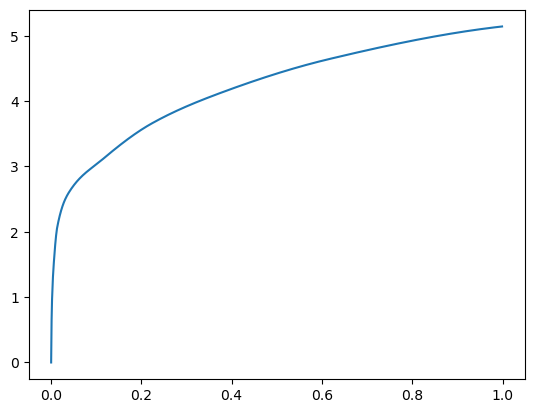

[0.00000000e+00 7.02857971e-04 2.30503082e-03 6.11209869e-03
 1.31254196e-02 3.66163254e-02 1.09900475e-01 2.08598137e-01
 3.70902061e-01 6.06982231e-01 1.00000000e+00] betas
[0.         0.46644242 0.55799694 0.55690537 0.45314718 0.46797823
 0.54179847 0.47580785 0.48592503 0.51963112 0.52218455] r
-22480.269231963164 score post


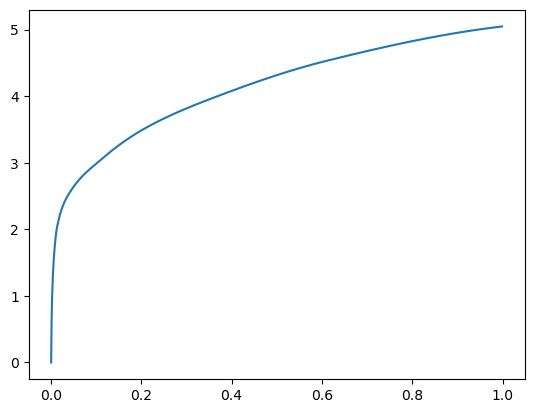

[0.00000000e+00 7.84873962e-04 2.23827362e-03 5.44071198e-03
 1.26943588e-02 3.84759903e-02 1.07239723e-01 2.12178230e-01
 3.83553505e-01 6.17299080e-01 1.00000000e+00] betas
[0.         0.50165031 0.52635888 0.49267712 0.52365185 0.53849239
 0.50050171 0.48179845 0.52626663 0.49993414 0.53190669] r
-22484.252724367707 score post


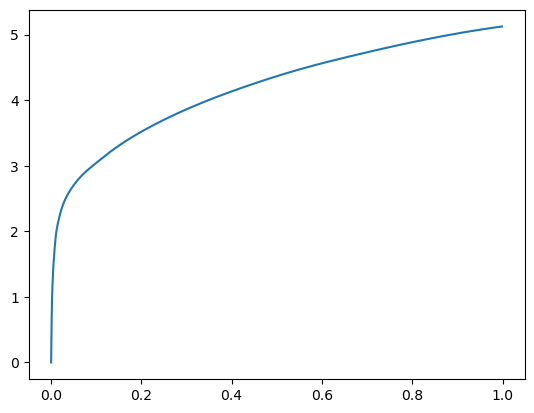

[0.00000000e+00 8.07762146e-04 2.22301483e-03 5.59902191e-03
 1.28316879e-02 3.66945267e-02 1.05589867e-01 2.17871666e-01
 3.86385918e-01 6.28760338e-01 1.00000000e+00] betas
[0.         0.54237687 0.48025296 0.48029583 0.52121438 0.56213278
 0.56353604 0.55186209 0.5315596  0.4900375  0.50130706] r
-22481.378721678564 score post


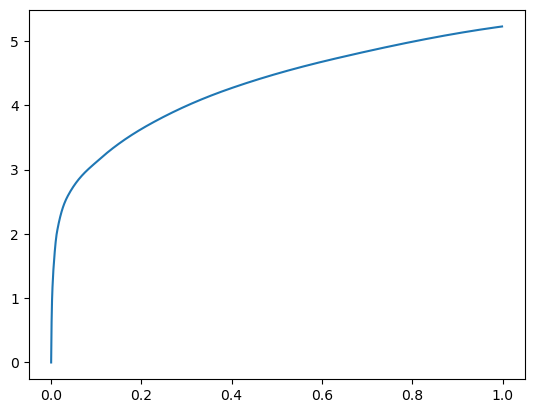

[0.00000000e+00 7.65800476e-04 2.32982635e-03 6.25896454e-03
 1.45807266e-02 3.87048721e-02 1.03171349e-01 2.06671715e-01
 3.65530968e-01 6.15998268e-01 1.00000000e+00] betas
[0.         0.52002866 0.52371248 0.52793395 0.53988531 0.44362044
 0.45982855 0.53070602 0.49868584 0.51768171 0.49333283] r
-22481.378721678564 score post


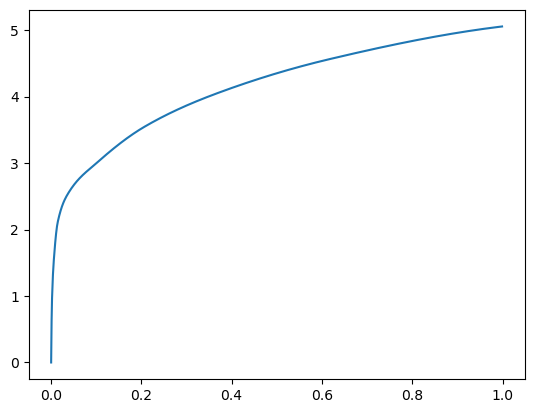

[0.00000000e+00 7.35282898e-04 2.17914581e-03 5.67531586e-03
 1.24254227e-02 3.62596512e-02 1.06200218e-01 2.04934120e-01
 3.65504265e-01 6.08481407e-01 1.00000000e+00] betas
[0.         0.51040194 0.50587786 0.53212058 0.45228372 0.49275466
 0.49514514 0.43564217 0.59145697 0.53652694 0.48836028] r
-22481.378721678564 score post


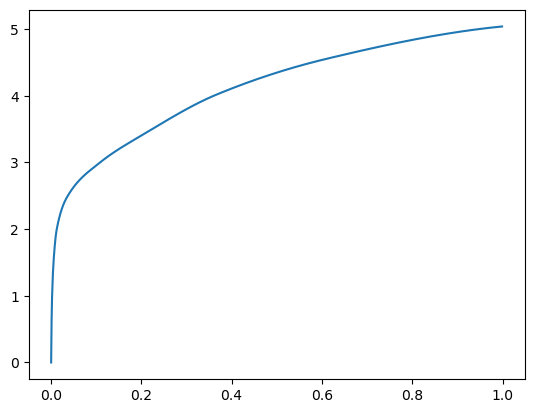

[0.00000000e+00 7.21931458e-04 2.14290619e-03 5.31673431e-03
 1.28736496e-02 3.86514664e-02 1.12833977e-01 2.30622292e-01
 3.71508598e-01 5.98975182e-01 1.00000000e+00] betas
[0.         0.50165352 0.49672469 0.46291745 0.54534615 0.56532561
 0.56842198 0.49678573 0.4487706  0.46003752 0.47073376] r
-22480.269231963164 score post


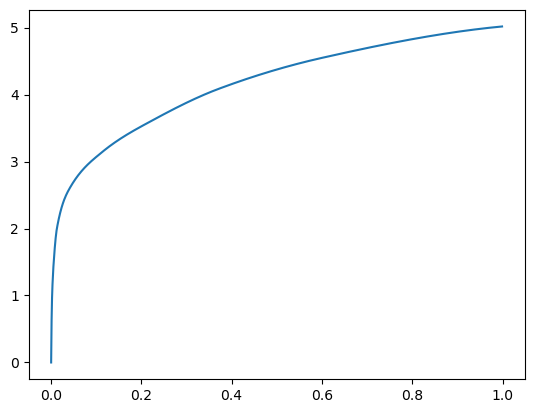

[0.00000000e+00 7.21931458e-04 2.16579437e-03 5.75542450e-03
 1.28755569e-02 3.38468552e-02 8.98332596e-02 1.96267128e-01
 3.44416618e-01 5.79224586e-01 1.00000000e+00] betas
[0.         0.50285064 0.54310053 0.52561795 0.50368103 0.47276347
 0.43235328 0.52147395 0.54791974 0.54407669 0.53325323] r
-22480.269231963164 score post


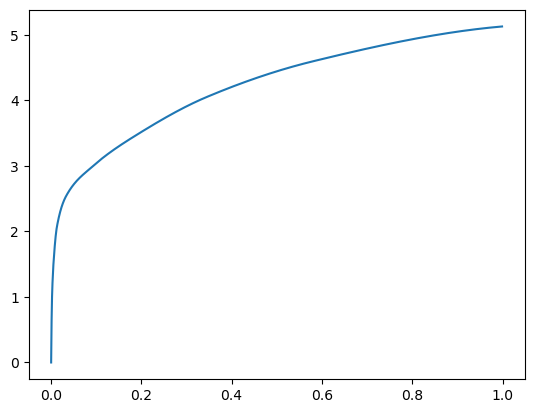

[0.00000000e+00 7.41004944e-04 2.07805634e-03 5.42354584e-03
 1.22728348e-02 3.51152420e-02 1.06163979e-01 2.17007637e-01
 3.62580299e-01 5.91450691e-01 1.00000000e+00] betas
[0.         0.53224407 0.49009627 0.50641185 0.49479411 0.54487454
 0.48531646 0.55392359 0.48600214 0.48219391 0.56915764] r
-22483.343010040644 score post


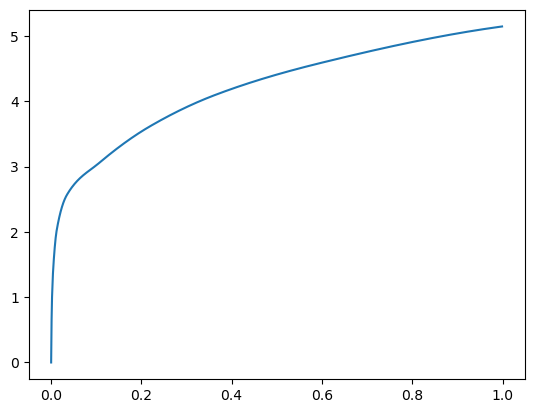

[0.00000000e+00 7.06672668e-04 2.10666656e-03 5.56850433e-03
 1.31635666e-02 3.54642868e-02 1.11899376e-01 2.15491295e-01
 3.71165276e-01 6.23692513e-01 1.00000000e+00] betas
[0.         0.48165444 0.47792711 0.47998509 0.5499422  0.47220079
 0.52298207 0.47849801 0.52657717 0.5386299  0.5107787 ] r
-22480.269231963164 score post


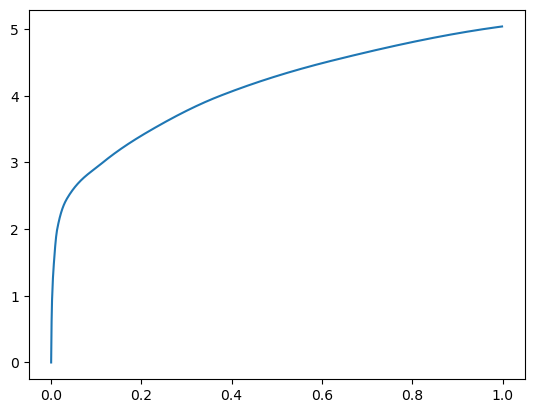

[0.00000000e+00 7.54356384e-04 2.34508514e-03 6.31046295e-03
 1.39036179e-02 4.07857895e-02 1.18973732e-01 2.31955528e-01
 3.86998177e-01 6.27772331e-01 1.00000000e+00] betas
[0.         0.51864863 0.51035678 0.50153099 0.49364452 0.45421457
 0.48316656 0.53883843 0.52228994 0.48724719 0.49075095] r
-22486.539674870928 score post


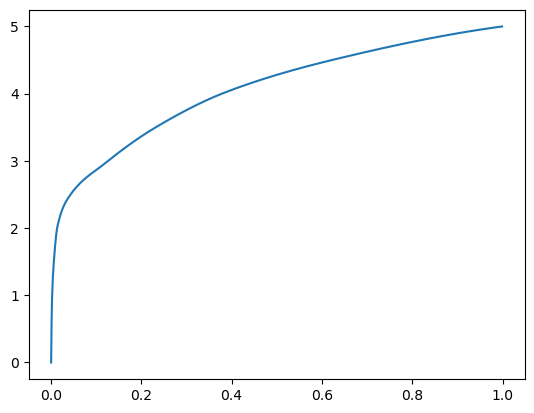

[0.00000000e+00 7.14302063e-04 2.20394135e-03 5.97286224e-03
 1.32055283e-02 4.30707932e-02 1.26179695e-01 2.31976509e-01
 3.78571510e-01 6.22046471e-01 1.00000000e+00] betas
[0.         0.50581162 0.50446858 0.50965946 0.52323672 0.58314952
 0.56372145 0.47913353 0.51459906 0.54379072 0.47191934] r
-22480.269231963164 score post


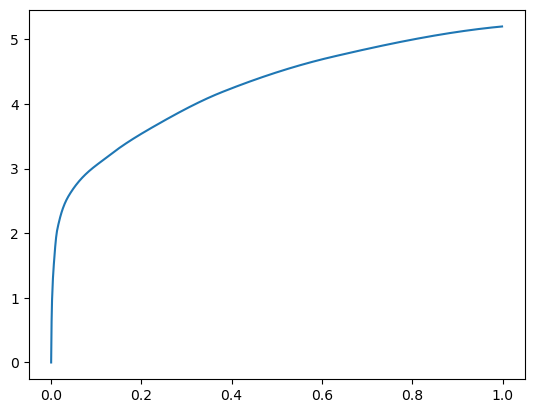

[0.00000000e+00 7.44819641e-04 2.35080719e-03 6.38675690e-03
 1.42812729e-02 4.06751633e-02 1.12923622e-01 2.24581718e-01
 3.70047569e-01 5.93947411e-01 1.00000000e+00] betas
[0.         0.51523164 0.53060649 0.55028901 0.56194332 0.4874754
 0.53472167 0.59782183 0.46827984 0.48976895 0.51144547] r
-22484.348661750126 score post


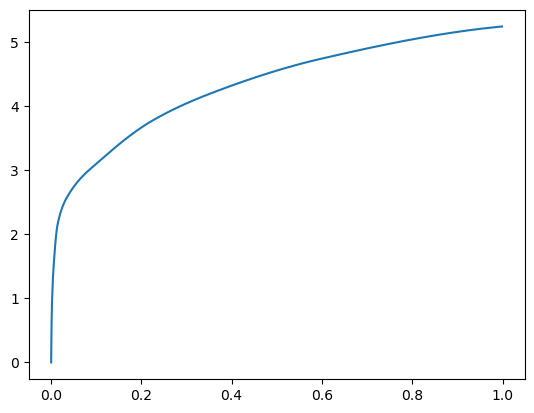

[0.00000000e+00 7.65800476e-04 2.36797333e-03 6.16168976e-03
 1.28622055e-02 3.87582779e-02 1.07790947e-01 2.00768471e-01
 3.52046013e-01 5.85946083e-01 1.00000000e+00] betas
[0.         0.56911732 0.50985456 0.5006143  0.4839402  0.57255473
 0.48561601 0.44622967 0.55317885 0.52554264 0.59096707] r
-22481.378721678564 score post


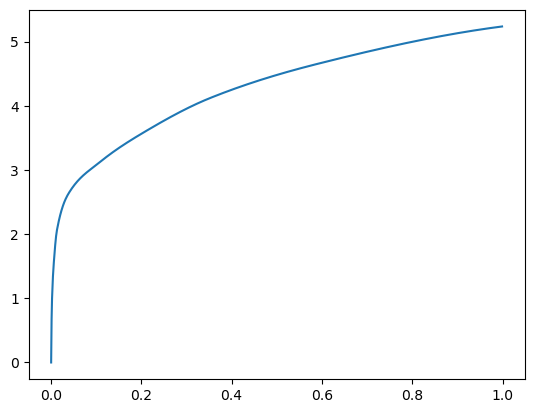

[0.00000000e+00 6.78062439e-04 2.21538544e-03 6.07585907e-03
 1.37109756e-02 3.73067856e-02 1.11447334e-01 2.24484444e-01
 3.77060890e-01 6.24047279e-01 1.00000000e+00] betas
[0.         0.46552071 0.55184154 0.54126043 0.53784343 0.46497774
 0.55380571 0.59580181 0.52875494 0.51488916 0.47574332] r
-22484.52742382129 score post


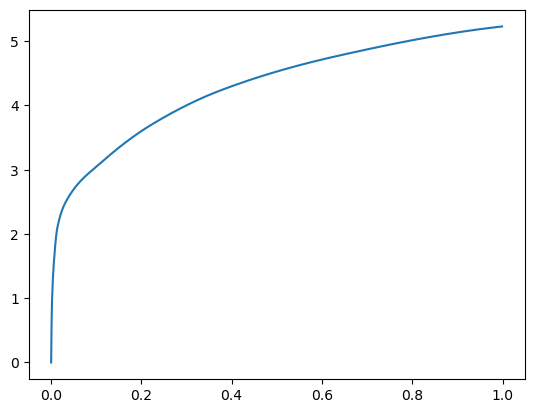

[0.00000000e+00 7.98225403e-04 2.35080719e-03 6.18457794e-03
 1.35869980e-02 4.20713425e-02 1.15143776e-01 2.13013649e-01
 3.57022285e-01 5.95362663e-01 1.00000000e+00] betas
[0.         0.52702983 0.4889587  0.51728891 0.5066924  0.49428975
 0.56691533 0.47335104 0.47866027 0.55195927 0.51249578] r
-22486.7424107292 score post


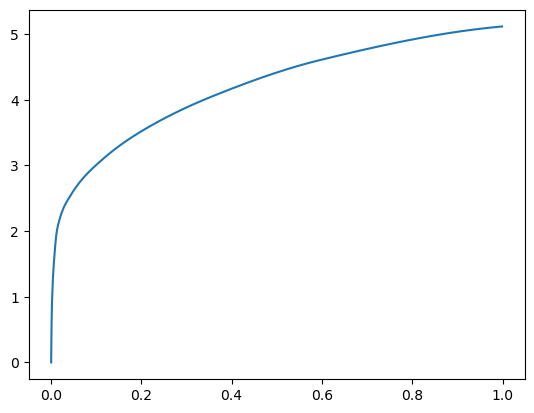

[0.00000000e+00 7.63893127e-04 2.38895416e-03 6.20555878e-03
 1.38139725e-02 4.42647934e-02 1.10066414e-01 2.14980125e-01
 3.71890068e-01 5.95797539e-01 1.00000000e+00] betas
[0.         0.53438206 0.533837   0.51423888 0.49385271 0.51548623
 0.45216037 0.52213435 0.49076001 0.49943872 0.49346578] r
-22480.269231963164 score post


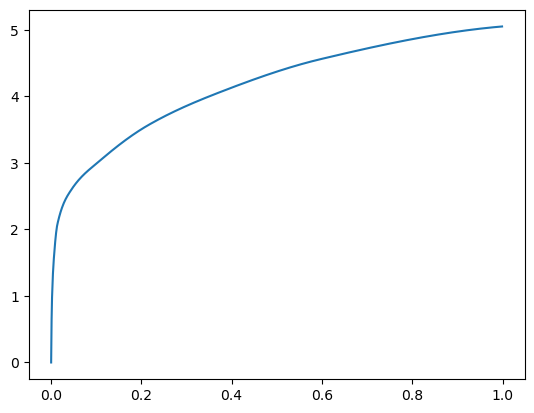

[0.00000000e+00 7.04765320e-04 2.12574005e-03 5.49983978e-03
 1.23434067e-02 3.79247665e-02 1.07632637e-01 2.07154274e-01
 3.65431786e-01 5.88816643e-01 1.00000000e+00] betas
[0.         0.45280276 0.49336079 0.52159209 0.52069508 0.50145493
 0.48217198 0.49934964 0.58145105 0.51561191 0.54080217] r
-22480.269231963164 score post


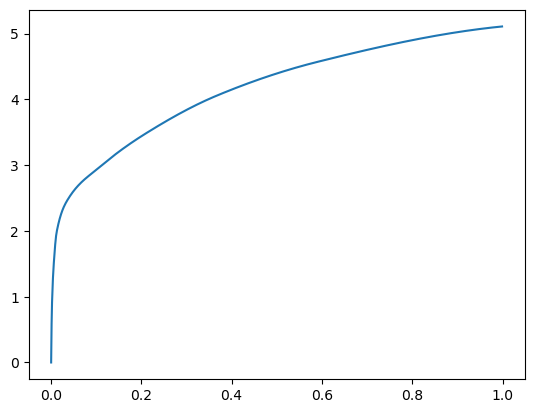

[0.00000000e+00 8.32557678e-04 2.47669220e-03 6.12354279e-03
 1.39799118e-02 4.41350937e-02 1.23997688e-01 2.32060432e-01
 3.77587318e-01 6.06240273e-01 1.00000000e+00] betas
[0.         0.54852884 0.52392605 0.54226528 0.5294035  0.50419209
 0.52904337 0.50292109 0.46191193 0.49613475 0.50788799] r
-22483.2822716802 score post


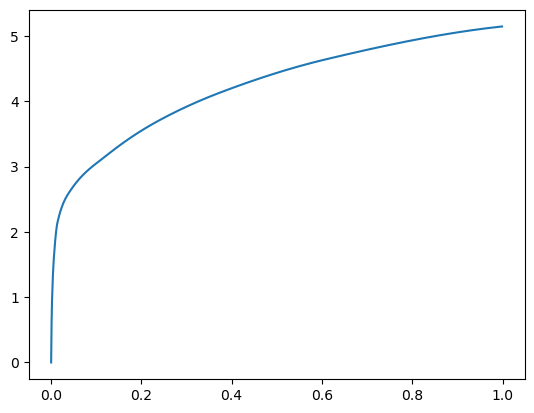

[0.00000000e+00 7.60078430e-04 2.28214264e-03 5.44834137e-03
 1.19161606e-02 3.69272232e-02 1.07235909e-01 2.12386131e-01
 3.68056297e-01 6.02196693e-01 1.00000000e+00] betas
[0.         0.56017568 0.52532456 0.50125302 0.50352299 0.5390176
 0.53200515 0.51936037 0.53320575 0.55253234 0.48734061] r
-22488.59922695803 score post


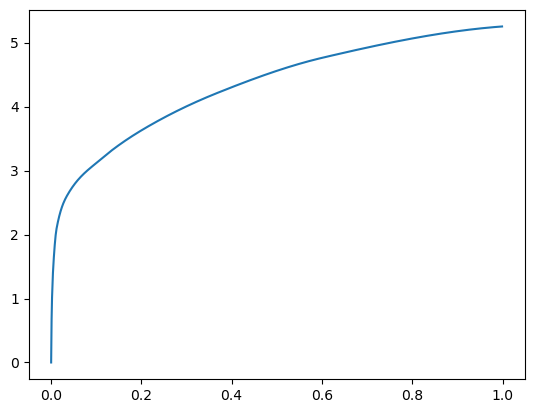

[0.00000000e+00 6.93321228e-04 2.13527679e-03 5.35106659e-03
 1.22137070e-02 3.67269516e-02 1.05734825e-01 2.11644173e-01
 3.64230156e-01 5.80378532e-01 1.00000000e+00] betas
[0.         0.49751693 0.50096982 0.45167774 0.5122969  0.45941665
 0.48070302 0.5016697  0.5730858  0.48673791 0.49095676] r
-22480.269231963164 score post


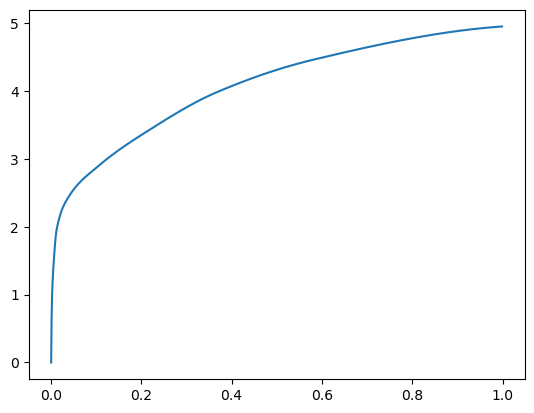

[0.00000000e+00 6.89506531e-04 2.10094452e-03 5.71346283e-03
 1.28030777e-02 4.20503616e-02 1.18426323e-01 2.26902962e-01
 3.59635353e-01 5.77542305e-01 1.00000000e+00] betas
[0.         0.42600703 0.53159305 0.50543423 0.55058341 0.53655385
 0.53947237 0.50283519 0.40258013 0.4809073  0.56671556] r
-22484.348467993714 score post


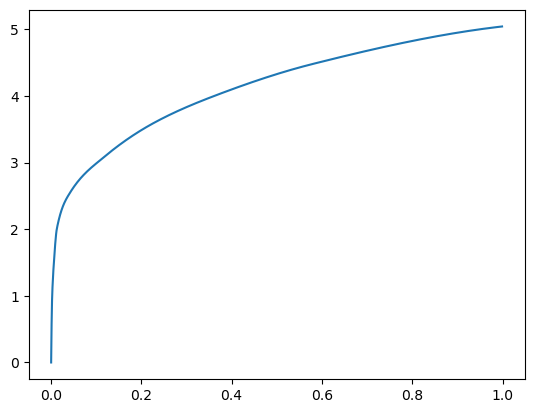

[0.00000000e+00 8.53538513e-04 2.34317780e-03 6.19983673e-03
 1.29060745e-02 3.94105911e-02 1.06911659e-01 2.10530281e-01
 3.74852180e-01 6.14348412e-01 1.00000000e+00] betas
[0.         0.53095332 0.45441665 0.49987467 0.50528157 0.5097751
 0.46452287 0.5146359  0.51518437 0.56186636 0.52229331] r
-22481.378721678564 score post


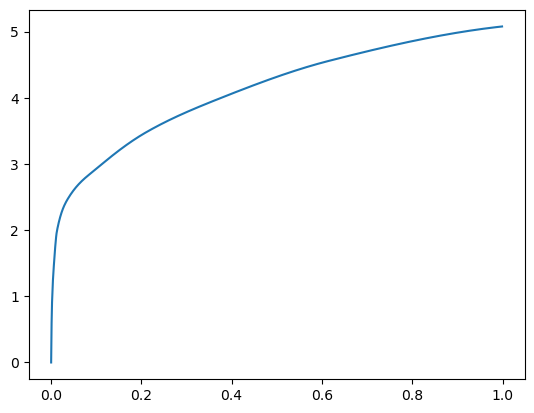

[0.00000000e+00 8.00132751e-04 2.50339508e-03 6.59465790e-03
 1.41210556e-02 4.31299210e-02 1.21283531e-01 2.30563164e-01
 4.00265694e-01 6.22584343e-01 1.00000000e+00] betas
[0.         0.54691718 0.52744855 0.55071176 0.48304257 0.47000582
 0.50650642 0.50545009 0.53050335 0.44183844 0.44061275] r
-22482.458794922564 score post


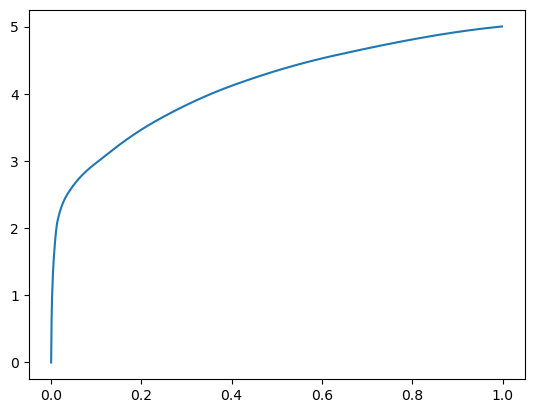

[0.00000000e+00 7.04765320e-04 2.16197968e-03 5.34725189e-03
 1.16262436e-02 3.56416702e-02 1.05574608e-01 2.08338737e-01
 3.55418205e-01 5.85005760e-01 1.00000000e+00] betas
[0.         0.49488801 0.49281426 0.50110063 0.52623698 0.58545123
 0.49683191 0.52717766 0.50064231 0.48920459 0.52273281] r
-22483.811344555204 score post


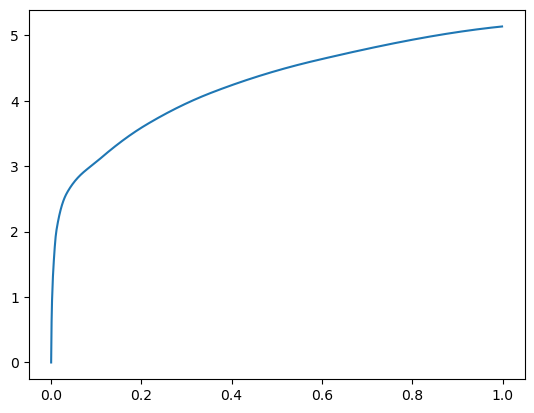

[0.00000000e+00 7.44819641e-04 2.34317780e-03 5.81455231e-03
 1.25875473e-02 3.31525803e-02 1.03028297e-01 2.01563835e-01
 3.49673271e-01 5.90573311e-01 1.00000000e+00] betas
[0.         0.48781772 0.52700489 0.46769576 0.50386919 0.46860483
 0.53938191 0.50662975 0.54753761 0.47122699 0.49229971] r
-22480.269231963164 score post


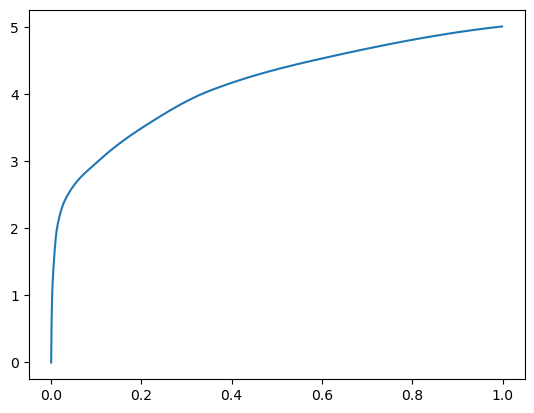

[0.00000000e+00 7.73429871e-04 2.28404999e-03 6.02817535e-03
 1.30758286e-02 3.73449326e-02 1.05099678e-01 2.03276634e-01
 3.35589409e-01 5.84734917e-01 1.00000000e+00] betas
[0.         0.48145558 0.48745471 0.53832548 0.51066427 0.47532554
 0.48393435 0.50798108 0.44609624 0.53565779 0.52502643] r
-22480.269231963164 score post


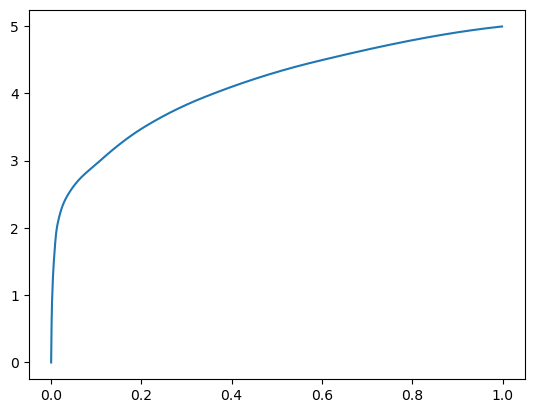

[0.00000000e+00 8.13484192e-04 2.42710114e-03 5.93090057e-03
 1.25226974e-02 3.75871658e-02 1.08078957e-01 2.05515862e-01
 3.59240532e-01 6.00676537e-01 1.00000000e+00] betas
[0.         0.50998103 0.50746484 0.51679445 0.49198806 0.54720969
 0.50747707 0.44037563 0.55748869 0.52678232 0.55374864] r
-22483.75060619476 score post


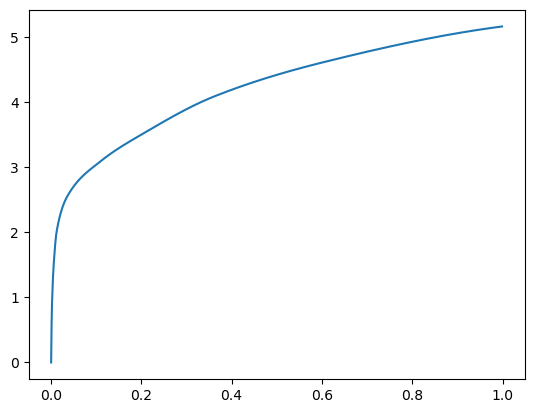

[0.00000000e+00 8.26835632e-04 2.49576569e-03 6.06441498e-03
 1.35374069e-02 3.81174088e-02 1.10711098e-01 2.27810860e-01
 3.77120018e-01 6.22706413e-01 1.00000000e+00] betas
[0.         0.53721826 0.4922612  0.49337876 0.51604185 0.43740616
 0.489765   0.591615   0.46961266 0.5266081  0.45687347] r
-22484.416026206305 score post


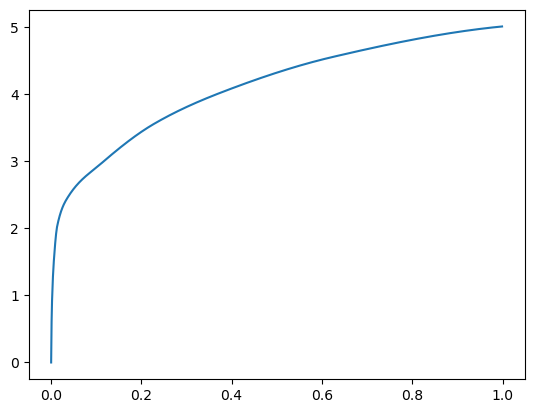

[0.00000000e+00 7.46726990e-04 2.36034393e-03 5.86223602e-03
 1.26123428e-02 4.09383774e-02 1.17657661e-01 2.15479851e-01
 3.69956017e-01 5.95948219e-01 1.00000000e+00] betas
[0.         0.52074668 0.5186018  0.52204298 0.50003505 0.48547529
 0.53077231 0.42745508 0.54309085 0.48791825 0.49861492] r
-22481.378721678564 score post


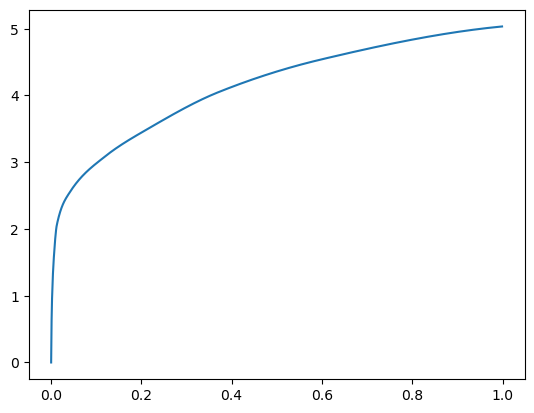

[0.00000000e+00 7.10487366e-04 2.21347809e-03 5.38539886e-03
 1.14545822e-02 3.81174088e-02 1.07062340e-01 2.20368385e-01
 3.62589836e-01 5.92946053e-01 1.00000000e+00] betas
[0.         0.51275493 0.49273477 0.47680172 0.50204772 0.57484019
 0.50217406 0.53569828 0.48176691 0.53572214 0.5455537 ] r
-22485.79106421652 score post


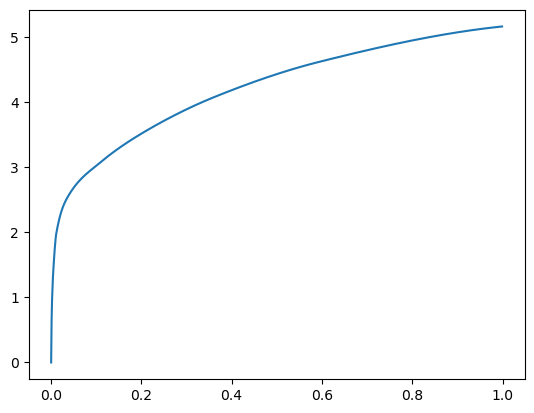

[0.00000000e+00 7.18116760e-04 2.33936310e-03 5.99002838e-03
 1.36060715e-02 3.99236679e-02 1.13089561e-01 2.24164009e-01
 3.80372047e-01 6.09965324e-01 1.00000000e+00] betas
[0.         0.50940579 0.56039954 0.52537976 0.50853133 0.51880975
 0.50766058 0.54927621 0.46631287 0.46367397 0.52487744] r
-22480.269231963164 score post


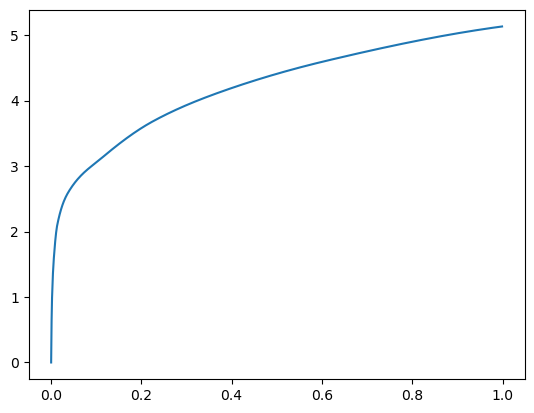

[0.00000000e+00 7.25746155e-04 2.15244293e-03 5.44071198e-03
 1.23510361e-02 3.52430344e-02 1.04311943e-01 2.03019142e-01
 3.64869118e-01 6.16942406e-01 1.00000000e+00] betas
[0.         0.47735014 0.5156362  0.52271455 0.53533069 0.47991906
 0.52025997 0.51085131 0.52922176 0.53844665 0.52319229] r
-22481.378721678564 score post


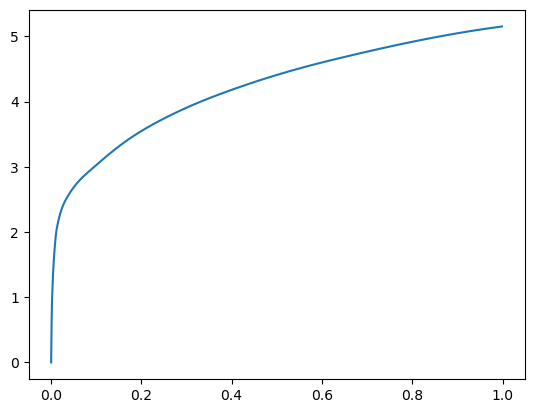

[0.00000000e+00 8.05854797e-04 2.31647491e-03 5.72109222e-03
 1.26295090e-02 3.91645432e-02 1.10917091e-01 2.14222908e-01
 3.76818657e-01 6.21619225e-01 1.00000000e+00] betas
[0.         0.5216556  0.49041174 0.50004725 0.47000159 0.53983608
 0.49746508 0.49144103 0.53772791 0.54046437 0.4771322 ] r
-22480.269231963164 score post


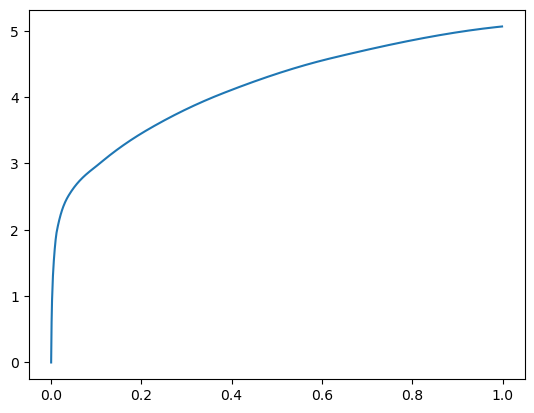

[0.00000000e+00 7.73429871e-04 2.32219696e-03 5.80120087e-03
 1.39322281e-02 4.01697159e-02 1.14497185e-01 2.23277092e-01
 3.78445625e-01 6.04111671e-01 1.00000000e+00] betas
[0.         0.52948397 0.5273878  0.5023315  0.56069633 0.49463022
 0.55310931 0.49319676 0.46529954 0.47095161 0.53389098] r
-22480.269231963164 score post


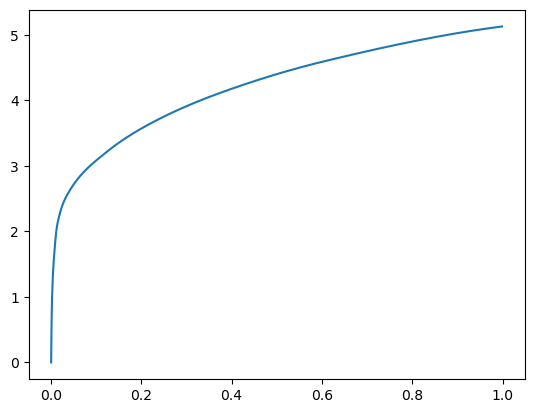

[0.00000000e+00 7.39097595e-04 2.18486786e-03 5.60092926e-03
 1.22976303e-02 3.59945297e-02 9.88759995e-02 2.04880714e-01
 3.69935036e-01 6.16595268e-01 1.00000000e+00] betas
[0.         0.47621148 0.49116167 0.48613433 0.53614776 0.5175903
 0.50038035 0.52775282 0.54867309 0.51229049 0.47055829] r
-22481.378721678564 score post


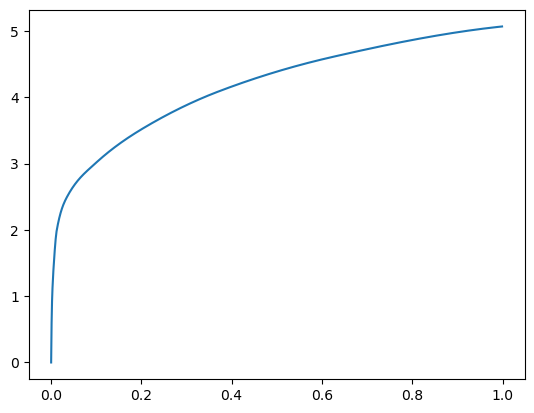

[0.00000000e+00 8.05854797e-04 2.40802765e-03 6.23798370e-03
 1.32894516e-02 3.81250381e-02 1.04147911e-01 2.07720757e-01
 3.58403206e-01 5.94244957e-01 1.00000000e+00] betas
[0.         0.52623475 0.52099692 0.52215279 0.50372336 0.50260022
 0.47296716 0.49734583 0.5850843  0.48644824 0.54569818] r
-22486.388857528957 score post


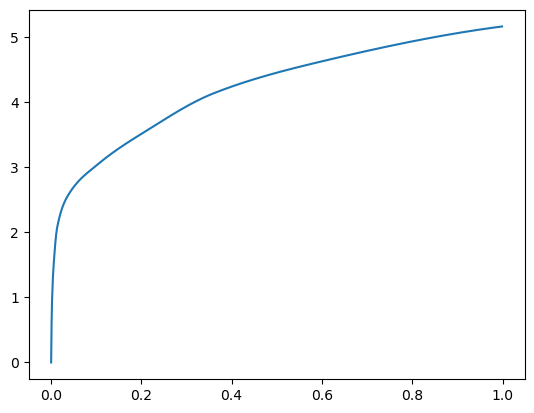

[0.00000000e+00 7.84873962e-04 2.33745575e-03 6.02817535e-03
 1.30758286e-02 3.86457443e-02 1.12782478e-01 2.23446846e-01
 3.58220100e-01 6.12034798e-01 1.00000000e+00] betas
[0.         0.5386552  0.52751668 0.52401643 0.4859243  0.50260939
 0.54076781 0.52778138 0.44412634 0.55612078 0.56723649] r
-22480.269231963164 score post


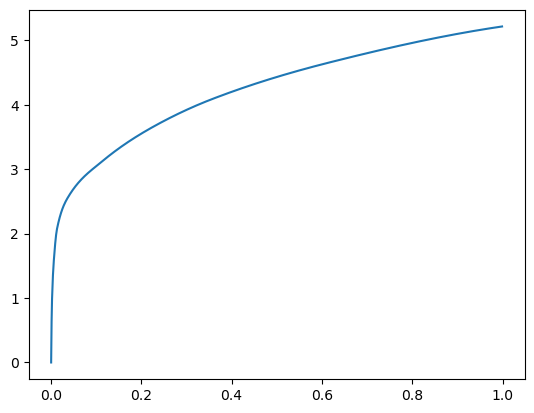

[0.00000000e+00 7.48634338e-04 2.23255157e-03 5.76496124e-03
 1.33638382e-02 4.11901474e-02 1.14388466e-01 2.24226952e-01
 3.88928413e-01 6.37959480e-01 1.00000000e+00] betas
[0.         0.51681186 0.47416222 0.50639074 0.53674544 0.55281062
 0.52289704 0.53346075 0.55120061 0.46408349 0.44164091] r
-22481.621781595804 score post


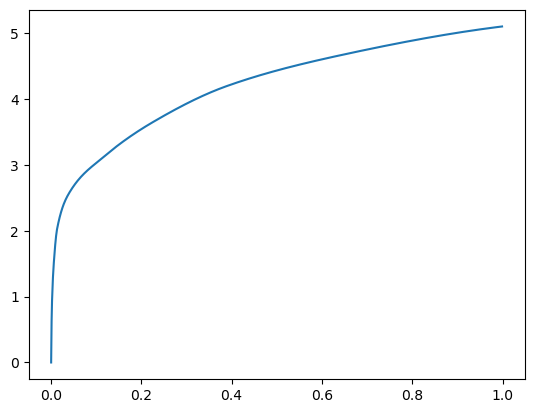

[0.00000000e+00 7.33375549e-04 2.37369537e-03 6.09874725e-03
 1.35374069e-02 3.80277634e-02 1.05683327e-01 2.06505775e-01
 3.46871376e-01 5.93253136e-01 1.00000000e+00] betas
[0.         0.5182069  0.50169574 0.4955545  0.50215762 0.5557395
 0.52417212 0.50823238 0.47927185 0.60517062 0.48525368] r
-22482.458794922564 score post


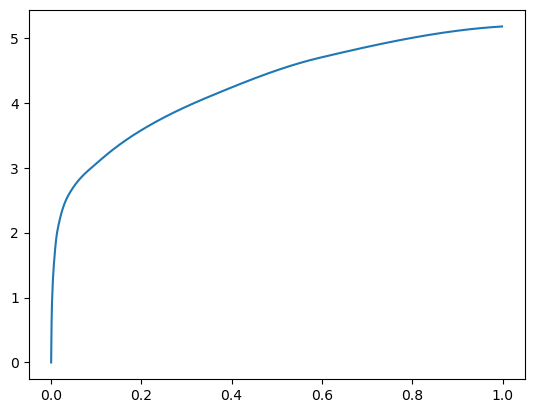

[0.00000000e+00 7.31468201e-04 2.45189667e-03 6.50310516e-03
 1.49908066e-02 3.91893387e-02 1.06938362e-01 2.10679054e-01
 3.66007805e-01 5.74677467e-01 1.00000000e+00] betas
[0.         0.49357463 0.55133055 0.49629543 0.50280347 0.47282598
 0.5237345  0.51735885 0.49891229 0.46613934 0.62586279] r
-22480.269231963164 score post


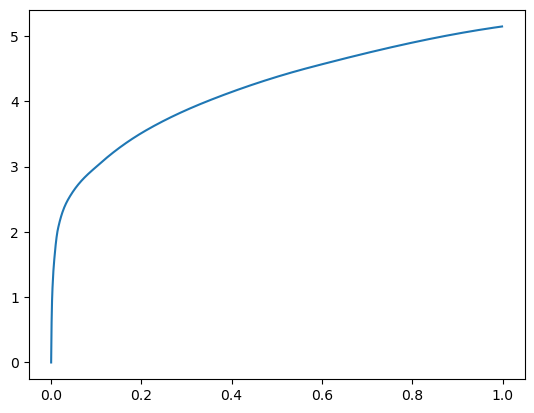

[0.00000000e+00 7.79151917e-04 2.37369537e-03 6.54506683e-03
 1.54829025e-02 4.42399979e-02 1.14987373e-01 2.22563744e-01
 3.89861107e-01 6.36776924e-01 1.00000000e+00] betas
[0.         0.4340237  0.49454058 0.54131852 0.5413265  0.4760397
 0.4545062  0.51860267 0.52165476 0.54720591 0.44502775] r
-22485.55384003957 score post


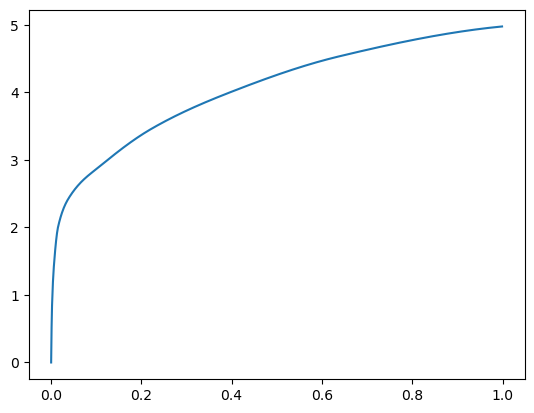

[0.00000000e+00 9.35554504e-04 2.72655487e-03 6.80637360e-03
 1.48038864e-02 4.42266464e-02 1.22733116e-01 2.28230476e-01
 3.88863564e-01 6.06055260e-01 1.00000000e+00] betas
[0.         0.55294083 0.50891992 0.53369368 0.46910825 0.49133279
 0.54895549 0.54529724 0.51066955 0.4383343  0.48625214] r
-22481.378721678564 score post


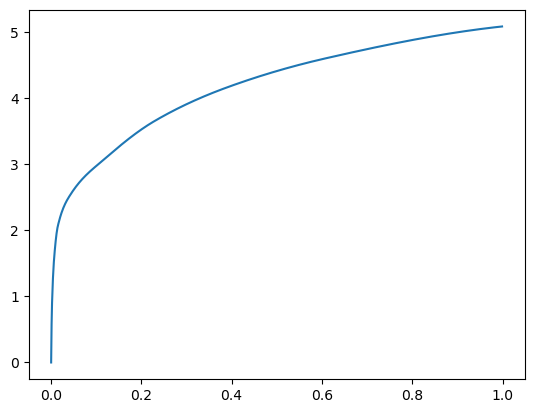

[0.00000000e+00 8.32557678e-04 2.50148773e-03 6.04152679e-03
 1.38788223e-02 4.29677963e-02 1.13556862e-01 2.07163811e-01
 3.53585243e-01 5.92080116e-01 1.00000000e+00] betas
[0.         0.53033624 0.50469065 0.50611131 0.49895361 0.49990552
 0.49892264 0.44857343 0.48685635 0.57373953 0.5851208 ] r
-22480.269231963164 score post


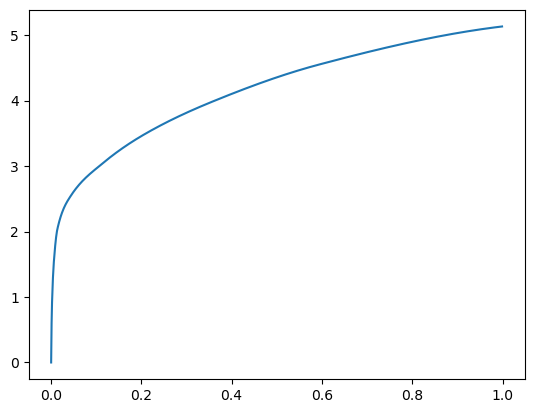

[0.00000000e+00 7.94410706e-04 2.46143341e-03 6.02817535e-03
 1.43175125e-02 4.55198288e-02 1.20779991e-01 2.34765053e-01
 4.01377678e-01 6.31594658e-01 1.00000000e+00] betas
[0.         0.51175829 0.51302498 0.53442161 0.53662476 0.50442926
 0.4882196  0.50045662 0.56976268 0.50054285 0.45622174] r
-22481.378721678564 score post


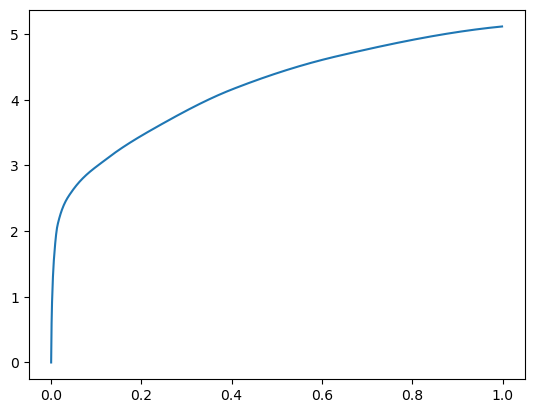

[0.00000000e+00 7.94410706e-04 2.45380402e-03 5.78022003e-03
 1.29327774e-02 4.12263870e-02 1.17131233e-01 2.32672691e-01
 3.77909660e-01 5.98998070e-01 1.00000000e+00] betas
[0.         0.52979732 0.51144446 0.47079981 0.50554164 0.49785235
 0.50034795 0.57745546 0.50933695 0.48073624 0.50899464] r
-22482.458794922564 score post


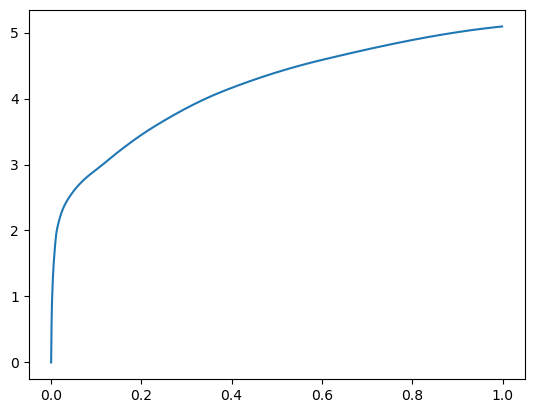

[0.00000000e+00 7.50541687e-04 2.34317780e-03 5.94043732e-03
 1.35450363e-02 4.42838669e-02 1.24077797e-01 2.25865364e-01
 3.67621422e-01 5.98855019e-01 1.00000000e+00] betas
[0.         0.52198975 0.56833209 0.4664857  0.50667858 0.52840336
 0.51283105 0.44939616 0.52580957 0.49401049 0.5075044 ] r
-22481.990460408004 score post


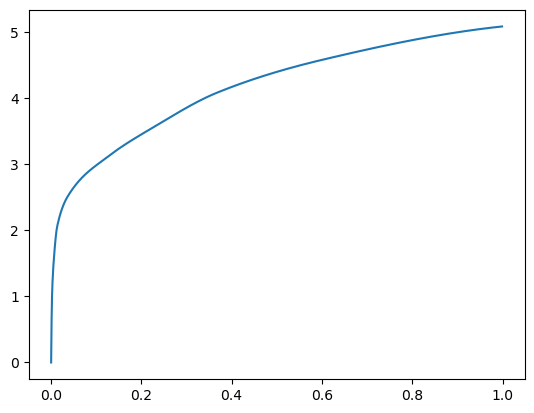

[0.00000000e+00 7.23838806e-04 2.03037262e-03 5.58948517e-03
 1.26886368e-02 3.93095016e-02 1.13215446e-01 2.26578712e-01
 3.62395287e-01 5.98462105e-01 1.00000000e+00] betas
[0.         0.49063145 0.46628979 0.52201618 0.51530183 0.58163154
 0.53453425 0.52734449 0.44535729 0.55441448 0.51287846] r
-22481.378721678564 score post


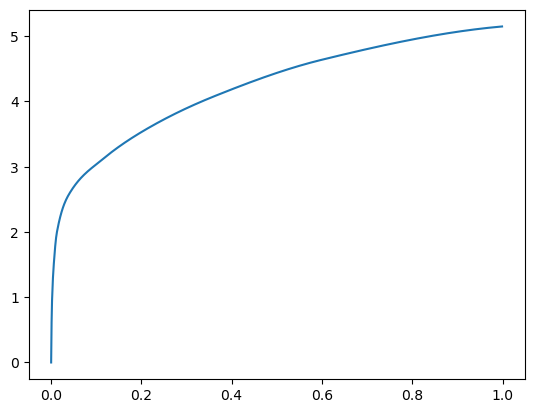

[0.00000000e+00 7.75337219e-04 2.37560272e-03 6.25896454e-03
 1.45177841e-02 3.92522812e-02 1.09665871e-01 2.18258858e-01
 3.75851631e-01 5.97191811e-01 1.00000000e+00] betas
[0.         0.53020259 0.52293607 0.55345601 0.51674968 0.49199469
 0.53763484 0.51129526 0.50209853 0.4716027  0.5611893 ] r
-22480.269231963164 score post


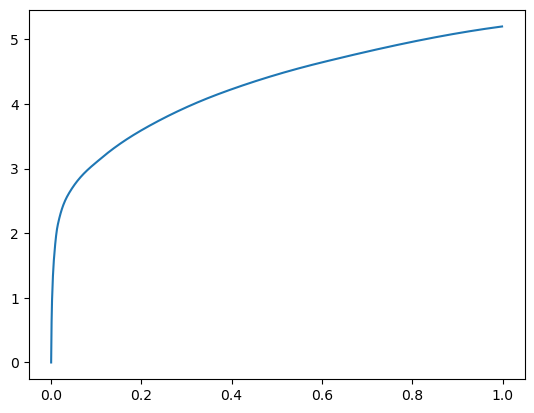

[0.00000000e+00 7.54356384e-04 2.31266022e-03 5.77068329e-03
 1.33466721e-02 3.79438400e-02 1.03966713e-01 2.11848259e-01
 3.73135567e-01 6.21350288e-01 1.00000000e+00] betas
[0.         0.48373493 0.5183166  0.49284184 0.52497515 0.52280281
 0.47688615 0.51620575 0.45904059 0.60276484 0.50731624] r
-22484.556296744664 score post


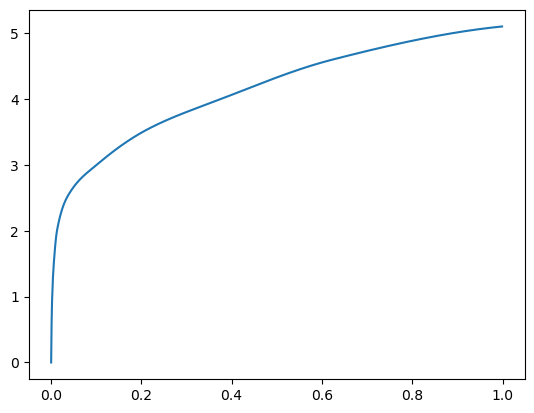

[0.00000000e+00 8.13484192e-04 2.40421295e-03 6.15024567e-03
 1.39703751e-02 3.87887955e-02 1.11466408e-01 2.22476006e-01
 4.06619072e-01 6.19557381e-01 1.00000000e+00] betas
[0.         0.51699208 0.51910851 0.54159386 0.53081739 0.46507264
 0.53864647 0.56170186 0.55328988 0.41136349 0.46599301] r
-22480.269231963164 score post


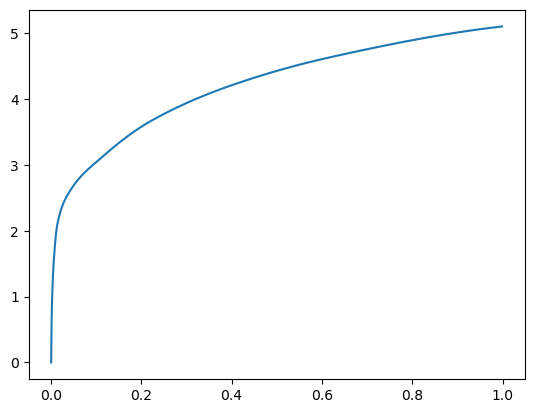

[0.00000000e+00 7.98225403e-04 2.33364105e-03 5.68866730e-03
 1.23453140e-02 3.69405746e-02 1.03178978e-01 1.98180199e-01
 3.49612236e-01 5.91427803e-01 1.00000000e+00] betas
[0.         0.51675297 0.53892639 0.50097882 0.51795445 0.47786108
 0.44608861 0.48301323 0.5510648  0.50956679 0.51825038] r
-22480.269231963164 score post


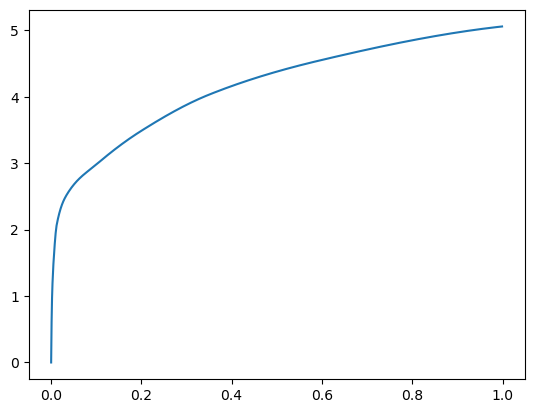

[0.00000000e+00 7.75337219e-04 2.15053558e-03 5.33199310e-03
 1.12104416e-02 3.49149704e-02 1.09688759e-01 2.12452888e-01
 3.55422020e-01 5.98986626e-01 1.00000000e+00] betas
[0.         0.53055293 0.47238195 0.45071204 0.47828626 0.5570067
 0.54279287 0.51159803 0.47771979 0.49526081 0.50177439] r
-22481.378721678564 score post


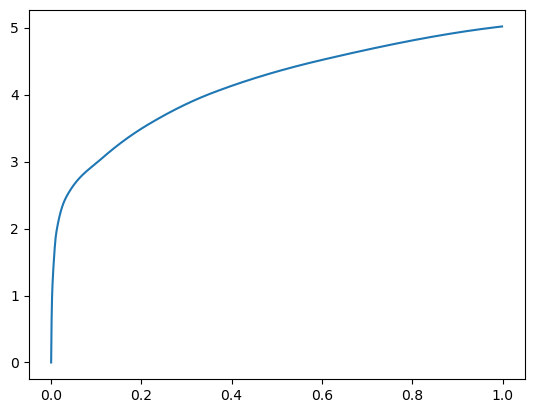

[0.00000000e+00 7.16209412e-04 2.15435028e-03 5.82408905e-03
 1.31349564e-02 3.65877151e-02 1.06125832e-01 2.04985619e-01
 3.52887154e-01 5.98965645e-01 1.00000000e+00] betas
[0.         0.46540063 0.47971484 0.51818318 0.52927325 0.51402253
 0.52728202 0.45363569 0.50534512 0.49230572 0.49126175] r
-22487.07183792021 score post


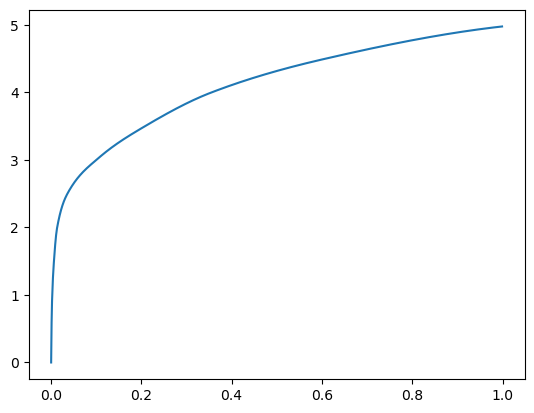

[0.00000000e+00 7.86781311e-04 2.40039825e-03 6.12545013e-03
 1.30815506e-02 3.51209641e-02 9.77144241e-02 2.03970909e-01
 3.48404884e-01 5.94861031e-01 1.00000000e+00] betas
[0.         0.5175965  0.51083767 0.50324604 0.49755927 0.49102199
 0.50594634 0.54238442 0.52317    0.51428097 0.53384148] r
-22481.378721678564 score post


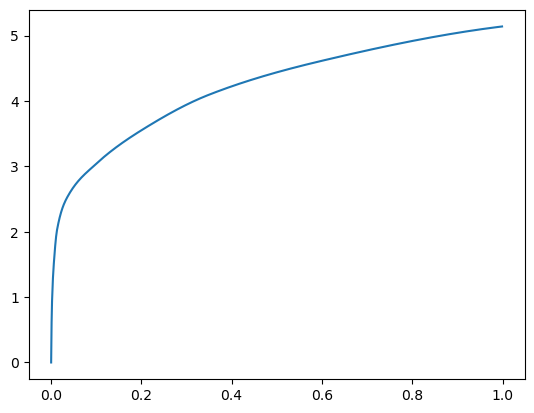

487835 steps_after


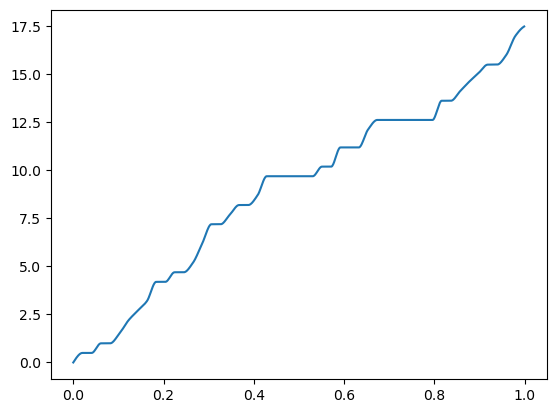

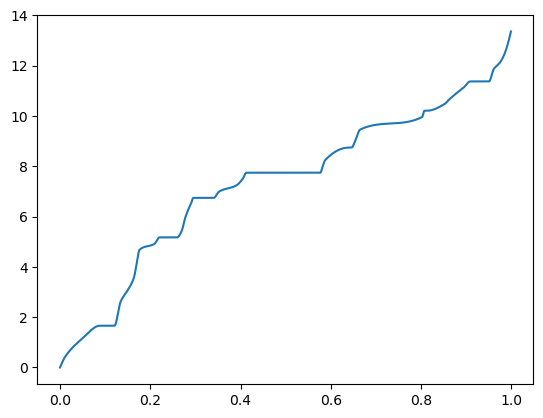

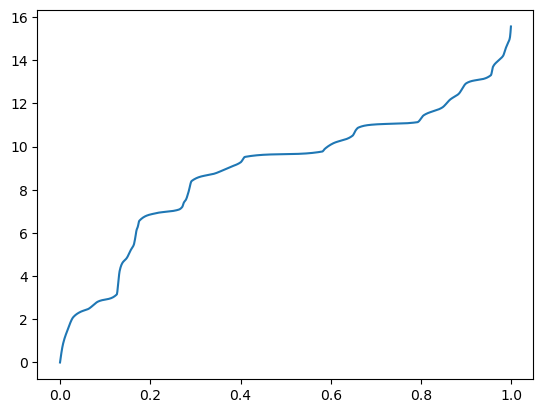

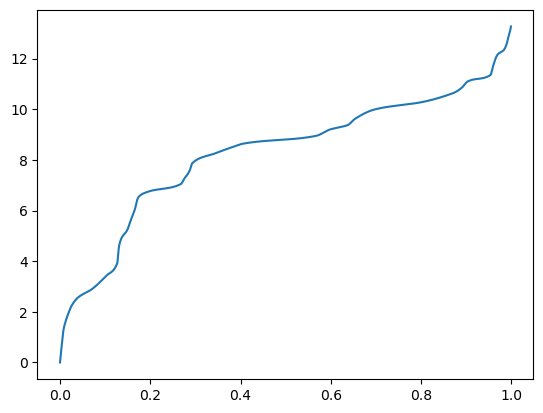

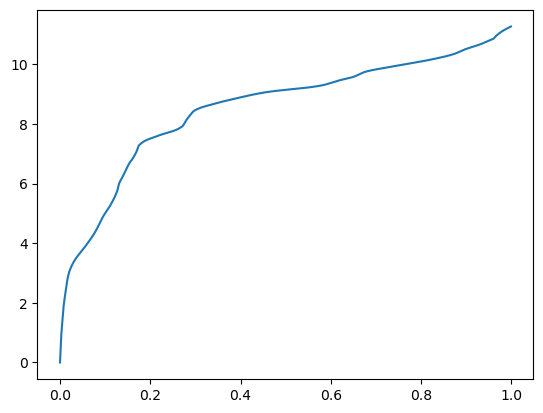

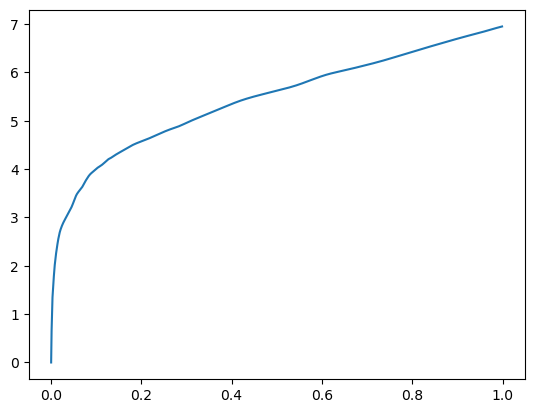

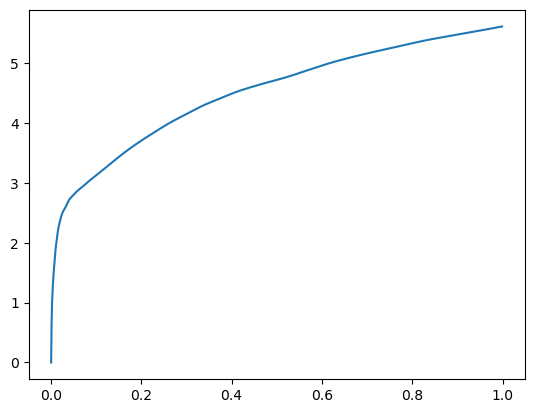

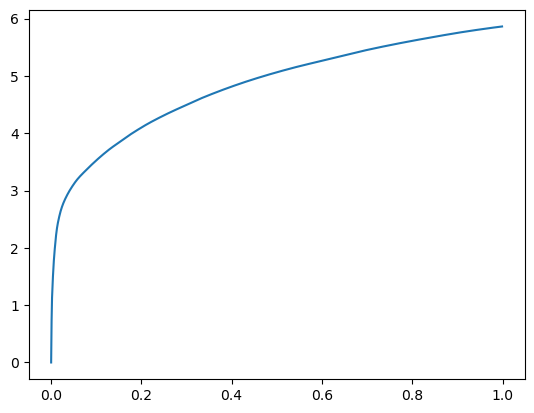

10715 steps
betas [0.00000000e+00 7.58171082e-04 2.16579437e-03 5.82981110e-03
 1.29766464e-02 3.61356735e-02 9.89427567e-02 2.01064110e-01
 3.58132362e-01 6.05956078e-01 1.00000000e+00]
n_chains 11
[0.00000000e+00 7.58171082e-04 2.16579437e-03 5.82981110e-03
 1.29766464e-02 3.61356735e-02 9.89427567e-02 2.01064110e-01
 3.58132362e-01 6.05956078e-01 1.00000000e+00] betas
[0.         0.00963247 0.01398441 0.02085054 0.         0.08037049
 0.         0.59746677 0.40433885 0.         0.        ] r
-22483.2822716802 score post


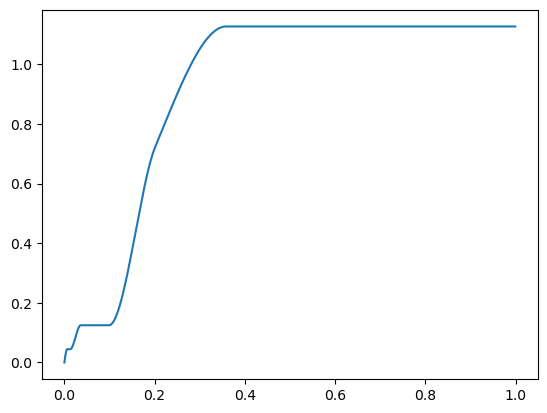

[0.         0.03044415 0.1287756  0.14501476 0.15930462 0.17378521
 0.19100285 0.21899891 0.25013065 0.28563595 1.        ] betas
[0.         0.97695876 0.68355448 0.09434616 0.07739061 0.07655071
 0.08530586 0.12918157 0.13401076 0.13516388 0.91409694] r
-22483.17300509828 score post


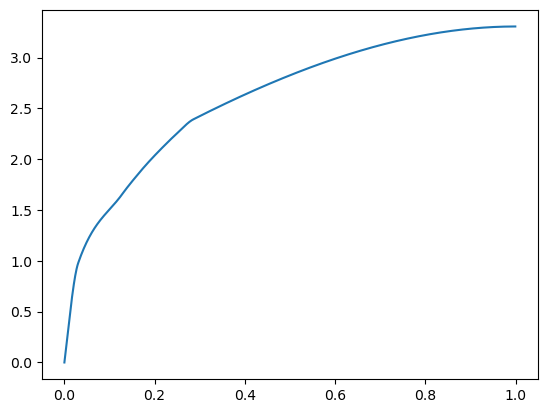

[0.         0.00846958 0.01746464 0.03162098 0.0669241  0.12759876
 0.1888895  0.26356411 0.40408611 0.59074306 1.        ] betas
[0.         0.94614696 0.52143072 0.33886474 0.36906998 0.39430679
 0.31007686 0.31999693 0.42919557 0.39337656 0.58873403] r
-22484.50757114465 score post


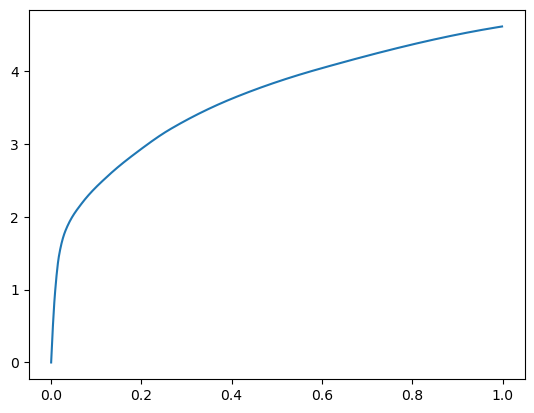

[0.         0.00357533 0.00816441 0.01541042 0.03417873 0.0842123
 0.16509914 0.27133846 0.42845821 0.66510487 1.        ] betas
[0.         0.86732969 0.53328772 0.40869099 0.33321677 0.40713786
 0.46457478 0.42713443 0.4710313  0.46403112 0.42694643] r
-22481.378721678564 score post


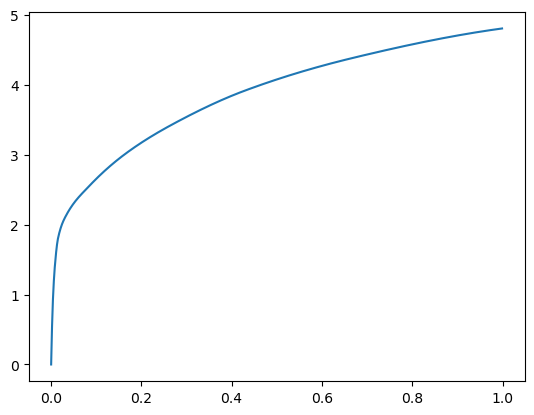

[0.         0.0017271  0.00418568 0.00869083 0.0197916  0.06248951
 0.13896847 0.24908924 0.40087414 0.63202381 1.        ] betas
[0.         0.68391219 0.46114425 0.47314708 0.44295481 0.47917646
 0.47930545 0.49399602 0.42389506 0.43136537 0.46385046] r
-22481.621781595804 score post


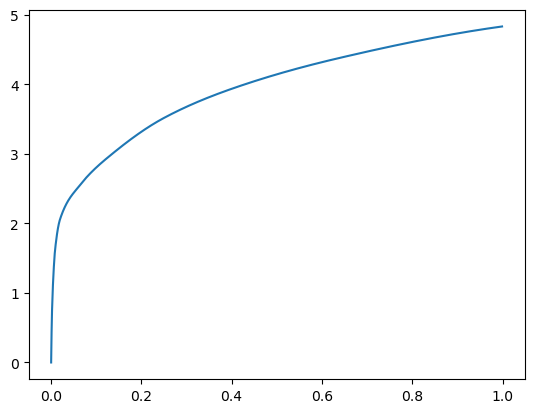

[0.         0.00110149 0.00303745 0.00667477 0.0151701  0.04711437
 0.11658382 0.21503735 0.37047482 0.61942959 1.        ] betas
[0.         0.62902855 0.45265609 0.45486221 0.48149525 0.52209641
 0.46626224 0.45691993 0.52107384 0.49392753 0.47918496] r
-22486.84644557857 score post


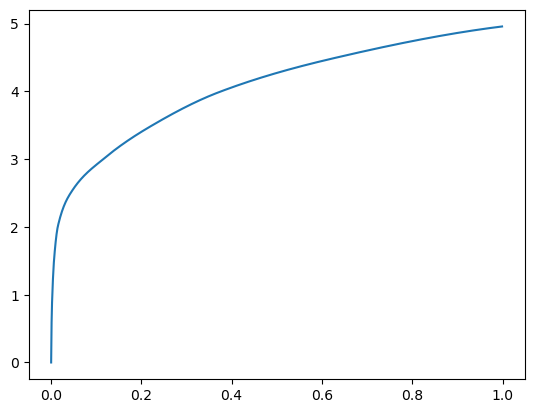

[0.00000000e+00 7.90596008e-04 2.52628326e-03 6.11972809e-03
 1.40867233e-02 4.11748886e-02 1.10760689e-01 2.16799736e-01
 3.63373756e-01 6.08923912e-01 1.00000000e+00] betas
[0.         0.53884214 0.57720404 0.48013888 0.5161227  0.53413746
 0.50454592 0.53942258 0.51020544 0.52265195 0.56519149] r
-22481.990460408004 score post


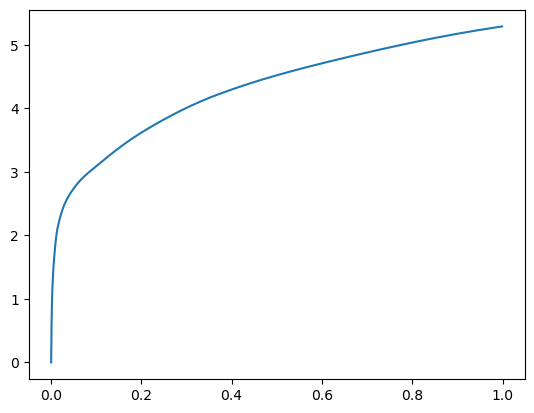

[0.00000000e+00 7.69615173e-04 2.26116180e-03 6.01482391e-03
 1.41782761e-02 4.09803391e-02 1.14430428e-01 2.19563484e-01
 3.74699593e-01 6.29849434e-01 1.00000000e+00] betas
[0.         0.49957422 0.51371296 0.54432233 0.54595348 0.43410355
 0.52523406 0.45112819 0.48291269 0.54783978 0.47130471] r
-22480.269231963164 score post


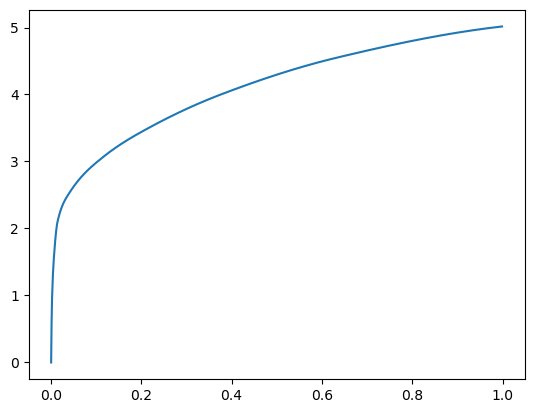

[0.00000000e+00 7.73429871e-04 2.21538544e-03 5.48648834e-03
 1.18513107e-02 3.81460190e-02 1.04704857e-01 2.18804359e-01
 3.80892754e-01 6.11674309e-01 1.00000000e+00] betas
[0.         0.47237194 0.49347328 0.4983266  0.49593489 0.54753274
 0.55832029 0.54014154 0.49207647 0.47526581 0.45288662] r
-22484.348661750126 score post


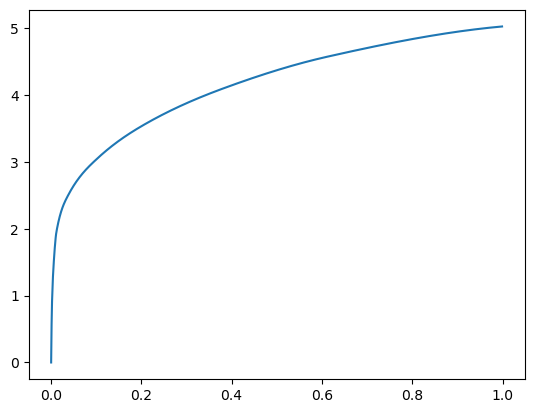

[0.00000000e+00 8.42094421e-04 2.39658356e-03 5.90038300e-03
 1.32532120e-02 3.85808945e-02 9.66634750e-02 1.96127892e-01
 3.50781441e-01 5.80767632e-01 1.00000000e+00] betas
[0.         0.56063785 0.51473056 0.53046301 0.52395443 0.51436172
 0.46983211 0.47586716 0.55131416 0.51522624 0.57672532] r
-22483.17300509828 score post


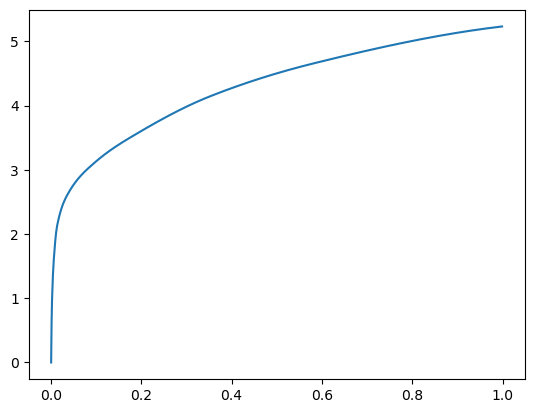

[0.00000000e+00 7.65800476e-04 2.26879120e-03 5.55706024e-03
 1.23472214e-02 3.63588333e-02 1.00934029e-01 2.14079857e-01
 3.67266655e-01 6.11628532e-01 1.00000000e+00] betas
[0.         0.51524448 0.52691413 0.48743463 0.49738755 0.4738774
 0.45542956 0.52752475 0.48132233 0.56973658 0.49811596] r
-22480.269231963164 score post


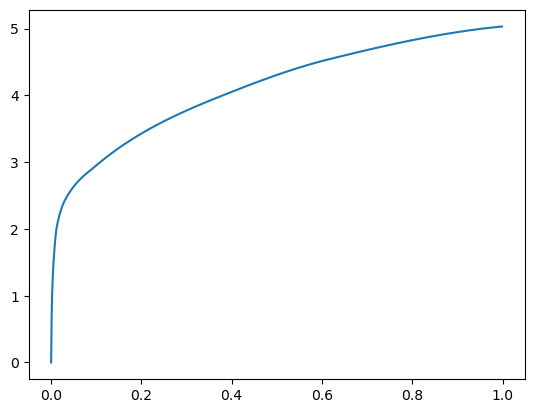

[0.00000000e+00 7.41004944e-04 2.11620331e-03 5.36632538e-03
 1.19791031e-02 3.77740860e-02 1.12280846e-01 2.24602699e-01
 3.89998436e-01 6.08586311e-01 1.00000000e+00] betas
[0.         0.5121445  0.50923091 0.50273051 0.4829678  0.52328369
 0.53183863 0.52947839 0.51017703 0.46378238 0.45966311] r
-22480.269231963164 score post


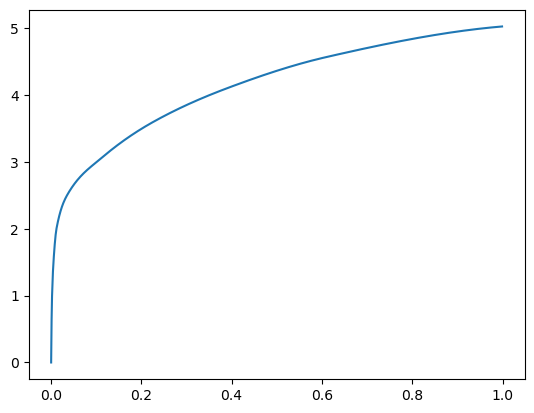

[0.00000000e+00 7.21931458e-04 2.04753876e-03 5.20801544e-03
 1.20649338e-02 3.62482071e-02 1.03915215e-01 2.05739021e-01
 3.58811378e-01 5.82419395e-01 1.00000000e+00] betas
[0.         0.52078453 0.50535636 0.48364262 0.49905221 0.47571788
 0.4913125  0.48540697 0.48359901 0.52501853 0.52149869] r
-22483.2822716802 score post


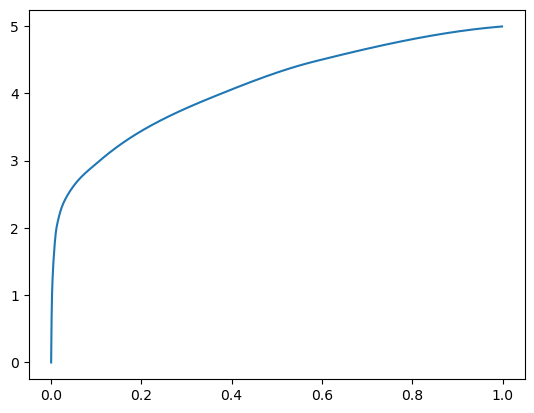

[0.00000000e+00 6.81877136e-04 1.93500519e-03 5.08975983e-03
 1.17311478e-02 3.72304916e-02 1.07186317e-01 2.14343071e-01
 3.76605034e-01 5.95751762e-01 1.00000000e+00] betas
[0.         0.46097933 0.46408225 0.46905267 0.48101306 0.57844142
 0.50119446 0.47135934 0.51576638 0.53313619 0.56649219] r
-22481.990460408004 score post


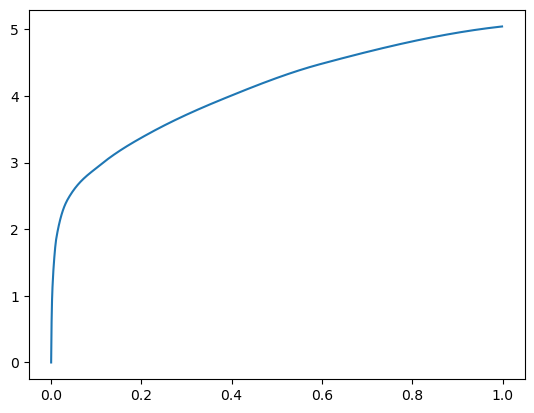

[0.00000000e+00 7.71522522e-04 2.32601166e-03 6.31046295e-03
 1.57327652e-02 4.32271957e-02 1.20291710e-01 2.42835045e-01
 4.09733772e-01 6.30200386e-01 1.00000000e+00] betas
[0.         0.5610855  0.51913796 0.54039442 0.55355431 0.45036027
 0.50380674 0.53061115 0.51387556 0.46399222 0.46215953] r
-22484.89423354312 score post


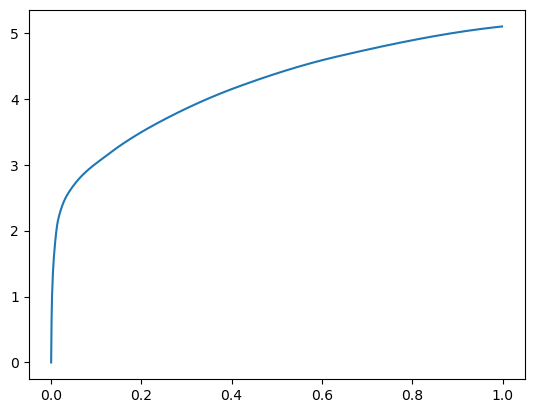

[0.00000000e+00 6.74247742e-04 2.05898285e-03 5.34915924e-03
 1.23510361e-02 3.61566544e-02 1.06995583e-01 2.18771935e-01
 3.74279976e-01 6.01733208e-01 1.00000000e+00] betas
[0.         0.44505631 0.54036126 0.49166076 0.48778451 0.54756254
 0.52990411 0.50480674 0.5147105  0.48113692 0.54368289] r
-22486.942189204576 score post


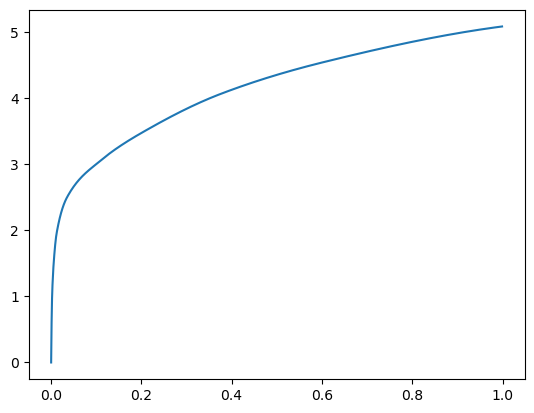

[0.00000000e+00 8.02040100e-04 2.20012665e-03 5.85079193e-03
 1.42621994e-02 3.87220383e-02 1.08689308e-01 2.22292900e-01
 3.77148628e-01 6.22540474e-01 1.00000000e+00] betas
[0.         0.54390488 0.48660482 0.48679174 0.54287691 0.5068174
 0.54617966 0.54001938 0.50527451 0.50071144 0.45483386] r
-22484.52742382129 score post


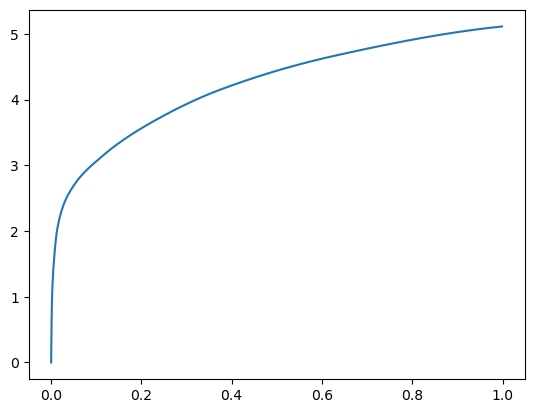

[0.00000000e+00 7.37190247e-04 2.16388702e-03 6.03771210e-03
 1.38559341e-02 3.79133224e-02 1.01181984e-01 2.03883171e-01
 3.52040291e-01 5.87452888e-01 1.00000000e+00] betas
[0.         0.51999707 0.46464401 0.5391039  0.53194287 0.50650679
 0.47050447 0.51775736 0.50228251 0.48247694 0.46738339] r
-22480.269231963164 score post


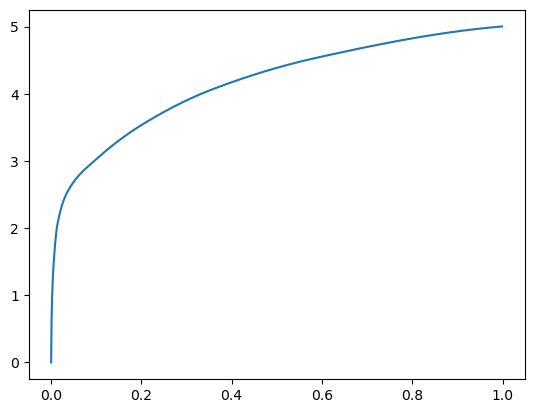

[0.00000000e+00 6.97135925e-04 2.24018097e-03 5.79929352e-03
 1.25417709e-02 3.31754684e-02 9.59749222e-02 1.92292213e-01
 3.33352089e-01 5.66214561e-01 1.00000000e+00] betas
[0.         0.48666259 0.48868004 0.50230179 0.48889178 0.45482827
 0.48976306 0.45698201 0.49463019 0.54351767 0.55435956] r
-22480.269231963164 score post


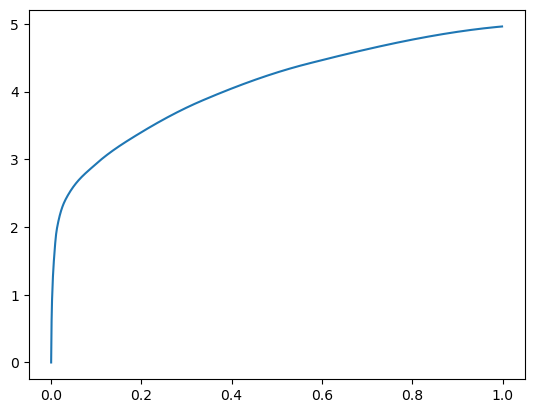

[0.00000000e+00 7.18116760e-04 2.32219696e-03 5.90610504e-03
 1.30243301e-02 3.81097794e-02 1.07234001e-01 2.18502998e-01
 3.71375084e-01 6.00768089e-01 1.00000000e+00] betas
[0.         0.53200469 0.55985327 0.48532316 0.48817688 0.51740086
 0.52008942 0.56066311 0.5321403  0.49650938 0.56055946] r
-22480.269231963164 score post


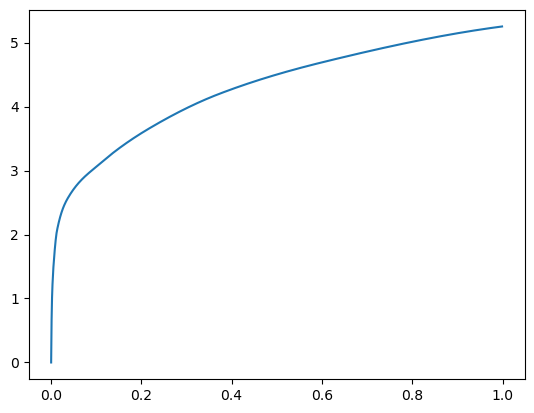

[0.00000000e+00 7.04765320e-04 2.13718414e-03 5.89084625e-03
 1.40638351e-02 4.19034958e-02 1.15315437e-01 2.21734047e-01
 3.73787880e-01 6.21201515e-01 1.00000000e+00] betas
[0.         0.50543226 0.52822972 0.52584749 0.54799447 0.52438817
 0.5039212  0.49492198 0.48788684 0.52223188 0.43728834] r
-22483.2822716802 score post


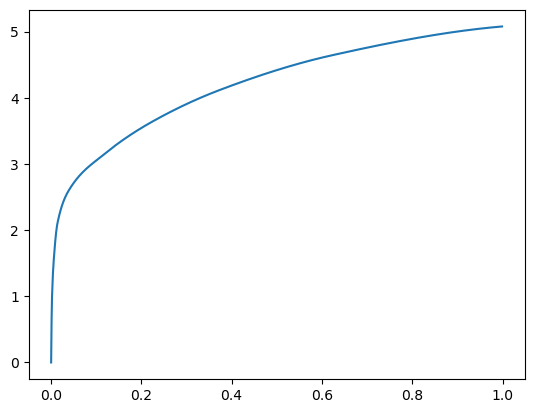

[0.00000000e+00 7.08580017e-04 2.05707550e-03 5.51700592e-03
 1.22308731e-02 3.40890884e-02 9.89160538e-02 2.02549934e-01
 3.52799416e-01 5.78232765e-01 1.00000000e+00] betas
[0.         0.50694435 0.49684821 0.49640093 0.51595495 0.48445438
 0.48566876 0.50001609 0.53009264 0.48703155 0.63185945] r
-22483.75060619476 score post


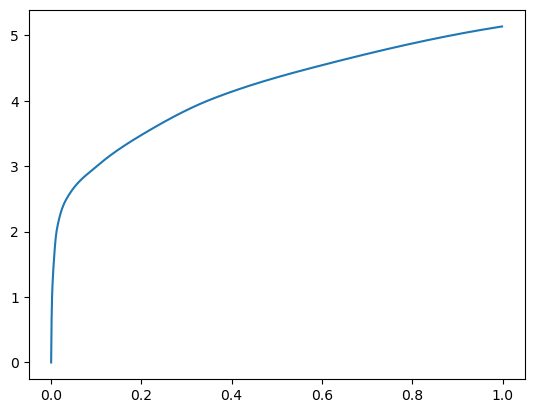

[0.00000000e+00 7.21931458e-04 2.16388702e-03 5.91182709e-03
 1.32532120e-02 3.99122238e-02 1.15483284e-01 2.29369164e-01
 3.88005257e-01 6.45045280e-01 1.00000000e+00] betas
[0.         0.528068   0.50704946 0.51342555 0.53679879 0.54831085
 0.53022899 0.49248446 0.53830607 0.54041167 0.46361538] r
-22484.55452125251 score post


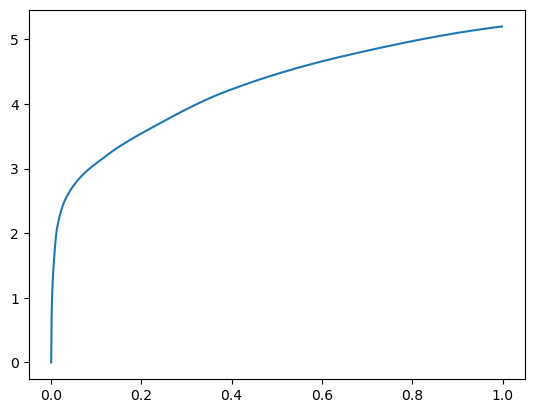

[0.00000000e+00 7.04765320e-04 2.18677521e-03 6.02436066e-03
 1.30949020e-02 3.69958878e-02 1.07121468e-01 2.24850655e-01
 3.74926567e-01 6.11651421e-01 1.00000000e+00] betas
[0.         0.48173901 0.48652899 0.56002673 0.50282244 0.5081919
 0.49991764 0.53837285 0.49020346 0.50869899 0.52968382] r
-22485.59168285815 score post


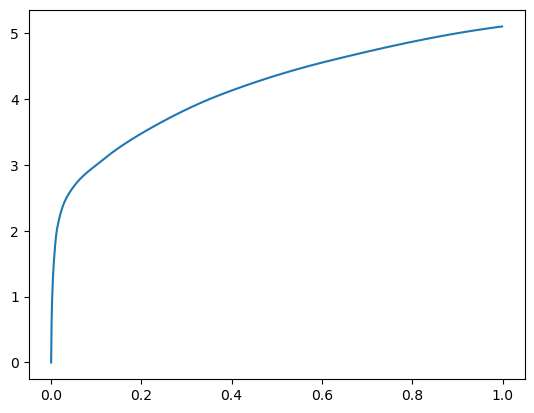

[0.00000000e+00 7.67707825e-04 2.44045258e-03 6.06060028e-03
 1.34096146e-02 3.81956100e-02 1.11475945e-01 2.23999977e-01
 3.81474495e-01 6.22906685e-01 1.00000000e+00] betas
[0.         0.50535288 0.54010184 0.49277036 0.55589899 0.53267054
 0.55371122 0.54927923 0.47025418 0.53245867 0.48887071] r
-22480.269231963164 score post


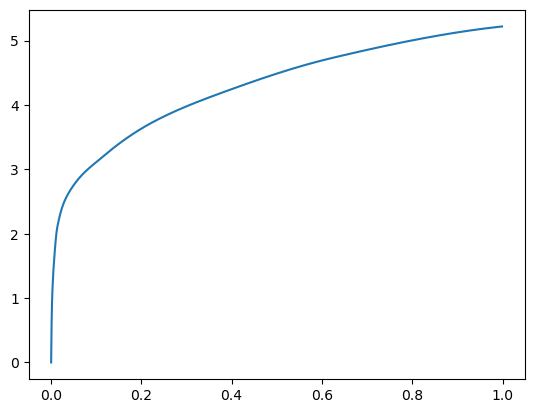

[0.00000000e+00 8.05854797e-04 2.43473053e-03 6.34288788e-03
 1.32646561e-02 3.68871689e-02 1.03383064e-01 2.05025673e-01
 3.72544289e-01 6.03579521e-01 1.00000000e+00] betas
[0.         0.52723446 0.5344996  0.51204091 0.46096095 0.45019448
 0.51108627 0.51649204 0.59720303 0.45163779 0.51433039] r
-22484.09117069985 score post


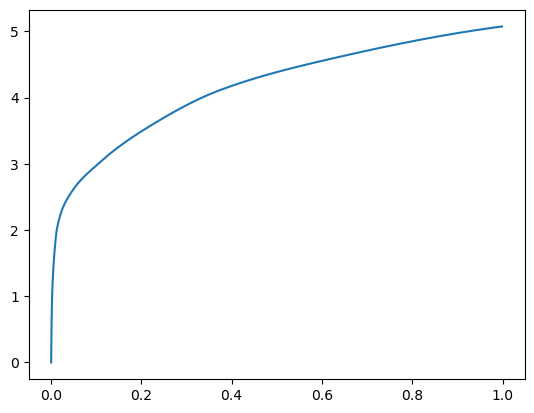

[0.00000000e+00 7.63893127e-04 2.21920013e-03 5.79547882e-03
 1.31330490e-02 4.15735245e-02 1.11487389e-01 2.14594841e-01
 3.54359627e-01 6.07842445e-01 1.00000000e+00] betas
[0.         0.53210377 0.50001671 0.49701635 0.54550922 0.52392221
 0.44397665 0.48279425 0.46176951 0.5629987  0.48503157] r
-22486.745859704064 score post


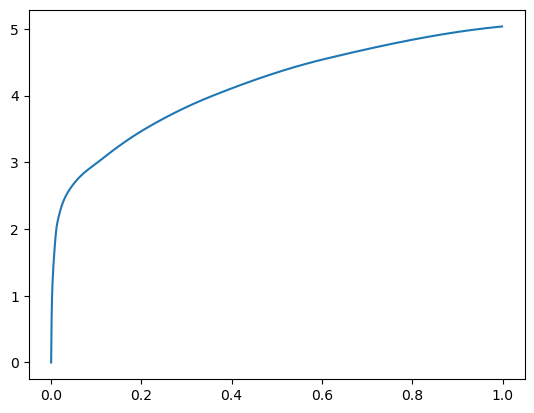

[0.00000000e+00 7.06672668e-04 2.10475922e-03 5.61046600e-03
 1.17406845e-02 3.41978073e-02 1.07466698e-01 2.14406013e-01
 3.69633675e-01 5.96661568e-01 1.00000000e+00] betas
[0.         0.50398293 0.4947312  0.50219235 0.49409238 0.55721485
 0.54885604 0.51808534 0.47586587 0.5207877  0.61781895] r
-22480.269231963164 score post


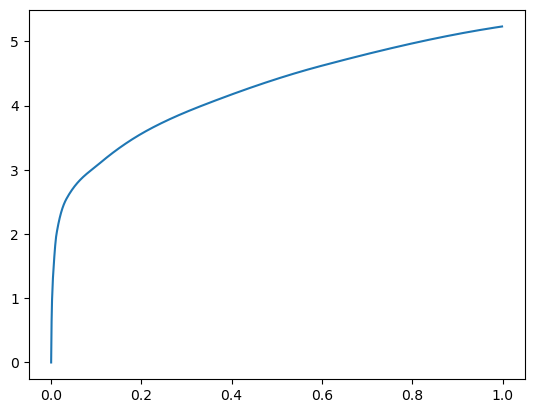

[0.00000000e+00 7.46726990e-04 2.33364105e-03 6.27231598e-03
 1.42164230e-02 3.95441055e-02 1.14106178e-01 2.26311684e-01
 4.04946327e-01 6.47860527e-01 1.00000000e+00] betas
[0.         0.50861136 0.55896537 0.54213421 0.56495221 0.49129591
 0.51743624 0.55648192 0.61420522 0.48655048 0.4230671 ] r
-22482.597739918583 score post


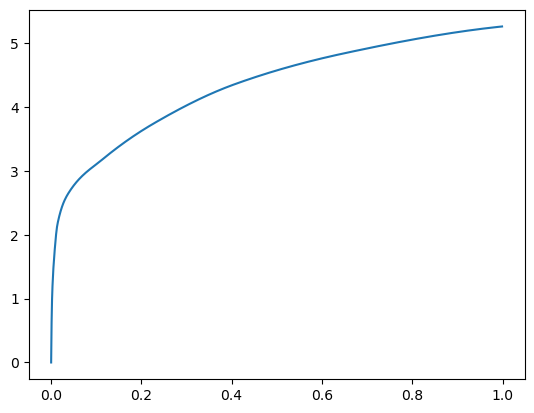

[0.00000000e+00 7.82966614e-04 2.26497650e-03 5.95951080e-03
 1.26142502e-02 3.65591049e-02 1.09724998e-01 2.13183403e-01
 3.54727745e-01 5.84610939e-01 1.00000000e+00] betas
[0.         0.52332002 0.50117693 0.47450975 0.49223661 0.47470874
 0.53358545 0.45590082 0.49927269 0.49888275 0.51284684] r
-22486.991588477467 score post


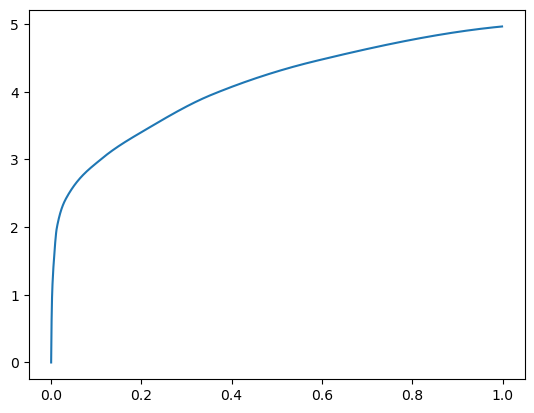

[0.00000000e+00 7.27653503e-04 2.11811066e-03 5.86605072e-03
 1.24845505e-02 3.80697250e-02 1.06171608e-01 2.18533516e-01
 3.61504555e-01 5.94660759e-01 1.00000000e+00] betas
[0.         0.48673072 0.53705631 0.50875675 0.52823133 0.51742077
 0.49668565 0.52330202 0.49970453 0.5629735  0.54452627] r
-22481.378721678564 score post


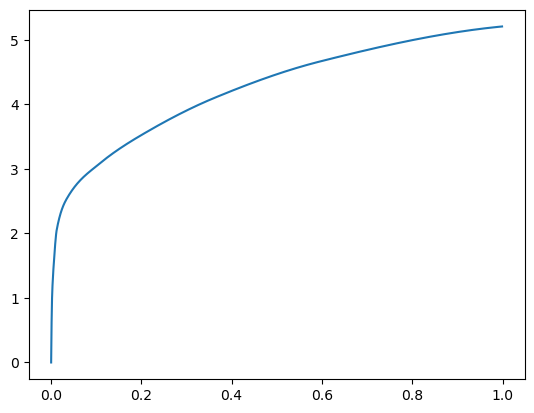

[0.00000000e+00 7.94410706e-04 2.19821930e-03 6.14833832e-03
 1.30777359e-02 4.02326584e-02 1.14701271e-01 2.29987144e-01
 3.84692192e-01 6.08246803e-01 1.00000000e+00] betas
[0.         0.53624961 0.50114265 0.54466416 0.56257588 0.5346082
 0.5548113  0.49203755 0.53219901 0.54099417 0.47976466] r
-22481.378721678564 score post


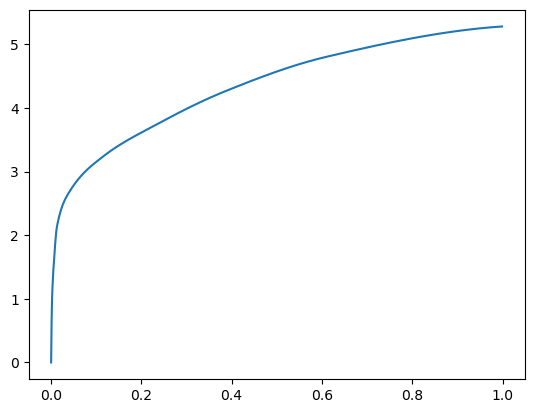

[0.00000000e+00 7.77244568e-04 2.28595734e-03 6.16359711e-03
 1.23128891e-02 3.68452072e-02 1.02671623e-01 2.21907616e-01
 3.72723579e-01 5.81448555e-01 1.00000000e+00] betas
[0.         0.50976518 0.49061947 0.50915    0.52379481 0.47252998
 0.45200305 0.58221649 0.51792266 0.43801319 0.54152061] r
-22487.42243982761 score post


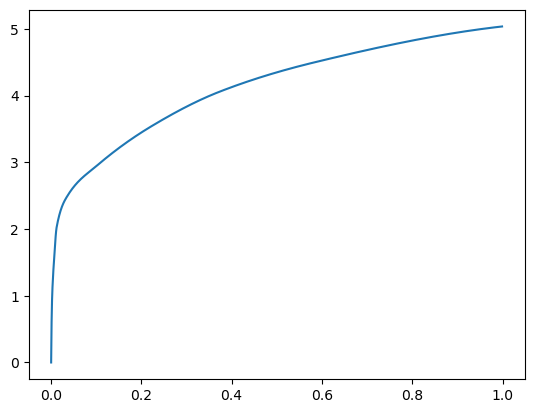

[0.00000000e+00 7.63893127e-04 2.32219696e-03 6.18076324e-03
 1.18703842e-02 3.80411148e-02 1.14003181e-01 2.18523979e-01
 3.62380028e-01 6.04554176e-01 1.00000000e+00] betas
[0.         0.52612524 0.51762141 0.54137949 0.44029806 0.58632617
 0.55152257 0.46345408 0.48170053 0.50778857 0.55352848] r
-22487.029817202474 score post


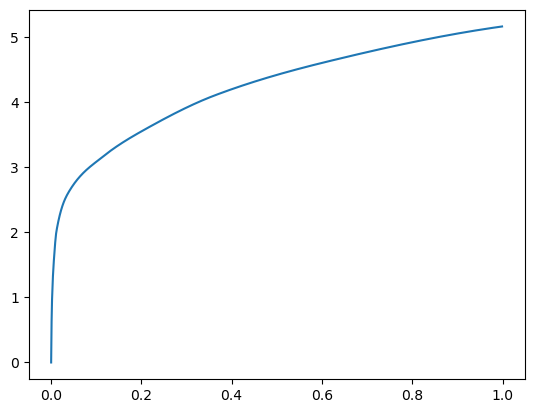

[0.00000000e+00 7.44819641e-04 2.27642059e-03 5.84697723e-03
 1.29766464e-02 3.58610153e-02 1.02723122e-01 2.16467857e-01
 3.72902870e-01 6.26109123e-01 1.00000000e+00] betas
[0.         0.50056754 0.56509489 0.50399313 0.49148774 0.4588449
 0.52086795 0.54338146 0.49731534 0.52142233 0.48539348] r
-22482.458794922564 score post


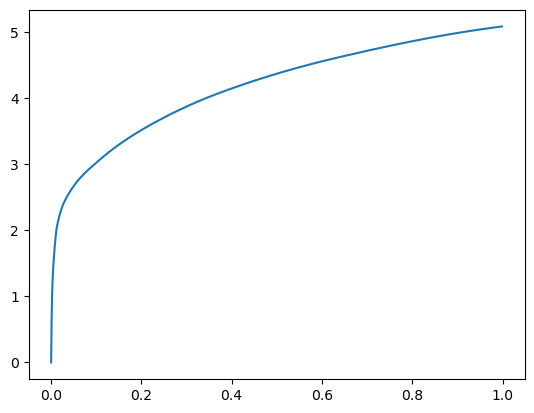

[0.00000000e+00 7.61985779e-04 2.07614899e-03 5.40828705e-03
 1.23014450e-02 3.78961563e-02 1.04744911e-01 2.10711479e-01
 3.68659019e-01 6.11804008e-01 1.00000000e+00] betas
[0.         0.48933763 0.48273313 0.48443748 0.54644309 0.49947101
 0.49023069 0.4942097  0.52822125 0.47860784 0.47917621] r
-22481.378721678564 score post


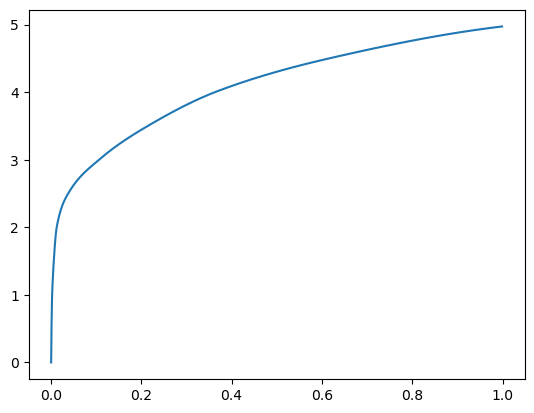

[0.00000000e+00 7.79151917e-04 2.17914581e-03 5.74207306e-03
 1.19428635e-02 3.65018845e-02 1.03198051e-01 2.09225655e-01
 3.54594231e-01 6.00184441e-01 1.00000000e+00] betas
[0.         0.55120237 0.51999401 0.51538326 0.4998288  0.54977358
 0.50521712 0.51883757 0.53071944 0.59106744 0.55153086] r
-22480.269231963164 score post


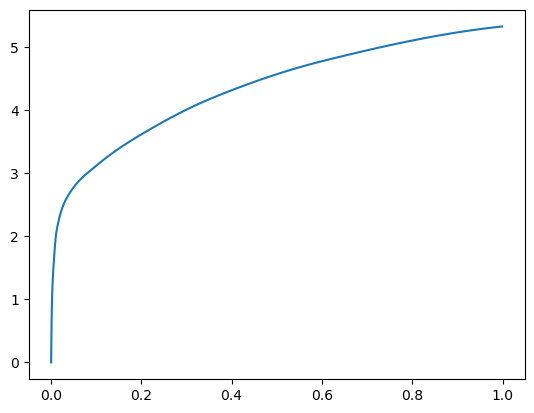

[0.00000000e+00 7.44819641e-04 2.16007233e-03 5.86986542e-03
 1.31711960e-02 3.90615463e-02 1.13160133e-01 2.26834297e-01
 3.80751610e-01 6.10352516e-01 1.00000000e+00] betas
[0.         0.53097818 0.48422547 0.50352898 0.50230527 0.45815824
 0.51675815 0.5044481  0.49081335 0.55931793 0.54315266] r
-22484.969624434776 score post


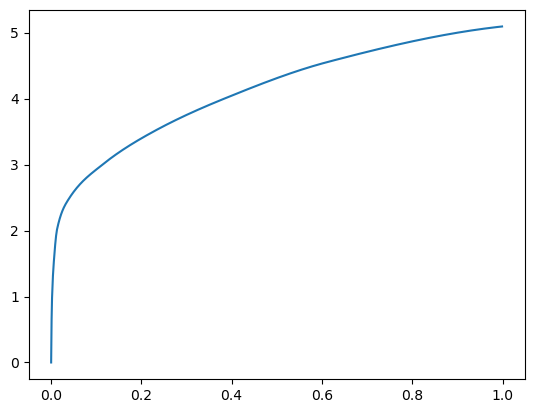

[0.00000000e+00 7.00950623e-04 2.17723846e-03 5.96904755e-03
 1.36976242e-02 4.56743240e-02 1.24379158e-01 2.44631767e-01
 4.10965919e-01 6.29055977e-01 1.00000000e+00] betas
[0.         0.51427722 0.49190503 0.51775046 0.4705346  0.53081994
 0.52421612 0.53814328 0.49320302 0.42415386 0.51194343] r
-22481.378721678564 score post


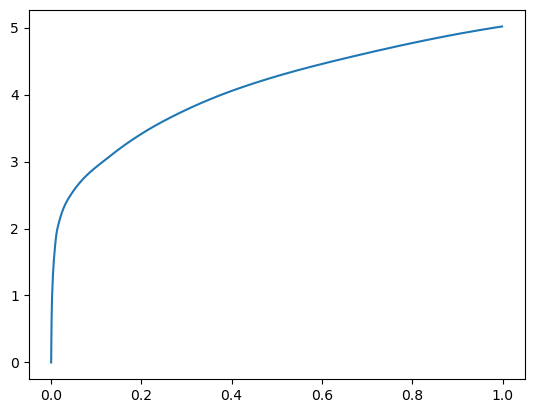

[0.00000000e+00 6.76155090e-04 2.16388702e-03 5.75923920e-03
 1.41191483e-02 4.40149307e-02 1.17033958e-01 2.24373817e-01
 3.83635521e-01 6.35321617e-01 1.00000000e+00] betas
[0.         0.48976595 0.5349127  0.48698252 0.57053658 0.54387257
 0.53979835 0.47832121 0.51379935 0.51238911 0.48166195] r
-22480.269231963164 score post


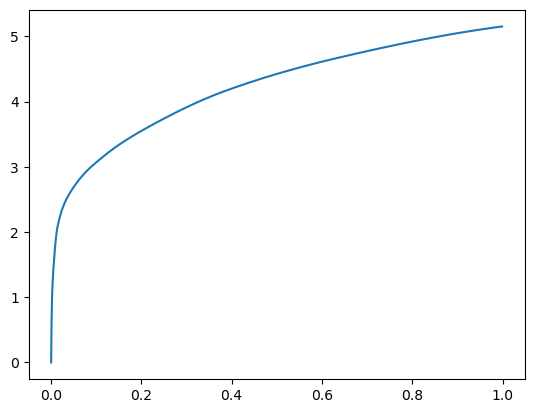

[0.00000000e+00 7.27653503e-04 2.19058990e-03 6.11972809e-03
 1.35164261e-02 3.95956039e-02 1.03852272e-01 2.14438438e-01
 3.69706154e-01 6.14991188e-01 1.00000000e+00] betas
[0.         0.4933144  0.53064398 0.55443942 0.49855494 0.49747257
 0.50611309 0.51774233 0.49718264 0.53943869 0.52317339] r
-22481.990460408004 score post


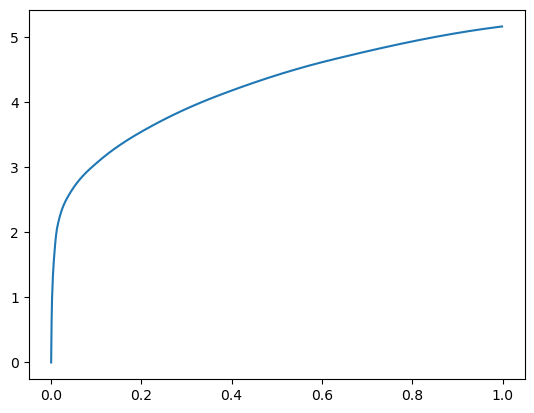

[0.00000000e+00 7.73429871e-04 2.22682953e-03 5.79738617e-03
 1.31273270e-02 3.99866104e-02 1.06249809e-01 2.17669487e-01
 3.81514549e-01 6.19305611e-01 1.00000000e+00] betas
[0.         0.5417448  0.52584025 0.52556618 0.54198941 0.53185366
 0.49955095 0.55702623 0.53172339 0.49997217 0.49441593] r
-22481.378721678564 score post


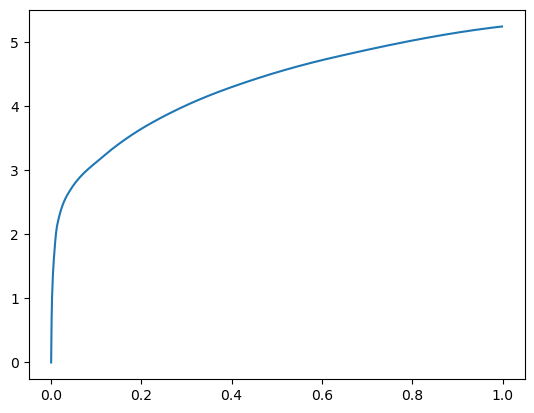

[0.00000000e+00 7.41004944e-04 2.15053558e-03 5.62000275e-03
 1.22613907e-02 3.64484787e-02 1.03491783e-01 2.05731392e-01
 3.60634804e-01 6.01014137e-01 1.00000000e+00] betas
[0.         0.53388162 0.51201562 0.54143039 0.49369038 0.51001068
 0.52779941 0.51875852 0.53595332 0.51500403 0.51871721] r
-22485.70121138277 score post


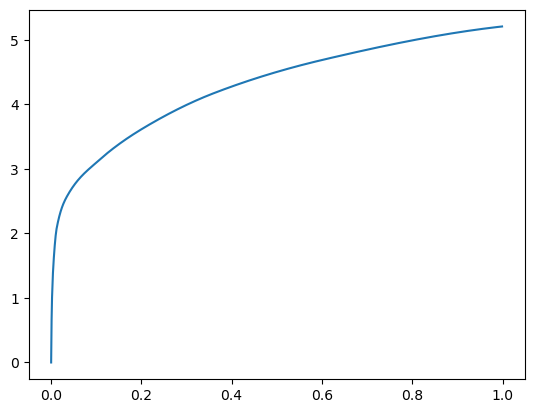

[0.00000000e+00 7.16209412e-04 2.13146210e-03 5.38349152e-03
 1.23128891e-02 3.74784470e-02 1.04376793e-01 2.07533836e-01
 3.57779503e-01 5.99799156e-01 1.00000000e+00] betas
[0.         0.46886631 0.51524683 0.49794559 0.546583   0.53675947
 0.44360391 0.48679682 0.50496904 0.53049065 0.56268578] r
-22484.290199644343 score post


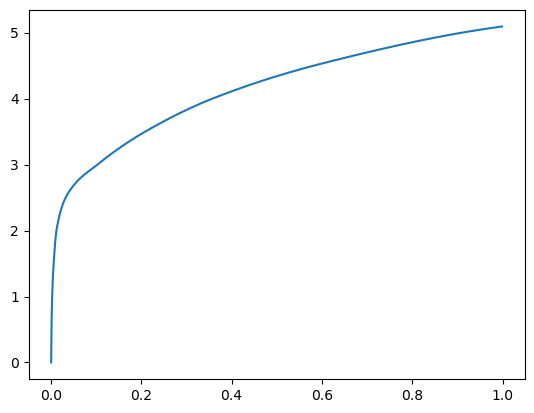

[0.00000000e+00 8.02040100e-04 2.28786469e-03 5.81455231e-03
 1.25513077e-02 3.58476639e-02 1.12988472e-01 2.25468636e-01
 3.86034966e-01 6.30618095e-01 1.00000000e+00] betas
[0.         0.52616969 0.53255874 0.50876302 0.51872009 0.51851304
 0.5807459  0.51747437 0.51383352 0.53323469 0.50159488] r
-22483.215759872455 score post


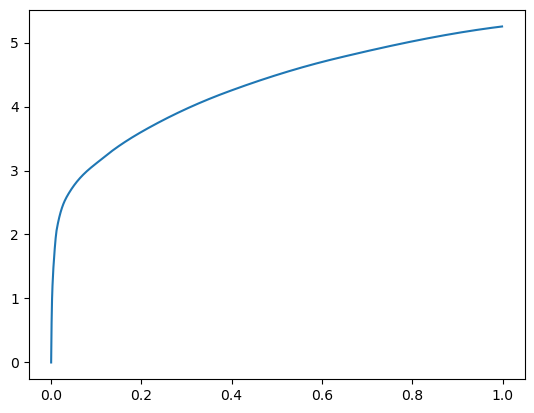

[0.00000000e+00 8.00132751e-04 2.24971771e-03 5.89084625e-03
 1.29308701e-02 3.75795364e-02 1.06945992e-01 2.18483925e-01
 3.80183220e-01 6.16986275e-01 1.00000000e+00] betas
[0.         0.53984945 0.47485276 0.50107435 0.50778895 0.50912974
 0.50005959 0.55813799 0.49995491 0.58079498 0.46531633] r
-22481.378721678564 score post


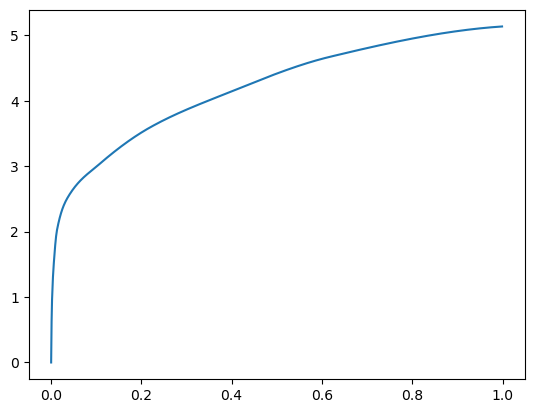

[0.00000000e+00 7.44819641e-04 2.31266022e-03 6.15024567e-03
 1.38216019e-02 4.07648087e-02 1.15283012e-01 2.19771385e-01
 3.86965752e-01 5.90199471e-01 1.00000000e+00] betas
[0.         0.51525522 0.49091146 0.53302421 0.50423105 0.4816258
 0.52817904 0.48169189 0.51954607 0.47501945 0.61272495] r
-22481.378721678564 score post


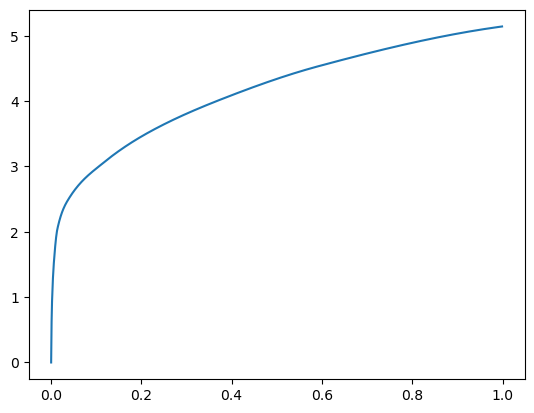

[0.00000000e+00 7.42912292e-04 2.42328644e-03 6.18839264e-03
 1.42545700e-02 4.51383591e-02 1.21029854e-01 2.37345695e-01
 4.09304619e-01 6.43666267e-01 1.00000000e+00] betas
[0.         0.47864784 0.53518045 0.53052653 0.53931163 0.58303565
 0.48918258 0.50253972 0.55625568 0.45546861 0.45813437] r
-22484.348467993714 score post


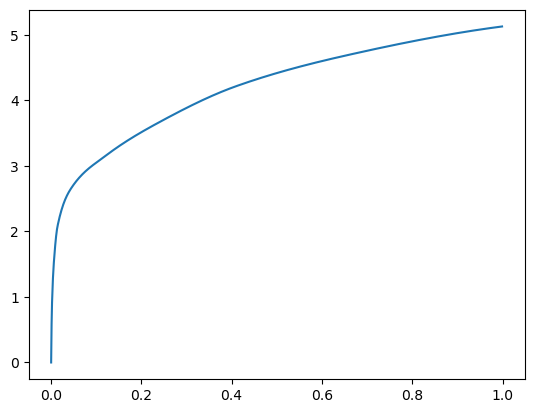

[0.00000000e+00 8.21113586e-04 2.48050690e-03 6.12735748e-03
 1.33867264e-02 3.63130569e-02 1.05420113e-01 2.19195366e-01
 3.67762566e-01 6.09616280e-01 1.00000000e+00] betas
[0.         0.50037081 0.55263697 0.51726656 0.50591481 0.49722965
 0.51532449 0.53339826 0.50623882 0.52998325 0.45945912] r
-22481.378721678564 score post


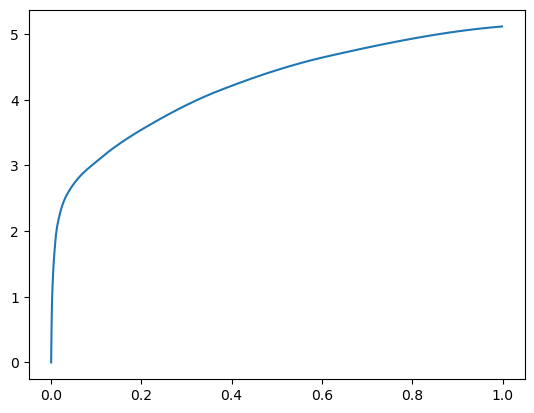

[0.00000000e+00 8.45909119e-04 2.34699249e-03 5.77640533e-03
 1.26638412e-02 3.51362228e-02 1.02311134e-01 2.09277153e-01
 3.55492592e-01 5.78112602e-01 1.00000000e+00] betas
[0.         0.54988887 0.46673403 0.47555086 0.48696003 0.54617219
 0.50889781 0.47752663 0.50122999 0.52544638 0.49184032] r
-22481.990460408004 score post


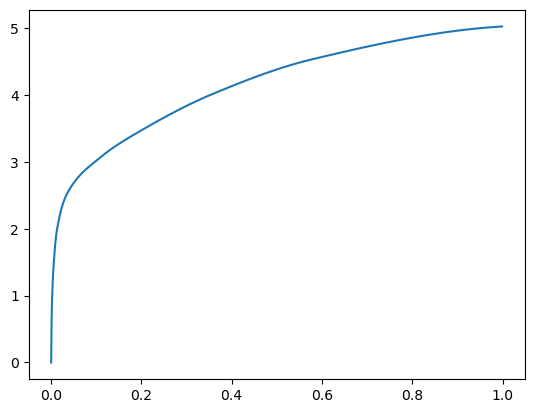

[0.00000000e+00 7.46726990e-04 2.29549408e-03 5.95188141e-03
 1.35107040e-02 3.43484879e-02 9.94825363e-02 2.11699486e-01
 3.59465599e-01 5.71326256e-01 1.00000000e+00] betas
[0.         0.4796365  0.50768167 0.48120781 0.51571158 0.42457108
 0.45177106 0.55384411 0.52512101 0.51533701 0.55453397] r
-22483.17300509828 score post


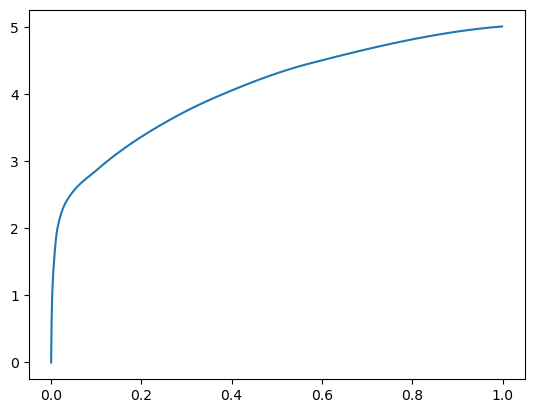

[0.00000000e+00 7.94410706e-04 2.36988068e-03 6.32190704e-03
 1.40886307e-02 4.36811447e-02 1.25309944e-01 2.34330177e-01
 3.83027077e-01 6.02179527e-01 1.00000000e+00] betas
[0.         0.56718773 0.49286429 0.51172234 0.50141937 0.57310834
 0.57333939 0.50699339 0.49094076 0.44686336 0.52397708] r
-22483.215759872455 score post


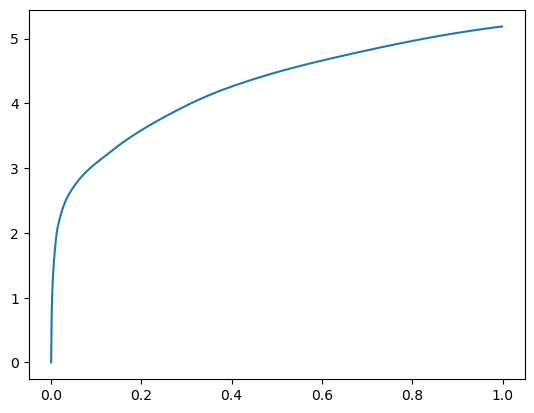

[0.00000000e+00 6.97135925e-04 2.25925446e-03 6.15215302e-03
 1.41534805e-02 3.92045975e-02 1.05872154e-01 2.10745811e-01
 3.58304024e-01 6.05324745e-01 1.00000000e+00] betas
[0.         0.50835583 0.55065172 0.52767856 0.51016317 0.50010861
 0.47486051 0.50366147 0.55715334 0.59208813 0.50663704] r
-22480.269231963164 score post


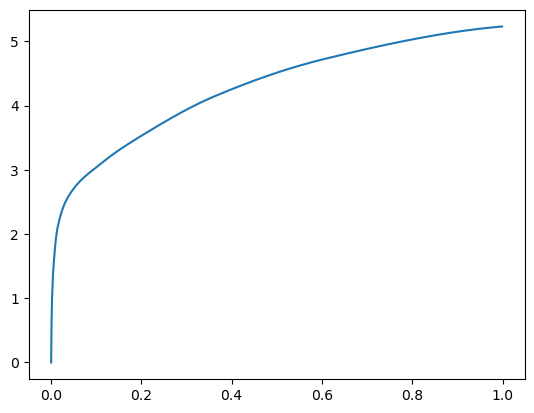

[0.00000000e+00 7.27653503e-04 2.20012665e-03 5.96332550e-03
 1.40275955e-02 4.08868790e-02 1.17711067e-01 2.31205940e-01
 3.76070976e-01 5.95850945e-01 1.00000000e+00] betas
[0.         0.54508177 0.54081443 0.51564294 0.53415932 0.49858079
 0.5320231  0.52654693 0.49608299 0.46279831 0.49518329] r
-22480.269231963164 score post


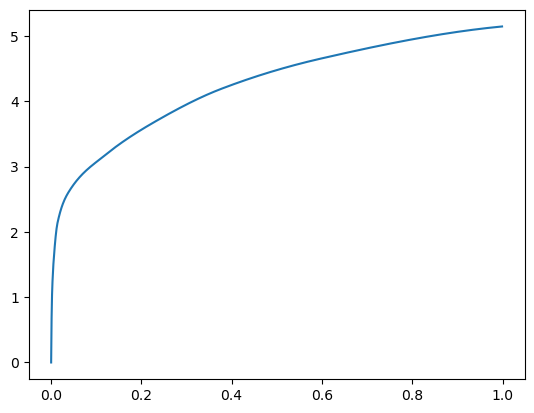

[0.00000000e+00 6.70433044e-04 1.96361542e-03 5.36251068e-03
 1.21660233e-02 3.55749130e-02 1.03413582e-01 2.08966255e-01
 3.50750923e-01 5.83788872e-01 1.00000000e+00] betas
[0.         0.45830871 0.48583296 0.52655874 0.50708561 0.49560494
 0.51081602 0.49939103 0.49292764 0.54656919 0.5040229 ] r
-22489.91727413811 score post


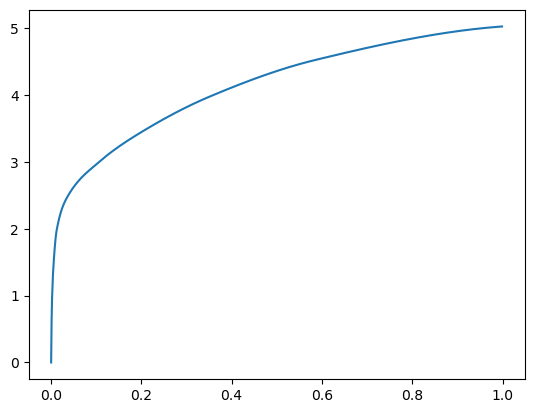

[0.00000000e+00 7.60078430e-04 2.23445892e-03 5.72490692e-03
 1.30872726e-02 3.90176773e-02 1.08920097e-01 2.17797279e-01
 3.66744041e-01 5.84586143e-01 1.00000000e+00] betas
[0.         0.49494703 0.48779334 0.50768383 0.55285986 0.51804884
 0.49010233 0.52001689 0.48563093 0.49741678 0.5383731 ] r
-22493.404955068767 score post


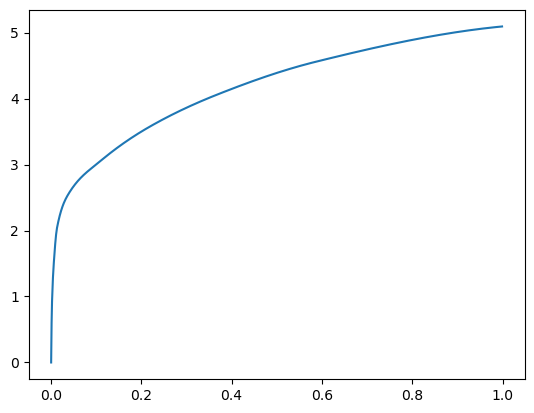

[0.00000000e+00 7.92503357e-04 2.40612030e-03 6.09111786e-03
 1.29194260e-02 3.77035141e-02 1.09665871e-01 2.16156960e-01
 3.73103142e-01 6.01744652e-01 1.00000000e+00] betas
[0.         0.51568008 0.49884736 0.49617022 0.48298519 0.52008966
 0.51180882 0.52348609 0.58112409 0.47523299 0.47847811] r
-22480.269231963164 score post


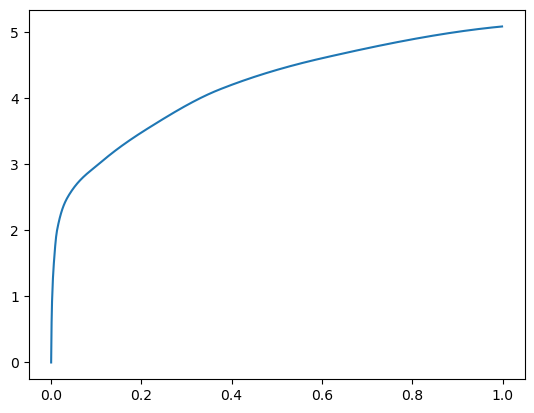

[0.00000000e+00 7.75337219e-04 2.41756439e-03 6.24370575e-03
 1.40542984e-02 4.02002335e-02 1.13911629e-01 2.18424797e-01
 3.51347923e-01 5.82983971e-01 1.00000000e+00] betas
[0.         0.51748508 0.54795347 0.54487669 0.46653139 0.44578616
 0.48171724 0.49572618 0.48005803 0.53570161 0.53299836] r
-22484.501289920216 score post


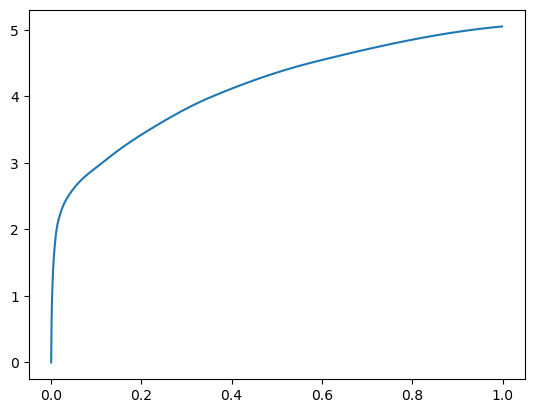

[0.00000000e+00 7.48634338e-04 2.17342377e-03 5.27858734e-03
 1.24597549e-02 4.03757095e-02 1.18443489e-01 2.26735115e-01
 3.72168541e-01 5.99659920e-01 1.00000000e+00] betas
[0.         0.49385553 0.49102697 0.44789589 0.53422183 0.54444933
 0.50932103 0.5096402  0.51867041 0.50136512 0.50242709] r
-22480.269231963164 score post


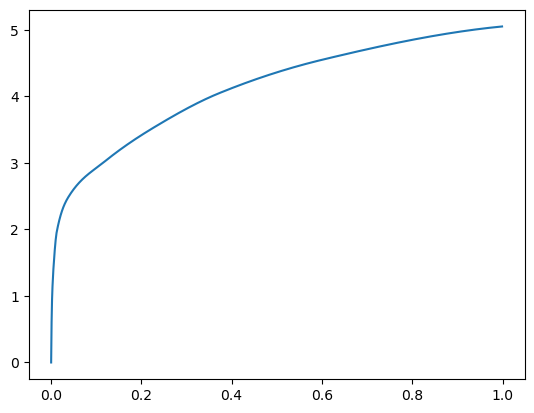

[0.00000000e+00 7.73429871e-04 2.29549408e-03 6.10637665e-03
 1.40676498e-02 4.18062210e-02 1.20436668e-01 2.28352547e-01
 3.69736671e-01 5.97920418e-01 1.00000000e+00] betas
[0.         0.52196377 0.513331   0.48827595 0.52522    0.53961776
 0.54621362 0.52975539 0.45831763 0.50522011 0.5521852 ] r
-22483.2822716802 score post


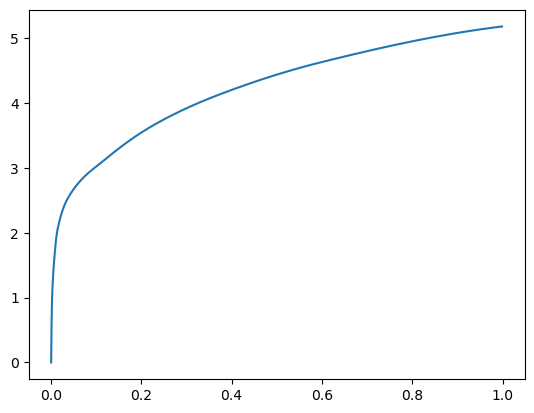

[0.00000000e+00 7.65800476e-04 2.29930878e-03 6.44588470e-03
 1.47733688e-02 4.19549942e-02 1.15780830e-01 2.18852043e-01
 3.77791405e-01 6.17753029e-01 1.00000000e+00] betas
[0.         0.51460985 0.51991888 0.53991412 0.56857161 0.52527353
 0.50594629 0.49730479 0.51505385 0.49088368 0.4987219 ] r
-22485.7526417351 score post


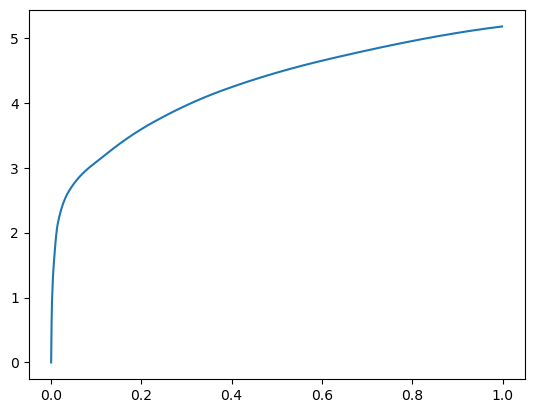

[0.00000000e+00 7.71522522e-04 2.30312347e-03 6.21318817e-03
 1.30586624e-02 3.52373123e-02 1.03320122e-01 2.06908226e-01
 3.60394478e-01 6.06211662e-01 1.00000000e+00] betas
[0.         0.52810242 0.49584325 0.54326346 0.4833045  0.48460557
 0.45369459 0.47761389 0.50916079 0.56896549 0.49585357] r
-22481.378721678564 score post


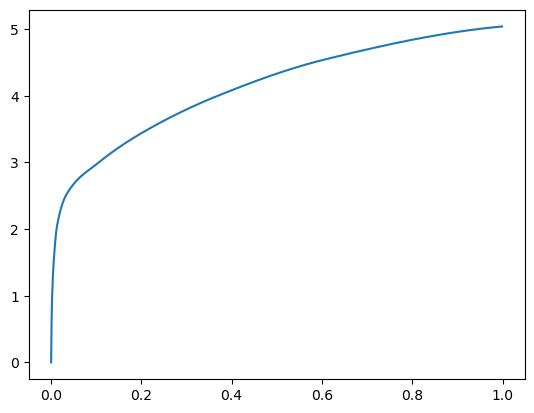

[0.00000000e+00 7.21931458e-04 2.22873688e-03 5.66005707e-03
 1.22346878e-02 3.39517593e-02 1.09820366e-01 2.23034859e-01
 3.81087303e-01 6.01353645e-01 1.00000000e+00] betas
[0.         0.55843254 0.47935722 0.51626144 0.49588306 0.51686099
 0.55689058 0.52260615 0.52539053 0.46846313 0.52830211] r
-22489.387714921333 score post


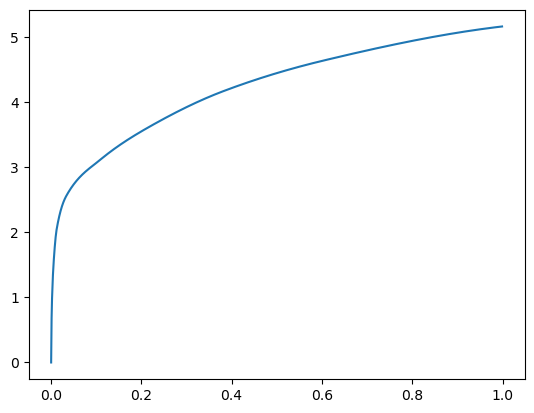

[0.00000000e+00 6.41822815e-04 2.20966339e-03 5.62572479e-03
 1.26771927e-02 3.53708267e-02 1.05826378e-01 2.15796471e-01
 3.67390633e-01 6.08225822e-01 1.00000000e+00] betas
[0.         0.48833809 0.54501808 0.47256855 0.54377801 0.48476324
 0.52249873 0.55076987 0.48379946 0.50856751 0.51611123] r
-22482.458794922564 score post


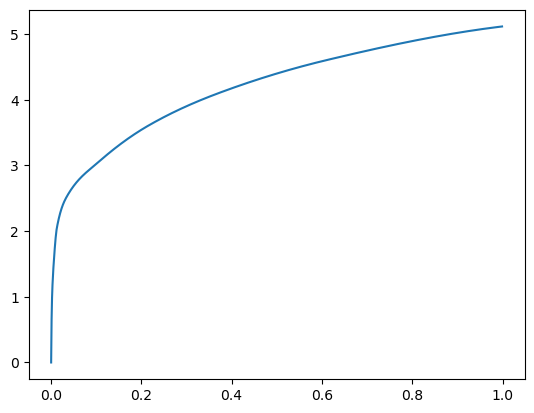

[0.00000000e+00 6.87599182e-04 2.16197968e-03 5.90991974e-03
 1.25913620e-02 3.73773575e-02 1.07937813e-01 2.09214211e-01
 3.67947578e-01 6.10943794e-01 1.00000000e+00] betas
[0.         0.47276687 0.51752681 0.51472836 0.47088152 0.51300728
 0.53863292 0.49942736 0.47505479 0.52071279 0.49769249] r
-22480.269231963164 score post


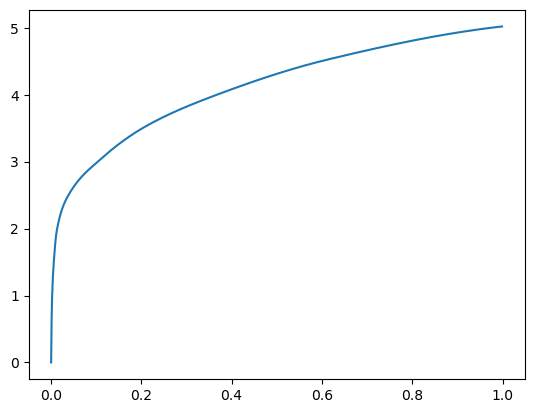

[0.00000000e+00 7.48634338e-04 2.22873688e-03 5.92136383e-03
 1.35145187e-02 3.91740799e-02 1.05401039e-01 2.05906868e-01
 3.73627663e-01 6.08292580e-01 1.00000000e+00] betas
[0.         0.52596746 0.50016722 0.48640923 0.55572878 0.55039967
 0.49054462 0.50663705 0.49081045 0.50931093 0.52452597] r
-22484.4517533122 score post


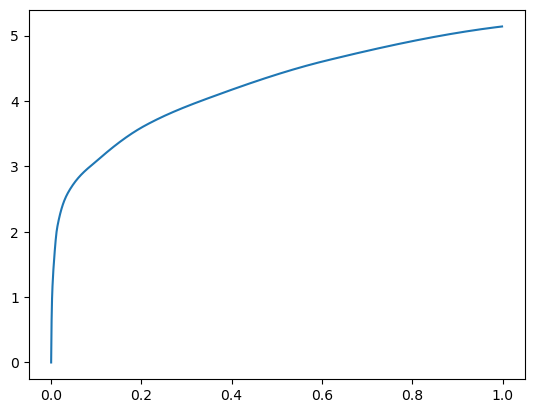

[0.00000000e+00 7.23838806e-04 2.23827362e-03 6.22653961e-03
 1.32036209e-02 3.53193283e-02 1.01233482e-01 2.01363564e-01
 3.75912666e-01 6.14502907e-01 1.00000000e+00] betas
[0.         0.47933178 0.53291203 0.60614744 0.49809003 0.4612084
 0.49989137 0.49322831 0.56329053 0.54539458 0.50379526] r
-22480.269231963164 score post


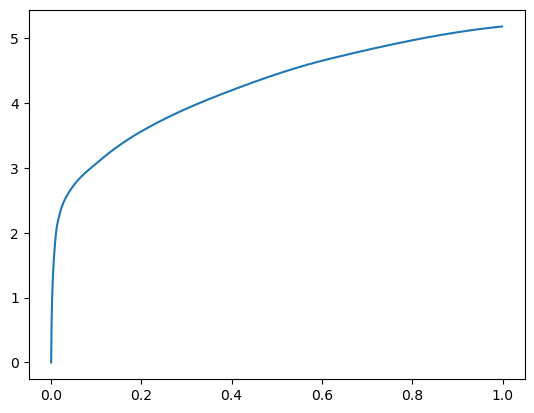

488581 steps_after


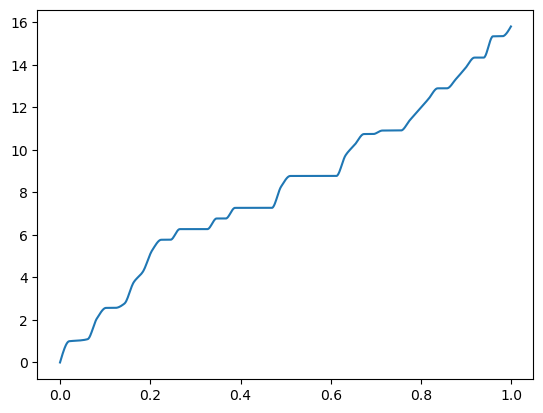

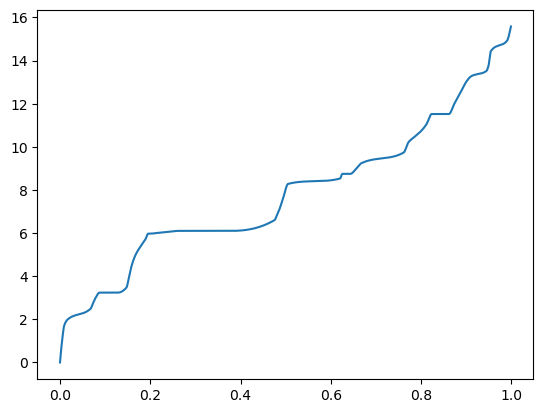

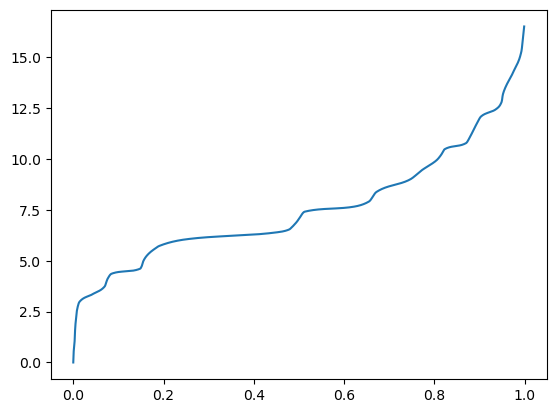

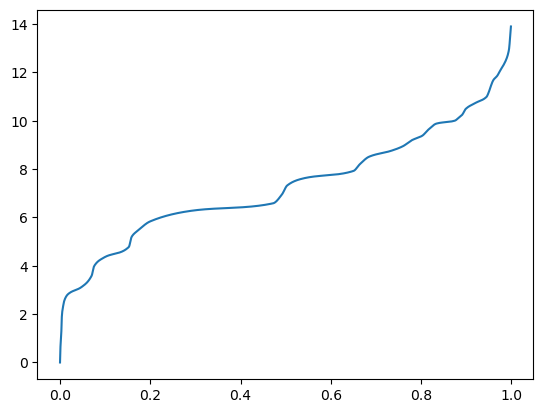

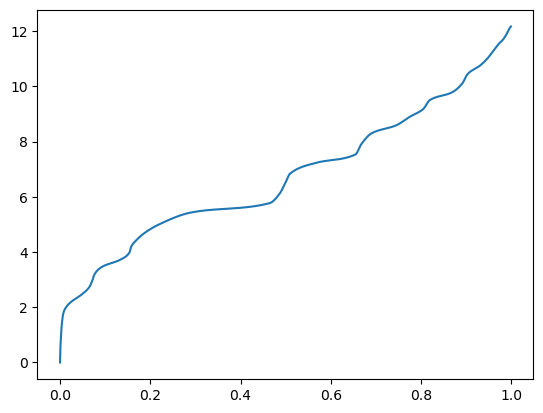

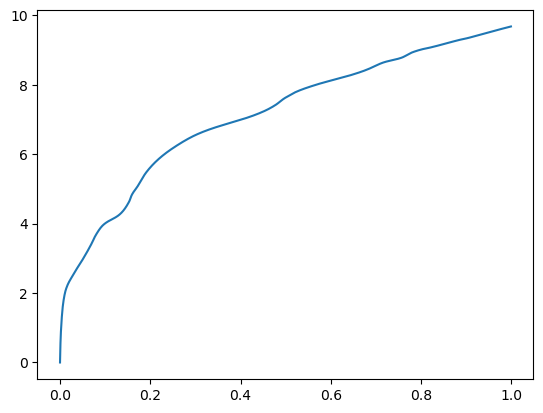

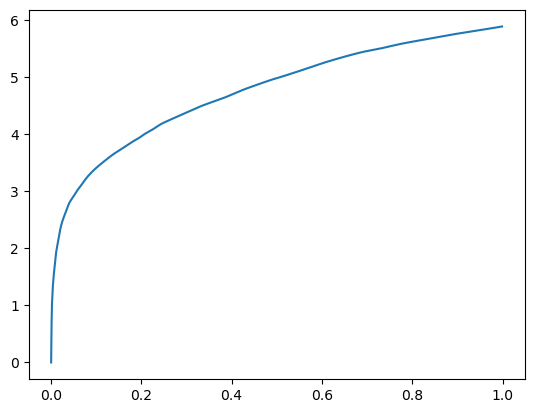

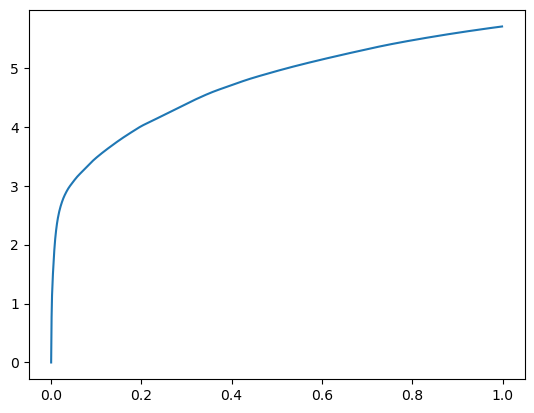

10296 steps
betas [0.00000000e+00 6.64710999e-04 1.99413300e-03 5.44452667e-03
 1.16109848e-02 3.08103561e-02 9.22422409e-02 1.95557594e-01
 3.48715782e-01 5.95097542e-01 1.00000000e+00]
n_chains 11
[0.00000000e+00 6.64710999e-04 1.99413300e-03 5.44452667e-03
 1.16109848e-02 3.08103561e-02 9.22422409e-02 1.95557594e-01
 3.48715782e-01 5.95097542e-01 1.00000000e+00] betas
[0.         0.         0.         0.00912494 0.         0.13736493
 0.24065239 0.06372873 0.38884009 0.33874138 0.        ] r
-22483.2822716802 score post


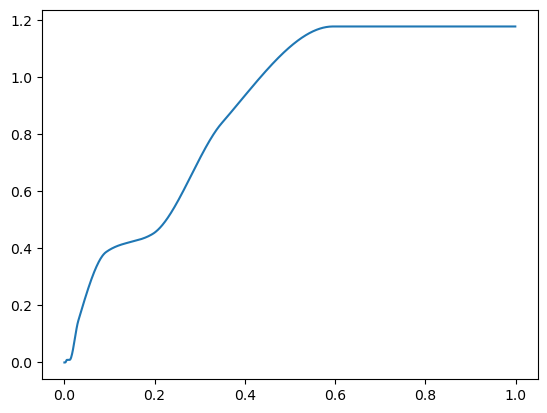

[0.         0.0268259  0.04791737 0.07636166 0.21104908 0.25926495
 0.29726124 0.34119892 0.40337467 0.46899319 1.        ] betas
[0.         0.97564677 0.23047115 0.24271168 0.6416055  0.18504264
 0.13977338 0.15079473 0.18661833 0.17049817 0.715291  ] r
-22489.721869183253 score post


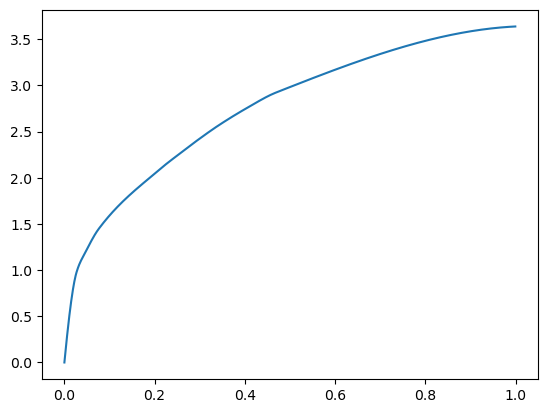

[0.         0.00762463 0.01694965 0.03567028 0.07737064 0.14601421
 0.23450756 0.33532238 0.46290112 0.65953541 1.        ] betas
[0.         0.92222435 0.49764553 0.39817152 0.36650124 0.41540257
 0.38814376 0.35789491 0.36146323 0.41515162 0.44249415] r
-22483.2822716802 score post


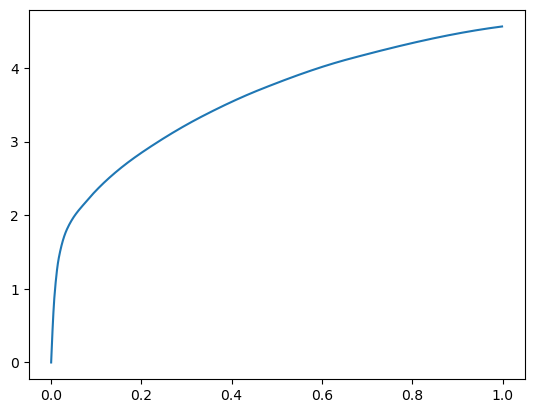

[0.         0.00320721 0.00750256 0.01551914 0.03628445 0.09141445
 0.17488003 0.29025555 0.44092655 0.65113926 1.        ] betas
[0.         0.79810464 0.49147922 0.51038576 0.39473384 0.42490976
 0.44078839 0.4510246  0.41810697 0.37919954 0.40482007] r
-22480.269231963164 score post


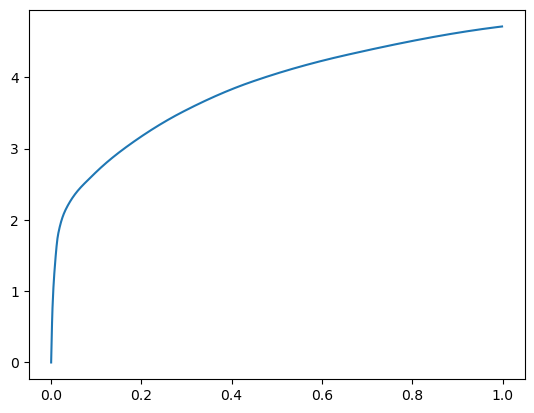

[0.         0.00165653 0.00419331 0.0090189  0.01842976 0.05251598
 0.12728977 0.23140049 0.376647   0.60701275 1.        ] betas
[0.         0.77940247 0.47743345 0.49619665 0.47445283 0.44266185
 0.49828171 0.48701913 0.44589474 0.47384613 0.50020522] r
-22482.458794922564 score post


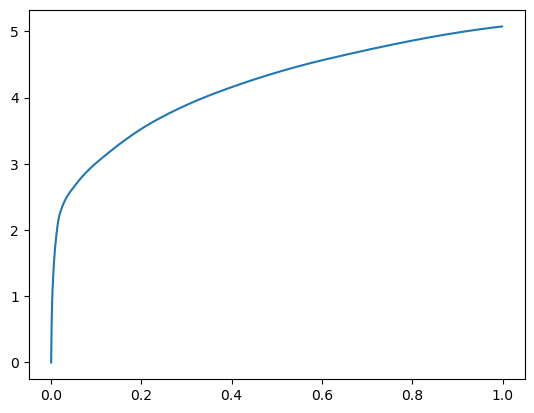

[0.00000000e+00 9.43183899e-04 2.66933441e-03 6.38866425e-03
 1.34344101e-02 3.81345749e-02 1.05242729e-01 2.05666542e-01
 3.60575676e-01 6.02469444e-01 1.00000000e+00] betas
[0.         0.58385142 0.45878302 0.50528102 0.51387324 0.53691852
 0.55048488 0.50604907 0.4798869  0.55629615 0.53777616] r
-22481.378721678564 score post


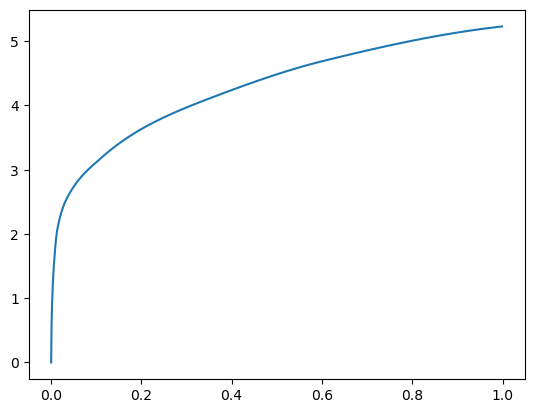

[0.00000000e+00 8.03947449e-04 2.68650055e-03 6.60228729e-03
 1.42526627e-02 3.93896103e-02 1.03396416e-01 2.07001686e-01
 3.78746986e-01 6.11027718e-01 1.00000000e+00] betas
[0.         0.551056   0.58117561 0.50624169 0.49194976 0.47183972
 0.48456594 0.53588882 0.59344306 0.49142998 0.52161345] r
-22485.2760344757 score post


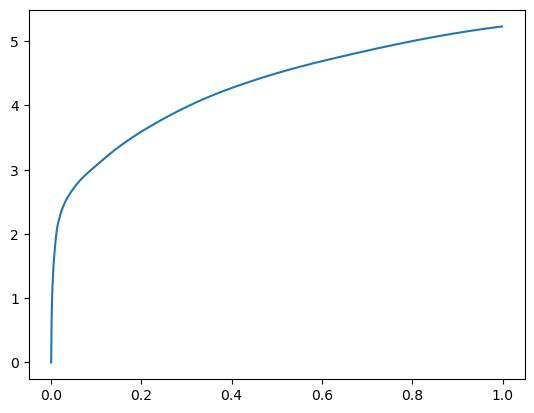

[0.00000000e+00 7.44819641e-04 2.28023529e-03 5.85651398e-03
 1.32169724e-02 4.04729843e-02 1.11645699e-01 2.16038704e-01
 3.66667747e-01 6.10247612e-01 1.00000000e+00] betas
[0.         0.56756473 0.53847021 0.51058437 0.5404382  0.50271548
 0.46790541 0.52742998 0.52119746 0.51533658 0.49933488] r
-22481.378721678564 score post


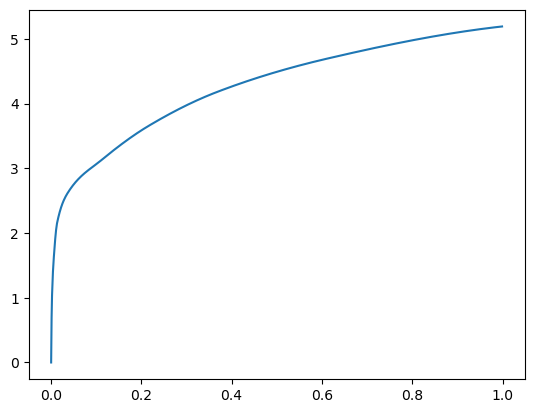

[0.00000000e+00 6.55174255e-04 1.99413300e-03 5.28240204e-03
 1.14374161e-02 3.46269608e-02 1.09345436e-01 2.10946083e-01
 3.58038902e-01 5.98250389e-01 1.00000000e+00] betas
[0.         0.46422361 0.47253829 0.51676799 0.49220343 0.56432179
 0.58665411 0.4773921  0.49504476 0.51968237 0.54785061] r
-22485.59168285815 score post


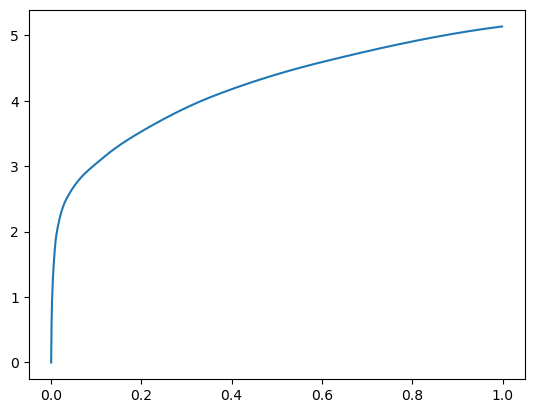

[0.00000000e+00 7.58171082e-04 2.40993500e-03 6.10256195e-03
 1.42393112e-02 3.92789841e-02 1.06858253e-01 2.16418266e-01
 3.73240471e-01 6.18409157e-01 1.00000000e+00] betas
[0.         0.53779453 0.59004796 0.50231124 0.52219908 0.44156802
 0.46679216 0.50404467 0.54178209 0.57565223 0.49826908] r
-22480.269231963164 score post


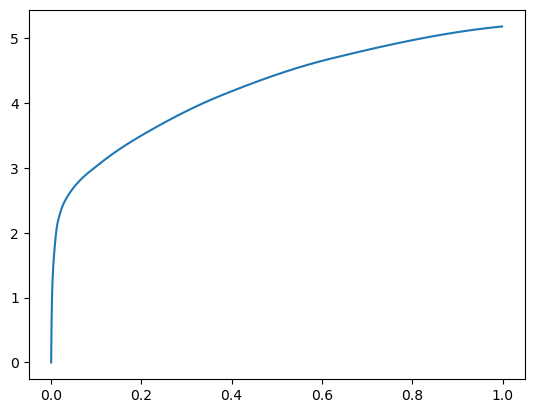

[0.00000000e+00 7.20024109e-04 2.03418732e-03 5.31101227e-03
 1.22385025e-02 3.89318466e-02 1.15500450e-01 2.32060432e-01
 3.86672020e-01 6.07104301e-01 1.00000000e+00] betas
[0.         0.54684012 0.5003738  0.47718456 0.51981271 0.57205552
 0.56151131 0.51988077 0.50976351 0.49881939 0.51274215] r
-22487.19944603341 score post


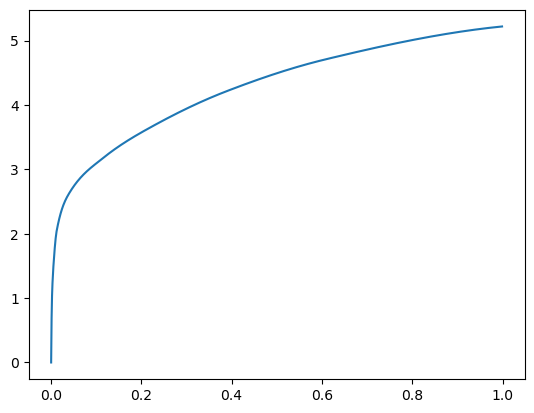

[0.00000000e+00 6.74247742e-04 2.01892853e-03 5.71727753e-03
 1.34286880e-02 3.83634567e-02 1.07142448e-01 2.20486641e-01
 3.75000954e-01 6.01763725e-01 1.00000000e+00] betas
[0.         0.45847554 0.51017844 0.54654047 0.54013964 0.52231017
 0.45848027 0.53162131 0.55086804 0.49893376 0.47387396] r
-22480.269231963164 score post


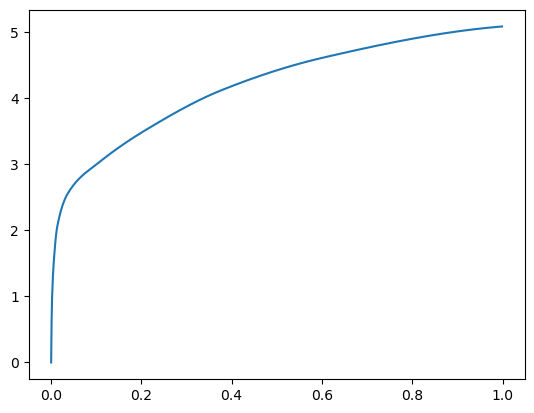

[0.00000000e+00 7.77244568e-04 2.24208832e-03 5.84125519e-03
 1.29365921e-02 3.56187820e-02 1.10516548e-01 2.19567299e-01
 3.59162331e-01 5.80386162e-01 1.00000000e+00] betas
[0.         0.53029277 0.45969447 0.52154325 0.51453506 0.50150796
 0.56586449 0.45804656 0.49225653 0.49514779 0.5403435 ] r
-22480.269231963164 score post


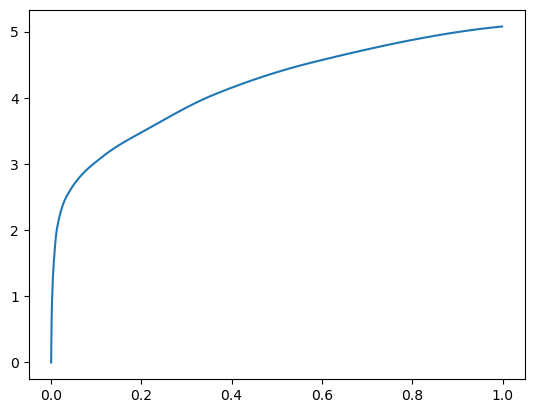

[0.00000000e+00 7.29560852e-04 2.36797333e-03 5.96332550e-03
 1.30872726e-02 3.66029739e-02 1.02103233e-01 2.20601082e-01
 3.66259575e-01 5.99759102e-01 1.00000000e+00] betas
[0.         0.4967449  0.54211977 0.54183219 0.48832309 0.4931071
 0.49271662 0.57042822 0.46181729 0.52765615 0.51453813] r
-22480.269231963164 score post


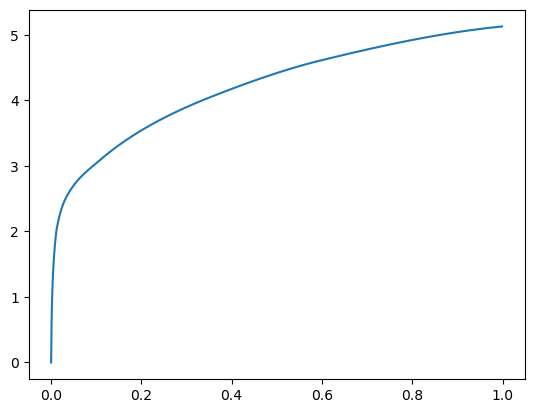

[0.00000000e+00 7.63893127e-04 2.30884552e-03 5.55515289e-03
 1.26295090e-02 3.68127823e-02 1.05921745e-01 2.11701393e-01
 3.72385979e-01 6.00718498e-01 1.00000000e+00] betas
[0.         0.49179285 0.53593385 0.45167309 0.5212091  0.52595495
 0.49554138 0.47881279 0.51921355 0.51323392 0.50725082] r
-22484.348467993714 score post


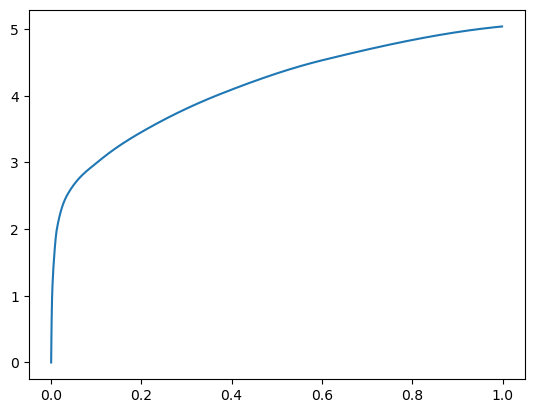

[0.00000000e+00 7.90596008e-04 2.21920013e-03 5.88512421e-03
 1.30529404e-02 3.62844467e-02 1.06324196e-01 2.18966484e-01
 3.77009392e-01 6.02635384e-01 1.00000000e+00] betas
[0.         0.54107637 0.48898699 0.50452415 0.49422166 0.43539471
 0.5015961  0.53202548 0.53984071 0.54952582 0.51166629] r
-22480.269231963164 score post


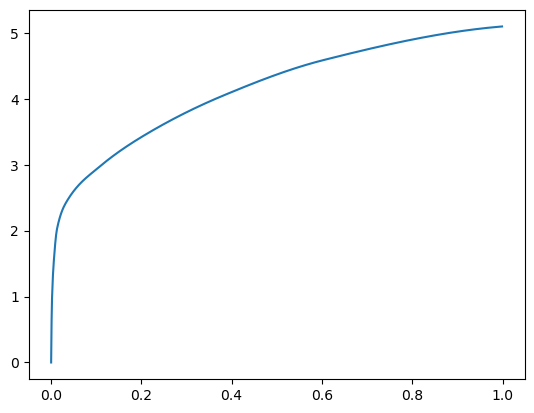

[0.00000000e+00 7.27653503e-04 2.17151642e-03 5.83362579e-03
 1.33829117e-02 4.44345474e-02 1.23072624e-01 2.37132072e-01
 3.91493797e-01 6.03663445e-01 1.00000000e+00] betas
[0.         0.51068559 0.48087336 0.51260376 0.53122955 0.53373507
 0.49253835 0.50860918 0.47221703 0.47875016 0.52510893] r
-22483.343010040644 score post


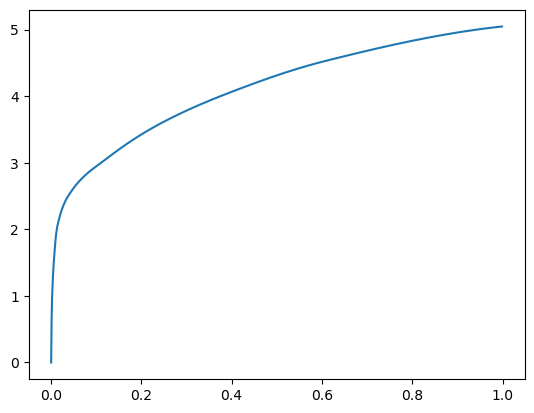

[0.00000000e+00 7.14302063e-04 2.25734711e-03 5.93471527e-03
 1.28984451e-02 3.98626328e-02 1.16497993e-01 2.26998329e-01
 3.89430046e-01 6.15643501e-01 1.00000000e+00] betas
[0.         0.50580182 0.46278061 0.51824037 0.56620616 0.54938055
 0.5415479  0.58509454 0.50251611 0.46727875 0.47267856] r
-22480.269231963164 score post


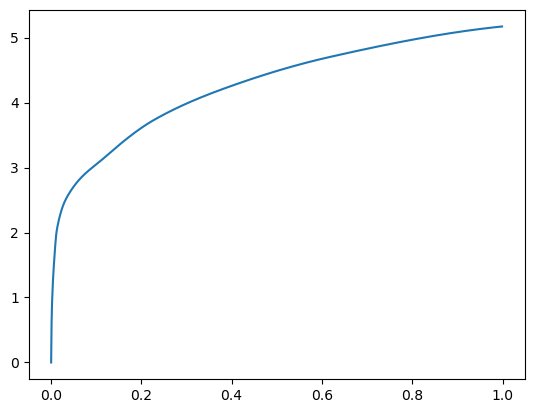

[0.00000000e+00 7.41004944e-04 2.59685516e-03 6.54697418e-03
 1.33237839e-02 3.84111404e-02 1.09562874e-01 2.02004433e-01
 3.52953911e-01 5.88528633e-01 1.00000000e+00] betas
[0.         0.49496139 0.57559668 0.50034766 0.48069968 0.46515632
 0.49884042 0.45124119 0.53376428 0.53884023 0.57035414] r
-22480.269231963164 score post


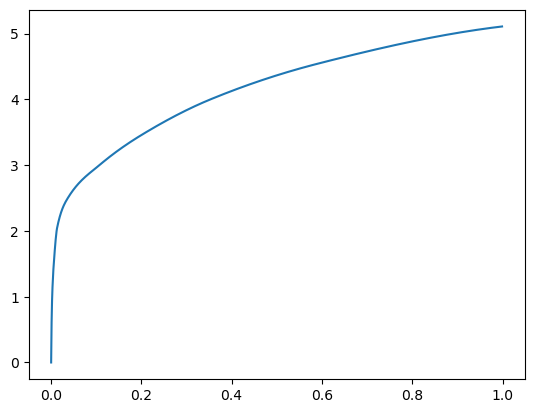

[0.00000000e+00 7.77244568e-04 2.35843658e-03 6.14261627e-03
 1.31025314e-02 4.19969559e-02 1.18390083e-01 2.29119301e-01
 3.84692192e-01 6.22479439e-01 1.00000000e+00] betas
[0.         0.51687135 0.49980159 0.52258018 0.49740569 0.50909998
 0.48522214 0.5118769  0.51699019 0.54119369 0.48022495] r
-22480.269231963164 score post


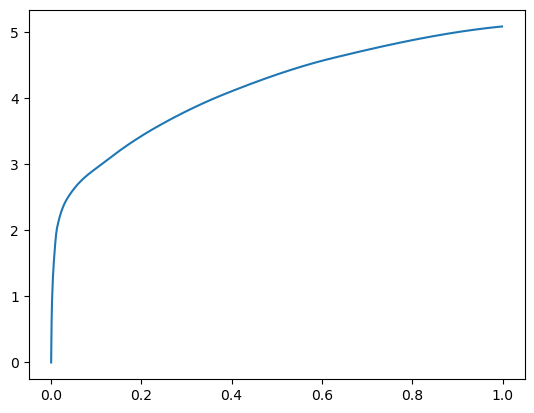

[0.00000000e+00 7.58171082e-04 2.35652924e-03 5.99002838e-03
 1.29766464e-02 4.14876938e-02 1.21695518e-01 2.32726097e-01
 3.86580467e-01 6.06244087e-01 1.00000000e+00] betas
[0.         0.5433983  0.53193923 0.51046225 0.52763685 0.54445571
 0.53904153 0.51455856 0.48091435 0.51389072 0.51426585] r
-22480.269231963164 score post


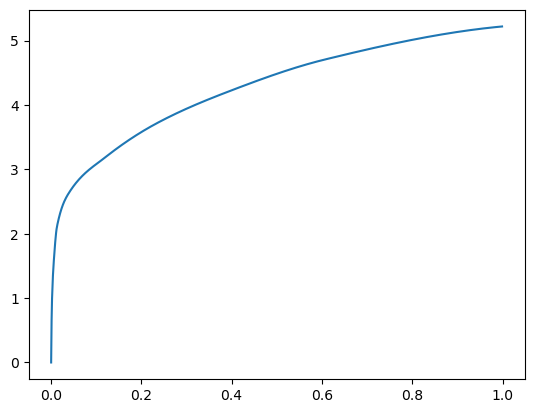

[0.00000000e+00 7.14302063e-04 2.21347809e-03 5.79738617e-03
 1.23395920e-02 3.71942520e-02 1.09627724e-01 2.18016624e-01
 3.80686760e-01 6.01767540e-01 1.00000000e+00] betas
[0.         0.50151114 0.55699687 0.51843741 0.49879857 0.47582612
 0.50309727 0.50193649 0.50287111 0.5005637  0.4980376 ] r
-22481.378721678564 score post


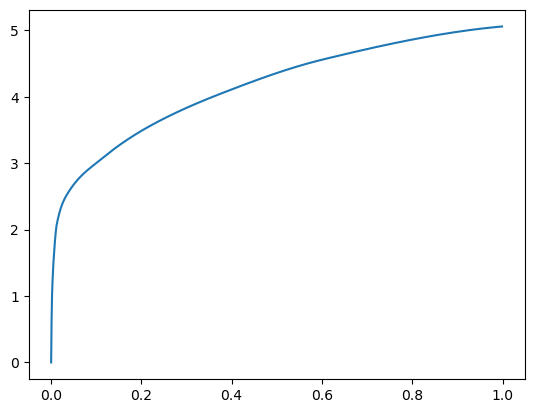

[0.00000000e+00 7.21931458e-04 2.02083588e-03 5.22899628e-03
 1.11551285e-02 3.51724625e-02 1.06066704e-01 2.13805199e-01
 3.75761986e-01 5.97126961e-01 1.00000000e+00] betas
[0.         0.46872097 0.49083294 0.52088461 0.49269027 0.56638546
 0.55073717 0.54262208 0.59247235 0.44436555 0.55017217] r
-22486.27574969735 score post


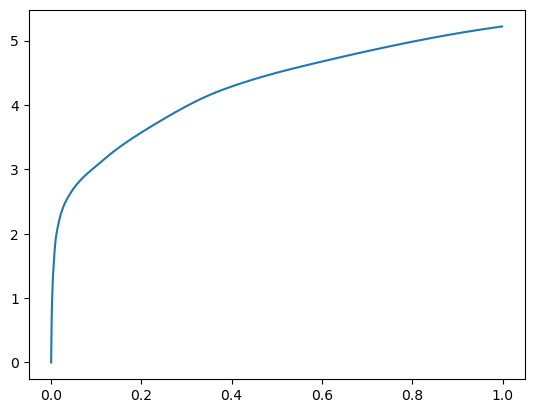

[0.00000000e+00 8.32557678e-04 2.39086151e-03 5.99956512e-03
 1.41439438e-02 4.10032272e-02 1.12895012e-01 2.18726158e-01
 3.58000755e-01 6.14220619e-01 1.00000000e+00] betas
[0.         0.51623199 0.52056457 0.47723605 0.50722305 0.51565156
 0.51921811 0.4864206  0.45876762 0.58474846 0.52597358] r
-22484.348661750126 score post


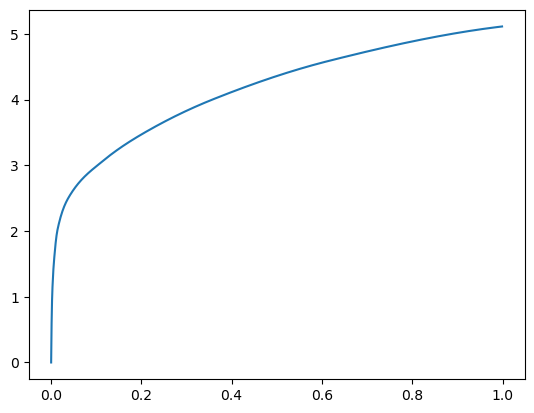

[0.00000000e+00 8.21113586e-04 2.32219696e-03 6.22081757e-03
 1.48820877e-02 4.27217484e-02 1.14851952e-01 2.28102684e-01
 3.90765190e-01 6.22748375e-01 1.00000000e+00] betas
[0.         0.51943123 0.49008997 0.52477006 0.52991488 0.4343002
 0.52610033 0.53962678 0.51034947 0.51927817 0.47031256] r
-22485.59168285815 score post


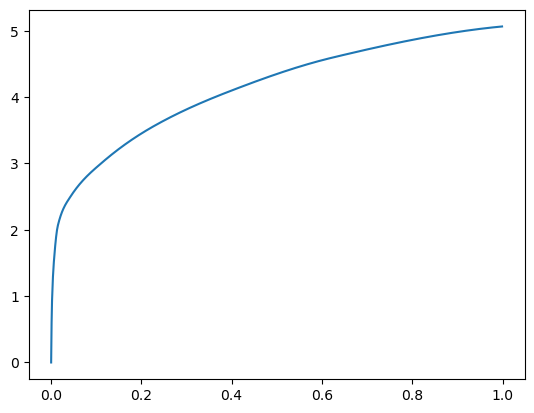

[0.00000000e+00 7.92503357e-04 2.33936310e-03 6.05297089e-03
 1.37147903e-02 4.59871292e-02 1.17236137e-01 2.23107338e-01
 3.82012367e-01 6.01630211e-01 1.00000000e+00] betas
[0.         0.52131322 0.53642138 0.51191641 0.50826823 0.54526039
 0.47173273 0.53129189 0.52592993 0.48001261 0.50303087] r
-22480.269231963164 score post


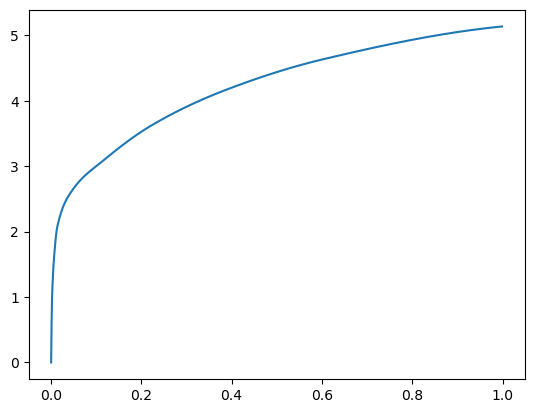

[0.00000000e+00 7.75337219e-04 2.20203400e-03 5.74588776e-03
 1.30262375e-02 4.05588150e-02 1.14815712e-01 2.15460777e-01
 3.65838051e-01 5.95314980e-01 1.00000000e+00] betas
[0.         0.52852576 0.49168719 0.51673727 0.548694   0.5398596
 0.51157879 0.49159995 0.51344412 0.48614168 0.53856646] r
-22481.378721678564 score post


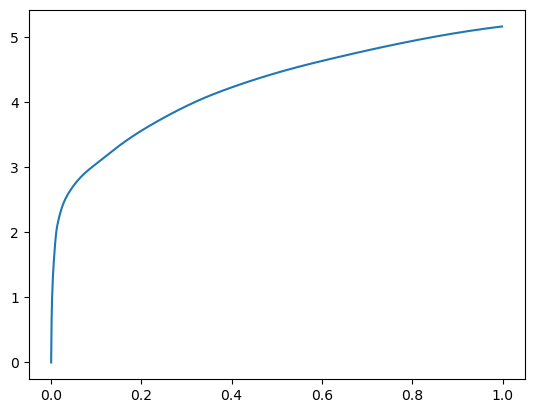

[0.00000000e+00 7.50541687e-04 2.26306915e-03 5.87368011e-03
 1.25360489e-02 3.68528366e-02 1.08239174e-01 2.12550163e-01
 3.62603188e-01 6.08466148e-01 1.00000000e+00] betas
[0.         0.51185345 0.48786163 0.4881529  0.48966885 0.52501132
 0.49620195 0.48240622 0.53516172 0.50906919 0.5292727 ] r
-22480.269231963164 score post


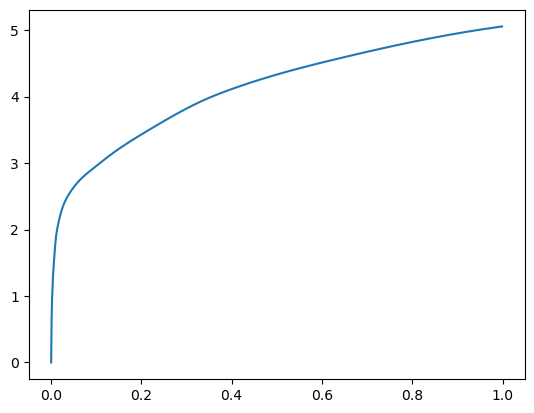

[0.00000000e+00 7.37190247e-04 2.31838226e-03 6.16550446e-03
 1.37605667e-02 3.90558243e-02 1.14382744e-01 2.26662636e-01
 3.72971535e-01 6.22845650e-01 1.00000000e+00] betas
[0.         0.47360991 0.54031918 0.53870754 0.52835118 0.50247107
 0.50582368 0.53575433 0.47639633 0.53061672 0.50935039] r
-22481.990460408004 score post


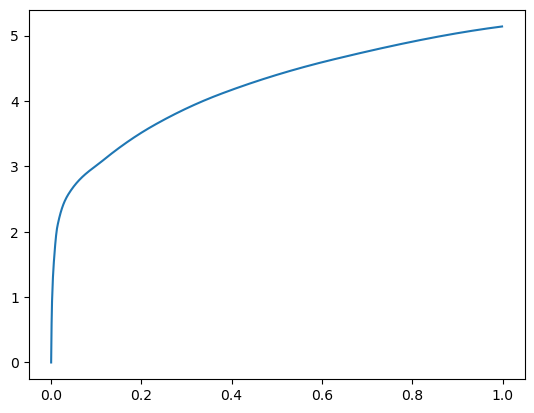

[0.00000000e+00 8.24928284e-04 2.38704681e-03 6.06060028e-03
 1.31177902e-02 3.79056931e-02 1.13593102e-01 2.20072746e-01
 3.77451897e-01 6.19996071e-01 1.00000000e+00] betas
[0.         0.54132492 0.51504031 0.48804206 0.48631301 0.51305231
 0.48983326 0.50182243 0.54053145 0.51996523 0.4842265 ] r
-22482.597739918583 score post


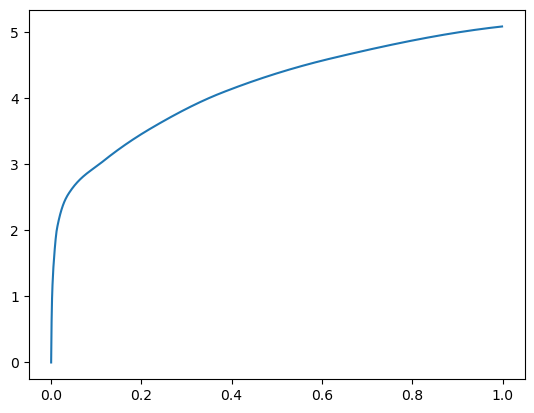

[0.00000000e+00 7.54356384e-04 2.20012665e-03 5.84506989e-03
 1.31559372e-02 3.75661850e-02 1.16236687e-01 2.25241661e-01
 3.73082161e-01 6.05648994e-01 1.00000000e+00] betas
[0.         0.47987187 0.47881746 0.53533172 0.51933994 0.45218307
 0.52097529 0.5055842  0.49846841 0.51004611 0.50194664] r
-22482.597739918583 score post


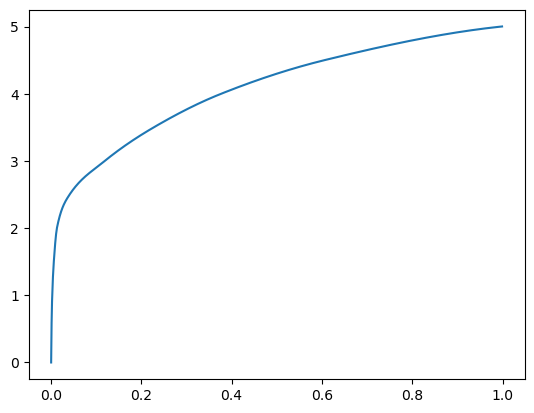

[0.00000000e+00 8.00132751e-04 2.39849091e-03 5.91373444e-03
 1.28049850e-02 4.10223007e-02 1.18977547e-01 2.27707863e-01
 3.77346992e-01 6.06675148e-01 1.00000000e+00] betas
[0.         0.57890359 0.49443124 0.517817   0.51315802 0.5195813
 0.4965907  0.53205264 0.51427517 0.48975857 0.48512801] r
-22480.269231963164 score post


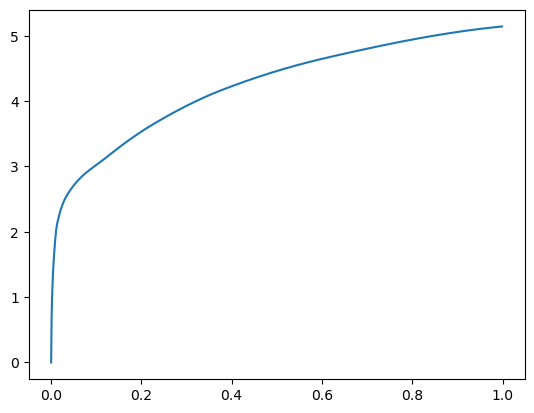

[0.00000000e+00 6.74247742e-04 2.19058990e-03 5.45597076e-03
 1.16739273e-02 3.60460281e-02 1.12416267e-01 2.14961052e-01
 3.58180046e-01 5.88988304e-01 1.00000000e+00] betas
[0.         0.47094884 0.52034675 0.46669517 0.50290414 0.5601035
 0.54602575 0.5351412  0.46899645 0.53559261 0.51551457] r
-22484.252724367707 score post


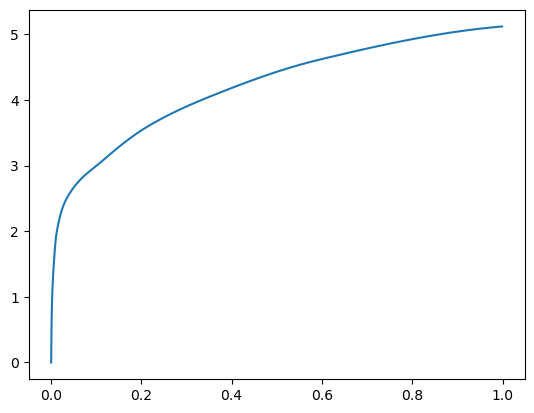

[0.00000000e+00 7.61985779e-04 2.35080719e-03 6.20555878e-03
 1.39875412e-02 3.95040512e-02 1.13459587e-01 2.10947990e-01
 3.67896080e-01 5.90950966e-01 1.00000000e+00] betas
[0.         0.50191947 0.58207655 0.53469128 0.49213814 0.45237658
 0.52402634 0.53051702 0.50649553 0.46209698 0.52835463] r
-22482.597739918583 score post


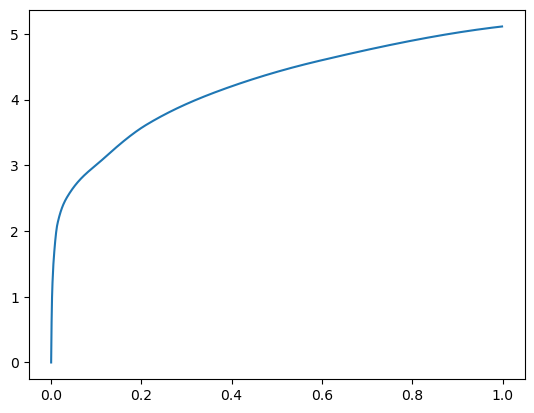

[0.00000000e+00 7.81059265e-04 2.09903717e-03 5.33390045e-03
 1.23071671e-02 3.89661789e-02 1.10449791e-01 2.02227592e-01
 3.55362892e-01 6.01349831e-01 1.00000000e+00] betas
[0.         0.54386503 0.51367568 0.50078841 0.51894139 0.55047118
 0.57215208 0.45500891 0.50964501 0.59544629 0.51716049] r
-22483.343010040644 score post


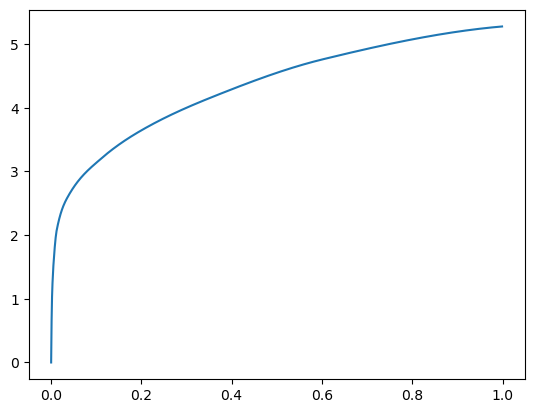

[0.00000000e+00 7.50541687e-04 2.08950043e-03 5.57231903e-03
 1.32532120e-02 3.98492813e-02 1.04979515e-01 2.12031364e-01
 3.75611305e-01 5.95332146e-01 1.00000000e+00] betas
[0.         0.53399159 0.50982939 0.50968404 0.56551931 0.48913261
 0.47856655 0.5127596  0.51708243 0.51944743 0.52678264] r
-22481.378721678564 score post


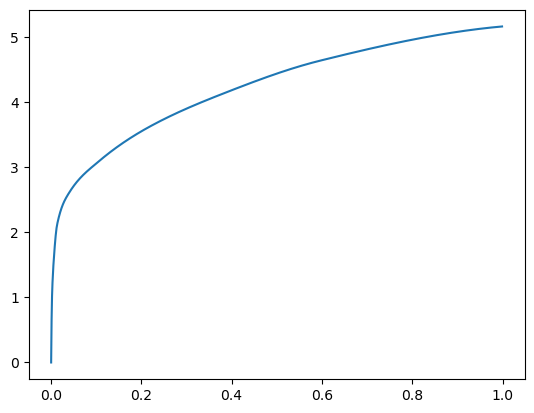

[0.00000000e+00 7.16209412e-04 2.04181671e-03 5.52654266e-03
 1.19581223e-02 3.74612808e-02 1.06842995e-01 2.15798378e-01
 3.80633354e-01 6.01418495e-01 1.00000000e+00] betas
[0.         0.48541117 0.47796092 0.50884663 0.52482549 0.54275809
 0.53382396 0.52854627 0.49755381 0.55441356 0.51826664] r
-22483.75060619476 score post


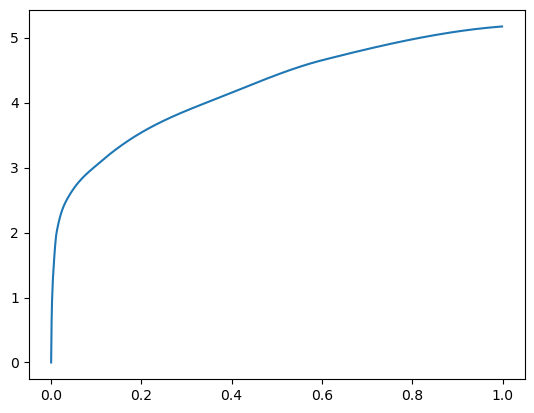

[0.00000000e+00 7.82966614e-04 2.37751007e-03 6.27422333e-03
 1.39360428e-02 4.14018631e-02 1.11819267e-01 2.20742226e-01
 3.94433022e-01 6.01998329e-01 1.00000000e+00] betas
[0.         0.52720521 0.50779696 0.53825638 0.48840615 0.46850574
 0.46524759 0.5142474  0.57874414 0.47308102 0.54563957] r
-22488.168696681314 score post


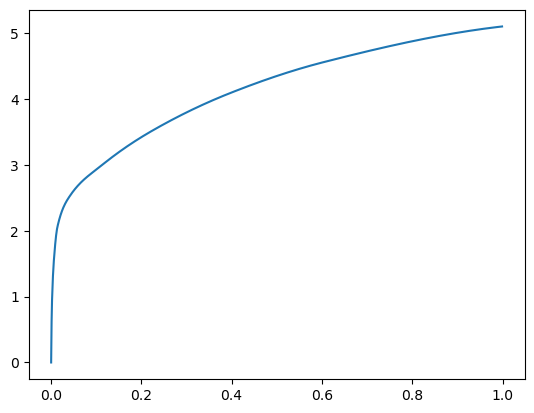

[0.00000000e+00 7.46726990e-04 2.31266022e-03 5.83744049e-03
 1.33676529e-02 4.37459946e-02 1.24417305e-01 2.37505913e-01
 3.93441200e-01 6.21973991e-01 1.00000000e+00] betas
[0.         0.5248976  0.54899533 0.4752212  0.51773601 0.5407065
 0.54874291 0.53200968 0.50116277 0.45660307 0.48375549] r
-22480.269231963164 score post


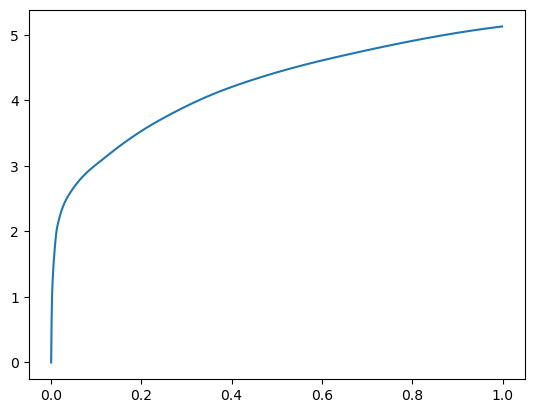

[0.00000000e+00 7.21931458e-04 2.10094452e-03 5.73062897e-03
 1.29384995e-02 3.97615433e-02 1.10041618e-01 2.13313103e-01
 3.61250877e-01 6.03869438e-01 1.00000000e+00] betas
[0.         0.51090507 0.48212082 0.55262143 0.52611948 0.49310998
 0.50423413 0.46661401 0.50886304 0.48401265 0.48464535] r
-22484.09117069985 score post


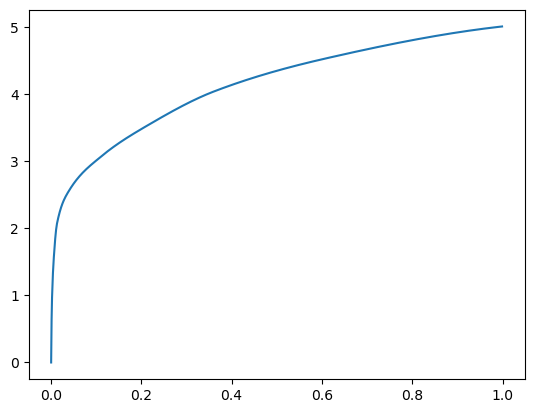

[0.00000000e+00 7.02857971e-04 2.14290619e-03 5.33580780e-03
 1.14049911e-02 3.46040726e-02 9.90438461e-02 2.06604958e-01
 3.48580360e-01 5.93180656e-01 1.00000000e+00] betas
[0.         0.48966052 0.52490698 0.4798262  0.52295198 0.52831954
 0.49927979 0.5315256  0.5109176  0.50519142 0.51878572] r
-22480.269231963164 score post


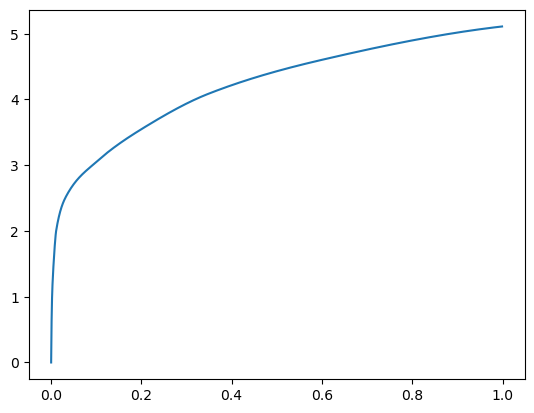

[0.00000000e+00 7.46726990e-04 2.17723846e-03 5.68294525e-03
 1.20859146e-02 3.54108810e-02 1.02633476e-01 2.06959724e-01
 3.49215508e-01 5.97943306e-01 1.00000000e+00] betas
[0.         0.47441217 0.52493516 0.50639512 0.53112373 0.47655452
 0.46797527 0.5465798  0.4893292  0.5677681  0.49102958] r
-22486.442287327107 score post


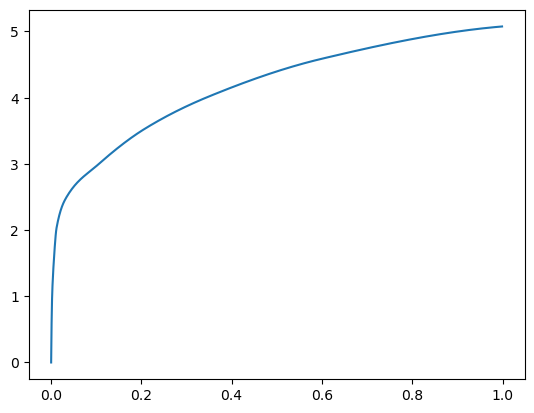

[0.00000000e+00 8.17298889e-04 2.24971771e-03 5.84125519e-03
 1.19199753e-02 3.76443863e-02 1.13379478e-01 2.13040352e-01
 3.64939690e-01 5.87964058e-01 1.00000000e+00] betas
[0.         0.50888873 0.45072254 0.49604123 0.48010843 0.60469215
 0.51075373 0.48726466 0.486963   0.44114655 0.56948083] r
-22483.75060619476 score post


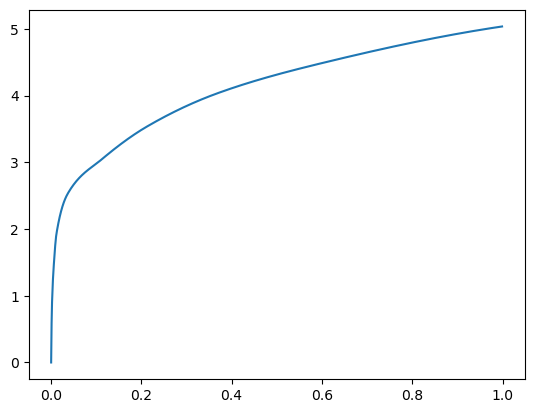

[0.00000000e+00 8.05854797e-04 2.49195099e-03 6.38294220e-03
 1.39341354e-02 3.57828140e-02 1.08038902e-01 2.09704399e-01
 3.66316795e-01 6.28144264e-01 1.00000000e+00] betas
[0.         0.54267014 0.53949256 0.51187069 0.51680071 0.42646559
 0.44564746 0.46083132 0.52738844 0.62695521 0.41794348] r
-22480.269231963164 score post


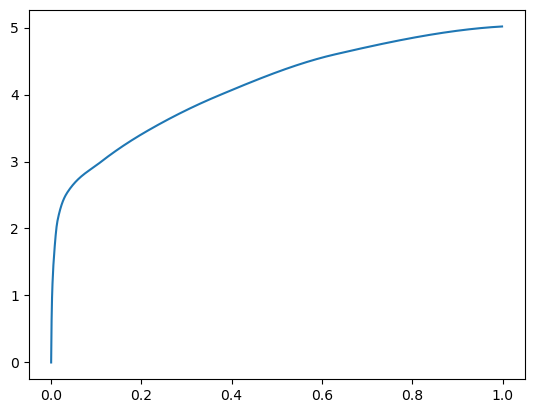

[0.00000000e+00 7.21931458e-04 2.13527679e-03 5.46550751e-03
 1.16682053e-02 3.31106186e-02 1.13144875e-01 2.27255821e-01
 3.81022453e-01 5.80878258e-01 1.00000000e+00] betas
[0.         0.54418708 0.51360382 0.48417332 0.53309997 0.48092394
 0.58691712 0.5118418  0.46853016 0.41447047 0.56788076] r
-22481.378721678564 score post


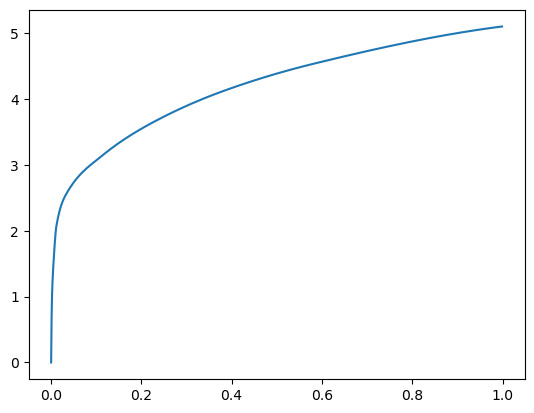

[0.00000000e+00 6.58988953e-04 1.97887421e-03 5.37204742e-03
 1.09720230e-02 3.28531265e-02 9.86127853e-02 2.05800056e-01
 3.65750313e-01 6.15283012e-01 1.00000000e+00] betas
[0.         0.45303228 0.48834354 0.51193901 0.49356717 0.59197995
 0.54365945 0.54538507 0.58020103 0.56212162 0.46645325] r
-22480.269231963164 score post


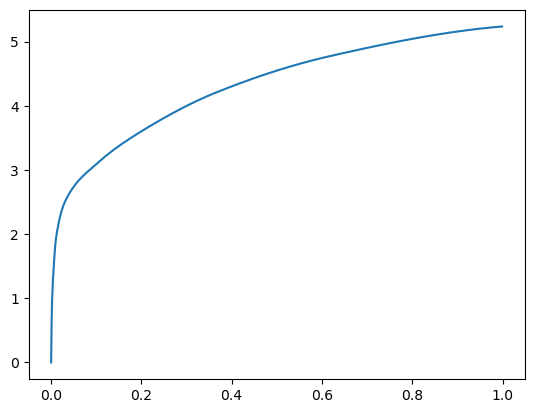

[0.00000000e+00 8.03947449e-04 2.47859955e-03 6.42871857e-03
 1.44586563e-02 3.89394760e-02 1.08115196e-01 2.14678764e-01
 3.59204292e-01 5.81725121e-01 1.00000000e+00] betas
[0.         0.52582846 0.53736676 0.52173755 0.50348749 0.4957036
 0.46645156 0.52809148 0.48752305 0.51308199 0.59517887] r
-22482.597739918583 score post


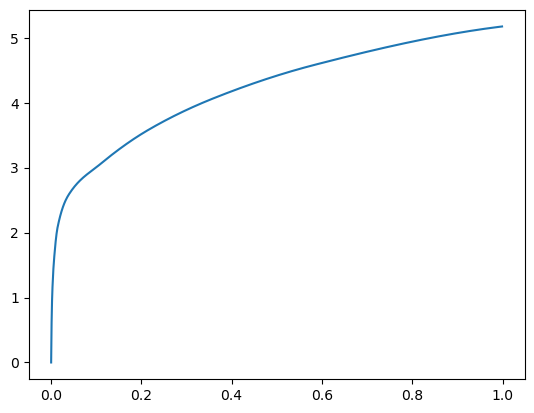

[0.00000000e+00 7.84873962e-04 2.34317780e-03 6.07013702e-03
 1.39360428e-02 3.92217636e-02 1.17590904e-01 2.25552559e-01
 3.86153221e-01 6.25348091e-01 1.00000000e+00] betas
[0.         0.51481935 0.52665636 0.4833439  0.4883911  0.43719398
 0.55999415 0.52508665 0.52546512 0.4793635  0.43506788] r
-22481.990460408004 score post


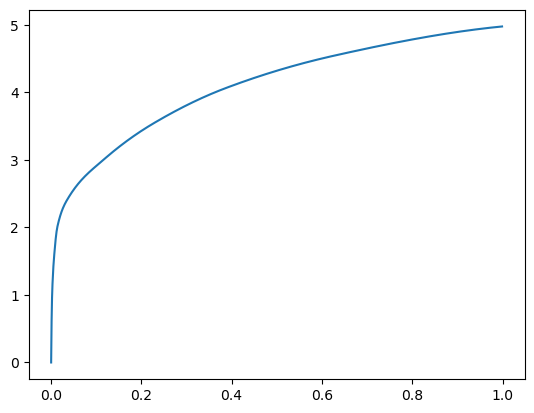

[0.00000000e+00 7.48634338e-04 2.13146210e-03 5.70964813e-03
 1.32455826e-02 4.27350998e-02 1.13244057e-01 2.12574959e-01
 3.55994225e-01 5.85829735e-01 1.00000000e+00] betas
[0.         0.52283602 0.45765631 0.50291195 0.51086365 0.49084565
 0.46169057 0.43435191 0.49822165 0.52486721 0.61146356] r
-22480.269231963164 score post


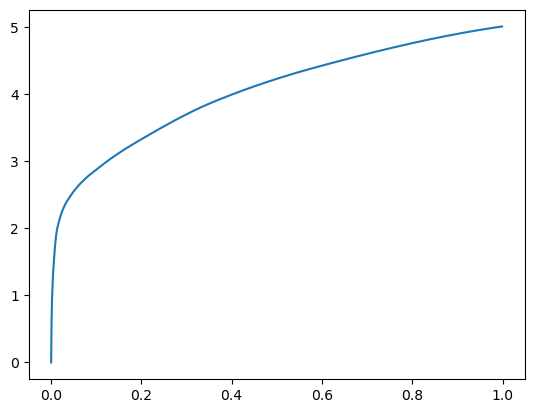

[0.00000000e+00 7.04765320e-04 2.24018097e-03 5.93471527e-03
 1.36442184e-02 4.50525284e-02 1.25426292e-01 2.46356010e-01
 4.05734062e-01 6.46904945e-01 1.00000000e+00] betas
[0.         0.51056945 0.49476625 0.49423563 0.49496856 0.56049628
 0.59450726 0.52105086 0.48975312 0.52654325 0.43539594] r
-22488.616312500653 score post


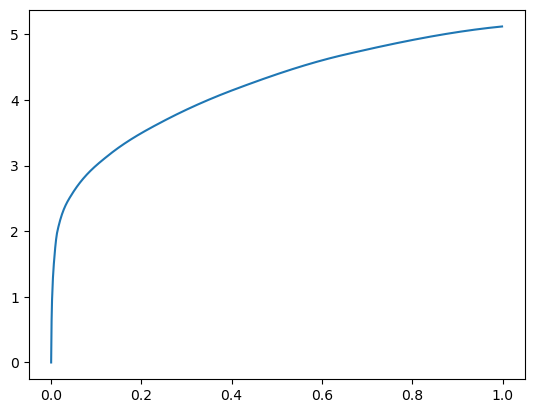

[0.00000000e+00 7.08580017e-04 2.33745575e-03 6.35051727e-03
 1.54352188e-02 4.56037521e-02 1.11805916e-01 2.23160744e-01
 3.82130623e-01 6.02677345e-01 1.00000000e+00] betas
[0.         0.46753682 0.51991177 0.5421724  0.53363482 0.50434723
 0.48701454 0.49203248 0.57783277 0.48232423 0.55754487] r
-22481.378721678564 score post


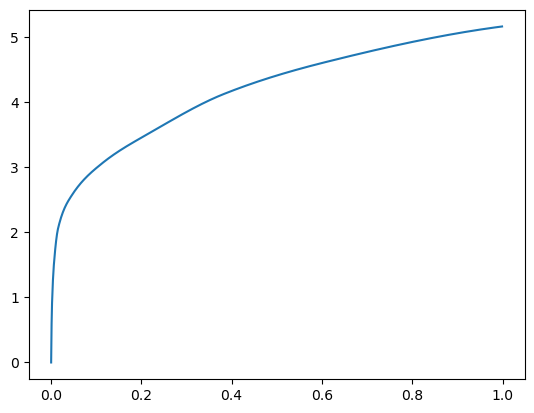

[0.00000000e+00 8.19206238e-04 2.56824493e-03 6.58130646e-03
 1.55210495e-02 4.69751358e-02 1.19807243e-01 2.40183830e-01
 3.84667397e-01 6.26378059e-01 1.00000000e+00] betas
[0.         0.57328466 0.53560623 0.52702833 0.56338949 0.48419708
 0.49868557 0.54800284 0.49407363 0.58956011 0.45171858] r
-22480.269231963164 score post


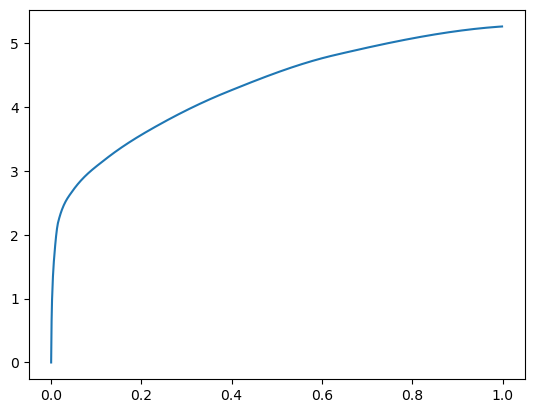

[0.00000000e+00 7.23838806e-04 2.29930878e-03 5.97476959e-03
 1.31349564e-02 4.18500900e-02 1.15675926e-01 2.28962898e-01
 3.80593300e-01 5.85604668e-01 1.00000000e+00] betas
[0.         0.52015025 0.55135578 0.55838065 0.51299761 0.54392008
 0.51856536 0.50137338 0.48355047 0.49840904 0.5235102 ] r
-22486.68489191071 score post


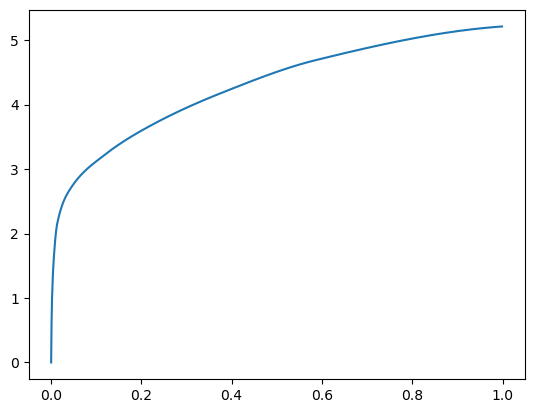

[0.00000000e+00 7.25746155e-04 2.17342377e-03 5.35488129e-03
 1.17654800e-02 3.49073410e-02 1.01292610e-01 2.13578224e-01
 3.73240471e-01 5.86932182e-01 1.00000000e+00] betas
[0.         0.49014536 0.48321819 0.4413726  0.54730099 0.52894834
 0.50698576 0.54303702 0.49361614 0.52246435 0.54051907] r
-22480.269231963164 score post


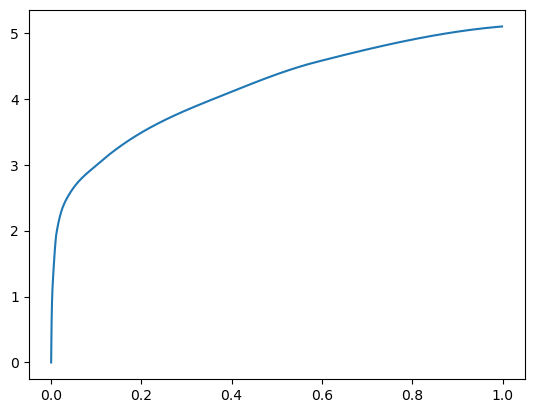

[0.00000000e+00 7.67707825e-04 2.40612030e-03 6.41727448e-03
 1.37720108e-02 3.97748947e-02 1.11540794e-01 2.20822334e-01
 3.89044762e-01 6.04468346e-01 1.00000000e+00] betas
[0.         0.51323911 0.52630136 0.56521412 0.44152539 0.4583542
 0.50735052 0.53847694 0.50530396 0.50808554 0.48381644] r
-22481.378721678564 score post


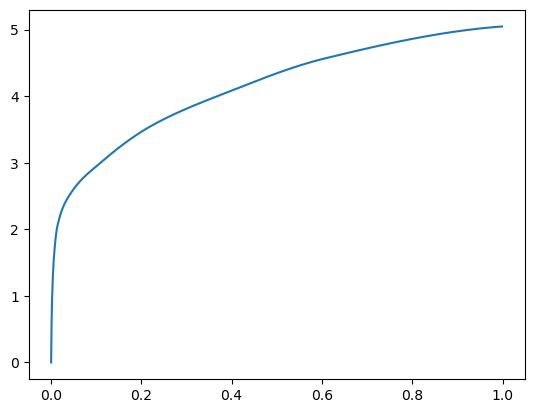

[0.00000000e+00 7.48634338e-04 2.26688385e-03 5.49030304e-03
 1.29671097e-02 4.15773392e-02 1.14377022e-01 2.16382027e-01
 3.82397652e-01 5.92310905e-01 1.00000000e+00] betas
[0.         0.52444453 0.52380937 0.4838157  0.51778692 0.54551419
 0.46876618 0.50546917 0.52184185 0.46888625 0.56704129] r
-22480.269231963164 score post


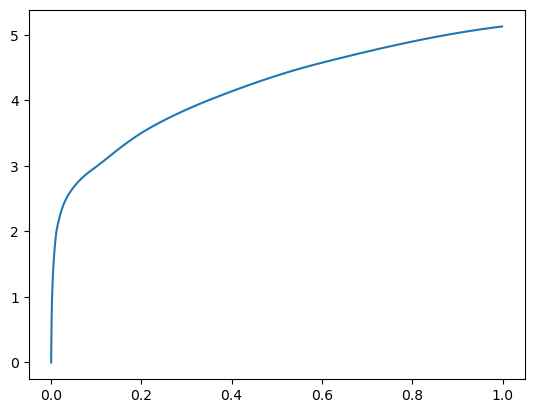

[0.00000000e+00 7.23838806e-04 2.16579437e-03 5.55133820e-03
 1.29995346e-02 3.86228561e-02 1.16557121e-01 2.21415520e-01
 3.86382103e-01 6.23461723e-01 1.00000000e+00] betas
[0.         0.48686751 0.52291558 0.47754859 0.51953383 0.50041367
 0.50934906 0.54122554 0.52268871 0.47069894 0.5451265 ] r
-22480.269231963164 score post


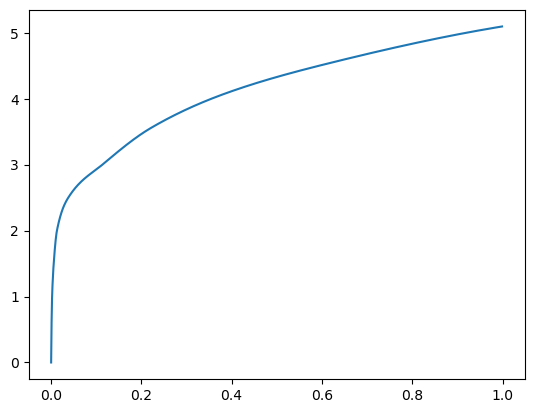

[0.00000000e+00 7.71522522e-04 2.20966339e-03 5.98239899e-03
 1.39513016e-02 4.25882339e-02 1.23669624e-01 2.23826408e-01
 3.84991646e-01 6.44522667e-01 1.00000000e+00] betas
[0.         0.53121776 0.47333417 0.51315825 0.52607035 0.51005951
 0.5670369  0.50039058 0.51218726 0.56046099 0.4118892 ] r
-22480.269231963164 score post


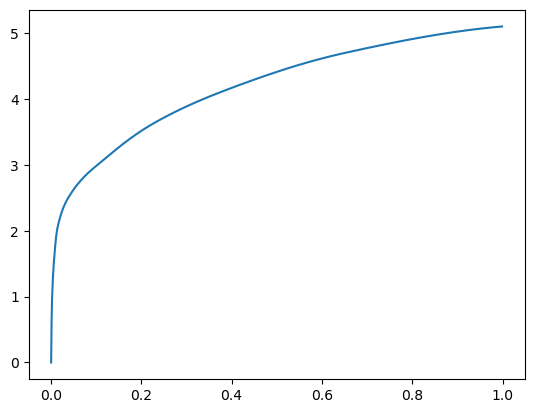

[0.00000000e+00 7.27653503e-04 2.29167938e-03 6.13498688e-03
 1.39055252e-02 4.25004959e-02 1.13623619e-01 2.12288857e-01
 3.66600990e-01 5.86567879e-01 1.00000000e+00] betas
[0.         0.49885421 0.54510389 0.54150203 0.49879698 0.43492668
 0.47063277 0.48372272 0.51662818 0.49966744 0.55312308] r
-22481.378721678564 score post


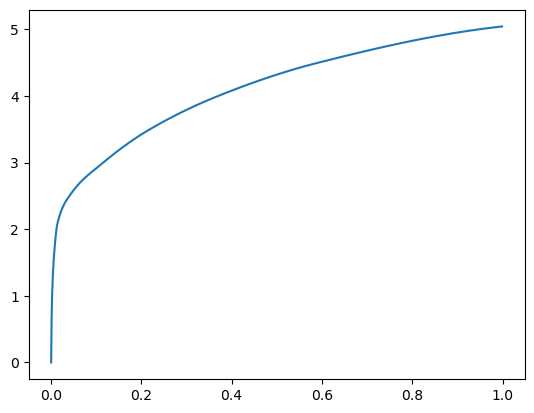

[0.00000000e+00 7.39097595e-04 2.13527679e-03 5.39302826e-03
 1.21259689e-02 4.27350998e-02 1.20007515e-01 2.26548195e-01
 3.82922173e-01 6.15014076e-01 1.00000000e+00] betas
[0.         0.50800187 0.43513196 0.47477018 0.54564438 0.55790298
 0.50628406 0.47110039 0.51703219 0.4952457  0.48900779] r
-22480.269231963164 score post


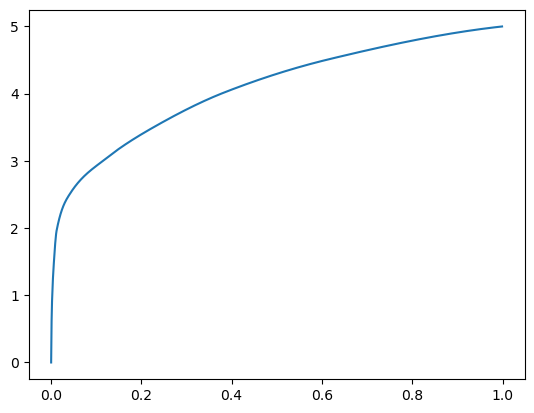

[0.00000000e+00 7.21931458e-04 2.41756439e-03 6.16359711e-03
 1.32150650e-02 4.06694412e-02 1.14743233e-01 2.26876259e-01
 3.76997948e-01 6.08309746e-01 1.00000000e+00] betas
[0.         0.49560435 0.54424942 0.52788642 0.5245422  0.51792188
 0.54832785 0.496198   0.50081446 0.4922799  0.49219447] r
-22481.990460408004 score post


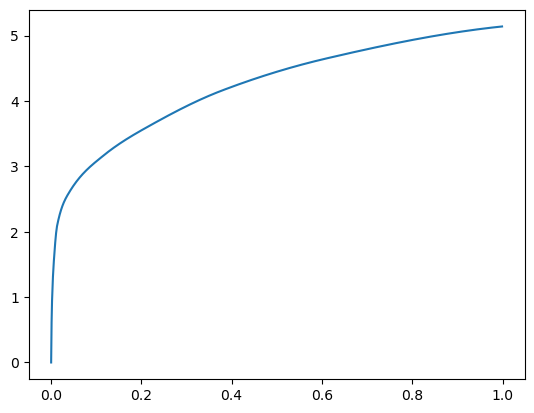

[0.00000000e+00 7.61985779e-04 2.36034393e-03 5.90991974e-03
 1.23243332e-02 3.71694565e-02 1.01494789e-01 2.12098122e-01
 3.61071587e-01 5.95055580e-01 1.00000000e+00] betas
[0.         0.49433909 0.48870552 0.50665266 0.47073348 0.52053354
 0.47655121 0.57460944 0.46726729 0.50414466 0.54362899] r
-22480.269231963164 score post


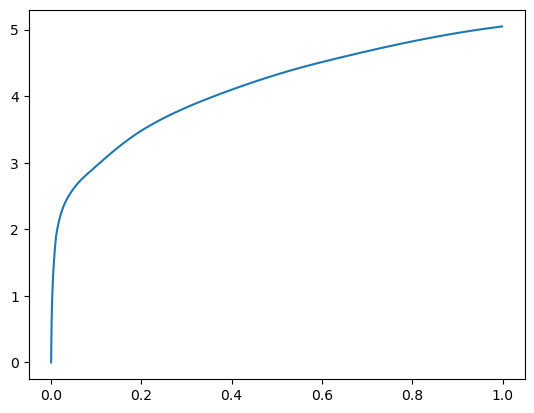

[0.00000000e+00 7.86781311e-04 2.49195099e-03 6.15596771e-03
 1.39875412e-02 4.09250259e-02 1.13062859e-01 2.12323189e-01
 3.76025200e-01 6.18239403e-01 1.00000000e+00] betas
[0.         0.54948864 0.54361843 0.50219525 0.52359557 0.5340986
 0.5283161  0.49563591 0.54880563 0.52327302 0.47640991] r
-22481.378721678564 score post


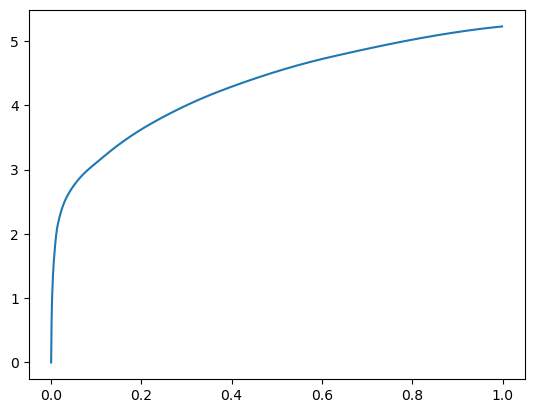

[0.00000000e+00 7.31468201e-04 2.26879120e-03 5.86605072e-03
 1.32246017e-02 3.75432968e-02 1.05212212e-01 2.07673073e-01
 3.59400749e-01 5.90785027e-01 1.00000000e+00] betas
[0.         0.46927558 0.51666879 0.49518073 0.52147803 0.49442265
 0.48134367 0.52399503 0.50055533 0.51983444 0.52606558] r
-22480.269231963164 score post


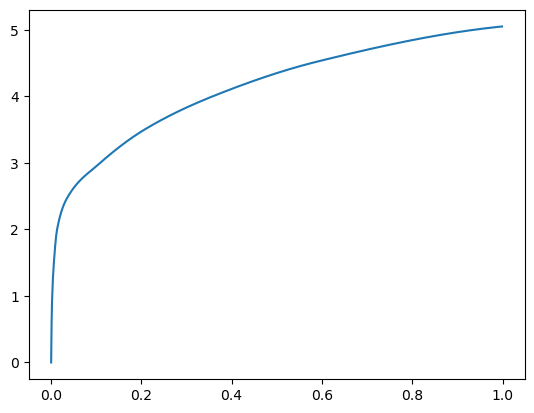

[0.00000000e+00 8.09669495e-04 2.38513947e-03 6.21318817e-03
 1.37128830e-02 4.00018692e-02 1.13766670e-01 2.15588570e-01
 3.72845650e-01 6.03453636e-01 1.00000000e+00] betas
[0.         0.53349813 0.49776733 0.49730799 0.53771212 0.53252678
 0.51347981 0.4578263  0.49735252 0.53617655 0.51259001] r
-22481.990460408004 score post


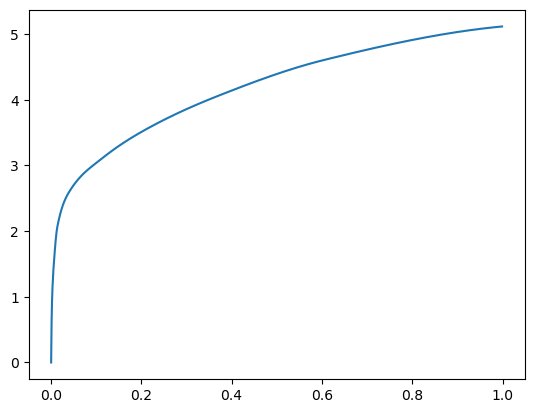

[0.00000000e+00 7.61985779e-04 2.34508514e-03 6.27994537e-03
 1.31998062e-02 3.65343094e-02 1.05900764e-01 2.18590736e-01
 3.82298470e-01 6.04020119e-01 1.00000000e+00] betas
[0.         0.50417829 0.51791777 0.5452429  0.47996034 0.45694988
 0.51751864 0.53414616 0.5161909  0.44140422 0.59502659] r
-22480.269231963164 score post


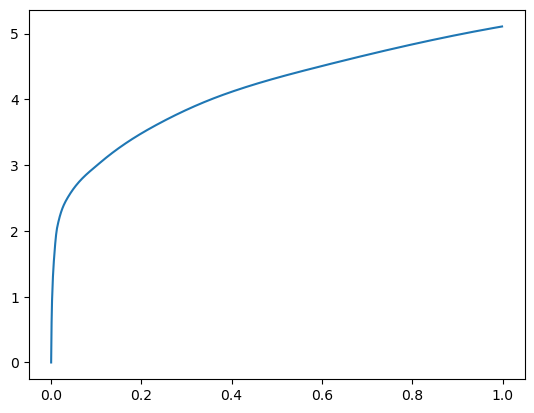

[0.00000000e+00 7.77244568e-04 2.34317780e-03 5.92136383e-03
 1.30872726e-02 4.09841537e-02 1.13364220e-01 2.23853111e-01
 3.88308525e-01 6.53092384e-01 1.00000000e+00] betas
[0.         0.53173857 0.45754758 0.49181932 0.48390073 0.47780696
 0.53029404 0.52329752 0.50344967 0.53868874 0.45521147] r
-22481.378721678564 score post


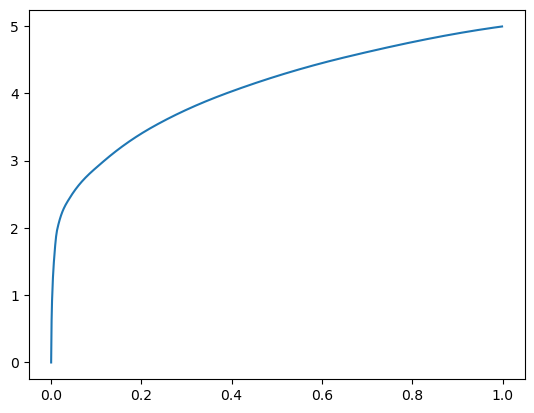

488169 steps_after


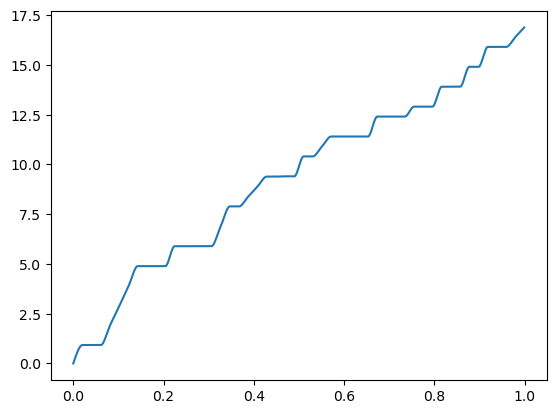

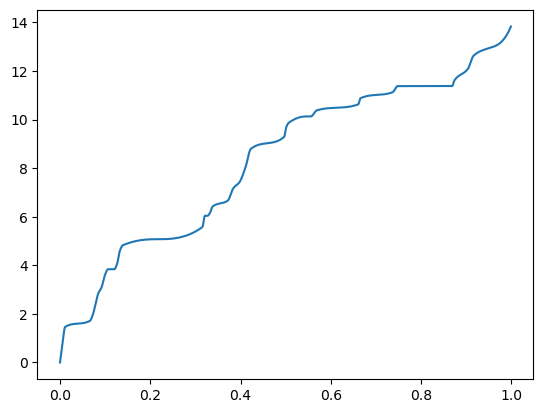

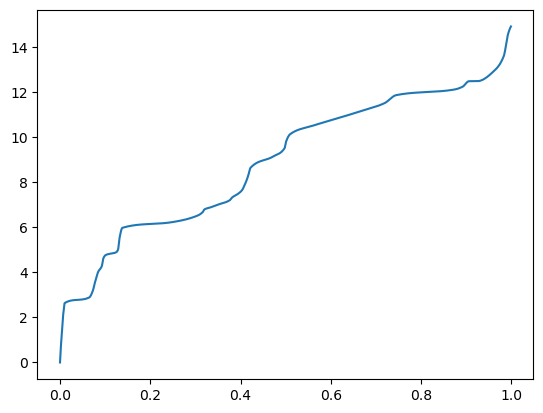

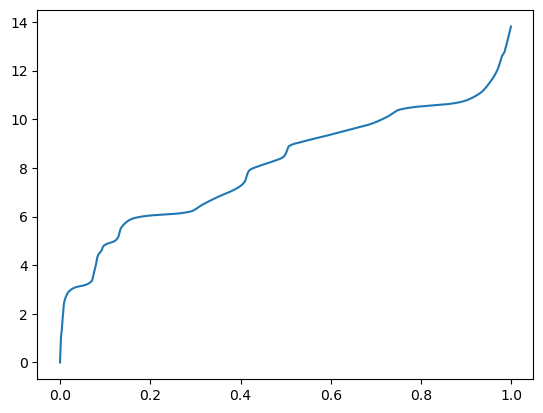

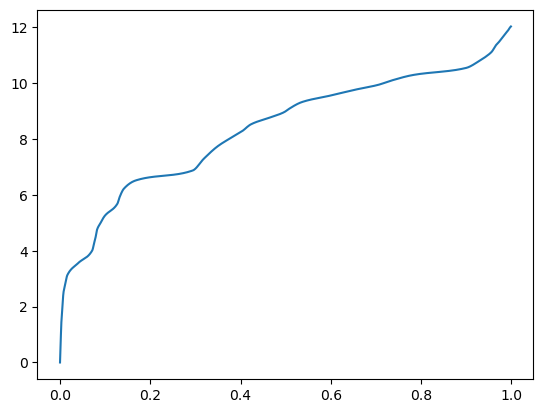

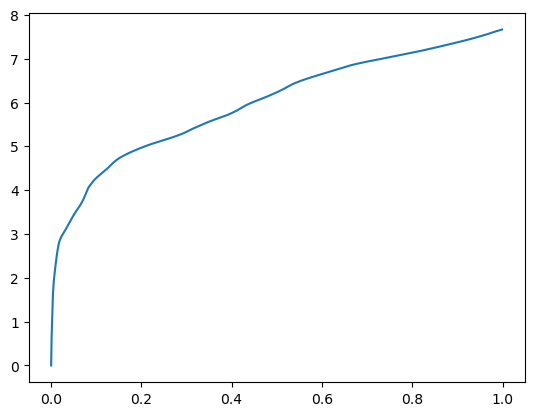

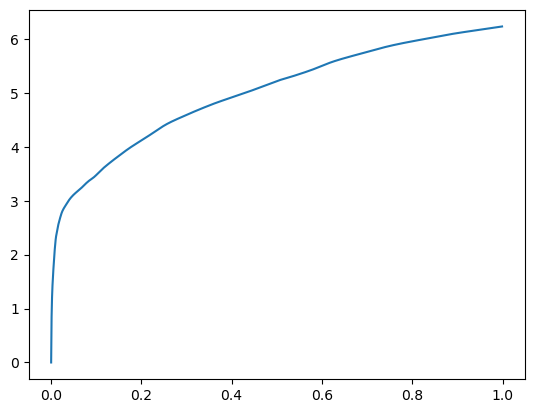

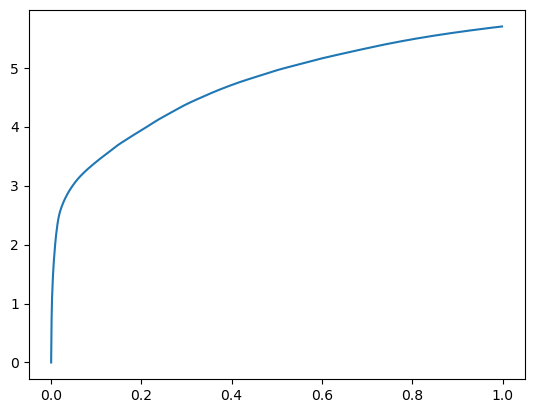

10916 steps
betas [0.00000000e+00 7.20024109e-04 2.23827362e-03 5.88321686e-03
 1.28221512e-02 3.55386734e-02 1.02568626e-01 2.10488319e-01
 3.51780891e-01 5.84975243e-01 1.00000000e+00]
n_chains 11
[0.00000000e+00 7.20024109e-04 2.23827362e-03 5.88321686e-03
 1.28221512e-02 3.55386734e-02 1.02568626e-01 2.10488319e-01
 3.51780891e-01 5.84975243e-01 1.00000000e+00] betas
[0.         0.00392947 0.0166934  0.00394576 0.04005234 0.
 0.         0.27704474 0.49186607 0.         0.        ] r
-22484.09117069985 score post


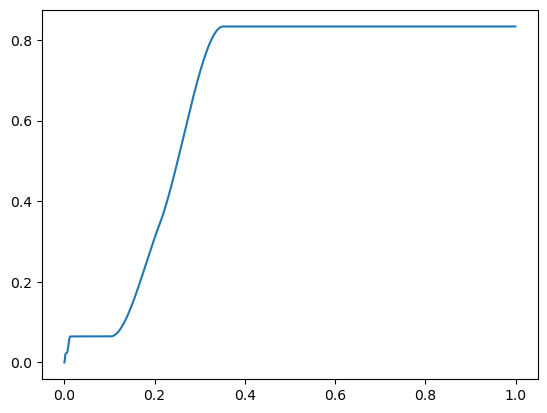

[0.         0.12418652 0.15753841 0.18241215 0.20771885 0.23174953
 0.25096416 0.26892757 0.2873354  0.30845356 1.        ] betas
[0.         0.99817149 0.21349354 0.14217511 0.12797621 0.10819108
 0.08171765 0.07090321 0.069375   0.0747199  0.88990678] r
-22480.269231963164 score post


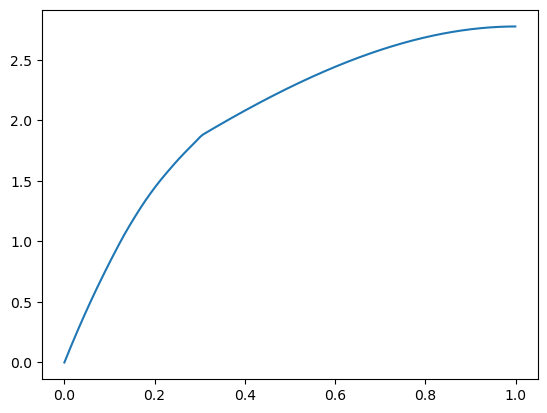

[0.         0.0309782  0.06457043 0.10104656 0.14114094 0.18893528
 0.24956417 0.33445454 0.47095966 0.63727093 1.        ] betas
[0.         0.98845885 0.41213795 0.2832024  0.25087671 0.25299844
 0.28014896 0.30063264 0.37810071 0.3396124  0.49514613] r
-22486.31957620794 score post


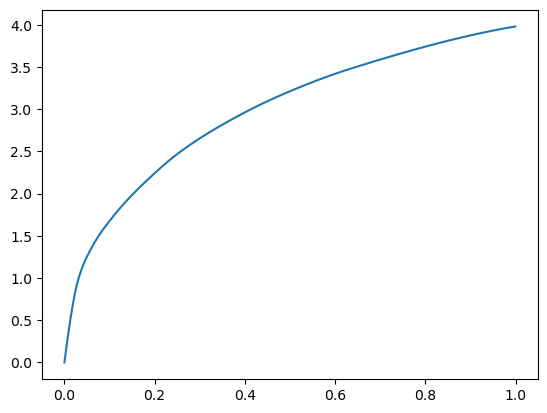

[0.         0.01013851 0.02248096 0.04484844 0.08803844 0.1510725
 0.23105907 0.34036541 0.48744678 0.69615841 1.        ] betas
[0.         0.9513538  0.46452661 0.33392633 0.32808143 0.36455965
 0.34266106 0.37975992 0.419186   0.41429695 0.37587081] r
-22481.378721678564 score post


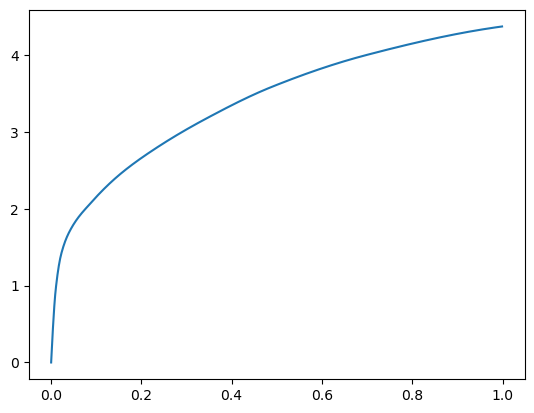

[0.         0.00387859 0.00888157 0.01861286 0.044837   0.10512066
 0.19102383 0.30850887 0.45370197 0.6584959  1.        ] betas
[0.         0.85228246 0.55728092 0.41037322 0.4037618  0.40694484
 0.43909166 0.4524535  0.40000361 0.37247235 0.44647981] r
-22480.269231963164 score post


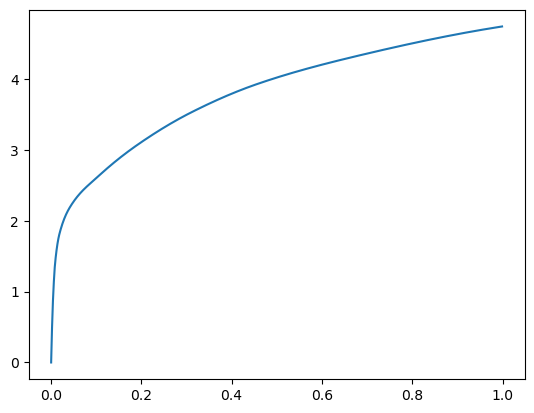

[0.         0.00190067 0.00453663 0.00908184 0.02197361 0.0620451
 0.14398479 0.25114155 0.40046978 0.6407423  1.        ] betas
[0.         0.76696015 0.4390527  0.46237841 0.51221893 0.45536295
 0.47240691 0.47995335 0.46835301 0.50014854 0.46763305] r
-22480.269231963164 score post


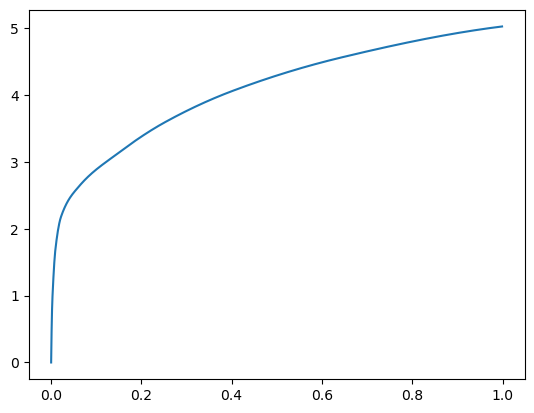

[0.         0.00109005 0.0031023  0.00711918 0.01598644 0.04681873
 0.12511921 0.2327776  0.38619328 0.61984158 1.        ] betas
[0.         0.59225313 0.50707262 0.532127   0.48218232 0.4928501
 0.48115598 0.46622881 0.54423627 0.5316796  0.48430907] r
-22481.378721678564 score post


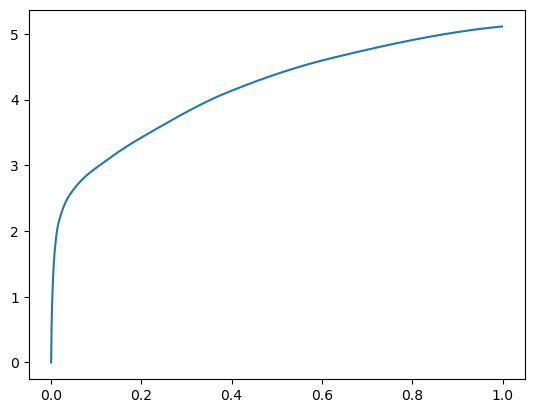

[0.00000000e+00 8.89778137e-04 2.69794464e-03 6.09683990e-03
 1.39627457e-02 4.18081284e-02 1.21335030e-01 2.39407539e-01
 3.83782387e-01 6.04048729e-01 1.00000000e+00] betas
[0.         0.57715535 0.55195765 0.4550993  0.51391415 0.49993079
 0.53565205 0.52769685 0.46904352 0.4372537  0.4967576 ] r
-22481.621781595804 score post


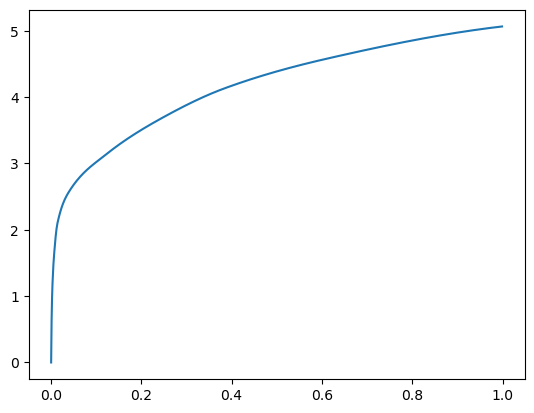

[0.00000000e+00 7.42912292e-04 2.17533112e-03 5.43117523e-03
 1.21736526e-02 3.58800888e-02 1.03377342e-01 2.09601402e-01
 3.54468346e-01 5.97916603e-01 1.00000000e+00] betas
[0.         0.51762295 0.50198837 0.51064738 0.48929062 0.53838271
 0.52350454 0.51310021 0.48072996 0.5449018  0.53184057] r
-22489.703361615782 score post


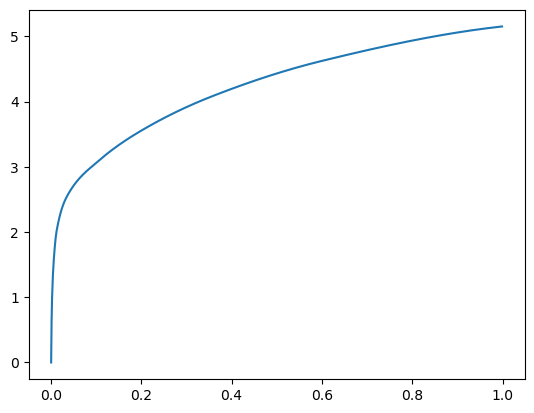

[0.00000000e+00 7.37190247e-04 2.22301483e-03 5.57994843e-03
 1.32780075e-02 3.73392105e-02 1.04996681e-01 2.12601662e-01
 3.71706963e-01 6.07739449e-01 1.00000000e+00] betas
[0.         0.50128891 0.53001604 0.51918943 0.54640169 0.53845476
 0.52985285 0.53030005 0.52738931 0.519242   0.53949752] r
-22481.378721678564 score post


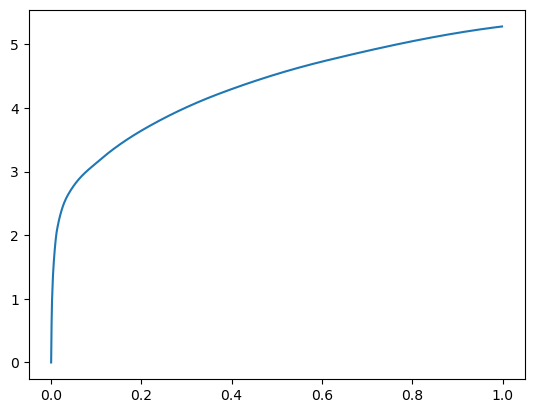

[0.00000000e+00 7.92503357e-04 2.33364105e-03 5.91564178e-03
 1.37033463e-02 3.77759933e-02 1.05610847e-01 2.13009834e-01
 3.72607231e-01 6.14319801e-01 1.00000000e+00] betas
[0.         0.5434964  0.48647371 0.49781168 0.52251157 0.45320104
 0.51553651 0.53420179 0.51866721 0.49909404 0.51902878] r
-22485.220960759736 score post


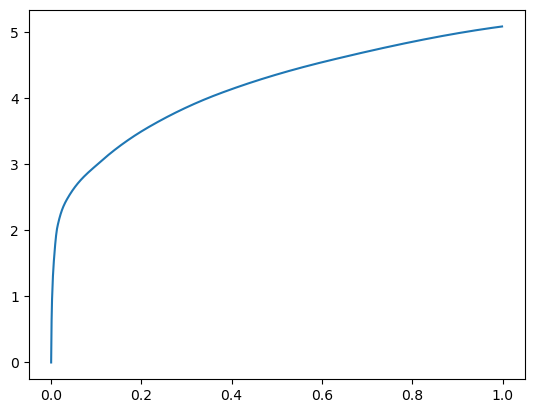

[0.00000000e+00 7.20024109e-04 2.27642059e-03 5.90801239e-03
 1.32913589e-02 4.14609909e-02 1.11403465e-01 2.15472221e-01
 3.72653008e-01 6.20383263e-01 1.00000000e+00] betas
[0.         0.50346576 0.47304642 0.51649508 0.50254518 0.54231092
 0.47394143 0.48558543 0.50746072 0.51276016 0.53414356] r
-22481.621781595804 score post


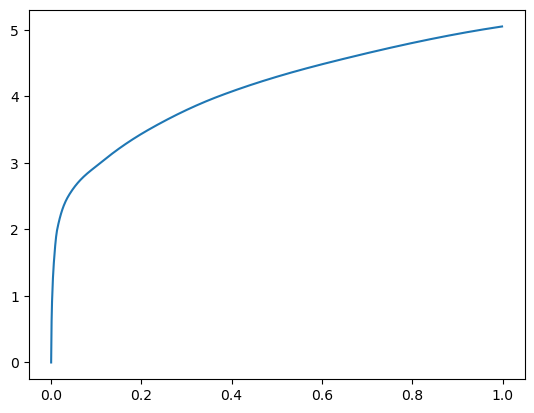

[0.00000000e+00 7.23838806e-04 2.44617462e-03 6.14452362e-03
 1.40504837e-02 4.03585434e-02 1.14865303e-01 2.25626945e-01
 3.87108803e-01 6.37528419e-01 1.00000000e+00] betas
[0.         0.51703951 0.48423388 0.54180692 0.4825125  0.46188143
 0.51683711 0.47331212 0.51097102 0.52390974 0.43869564] r
-22485.59168285815 score post


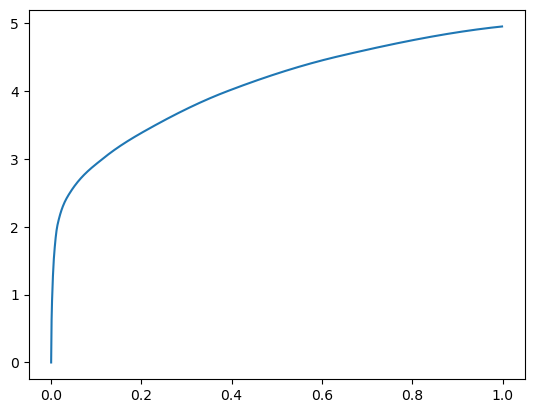

[0.00000000e+00 6.76155090e-04 2.39086151e-03 5.56468964e-03
 1.27763748e-02 3.92522812e-02 1.08569145e-01 2.22418785e-01
 3.76490593e-01 6.03129387e-01 1.00000000e+00] betas
[0.         0.47418038 0.55659452 0.44572469 0.53494418 0.4961949
 0.45136691 0.53308187 0.52550099 0.50053954 0.54480185] r
-22481.990460408004 score post


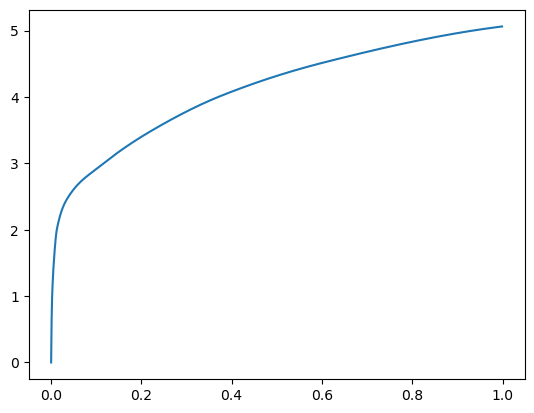

[0.00000000e+00 7.44819641e-04 2.30312347e-03 5.98812103e-03
 1.31864548e-02 4.15906906e-02 1.23158455e-01 2.35610008e-01
 3.88670921e-01 6.25531197e-01 1.00000000e+00] betas
[0.         0.51989975 0.50625201 0.54239991 0.50886033 0.56923371
 0.55069657 0.5117846  0.46138246 0.52892483 0.56140179] r
-22484.348661750126 score post


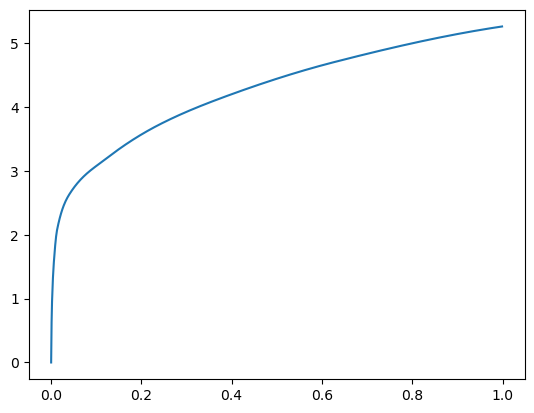

[0.00000000e+00 7.58171082e-04 2.42710114e-03 6.08539581e-03
 1.39665604e-02 4.01353836e-02 1.15538597e-01 2.28470802e-01
 4.03496742e-01 6.45039558e-01 1.00000000e+00] betas
[0.         0.53991302 0.53497331 0.50854917 0.58179803 0.50481401
 0.54992826 0.57547562 0.56952142 0.44154477 0.45324965] r
-22485.70121138277 score post


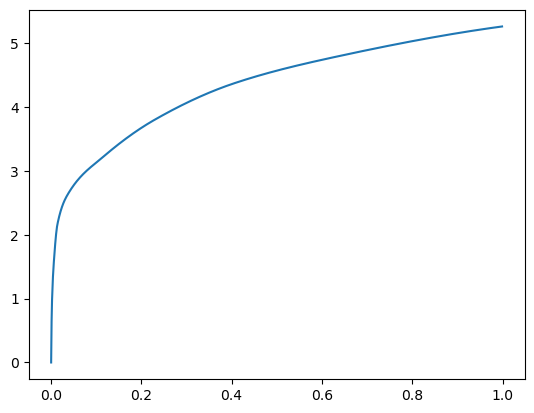

[0.00000000e+00 7.29560852e-04 2.31838226e-03 6.03008270e-03
 1.25494003e-02 3.66888046e-02 1.04651451e-01 2.02042580e-01
 3.45086098e-01 5.97899437e-01 1.00000000e+00] betas
[0.         0.52137437 0.52620043 0.54898181 0.45181535 0.50062828
 0.50693956 0.51645752 0.52960935 0.5237669  0.54403121] r
-22480.269231963164 score post


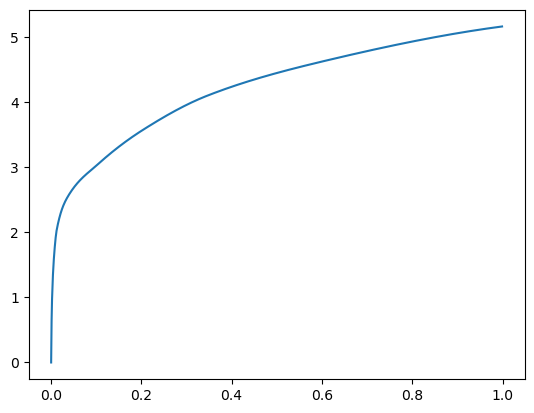

[0.00000000e+00 7.20024109e-04 2.25543976e-03 5.58185577e-03
 1.31063461e-02 3.98073196e-02 1.12080574e-01 2.12660789e-01
 3.57695580e-01 6.14235878e-01 1.00000000e+00] betas
[0.         0.4708234  0.50165824 0.46749133 0.53911342 0.5211463
 0.56922274 0.44671688 0.48532248 0.49367759 0.51365729] r
-22481.990460408004 score post


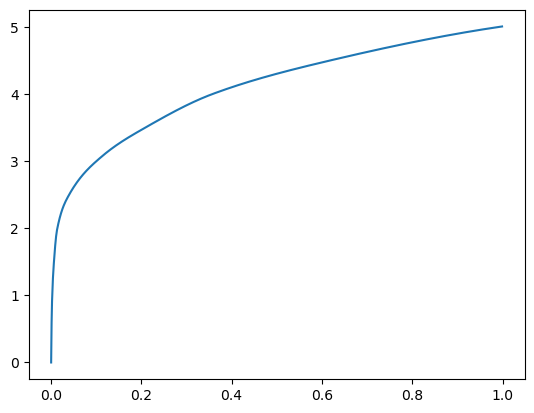

[0.00000000e+00 7.86781311e-04 2.40039825e-03 6.22463226e-03
 1.38311386e-02 4.01563644e-02 1.01071358e-01 2.10062981e-01
 3.59923363e-01 6.22269630e-01 1.00000000e+00] betas
[0.         0.50392803 0.54343438 0.52203312 0.52395704 0.46678464
 0.44137272 0.51823092 0.56065443 0.51669097 0.47019572] r
-22481.990460408004 score post


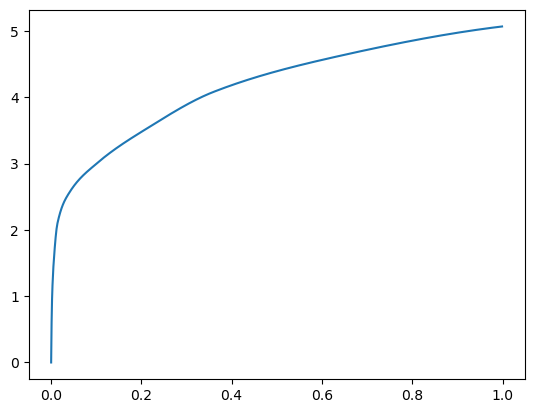

[0.00000000e+00 7.92503357e-04 2.24590302e-03 5.71918488e-03
 1.22251511e-02 3.77321243e-02 1.07823372e-01 2.16547966e-01
 3.50302696e-01 5.98893166e-01 1.00000000e+00] betas
[0.         0.51813686 0.47814199 0.47182129 0.5004909  0.55701783
 0.48068567 0.55431425 0.44156029 0.52478896 0.49439473] r
-22480.269231963164 score post


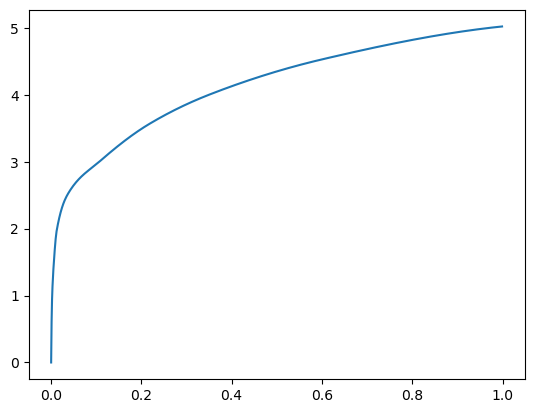

[0.00000000e+00 7.58171082e-04 2.28595734e-03 6.10065460e-03
 1.32951736e-02 3.64446640e-02 1.08927727e-01 2.05588341e-01
 3.55992317e-01 5.94052315e-01 1.00000000e+00] betas
[0.         0.51855305 0.52513844 0.54487466 0.49452198 0.42865814
 0.4590613  0.46107811 0.51912123 0.52765952 0.52544649] r
-22481.378721678564 score post


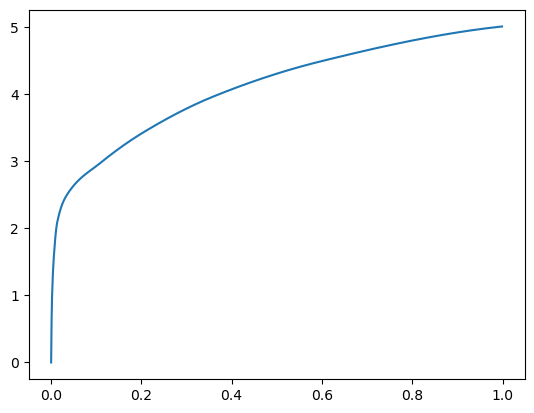

[0.00000000e+00 7.21931458e-04 2.09903717e-03 5.24806976e-03
 1.14259720e-02 3.55138779e-02 1.14750862e-01 2.23370552e-01
 3.75336647e-01 6.09082222e-01 1.00000000e+00] betas
[0.         0.51272127 0.5429334  0.45793548 0.49134546 0.50545156
 0.53103161 0.45251028 0.498071   0.50626286 0.50146051] r
-22481.990460408004 score post


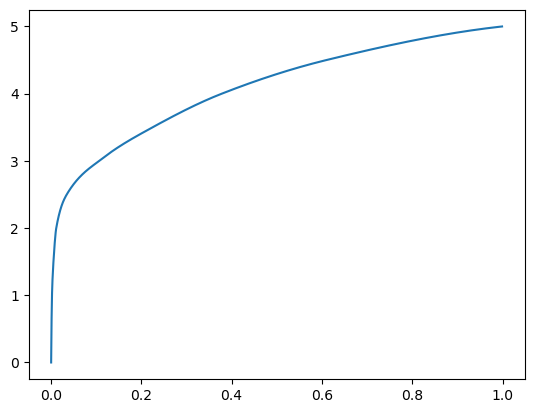

[0.00000000e+00 6.97135925e-04 1.88350677e-03 5.11837006e-03
 1.12962723e-02 3.45830917e-02 1.06564522e-01 2.24963188e-01
 3.78281593e-01 6.09986305e-01 1.00000000e+00] betas
[0.         0.48856735 0.46701678 0.51418764 0.54206566 0.49094277
 0.5061844  0.55627042 0.50047276 0.49250367 0.54931396] r
-22486.71698678069 score post


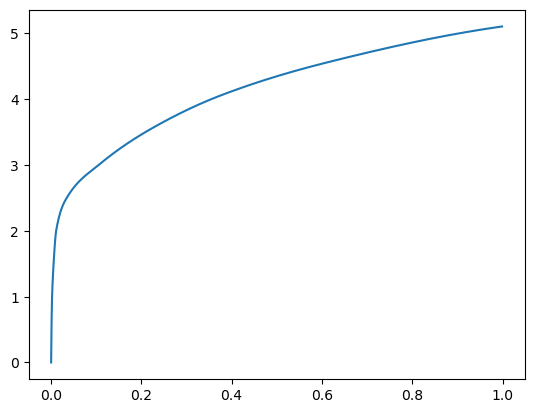

[0.00000000e+00 7.41004944e-04 2.16770172e-03 5.65814972e-03
 1.21240616e-02 3.91969681e-02 1.16442680e-01 2.27553368e-01
 3.86115074e-01 6.32496834e-01 1.00000000e+00] betas
[0.         0.55216922 0.51982333 0.46685884 0.48694772 0.56133057
 0.53958503 0.50325168 0.46676929 0.52970469 0.47783568] r
-22480.269231963164 score post


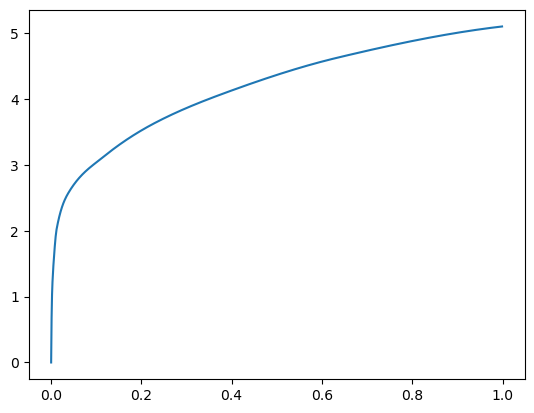

[0.00000000e+00 6.64710999e-04 1.95026398e-03 5.58185577e-03
 1.25608444e-02 3.62138748e-02 1.04565620e-01 2.12258339e-01
 3.80831718e-01 6.13284111e-01 1.00000000e+00] betas
[0.         0.48578008 0.50767333 0.56885688 0.49141151 0.46994806
 0.48845123 0.5038896  0.57548146 0.49669201 0.44391899] r
-22481.990460408004 score post


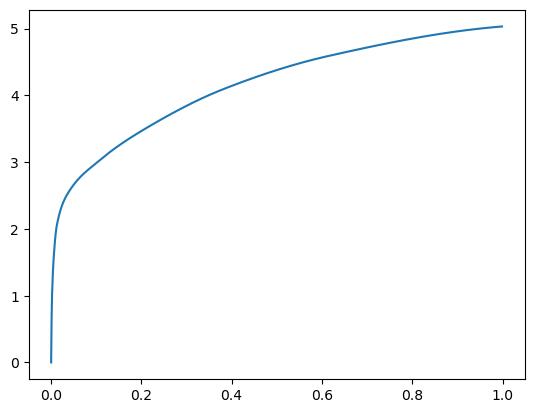

[0.00000000e+00 6.97135925e-04 2.00366974e-03 5.08213043e-03
 1.15480423e-02 3.55482101e-02 1.05813026e-01 2.13877678e-01
 3.57220650e-01 5.77057838e-01 1.00000000e+00] betas
[0.         0.46949437 0.48016138 0.48538569 0.4632863  0.50671977
 0.52232494 0.53546091 0.48501975 0.48086551 0.55353518] r
-22481.378721678564 score post


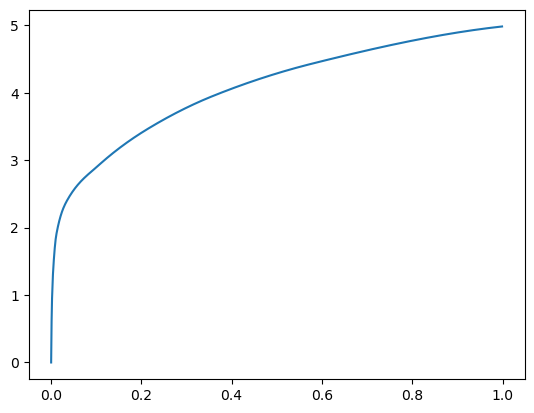

[0.00000000e+00 7.56263733e-04 2.20966339e-03 5.67531586e-03
 1.43270493e-02 4.32806015e-02 1.16297722e-01 2.20019341e-01
 3.71464729e-01 6.10222816e-01 1.00000000e+00] betas
[0.         0.54155531 0.49276751 0.49930396 0.60765458 0.48496279
 0.4485682  0.51888509 0.52463566 0.54356004 0.44982307] r
-22480.269231963164 score post


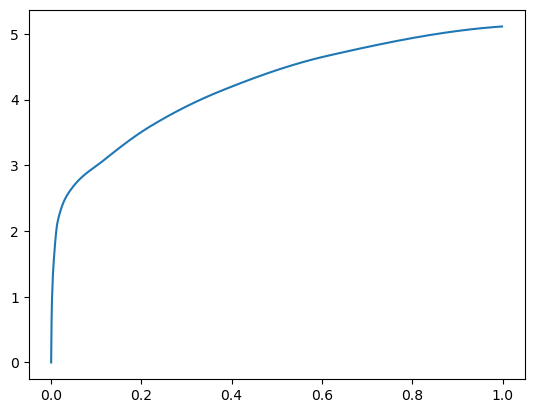

[0.00000000e+00 6.95228577e-04 2.15435028e-03 5.67340851e-03
 1.20725632e-02 3.63416672e-02 1.14884377e-01 2.16313362e-01
 3.61252785e-01 5.74206352e-01 1.00000000e+00] betas
[0.         0.51195649 0.49461607 0.53080283 0.48903525 0.49633368
 0.5452859  0.47652675 0.45234448 0.48883759 0.59348022] r
-22491.020923668173 score post


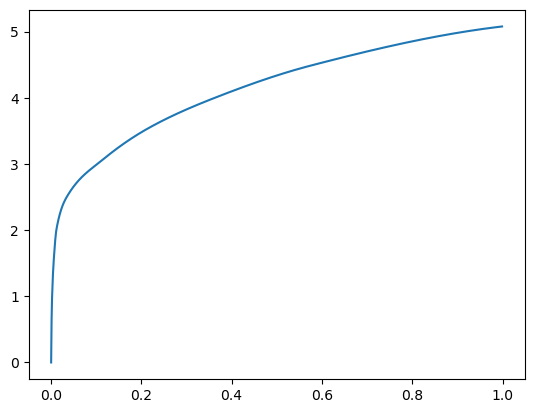

[0.00000000e+00 6.87599182e-04 2.19631195e-03 5.54370880e-03
 1.22175217e-02 3.78465652e-02 1.11205101e-01 2.19197273e-01
 3.86422157e-01 6.22820854e-01 1.00000000e+00] betas
[0.         0.52236878 0.52164714 0.47409483 0.53249337 0.52527953
 0.5205694  0.47362431 0.55199705 0.53301837 0.48400491] r
-22483.2822716802 score post


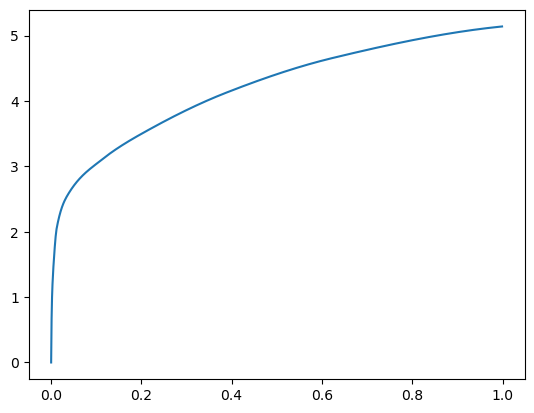

[0.00000000e+00 6.70433044e-04 2.12192535e-03 5.76877594e-03
 1.23548508e-02 3.72953415e-02 1.08828545e-01 2.26403236e-01
 3.82458687e-01 6.05458260e-01 1.00000000e+00] betas
[0.         0.45893264 0.51986374 0.5081959  0.49429603 0.47071846
 0.50886229 0.5215131  0.47999487 0.47600346 0.50920777] r
-22481.378721678564 score post


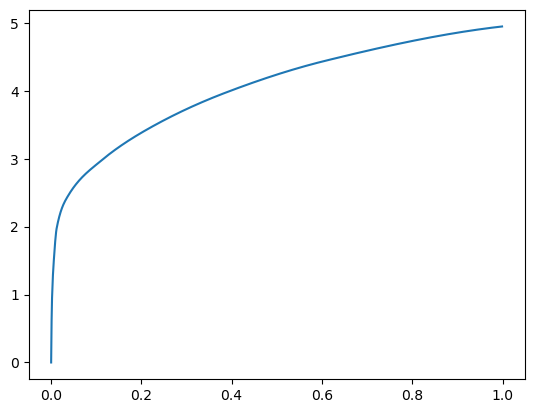

[0.00000000e+00 7.44819641e-04 2.17151642e-03 5.74207306e-03
 1.22900009e-02 3.92827988e-02 1.10213280e-01 2.21224785e-01
 3.80770683e-01 6.14256859e-01 1.00000000e+00] betas
[0.         0.51623735 0.5313248  0.53190076 0.48783527 0.54521197
 0.55070951 0.50749543 0.5230107  0.48089722 0.54727263] r
-22484.348467993714 score post


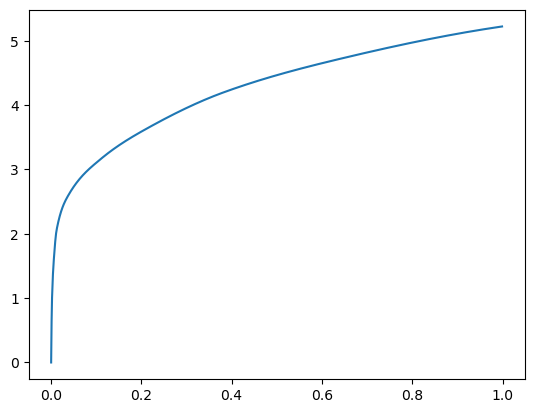

[0.00000000e+00 7.56263733e-04 2.15816498e-03 5.61809540e-03
 1.28946304e-02 3.91530991e-02 1.05067253e-01 2.17240334e-01
 3.74535561e-01 6.29019737e-01 1.00000000e+00] betas
[0.         0.52278999 0.54174795 0.53272367 0.50546741 0.47005577
 0.45869425 0.53281571 0.52866318 0.5926224  0.43579058] r
-22480.269231963164 score post


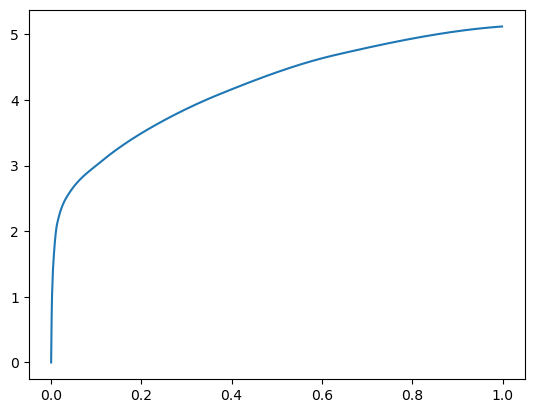

[0.00000000e+00 7.35282898e-04 1.99985504e-03 5.04207611e-03
 1.15404129e-02 3.80239487e-02 1.12368584e-01 2.22468376e-01
 3.76019478e-01 5.85593224e-01 1.00000000e+00] betas
[0.         0.49408507 0.49757262 0.47297737 0.50374483 0.57514728
 0.52209489 0.47952524 0.49953063 0.4328767  0.59345022] r
-22481.378721678564 score post


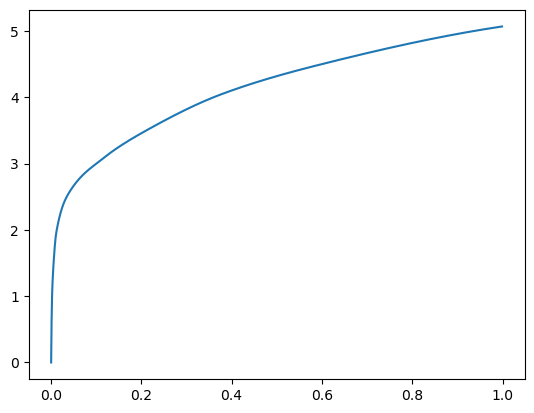

[0.00000000e+00 7.60078430e-04 2.09712982e-03 5.57613373e-03
 1.31673813e-02 3.73353958e-02 1.08096123e-01 2.23683357e-01
 3.80789757e-01 6.36286736e-01 1.00000000e+00] betas
[0.         0.53285391 0.55447812 0.51537756 0.56118823 0.53998964
 0.52951081 0.51015643 0.49613286 0.59380959 0.5138745 ] r
-22486.442287327107 score post


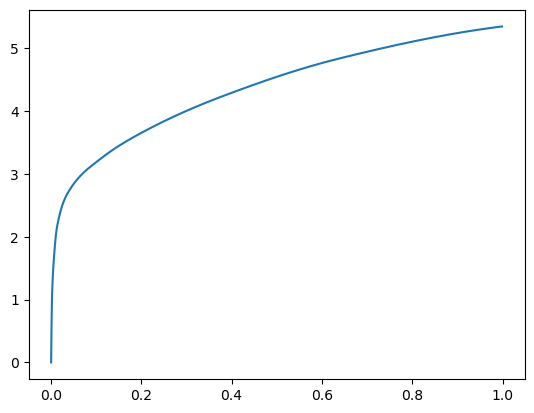

[0.00000000e+00 7.63893127e-04 2.02465057e-03 5.59139252e-03
 1.25627518e-02 3.49626541e-02 1.03646278e-01 2.23576546e-01
 3.94957542e-01 6.24783516e-01 1.00000000e+00] betas
[0.         0.48127274 0.48686605 0.55002237 0.49157768 0.44255171
 0.52047266 0.56959006 0.50039845 0.45780601 0.52584067] r
-22480.269231963164 score post


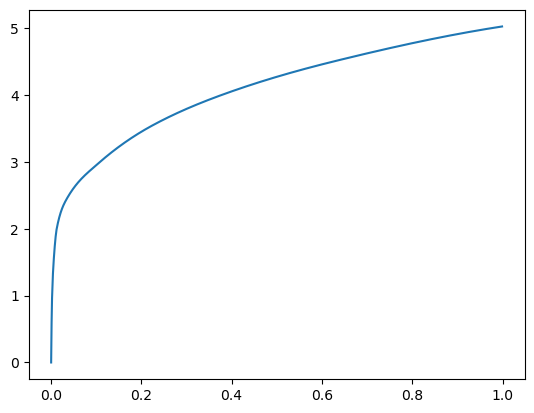

[0.00000000e+00 8.07762146e-04 2.18486786e-03 5.49030304e-03
 1.25875473e-02 4.03413773e-02 1.10970497e-01 2.17156410e-01
 3.85970116e-01 6.38741493e-01 1.00000000e+00] betas
[0.         0.51524541 0.45567833 0.48775502 0.55696964 0.55609111
 0.51240705 0.50277108 0.57808435 0.51604865 0.46302384] r
-22483.215759872455 score post


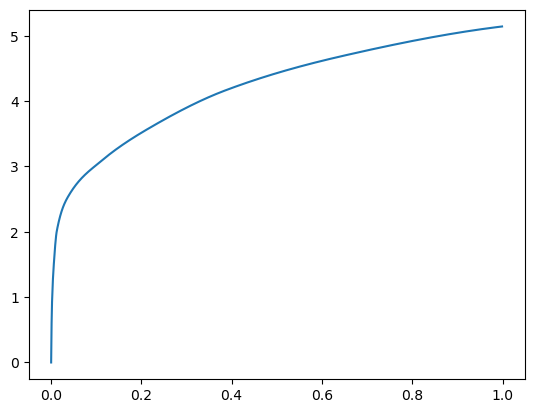

[0.00000000e+00 8.05854797e-04 2.46334076e-03 6.29711151e-03
 1.37815475e-02 4.03680801e-02 1.11367226e-01 2.20625877e-01
 3.67632866e-01 6.07390404e-01 1.00000000e+00] betas
[0.         0.51328764 0.50870631 0.52482045 0.44684297 0.47645552
 0.49222701 0.47257629 0.44705584 0.53284091 0.53392566] r
-22484.348661750126 score post


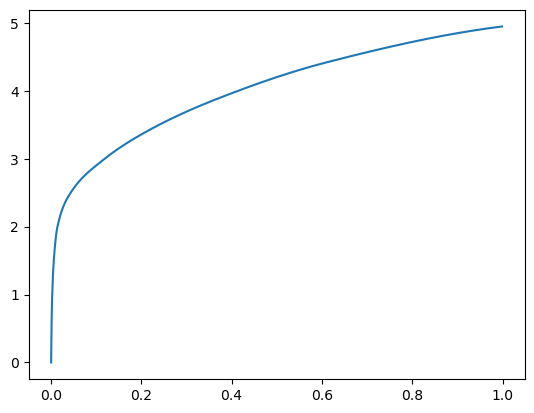

[0.00000000e+00 7.63893127e-04 2.30884552e-03 5.63335419e-03
 1.33447647e-02 4.07667160e-02 1.12645149e-01 2.28817940e-01
 3.97641182e-01 6.30236626e-01 1.00000000e+00] betas
[0.         0.57102008 0.55990114 0.46631039 0.51137685 0.570087
 0.51327724 0.56280473 0.53271881 0.4691066  0.48207299] r
-22485.81993713989 score post


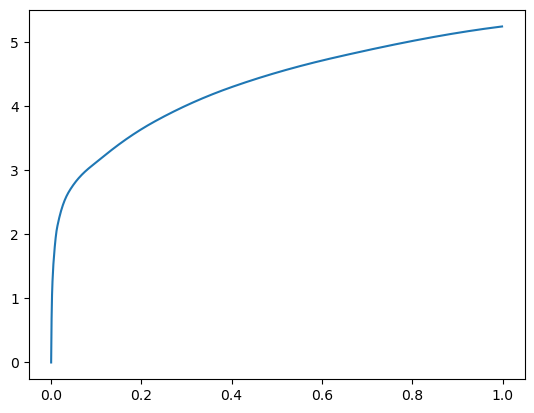

[0.00000000e+00 6.78062439e-04 1.97124481e-03 5.36632538e-03
 1.29861832e-02 3.59716415e-02 1.04079247e-01 2.07144737e-01
 3.60873222e-01 6.04874611e-01 1.00000000e+00] betas
[0.         0.53217511 0.55017422 0.49962566 0.55160538 0.45829059
 0.48213397 0.50322538 0.53302864 0.54113175 0.49842514] r
-22484.501289920216 score post


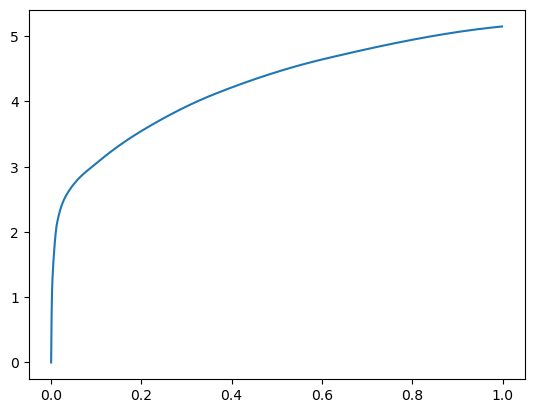

[0.00000000e+00 6.49452209e-04 1.77669525e-03 5.00392914e-03
 1.13229752e-02 3.45010757e-02 1.06808662e-01 2.13925362e-01
 3.64369392e-01 5.94952583e-01 1.00000000e+00] betas
[0.         0.51383238 0.4918422  0.48771788 0.5525387  0.58813022
 0.52677466 0.48130994 0.52856498 0.53214539 0.50879615] r
-22481.621781595804 score post


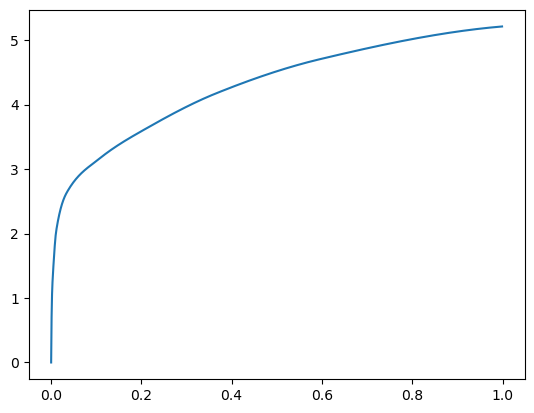

[0.00000000e+00 6.62803650e-04 1.93119049e-03 5.62381744e-03
 1.22232437e-02 3.23648453e-02 1.00661278e-01 2.15439796e-01
 3.63879204e-01 5.87658882e-01 1.00000000e+00] betas
[0.         0.48134259 0.49305683 0.56112782 0.49338007 0.46791903
 0.51042405 0.5021671  0.51853082 0.49837183 0.55343112] r
-22481.378721678564 score post


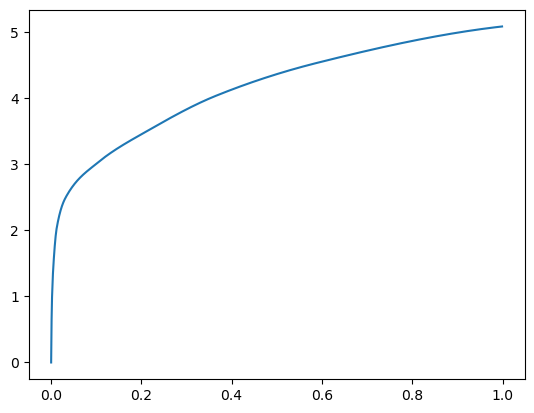

[0.00000000e+00 7.14302063e-04 2.11238861e-03 5.51128387e-03
 1.22995377e-02 3.59373093e-02 1.08023643e-01 2.27356911e-01
 3.77018929e-01 6.14323616e-01 1.00000000e+00] betas
[0.         0.47075513 0.47602388 0.51207398 0.5472431  0.60228598
 0.54735291 0.5287253  0.42357351 0.52558986 0.50206574] r
-22485.70121138277 score post


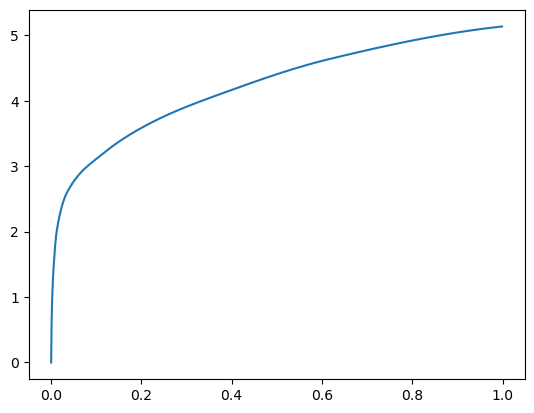

[0.00000000e+00 8.07762146e-04 2.49576569e-03 6.27994537e-03
 1.34534836e-02 3.30247879e-02 9.46378708e-02 2.02660561e-01
 3.77224922e-01 6.07542992e-01 1.00000000e+00] betas
[0.         0.52746879 0.52998179 0.50774075 0.43929461 0.43084827
 0.48231642 0.55499232 0.5295275  0.46716301 0.49955862] r
-22481.378721678564 score post


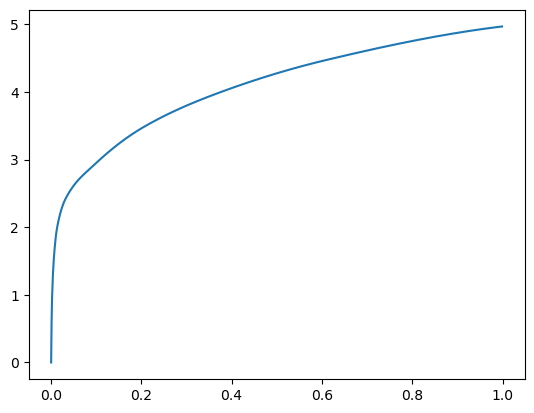

[0.00000000e+00 7.42912292e-04 2.20203400e-03 5.49030304e-03
 1.29919052e-02 3.70950699e-02 1.04882240e-01 2.04096794e-01
 3.66286278e-01 6.09215736e-01 1.00000000e+00] betas
[0.         0.49508304 0.52207966 0.49637649 0.5008212  0.49571346
 0.50211946 0.46461333 0.54320942 0.52416535 0.54776333] r
-22483.343010040644 score post


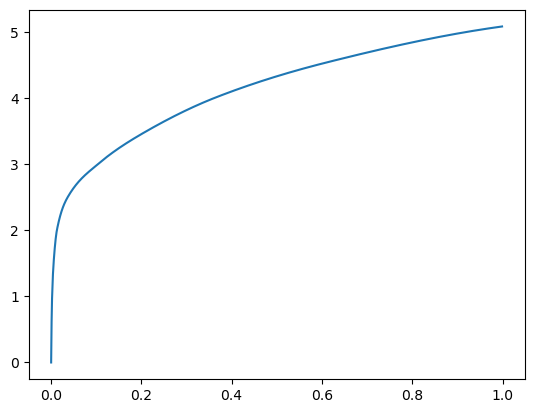

[0.00000000e+00 7.71522522e-04 2.20775604e-03 5.63526154e-03
 1.36480331e-02 4.02326584e-02 1.12414360e-01 2.26647377e-01
 3.86765480e-01 6.31682396e-01 1.00000000e+00] betas
[0.         0.51837572 0.47883034 0.50705868 0.51852527 0.4733057
 0.52156274 0.54862524 0.52693982 0.50096628 0.46054432] r
-22485.61210838894 score post


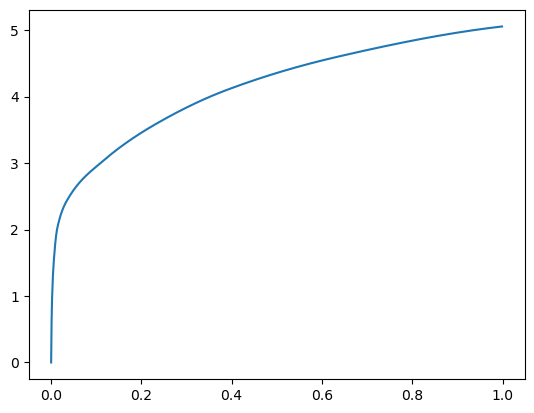

[0.00000000e+00 7.44819641e-04 2.27260590e-03 5.76305389e-03
 1.36194229e-02 4.31413651e-02 1.15017891e-01 2.19634056e-01
 3.68153572e-01 6.04037285e-01 1.00000000e+00] betas
[0.         0.47715855 0.56587193 0.49792792 0.52359084 0.53033056
 0.48258748 0.53027739 0.50994005 0.49965519 0.45278605] r
-22480.269231963164 score post


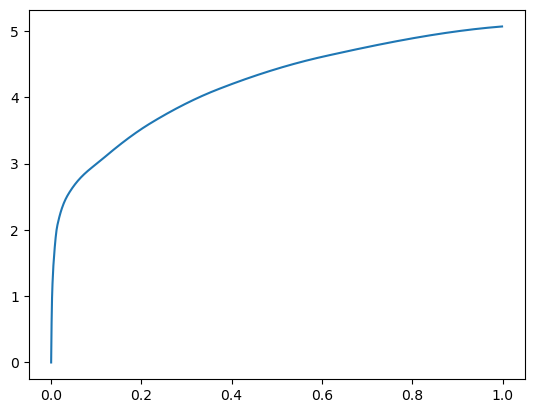

[0.00000000e+00 8.07762146e-04 2.14862823e-03 5.55706024e-03
 1.26295090e-02 3.76424789e-02 1.08786583e-01 2.05931664e-01
 3.46074104e-01 5.70437431e-01 1.00000000e+00] betas
[0.         0.52215558 0.48185145 0.51771864 0.55028151 0.51426606
 0.50254785 0.53903858 0.48183298 0.5276663  0.53496659] r
-22482.458794922564 score post


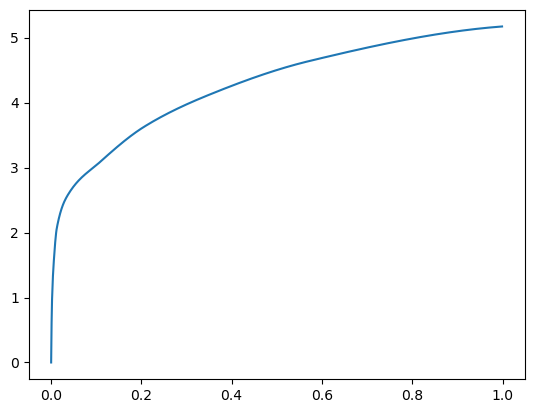

[0.00000000e+00 7.98225403e-04 2.28595734e-03 5.83934784e-03
 1.25474930e-02 3.76329422e-02 1.11119270e-01 2.04264641e-01
 3.56060982e-01 5.81000328e-01 1.00000000e+00] betas
[0.         0.55194207 0.53354253 0.4990965  0.45090924 0.52671861
 0.53432993 0.46575672 0.51390493 0.49346776 0.55540848] r
-22489.920980759478 score post


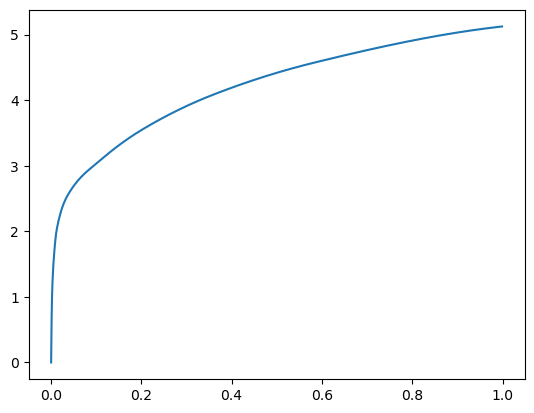

[0.00000000e+00 7.21931458e-04 2.03418732e-03 5.35488129e-03
 1.29594803e-02 3.76615524e-02 1.07466698e-01 2.10471153e-01
 3.64966393e-01 6.06486320e-01 1.00000000e+00] betas
[0.         0.52423072 0.47055438 0.48141107 0.59695017 0.55204634
 0.47978918 0.50676723 0.47712449 0.54031083 0.49669466] r
-22490.493058333926 score post


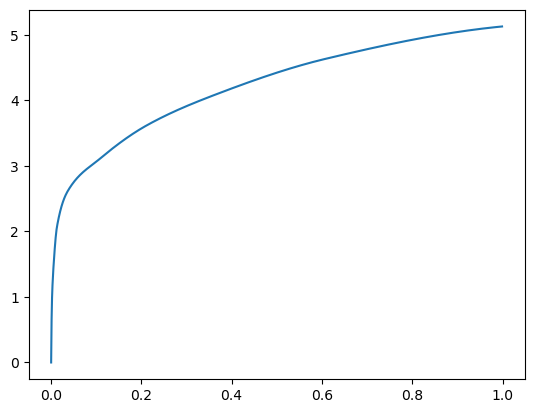

[0.00000000e+00 6.99043274e-04 2.17533112e-03 5.94234467e-03
 1.24197006e-02 3.27882767e-02 1.02236748e-01 2.04451561e-01
 3.69479179e-01 5.97031593e-01 1.00000000e+00] betas
[0.         0.47019327 0.54769423 0.50458172 0.47905636 0.48989685
 0.51001914 0.46738225 0.53401072 0.46262862 0.57911744] r
-22481.378721678564 score post


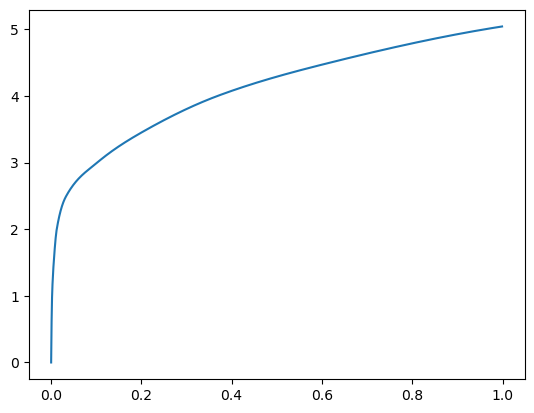

[0.00000000e+00 7.69615173e-04 2.13336945e-03 5.84888458e-03
 1.28335953e-02 3.53288651e-02 1.06713295e-01 2.20910072e-01
 3.82664680e-01 6.41167641e-01 1.00000000e+00] betas
[0.         0.54867051 0.43657768 0.54781323 0.53541508 0.5093674
 0.54864036 0.52216864 0.50372248 0.5634391  0.48468352] r
-22481.378721678564 score post


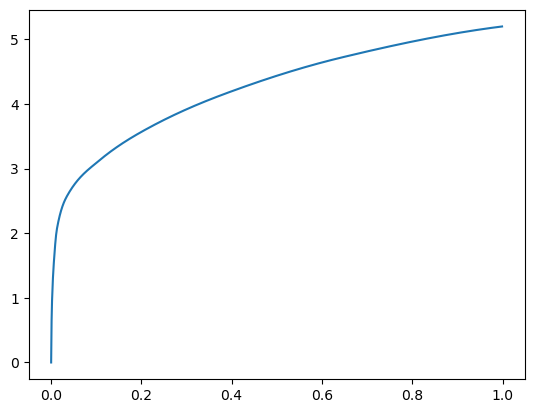

[0.00000000e+00 7.10487366e-04 2.39658356e-03 6.11019135e-03
 1.31387711e-02 3.71427536e-02 1.05652809e-01 2.18697548e-01
 3.85756493e-01 6.20762825e-01 1.00000000e+00] betas
[0.         0.45386708 0.51341607 0.49075076 0.48498938 0.48824244
 0.50568488 0.50318873 0.57296917 0.51641314 0.55017426] r
-22484.89423354312 score post


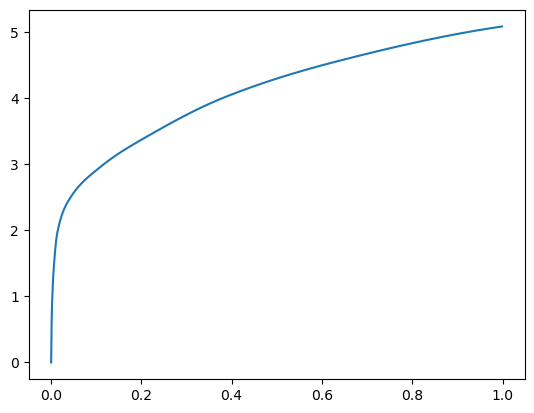

[0.00000000e+00 8.38279724e-04 2.65598297e-03 6.82544708e-03
 1.58605576e-02 4.72517014e-02 1.26399040e-01 2.48684883e-01
 4.04772758e-01 6.44694328e-01 1.00000000e+00] betas
[0.         0.54681793 0.53062186 0.54419747 0.57402181 0.45067794
 0.51651942 0.55295374 0.47670759 0.48134392 0.44970832] r
-22484.290199644343 score post


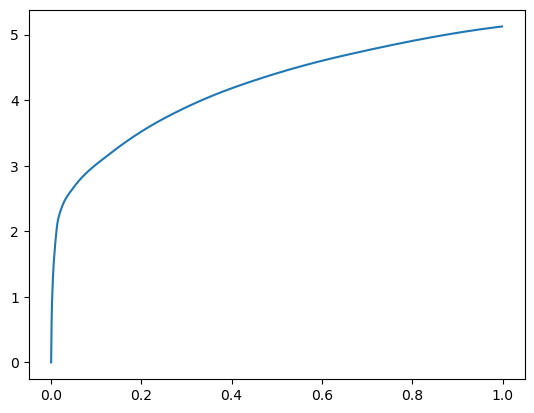

[0.00000000e+00 7.61985779e-04 2.39276886e-03 5.93471527e-03
 1.24654770e-02 3.82509232e-02 1.09786034e-01 2.15495110e-01
 3.68630409e-01 6.06518745e-01 1.00000000e+00] betas
[0.         0.49511557 0.53028253 0.53429475 0.48450773 0.50675524
 0.46406626 0.52938001 0.53935422 0.57596833 0.48338517] r
-22480.269231963164 score post


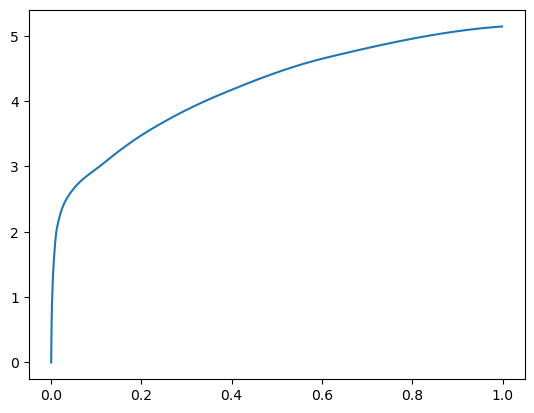

[0.00000000e+00 8.03947449e-04 2.40802765e-03 5.77449799e-03
 1.28393173e-02 4.02345657e-02 1.22366905e-01 2.29039192e-01
 3.79235268e-01 5.88828087e-01 1.00000000e+00] betas
[0.         0.53224225 0.53573861 0.45804272 0.51458792 0.52822987
 0.53739926 0.53810606 0.46901395 0.466997   0.59491845] r
-22484.525554730924 score post


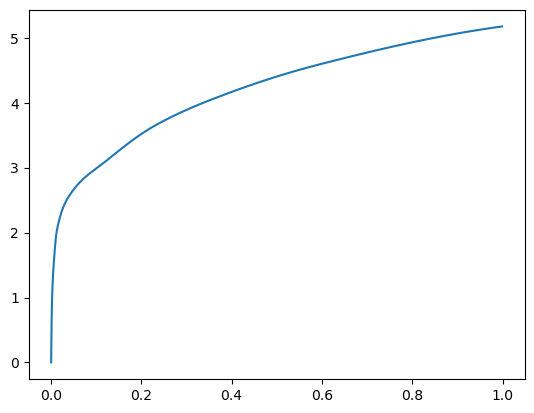

[0.00000000e+00 7.73429871e-04 2.25543976e-03 6.04534149e-03
 1.37128830e-02 4.20274734e-02 1.22179985e-01 2.23610878e-01
 3.89538765e-01 6.32433891e-01 1.00000000e+00] betas
[0.         0.50680946 0.46118858 0.52331992 0.54908021 0.4901228
 0.54938815 0.50376256 0.55003834 0.5139175  0.43146843] r
-22481.378721678564 score post


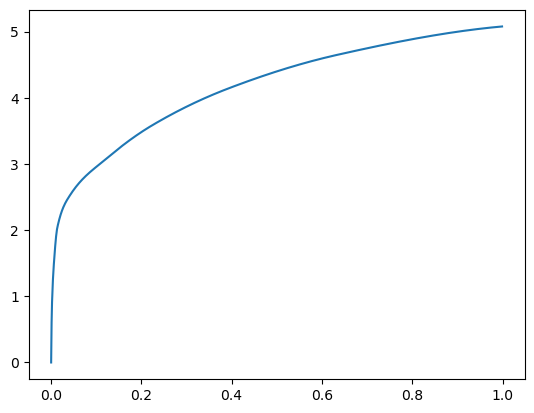

[0.00000000e+00 7.75337219e-04 2.49767303e-03 6.37912750e-03
 1.34496689e-02 4.28895950e-02 1.16484642e-01 2.16723442e-01
 3.63678932e-01 5.86392403e-01 1.00000000e+00] betas
[0.         0.55268912 0.52870237 0.50416696 0.48166846 0.52042334
 0.49942958 0.5418147  0.49021796 0.4614709  0.51989044] r
-22480.269231963164 score post


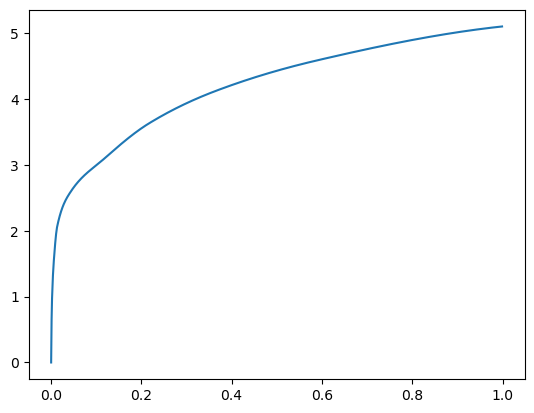

[0.00000000e+00 6.89506531e-04 2.20203400e-03 5.79357147e-03
 1.27153397e-02 3.93590927e-02 1.11964226e-01 2.03457832e-01
 3.49122047e-01 5.92537880e-01 1.00000000e+00] betas
[0.         0.48458091 0.55038427 0.5010283  0.52118627 0.5142632
 0.51314172 0.4894378  0.49152979 0.50666487 0.55881242] r
-22490.007185132847 score post


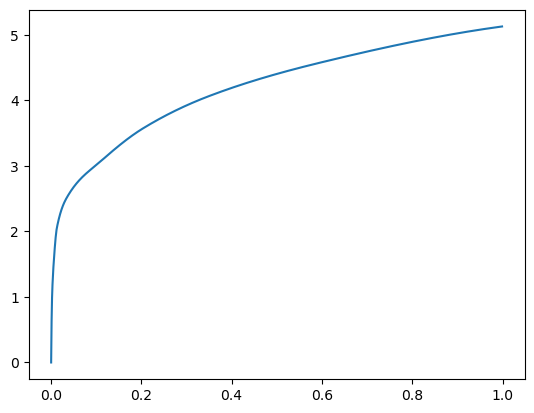

[0.00000000e+00 7.46726990e-04 2.16197968e-03 5.82599640e-03
 1.25818253e-02 3.88288498e-02 1.10985756e-01 2.07688332e-01
 3.64317894e-01 6.19908333e-01 1.00000000e+00] betas
[0.         0.52541416 0.51130969 0.54665749 0.47505415 0.5245751
 0.51154091 0.42809823 0.54304897 0.53591283 0.50107372] r
-22481.990460408004 score post


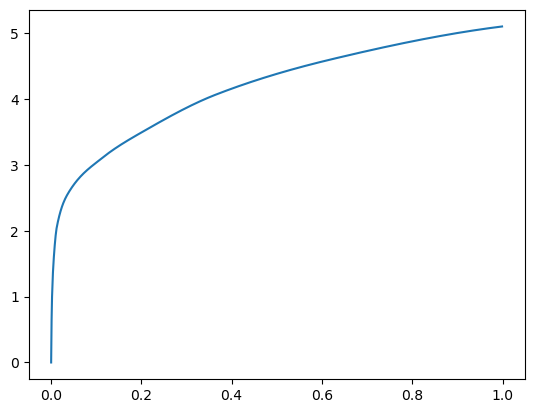

[0.00000000e+00 7.16209412e-04 2.09140778e-03 5.31482697e-03
 1.21221542e-02 3.61032486e-02 1.04931831e-01 2.20263481e-01
 3.70526314e-01 6.14338875e-01 1.00000000e+00] betas
[0.         0.4889417  0.46713535 0.46928546 0.54440922 0.5464069
 0.49443774 0.53663732 0.50249604 0.59730836 0.46894787] r
-22480.269231963164 score post


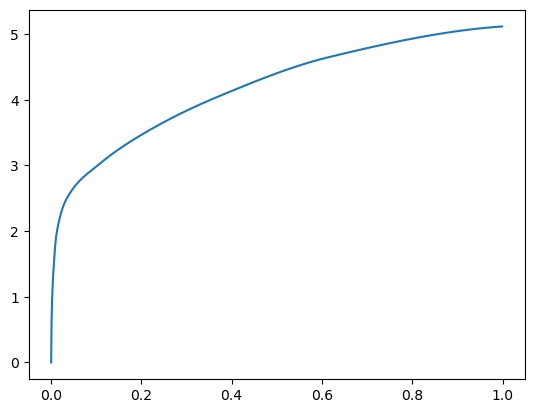

[0.00000000e+00 7.65800476e-04 2.41756439e-03 6.36196136e-03
 1.41553879e-02 3.97386551e-02 1.15426064e-01 2.29012489e-01
 3.85586739e-01 5.90338707e-01 1.00000000e+00] betas
[0.         0.5479708  0.52732807 0.54825443 0.51600357 0.44569138
 0.54058661 0.55178997 0.54626314 0.44371433 0.49466173] r
-22480.269231963164 score post


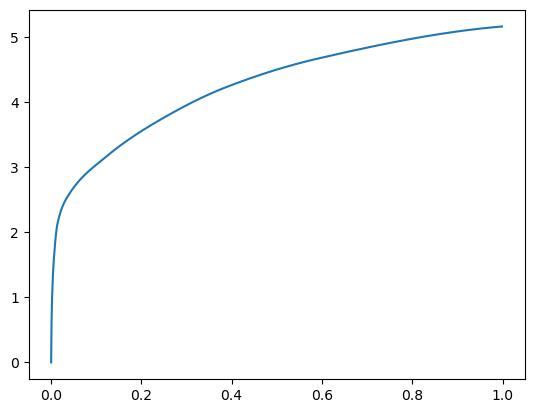

[0.00000000e+00 7.00950623e-04 2.21920013e-03 5.60474396e-03
 1.23186111e-02 3.93610001e-02 1.10508919e-01 2.13662148e-01
 3.53085518e-01 5.77187538e-01 1.00000000e+00] betas
[0.         0.45914266 0.56767509 0.46634004 0.50337243 0.54156233
 0.52212601 0.45827412 0.56256117 0.4939104  0.52140083] r
-22484.25291812412 score post


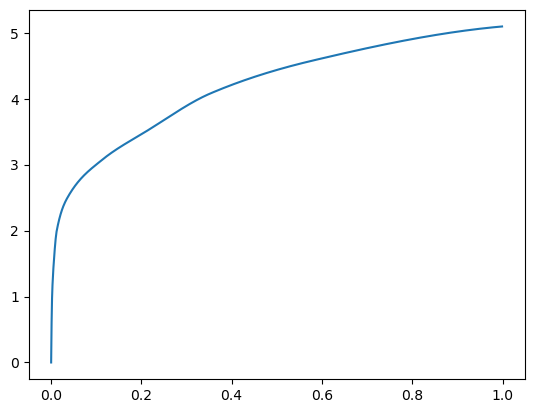

[0.00000000e+00 8.03947449e-04 2.18486786e-03 5.96332550e-03
 1.35278702e-02 4.02421951e-02 1.10081673e-01 2.25071907e-01
 3.51737022e-01 5.84424019e-01 1.00000000e+00] betas
[0.         0.49113422 0.44473891 0.50113988 0.52504153 0.51870787
 0.5260875  0.57014755 0.3752195  0.53628551 0.54853491] r
-22484.348661750126 score post


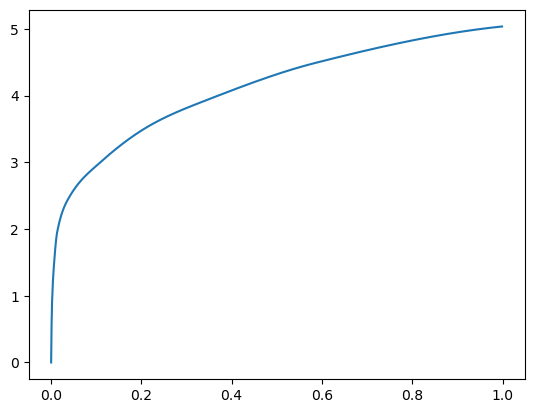

[0.00000000e+00 8.32557678e-04 2.55870819e-03 6.76250458e-03
 1.51433945e-02 4.35819626e-02 1.12618446e-01 2.11897850e-01
 3.81361961e-01 6.10630989e-01 1.00000000e+00] betas
[0.         0.5804535  0.52125956 0.53200116 0.48819708 0.45813225
 0.46813658 0.49463101 0.51772905 0.48366637 0.5606328 ] r
-22486.246783175764 score post


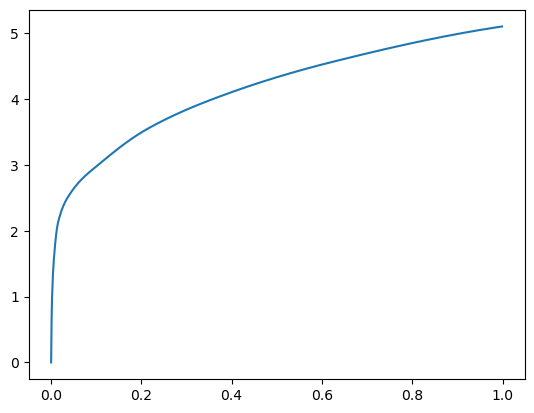

[0.00000000e+00 6.93321228e-04 2.17342377e-03 5.63907623e-03
 1.29766464e-02 4.08658981e-02 1.15164757e-01 2.19906807e-01
 3.90692711e-01 6.39687538e-01 1.00000000e+00] betas
[0.         0.49003501 0.53402536 0.52436413 0.50925705 0.5609597
 0.53780073 0.48439489 0.55550081 0.50749869 0.46242409] r
-22480.269231963164 score post


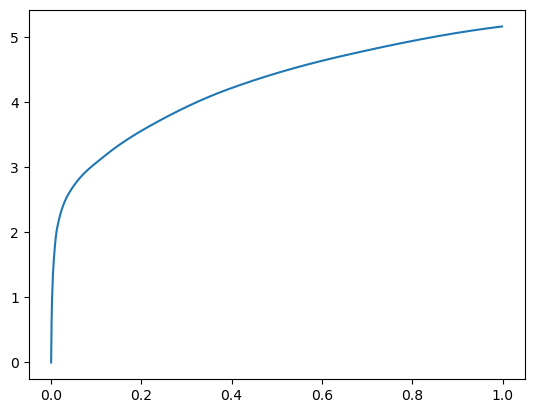

[0.00000000e+00 7.46726990e-04 2.21347809e-03 5.65433502e-03
 1.32303238e-02 3.78580093e-02 1.05050087e-01 2.13635445e-01
 3.66816521e-01 6.06801033e-01 1.00000000e+00] betas
[0.         0.48060913 0.49909888 0.51080271 0.49330873 0.46935447
 0.48765603 0.51774926 0.48870322 0.526333   0.43543685] r
-22481.990460408004 score post


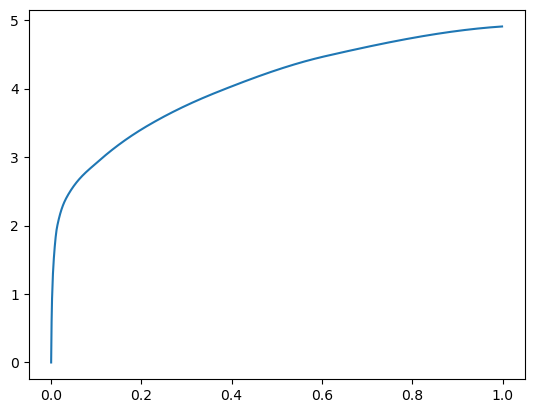

[0.00000000e+00 7.69615173e-04 2.22301483e-03 5.47122955e-03
 1.26581192e-02 3.79781723e-02 1.05837822e-01 2.07938194e-01
 3.59274864e-01 5.72916985e-01 1.00000000e+00] betas
[0.         0.5277474  0.49858624 0.49078725 0.5621739  0.54510983
 0.50973763 0.47787661 0.55226291 0.475757   0.5674754 ] r
-22481.378721678564 score post


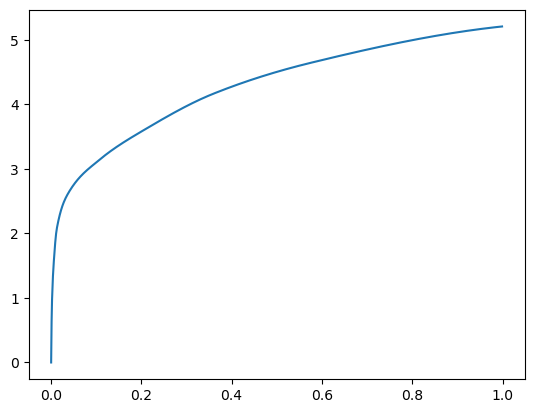

486430 steps_after


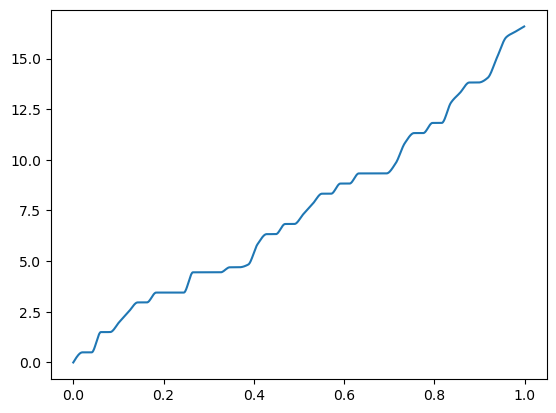

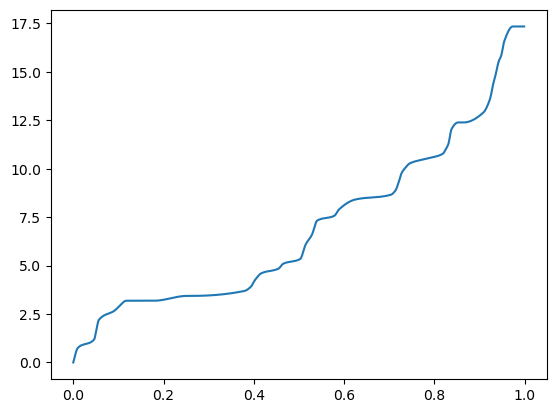

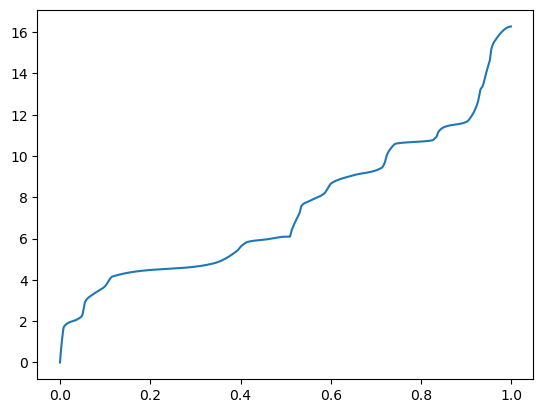

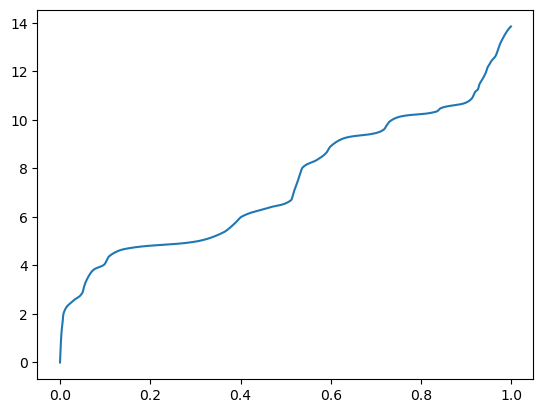

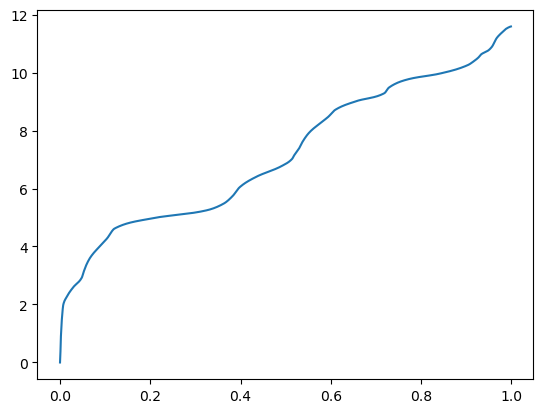

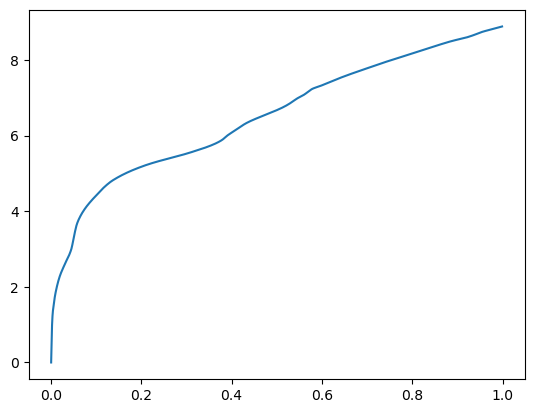

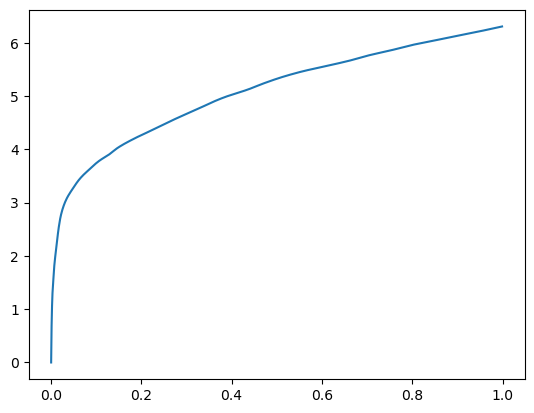

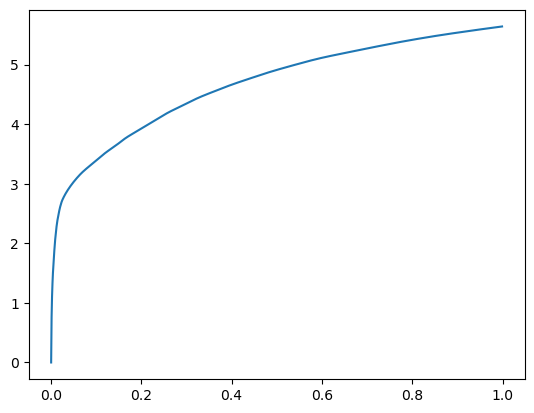

10557 steps
betas [0.00000000e+00 6.76155090e-04 2.07424164e-03 5.46741486e-03
 1.15709305e-02 3.09686661e-02 9.90362167e-02 2.04766273e-01
 3.48498344e-01 5.79531670e-01 1.00000000e+00]
n_chains 11
[0.00000000e+00 6.76155090e-04 2.07424164e-03 5.46741486e-03
 1.15709305e-02 3.09686661e-02 9.90362167e-02 2.04766273e-01
 3.48498344e-01 5.79531670e-01 1.00000000e+00] betas
[0.         0.01165041 0.34710736 0.         0.         0.
 0.         0.47402249 0.39444389 0.38895606 0.59224038] r
-22481.378721678564 score post


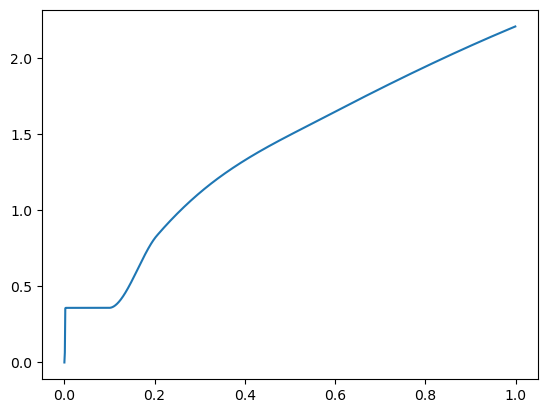

[0.         0.00146008 0.13152409 0.17063427 0.21979809 0.29577923
 0.39790249 0.53345585 0.67848301 0.83160496 1.        ] betas
[0.         0.66847669 0.988198   0.20141983 0.22145446 0.27910966
 0.28580407 0.29641328 0.27002968 0.20564584 0.19538651] r
-22480.269231963164 score post


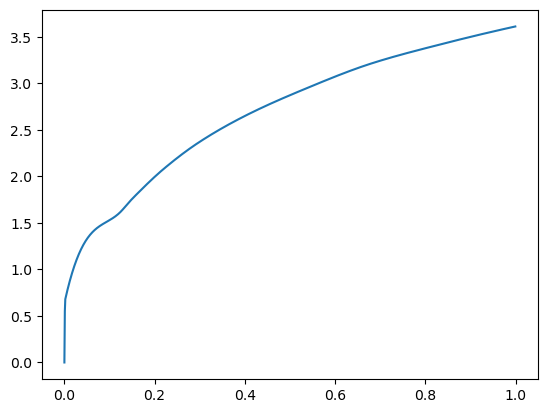

[0.00000000e+00 6.38008118e-04 3.98921967e-03 2.54297256e-02
 7.22494125e-02 1.59817696e-01 2.41843224e-01 3.53182793e-01
 5.08158684e-01 7.04915047e-01 1.00000000e+00] betas
[0.         0.45503703 0.68155478 0.82982382 0.49920114 0.53869567
 0.38222209 0.349293   0.35514208 0.35052594 0.36764513] r
-22481.378721678564 score post


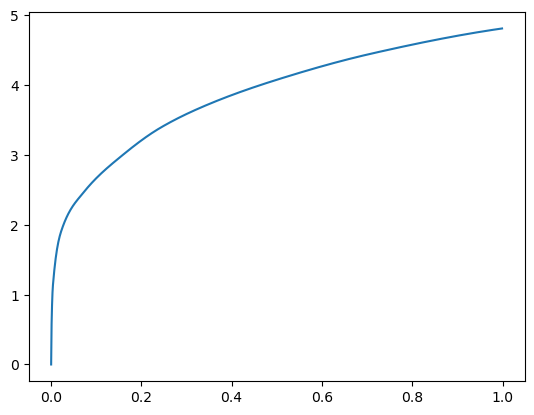

[0.00000000e+00 7.10487366e-04 2.56824493e-03 8.60309601e-03
 2.31103897e-02 6.44330978e-02 1.37486458e-01 2.36622810e-01
 3.97021294e-01 6.34362221e-01 1.00000000e+00] betas
[0.         0.45982646 0.53720995 0.63627264 0.58031155 0.47744691
 0.4511211  0.41795449 0.49228458 0.52818998 0.47408404] r
-22483.17300509828 score post


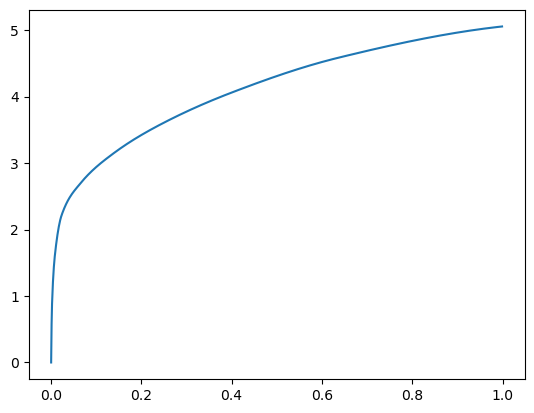

[0.00000000e+00 8.21113586e-04 2.65216827e-03 6.93416595e-03
 1.64232254e-02 4.53710556e-02 1.16366386e-01 2.30589867e-01
 3.93708229e-01 6.16164207e-01 1.00000000e+00] betas
[0.         0.51981943 0.56674037 0.52930264 0.54364851 0.45528399
 0.45176155 0.50399688 0.54521325 0.48830594 0.4360137 ] r
-22484.09117069985 score post


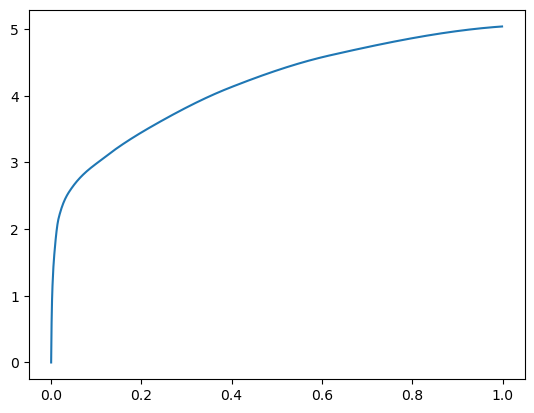

[0.00000000e+00 7.84873962e-04 2.28023529e-03 5.76686859e-03
 1.28259659e-02 3.62367630e-02 1.08170509e-01 2.19594002e-01
 3.64075661e-01 5.75804710e-01 1.00000000e+00] betas
[0.         0.49513283 0.44779602 0.52724115 0.53973235 0.4945787
 0.52771319 0.53159672 0.4499705  0.48998896 0.54694908] r
-22482.597739918583 score post


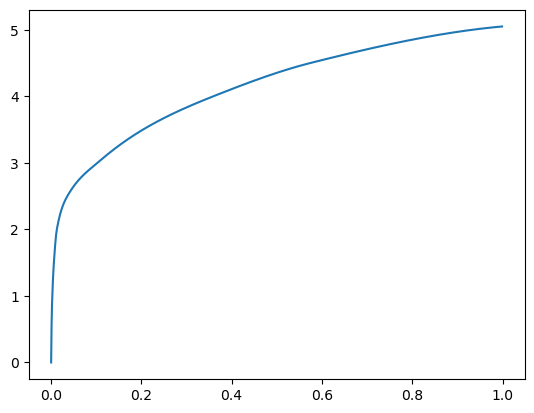

[0.00000000e+00 8.07762146e-04 2.61020660e-03 6.19792938e-03
 1.31101608e-02 3.80239487e-02 1.07867241e-01 2.12260246e-01
 3.74098778e-01 6.00436211e-01 1.00000000e+00] betas
[0.         0.56095769 0.5469203  0.47456662 0.4754335  0.49590062
 0.49380536 0.49417469 0.58049068 0.48849582 0.54679048] r
-22481.621781595804 score post


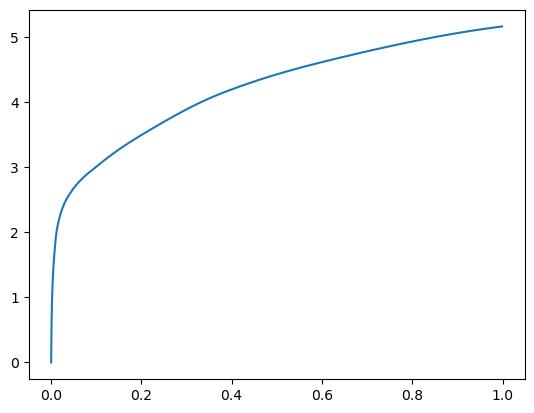

[0.00000000e+00 7.14302063e-04 2.24590302e-03 5.82981110e-03
 1.32589340e-02 4.02841568e-02 1.16196632e-01 2.28985786e-01
 3.75483513e-01 6.18674278e-01 1.00000000e+00] betas
[0.         0.50376205 0.51808318 0.51971085 0.46416978 0.4840494
 0.57470465 0.53957603 0.45847566 0.53795595 0.52958817] r
-22485.59168285815 score post


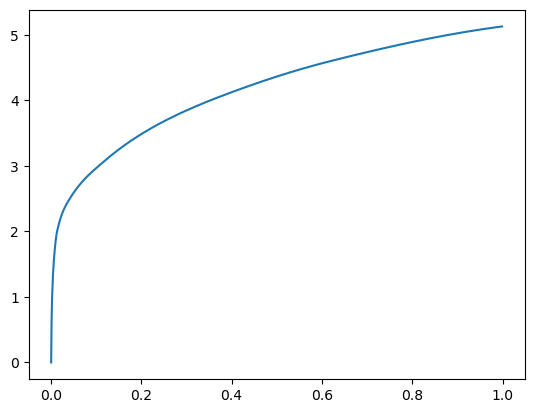

[0.00000000e+00 7.33375549e-04 2.26497650e-03 5.80310822e-03
 1.48019791e-02 4.72249985e-02 1.18487358e-01 2.25600243e-01
 3.91421318e-01 6.28254890e-01 1.00000000e+00] betas
[0.         0.55243123 0.51651039 0.49640285 0.57709285 0.58721954
 0.50180604 0.49949919 0.57770997 0.53092227 0.45673936] r
-22482.458794922564 score post


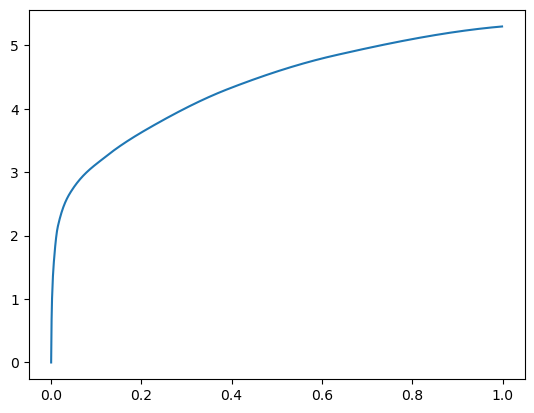

[0.00000000e+00 6.89506531e-04 2.21920013e-03 6.05869293e-03
 1.41057968e-02 4.00247574e-02 1.08902931e-01 2.19782829e-01
 3.66669655e-01 5.86499214e-01 1.00000000e+00] betas
[0.         0.52520847 0.51520695 0.49915847 0.54607214 0.46124768
 0.48649964 0.52489305 0.51307081 0.50732625 0.54893938] r
-22483.2822716802 score post


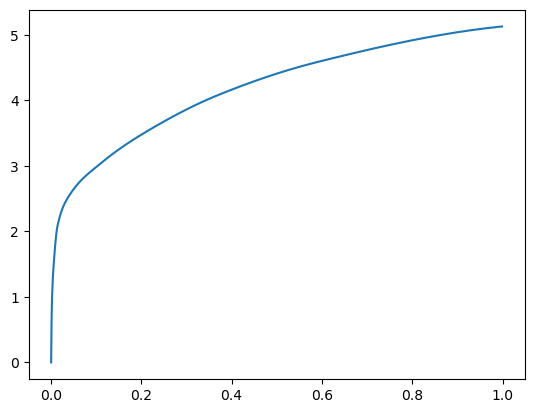

[0.00000000e+00 6.64710999e-04 2.14672089e-03 6.04534149e-03
 1.31673813e-02 4.16097641e-02 1.16524696e-01 2.27496147e-01
 3.77667427e-01 6.07485771e-01 1.00000000e+00] betas
[0.         0.52697928 0.52530469 0.51167048 0.52571108 0.55977188
 0.53554146 0.51993178 0.48958747 0.46024015 0.48997393] r
-22486.24865226613 score post


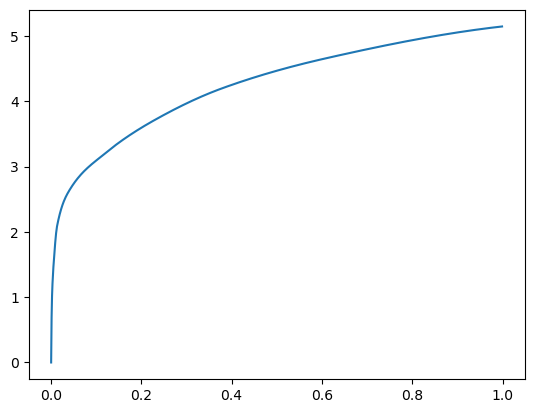

[0.00000000e+00 6.41822815e-04 2.03800201e-03 5.83362579e-03
 1.23891830e-02 3.51572037e-02 9.89370346e-02 2.01739311e-01
 3.48351479e-01 5.92108727e-01 1.00000000e+00] betas
[0.         0.4303893  0.5012709  0.5260166  0.54142963 0.49979752
 0.49269588 0.51368335 0.49480959 0.54536167 0.56473656] r
-22483.2822716802 score post


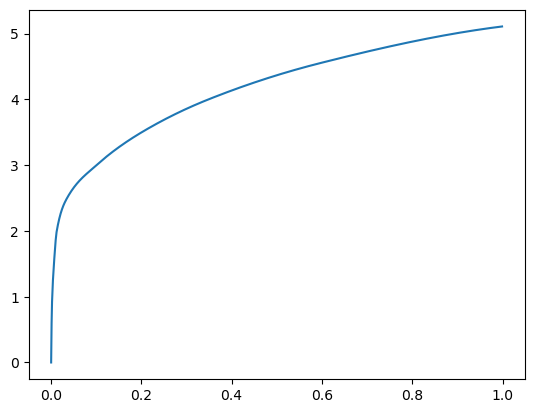

[0.00000000e+00 8.13484192e-04 2.48813629e-03 6.54888153e-03
 1.35850906e-02 3.99179459e-02 1.11350060e-01 2.19782829e-01
 3.81352425e-01 6.23164177e-01 1.00000000e+00] betas
[0.         0.52946102 0.54793507 0.51251156 0.51734621 0.46520846
 0.50179814 0.51569527 0.52602688 0.49670357 0.43596001] r
-22481.990460408004 score post


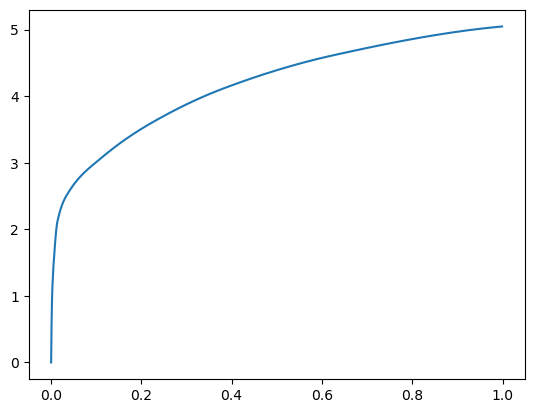

[0.00000000e+00 7.61985779e-04 2.18105316e-03 5.75923920e-03
 1.17197037e-02 3.54795456e-02 1.03365898e-01 2.05824852e-01
 3.52673531e-01 5.80437660e-01 1.00000000e+00] betas
[0.         0.52825543 0.48111665 0.53935142 0.42416386 0.53223351
 0.48771562 0.52055649 0.55874021 0.49370433 0.51029926] r
-22480.269231963164 score post


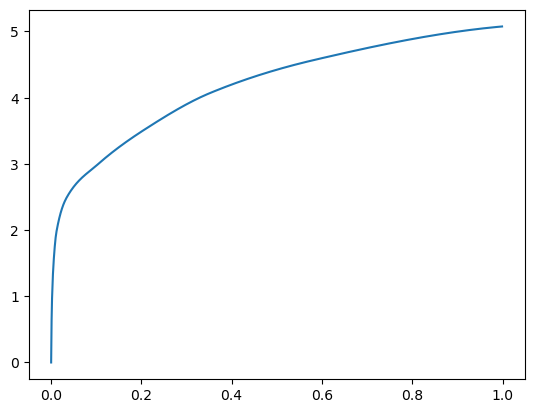

[0.00000000e+00 7.20024109e-04 2.20775604e-03 5.50556183e-03
 1.32894516e-02 3.83405685e-02 1.12292290e-01 2.14943886e-01
 3.48740578e-01 5.82114220e-01 1.00000000e+00] betas
[0.         0.51867467 0.5123788  0.47487762 0.51102768 0.44171639
 0.53393704 0.46180526 0.47573604 0.5302143  0.54922074] r
-22487.502824653955 score post


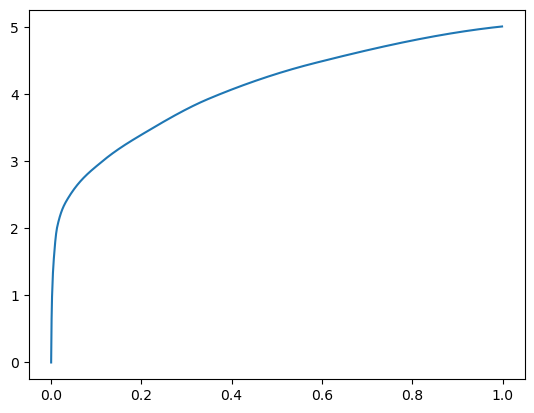

[0.00000000e+00 6.85691833e-04 2.07805634e-03 5.47313690e-03
 1.28908157e-02 4.26664352e-02 1.14649773e-01 2.28098869e-01
 3.76801491e-01 6.10579491e-01 1.00000000e+00] betas
[0.         0.512766   0.52238659 0.52958329 0.56360038 0.56546148
 0.5157074  0.51478261 0.4729077  0.53024563 0.51011812] r
-22487.70109236217 score post


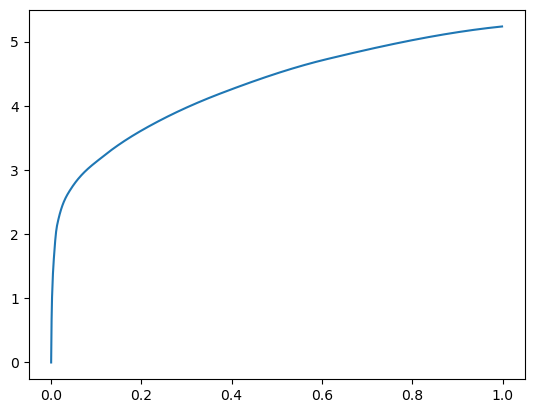

[0.00000000e+00 7.06672668e-04 2.13146210e-03 5.53417206e-03
 1.20630264e-02 3.61528397e-02 1.02620125e-01 2.12964058e-01
 3.74142647e-01 6.02663994e-01 1.00000000e+00] betas
[0.         0.4567143  0.47385414 0.45946216 0.47905779 0.56762298
 0.52187006 0.51079352 0.59448388 0.52172576 0.49125498] r
-22483.2822716802 score post


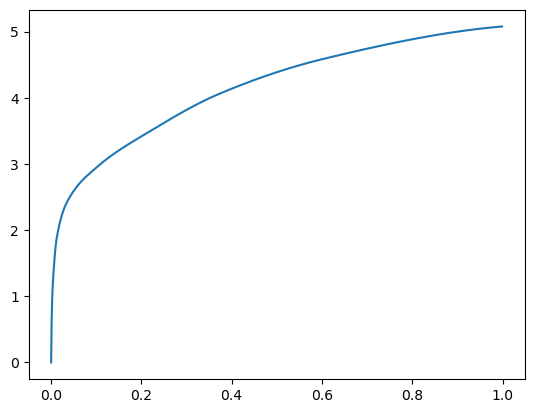

[0.00000000e+00 8.21113586e-04 2.57396698e-03 6.94370270e-03
 1.65834427e-02 4.47759628e-02 1.18065834e-01 2.33450890e-01
 3.73309135e-01 5.92871666e-01 1.00000000e+00] betas
[0.         0.5339264  0.55869186 0.55593269 0.5756921  0.46351541
 0.51898133 0.562116   0.47126289 0.44283852 0.54806488] r
-22481.378721678564 score post


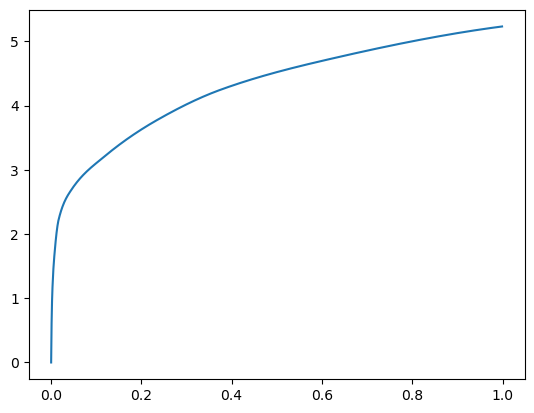

[0.00000000e+00 7.98225403e-04 2.35271454e-03 6.06060028e-03
 1.33161545e-02 3.81021500e-02 1.06221199e-01 2.07814217e-01
 3.52887154e-01 6.08082771e-01 1.00000000e+00] betas
[0.         0.55843273 0.50375011 0.52171595 0.46802422 0.45900178
 0.50121631 0.4702321  0.48137291 0.54217469 0.56149911] r
-22485.55384003957 score post


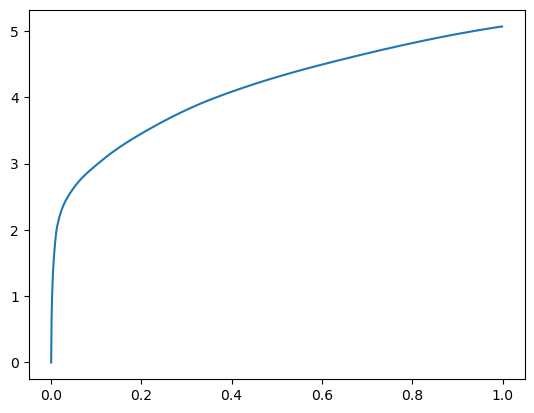

[0.00000000e+00 6.95228577e-04 2.13336945e-03 5.41019440e-03
 1.26142502e-02 4.01544571e-02 1.11193657e-01 2.24675179e-01
 3.88167381e-01 6.39931679e-01 1.00000000e+00] betas
[0.         0.50409928 0.50572681 0.47965642 0.54065929 0.52237014
 0.51081321 0.54235472 0.53746407 0.54157611 0.47090243] r
-22485.59168285815 score post


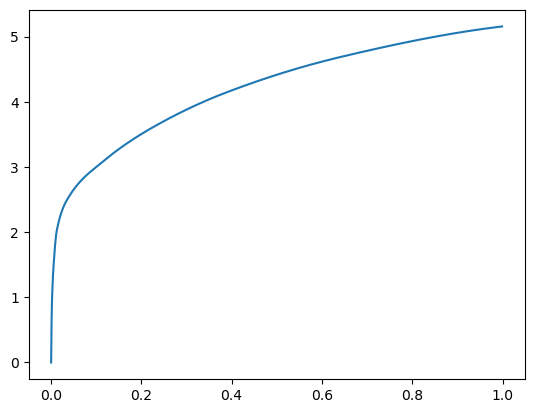

[0.00000000e+00 7.18116760e-04 2.23255157e-03 5.97095490e-03
 1.35736465e-02 4.24642563e-02 1.16396904e-01 2.25502968e-01
 3.81176949e-01 6.13717079e-01 1.00000000e+00] betas
[0.         0.47168128 0.520278   0.49514368 0.51673696 0.50205994
 0.47727749 0.49056028 0.49523796 0.52901959 0.52595706] r
-22482.597739918583 score post


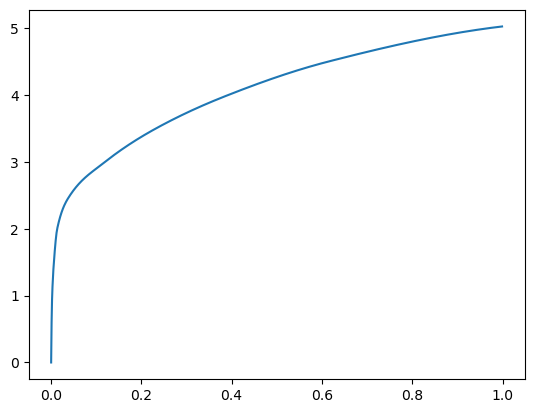

[0.00000000e+00 7.84873962e-04 2.29549408e-03 6.18648529e-03
 1.37586594e-02 4.30688858e-02 1.22273445e-01 2.37086296e-01
 4.00052071e-01 6.27312660e-01 1.00000000e+00] betas
[0.         0.51614282 0.52696723 0.52634005 0.48273339 0.49445827
 0.47632415 0.54396272 0.51038846 0.48659952 0.46574268] r
-22480.269231963164 score post


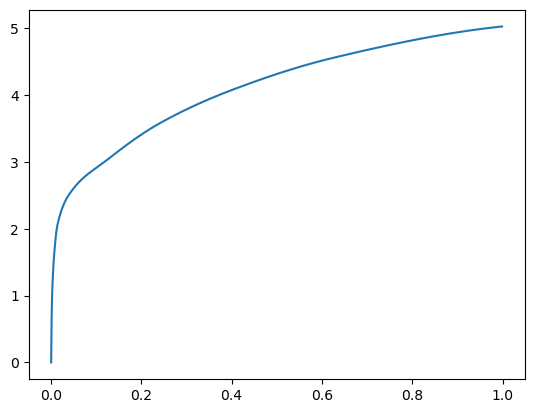

[0.00000000e+00 7.58171082e-04 2.13146210e-03 5.53989410e-03
 1.26390457e-02 3.98187637e-02 1.21300697e-01 2.25367546e-01
 3.79651070e-01 6.05063438e-01 1.00000000e+00] betas
[0.         0.43239117 0.45058434 0.53251796 0.52169892 0.54134193
 0.52513937 0.53829409 0.49064113 0.53238565 0.5007491 ] r
-22488.224033391914 score post


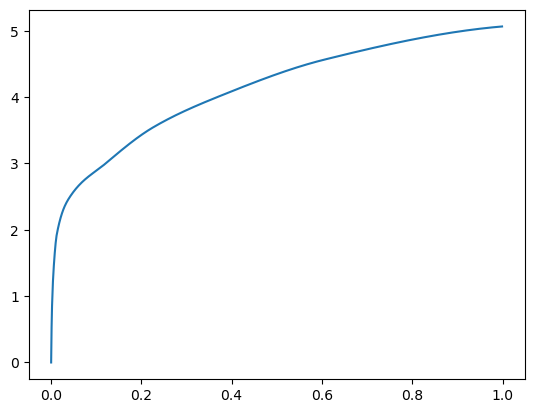

[0.00000000e+00 9.37461853e-04 2.75516510e-03 6.57367706e-03
 1.53207779e-02 4.51707840e-02 1.27509117e-01 2.26382256e-01
 3.86963844e-01 6.01658821e-01 1.00000000e+00] betas
[0.         0.56018232 0.50307324 0.50917606 0.52032454 0.55726745
 0.49623336 0.45078346 0.5471927  0.43936492 0.56189149] r
-22492.006491569304 score post


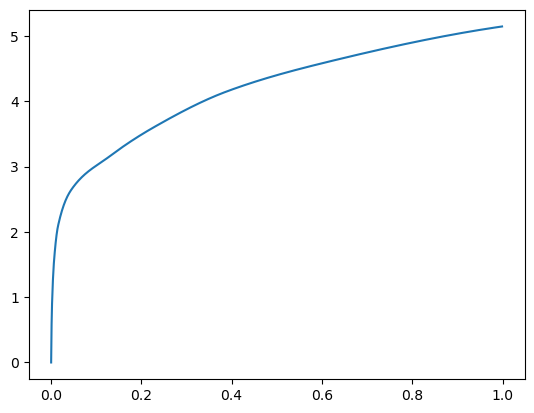

[0.00000000e+00 8.30650330e-04 2.57968903e-03 6.25324249e-03
 1.43251419e-02 3.82833481e-02 1.15601540e-01 2.27599144e-01
 3.76492500e-01 6.29691124e-01 1.00000000e+00] betas
[0.         0.54846464 0.53253867 0.55314027 0.502281   0.49387008
 0.52471288 0.50756949 0.48106967 0.53786791 0.47433803] r
-22480.269231963164 score post


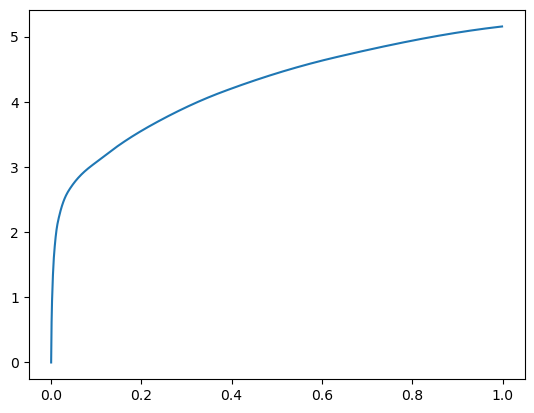

[0.00000000e+00 7.60078430e-04 2.35080719e-03 5.42545319e-03
 1.24692917e-02 3.40337753e-02 1.03987694e-01 2.13767052e-01
 3.69315147e-01 6.05042458e-01 1.00000000e+00] betas
[0.         0.49095551 0.51307284 0.4157605  0.51294424 0.47151286
 0.51757507 0.50927881 0.56193755 0.49970501 0.49879361] r
-22486.7424107292 score post


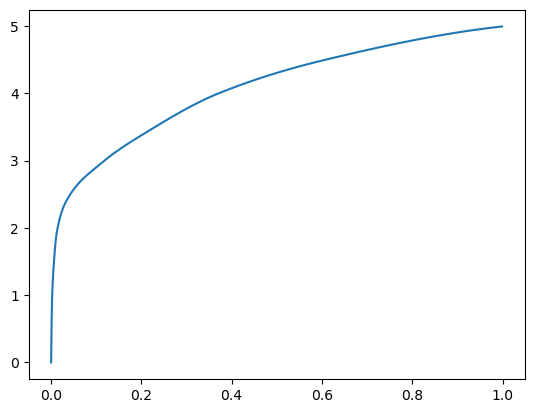

[0.00000000e+00 7.79151917e-04 2.32219696e-03 6.22844696e-03
 1.42774582e-02 4.21743393e-02 1.17045403e-01 2.29199409e-01
 3.69385719e-01 6.04819298e-01 1.00000000e+00] betas
[0.         0.49427178 0.53507563 0.57431135 0.5183984  0.44504514
 0.48694364 0.51914464 0.45132126 0.47553344 0.53086785] r
-22480.269231963164 score post


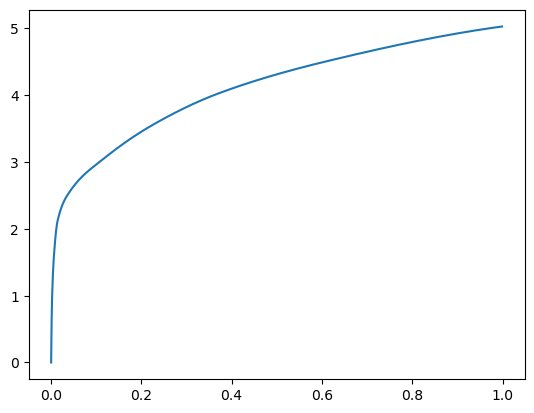

[0.00000000e+00 7.98225403e-04 2.22110748e-03 5.31101227e-03
 1.16510391e-02 3.70016098e-02 1.10438347e-01 2.16029167e-01
 3.69471550e-01 6.21821404e-01 1.00000000e+00] betas
[0.         0.53297235 0.47969445 0.45101736 0.51626198 0.51407037
 0.5328662  0.5125862  0.49627178 0.50669158 0.52813349] r
-22481.621781595804 score post


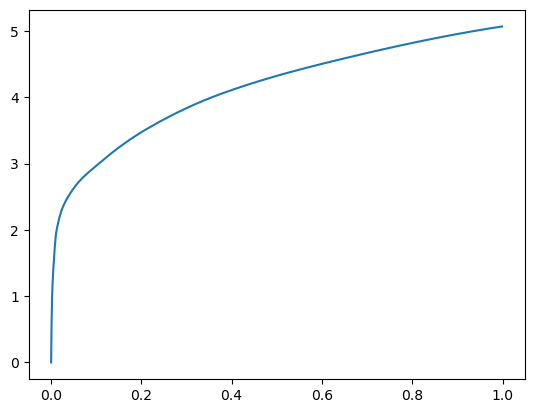

[0.00000000e+00 7.44819641e-04 2.22873688e-03 5.84697723e-03
 1.30071640e-02 4.06789780e-02 1.13076210e-01 2.18562126e-01
 3.77745628e-01 6.34509087e-01 1.00000000e+00] betas
[0.         0.51178327 0.52428062 0.4926846  0.53341896 0.54377433
 0.49283489 0.48986341 0.52353467 0.5329926  0.51866323] r
-22481.378721678564 score post


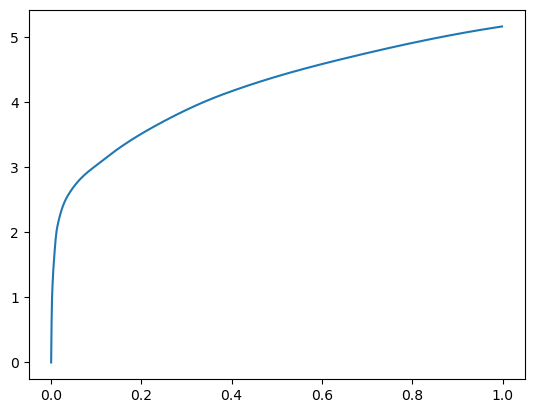

[0.00000000e+00 7.54356384e-04 2.21347809e-03 6.05297089e-03
 1.31025314e-02 3.85141373e-02 1.12990379e-01 2.25285530e-01
 3.85088921e-01 6.35848045e-01 1.00000000e+00] betas
[0.         0.54472191 0.46331457 0.55904094 0.4798622  0.53029732
 0.55064113 0.5469871  0.4500009  0.58864188 0.50064649] r
-22480.269231963164 score post


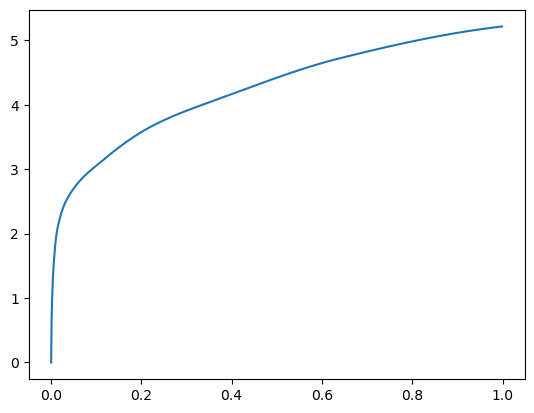

[0.00000000e+00 7.06672668e-04 2.38132477e-03 6.02436066e-03
 1.42202377e-02 4.10890579e-02 1.13093376e-01 2.18556404e-01
 4.03061867e-01 6.24341011e-01 1.00000000e+00] betas
[0.         0.489173   0.56529338 0.47107657 0.56036593 0.44809663
 0.5174093  0.49966849 0.59902412 0.42978074 0.49494692] r
-22481.621781595804 score post


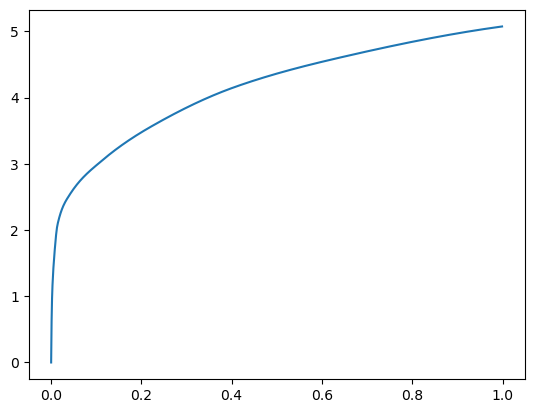

[0.00000000e+00 7.44819641e-04 2.19631195e-03 5.99193573e-03
 1.27763748e-02 4.14094925e-02 1.11966133e-01 2.18888283e-01
 3.68580818e-01 6.16520882e-01 1.00000000e+00] betas
[0.         0.54828374 0.50723521 0.52964316 0.46650026 0.5086465
 0.48377635 0.50748107 0.48743507 0.53208018 0.53633431] r
-22481.378721678564 score post


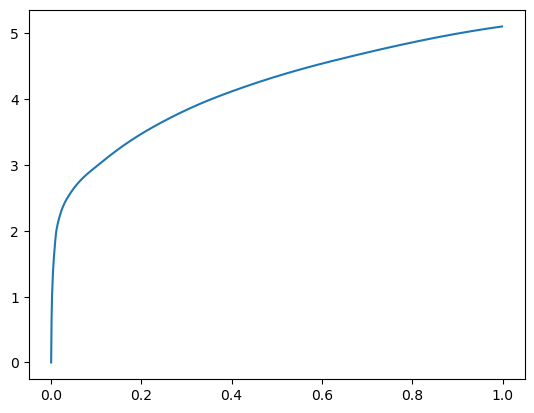

[0.00000000e+00 6.74247742e-04 2.04563141e-03 5.45215607e-03
 1.25188828e-02 4.07838821e-02 1.15572929e-01 2.24984169e-01
 3.86685371e-01 6.31470680e-01 1.00000000e+00] betas
[0.         0.45484627 0.52022681 0.51766154 0.51824202 0.49141563
 0.51436395 0.48262029 0.49991964 0.50890007 0.51932363] r
-22480.269231963164 score post


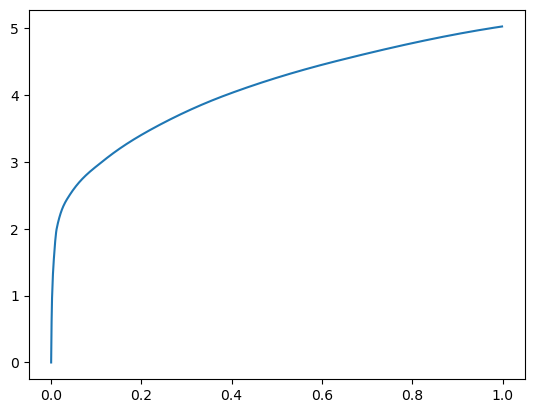

[0.00000000e+00 7.71522522e-04 2.17914581e-03 5.60283661e-03
 1.25207901e-02 4.18710709e-02 1.15527153e-01 2.30422020e-01
 3.95770073e-01 6.41236305e-01 1.00000000e+00] betas
[0.         0.51474344 0.48681544 0.4830046  0.55066638 0.54119132
 0.50452647 0.52176073 0.53917887 0.50078506 0.48124149] r
-22485.59168285815 score post


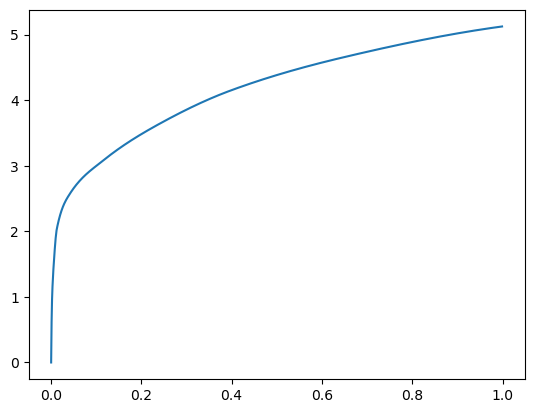

[0.00000000e+00 7.65800476e-04 2.28977203e-03 6.10637665e-03
 1.29423141e-02 4.05187607e-02 1.14333153e-01 2.26273537e-01
 3.79515648e-01 6.22502327e-01 1.00000000e+00] betas
[0.         0.49828873 0.49742083 0.54102301 0.48087273 0.49021638
 0.50521423 0.52542144 0.49694469 0.5448524  0.46492904] r
-22480.269231963164 score post


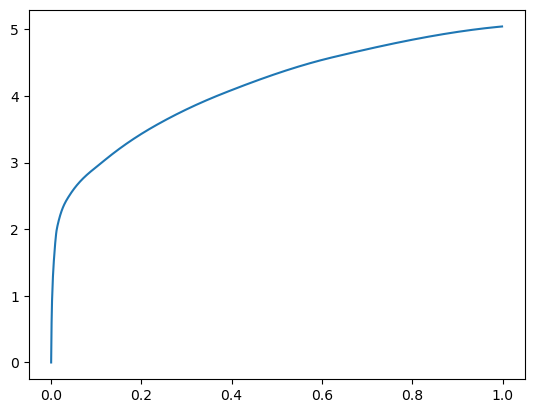

[0.00000000e+00 7.79151917e-04 2.35462189e-03 5.87177277e-03
 1.29575729e-02 4.19282913e-02 1.16839409e-01 2.24514961e-01
 3.79792213e-01 5.99190712e-01 1.00000000e+00] betas
[0.         0.559871   0.53147862 0.53083731 0.48114255 0.48688099
 0.51224259 0.51776002 0.4449614  0.47075654 0.5539912 ] r
-22480.269231963164 score post


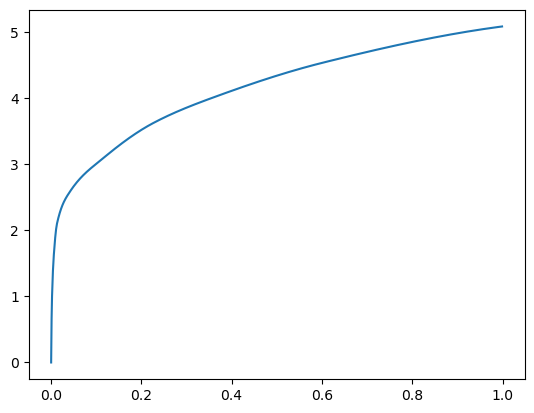

[0.00000000e+00 6.81877136e-04 2.04753876e-03 4.99248505e-03
 1.13019943e-02 3.75699997e-02 1.08166695e-01 2.09599495e-01
 3.82529259e-01 6.25580788e-01 1.00000000e+00] betas
[0.         0.47331281 0.4898448  0.44891167 0.50243399 0.58001782
 0.52830976 0.51274576 0.54021944 0.49551682 0.48786685] r
-22484.252724367707 score post


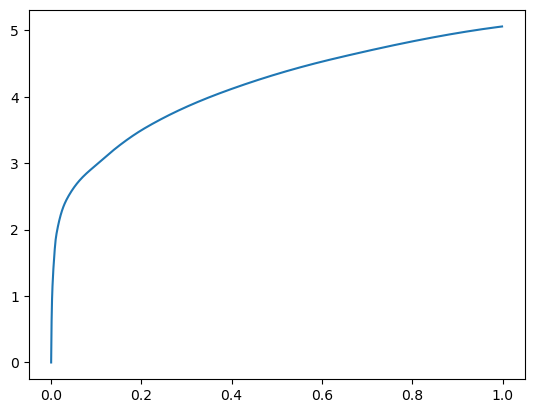

[0.00000000e+00 7.48634338e-04 2.27069855e-03 5.99193573e-03
 1.42984390e-02 4.05511856e-02 1.10249519e-01 2.11087227e-01
 3.71264458e-01 6.14525795e-01 1.00000000e+00] betas
[0.         0.46723266 0.52134298 0.55568443 0.55531949 0.45661788
 0.47043846 0.50666594 0.49110966 0.52637969 0.53355803] r
-22481.378721678564 score post


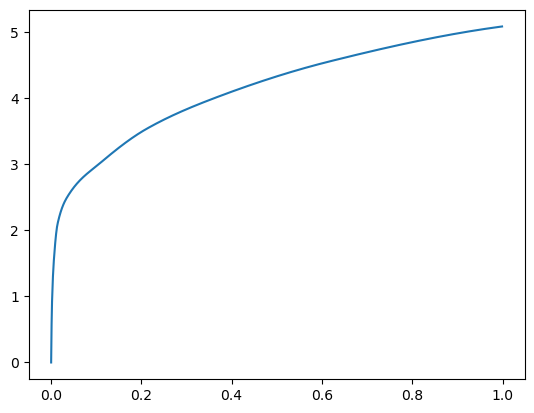

[0.00000000e+00 8.40187073e-04 2.40039825e-03 5.79929352e-03
 1.26104355e-02 3.92122269e-02 1.14386559e-01 2.17803001e-01
 3.88205528e-01 6.29221916e-01 1.00000000e+00] betas
[0.         0.5616753  0.52678137 0.4981549  0.47254817 0.54873389
 0.5504234  0.45314243 0.5380127  0.49285745 0.4470895 ] r
-22480.269231963164 score post


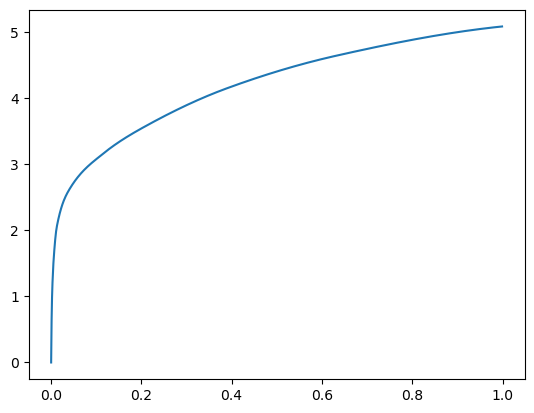

[0.00000000e+00 7.35282898e-04 2.10285187e-03 5.22136688e-03
 1.20096207e-02 3.41424942e-02 9.53912735e-02 2.04760551e-01
 3.58645439e-01 5.91233253e-01 1.00000000e+00] betas
[0.         0.51573856 0.47449211 0.49505298 0.54025332 0.51759623
 0.50807304 0.51235122 0.56234672 0.53300749 0.52673954] r
-22484.348661750126 score post


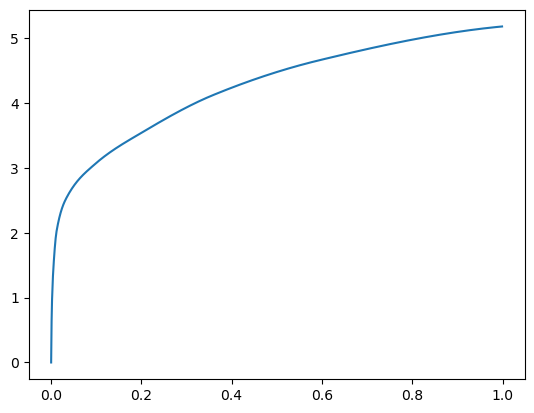

[0.00000000e+00 7.41004944e-04 2.31266022e-03 5.87177277e-03
 1.32684708e-02 3.80392075e-02 1.05530739e-01 2.20902443e-01
 3.66600990e-01 5.96066475e-01 1.00000000e+00] betas
[0.         0.50189467 0.51391315 0.49025187 0.56438826 0.50389327
 0.48006346 0.54001766 0.52413583 0.49192726 0.56170426] r
-22481.990460408004 score post


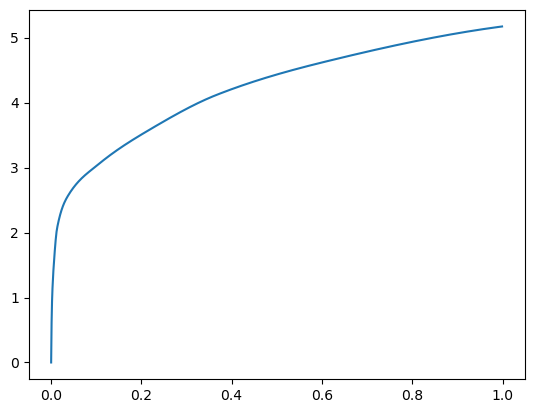

[0.00000000e+00 7.75337219e-04 2.40421295e-03 6.32381439e-03
 1.32246017e-02 3.90806198e-02 1.14209175e-01 2.27297783e-01
 3.73671532e-01 6.22105598e-01 1.00000000e+00] betas
[0.         0.54994245 0.48344004 0.48572895 0.51703031 0.50530521
 0.55140975 0.48721613 0.45740441 0.55495291 0.52638208] r
-22482.597739918583 score post


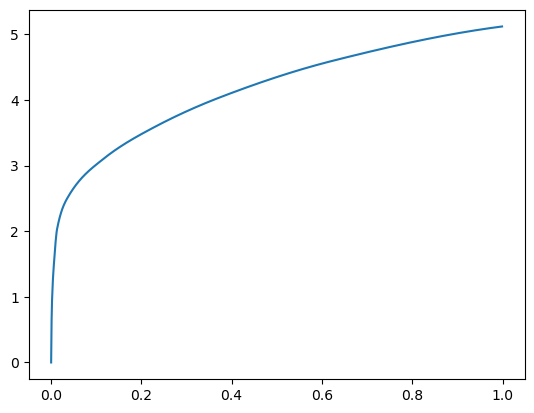

[0.00000000e+00 6.95228577e-04 2.35271454e-03 6.49738312e-03
 1.35526657e-02 4.06579971e-02 1.10289574e-01 2.28146553e-01
 3.95701408e-01 6.30442619e-01 1.00000000e+00] betas
[0.         0.48778459 0.49944503 0.53422805 0.49464421 0.53226041
 0.48449929 0.58087526 0.54337015 0.45408187 0.47885129] r
-22480.269231963164 score post


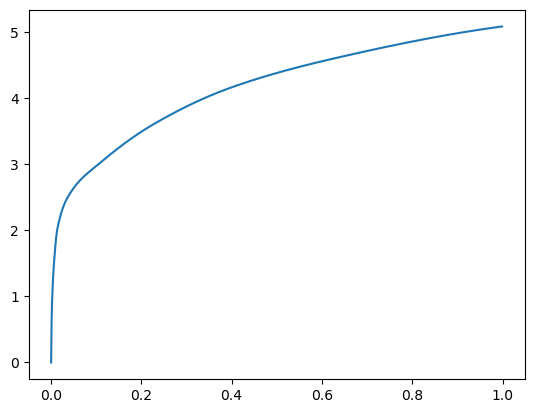

[0.00000000e+00 7.42912292e-04 2.51674652e-03 6.55651093e-03
 1.41382217e-02 4.03566360e-02 1.13921165e-01 2.15674400e-01
 3.63238335e-01 6.11500740e-01 1.00000000e+00] betas
[0.         0.50092638 0.54849612 0.56861393 0.48694468 0.4834285
 0.51354845 0.51071378 0.51040914 0.52246989 0.50938467] r
-22481.378721678564 score post


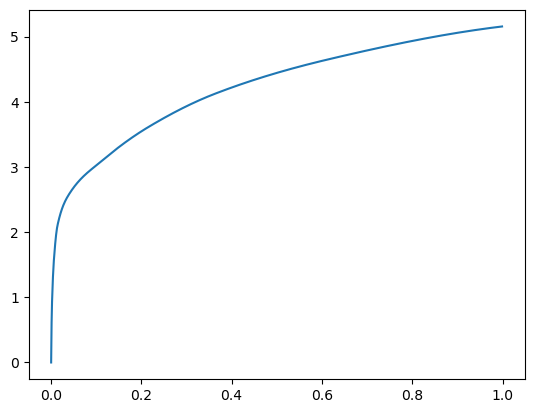

[0.00000000e+00 7.75337219e-04 2.42710114e-03 5.82981110e-03
 1.29899979e-02 3.93590927e-02 1.12385750e-01 2.14657784e-01
 3.63562584e-01 6.07796669e-01 1.00000000e+00] betas
[0.         0.52548811 0.56674547 0.49548834 0.54257123 0.51033797
 0.50016264 0.47154238 0.52367218 0.53290138 0.53417232] r
-22480.269231963164 score post


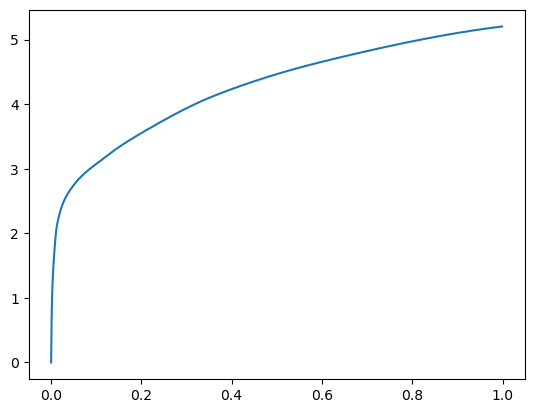

[0.00000000e+00 7.63893127e-04 2.20394135e-03 5.57422638e-03
 1.18513107e-02 3.58819962e-02 1.08944893e-01 2.22092628e-01
 3.73291969e-01 6.15933418e-01 1.00000000e+00] betas
[0.         0.49762904 0.4819289  0.50209044 0.48625187 0.52032694
 0.53223016 0.53402105 0.47978714 0.52849137 0.51550908] r
-22489.53220030006 score post


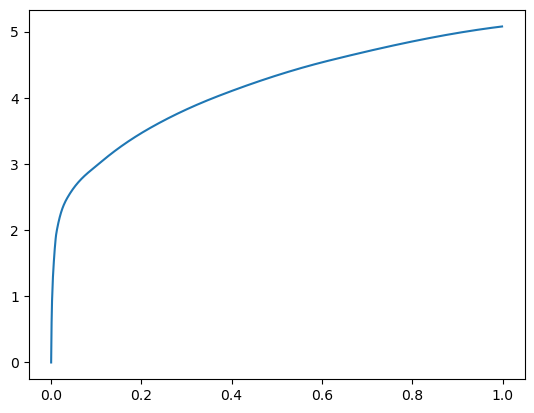

[0.00000000e+00 7.86781311e-04 2.37369537e-03 5.97667694e-03
 1.35927200e-02 4.03337479e-02 1.13541603e-01 2.22172737e-01
 3.84182930e-01 6.20482445e-01 1.00000000e+00] betas
[0.         0.55966856 0.49753306 0.51306152 0.50482424 0.49692357
 0.53360541 0.52910178 0.53451511 0.48027674 0.50854223] r
-22485.841550972513 score post


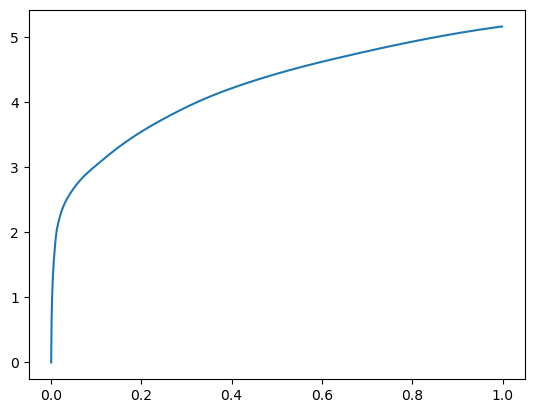

[0.00000000e+00 6.99043274e-04 2.25353241e-03 5.74016571e-03
 1.32455826e-02 4.09612656e-02 1.11710548e-01 2.16189384e-01
 3.67934227e-01 6.16070747e-01 1.00000000e+00] betas
[0.         0.475874   0.53715775 0.48238097 0.50325673 0.51784917
 0.49899892 0.49693878 0.53810457 0.54691088 0.49180541] r
-22482.597739918583 score post


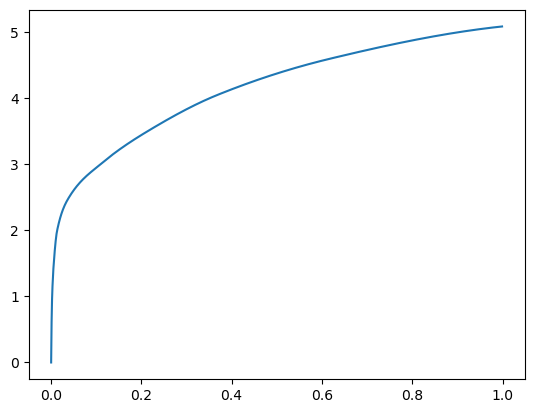

[0.00000000e+00 7.69615173e-04 2.27642059e-03 6.07585907e-03
 1.44052505e-02 4.35838699e-02 1.18422508e-01 2.28478432e-01
 3.75512123e-01 6.05841637e-01 1.00000000e+00] betas
[0.         0.53596771 0.54148162 0.51179567 0.57986234 0.52376455
 0.53738391 0.49556571 0.43683711 0.47076873 0.53228953] r
-22480.269231963164 score post


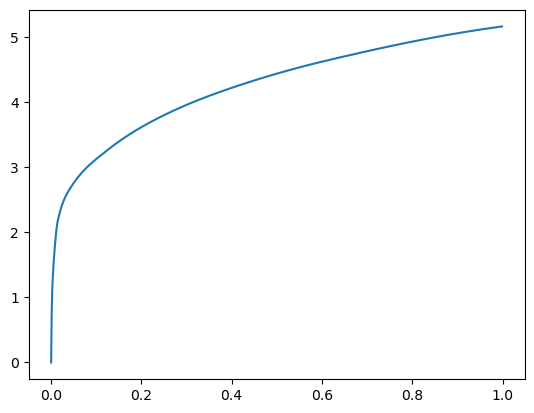

[0.00000000e+00 7.31468201e-04 2.08377838e-03 5.66577911e-03
 1.21068954e-02 3.41482162e-02 9.51910019e-02 1.99612617e-01
 3.63419533e-01 6.15357399e-01 1.00000000e+00] betas
[0.         0.49869668 0.46450443 0.53179463 0.49741762 0.47886115
 0.49461631 0.53508648 0.51423097 0.52962646 0.46367637] r
-22481.621781595804 score post


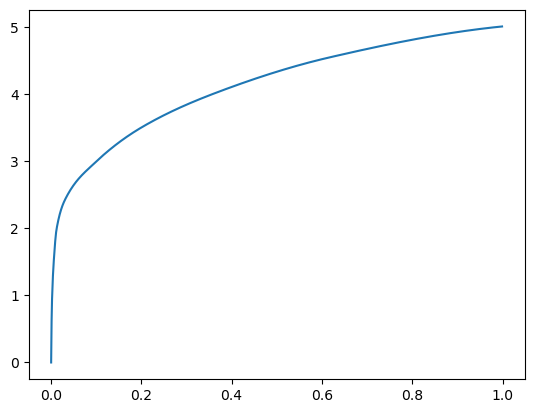

[0.00000000e+00 7.35282898e-04 2.26306915e-03 5.73825836e-03
 1.24006271e-02 3.68108749e-02 1.01393700e-01 2.00871468e-01
 3.60138893e-01 5.92387199e-01 1.00000000e+00] betas
[0.         0.52069613 0.56101633 0.50383606 0.50313587 0.49989818
 0.46534616 0.47270244 0.57733477 0.46537686 0.56536463] r
-22480.269231963164 score post


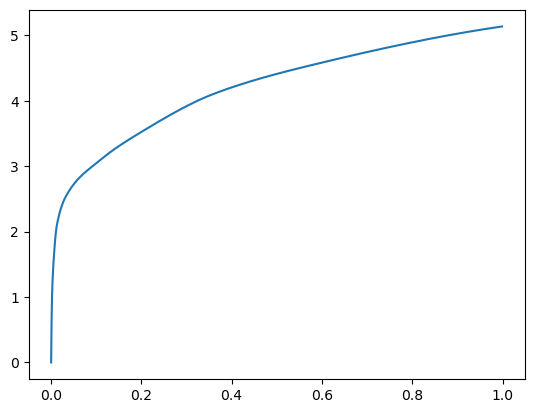

[0.00000000e+00 7.21931458e-04 2.03800201e-03 5.30529022e-03
 1.15785599e-02 3.49950790e-02 1.06078148e-01 2.17198372e-01
 3.61588478e-01 6.23772621e-01 1.00000000e+00] betas
[0.         0.48466973 0.53935565 0.51054521 0.50246178 0.53243298
 0.55646405 0.50274736 0.47975097 0.54761741 0.45273499] r
-22481.378721678564 score post


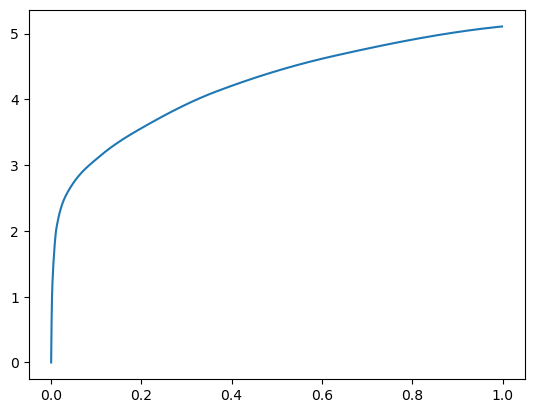

[0.00000000e+00 7.71522522e-04 2.02846527e-03 5.28812408e-03
 1.17425919e-02 3.38239670e-02 9.55820084e-02 2.03618050e-01
 3.53571892e-01 5.88000298e-01 1.00000000e+00] betas
[0.         0.53354134 0.43327238 0.49248229 0.52381067 0.47646475
 0.49264946 0.56944041 0.50474204 0.52240864 0.47438897] r
-22480.269231963164 score post


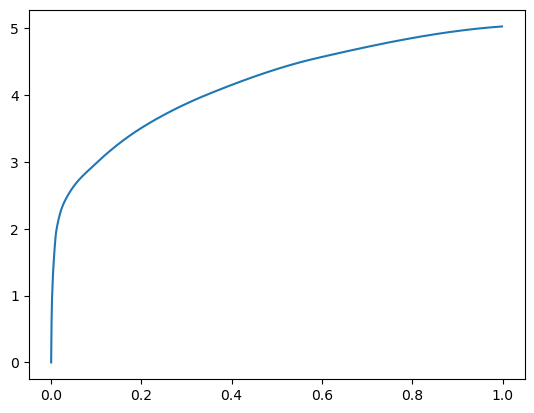

[0.00000000e+00 7.08580017e-04 2.20203400e-03 5.72872162e-03
 1.24425888e-02 3.81460190e-02 1.05294228e-01 2.02319145e-01
 3.50701332e-01 5.70805550e-01 1.00000000e+00] betas
[0.         0.53763611 0.51133956 0.51478602 0.52632979 0.54545099
 0.46582653 0.48791632 0.51355431 0.5137489  0.54519163] r
-22481.378721678564 score post


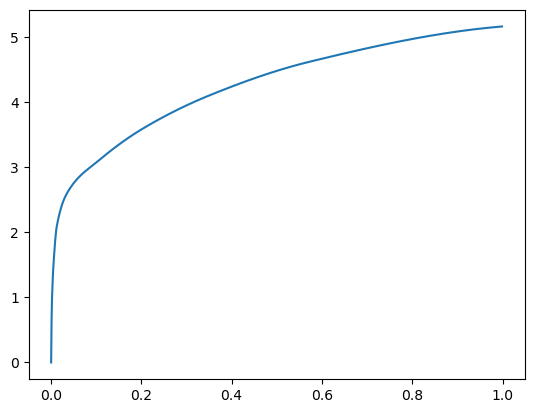

[0.00000000e+00 6.66618347e-04 2.12764740e-03 5.58567047e-03
 1.18436813e-02 3.36332321e-02 1.04559898e-01 2.08128929e-01
 3.60167503e-01 5.87948799e-01 1.00000000e+00] betas
[0.         0.46497719 0.46754594 0.48093035 0.48918143 0.4705777
 0.5454042  0.52558455 0.53806393 0.4766433  0.52599486] r
-22480.269231963164 score post


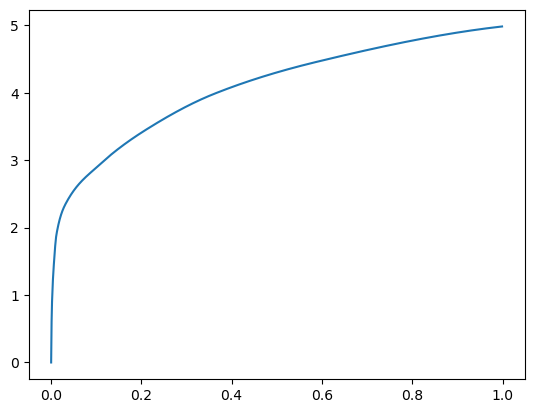

[0.00000000e+00 7.41004944e-04 2.45571136e-03 6.39438629e-03
 1.44433975e-02 4.42094803e-02 1.16539955e-01 2.18945503e-01
 3.62286568e-01 6.04966164e-01 1.00000000e+00] betas
[0.         0.50681166 0.56819745 0.50107174 0.51195332 0.49666619
 0.49958651 0.45871829 0.51021505 0.54220876 0.52621664] r
-22481.378721678564 score post


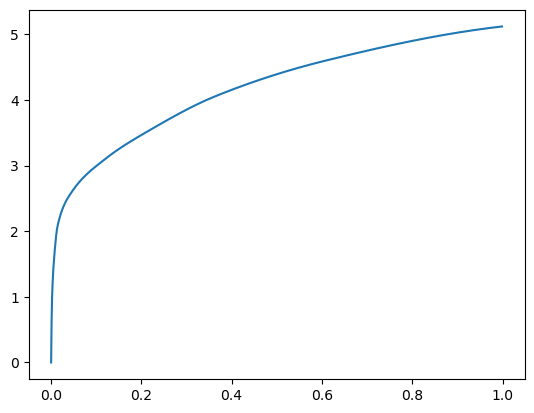

[0.00000000e+00 7.52449036e-04 2.21920013e-03 5.95378876e-03
 1.33352280e-02 4.19073105e-02 1.14480019e-01 2.29527473e-01
 3.78258705e-01 6.13234520e-01 1.00000000e+00] betas
[0.         0.50788542 0.49918553 0.56765194 0.4966744  0.46247552
 0.47887441 0.53104136 0.46719652 0.56770554 0.40337017] r
-22482.458794922564 score post


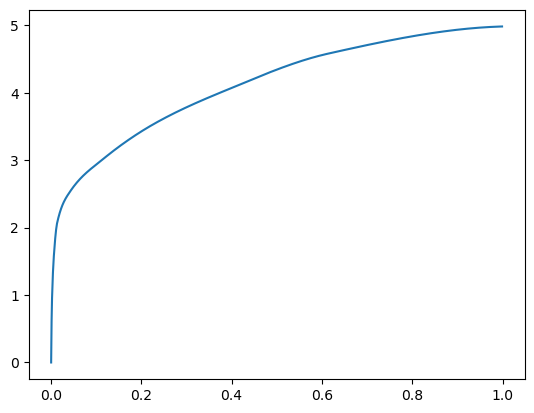

[0.00000000e+00 7.31468201e-04 2.17151642e-03 5.19657135e-03
 1.14145279e-02 3.76176834e-02 1.10159874e-01 2.14972496e-01
 3.69103432e-01 5.60765266e-01 1.00000000e+00] betas
[0.         0.53747074 0.50679462 0.42539961 0.46418909 0.58448866
 0.48887494 0.51135659 0.47813118 0.44782893 0.58284428] r
-22484.348467993714 score post


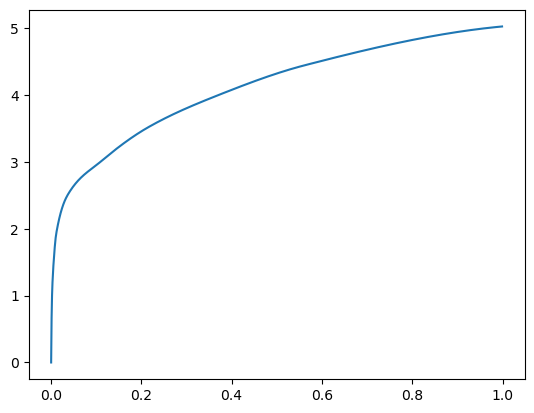

[0.00000000e+00 6.64710999e-04 2.00176239e-03 5.58185577e-03
 1.35011673e-02 3.72095108e-02 1.11773491e-01 2.15126991e-01
 3.78529549e-01 6.06892586e-01 1.00000000e+00] betas
[0.         0.46273146 0.53057091 0.52733059 0.51054887 0.46328817
 0.55049046 0.49205481 0.54581168 0.49099642 0.50024873] r
-22486.743354016493 score post


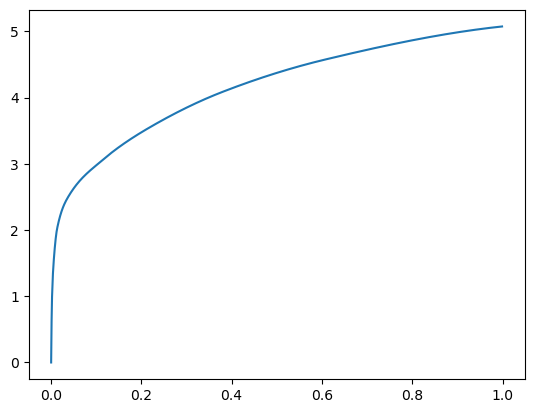

[0.00000000e+00 7.50541687e-04 2.09522247e-03 5.59902191e-03
 1.34534836e-02 4.09841537e-02 1.11685753e-01 2.18869209e-01
 3.69761467e-01 6.02543831e-01 1.00000000e+00] betas
[0.         0.49462762 0.51220811 0.53631937 0.56001635 0.55075839
 0.49931879 0.50048111 0.54229214 0.48886094 0.49623376] r
-22481.378721678564 score post


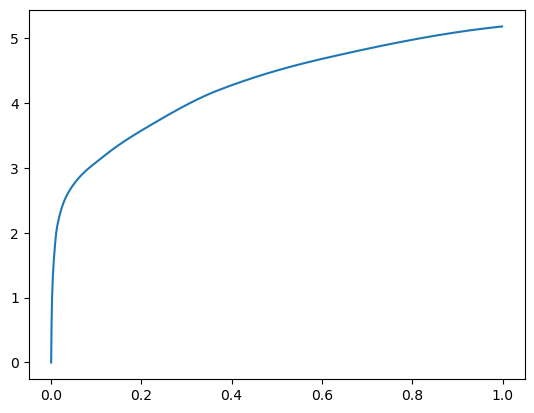

[0.00000000e+00 7.98225403e-04 2.22301483e-03 5.70964813e-03
 1.26657486e-02 3.56893539e-02 1.03688240e-01 2.12298393e-01
 3.51815224e-01 5.89077950e-01 1.00000000e+00] betas
[0.         0.52216176 0.52196978 0.51653624 0.52125804 0.51273782
 0.52133447 0.48597388 0.47066556 0.55641795 0.58720206] r
-22480.269231963164 score post


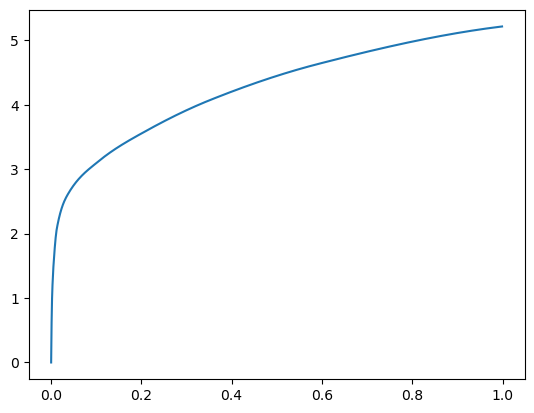

[0.00000000e+00 7.96318054e-04 2.21920013e-03 5.74970245e-03
 1.27859116e-02 3.67860794e-02 1.06091499e-01 2.25201607e-01
 3.88348579e-01 6.25576973e-01 1.00000000e+00] betas
[0.         0.54601612 0.51349687 0.49530658 0.51511168 0.4730911
 0.51543395 0.52669698 0.52753768 0.47227164 0.4829864 ] r
-22485.59168285815 score post


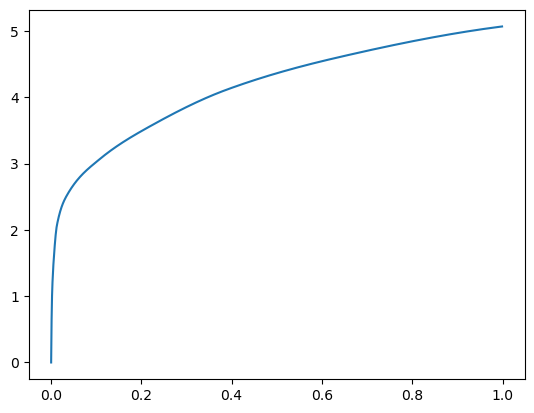

[0.00000000e+00 7.20024109e-04 2.02655792e-03 5.40828705e-03
 1.17635727e-02 3.60116959e-02 1.02959633e-01 2.15245247e-01
 3.66122246e-01 6.10783577e-01 1.00000000e+00] betas
[0.         0.46426406 0.47283068 0.51097073 0.52158471 0.52614621
 0.51008887 0.55225992 0.51242073 0.55226093 0.48331495] r
-22485.71539370743 score post


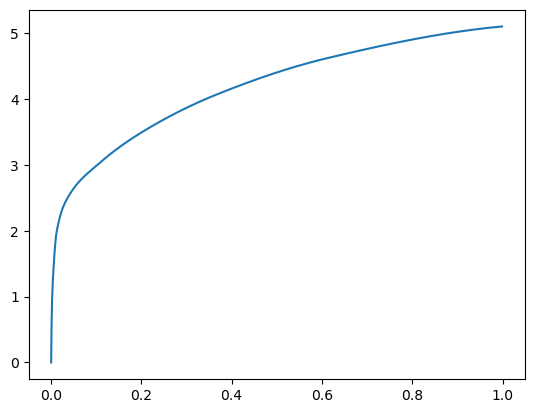

[0.00000000e+00 8.19206238e-04 2.41947174e-03 6.18457794e-03
 1.37434006e-02 4.09288406e-02 1.12652779e-01 2.19246864e-01
 3.71344566e-01 5.94597816e-01 1.00000000e+00] betas
[0.         0.56784709 0.52940757 0.52369072 0.49696461 0.4972985
 0.50756057 0.54521539 0.51609983 0.46659533 0.52350568] r
-22481.621781595804 score post


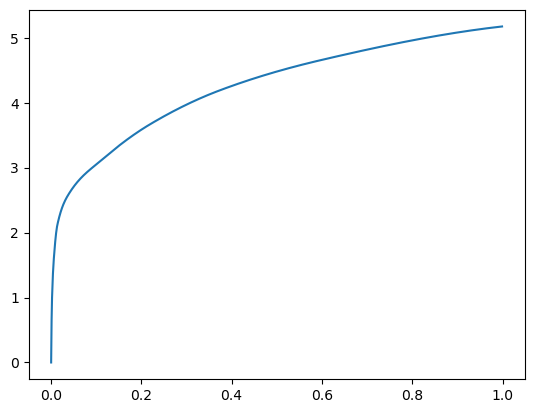

[0.00000000e+00 7.20024109e-04 2.14481354e-03 5.48458099e-03
 1.24902725e-02 3.83901596e-02 1.09576225e-01 2.08380699e-01
 3.54851723e-01 5.98326683e-01 1.00000000e+00] betas
[0.         0.5128847  0.4837295  0.47656727 0.50866554 0.55808504
 0.5211158  0.48107233 0.50823726 0.56546068 0.56487902] r
-22480.269231963164 score post


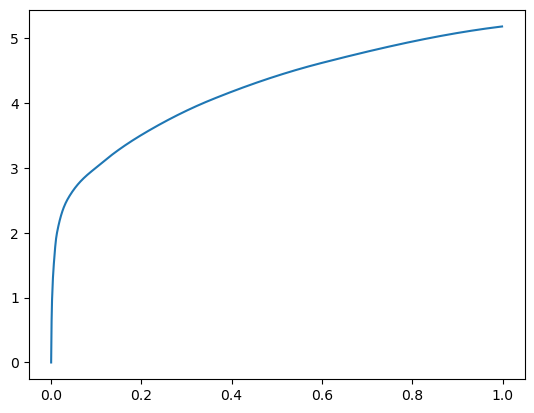

[0.00000000e+00 7.31468201e-04 2.33554840e-03 6.31427765e-03
 1.50728226e-02 4.28228378e-02 1.17735863e-01 2.29428291e-01
 3.88964653e-01 6.24709129e-01 1.00000000e+00] betas
[0.         0.55295061 0.49198561 0.51779887 0.57970389 0.46006069
 0.49301364 0.52489643 0.51086231 0.49133662 0.50571517] r
-22481.378721678564 score post


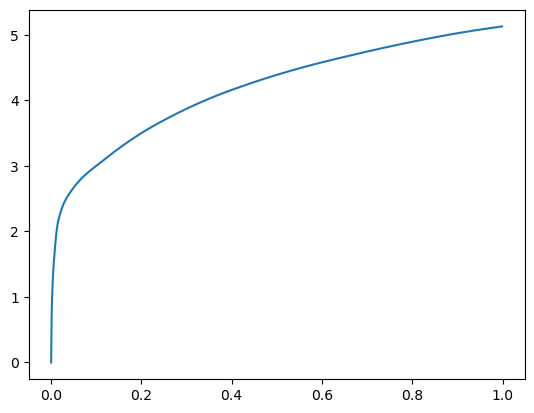

[0.00000000e+00 6.53266907e-04 2.23827362e-03 6.05297089e-03
 1.28507614e-02 3.90653610e-02 1.14359856e-01 2.21610069e-01
 3.77974510e-01 6.20448112e-01 1.00000000e+00] betas
[0.         0.45479383 0.5639345  0.54971266 0.47447241 0.50307039
 0.51623319 0.54610774 0.50218397 0.51879371 0.4812321 ] r
-22481.378721678564 score post


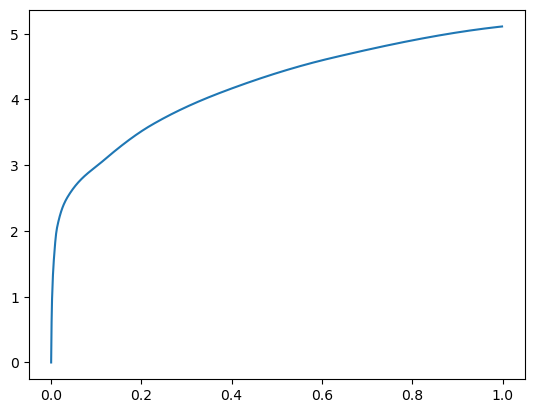

489574 steps_after


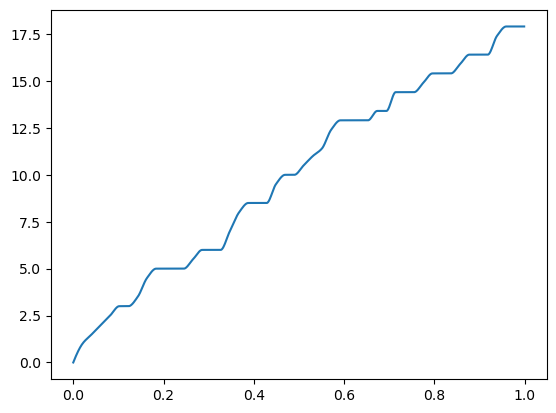

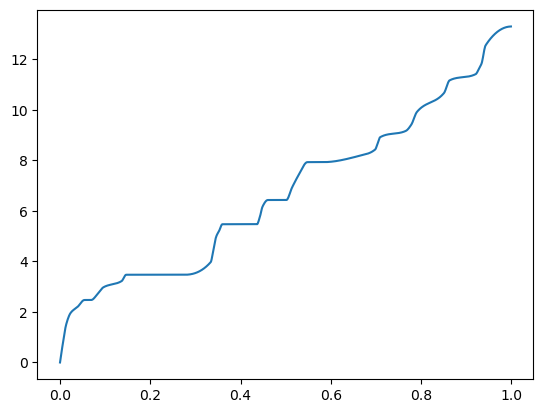

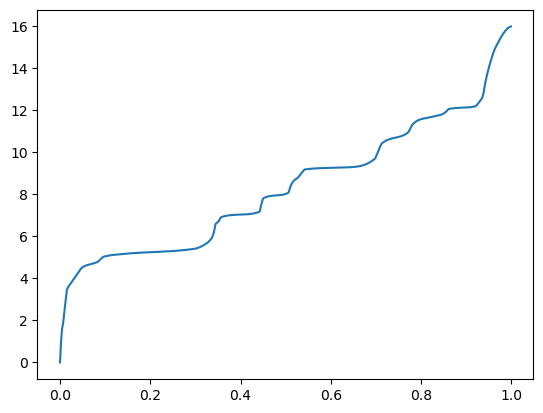

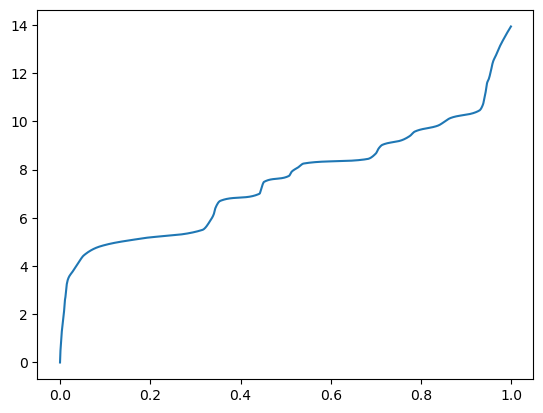

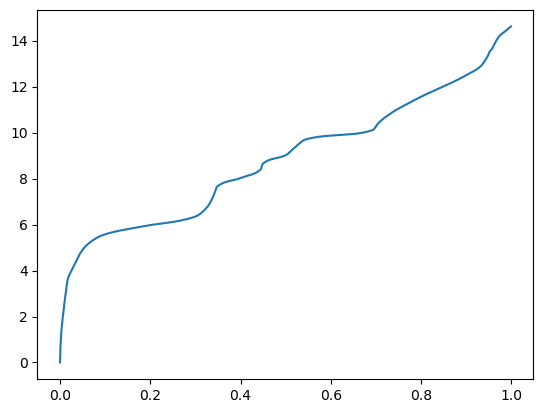

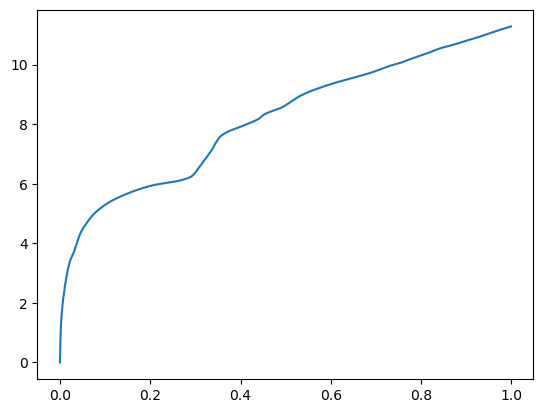

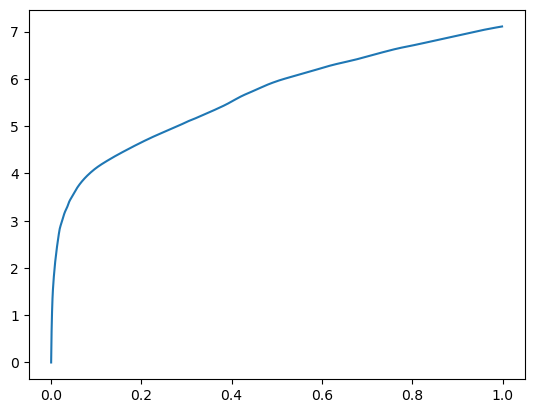

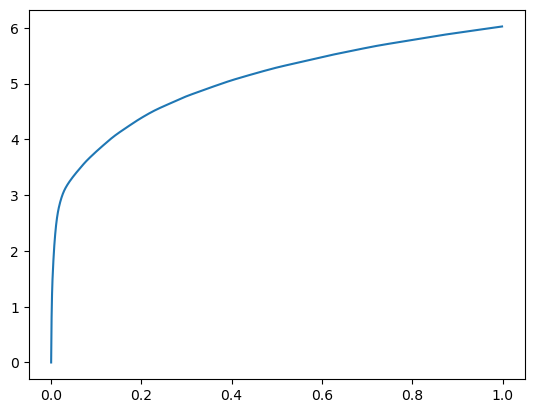

10855 steps
betas [0.00000000e+00 6.01768494e-04 1.59740448e-03 3.85570526e-03
 7.84969330e-03 1.60455704e-02 4.44898605e-02 1.07169151e-01
 1.99257851e-01 3.53253365e-01 6.00674629e-01 1.00000000e+00]
n_chains 12
[0.00000000e+00 6.01768494e-04 1.59740448e-03 3.85570526e-03
 7.84969330e-03 1.60455704e-02 4.44898605e-02 1.07169151e-01
 1.99257851e-01 3.53253365e-01 6.00674629e-01 1.00000000e+00] betas
[0.         0.         0.         0.00765514 0.03016339 0.
 0.         0.         0.         0.         0.40570733 0.72007399] r
-22480.269231963164 score post


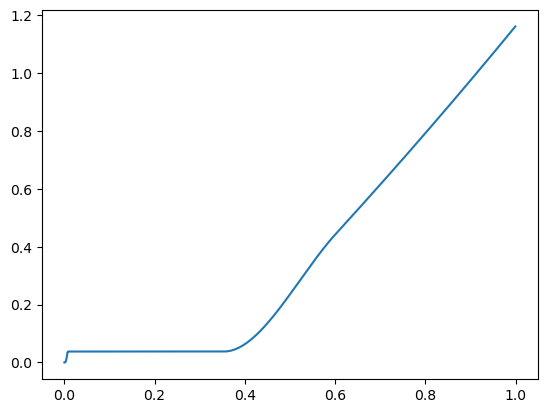

[0.         0.43204594 0.48847866 0.53732014 0.58919811 0.6502676
 0.71086597 0.77053547 0.82927608 0.88709354 0.94399929 1.        ] betas
[0.         0.99999901 0.13604727 0.1081937  0.10315863 0.11444681
 0.09872549 0.09232064 0.08099477 0.07378521 0.06943646 0.0617522 ] r
-22481.378721678564 score post


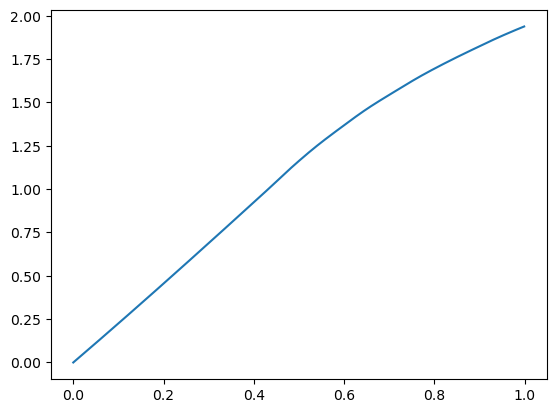

[0.         0.07838345 0.15557003 0.23177052 0.30717754 0.38195705
 0.45579243 0.53238392 0.62186146 0.72711468 0.85133266 1.        ] betas
[0.         0.99844627 0.42738132 0.34273259 0.28660178 0.24833408
 0.2208709  0.18288252 0.19208582 0.17828633 0.16787799 0.16053904] r
-22483.75060619476 score post


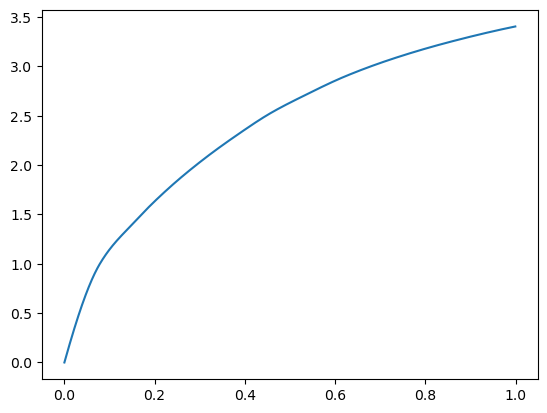

[0.         0.01970005 0.04191685 0.07008266 0.11695766 0.18113232
 0.25402164 0.33988094 0.43871403 0.56774235 0.73970509 1.        ] betas
[0.         0.99559584 0.38005808 0.2925269  0.32827755 0.34619315
 0.3091455  0.33902707 0.29708511 0.29366348 0.28448354 0.31209252] r
-22487.352486955915 score post


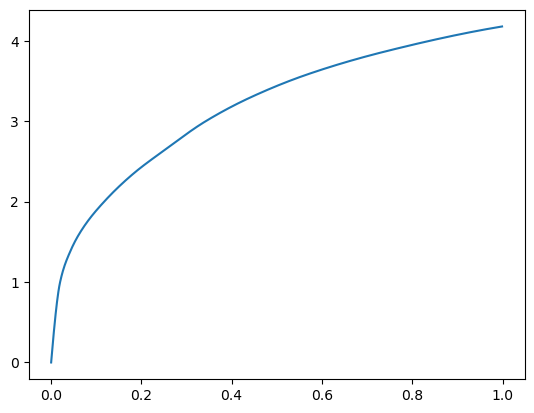

[0.         0.00599384 0.01315212 0.02614307 0.05420017 0.10146999
 0.16806698 0.25573635 0.35410786 0.4914732  0.69353008 1.        ] betas
[0.         0.96711563 0.57959974 0.37335179 0.35160945 0.35950402
 0.36555501 0.34647606 0.33774893 0.37584722 0.36682305 0.4078518 ] r
-22489.70621354963 score post


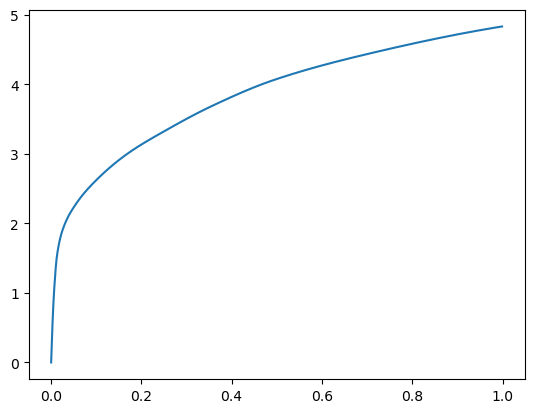

[0.         0.00234318 0.00523853 0.00961018 0.01897526 0.04654217
 0.1021204  0.1856432  0.30323696 0.4485445  0.67350101 1.        ] betas
[0.         0.91142054 0.50820784 0.42113178 0.48418385 0.43272106
 0.41183545 0.43991032 0.47872868 0.45131096 0.43372916 0.45766268] r
-22481.621781595804 score post


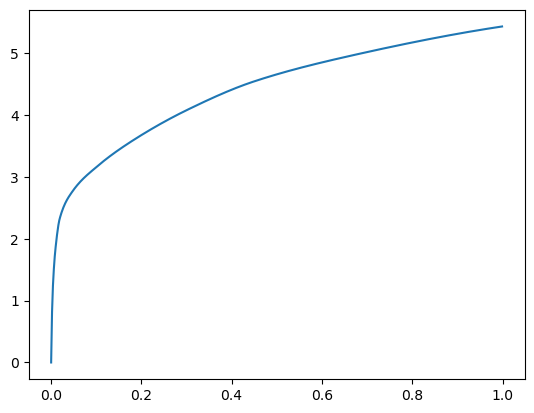

[0.         0.00109196 0.00266552 0.00573826 0.01160717 0.0252161
 0.06998539 0.15365314 0.26586056 0.41215229 0.65164471 1.        ] betas
[0.         0.66530924 0.52810779 0.48793508 0.52051031 0.50101107
 0.47477551 0.50343339 0.47656486 0.4471093  0.4837098  0.44483935] r
-22480.269231963164 score post


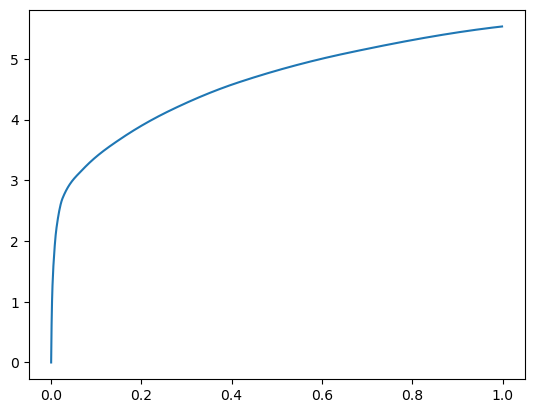

[0.00000000e+00 7.69615173e-04 1.98268890e-03 4.40692902e-03
 8.95404816e-03 1.84164047e-02 4.97808456e-02 1.22801781e-01
 2.30446815e-01 3.82357597e-01 6.16337776e-01 1.00000000e+00] betas
[0.         0.54370447 0.50301435 0.45610413 0.52041036 0.52259824
 0.44925964 0.49466242 0.50551411 0.47151301 0.54331274 0.44614364] r
-22482.458794922564 score post


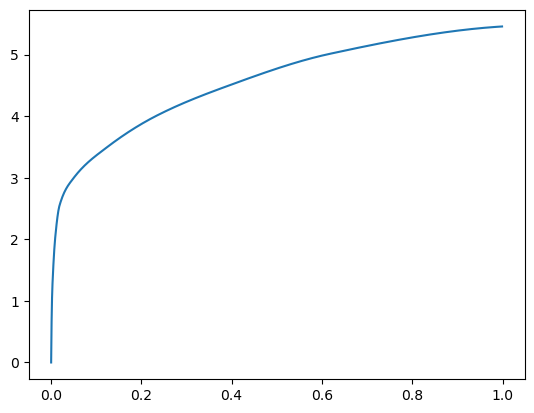

[0.00000000e+00 6.83784485e-04 1.79767609e-03 4.30583954e-03
 8.47721100e-03 1.64213181e-02 4.77991104e-02 1.19652748e-01
 2.23393440e-01 3.81394386e-01 5.87382317e-01 1.00000000e+00] betas
[0.         0.5372344  0.5299968  0.5021676  0.49857106 0.45448226
 0.49691829 0.43879167 0.49828031 0.58055172 0.48189131 0.59073972] r
-22485.70121138277 score post


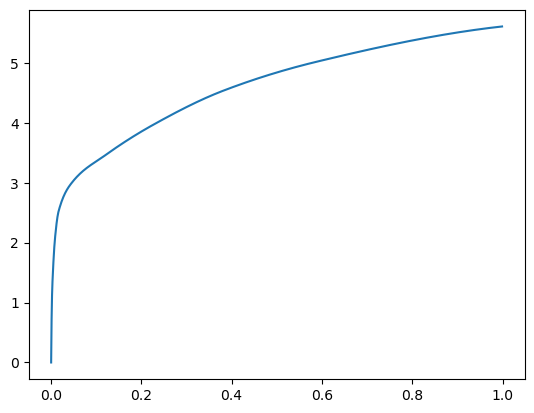

[0.00000000e+00 6.39915466e-04 1.65271759e-03 4.04834747e-03
 8.14151764e-03 1.74207687e-02 5.22890091e-02 1.40749931e-01
 2.53153801e-01 3.99985313e-01 6.32182121e-01 1.00000000e+00] betas
[0.         0.49508444 0.52531192 0.48421549 0.50902792 0.58425717
 0.55267429 0.56300138 0.47532351 0.47602177 0.52681408 0.51867567] r
-22480.269231963164 score post


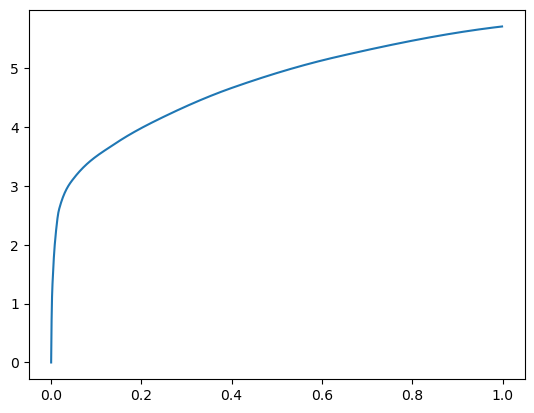

[0.00000000e+00 6.78062439e-04 1.71184540e-03 4.38976288e-03
 8.87203217e-03 1.73425674e-02 4.86001968e-02 1.24939919e-01
 2.43483543e-01 4.02663231e-01 6.31926537e-01 1.00000000e+00] betas
[0.         0.5215541  0.53342976 0.55371086 0.50224346 0.47126243
 0.50096146 0.48479373 0.52690223 0.52912404 0.49886747 0.4892976 ] r
-22480.269231963164 score post


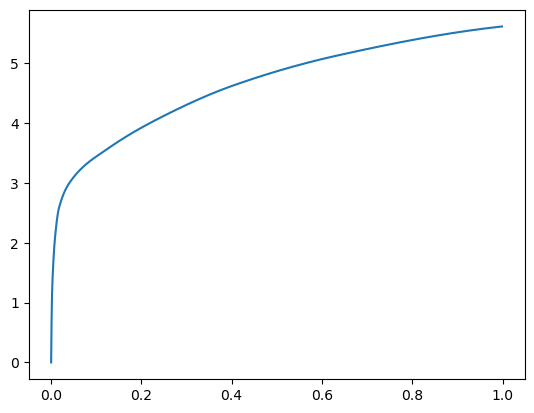

[0.00000000e+00 6.60896301e-04 1.61075592e-03 3.87668610e-03
 8.02898407e-03 1.63583755e-02 4.63495255e-02 1.25584602e-01
 2.40021706e-01 3.90830040e-01 6.19694710e-01 1.00000000e+00] betas
[0.         0.51544784 0.4509534  0.51249057 0.54318147 0.51385657
 0.47922736 0.52742561 0.50115608 0.47582726 0.50208054 0.55911636] r
-22480.269231963164 score post


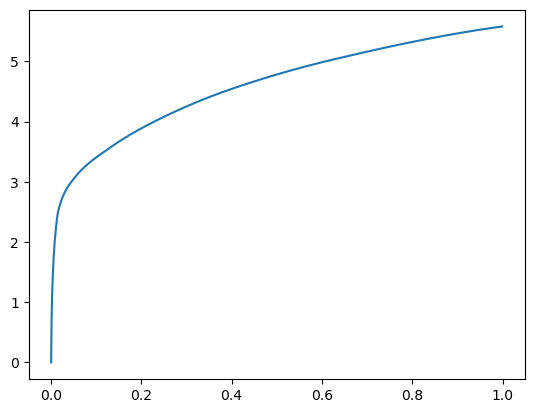

[0.00000000e+00 6.47544861e-04 1.76525116e-03 4.13417816e-03
 8.11290741e-03 1.63850784e-02 4.92925644e-02 1.27236366e-01
 2.44095802e-01 4.08822060e-01 6.48869514e-01 1.00000000e+00] betas
[0.         0.46628708 0.55687561 0.48739453 0.52014823 0.46381614
 0.52397129 0.50570785 0.5010382  0.50917552 0.5243655  0.4591463 ] r
-22483.343010040644 score post


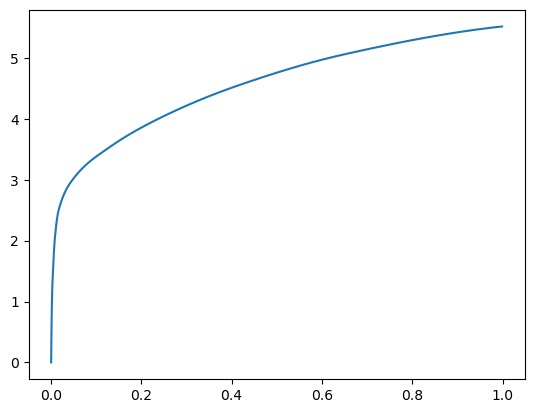

[0.00000000e+00 7.06672668e-04 1.70421600e-03 4.09984589e-03
 7.83443451e-03 1.68771744e-02 4.84018326e-02 1.24781609e-01
 2.40740776e-01 4.01253700e-01 6.24264717e-01 1.00000000e+00] betas
[0.         0.53582916 0.42758582 0.50006525 0.45506015 0.54181491
 0.51971336 0.52453953 0.53428566 0.51661149 0.47740903 0.50728029] r
-22484.416026206305 score post


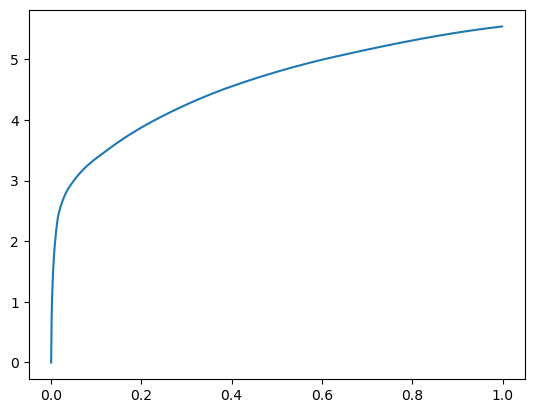

[0.00000000e+00 6.51359558e-04 1.85680389e-03 4.40692902e-03
 9.00745392e-03 1.89695358e-02 5.25941849e-02 1.28558159e-01
 2.38224983e-01 3.92664909e-01 6.26414299e-01 1.00000000e+00] betas
[0.         0.53857031 0.55111612 0.51449549 0.51056763 0.47874054
 0.51492779 0.50592552 0.5160468  0.51144884 0.49172949 0.46469403] r
-22488.737042601548 score post


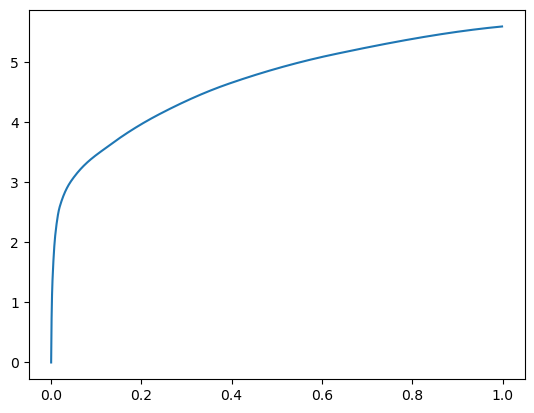

[0.00000000e+00 6.03675842e-04 1.63555145e-03 3.89766693e-03
 8.01944733e-03 1.73063278e-02 4.71277237e-02 1.19114876e-01
 2.23567009e-01 3.70118141e-01 5.99652290e-01 1.00000000e+00] betas
[0.         0.49348544 0.50875872 0.50784508 0.47612935 0.54889277
 0.47365498 0.4931847  0.48101269 0.5183008  0.48556131 0.55998514] r
-22487.540172434772 score post


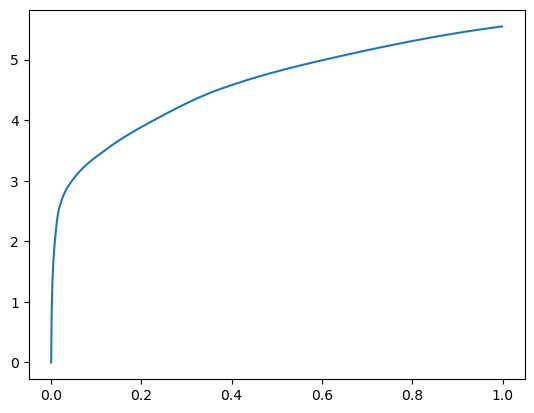

[0.00000000e+00 6.20841980e-04 1.65462494e-03 3.91483307e-03
 8.39900970e-03 1.68428421e-02 4.88023758e-02 1.24167442e-01
 2.36289024e-01 3.84085655e-01 6.32431984e-01 1.00000000e+00] betas
[0.         0.51784643 0.53633902 0.50259723 0.51936306 0.51754411
 0.4988441  0.50729664 0.5154414  0.47515009 0.46486018 0.47840574] r
-22486.6142498706 score post


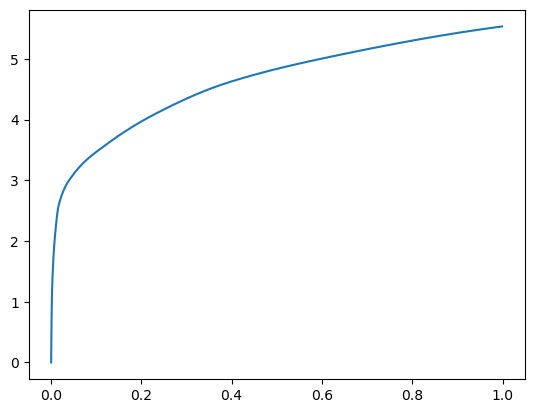

[0.00000000e+00 5.97953796e-04 1.52111053e-03 3.62110138e-03
 7.66468048e-03 1.47962570e-02 4.14113998e-02 1.09784126e-01
 2.13311195e-01 3.59704018e-01 6.16625786e-01 1.00000000e+00] betas
[0.         0.46702275 0.49223539 0.49970225 0.50918385 0.49318261
 0.54719351 0.53533491 0.51566436 0.52116928 0.55076536 0.47317208] r
-22480.269231963164 score post


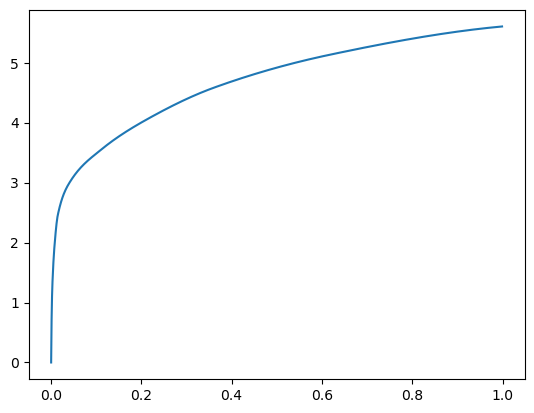

[0.00000000e+00 6.64710999e-04 1.70040131e-03 4.04453278e-03
 8.43906403e-03 1.73788071e-02 4.55522537e-02 1.13493919e-01
 2.17276573e-01 3.61502647e-01 5.94449043e-01 1.00000000e+00] betas
[0.         0.56516044 0.54059317 0.49623084 0.51396874 0.52402242
 0.53354239 0.48620199 0.4557475  0.51402593 0.56770415 0.55764979] r
-22486.5745121497 score post


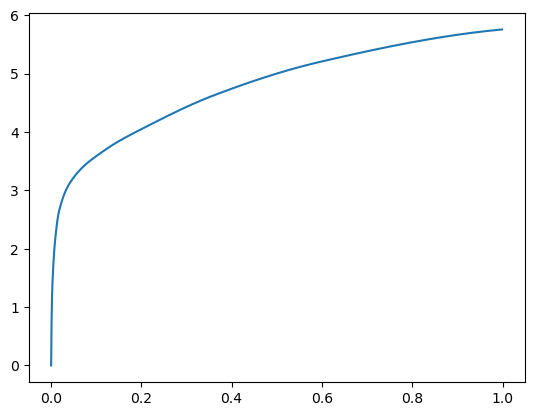

[0.00000000e+00 6.03675842e-04 1.53446198e-03 3.83663177e-03
 8.15868378e-03 1.66673660e-02 4.25462723e-02 1.13938332e-01
 2.35039711e-01 3.88815880e-01 6.13667488e-01 1.00000000e+00] betas
[0.         0.51020798 0.48535177 0.54931138 0.48471295 0.54753582
 0.47417039 0.47406094 0.57431315 0.4703139  0.51454111 0.51348014] r
-22481.990460408004 score post


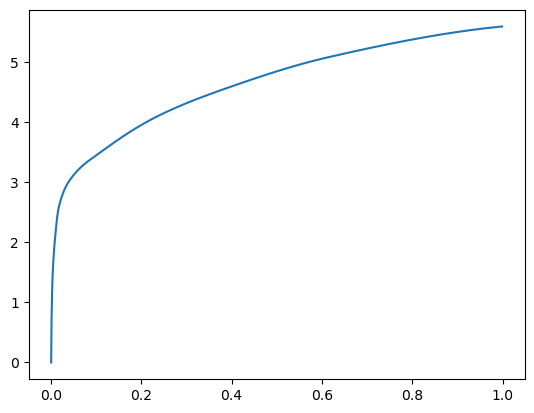

[0.00000000e+00 6.01768494e-04 1.59931183e-03 3.72409821e-03
 8.23116302e-03 1.57670975e-02 4.27522659e-02 1.20581627e-01
 2.27604866e-01 3.92682076e-01 6.16324425e-01 1.00000000e+00] betas
[0.         0.52327571 0.5339011  0.50137037 0.54670622 0.45398441
 0.51494321 0.52222424 0.5454536  0.53152588 0.50157889 0.4819236 ] r
-22484.348661750126 score post


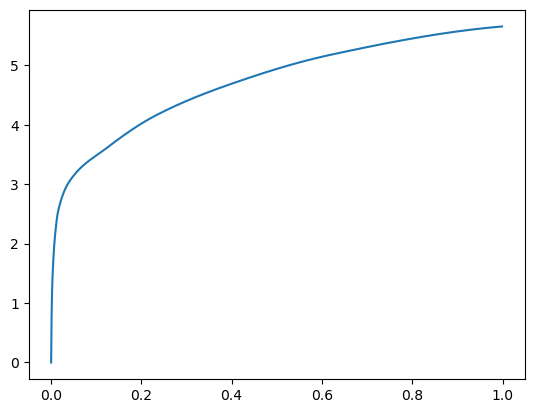

[0.00000000e+00 5.88417053e-04 1.52111053e-03 3.63063812e-03
 7.67612457e-03 1.61466599e-02 4.38203812e-02 1.21169090e-01
 2.20833778e-01 3.76019478e-01 5.97456932e-01 1.00000000e+00] betas
[0.         0.45858391 0.51483355 0.49989372 0.48853091 0.56899721
 0.52440638 0.49875376 0.50069009 0.53664286 0.49899885 0.5286721 ] r
-22480.269231963164 score post


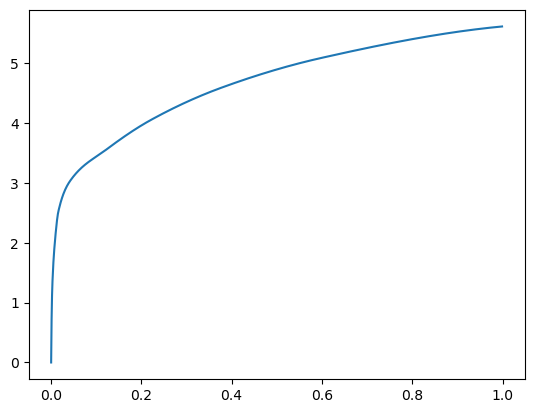

[0.00000000e+00 6.68525696e-04 1.66225433e-03 3.99875641e-03
 8.60118866e-03 1.68657303e-02 4.47549820e-02 1.25008583e-01
 2.28571892e-01 3.78207207e-01 6.07970238e-01 1.00000000e+00] betas
[0.         0.46235916 0.48057229 0.49933196 0.52346051 0.47000476
 0.48804352 0.54419608 0.47768541 0.56550465 0.46919354 0.57335546] r
-22480.269231963164 score post


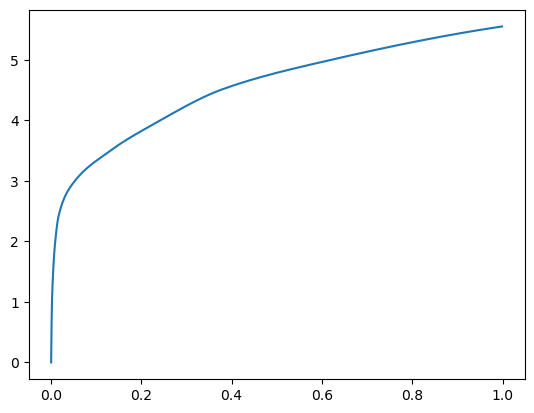

[0.00000000e+00 7.42912292e-04 1.88541412e-03 4.48513031e-03
 9.30118561e-03 2.00681686e-02 5.56039810e-02 1.37330055e-01
 2.50784874e-01 3.90557289e-01 6.47988319e-01 1.00000000e+00] betas
[0.         0.5615802  0.48855619 0.51470842 0.51682049 0.491187
 0.44350138 0.48260659 0.51814897 0.53333884 0.52234599 0.4362326 ] r
-22480.269231963164 score post


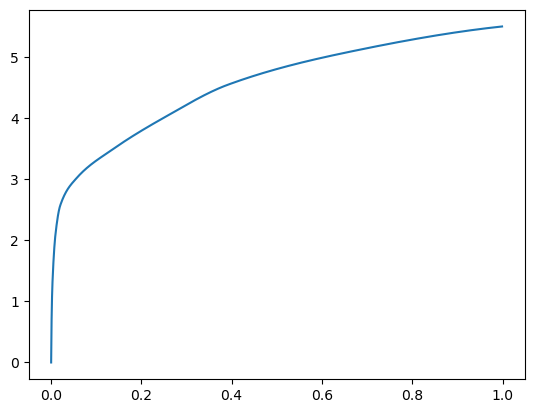

[0.00000000e+00 6.39915466e-04 1.72710419e-03 4.06360626e-03
 8.27693939e-03 1.75828934e-02 5.42383194e-02 1.38640404e-01
 2.48259544e-01 3.75784874e-01 6.07655525e-01 1.00000000e+00] betas
[0.         0.48412592 0.5393465  0.4896947  0.5125069  0.53510846
 0.5204115  0.52787763 0.47795292 0.43470653 0.54931987 0.51143559] r
-22481.990460408004 score post


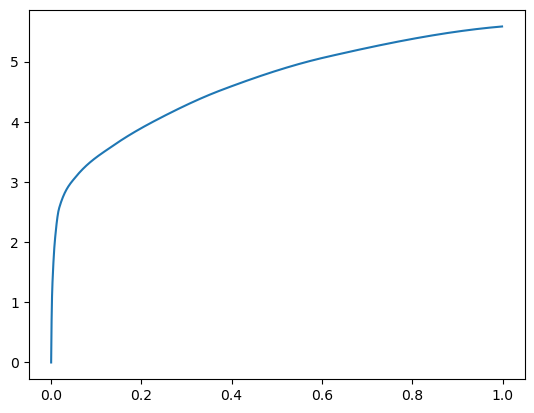

[0.00000000e+00 6.78062439e-04 1.70040131e-03 4.12273407e-03
 8.33034515e-03 1.67837143e-02 5.02405167e-02 1.27572060e-01
 2.41244316e-01 3.91995430e-01 6.09940529e-01 1.00000000e+00] betas
[0.         0.47553324 0.49789747 0.53283855 0.52101952 0.46610093
 0.56442787 0.52214761 0.50805519 0.49684846 0.47123317 0.47843412] r
-22485.372539201246 score post


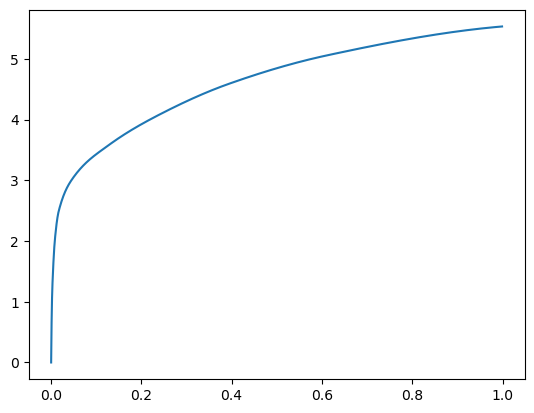

[0.00000000e+00 7.25746155e-04 1.80530548e-03 4.14180756e-03
 8.15105438e-03 1.75676346e-02 4.65040207e-02 1.16774559e-01
 2.25003242e-01 3.71397972e-01 5.94965935e-01 1.00000000e+00] betas
[0.         0.54747427 0.52072151 0.49487707 0.49528416 0.57566605
 0.48623171 0.47729128 0.51114951 0.47883817 0.4875859  0.57561454] r
-22483.215759872455 score post


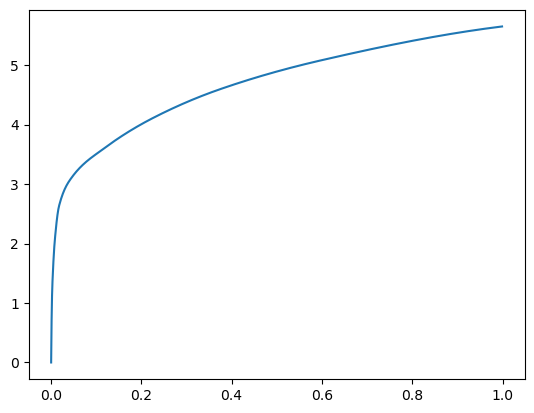

[0.00000000e+00 6.70433044e-04 1.68323517e-03 4.00447845e-03
 8.10909271e-03 1.57690048e-02 4.28667068e-02 1.16486549e-01
 2.25241661e-01 3.85048866e-01 6.30558968e-01 1.00000000e+00] betas
[0.         0.55589443 0.43886277 0.53239253 0.47933263 0.48502629
 0.5158399  0.54203282 0.54455968 0.54697879 0.50201544 0.43787876] r
-22480.269231963164 score post


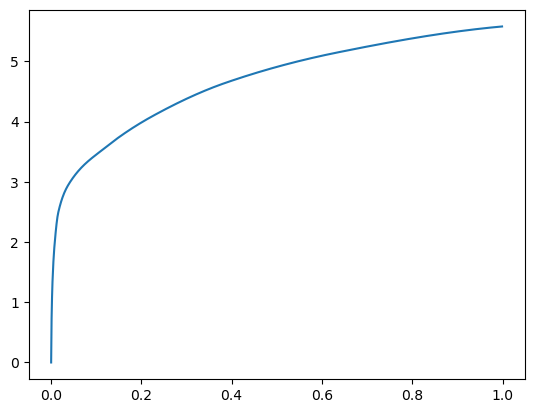

[0.00000000e+00 5.92231750e-04 1.74808502e-03 3.97205353e-03
 8.38184357e-03 1.72033310e-02 4.61759567e-02 1.16826057e-01
 2.16816902e-01 3.57968330e-01 5.87470055e-01 1.00000000e+00] betas
[0.         0.49516997 0.52463366 0.4854688  0.54820888 0.47283726
 0.50015217 0.52887486 0.48237655 0.46733564 0.50815518 0.51532225] r
-22480.269231963164 score post


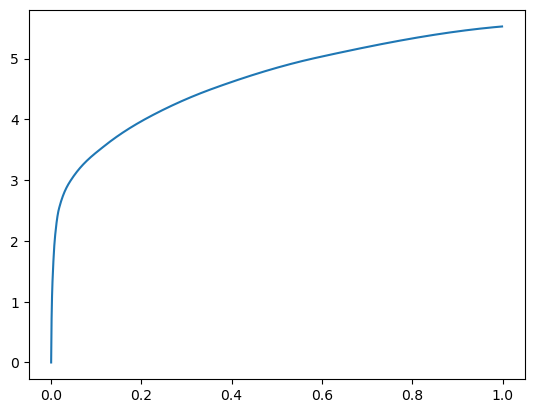

[0.00000000e+00 6.03675842e-04 1.70040131e-03 3.98731232e-03
 7.87067413e-03 1.67589188e-02 4.51917648e-02 1.10539436e-01
 2.12569237e-01 3.64781380e-01 5.95242500e-01 1.00000000e+00] betas
[0.         0.51906938 0.56197852 0.45502926 0.46640075 0.53294569
 0.5303021  0.47157692 0.50780381 0.52605408 0.49531888 0.55762967] r
-22485.420924260285 score post


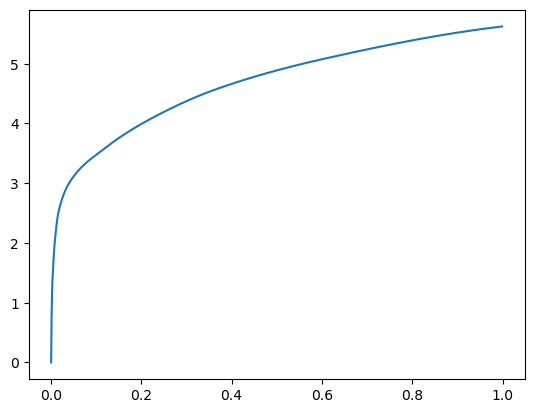

[0.00000000e+00 5.92231750e-04 1.53064728e-03 3.97205353e-03
 8.38756561e-03 1.74379349e-02 4.53710556e-02 1.17611885e-01
 2.23620415e-01 3.76198769e-01 6.22496605e-01 1.00000000e+00] betas
[0.         0.43831557 0.54429195 0.52364538 0.48859184 0.53468641
 0.57441366 0.489582   0.55250825 0.47157047 0.48154619 0.52051771] r
-22484.252724367707 score post


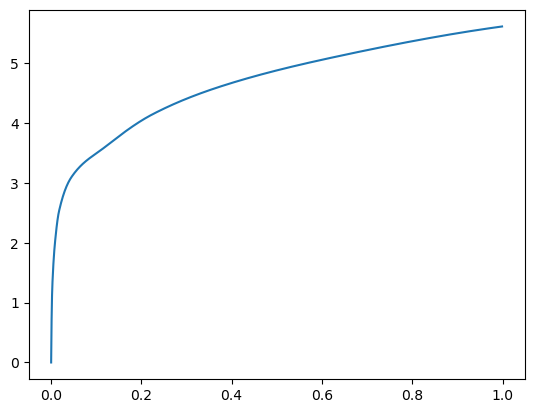

[0.00000000e+00 7.00950623e-04 1.65081024e-03 4.14943695e-03
 9.00554657e-03 1.81951523e-02 4.20961380e-02 1.14638329e-01
 2.09481239e-01 3.68201256e-01 6.28394127e-01 1.00000000e+00] betas
[0.         0.54897245 0.48119539 0.48484864 0.55402459 0.50866952
 0.44440562 0.54454387 0.45936066 0.53243194 0.49946793 0.43036864] r
-22481.378721678564 score post


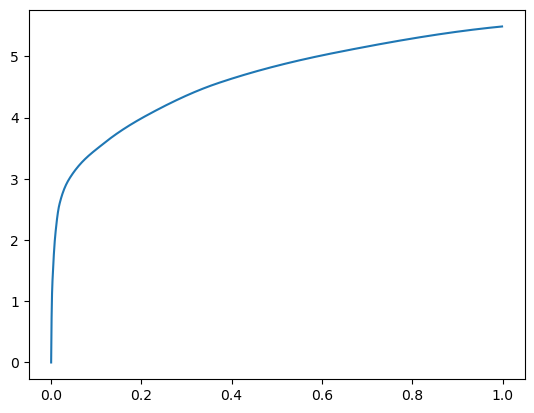

[0.00000000e+00 6.22749329e-04 1.55353546e-03 4.02545929e-03
 8.13579559e-03 1.59425735e-02 3.96871567e-02 1.02000237e-01
 2.01006889e-01 3.42627525e-01 5.83481789e-01 1.00000000e+00] betas
[0.         0.476677   0.48383634 0.50308041 0.53441017 0.45086136
 0.42326879 0.49770095 0.52144006 0.53001146 0.50201624 0.55064737] r
-22480.269231963164 score post


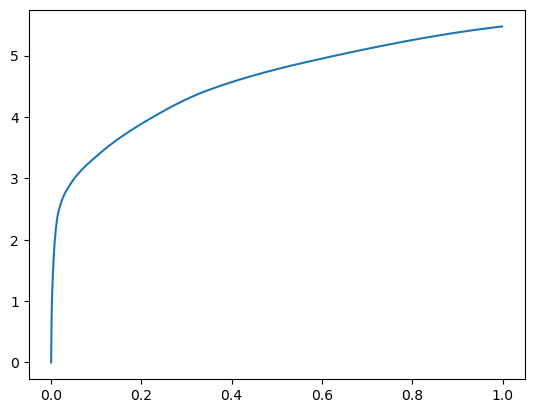

[0.00000000e+00 6.57081604e-04 1.66797638e-03 4.20856476e-03
 8.04805756e-03 1.73025131e-02 5.02462387e-02 1.20385170e-01
 2.21592903e-01 3.64146233e-01 6.15881920e-01 1.00000000e+00] betas
[0.         0.52391238 0.50496189 0.50333532 0.45992068 0.55312302
 0.49025907 0.48469529 0.52154568 0.45010045 0.50183374 0.53490339] r
-22481.621781595804 score post


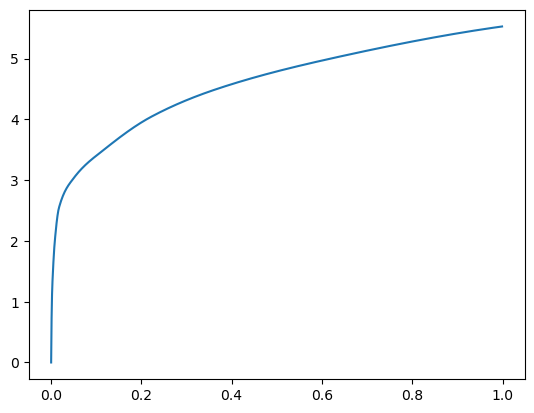

[0.00000000e+00 6.22749329e-04 1.59358978e-03 4.04644012e-03
 8.26740265e-03 1.62744522e-02 4.82091904e-02 1.20047569e-01
 2.16416359e-01 3.76954079e-01 6.35447502e-01 1.00000000e+00] betas
[0.         0.51082174 0.49603646 0.52919717 0.47551834 0.48289668
 0.50528273 0.51133534 0.48640601 0.53394586 0.56143674 0.44308603] r
-22481.990460408004 score post


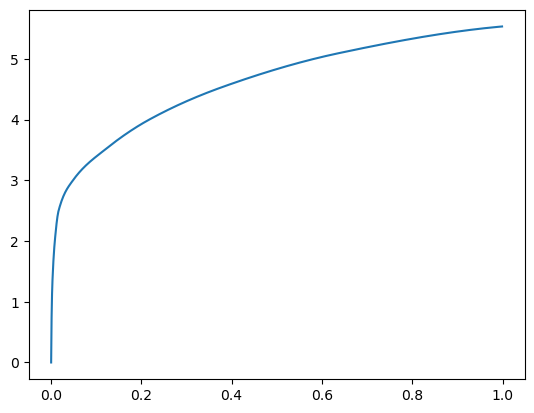

[0.00000000e+00 6.11305237e-04 1.59168243e-03 3.87668610e-03
 8.28647614e-03 1.70583725e-02 5.01604080e-02 1.22035027e-01
 2.23505974e-01 3.76200676e-01 5.99543571e-01 1.00000000e+00] betas
[0.         0.47633279 0.47221118 0.49442464 0.55772234 0.48479542
 0.49771097 0.48069185 0.46372106 0.51212178 0.49732054 0.55261176] r
-22482.458794922564 score post


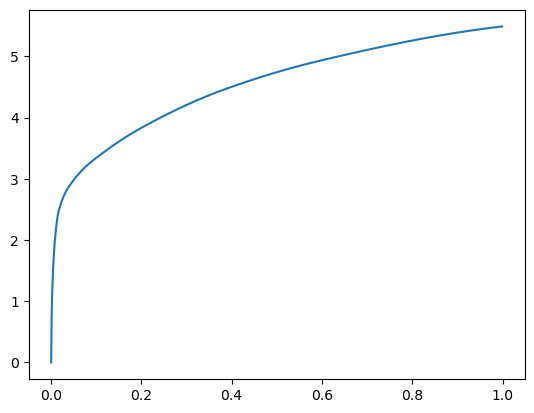

[0.00000000e+00 6.49452209e-04 1.75380707e-03 4.21237946e-03
 8.23116302e-03 1.74303055e-02 5.13181686e-02 1.27478600e-01
 2.40328789e-01 3.95615578e-01 6.30543709e-01 1.00000000e+00] betas
[0.         0.51715438 0.51647983 0.49332157 0.46074533 0.47884595
 0.53074418 0.46288916 0.50453407 0.51122272 0.5471196  0.45347954] r
-22484.348661750126 score post


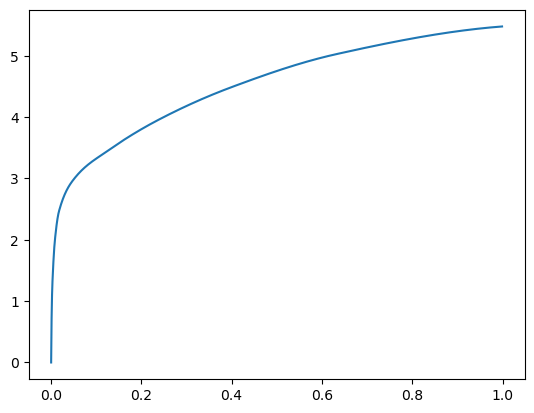

[0.00000000e+00 6.18934631e-04 1.63364410e-03 3.99112701e-03
 8.28075409e-03 1.82924271e-02 5.02367020e-02 1.32294655e-01
 2.45116234e-01 3.97379875e-01 6.05090141e-01 1.00000000e+00] betas
[0.         0.5150769  0.55243516 0.48985179 0.5315795  0.52299675
 0.47146603 0.47639772 0.5183799  0.51193867 0.44459391 0.5259773 ] r
-22481.621781595804 score post


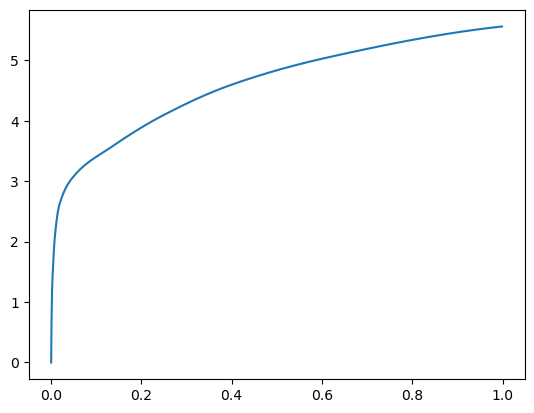

[0.00000000e+00 6.05583191e-04 1.47914886e-03 3.73363495e-03
 7.51781464e-03 1.57079697e-02 4.47759628e-02 1.28121376e-01
 2.36546516e-01 3.82557869e-01 6.17289543e-01 1.00000000e+00] betas
[0.         0.43202642 0.4328175  0.51145564 0.50279738 0.54716379
 0.54423505 0.61730149 0.4627885  0.4601304  0.54959877 0.50738529] r
-22480.269231963164 score post


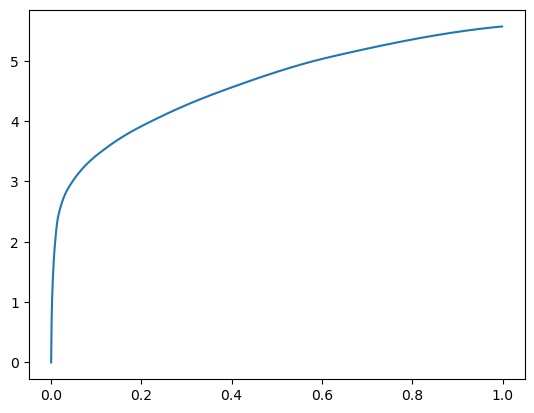

[0.00000000e+00 7.31468201e-04 1.97315216e-03 4.60720062e-03
 9.15622711e-03 1.91545486e-02 5.08260727e-02 1.19969368e-01
 2.36176491e-01 3.99064064e-01 6.18000984e-01 1.00000000e+00] betas
[0.         0.54555293 0.50107397 0.52342692 0.52656009 0.49665664
 0.43764392 0.47268622 0.55023493 0.56624674 0.4546908  0.4725423 ] r
-22480.269231963164 score post


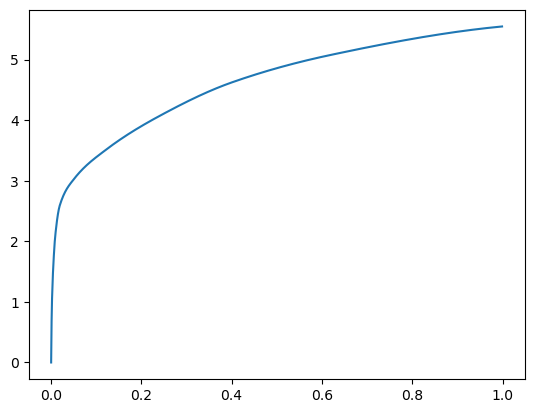

[0.00000000e+00 6.58988953e-04 1.84154510e-03 4.23336029e-03
 8.20446014e-03 1.67970657e-02 5.02901077e-02 1.24674797e-01
 2.31394768e-01 3.70232582e-01 5.98460197e-01 1.00000000e+00] betas
[0.         0.43972855 0.53112527 0.52131934 0.48187021 0.52659338
 0.52336754 0.51047826 0.48134761 0.4810975  0.48963206 0.49316892] r
-22481.621781595804 score post


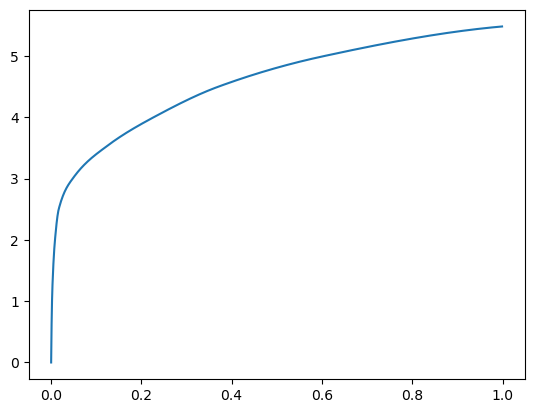

[0.00000000e+00 7.67707825e-04 1.92546844e-03 4.24861908e-03
 8.42380524e-03 1.64670944e-02 4.67710495e-02 1.16030693e-01
 2.23662376e-01 3.65298271e-01 5.95360756e-01 1.00000000e+00] betas
[0.         0.5847499  0.52509322 0.44419356 0.4879978  0.46453155
 0.51126767 0.48801392 0.51602249 0.48824479 0.55572841 0.53965863] r
-22484.25291812412 score post


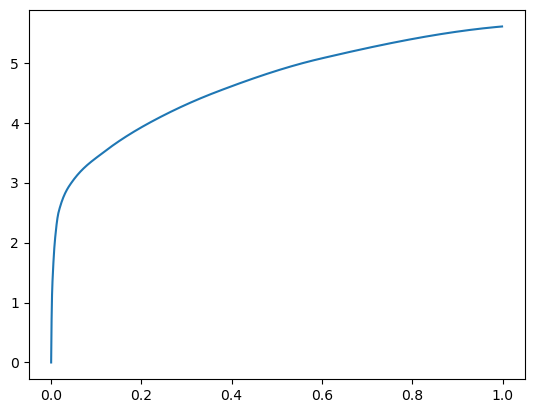

[0.00000000e+00 6.45637512e-04 1.65081024e-03 4.07886505e-03
 8.37802887e-03 1.79281235e-02 5.06677628e-02 1.26851082e-01
 2.37444878e-01 3.92077446e-01 6.12469673e-01 1.00000000e+00] betas
[0.         0.53091568 0.51190138 0.51864479 0.52233488 0.56126955
 0.60078874 0.48928749 0.50019127 0.53131805 0.47358828 0.593006  ] r
-22481.378721678564 score post


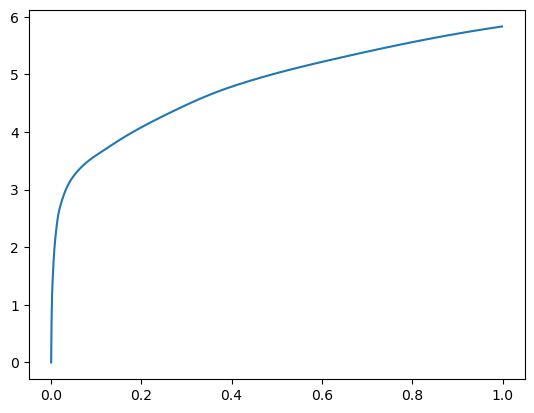

[0.00000000e+00 6.43730164e-04 1.70803070e-03 4.26578522e-03
 8.83388519e-03 1.81360245e-02 4.48312759e-02 1.22481346e-01
 2.39232063e-01 3.94324303e-01 6.47332191e-01 1.00000000e+00] betas
[0.         0.5135737  0.53473536 0.5114182  0.49298735 0.50139994
 0.47496651 0.5275909  0.52733328 0.56576941 0.53084814 0.46252259] r
-22481.621781595804 score post


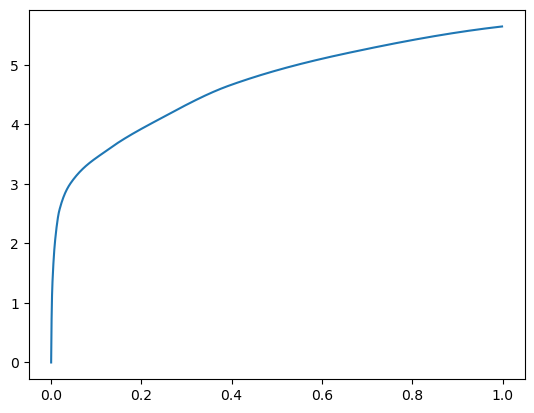

[0.00000000e+00 6.43730164e-04 1.63936615e-03 4.12273407e-03
 8.82434845e-03 1.85155869e-02 4.96225357e-02 1.28832817e-01
 2.44183540e-01 3.82773399e-01 6.17154121e-01 1.00000000e+00] betas
[0.         0.51570044 0.49570797 0.50081399 0.54284245 0.51972699
 0.48163813 0.50256439 0.50975082 0.45616314 0.50977961 0.55046937] r
-22480.269231963164 score post


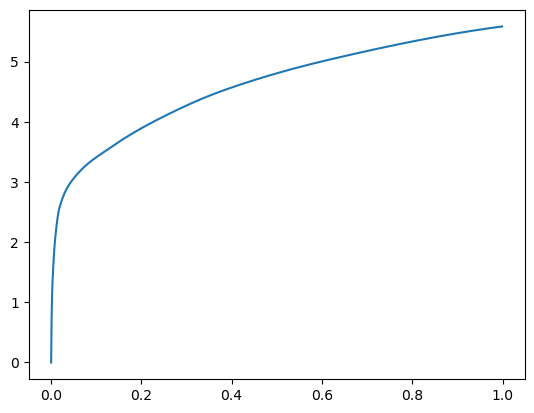

[0.00000000e+00 6.30378723e-04 1.65271759e-03 4.19521332e-03
 8.51917267e-03 1.73273087e-02 4.85849380e-02 1.27919197e-01
 2.42388725e-01 3.99827003e-01 6.41604424e-01 1.00000000e+00] betas
[0.         0.48325117 0.54563891 0.56494085 0.57617879 0.52047305
 0.49041978 0.50189647 0.47468142 0.48750867 0.53549633 0.5279923 ] r
-22484.25291812412 score post


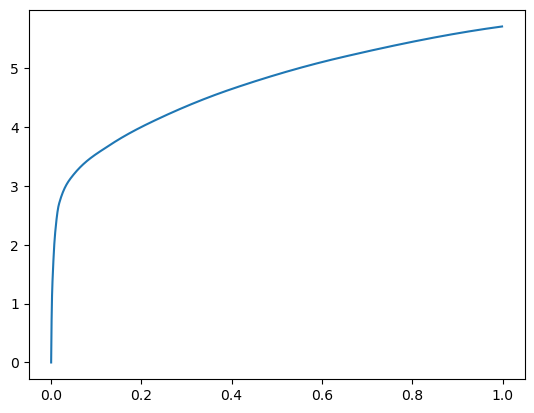

[0.00000000e+00 6.85691833e-04 1.67942047e-03 3.97777557e-03
 7.55786896e-03 1.47943497e-02 4.18004990e-02 1.17909431e-01
 2.40750313e-01 4.09674644e-01 6.46655083e-01 1.00000000e+00] betas
[0.         0.5127081  0.48949107 0.47885099 0.44385545 0.51578713
 0.5452952  0.52638169 0.54479814 0.48248975 0.48703754 0.45985915] r
-22481.990460408004 score post


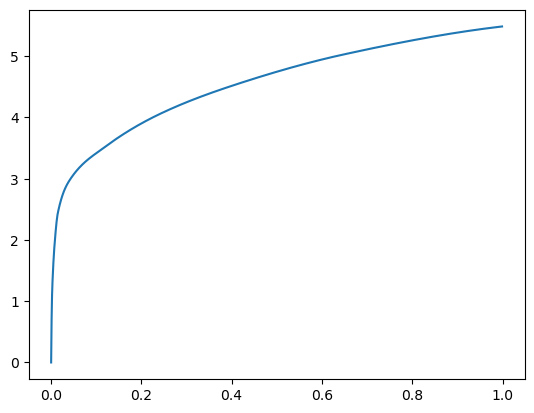

[0.00000000e+00 6.62803650e-04 1.66416168e-03 4.07505035e-03
 8.31890106e-03 1.63564682e-02 4.24013138e-02 1.14058495e-01
 2.22331047e-01 3.88945580e-01 6.23320580e-01 1.00000000e+00] betas
[0.         0.51889499 0.49712722 0.53805108 0.51883853 0.43831796
 0.42614414 0.53340124 0.55937759 0.55162707 0.47236902 0.48007285] r
-22483.343010040644 score post


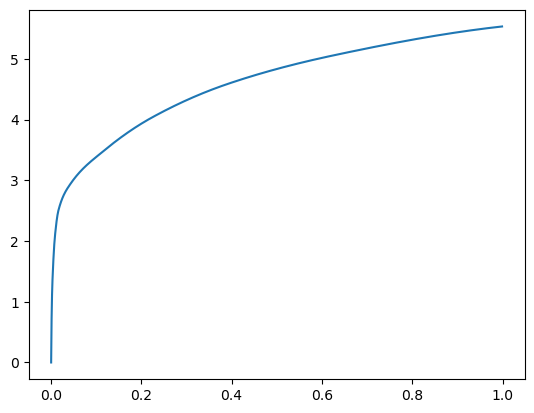

[0.00000000e+00 6.38008118e-04 1.63364410e-03 3.80420685e-03
 7.61699677e-03 1.65128708e-02 5.03110886e-02 1.22418404e-01
 2.21051216e-01 3.68519783e-01 6.09007835e-01 1.00000000e+00] betas
[0.         0.48283142 0.48344446 0.48094324 0.46952623 0.51989855
 0.52815564 0.47024091 0.46881136 0.53630214 0.5397816  0.53727255] r
-22481.621781595804 score post


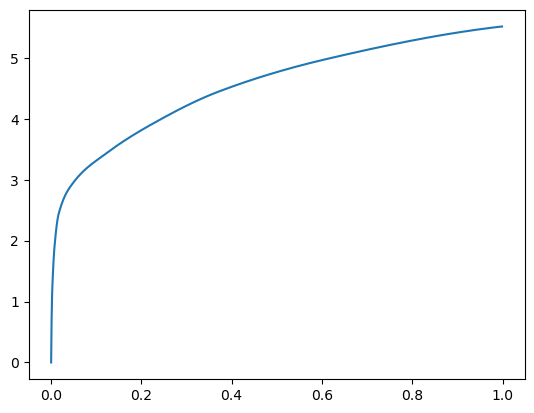

[0.00000000e+00 6.68525696e-04 1.75189972e-03 4.16660309e-03
 8.72516632e-03 1.92136765e-02 5.50851822e-02 1.36456490e-01
 2.47515678e-01 3.95339012e-01 6.29679680e-01 1.00000000e+00] betas
[0.         0.51890954 0.54850755 0.49111832 0.53044779 0.5361037
 0.55639964 0.53832006 0.52945248 0.54704724 0.53038921 0.45951012] r
-22483.2822716802 score post


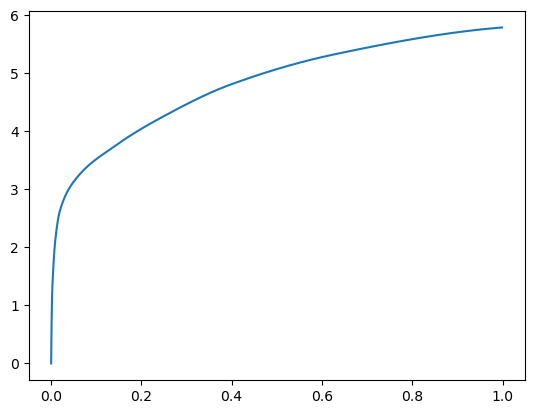

[0.00000000e+00 6.79969788e-04 1.70421600e-03 4.29630280e-03
 8.92734528e-03 1.94044113e-02 5.25102615e-02 1.29618645e-01
 2.37780571e-01 3.74760628e-01 5.91546059e-01 1.00000000e+00] betas
[0.         0.49786692 0.50029489 0.54686573 0.51169948 0.55655978
 0.58288563 0.52571435 0.46684672 0.46595276 0.49812555 0.4959526 ] r
-22484.348467993714 score post


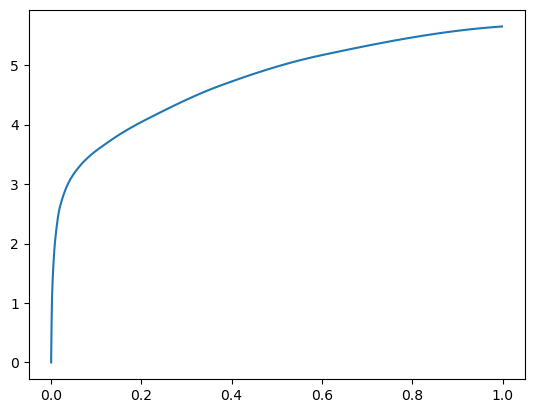

[0.00000000e+00 7.06672668e-04 1.79767609e-03 4.26578522e-03
 8.89301300e-03 1.79967880e-02 4.26759720e-02 1.05813026e-01
 2.16769218e-01 3.63196373e-01 5.81088066e-01 1.00000000e+00] betas
[0.         0.56914466 0.49514764 0.48636721 0.53208026 0.47130223
 0.40444542 0.45876825 0.57675294 0.53227942 0.48771191 0.54576549] r
-22480.269231963164 score post


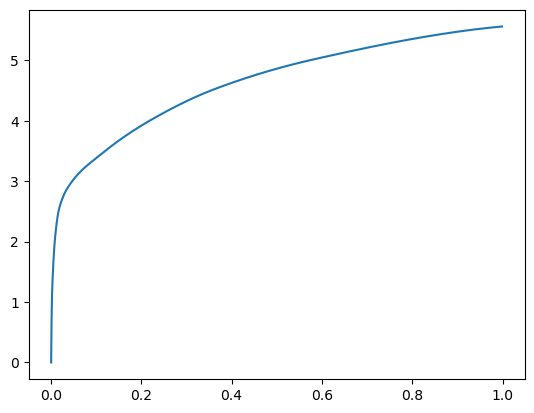

[0.00000000e+00 6.05583191e-04 1.62982941e-03 4.03690338e-03
 8.14723969e-03 1.70907974e-02 5.00612259e-02 1.26046181e-01
 2.28350639e-01 3.71294975e-01 6.05040550e-01 1.00000000e+00] betas
[0.         0.48665663 0.52902366 0.49987224 0.51858731 0.51582882
 0.51113297 0.50162186 0.53082059 0.50195347 0.51462078 0.53055587] r
-22486.539674870928 score post


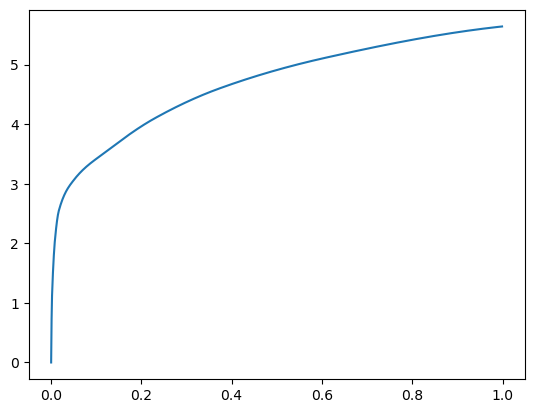

[0.00000000e+00 6.45637512e-04 1.66225433e-03 4.17995453e-03
 8.35323334e-03 1.76057816e-02 5.16786575e-02 1.30644798e-01
 2.30425835e-01 3.78451347e-01 6.15498543e-01 1.00000000e+00] betas
[0.         0.52926731 0.50661942 0.48214063 0.48346012 0.52817101
 0.50935157 0.51015872 0.47021477 0.48621126 0.52632373 0.51797044] r
-22483.343010040644 score post


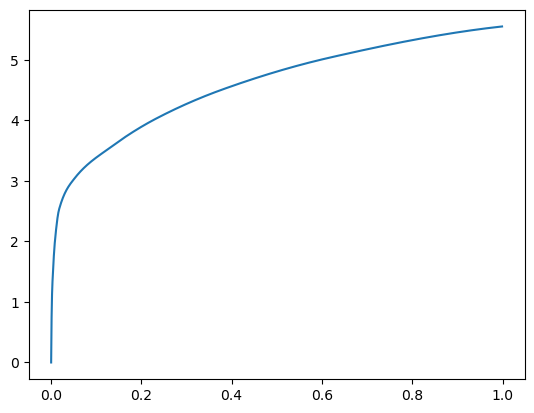

[0.00000000e+00 6.07490540e-04 1.57833099e-03 4.14943695e-03
 8.56304169e-03 1.73540115e-02 5.04369736e-02 1.27442360e-01
 2.34763145e-01 3.91665459e-01 6.23373985e-01 1.00000000e+00] betas
[0.         0.52894705 0.52217568 0.50665049 0.54832223 0.48453339
 0.48630852 0.53839097 0.53805489 0.51268672 0.44882361 0.42786676] r
-22480.269231963164 score post


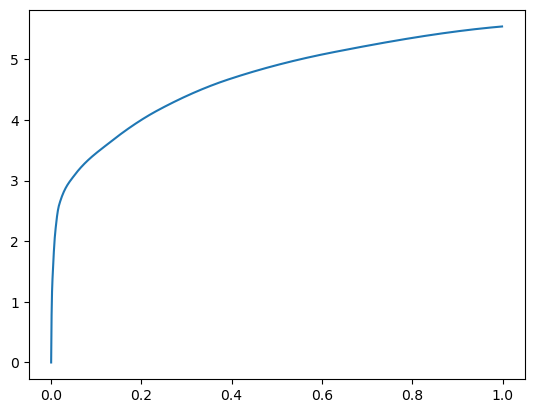

[0.00000000e+00 5.71250916e-04 1.45435333e-03 3.84807587e-03
 7.57884979e-03 1.52521133e-02 4.49724197e-02 1.12290382e-01
 2.06322670e-01 3.43604088e-01 5.74408531e-01 1.00000000e+00] betas
[0.         0.4621619  0.49773453 0.5412646  0.46975806 0.46593877
 0.52122679 0.51317869 0.44434034 0.48705094 0.54362319 0.60727832] r
-22481.378721678564 score post


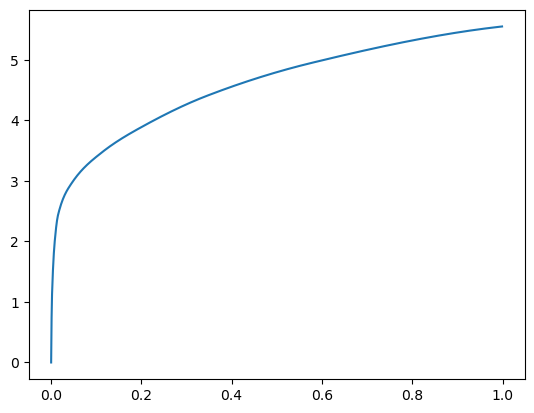

[0.00000000e+00 6.34193420e-04 1.60312653e-03 3.93009186e-03
 8.15677643e-03 1.83134079e-02 5.16347885e-02 1.23280525e-01
 2.37242699e-01 3.94642830e-01 6.31539345e-01 1.00000000e+00] betas
[0.         0.5005079  0.48412178 0.51962627 0.51344317 0.56164961
 0.49475475 0.50259724 0.51595297 0.51584531 0.4911547  0.50413274] r
-22480.269231963164 score post


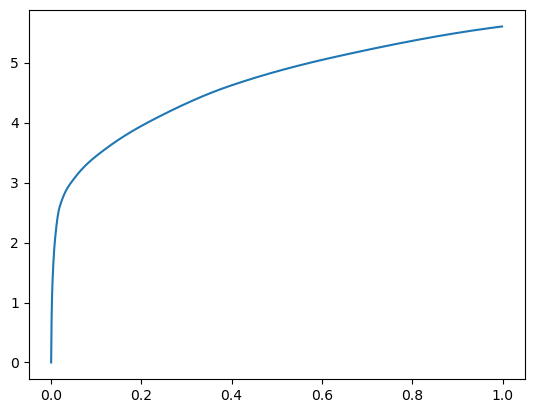

[0.00000000e+00 6.49452209e-04 1.70993805e-03 4.08077240e-03
 8.40854645e-03 1.72281265e-02 4.98685837e-02 1.21375084e-01
 2.32779503e-01 3.85663033e-01 6.28378868e-01 1.00000000e+00] betas
[0.         0.51896868 0.53770823 0.4747941  0.49172997 0.50032391
 0.56274736 0.49481604 0.54062189 0.49272976 0.51512807 0.50347207] r
-22481.378721678564 score post


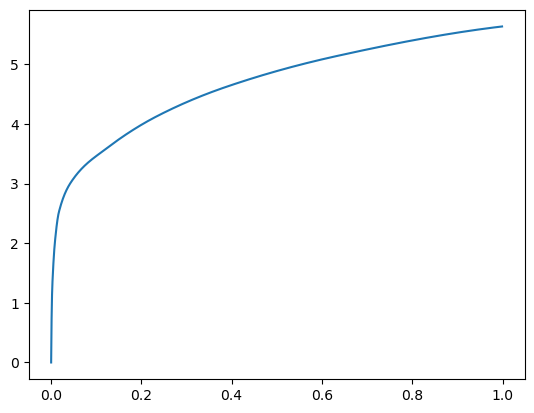

[0.00000000e+00 6.38008118e-04 1.61075592e-03 4.11319733e-03
 8.73088837e-03 1.85117722e-02 4.85620499e-02 1.21994972e-01
 2.26490974e-01 3.83519173e-01 6.23270988e-01 1.00000000e+00] betas
[0.         0.51055543 0.47331591 0.5261608  0.5589441  0.47370037
 0.41156901 0.48232227 0.51826235 0.48192249 0.53414578 0.58093247] r
-22482.458794922564 score post


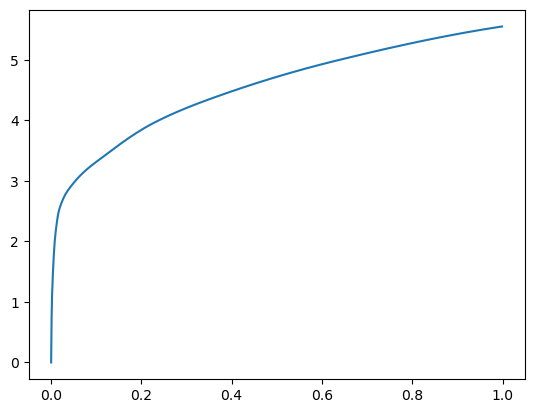

[0.00000000e+00 6.28471375e-04 1.69467926e-03 4.13990021e-03
 8.10909271e-03 1.77621841e-02 5.69467545e-02 1.39128685e-01
 2.48881340e-01 4.25051689e-01 6.65040016e-01 1.00000000e+00] betas
[0.         0.53943131 0.51266097 0.52111366 0.43243668 0.54088791
 0.52349617 0.55777957 0.50508957 0.54656021 0.49425517 0.40240376] r
-22480.269231963164 score post


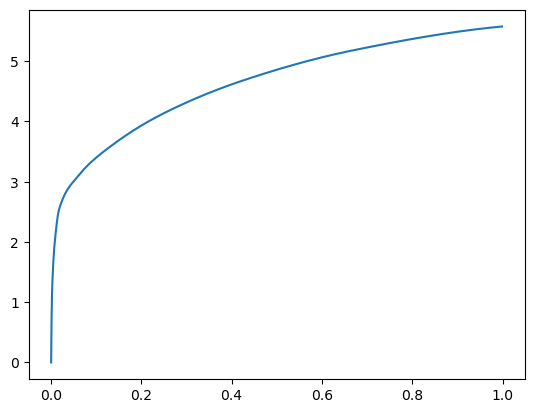

[0.00000000e+00 5.78880310e-04 1.57833099e-03 3.79657745e-03
 8.39519501e-03 1.73120499e-02 5.38301468e-02 1.24861717e-01
 2.29004860e-01 3.80690575e-01 6.03148460e-01 1.00000000e+00] betas
[0.         0.481167   0.52102206 0.45950983 0.58574954 0.52515042
 0.51784389 0.47521802 0.48519093 0.49658262 0.47768291 0.54062608] r
-22489.928354887015 score post


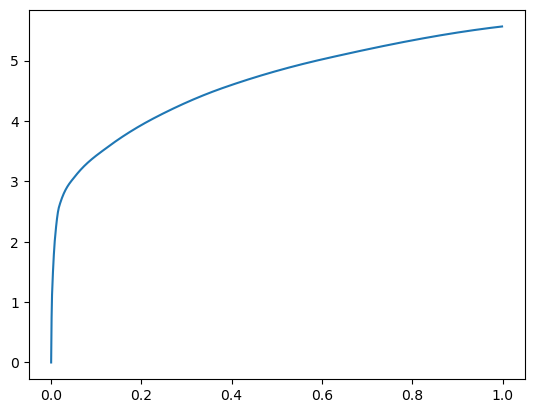

[0.00000000e+00 6.17027283e-04 1.60884857e-03 4.14752960e-03
 8.12435150e-03 1.59769058e-02 4.79249954e-02 1.20554924e-01
 2.28224754e-01 3.83114815e-01 6.23612404e-01 1.00000000e+00] betas
[0.         0.48196353 0.48398705 0.50702211 0.47256463 0.51921089
 0.53060116 0.49596352 0.49764666 0.49728859 0.52177999 0.51843907] r
-22480.269231963164 score post


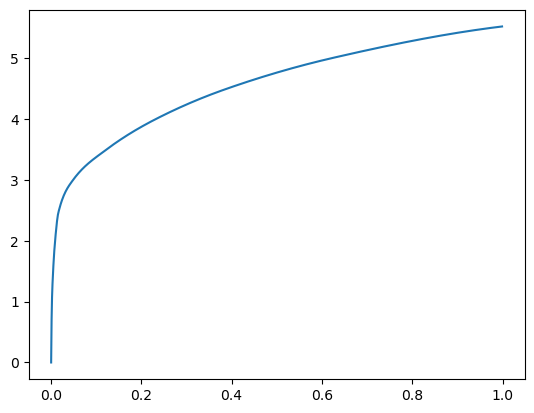

[0.00000000e+00 6.51359558e-04 1.74045563e-03 4.37641144e-03
 8.86249542e-03 1.75981522e-02 4.98170853e-02 1.25168800e-01
 2.36203194e-01 3.96731377e-01 6.32996559e-01 1.00000000e+00] betas
[0.         0.48687467 0.5359961  0.55824268 0.5045318  0.47509687
 0.53574747 0.50719392 0.55101488 0.5086019  0.52545097 0.49406951] r
-22486.1844497893 score post


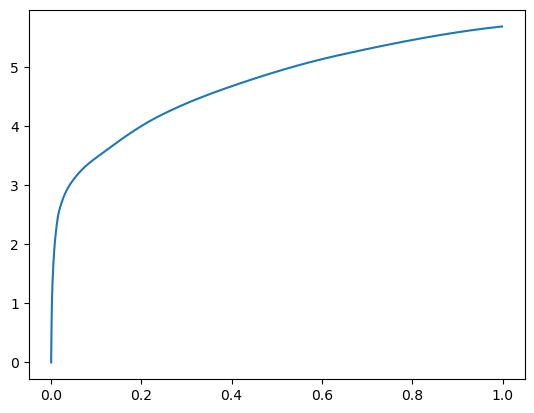

[0.00000000e+00 7.00950623e-04 1.77288055e-03 4.17232513e-03
 8.61644745e-03 1.83992386e-02 5.01356125e-02 1.27367973e-01
 2.30744362e-01 3.91558647e-01 6.20043755e-01 1.00000000e+00] betas
[0.         0.57270089 0.50446844 0.52660562 0.53327228 0.4961748
 0.46929324 0.51999537 0.49018678 0.554744   0.49687052 0.46394294] r
-22484.348661750126 score post


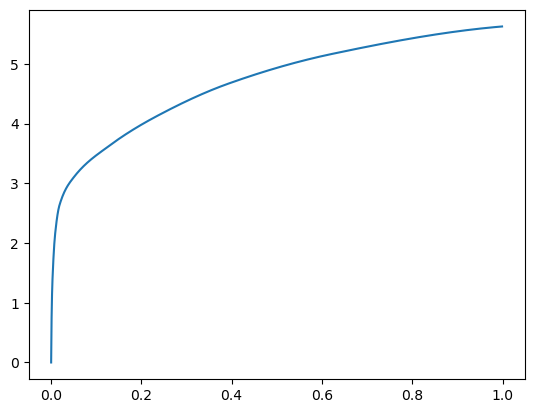

[0.00000000e+00 6.05583191e-04 1.61457062e-03 3.75652313e-03
 7.57122040e-03 1.60322189e-02 4.68034744e-02 1.20005608e-01
 2.25966454e-01 3.69427681e-01 5.91599464e-01 1.00000000e+00] betas
[0.         0.47798496 0.57275052 0.48124417 0.50552243 0.54072305
 0.53745948 0.53322826 0.48444317 0.50254929 0.50669848 0.52552306] r
-22481.621781595804 score post


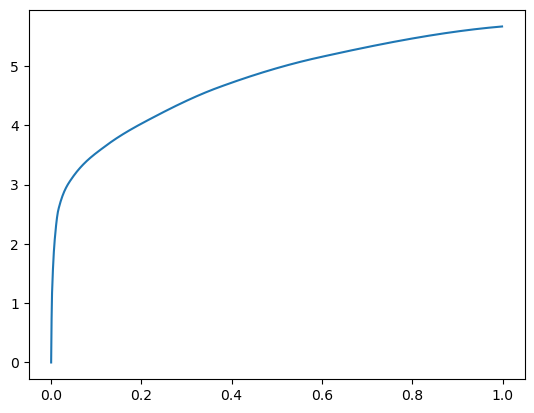

[0.00000000e+00 6.60896301e-04 1.55925751e-03 3.83853912e-03
 7.83443451e-03 1.59749985e-02 4.46062088e-02 1.12616539e-01
 2.23191261e-01 3.70017052e-01 5.97661018e-01 1.00000000e+00] betas
[0.         0.51881034 0.43364362 0.47768211 0.48897109 0.51467788
 0.52470772 0.46788827 0.53769432 0.52956191 0.46163934 0.56410745] r
-22483.75060619476 score post


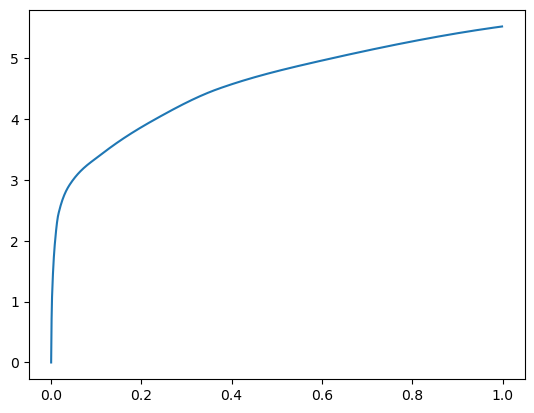

[0.00000000e+00 6.32286072e-04 1.73091888e-03 4.32682037e-03
 8.87584686e-03 1.84717178e-02 4.97159958e-02 1.27900124e-01
 2.35232353e-01 3.78510475e-01 6.35001183e-01 1.00000000e+00] betas
[0.         0.55438531 0.48363643 0.49098416 0.52230805 0.4892023
 0.48351764 0.55792234 0.54471956 0.44112271 0.51615192 0.52394419] r
-22480.269231963164 score post


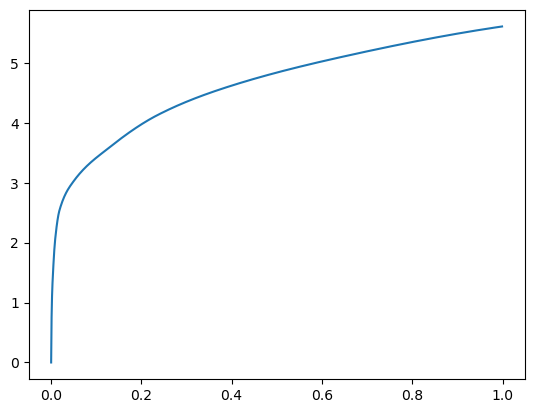

565287 steps_after


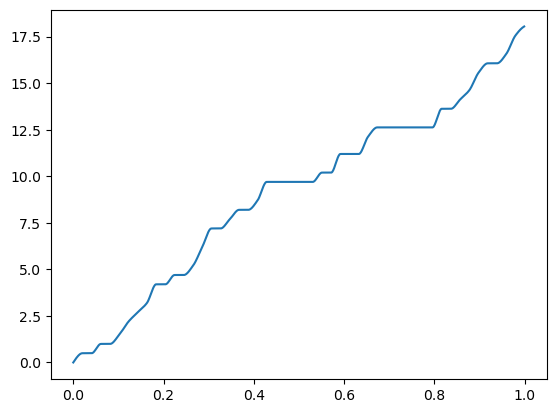

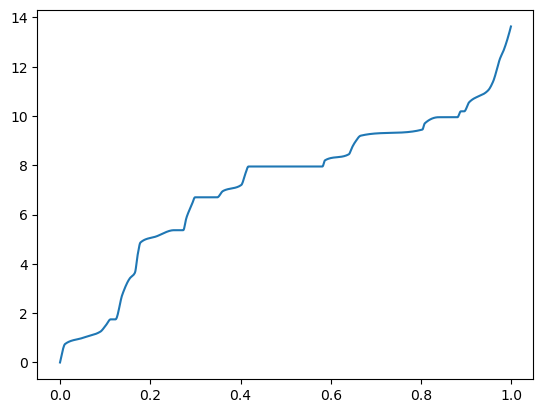

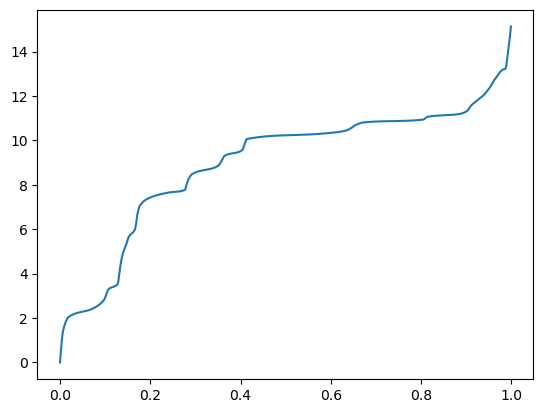

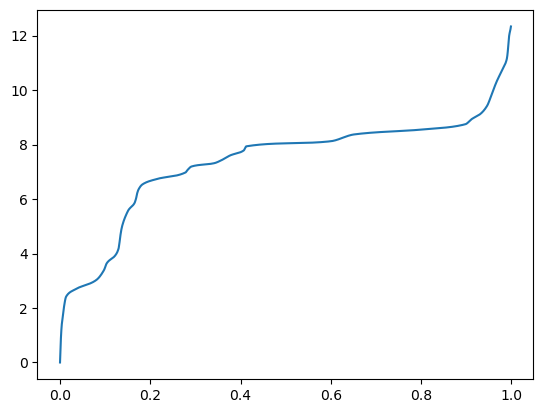

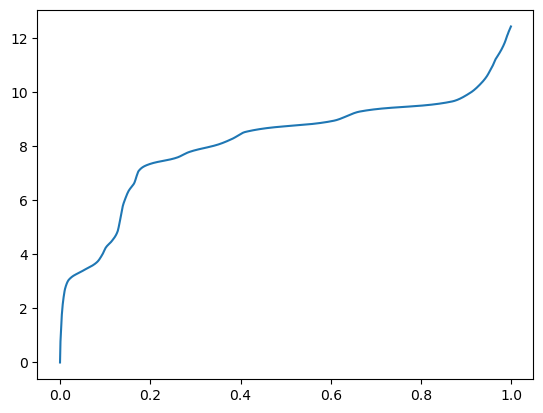

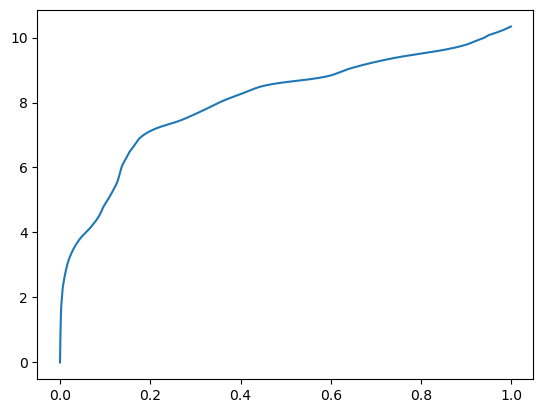

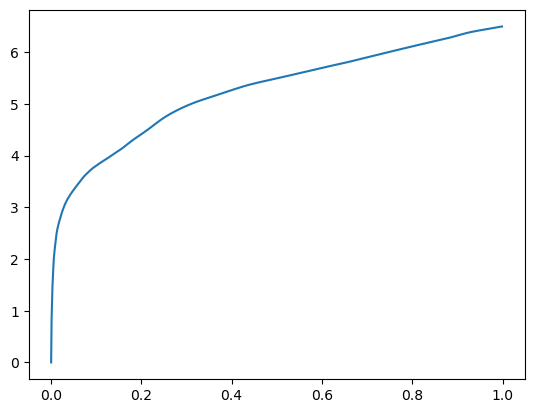

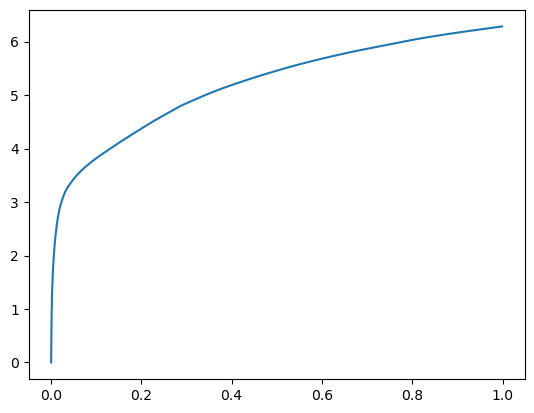

11501 steps
betas [0.00000000e+00 6.15119934e-04 1.54209137e-03 3.93390656e-03
 8.64315033e-03 1.82123184e-02 4.96339798e-02 1.31247520e-01
 2.38602638e-01 3.84417534e-01 6.15630150e-01 1.00000000e+00]
n_chains 12
[0.00000000e+00 6.15119934e-04 1.54209137e-03 3.93390656e-03
 8.64315033e-03 1.82123184e-02 4.96339798e-02 1.31247520e-01
 2.38602638e-01 3.84417534e-01 6.15630150e-01 1.00000000e+00] betas
[0.         0.1388506  0.43843744 0.         0.         0.04812573
 0.26722959 0.12803649 0.         0.         0.         0.        ] r
-22481.621781595804 score post


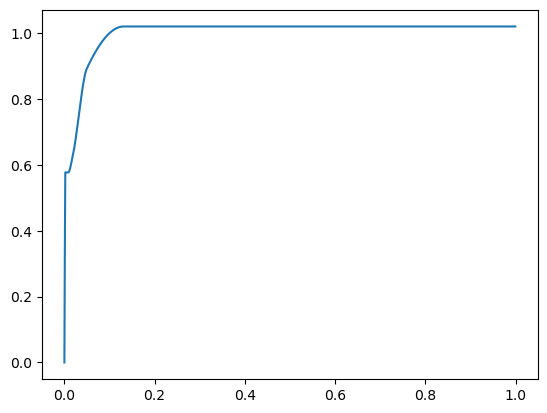

[0.00000000e+00 4.52995300e-04 7.33375549e-04 8.99314880e-04
 1.04427338e-03 1.19686127e-03 1.40666962e-03 2.16150284e-02
 3.11937332e-02 4.04138565e-02 6.24132156e-02 1.00000000e+00] betas
[0.         0.40077547 0.23241201 0.11840378 0.0920256  0.08865531
 0.10688085 0.96158578 0.20596658 0.14312349 0.24179044 0.99470525] r
-22481.990460408004 score post


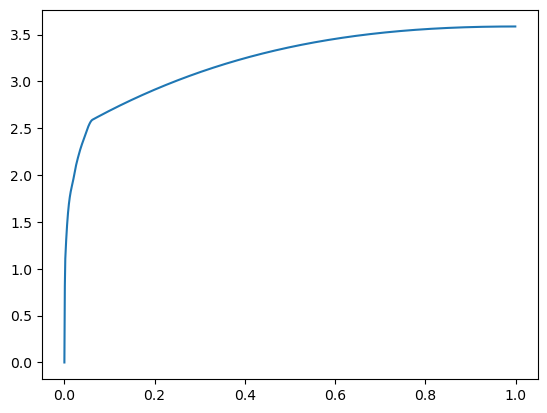

[0.00000000e+00 3.65257263e-04 7.58171082e-04 1.27124786e-03
 3.93962860e-03 8.65650177e-03 1.98945999e-02 3.56988907e-02
 6.87837601e-02 2.10850716e-01 4.09224510e-01 1.00000000e+00] betas
[0.         0.32123567 0.28662184 0.29069779 0.58835592 0.60092258
 0.55567222 0.30882376 0.36053306 0.70246466 0.57507219 0.8373552 ] r
-22481.990460408004 score post


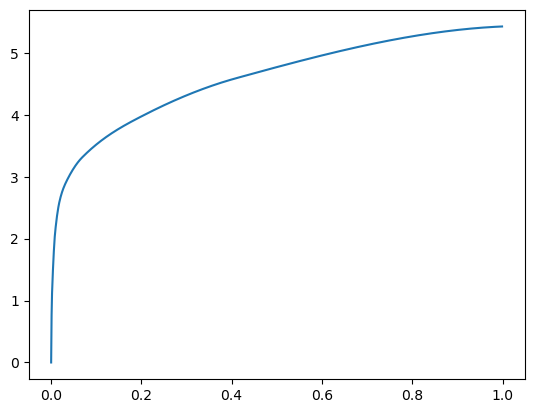

[0.00000000e+00 5.90324402e-04 1.53636932e-03 3.89957428e-03
 7.41672516e-03 1.50365829e-02 3.62730026e-02 8.93068314e-02
 1.92669868e-01 3.44786644e-01 5.86026192e-01 1.00000000e+00] betas
[0.         0.50031875 0.51802836 0.5139631  0.47976835 0.5021463
 0.44746347 0.42518401 0.59901971 0.53650969 0.56059039 0.49844745] r
-22482.458794922564 score post


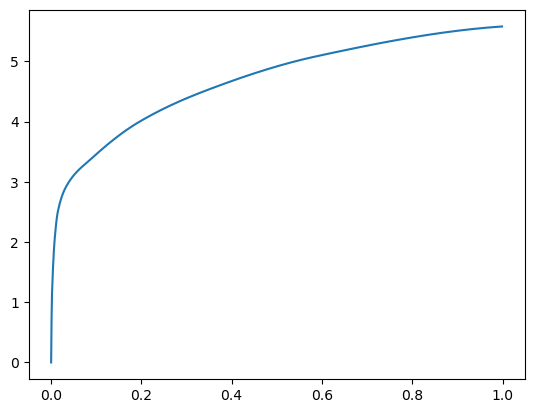

[0.00000000e+00 5.99861145e-04 1.52492523e-03 3.84044647e-03
 7.60746002e-03 1.57041550e-02 4.35113907e-02 1.14125252e-01
 2.09620476e-01 3.60459328e-01 5.80601692e-01 1.00000000e+00] betas
[0.         0.47868135 0.49702657 0.50552593 0.49775576 0.48029191
 0.48429091 0.48117699 0.48980504 0.61318105 0.53235518 0.53174796] r
-22480.269231963164 score post


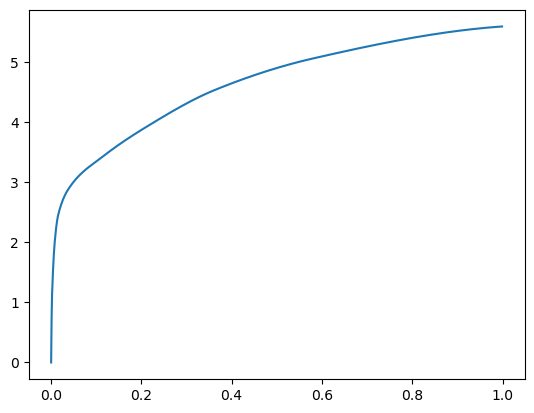

[0.00000000e+00 6.45637512e-04 1.65271759e-03 4.10366058e-03
 8.25595856e-03 1.86414719e-02 5.47037125e-02 1.37721062e-01
 2.43124962e-01 3.76070976e-01 5.94252586e-01 1.00000000e+00] betas
[0.         0.54079282 0.5501844  0.51655716 0.4495102  0.50173298
 0.46784422 0.50115542 0.46729677 0.43182943 0.45960959 0.58953526] r
-22485.87997345393 score post


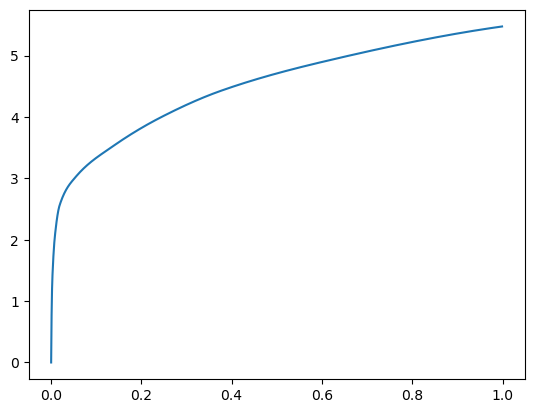

[0.00000000e+00 5.82695007e-04 1.41048431e-03 3.37123871e-03
 7.41481781e-03 1.62611008e-02 5.00802994e-02 1.29246712e-01
 2.39829063e-01 3.97128105e-01 6.47351265e-01 1.00000000e+00] betas
[0.         0.50365255 0.48426022 0.48893291 0.56930993 0.53480057
 0.48237828 0.47657552 0.50777097 0.52334221 0.5670261  0.50558166] r
-22492.983731585577 score post


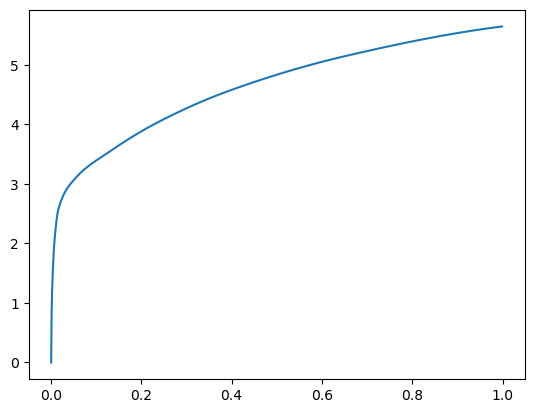

[0.00000000e+00 5.96046448e-04 1.51729584e-03 3.71265411e-03
 7.48348236e-03 1.57155991e-02 5.17778397e-02 1.39161110e-01
 2.54601479e-01 4.14320946e-01 6.43168449e-01 1.00000000e+00] betas
[0.         0.47283591 0.49891481 0.48662112 0.53688238 0.51477468
 0.55889733 0.52619803 0.52541374 0.46912691 0.55678723 0.47668561] r
-22482.458794922564 score post


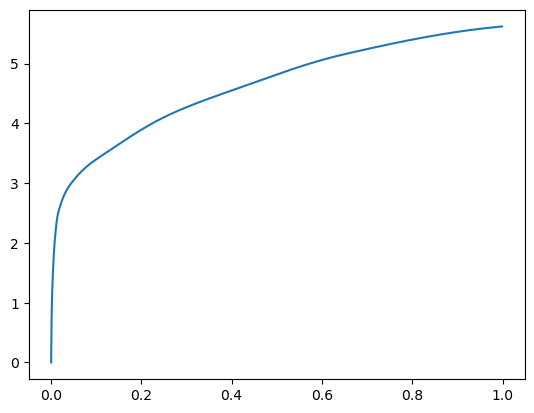

[0.00000000e+00 6.55174255e-04 1.67560577e-03 4.14371490e-03
 8.03470612e-03 1.73845291e-02 5.15871048e-02 1.35912895e-01
 2.46224403e-01 4.18457985e-01 6.24503136e-01 1.00000000e+00] betas
[0.         0.52359217 0.58160025 0.488359   0.4711493  0.52753722
 0.456856   0.55197628 0.50747925 0.53651257 0.40592386 0.46498564] r
-22487.173690536798 score post


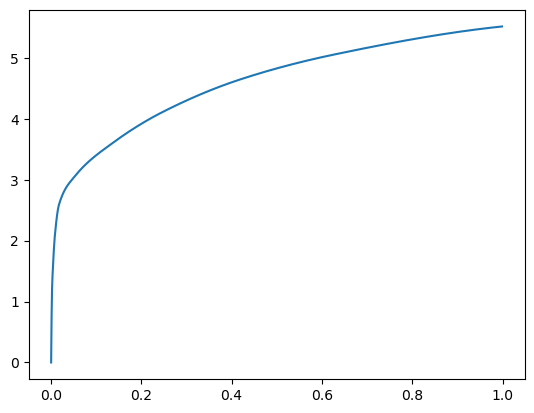

[0.00000000e+00 6.22749329e-04 1.42383575e-03 3.55052948e-03
 7.37285614e-03 1.49106979e-02 4.70876694e-02 1.19114876e-01
 2.21688271e-01 3.68380547e-01 6.01664543e-01 1.00000000e+00] betas
[0.         0.4998152  0.46242401 0.52177687 0.49931903 0.53358718
 0.57531614 0.48337307 0.5177296  0.45998254 0.53714    0.58661748] r
-22480.269231963164 score post


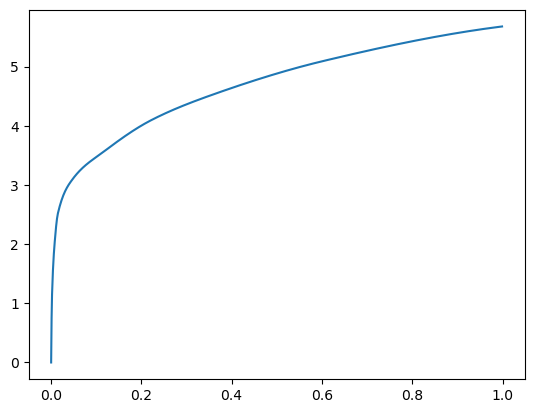

[0.00000000e+00 6.47544861e-04 1.62410736e-03 3.92818451e-03
 8.23879242e-03 1.69477463e-02 4.75091934e-02 1.25525475e-01
 2.30887413e-01 4.03056145e-01 6.40606880e-01 1.00000000e+00] betas
[0.         0.50860073 0.52139789 0.50939805 0.49006194 0.49998797
 0.45186651 0.51297513 0.46981934 0.53593599 0.48896443 0.44484744] r
-22484.55452125251 score post


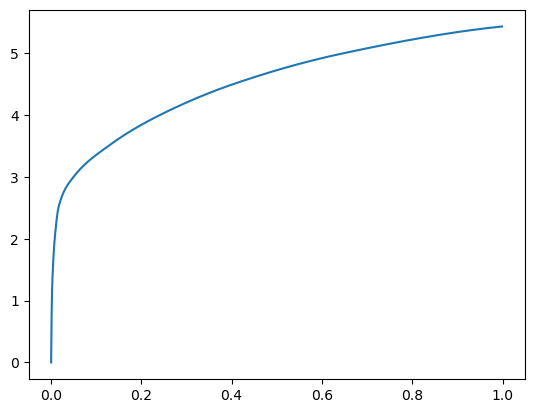

[0.00000000e+00 6.24656677e-04 1.50966644e-03 3.56769562e-03
 7.59792328e-03 1.52025223e-02 4.56953049e-02 1.18691444e-01
 2.27620125e-01 3.82058144e-01 6.10610008e-01 1.00000000e+00] betas
[0.         0.49430119 0.44201264 0.44984096 0.50712    0.49967637
 0.51584545 0.46011046 0.55959785 0.51021115 0.48839705 0.49320952] r
-22484.25291812412 score post


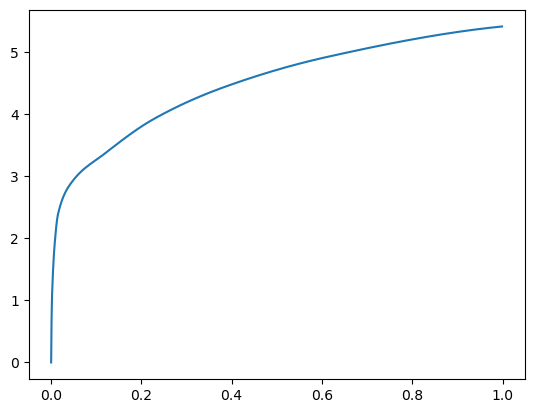

[0.00000000e+00 6.22749329e-04 1.66797638e-03 4.14752960e-03
 8.48484039e-03 1.76496506e-02 5.07936478e-02 1.32836342e-01
 2.30961800e-01 3.80576134e-01 6.10888481e-01 1.00000000e+00] betas
[0.         0.48471197 0.49891831 0.49983533 0.52399309 0.5048958
 0.54393126 0.5527161  0.44846207 0.4673826  0.53142204 0.48914155] r
-22481.990460408004 score post


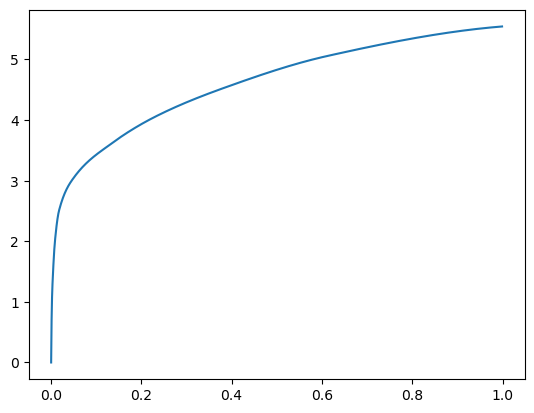

[0.00000000e+00 6.55174255e-04 1.75189972e-03 4.33635712e-03
 8.59928131e-03 1.79452896e-02 4.77247238e-02 1.17962837e-01
 2.24543571e-01 3.85167122e-01 6.02091789e-01 1.00000000e+00] betas
[0.         0.54366828 0.51015553 0.50119951 0.5117973  0.52740494
 0.43728022 0.4945044  0.49456242 0.53729958 0.47721513 0.5723736 ] r
-22483.75060619476 score post


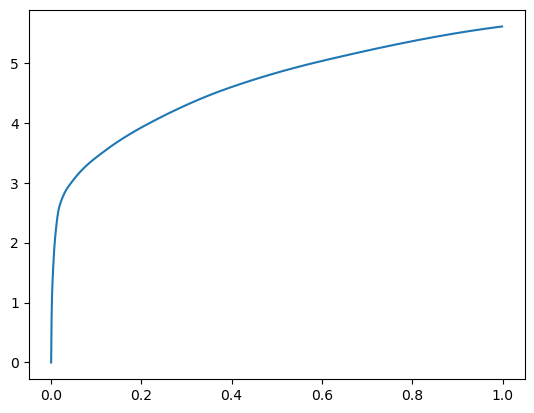

[0.00000000e+00 6.01768494e-04 1.64127350e-03 4.16660309e-03
 8.26931000e-03 1.65052414e-02 5.04865646e-02 1.25557899e-01
 2.39371300e-01 3.96491051e-01 6.37694359e-01 1.00000000e+00] betas
[0.         0.46498046 0.48142845 0.53220328 0.48289307 0.46828015
 0.52089365 0.50047426 0.50390992 0.53629796 0.49714713 0.48559118] r
-22486.81070109817 score post


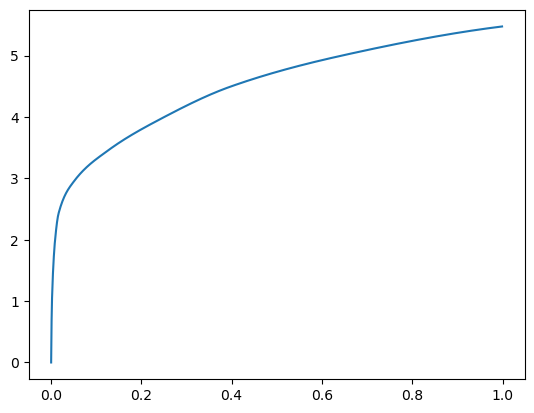

[0.00000000e+00 6.57081604e-04 1.80530548e-03 4.26006317e-03
 8.63742828e-03 1.87387466e-02 5.41772842e-02 1.31638527e-01
 2.46106148e-01 3.91753197e-01 6.30415916e-01 1.00000000e+00] betas
[0.         0.50705542 0.51783298 0.49848778 0.48670004 0.52939256
 0.52670355 0.52998005 0.54589785 0.44272928 0.46871854 0.45257333] r
-22481.378721678564 score post


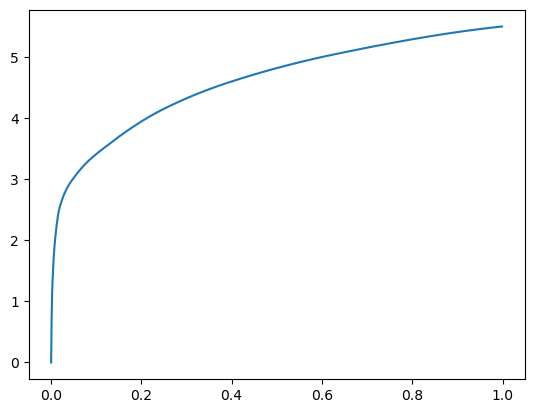

[0.00000000e+00 6.45637512e-04 1.72710419e-03 4.11510468e-03
 8.53252411e-03 1.74970627e-02 4.77972031e-02 1.15235329e-01
 2.12292671e-01 3.60381126e-01 6.00140572e-01 1.00000000e+00] betas
[0.         0.46913296 0.50767659 0.45611275 0.48474867 0.54144285
 0.49014355 0.46025425 0.45035214 0.53230077 0.54026476 0.53887019] r
-22484.556296744664 score post


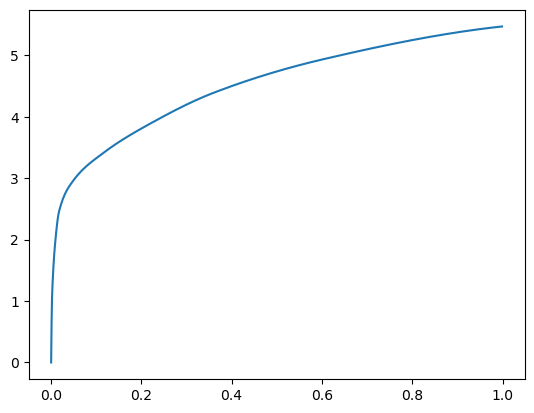

[0.00000000e+00 6.95228577e-04 1.79004669e-03 4.53853607e-03
 9.43660736e-03 1.84946060e-02 5.13620377e-02 1.28582954e-01
 2.41860390e-01 3.91119957e-01 6.24384880e-01 1.00000000e+00] betas
[0.         0.52597895 0.50995418 0.53204305 0.5431801  0.47412303
 0.49513011 0.50920128 0.49145852 0.4457635  0.46871806 0.47509564] r
-22484.920809394072 score post


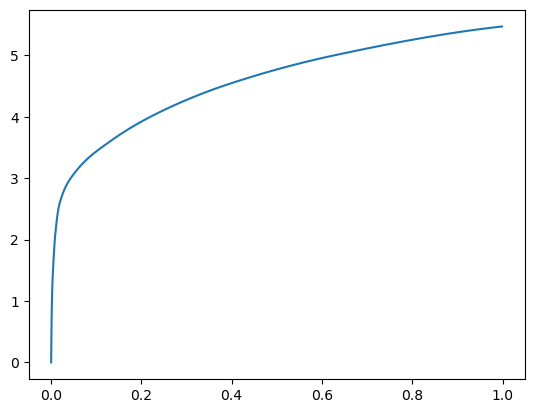

[0.00000000e+00 6.47544861e-04 1.66034698e-03 4.01973724e-03
 8.00800323e-03 1.56965256e-02 4.17928696e-02 1.08132362e-01
 2.14325905e-01 3.70846748e-01 6.10539436e-01 1.00000000e+00] betas
[0.         0.52173037 0.49967244 0.47242097 0.47221871 0.50147412
 0.49580955 0.49089718 0.54449987 0.51058695 0.49947542 0.49200505] r
-22480.269231963164 score post


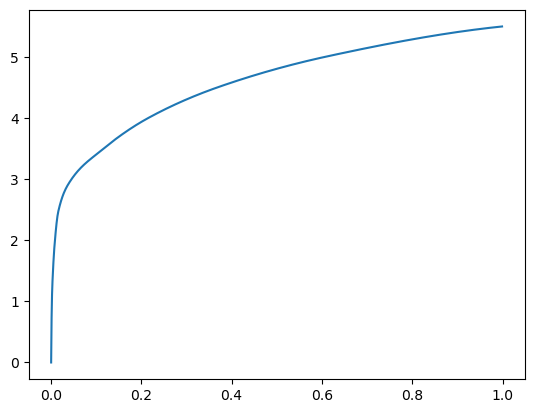

[0.00000000e+00 6.13212585e-04 1.59358978e-03 4.06169891e-03
 8.40473175e-03 1.67264938e-02 4.51517105e-02 1.15750313e-01
 2.14783669e-01 3.67508888e-01 6.05540276e-01 1.00000000e+00] betas
[0.         0.48450129 0.45481258 0.50667101 0.51294578 0.51755026
 0.47892991 0.53140421 0.4804321  0.50877536 0.5019     0.56048281] r
-22484.4517533122 score post


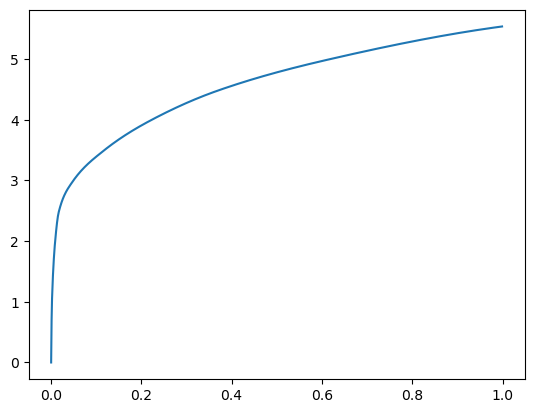

[0.00000000e+00 6.45637512e-04 1.82819366e-03 4.49085236e-03
 9.06658173e-03 1.81570053e-02 5.13677597e-02 1.22145653e-01
 2.30193138e-01 3.89086723e-01 6.38882637e-01 1.00000000e+00] betas
[0.         0.47426252 0.57187835 0.5347004  0.5171963  0.45377575
 0.46296844 0.46235568 0.55873026 0.49092984 0.54081629 0.50302166] r
-22481.621781595804 score post


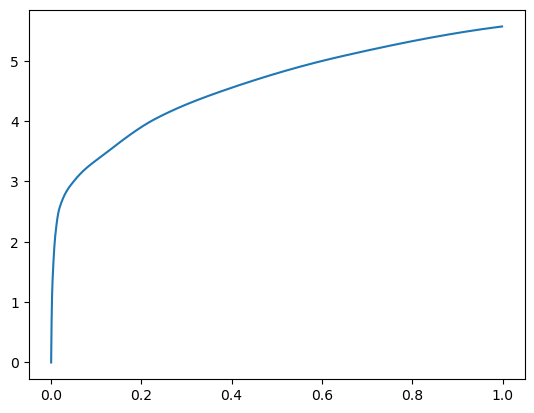

[0.00000000e+00 6.99043274e-04 1.72519684e-03 4.08077240e-03
 8.17394257e-03 1.74188614e-02 5.39693832e-02 1.33824348e-01
 2.34166145e-01 4.01188850e-01 6.36908531e-01 1.00000000e+00] betas
[0.         0.52761322 0.50052491 0.51791846 0.50537589 0.47742964
 0.5700253  0.52722619 0.47121212 0.53495285 0.54705874 0.48186629] r
-22484.501289920216 score post


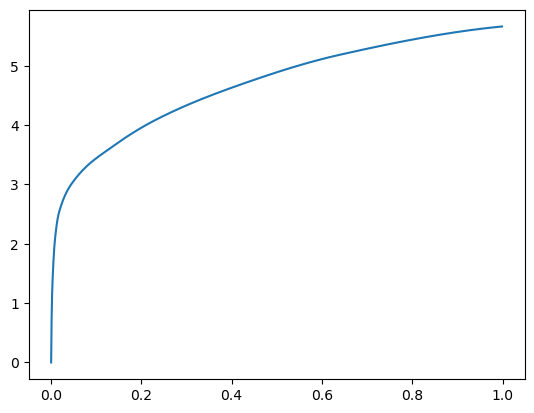

[0.00000000e+00 6.78062439e-04 1.72901154e-03 4.06742096e-03
 8.26740265e-03 1.91240311e-02 5.28497696e-02 1.29527092e-01
 2.39348412e-01 4.01047707e-01 6.18521690e-01 1.00000000e+00] betas
[0.         0.54645164 0.53460756 0.47253828 0.46854693 0.54118812
 0.48472561 0.47773718 0.48697959 0.5572295  0.50960122 0.49035631] r
-22483.811344555204 score post


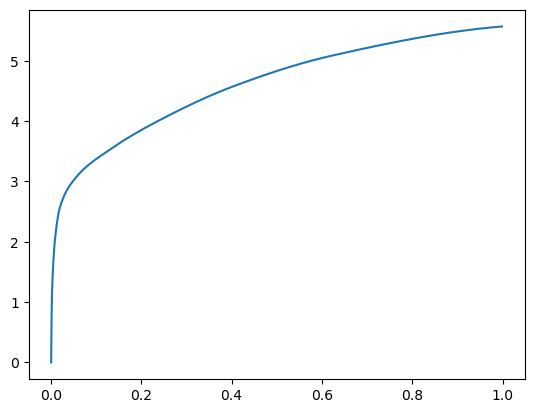

[0.00000000e+00 6.17027283e-04 1.53636932e-03 3.83472443e-03
 8.31317902e-03 1.79777145e-02 5.17702103e-02 1.33130074e-01
 2.49142647e-01 3.96550179e-01 6.09320641e-01 1.00000000e+00] betas
[0.         0.48139951 0.47426251 0.50247356 0.52627996 0.52811085
 0.57875685 0.57713812 0.54898937 0.48652107 0.51269108 0.43535603] r
-22481.621781595804 score post


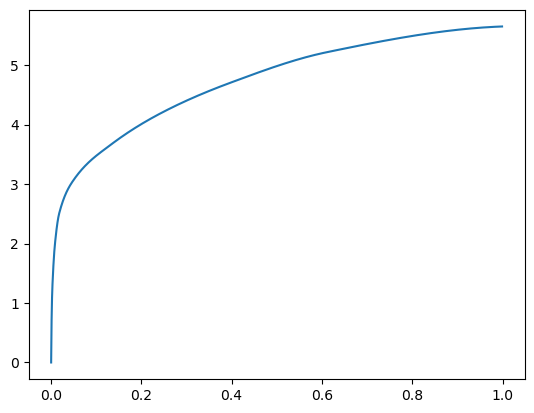

[0.00000000e+00 6.68525696e-04 1.76715851e-03 4.38022614e-03
 9.24587250e-03 2.00071335e-02 5.09843826e-02 1.20472908e-01
 2.22861290e-01 3.68956566e-01 5.66163063e-01 1.00000000e+00] betas
[0.         0.52321094 0.51946066 0.49118765 0.54202573 0.46795525
 0.4066811  0.43167432 0.44684728 0.53008657 0.47697833 0.63237213] r
-22482.458794922564 score post


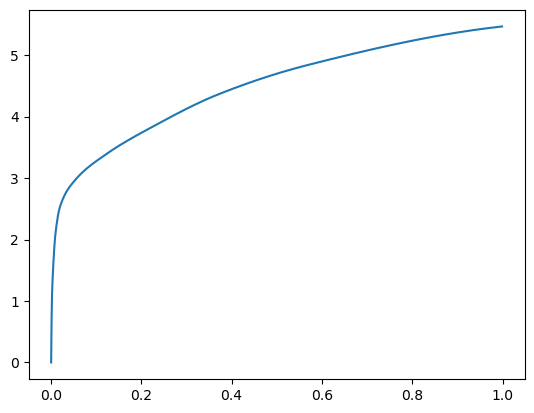

[0.00000000e+00 6.26564026e-04 1.61457062e-03 4.08458710e-03
 8.13770294e-03 1.77927017e-02 5.47323227e-02 1.40187263e-01
 2.60264397e-01 4.09613609e-01 6.39660835e-01 1.00000000e+00] betas
[0.         0.49747429 0.44974799 0.51007165 0.51886441 0.54556222
 0.53441619 0.57196961 0.50426192 0.51177039 0.46963312 0.46712273] r
-22480.269231963164 score post


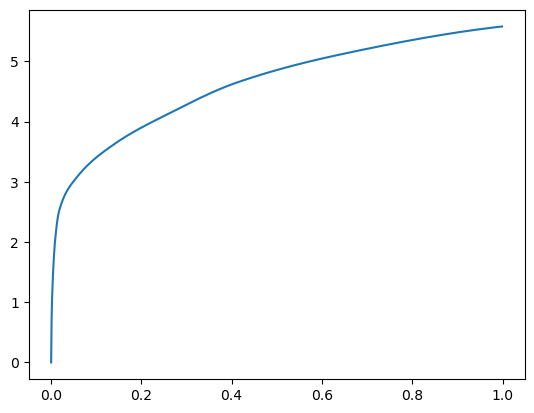

[0.00000000e+00 6.43730164e-04 1.84917450e-03 4.49275970e-03
 8.79383087e-03 1.83763504e-02 5.34753799e-02 1.25649452e-01
 2.40763664e-01 3.82033348e-01 6.15204811e-01 1.00000000e+00] betas
[0.         0.46977283 0.56552792 0.50594154 0.51898213 0.46797315
 0.51217169 0.53778852 0.50623108 0.45211518 0.53466982 0.57650547] r
-22480.269231963164 score post


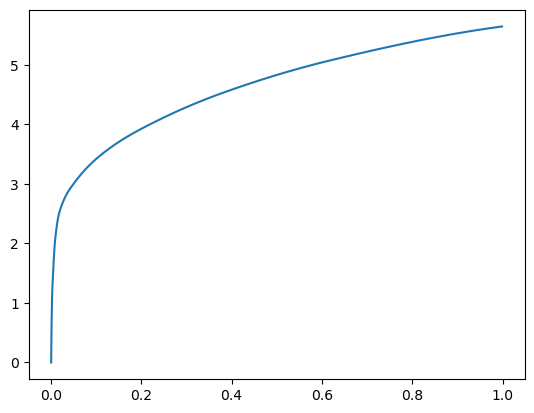

[0.00000000e+00 7.18116760e-04 1.82056427e-03 4.48703766e-03
 8.70609283e-03 1.99785233e-02 5.74769974e-02 1.28476143e-01
 2.46983528e-01 4.13784981e-01 6.49767876e-01 1.00000000e+00] betas
[0.         0.52363083 0.54802884 0.5602329  0.49247312 0.50541428
 0.46015939 0.42678065 0.56052615 0.56879021 0.45618064 0.46608986] r
-22484.09117069985 score post


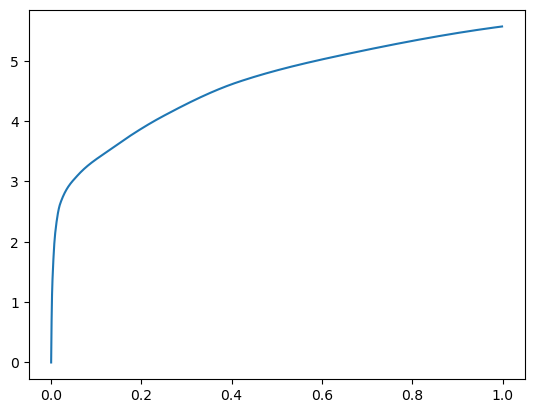

[0.00000000e+00 6.89506531e-04 1.65271759e-03 3.77750397e-03
 7.53116608e-03 1.65014267e-02 5.11159897e-02 1.33498192e-01
 2.40172386e-01 3.80825996e-01 6.24831200e-01 1.00000000e+00] betas
[0.         0.54677076 0.45857927 0.45909886 0.50996737 0.47987995
 0.47139548 0.49845893 0.4333561  0.49916633 0.55657402 0.50479492] r
-22480.269231963164 score post


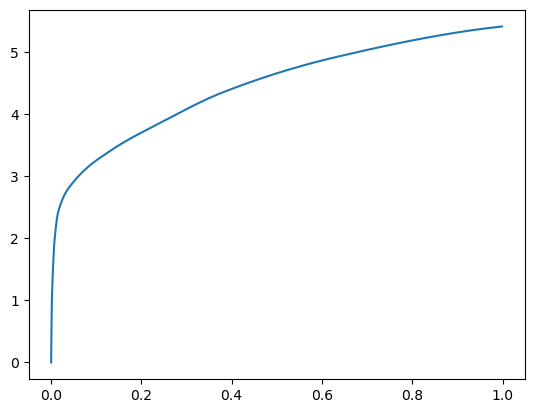

[0.00000000e+00 6.03675842e-04 1.58977509e-03 3.85570526e-03
 7.47966766e-03 1.68485641e-02 5.45339584e-02 1.38394356e-01
 2.61858940e-01 4.08354759e-01 6.31949425e-01 1.00000000e+00] betas
[0.         0.43192047 0.57936649 0.47548855 0.46467279 0.55700092
 0.57035805 0.51753795 0.54429072 0.42925923 0.52316034 0.51580443] r
-22486.71698678069 score post


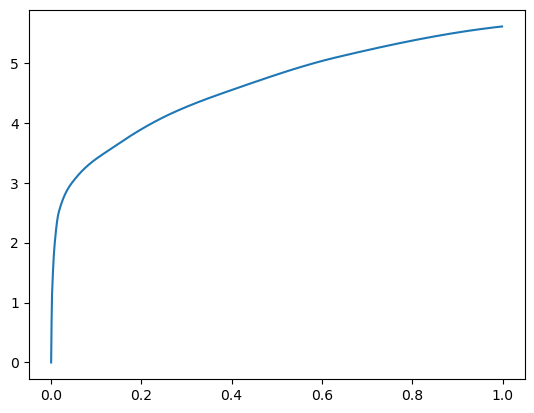

[0.00000000e+00 7.21931458e-04 1.61647797e-03 4.12273407e-03
 8.53633881e-03 1.83897018e-02 5.24339676e-02 1.33122444e-01
 2.45100975e-01 4.15667534e-01 6.35254860e-01 1.00000000e+00] betas
[0.         0.56778074 0.47554143 0.5116597  0.53648425 0.45117011
 0.47463108 0.52835608 0.51246563 0.53120733 0.46945301 0.4498966 ] r
-22481.990460408004 score post


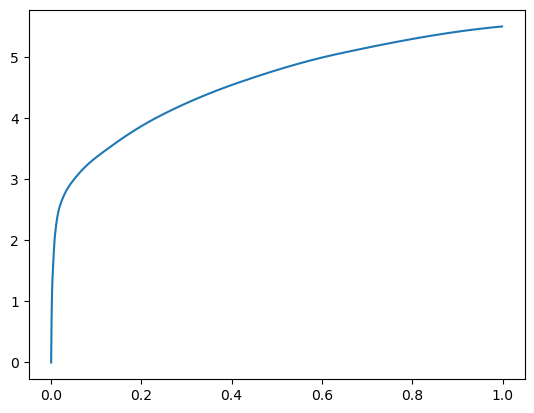

[0.00000000e+00 6.20841980e-04 1.50012970e-03 3.78322601e-03
 7.50255585e-03 1.69363022e-02 5.10911942e-02 1.25691414e-01
 2.31646538e-01 3.84579659e-01 6.05107307e-01 1.00000000e+00] betas
[0.         0.50065002 0.4794926  0.49128985 0.46323982 0.58084688
 0.54553237 0.45645406 0.53143674 0.52150521 0.51648246 0.48792676] r
-22481.378721678564 score post


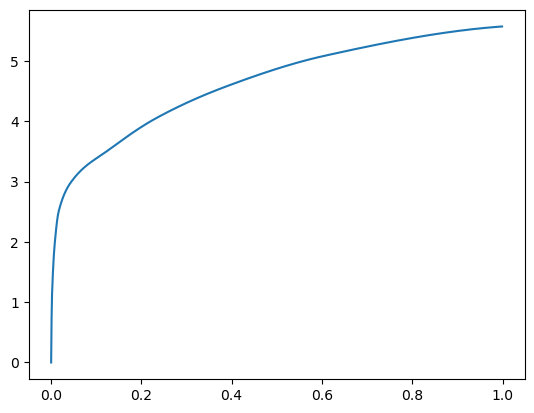

[0.00000000e+00 6.30378723e-04 1.60503387e-03 4.09221649e-03
 8.59737396e-03 1.75924301e-02 4.89473343e-02 1.31134987e-01
 2.32987404e-01 3.81316185e-01 5.94067574e-01 1.00000000e+00] betas
[0.         0.49012015 0.47991034 0.49934328 0.52788749 0.55446587
 0.45477309 0.57273107 0.50299591 0.49653725 0.46748485 0.53213196] r
-22480.269231963164 score post


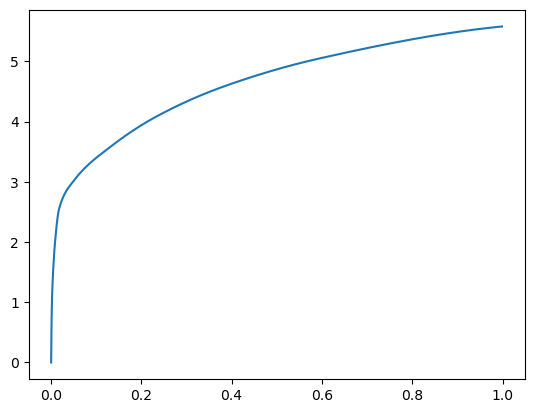

[0.00000000e+00 6.58988953e-04 1.75571442e-03 4.44126129e-03
 8.97312164e-03 1.70450211e-02 5.26762009e-02 1.26057625e-01
 2.26826668e-01 3.75914574e-01 6.08952522e-01 1.00000000e+00] betas
[0.         0.50038851 0.57303116 0.53845345 0.45536707 0.43559529
 0.56007142 0.48971181 0.47338165 0.51259263 0.51454309 0.52020815] r
-22481.990460408004 score post


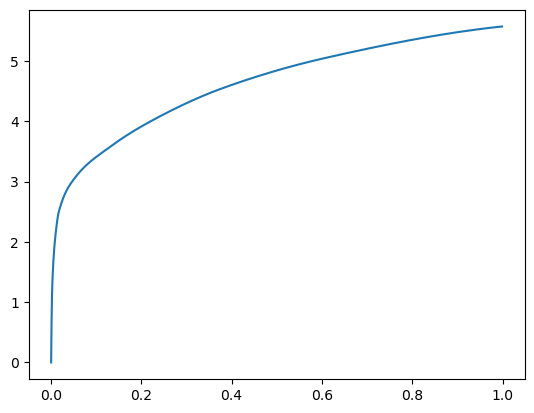

[0.00000000e+00 6.68525696e-04 1.58596039e-03 3.80420685e-03
 8.42952728e-03 1.81760788e-02 5.03511429e-02 1.24987602e-01
 2.33679771e-01 3.83803368e-01 6.16955757e-01 1.00000000e+00] betas
[0.         0.52982509 0.50287907 0.54073792 0.56532781 0.50447625
 0.4797514  0.50097449 0.50632172 0.47349751 0.51485151 0.50055619] r
-22481.990460408004 score post


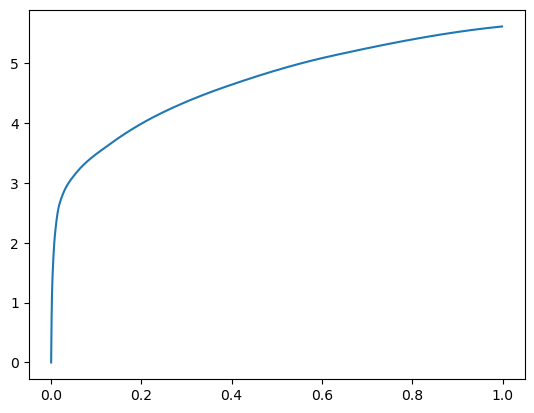

[0.00000000e+00 6.39915466e-04 1.55544281e-03 3.56769562e-03
 7.33280182e-03 1.54905319e-02 4.44669724e-02 1.16242409e-01
 2.22455025e-01 3.81428719e-01 6.10884666e-01 1.00000000e+00] betas
[0.         0.48960986 0.46064769 0.49069748 0.49672312 0.55086977
 0.54284973 0.47742801 0.47249532 0.52916817 0.50508002 0.5656692 ] r
-22487.170350548633 score post


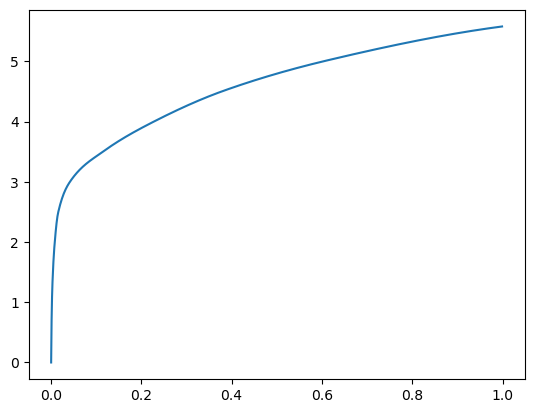

[0.00000000e+00 6.68525696e-04 1.74999237e-03 4.04453278e-03
 8.34369659e-03 1.70125961e-02 4.57067490e-02 1.24325752e-01
 2.42957115e-01 4.02688026e-01 6.43897057e-01 1.00000000e+00] betas
[0.         0.50611203 0.50211129 0.45431974 0.49551198 0.5096808
 0.51688393 0.56544142 0.49141209 0.50388072 0.54431961 0.4739768 ] r
-22480.269231963164 score post


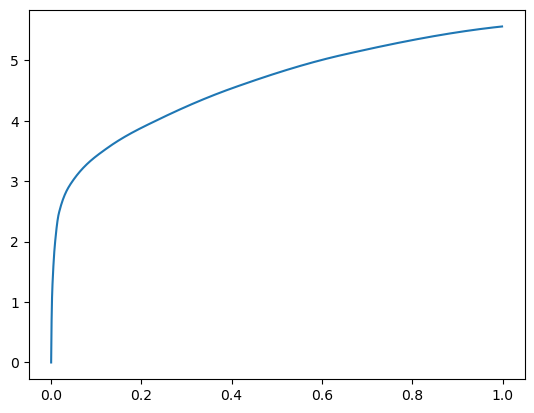

[0.00000000e+00 6.68525696e-04 1.76143646e-03 4.41837311e-03
 9.16576385e-03 1.91087723e-02 5.04007339e-02 1.22540474e-01
 2.44294167e-01 4.05217171e-01 6.25767708e-01 1.00000000e+00] betas
[0.         0.56059445 0.51666539 0.50115456 0.55399157 0.53143244
 0.45397859 0.5090064  0.46628139 0.49131892 0.47099363 0.47871715] r
-22481.990460408004 score post


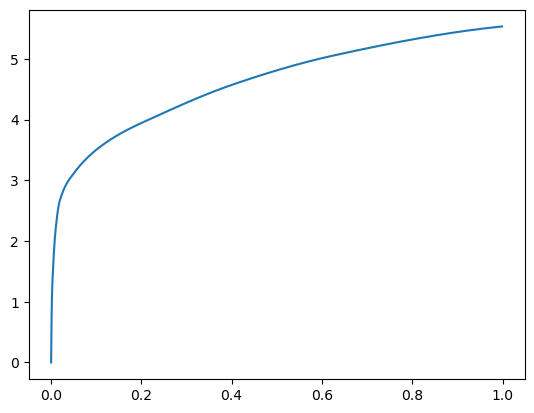

[0.00000000e+00 5.80787659e-04 1.54590607e-03 3.94725800e-03
 7.83061981e-03 1.51681900e-02 4.05168533e-02 1.03209496e-01
 2.24011421e-01 3.83683205e-01 6.11205101e-01 1.00000000e+00] betas
[0.         0.45999145 0.51255079 0.50421348 0.50452367 0.49849374
 0.47708954 0.47016712 0.5671429  0.48994047 0.50320195 0.51950473] r
-22480.269231963164 score post


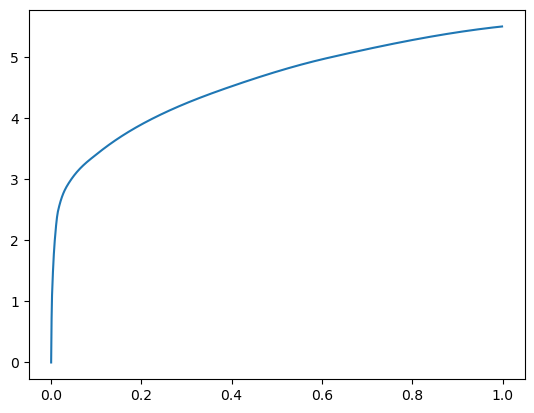

[0.00000000e+00 6.43730164e-04 1.63745880e-03 4.10175323e-03
 8.06140900e-03 1.58910751e-02 4.47740555e-02 1.16642952e-01
 2.26902962e-01 3.91985893e-01 6.22332573e-01 1.00000000e+00] betas
[0.         0.46915227 0.47693193 0.54140773 0.48847345 0.52674965
 0.51733471 0.4911866  0.5479981  0.58159433 0.4768707  0.4270074 ] r
-22488.214733509252 score post


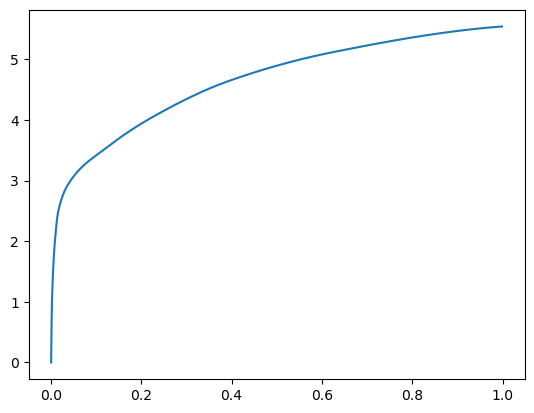

[0.00000000e+00 7.02857971e-04 1.83963776e-03 4.25624847e-03
 8.51154327e-03 1.64518356e-02 4.51860428e-02 1.19612694e-01
 2.20561028e-01 3.55757713e-01 5.74646950e-01 1.00000000e+00] betas
[0.         0.53411777 0.49755303 0.48949912 0.49077136 0.50255389
 0.49968987 0.51071687 0.51187856 0.52202134 0.49521551 0.56469634] r
-22480.269231963164 score post


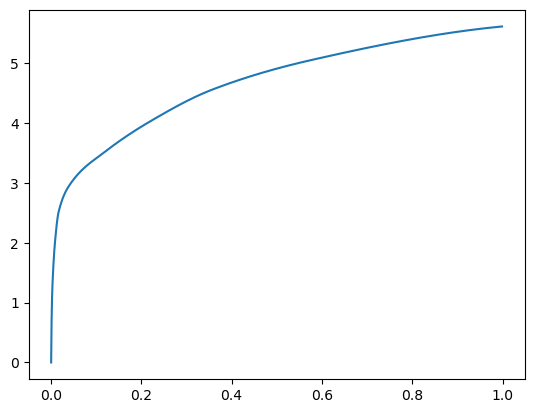

[0.00000000e+00 6.62803650e-04 1.80530548e-03 4.33063507e-03
 8.88347626e-03 1.77812576e-02 5.01909256e-02 1.28352165e-01
 2.31831551e-01 3.69126320e-01 6.06219292e-01 1.00000000e+00] betas
[0.         0.51964585 0.50619926 0.51285229 0.533145   0.48301473
 0.49727372 0.50631565 0.47914268 0.44695897 0.55010871 0.53236565] r
-22492.58123892054 score post


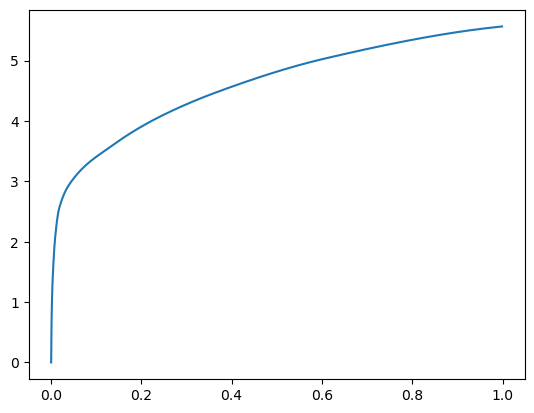

[0.00000000e+00 6.39915466e-04 1.75952911e-03 4.19712067e-03
 8.30936432e-03 1.69591904e-02 4.85792160e-02 1.25430107e-01
 2.34736443e-01 3.94991875e-01 6.21325493e-01 1.00000000e+00] betas
[0.         0.51218422 0.52955191 0.50973199 0.47828993 0.51174091
 0.56672273 0.54172053 0.53323823 0.56367283 0.48050509 0.45493279] r
-22480.269231963164 score post


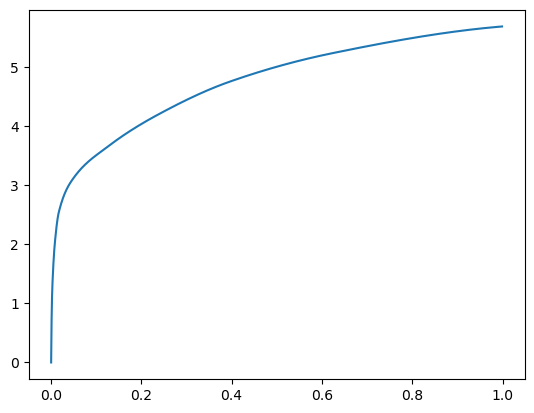

[0.00000000e+00 6.47544861e-04 1.73091888e-03 4.18567657e-03
 8.76140594e-03 1.83458328e-02 4.77666855e-02 1.19521141e-01
 2.22666740e-01 3.61266136e-01 5.84195137e-01 1.00000000e+00] betas
[0.         0.49142534 0.56383495 0.51926734 0.50088405 0.56066543
 0.49132334 0.46185446 0.49087381 0.50625136 0.50660384 0.57361261] r
-22480.269231963164 score post


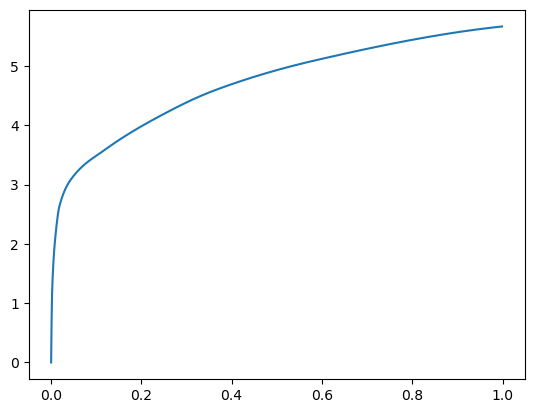

[0.00000000e+00 6.85691833e-04 1.65653229e-03 3.99303436e-03
 8.57639313e-03 1.66387558e-02 4.41770554e-02 1.22570992e-01
 2.32571602e-01 3.79084587e-01 6.17712975e-01 1.00000000e+00] betas
[0.         0.53260242 0.52143968 0.48832622 0.52453223 0.46519706
 0.51103576 0.55175864 0.50815224 0.5077426  0.56315788 0.50187431] r
-22481.378721678564 score post


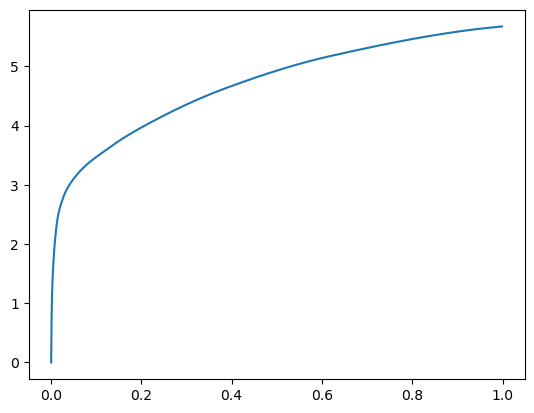

[0.00000000e+00 6.60896301e-04 1.59168243e-03 4.02927399e-03
 8.53824615e-03 1.82332993e-02 4.91590500e-02 1.25603676e-01
 2.38825798e-01 3.90753746e-01 6.09656334e-01 1.00000000e+00] betas
[0.         0.49742319 0.44606331 0.51581205 0.54781294 0.47029311
 0.5467177  0.52120871 0.51223831 0.54202367 0.51001924 0.48237203] r
-22484.348661750126 score post


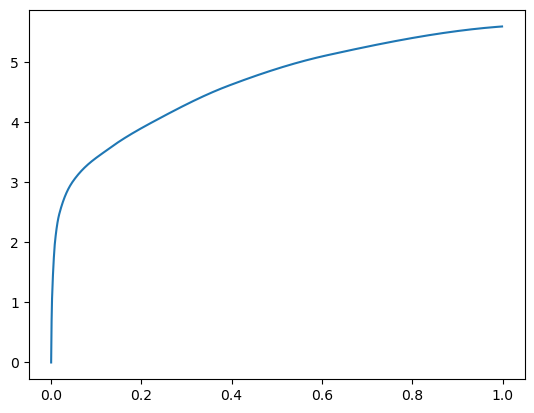

[0.00000000e+00 6.79969788e-04 1.83773041e-03 4.45079803e-03
 8.90445709e-03 2.06041336e-02 5.16881943e-02 1.28012657e-01
 2.41152763e-01 3.82386208e-01 5.94529152e-01 1.00000000e+00] betas
[0.         0.55894237 0.50909589 0.50270829 0.51715134 0.55242608
 0.4473129  0.50558893 0.55974477 0.50677297 0.48892044 0.54908583] r
-22480.269231963164 score post


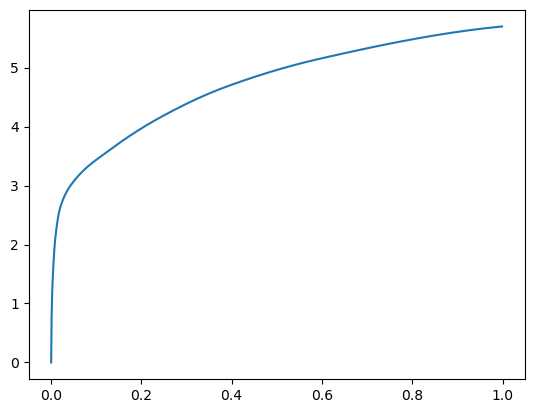

[0.00000000e+00 6.13212585e-04 1.72901154e-03 4.33635712e-03
 8.68892670e-03 1.87673569e-02 5.38339615e-02 1.33755684e-01
 2.38972664e-01 3.83107185e-01 6.12351418e-01 1.00000000e+00] betas
[0.         0.52177733 0.57925928 0.49697784 0.48238311 0.55770791
 0.43896524 0.49702947 0.47518342 0.49482928 0.5134797  0.56344969] r
-22481.378721678564 score post


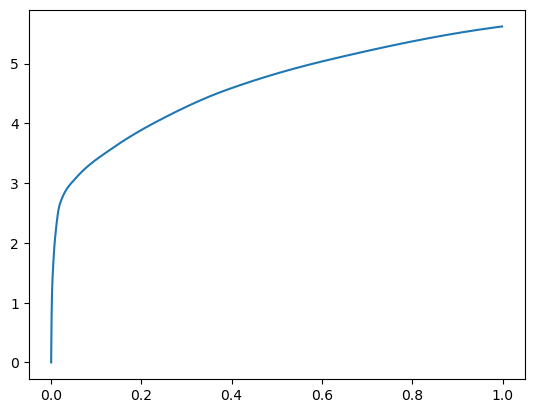

[0.00000000e+00 5.97953796e-04 1.50585175e-03 3.88240814e-03
 8.23879242e-03 1.62553787e-02 5.25484085e-02 1.34310722e-01
 2.48890877e-01 4.03420448e-01 6.41808510e-01 1.00000000e+00] betas
[0.         0.44454143 0.51785251 0.51167284 0.50765636 0.48332297
 0.57129414 0.50770884 0.53390829 0.49675246 0.50254151 0.49059865] r
-22485.70121138277 score post


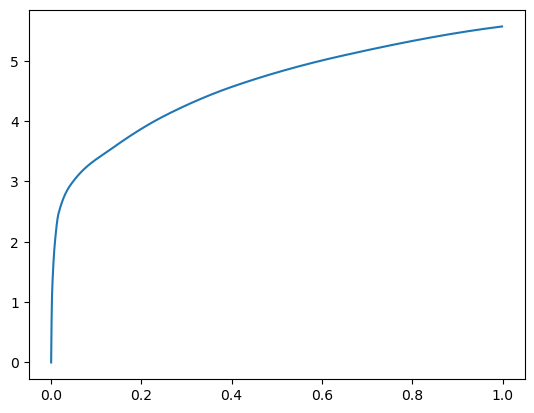

[0.00000000e+00 6.91413879e-04 1.66034698e-03 4.17232513e-03
 8.76712799e-03 1.86681747e-02 5.26189804e-02 1.34148598e-01
 2.41551399e-01 3.96079063e-01 6.32643700e-01 1.00000000e+00] betas
[0.         0.52005199 0.45185113 0.50208678 0.53852379 0.48232984
 0.52901709 0.51411316 0.48757095 0.52757854 0.49600013 0.50719374] r
-22481.378721678564 score post


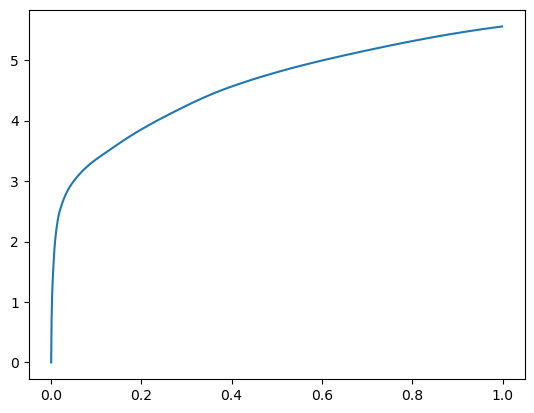

[0.00000000e+00 6.66618347e-04 1.79195404e-03 4.44698334e-03
 8.87775421e-03 1.98717117e-02 5.33418655e-02 1.33746147e-01
 2.45478630e-01 3.93429756e-01 6.33872032e-01 1.00000000e+00] betas
[0.         0.50623566 0.53547961 0.52128447 0.49002898 0.52932526
 0.42770388 0.45783246 0.46471346 0.47624945 0.53457688 0.49457288] r
-22480.269231963164 score post


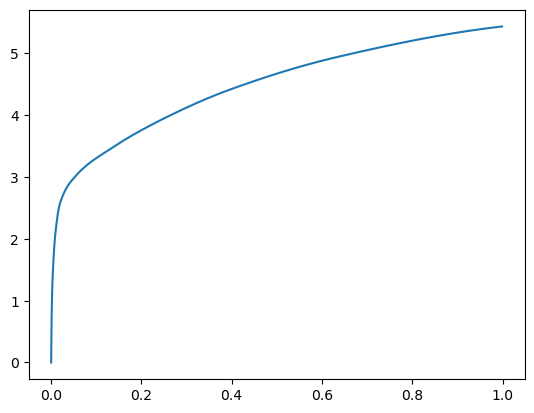

[0.00000000e+00 6.47544861e-04 1.62982941e-03 3.90720367e-03
 7.93743134e-03 1.63393021e-02 4.80794907e-02 1.32225990e-01
 2.51610756e-01 4.08715248e-01 6.33994102e-01 1.00000000e+00] betas
[0.         0.52402531 0.49986325 0.50467747 0.49295191 0.50025509
 0.52511539 0.50445248 0.49356974 0.5110683  0.4823047  0.53506007] r
-22480.269231963164 score post


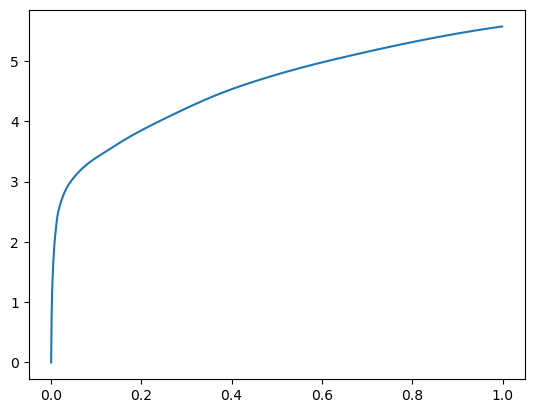

[0.00000000e+00 6.20841980e-04 1.59740448e-03 3.85379791e-03
 7.99846649e-03 1.67398453e-02 4.73546982e-02 1.31279945e-01
 2.53914833e-01 4.10258293e-01 6.50168419e-01 1.00000000e+00] betas
[0.         0.51574099 0.56500337 0.48473359 0.5230165  0.53107865
 0.48923729 0.56510055 0.52275072 0.5020786  0.52810005 0.49680098] r
-22480.269231963164 score post


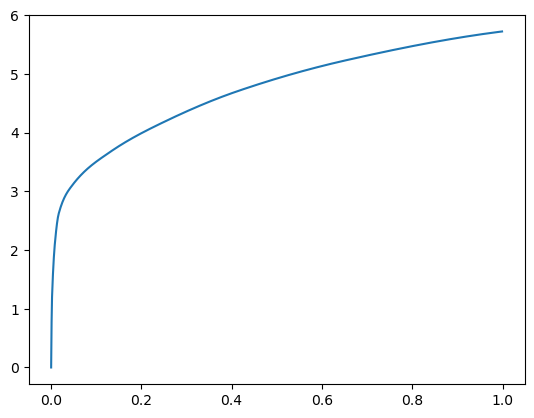

[0.00000000e+00 6.26564026e-04 1.49059296e-03 3.82709503e-03
 7.91645050e-03 1.61619186e-02 4.86688614e-02 1.25283241e-01
 2.44711876e-01 4.04358864e-01 6.36912346e-01 1.00000000e+00] betas
[0.         0.51202303 0.4919975  0.51946305 0.49503081 0.50521709
 0.52952844 0.53715969 0.55198957 0.47904736 0.45602199 0.42539909] r
-22486.246783175764 score post


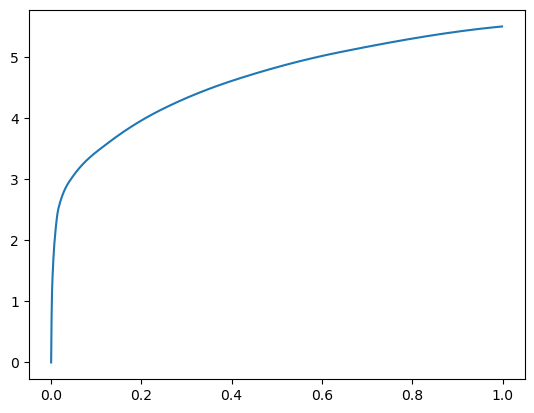

[0.00000000e+00 6.09397888e-04 1.48105621e-03 3.68595123e-03
 7.71427155e-03 1.54714584e-02 4.36868668e-02 1.09490395e-01
 2.09097862e-01 3.57851982e-01 5.89905739e-01 1.00000000e+00] betas
[0.         0.45478062 0.50191489 0.52814655 0.53568957 0.45531806
 0.4631582  0.48987795 0.45798439 0.49051623 0.49233962 0.51221222] r
-22481.378721678564 score post


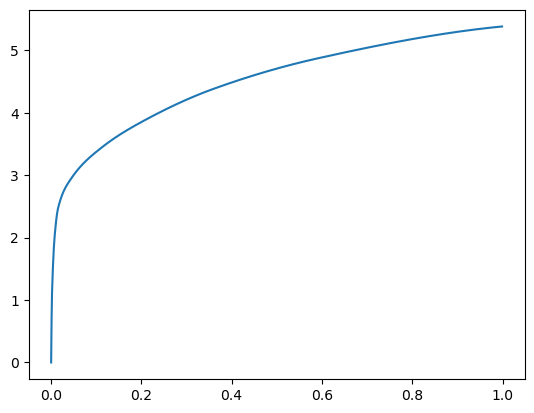

[0.00000000e+00 6.60896301e-04 1.54209137e-03 3.58867645e-03
 7.03716278e-03 1.45654678e-02 4.33702469e-02 1.08796120e-01
 2.16162682e-01 3.67850304e-01 6.04203224e-01 1.00000000e+00] betas
[0.         0.5212151  0.4847692  0.49499991 0.46820676 0.55256816
 0.52968808 0.46246515 0.51807911 0.56546139 0.51537665 0.44657405] r
-22481.378721678564 score post


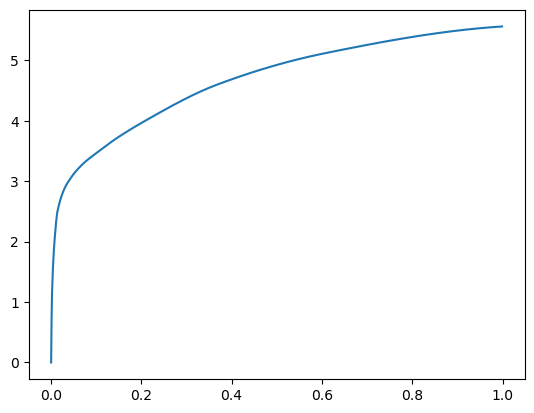

[0.00000000e+00 6.36100769e-04 1.55544281e-03 3.67450714e-03
 7.57122040e-03 1.47237778e-02 4.16193008e-02 1.12936974e-01
 2.18810081e-01 3.51269722e-01 5.68139076e-01 1.00000000e+00] betas
[0.         0.48691499 0.4883296  0.47303287 0.51480021 0.55054137
 0.55457772 0.52117053 0.48562764 0.43731367 0.55018128 0.56419909] r
-22481.378721678564 score post


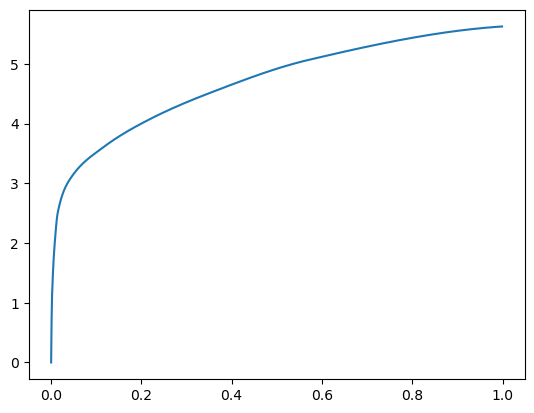

[0.00000000e+00 6.74247742e-04 1.70421600e-03 4.19902802e-03
 8.41045380e-03 1.59597397e-02 4.16975021e-02 1.11401558e-01
 2.23275185e-01 3.82822990e-01 5.97794533e-01 1.00000000e+00] betas
[0.         0.52440467 0.48790667 0.48088764 0.51805696 0.474723
 0.48243849 0.52551877 0.53182744 0.5425425  0.42258124 0.5186515 ] r
-22480.269231963164 score post


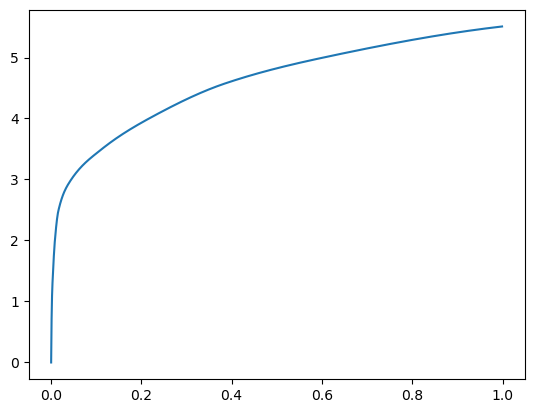

[0.00000000e+00 6.36100769e-04 1.66797638e-03 4.26006317e-03
 8.32080841e-03 1.65414810e-02 4.49781418e-02 1.13455772e-01
 2.18588829e-01 3.60260963e-01 6.09005928e-01 1.00000000e+00] betas
[0.         0.52465253 0.44796047 0.48469917 0.48409552 0.47826309
 0.52222737 0.46901212 0.54409579 0.56178961 0.56062292 0.54139368] r
-22481.378721678564 score post


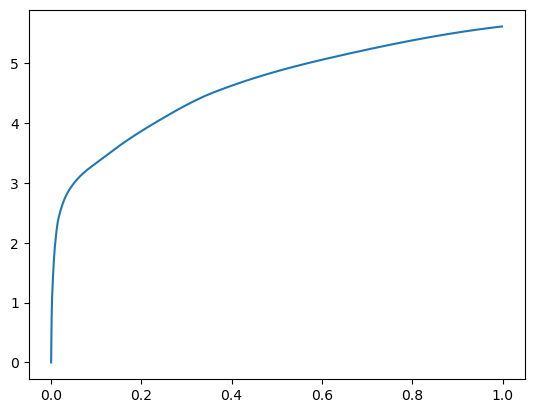

[0.00000000e+00 6.13212585e-04 1.85108185e-03 4.77695465e-03
 9.62162018e-03 2.13232040e-02 5.79404831e-02 1.42268181e-01
 2.47912407e-01 3.88468742e-01 6.26614571e-01 1.00000000e+00] betas
[0.         0.54916807 0.56275707 0.5605973  0.50499463 0.47355553
 0.5155944  0.53154636 0.48654585 0.45770509 0.51148747 0.51525747] r
-22484.568309505095 score post


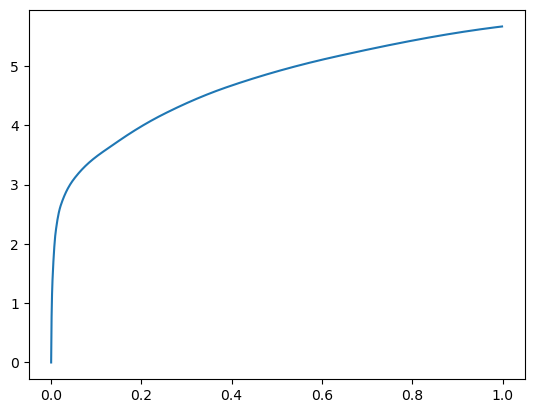

[0.00000000e+00 5.61714172e-04 1.59740448e-03 3.90911102e-03
 8.11290741e-03 1.85060501e-02 5.01737595e-02 1.24978065e-01
 2.32331276e-01 3.86946678e-01 6.26542091e-01 1.00000000e+00] betas
[0.         0.47636296 0.52852921 0.48450196 0.49236269 0.56040325
 0.50790587 0.49128568 0.51155317 0.51926622 0.4968498  0.5450988 ] r
-22480.269231963164 score post


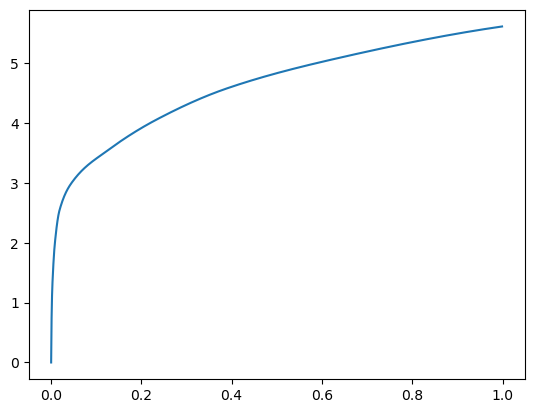

[0.00000000e+00 6.13212585e-04 1.64890289e-03 4.18376923e-03
 8.89682770e-03 1.88646317e-02 5.14192581e-02 1.30631447e-01
 2.39935875e-01 3.95152092e-01 6.46666527e-01 1.00000000e+00] betas
[0.         0.4551647  0.55578729 0.59529708 0.50463452 0.49246889
 0.50005177 0.47530933 0.47486229 0.5233477  0.47379855 0.4568301 ] r
-22485.97414656896 score post


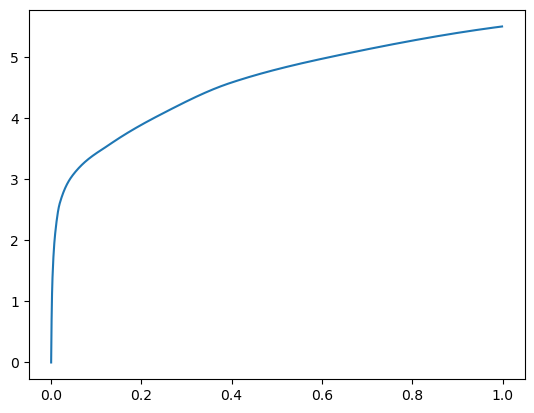

[0.00000000e+00 6.85691833e-04 1.62220001e-03 3.56197357e-03
 7.53307343e-03 1.58720016e-02 4.16269302e-02 1.15571022e-01
 2.27484703e-01 3.68830681e-01 6.18582726e-01 1.00000000e+00] betas
[0.         0.52923983 0.46660488 0.42519749 0.50271536 0.53264335
 0.4484598  0.48599568 0.50356031 0.50107456 0.56378208 0.52813863] r
-22480.269231963164 score post


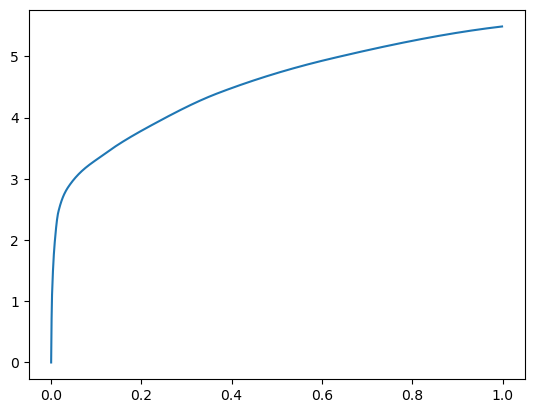

[0.00000000e+00 6.38008118e-04 1.62792206e-03 4.03118134e-03
 8.35895538e-03 1.71613693e-02 5.08718491e-02 1.35035515e-01
 2.51898766e-01 4.03296471e-01 6.35445595e-01 1.00000000e+00] betas
[0.         0.4945737  0.51359403 0.50524073 0.52588775 0.51704236
 0.52529241 0.51749991 0.53218349 0.5075275  0.45692807 0.43282691] r
-22480.269231963164 score post


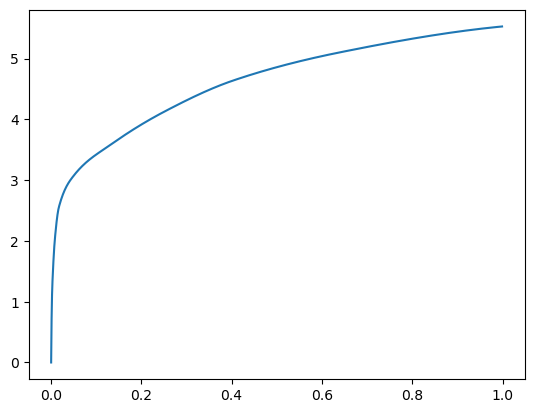

[0.00000000e+00 6.51359558e-04 1.61838531e-03 3.99494171e-03
 8.02135468e-03 1.58586502e-02 4.40511703e-02 1.19090080e-01
 2.24499702e-01 3.62187386e-01 5.91311455e-01 1.00000000e+00] betas
[0.         0.48372639 0.51960646 0.49488444 0.51381123 0.54547729
 0.47169937 0.52414609 0.52148728 0.43756269 0.53926596 0.54859088] r
-22481.990460408004 score post


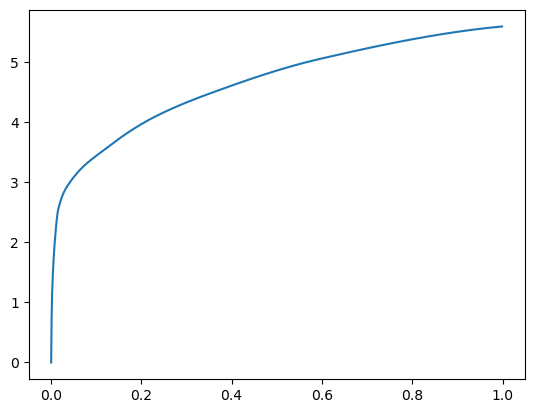

[0.00000000e+00 6.91413879e-04 1.66606903e-03 4.17613983e-03
 8.28456879e-03 1.54962540e-02 4.65211868e-02 1.20881081e-01
 2.24007607e-01 3.87818336e-01 6.13945961e-01 1.00000000e+00] betas
[0.         0.52604328 0.45649277 0.5160551  0.47492606 0.48328272
 0.55851384 0.54481132 0.47708116 0.54492877 0.49103476 0.49528896] r
-22482.597739918583 score post


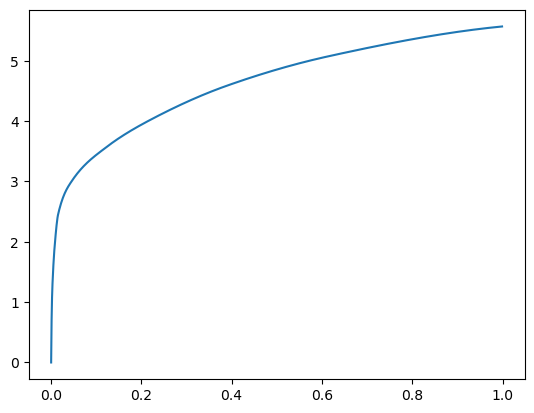

[0.00000000e+00 6.58988953e-04 1.76715851e-03 4.30965424e-03
 8.87966156e-03 1.79243088e-02 4.85429764e-02 1.17987633e-01
 2.27227211e-01 3.78148079e-01 6.07382774e-01 1.00000000e+00] betas
[0.         0.50002972 0.52384748 0.50206682 0.49704055 0.47055846
 0.45126923 0.49468861 0.50727837 0.50106305 0.47738154 0.52815318] r
-22480.269231963164 score post


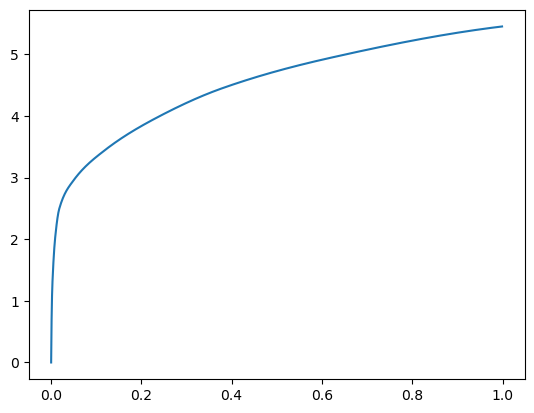

582301 steps_after


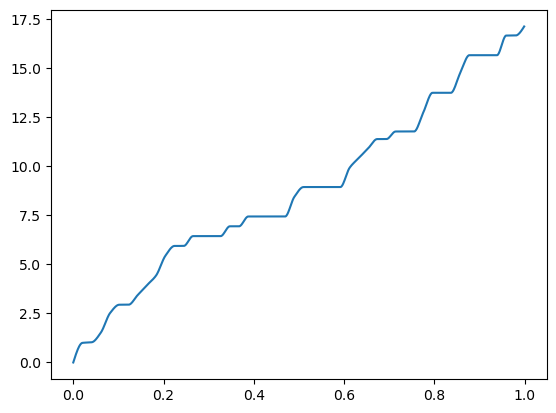

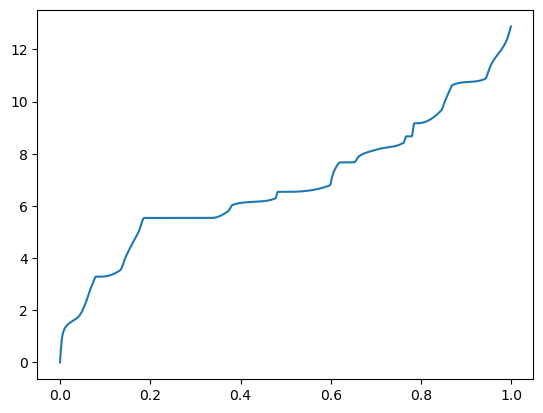

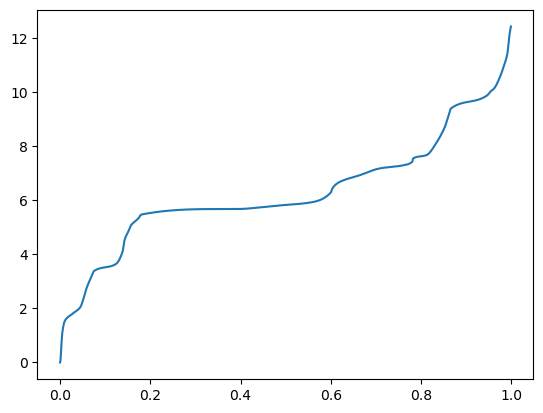

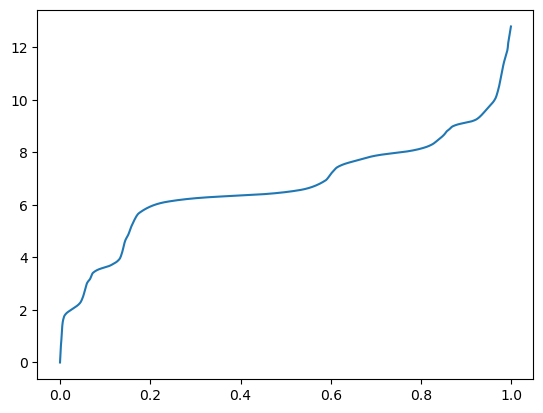

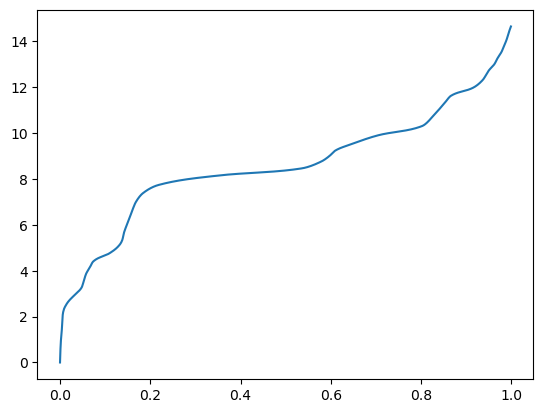

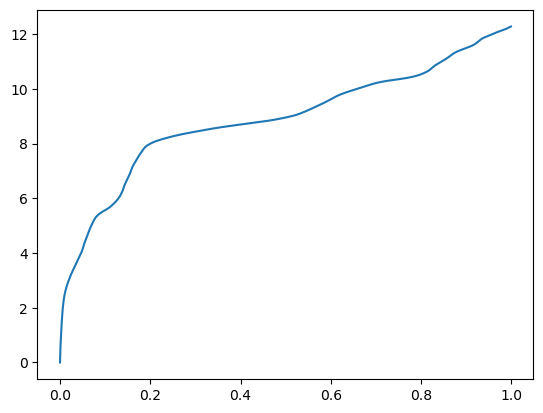

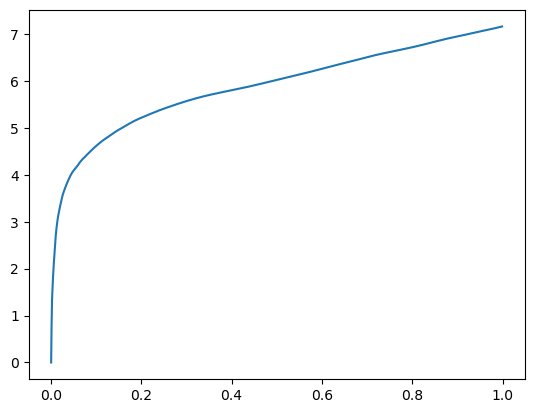

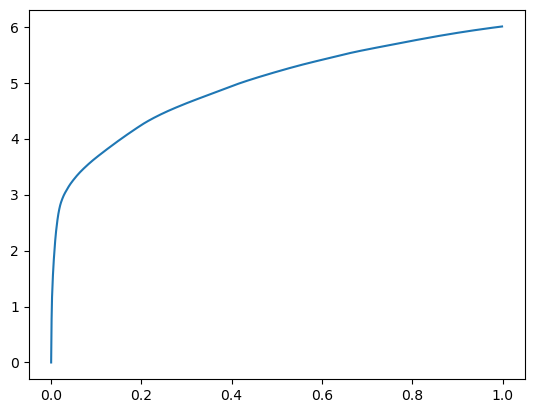

11438 steps
betas [0.00000000e+00 6.49452209e-04 1.74427032e-03 4.48322296e-03
 9.05323029e-03 1.77488327e-02 5.06277084e-02 1.25529289e-01
 2.26651192e-01 3.91615868e-01 6.25674248e-01 1.00000000e+00]
n_chains 12
[0.00000000e+00 6.49452209e-04 1.74427032e-03 4.48322296e-03
 9.05323029e-03 1.77488327e-02 5.06277084e-02 1.25529289e-01
 2.26651192e-01 3.91615868e-01 6.25674248e-01 1.00000000e+00] betas
[0.00000000e+00 1.31811478e-04 0.00000000e+00 0.00000000e+00
 0.00000000e+00 2.18115511e-02 2.60575369e-01 1.60730322e-01
 2.10663429e-01 0.00000000e+00 0.00000000e+00 0.00000000e+00] r
-22480.269231963164 score post


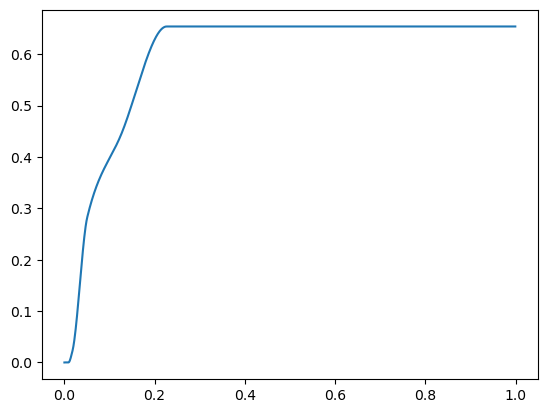

[0.         0.0242815  0.03093624 0.03686047 0.04331112 0.05484867
 0.07735348 0.1112051  0.13927174 0.16120243 0.18373394 1.        ] betas
[0.         0.99521818 0.14737112 0.09704487 0.08417917 0.11989717
 0.18331975 0.22909795 0.16900677 0.12764254 0.11659603 0.97208472] r
-22481.378721678564 score post


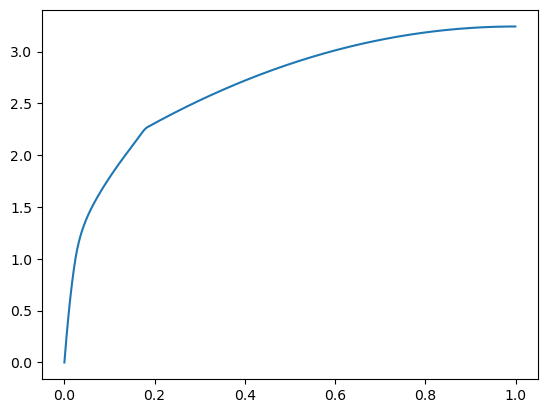

[0.         0.00565052 0.01226521 0.02047825 0.03296185 0.05813122
 0.09757519 0.14560604 0.22111988 0.36262226 0.54797649 1.        ] betas
[0.         0.92240541 0.55471387 0.35212278 0.26856984 0.28145348
 0.32154609 0.30093032 0.37682859 0.51861511 0.45717153 0.57831288] r
-22480.269231963164 score post


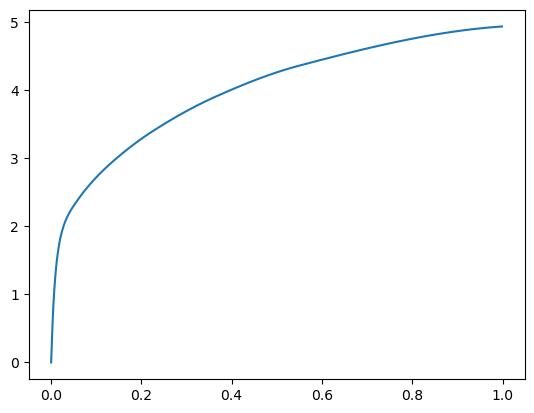

[0.         0.00238514 0.00542736 0.01024342 0.01933575 0.04420376
 0.09613705 0.17094326 0.27229977 0.4107542  0.622962   1.        ] betas
[0.         0.83518025 0.50627769 0.51202794 0.44018414 0.43130208
 0.4191072  0.45289344 0.47115982 0.43595233 0.42234692 0.46450535] r
-22480.269231963164 score post


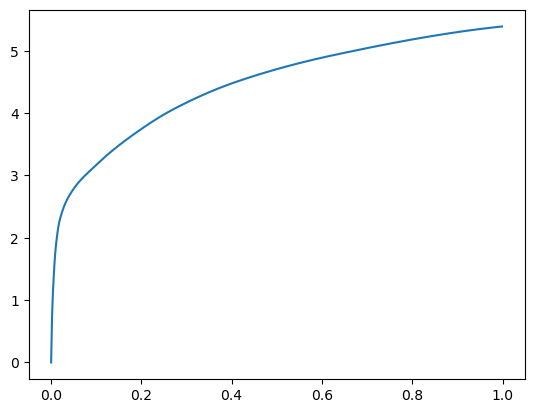

[0.         0.00122738 0.0030756  0.00643063 0.01187611 0.02585888
 0.06709957 0.14101315 0.23669147 0.37558842 0.60682583 1.        ] betas
[0.         0.6718043  0.51410851 0.49498603 0.52745112 0.49753381
 0.46384479 0.43083105 0.45763343 0.44784466 0.50567141 0.48114232] r
-22481.621781595804 score post


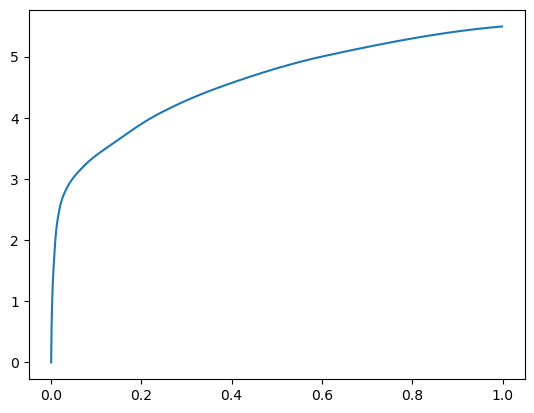

[0.00000000e+00 8.40187073e-04 2.25734711e-03 4.97722626e-03
 9.25159454e-03 1.81589127e-02 4.67500687e-02 1.20491982e-01
 2.21209526e-01 3.71125221e-01 5.95734596e-01 1.00000000e+00] betas
[0.         0.58246852 0.56079926 0.48457829 0.48284422 0.46469458
 0.3714454  0.44125286 0.46934762 0.54181778 0.52116564 0.51772379] r
-22485.59168285815 score post


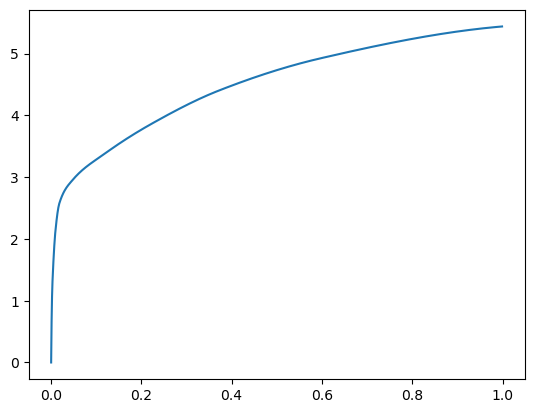

[0.00000000e+00 6.81877136e-04 1.75762177e-03 3.97968292e-03
 7.77530670e-03 1.51548386e-02 4.90293503e-02 1.34493828e-01
 2.45240211e-01 3.88840675e-01 6.09539986e-01 1.00000000e+00] betas
[0.         0.53948763 0.50574541 0.46436397 0.45559092 0.48425968
 0.52545494 0.51779324 0.49975425 0.44074332 0.48541956 0.49674312] r
-22484.89423354312 score post


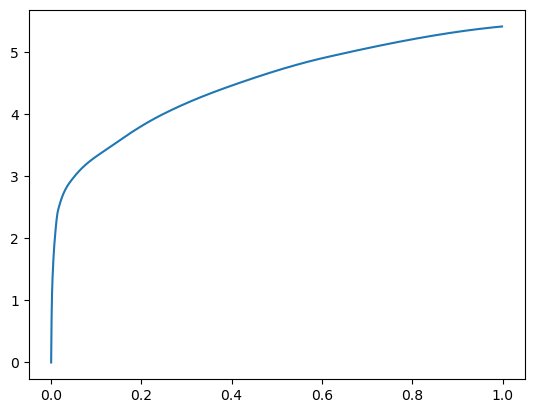

[0.00000000e+00 6.07490540e-04 1.57642365e-03 3.77178192e-03
 7.82108307e-03 1.55763626e-02 4.67557907e-02 1.25306129e-01
 2.31045723e-01 3.87898445e-01 6.12227440e-01 1.00000000e+00] betas
[0.         0.48510293 0.53292375 0.41662558 0.47866866 0.50142726
 0.51297646 0.5675745  0.5179609  0.48928223 0.46159983 0.49196776] r
-22480.269231963164 score post


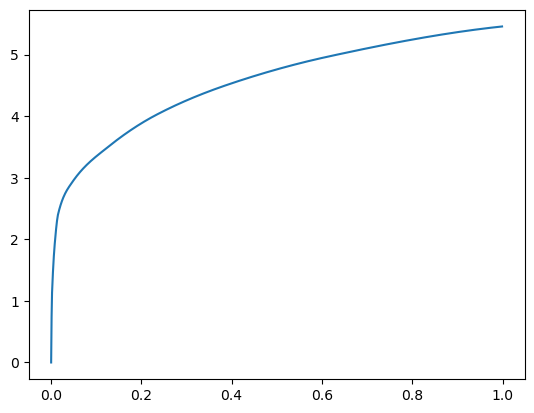

[0.00000000e+00 6.24656677e-04 1.49822235e-03 4.13608551e-03
 8.65077972e-03 1.78861618e-02 5.14402390e-02 1.21342659e-01
 2.19696999e-01 3.72857094e-01 6.09715462e-01 1.00000000e+00] betas
[0.         0.49384374 0.41928917 0.5381296  0.51035338 0.52083739
 0.520689   0.54165987 0.46912572 0.51421702 0.50940297 0.48822273] r
-22482.458794922564 score post


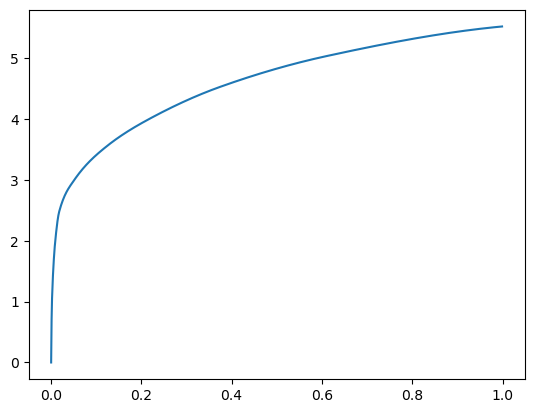

[0.00000000e+00 6.38008118e-04 1.81484222e-03 4.51755524e-03
 9.26876068e-03 1.89828873e-02 5.24606705e-02 1.16629601e-01
 2.20904350e-01 3.70219231e-01 6.01088524e-01 1.00000000e+00] betas
[0.         0.52551251 0.49363047 0.47757143 0.47894872 0.44634388
 0.45218685 0.42174966 0.49264471 0.48636604 0.50287545 0.4946688 ] r
-22480.269231963164 score post


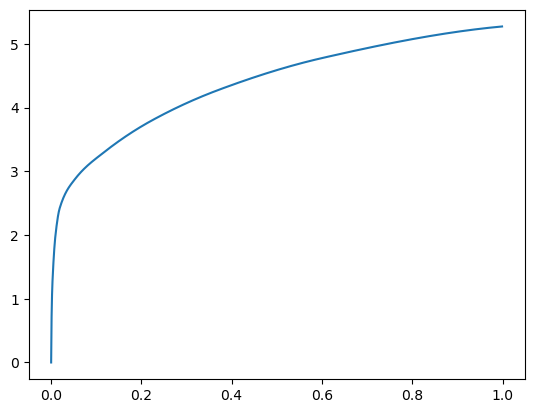

[0.00000000e+00 5.63621521e-04 1.60694122e-03 4.07695770e-03
 8.46195221e-03 1.79967880e-02 5.26475906e-02 1.27448082e-01
 2.32857704e-01 3.85050774e-01 6.10589027e-01 1.00000000e+00] betas
[0.         0.48967773 0.51781259 0.50635176 0.53291553 0.53224221
 0.50045864 0.53020862 0.48772883 0.58614266 0.52798765 0.48659593] r
-22480.269231963164 score post


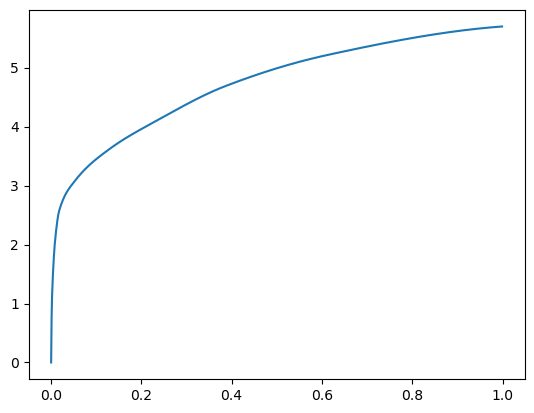

[0.00000000e+00 6.07490540e-04 1.70230865e-03 4.33635712e-03
 8.78047943e-03 1.84278488e-02 5.55791855e-02 1.30368233e-01
 2.43884087e-01 3.77959251e-01 5.92448235e-01 1.00000000e+00] betas
[0.         0.47597087 0.52677151 0.50628168 0.49707898 0.53724439
 0.56432534 0.49311911 0.54617648 0.4274559  0.49413761 0.53097504] r
-22483.2822716802 score post


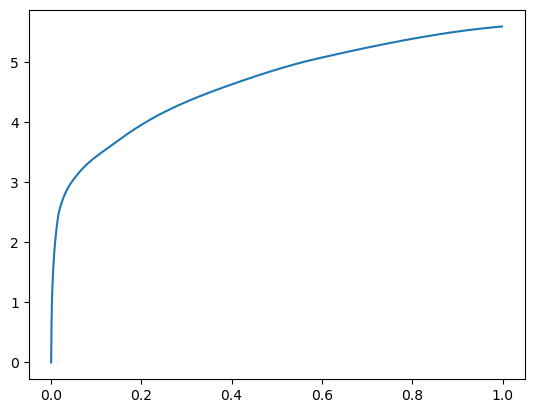

[0.00000000e+00 6.62803650e-04 1.75571442e-03 4.46224213e-03
 9.17148590e-03 1.84984207e-02 5.00612259e-02 1.23610497e-01
 2.25386620e-01 3.80551338e-01 6.05284691e-01 1.00000000e+00] betas
[0.         0.51615181 0.50908945 0.52931857 0.52128216 0.48869456
 0.46853983 0.47538098 0.49367785 0.51574716 0.49137994 0.48301754] r
-22480.269231963164 score post


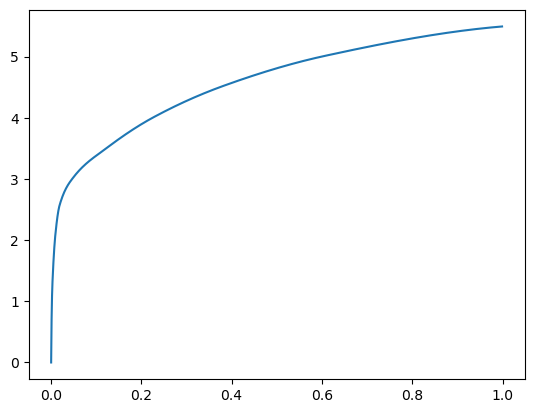

[0.00000000e+00 6.34193420e-04 1.66988373e-03 4.07505035e-03
 8.21018219e-03 1.64098740e-02 4.61606979e-02 1.21199608e-01
 2.23456383e-01 3.71615410e-01 5.95356941e-01 1.00000000e+00] betas
[0.         0.45458559 0.5546317  0.52281027 0.50072979 0.50467762
 0.47831184 0.50857133 0.55081691 0.50976599 0.48856664 0.54298012] r
-22480.269231963164 score post


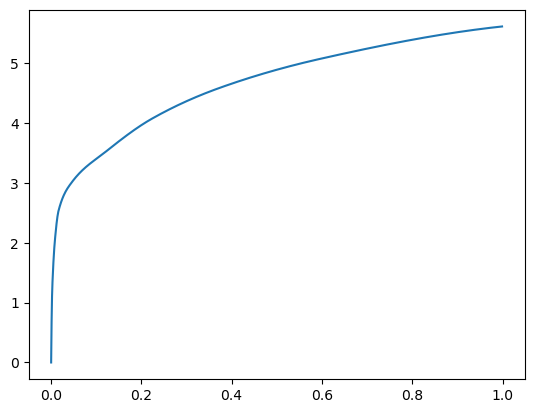

[0.00000000e+00 7.23838806e-04 1.70612335e-03 4.07314301e-03
 8.32462311e-03 1.69572830e-02 5.10606766e-02 1.29467964e-01
 2.25708961e-01 3.75452995e-01 6.14497185e-01 1.00000000e+00] betas
[0.         0.57819168 0.46490816 0.47663059 0.5279526  0.49201122
 0.5352605  0.52238092 0.46183721 0.52910058 0.53049842 0.48333908] r
-22485.59168285815 score post


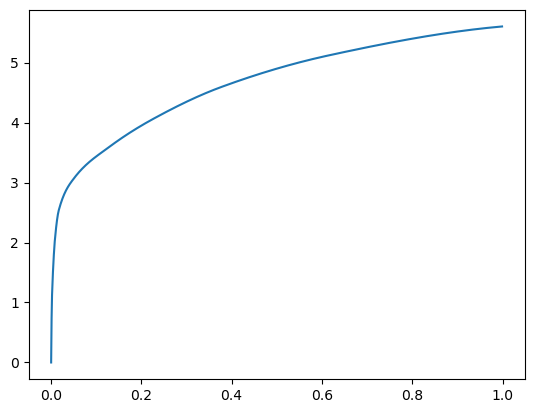

[0.00000000e+00 6.15119934e-04 1.62792206e-03 4.12464142e-03
 8.19683075e-03 1.72014236e-02 4.91113663e-02 1.23627663e-01
 2.29384422e-01 3.73755455e-01 5.99028587e-01 1.00000000e+00] betas
[0.         0.51105987 0.52359476 0.51263393 0.52875312 0.52325901
 0.4678493  0.4942685  0.53126092 0.44107745 0.45397735 0.50899078] r
-22481.990460408004 score post


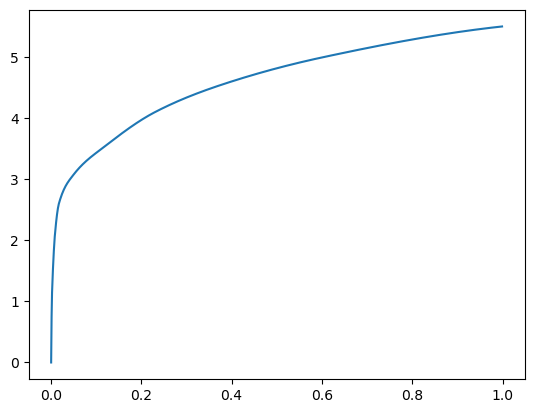

[0.00000000e+00 5.97953796e-04 1.52492523e-03 3.82518768e-03
 7.38811493e-03 1.44853592e-02 4.19263840e-02 1.12334251e-01
 2.06612587e-01 3.59217644e-01 6.04874611e-01 1.00000000e+00] betas
[0.         0.52521641 0.47477968 0.51079315 0.47302478 0.51113366
 0.59263839 0.53134158 0.45620758 0.56273006 0.54218324 0.51207741] r
-22483.343010040644 score post


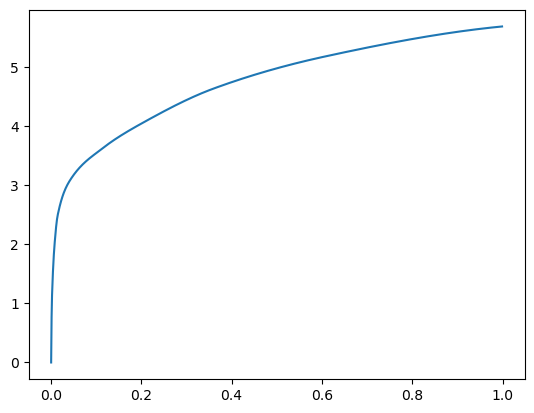

[0.00000000e+00 5.86509705e-04 1.63364410e-03 4.07505035e-03
 8.29792023e-03 1.71136856e-02 4.33740616e-02 1.12895012e-01
 2.21972466e-01 3.66127968e-01 6.01653099e-01 1.00000000e+00] betas
[0.         0.48453932 0.52870539 0.53822259 0.50802352 0.50814457
 0.43842171 0.48432143 0.53209987 0.47284015 0.48116299 0.57739471] r
-22484.59972536877 score post


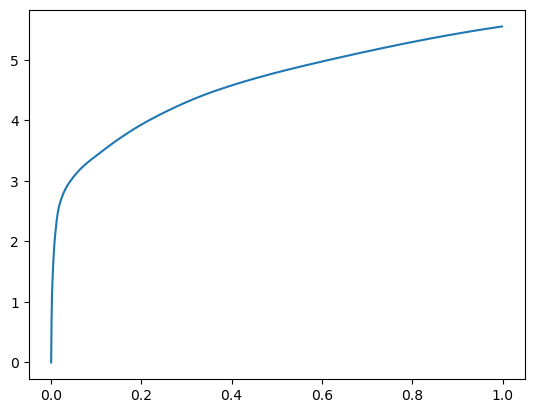

[0.00000000e+00 6.18934631e-04 1.62220001e-03 3.84807587e-03
 7.83061981e-03 1.58243179e-02 4.56418991e-02 1.20533943e-01
 2.26212502e-01 3.85577202e-01 6.44261360e-01 1.00000000e+00] betas
[0.         0.46204639 0.4822493  0.52249313 0.47822511 0.54169392
 0.52490521 0.55143442 0.45913154 0.53539782 0.57954632 0.47850495] r
-22488.606853608253 score post


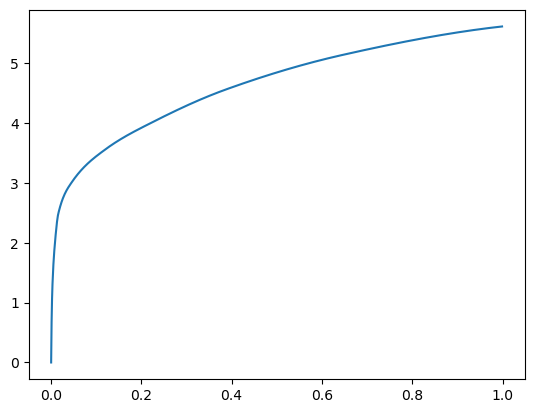

[0.00000000e+00 7.00950623e-04 1.86443329e-03 4.25815582e-03
 8.93115997e-03 1.80196762e-02 5.04579544e-02 1.22445107e-01
 2.42548943e-01 3.99252892e-01 6.25914574e-01 1.00000000e+00] betas
[0.         0.52090773 0.5447025  0.49948353 0.52477074 0.50183778
 0.54945439 0.49632074 0.5433996  0.52277748 0.46730091 0.45615542] r
-22481.990460408004 score post


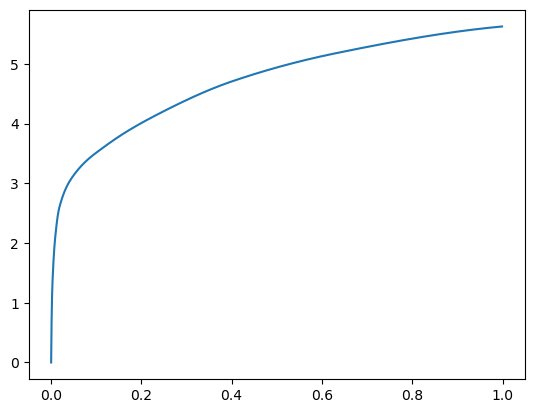

[0.00000000e+00 6.85691833e-04 1.73473358e-03 4.05979156e-03
 8.38947296e-03 1.69706345e-02 4.38337326e-02 1.12139702e-01
 2.20059395e-01 3.63598824e-01 5.92049599e-01 1.00000000e+00] betas
[0.         0.52861541 0.49026065 0.46470517 0.51354682 0.48428499
 0.43699048 0.50329004 0.49479998 0.49269018 0.50268271 0.56065193] r
-22486.66798142288 score post


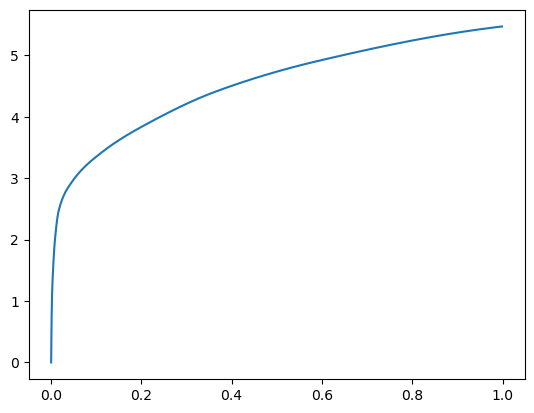

[0.00000000e+00 6.34193420e-04 1.65843964e-03 4.11891937e-03
 8.30173492e-03 1.71899796e-02 5.03263474e-02 1.23026848e-01
 2.36294746e-01 3.89264107e-01 6.28943443e-01 1.00000000e+00] betas
[0.         0.47768972 0.49785721 0.53883773 0.50241251 0.52651403
 0.55690355 0.50438211 0.50492345 0.45281229 0.54111675 0.46614022] r
-22488.33215415467 score post


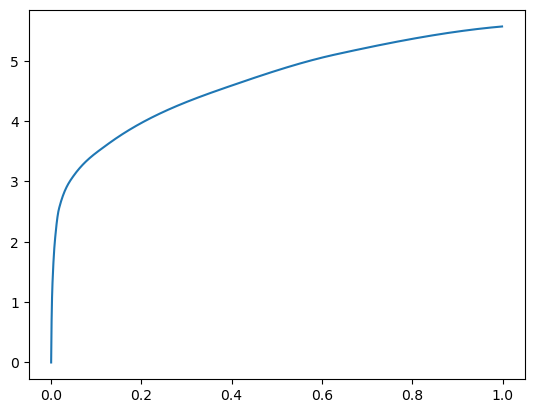

[0.00000000e+00 6.81877136e-04 1.77669525e-03 4.14752960e-03
 8.40473175e-03 1.68123245e-02 4.44612503e-02 1.12008095e-01
 2.20339775e-01 3.87179375e-01 6.05734825e-01 1.00000000e+00] betas
[0.         0.54936561 0.52681797 0.47439519 0.51899675 0.46804644
 0.48030856 0.47326922 0.52375733 0.54789677 0.47481448 0.51875882] r
-22480.269231963164 score post


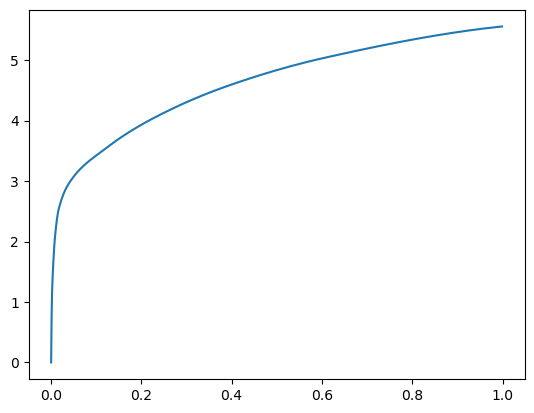

[0.00000000e+00 6.13212585e-04 1.58214569e-03 3.92055511e-03
 7.83634186e-03 1.64194107e-02 4.56838608e-02 1.19814873e-01
 2.26965904e-01 3.80911827e-01 6.13873482e-01 1.00000000e+00] betas
[0.         0.44021908 0.48873133 0.49718857 0.54063444 0.55969638
 0.49869773 0.48974704 0.45466379 0.50814294 0.54591553 0.51835956] r
-22484.348661750126 score post


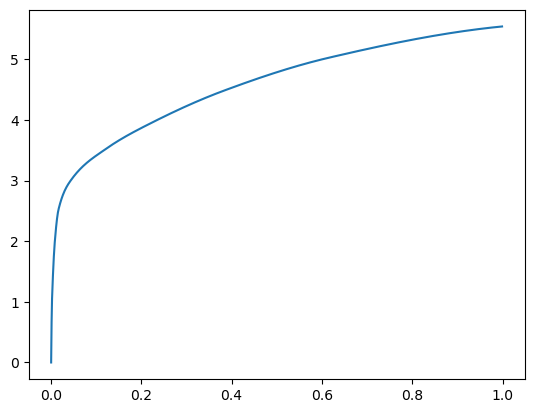

[0.00000000e+00 7.20024109e-04 1.84535980e-03 4.42981720e-03
 8.36658478e-03 1.61848068e-02 4.54626083e-02 1.22084618e-01
 2.43432045e-01 4.01518822e-01 6.22220039e-01 1.00000000e+00] betas
[0.         0.55061898 0.51564393 0.56352531 0.46536072 0.42156594
 0.44807667 0.53025288 0.61014115 0.55595305 0.41754045 0.48559596] r
-22483.343010040644 score post


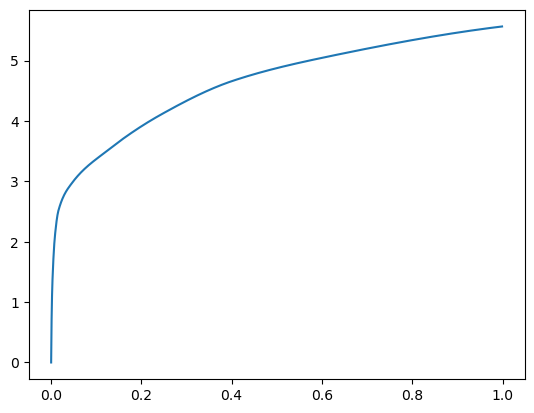

[0.00000000e+00 6.45637512e-04 1.68132782e-03 3.75652313e-03
 7.53498077e-03 1.66578293e-02 5.27753830e-02 1.29939079e-01
 2.29735374e-01 3.62967491e-01 6.09251976e-01 1.00000000e+00] betas
[0.         0.50506864 0.48858235 0.44373889 0.52006693 0.54646367
 0.58956761 0.53610355 0.45077175 0.40935093 0.54146201 0.58507425] r
-22480.269231963164 score post


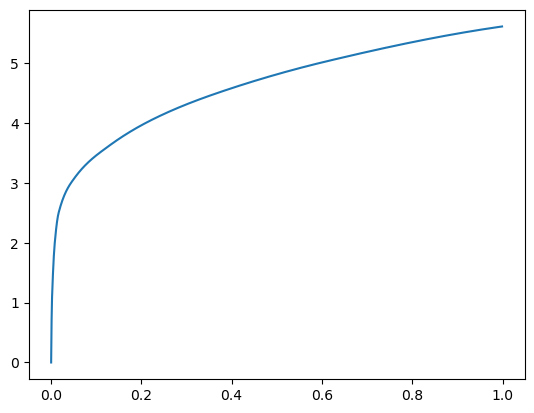

[0.00000000e+00 6.55174255e-04 1.77288055e-03 4.31728363e-03
 8.52680206e-03 1.84030533e-02 4.98418808e-02 1.19822502e-01
 2.30870247e-01 4.04547691e-01 6.50977135e-01 1.00000000e+00] betas
[0.         0.48559794 0.55054103 0.53038429 0.50724567 0.49923267
 0.49633453 0.46763726 0.55770969 0.55922448 0.44411775 0.42820295] r
-22481.621781595804 score post


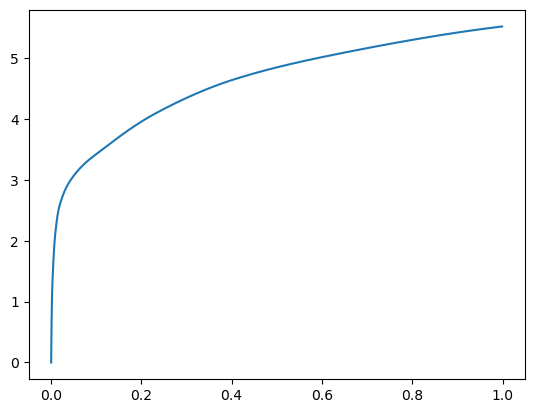

[0.00000000e+00 6.83784485e-04 1.67751312e-03 3.94153595e-03
 7.76958466e-03 1.64422989e-02 4.44612503e-02 1.16282463e-01
 2.12830544e-01 3.54062080e-01 6.01716042e-01 1.00000000e+00] betas
[0.         0.54062473 0.49668101 0.48829716 0.46543663 0.50982959
 0.48358734 0.44961433 0.45273465 0.52012235 0.57243208 0.51217543] r
-22483.215759872455 score post


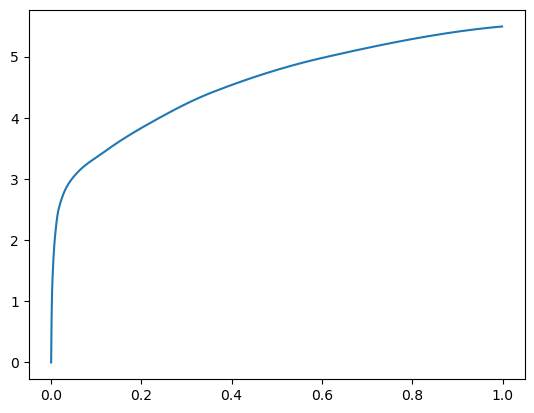

[0.00000000e+00 6.18934631e-04 1.56497955e-03 3.76796722e-03
 7.84015656e-03 1.62858963e-02 4.55808640e-02 1.27711296e-01
 2.38837242e-01 3.84482384e-01 6.09391212e-01 1.00000000e+00] betas
[0.         0.51856018 0.51820386 0.46210977 0.5164878  0.49981702
 0.47926679 0.53183719 0.52630332 0.48283417 0.4885007  0.51375774] r
-22484.55452125251 score post


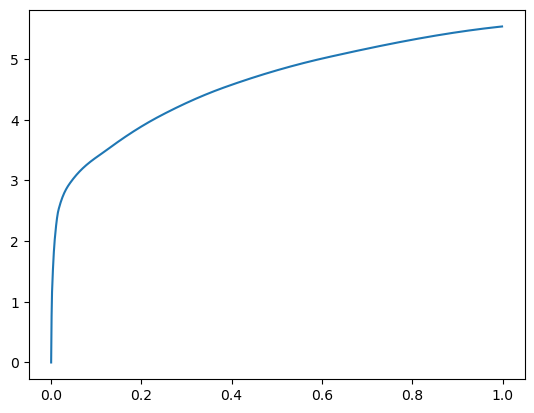

[0.00000000e+00 5.96046448e-04 1.47914886e-03 3.83853912e-03
 7.82108307e-03 1.63545609e-02 4.82530594e-02 1.27291679e-01
 2.32506752e-01 3.82763863e-01 6.15569115e-01 1.00000000e+00] betas
[0.         0.48247923 0.45254181 0.5544552  0.48819055 0.5104996
 0.52862486 0.48876638 0.44062004 0.49426417 0.57376325 0.4791753 ] r
-22484.348661750126 score post


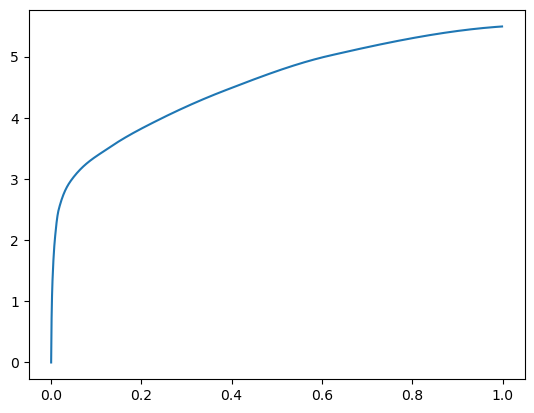

[0.00000000e+00 6.22749329e-04 1.67179108e-03 3.89194489e-03
 8.05950165e-03 1.66597366e-02 4.61587906e-02 1.25342369e-01
 2.45841026e-01 4.01797295e-01 6.04058266e-01 1.00000000e+00] betas
[0.         0.44307951 0.46883946 0.46769143 0.51084895 0.57232242
 0.46369397 0.51635613 0.50428213 0.5308777  0.47931049 0.53404092] r
-22480.269231963164 score post


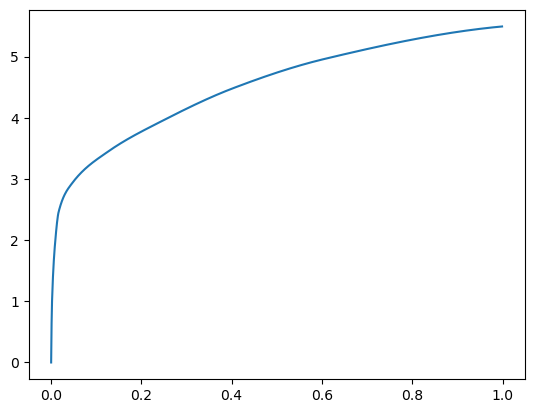

[0.00000000e+00 7.23838806e-04 1.97887421e-03 4.66823578e-03
 9.26876068e-03 1.78537369e-02 5.35058975e-02 1.35577202e-01
 2.58238792e-01 4.07113075e-01 6.23818398e-01 1.00000000e+00] betas
[0.         0.54372658 0.56534217 0.52687696 0.51167933 0.49500646
 0.51149583 0.50637591 0.61581535 0.46020951 0.45088648 0.45977658] r
-22485.59168285815 score post


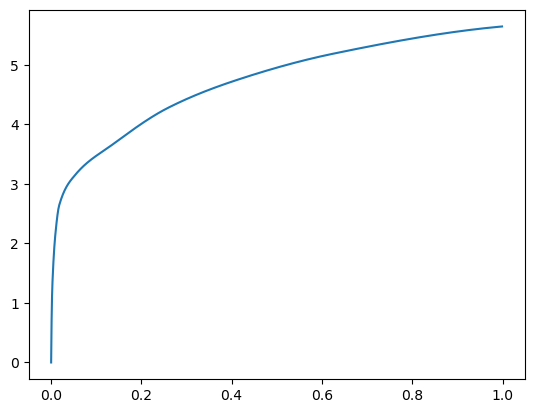

[0.00000000e+00 6.72340393e-04 1.72710419e-03 4.02927399e-03
 8.17394257e-03 1.57442093e-02 4.54244614e-02 1.23114586e-01
 2.19388008e-01 3.63251686e-01 5.91530800e-01 1.00000000e+00] betas
[0.         0.51278668 0.49915204 0.49964618 0.49508052 0.43639595
 0.51971366 0.5263873  0.45641625 0.4900216  0.57063557 0.46219729] r
-22483.17300509828 score post


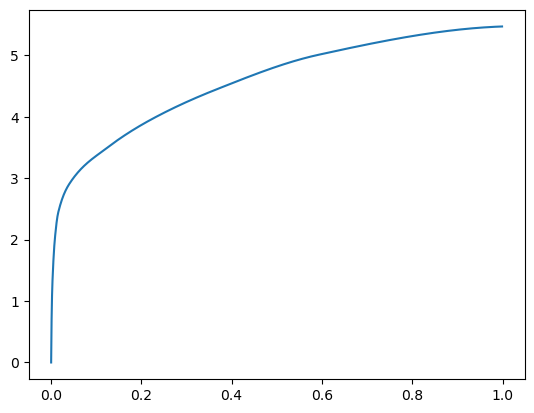

[0.00000000e+00 6.45637512e-04 1.67179108e-03 3.90338898e-03
 7.95459747e-03 1.72052383e-02 4.73661423e-02 1.21459007e-01
 2.27316856e-01 3.76467705e-01 5.71351051e-01 1.00000000e+00] betas
[0.         0.51348031 0.54682168 0.48795086 0.57996474 0.55052668
 0.40830286 0.44260388 0.50542503 0.51020368 0.43802518 0.56808046] r
-22480.269231963164 score post


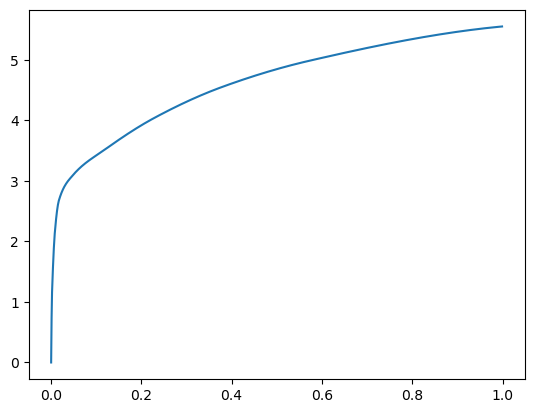

[0.00000000e+00 6.32286072e-04 1.53255463e-03 3.70693207e-03
 6.92653656e-03 1.33695602e-02 4.05855179e-02 1.22029305e-01
 2.27887154e-01 3.75287056e-01 6.08492851e-01 1.00000000e+00] betas
[0.         0.49263079 0.46208606 0.5230638  0.44551197 0.50083659
 0.61724263 0.56393004 0.51234824 0.47928266 0.56728967 0.54436759] r
-22485.2760344757 score post


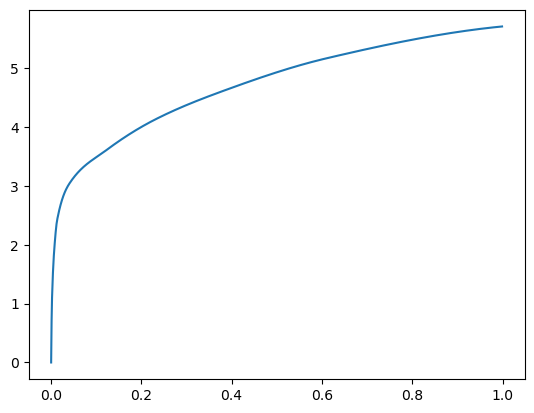

[0.00000000e+00 6.74247742e-04 1.78623199e-03 4.16469574e-03
 8.46576691e-03 1.81417465e-02 4.71696854e-02 1.26841545e-01
 2.36668587e-01 4.01671410e-01 6.22574806e-01 1.00000000e+00] betas
[0.         0.52016823 0.52033188 0.48819939 0.54291761 0.55281491
 0.48970037 0.52182865 0.4761692  0.5222154  0.48842016 0.51984686] r
-22484.4517533122 score post


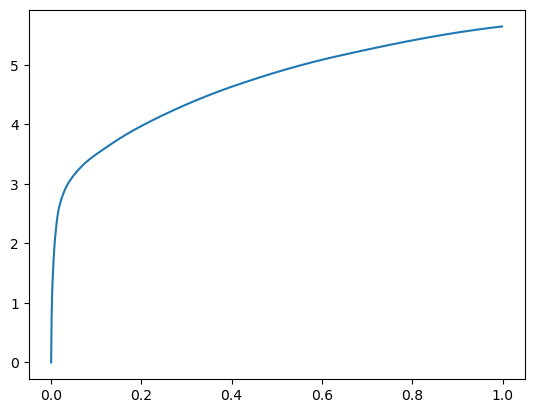

[0.00000000e+00 6.62803650e-04 1.73854828e-03 4.22763824e-03
 8.23497772e-03 1.64003372e-02 4.36773300e-02 1.18130684e-01
 2.34398842e-01 3.95001411e-01 6.26551628e-01 1.00000000e+00] betas
[0.         0.49741229 0.49903077 0.54877702 0.47487816 0.51135979
 0.50745986 0.53635514 0.54389946 0.51696628 0.50512699 0.5365913 ] r
-22484.348661750126 score post


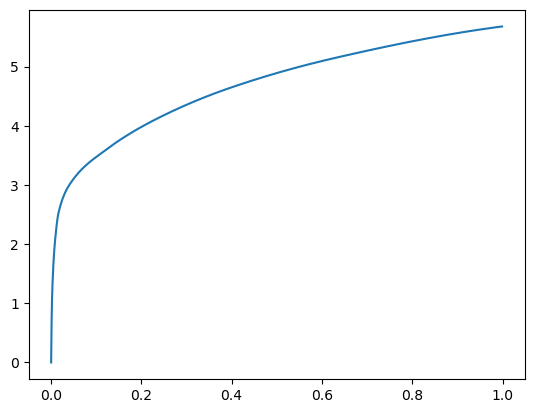

[0.00000000e+00 6.95228577e-04 1.85489655e-03 4.24861908e-03
 8.76522064e-03 1.80101395e-02 4.91113663e-02 1.24798775e-01
 2.37048149e-01 3.98577690e-01 6.38188362e-01 1.00000000e+00] betas
[0.         0.53344846 0.52909857 0.46281    0.55172662 0.50870697
 0.49086168 0.52035282 0.53945069 0.43643797 0.5059383  0.48376635] r
-22480.269231963164 score post


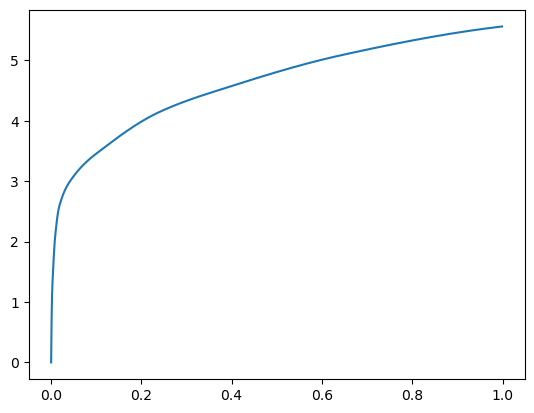

[0.00000000e+00 6.49452209e-04 1.69277191e-03 4.19521332e-03
 8.13770294e-03 1.62725449e-02 4.49495316e-02 1.14649773e-01
 2.13433266e-01 3.89470100e-01 6.25258446e-01 1.00000000e+00] betas
[0.         0.51291923 0.54487878 0.55903647 0.47090462 0.45590972
 0.48304335 0.50928419 0.53217456 0.56468007 0.52807551 0.53238033] r
-22480.269231963164 score post


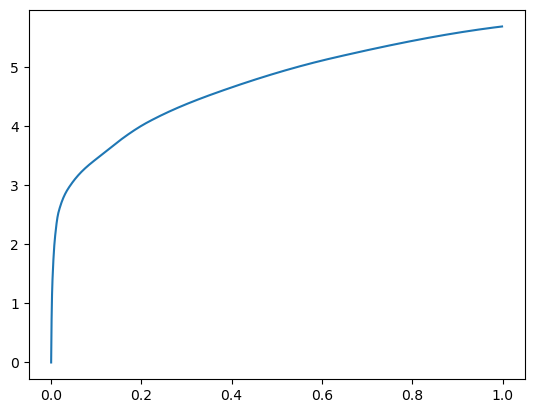

[0.00000000e+00 6.57081604e-04 1.62792206e-03 3.80229950e-03
 7.92407990e-03 1.78613663e-02 5.27009964e-02 1.28727913e-01
 2.31577873e-01 3.99039268e-01 6.33652687e-01 1.00000000e+00] betas
[0.         0.52139445 0.44565867 0.46032535 0.50642286 0.56713523
 0.52932464 0.49101645 0.47153465 0.51128479 0.52543471 0.50392163] r
-22482.458794922564 score post


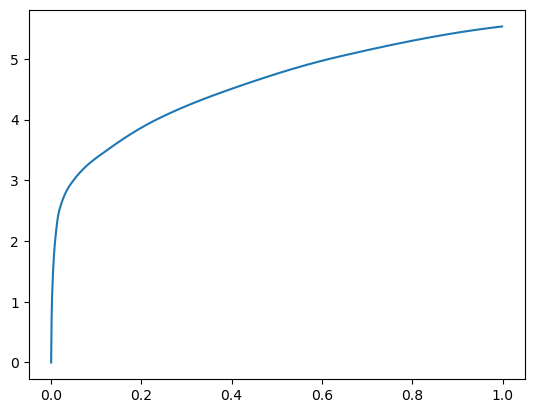

[0.00000000e+00 6.26564026e-04 1.75952911e-03 4.32682037e-03
 8.90254974e-03 1.83973312e-02 5.14402390e-02 1.28729820e-01
 2.40143776e-01 4.07999992e-01 6.34160042e-01 1.00000000e+00] betas
[0.         0.47865187 0.53250088 0.49523859 0.52187981 0.50847547
 0.46022932 0.54649014 0.49125485 0.57788612 0.43946046 0.44043149] r
-22484.25291812412 score post


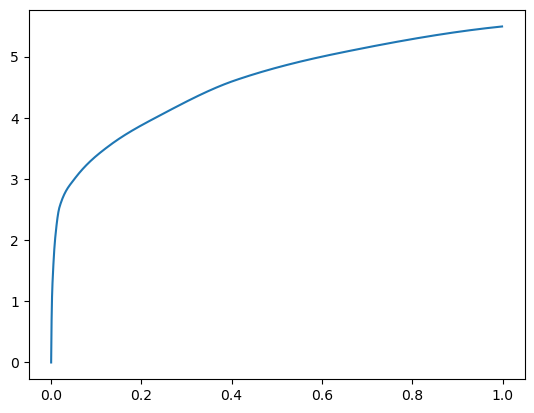

[0.00000000e+00 6.60896301e-04 1.71756744e-03 4.26959991e-03
 8.51345062e-03 1.70431137e-02 5.13315201e-02 1.20064735e-01
 2.29832649e-01 3.66141319e-01 5.96545219e-01 1.00000000e+00] betas
[0.         0.52777226 0.51612319 0.48910369 0.51621873 0.49215879
 0.53589429 0.49815902 0.53628769 0.48352326 0.51795198 0.51941849] r
-22480.269231963164 score post


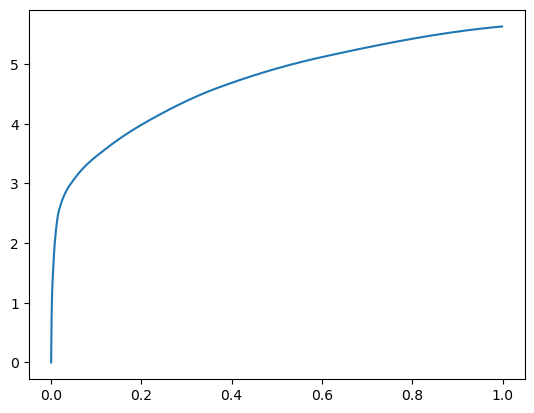

[0.00000000e+00 6.36100769e-04 1.65271759e-03 4.29058075e-03
 8.50200653e-03 1.77316666e-02 5.08527756e-02 1.21581078e-01
 2.26151466e-01 3.70886803e-01 6.00935936e-01 1.00000000e+00] betas
[0.         0.51418503 0.51731699 0.51888416 0.49823932 0.53182249
 0.48153507 0.45116552 0.5029259  0.46562208 0.53509828 0.56104805] r
-22481.621781595804 score post


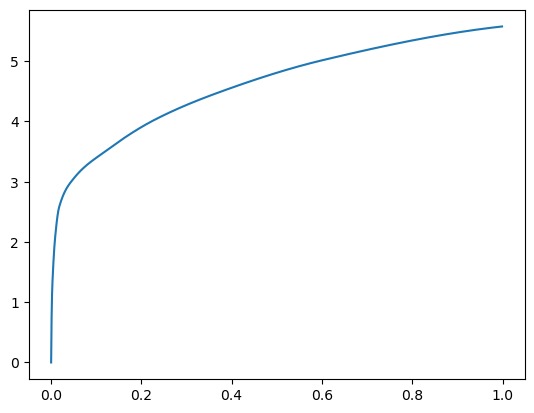

[0.00000000e+00 6.24656677e-04 1.59740448e-03 4.09603119e-03
 8.25786591e-03 1.63240433e-02 4.87432480e-02 1.28197670e-01
 2.36725807e-01 4.01322365e-01 6.31314278e-01 1.00000000e+00] betas
[0.         0.47329263 0.510568   0.54887281 0.49417568 0.52617086
 0.54250169 0.53049742 0.5253134  0.52005842 0.47932693 0.49773344] r
-22482.597739918583 score post


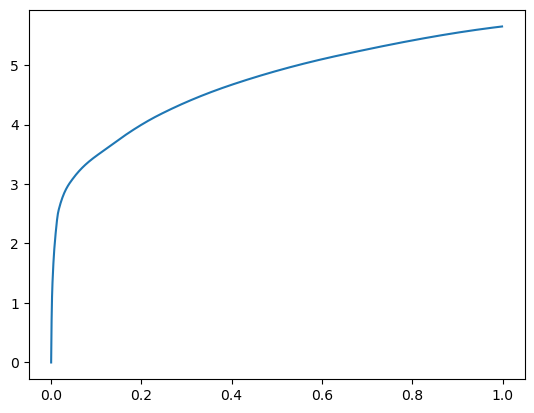

[0.00000000e+00 6.89506531e-04 1.73091888e-03 4.14562225e-03
 8.57067108e-03 1.68066025e-02 4.73089218e-02 1.22527122e-01
 2.25848198e-01 3.82130623e-01 6.21937752e-01 1.00000000e+00] betas
[0.         0.55955162 0.48468949 0.50910461 0.50126908 0.44253113
 0.50862559 0.5454257  0.44316136 0.50999371 0.5530861  0.52838211] r
-22480.269231963164 score post


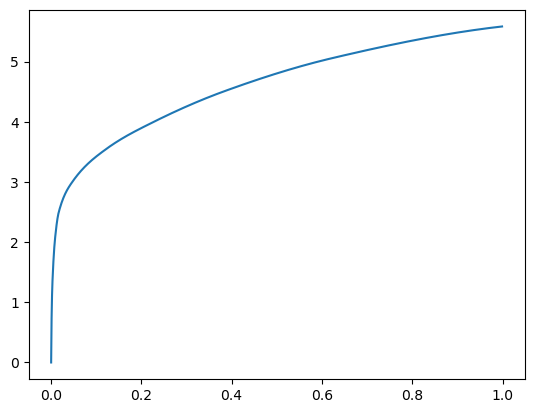

[0.00000000e+00 6.07490540e-04 1.64127350e-03 3.95107269e-03
 8.27121735e-03 1.83305740e-02 5.12399673e-02 1.23152733e-01
 2.44292259e-01 4.06510353e-01 6.33585930e-01 1.00000000e+00] betas
[0.         0.52780672 0.51981571 0.51051545 0.54551283 0.51676813
 0.47353795 0.46476159 0.54740001 0.5041723  0.43071784 0.4854935 ] r
-22482.458794922564 score post


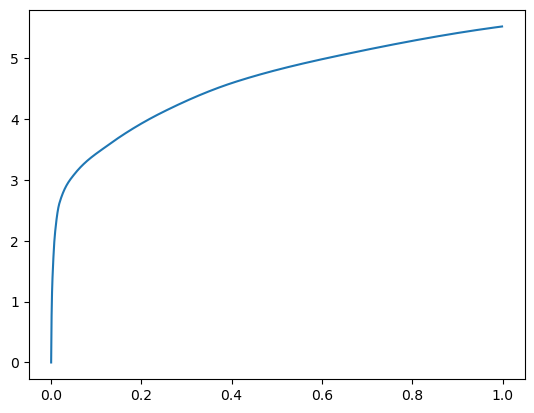

[0.00000000e+00 5.69343567e-04 1.51729584e-03 3.64589691e-03
 7.23743439e-03 1.50995255e-02 4.29430008e-02 1.15311623e-01
 2.21756935e-01 3.71903419e-01 6.22941017e-01 1.00000000e+00] betas
[0.         0.46612648 0.47909525 0.47350556 0.49435153 0.47341769
 0.54334768 0.54066164 0.47346021 0.50356818 0.53271289 0.41877741] r
-22480.269231963164 score post


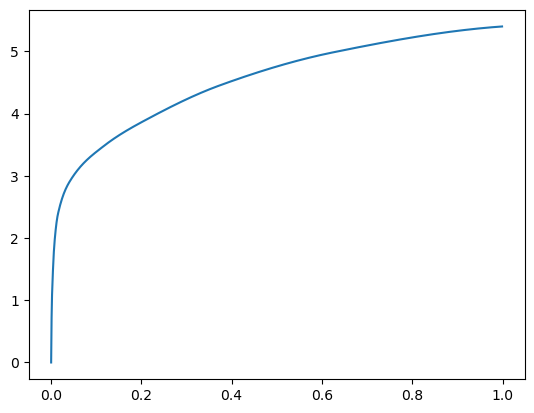

[0.00000000e+00 6.07490540e-04 1.63173676e-03 3.95870209e-03
 7.82108307e-03 1.72662735e-02 4.42590714e-02 1.09150887e-01
 2.17242241e-01 3.60800743e-01 5.78387260e-01 1.00000000e+00] betas
[0.         0.49128651 0.5320704  0.50058327 0.51445229 0.52377809
 0.47550879 0.42412632 0.52022617 0.5065334  0.45670844 0.60376398] r
-22482.597739918583 score post


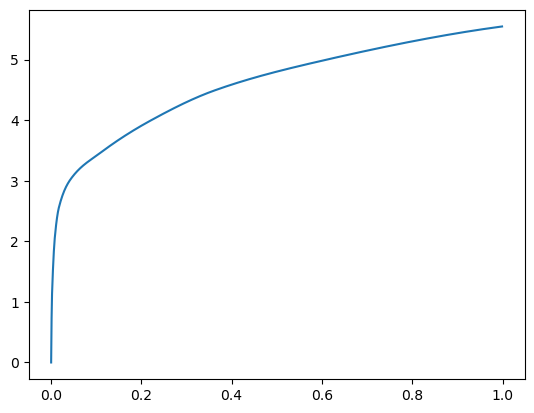

[0.00000000e+00 6.28471375e-04 1.58786774e-03 3.89575958e-03
 7.58457184e-03 1.60360336e-02 4.31985855e-02 1.21741295e-01
 2.30414391e-01 3.80570412e-01 6.36414528e-01 1.00000000e+00] betas
[0.         0.57306682 0.46083092 0.46527035 0.46217213 0.57609263
 0.43824192 0.52679836 0.53626395 0.49212659 0.52747889 0.44344067] r
-22486.318094974184 score post


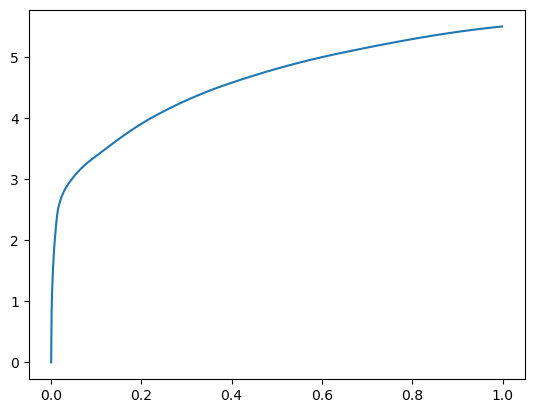

[0.00000000e+00 5.23567200e-04 1.48296356e-03 3.90338898e-03
 8.01563263e-03 1.50079727e-02 4.57372665e-02 1.21508598e-01
 2.21224785e-01 3.69402885e-01 6.01469994e-01 1.00000000e+00] betas
[0.         0.39878218 0.51872462 0.5107699  0.51128152 0.46741523
 0.54732527 0.51081978 0.49358138 0.52033201 0.49869372 0.54710134] r
-22480.269231963164 score post


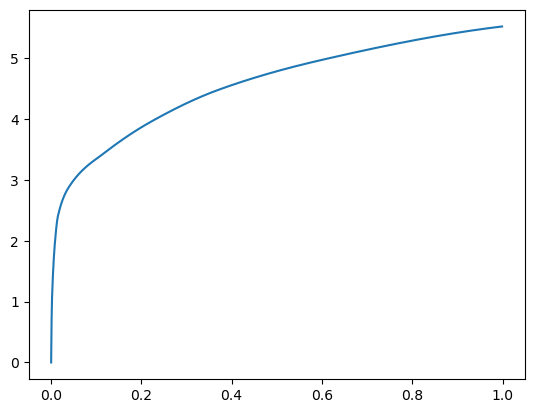

[0.00000000e+00 6.85691833e-04 1.76906586e-03 4.40692902e-03
 8.80527496e-03 1.85194016e-02 5.16862869e-02 1.30436897e-01
 2.35682487e-01 3.84871483e-01 6.27915382e-01 1.00000000e+00] betas
[0.         0.49446267 0.53490789 0.54102432 0.54634197 0.4959049
 0.46260125 0.48861959 0.46561392 0.46682476 0.53076228 0.5029998 ] r
-22481.378721678564 score post


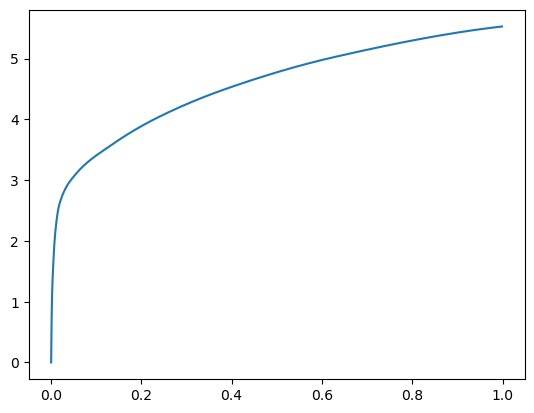

[0.00000000e+00 6.99043274e-04 1.69467926e-03 4.01401520e-03
 7.65132904e-03 1.55153275e-02 4.52413559e-02 1.21724129e-01
 2.33633995e-01 3.95785332e-01 6.28071785e-01 1.00000000e+00] betas
[0.         0.53209504 0.45423475 0.47814414 0.50113849 0.5035416
 0.50349173 0.52112102 0.53073544 0.53957665 0.47716148 0.56997891] r
-22480.269231963164 score post


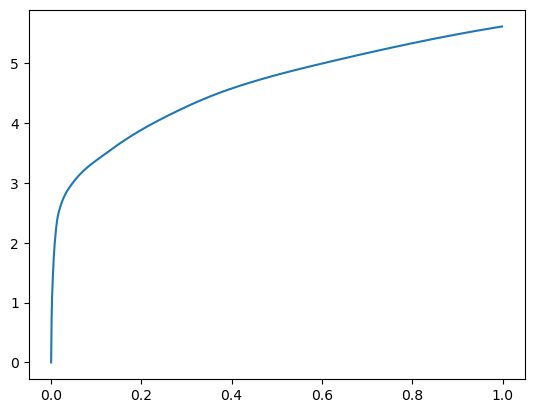

[0.00000000e+00 6.62803650e-04 1.81102753e-03 4.41074371e-03
 8.49056244e-03 1.83897018e-02 5.43203354e-02 1.35653496e-01
 2.48063087e-01 4.06374931e-01 6.62095070e-01 1.00000000e+00] betas
[0.         0.46551448 0.54785131 0.53448816 0.53300706 0.52975777
 0.5211464  0.52199312 0.47109995 0.47274194 0.5600028  0.44620727] r
-22486.68489191071 score post


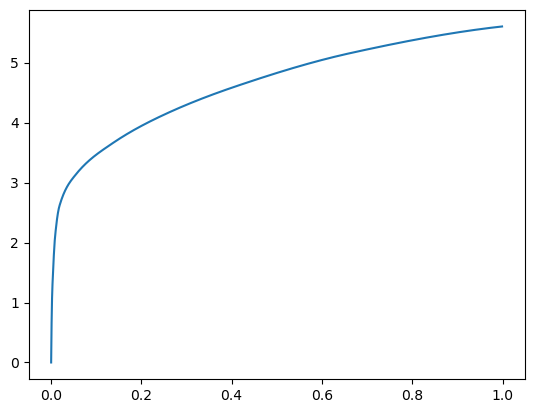

[0.00000000e+00 7.39097595e-04 1.83010101e-03 4.29058075e-03
 8.00418854e-03 1.63717270e-02 4.63895798e-02 1.18538857e-01
 2.34253883e-01 4.01442528e-01 6.26147270e-01 1.00000000e+00] betas
[0.         0.53555519 0.49284777 0.44356281 0.44484461 0.52630296
 0.52267639 0.4916948  0.51441919 0.54307965 0.45737977 0.47969872] r
-22481.621781595804 score post


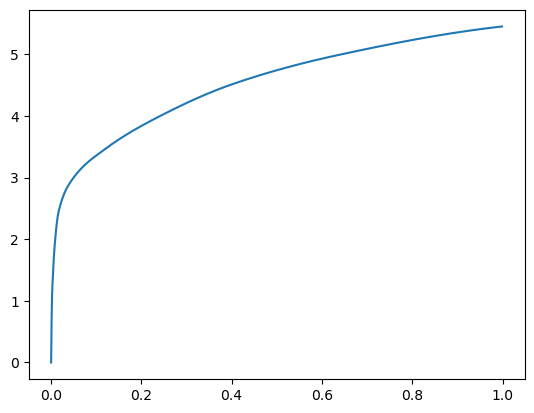

[0.00000000e+00 6.70433044e-04 1.70612335e-03 4.39357758e-03
 8.78238678e-03 1.75504684e-02 4.71677780e-02 1.20745659e-01
 2.32470512e-01 3.80896568e-01 6.16309166e-01 1.00000000e+00] betas
[0.         0.52314407 0.52821712 0.54668991 0.50010506 0.4925372
 0.51469998 0.51828598 0.55647537 0.47996263 0.4938865  0.45975175] r
-22483.811344555204 score post


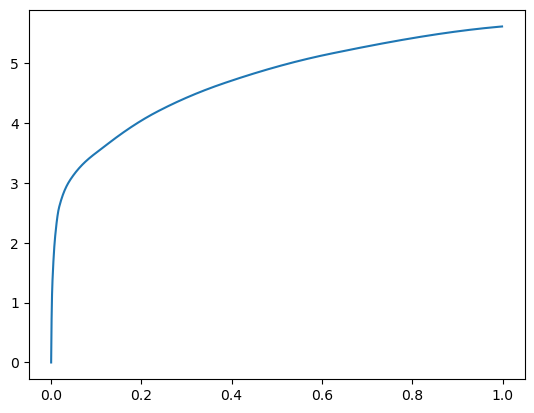

[0.00000000e+00 6.49452209e-04 1.61457062e-03 3.94916534e-03
 8.10527802e-03 1.63850784e-02 4.32100296e-02 1.11870766e-01
 2.09214211e-01 3.55917931e-01 5.85381508e-01 1.00000000e+00] betas
[0.         0.49709941 0.47191828 0.46812505 0.49694119 0.54202178
 0.5344363  0.46405912 0.54156808 0.500619   0.52631784 0.54913591] r
-22484.25291812412 score post


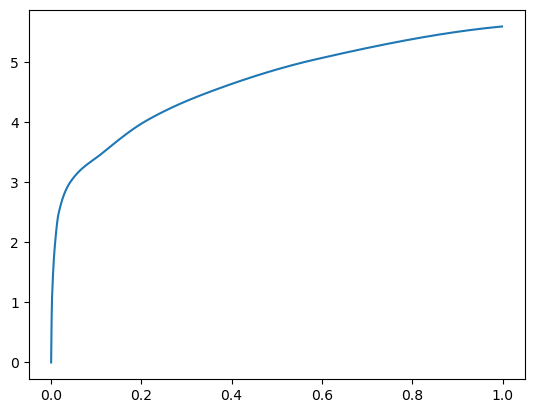

[0.00000000e+00 6.68525696e-04 1.77860260e-03 4.54235077e-03
 9.26876068e-03 1.84202194e-02 4.70094681e-02 1.25567436e-01
 2.21316338e-01 3.77299309e-01 6.09173775e-01 1.00000000e+00] betas
[0.         0.52226195 0.53061908 0.53214708 0.5285337  0.49817152
 0.4867742  0.49491982 0.49314476 0.51577263 0.52682339 0.50504596] r
-22481.990460408004 score post


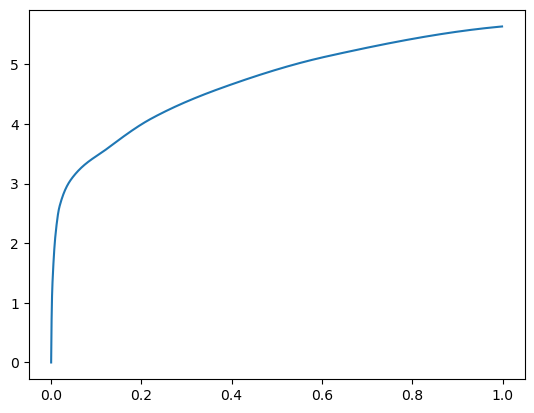

[0.00000000e+00 6.51359558e-04 1.68704987e-03 4.20856476e-03
 8.48293304e-03 1.69019699e-02 4.45241928e-02 1.24146461e-01
 2.24020958e-01 3.80042076e-01 6.04964256e-01 1.00000000e+00] betas
[0.         0.48994762 0.5448598  0.5538122  0.53006592 0.45565436
 0.47865235 0.54156454 0.45539046 0.48302538 0.48852365 0.53858423] r
-22483.2822716802 score post


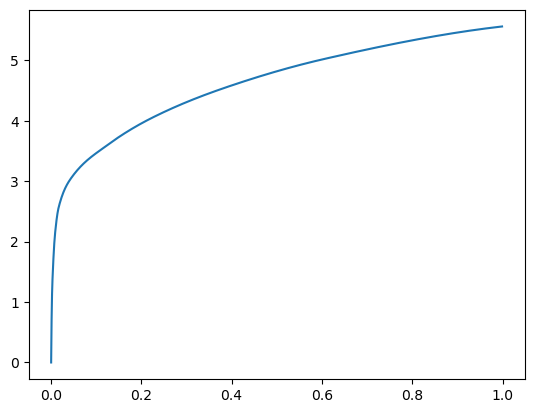

[0.00000000e+00 6.76155090e-04 1.61838531e-03 3.76987457e-03
 7.42244720e-03 1.54867172e-02 4.26301956e-02 1.13709450e-01
 2.22353935e-01 3.86338234e-01 6.24428749e-01 1.00000000e+00] betas
[0.         0.59245825 0.49298801 0.4721578  0.49929135 0.5492617
 0.47020358 0.48491951 0.51521826 0.55901033 0.49631336 0.47685233] r
-22483.17300509828 score post


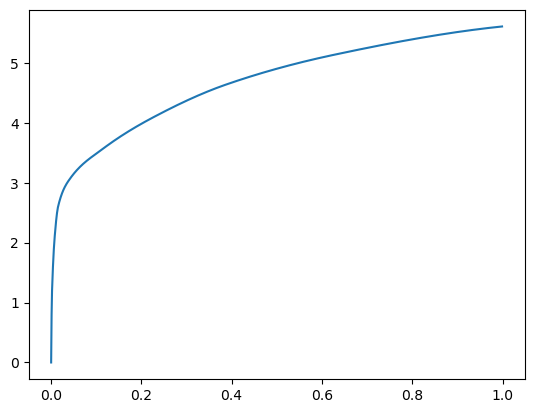

[0.00000000e+00 5.59806824e-04 1.44100189e-03 3.60584259e-03
 7.24315643e-03 1.40371323e-02 4.10032272e-02 1.15103722e-01
 2.22987175e-01 3.69236946e-01 6.04323387e-01 1.00000000e+00] betas
[0.         0.47219339 0.51499084 0.50705435 0.48730543 0.43695382
 0.49897725 0.525155   0.5684426  0.51181217 0.46459808 0.55603978] r
-22487.03210019931 score post


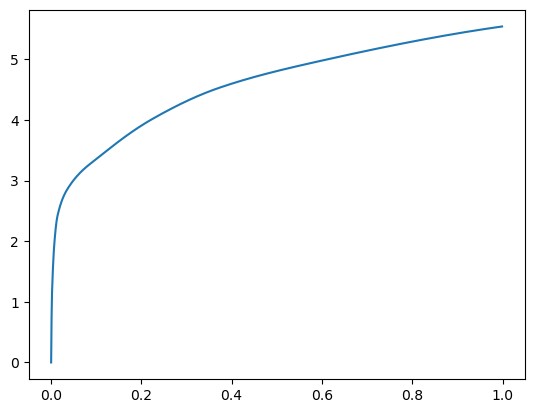

[0.00000000e+00 6.05583191e-04 1.50012970e-03 3.70693207e-03
 7.62844086e-03 1.74283981e-02 5.15279770e-02 1.29252434e-01
 2.27852821e-01 3.74201775e-01 6.35836601e-01 1.00000000e+00] betas
[0.         0.4426741  0.46113393 0.52138959 0.52445354 0.57122162
 0.5143692  0.57539138 0.50362105 0.48858863 0.60664386 0.48123985] r
-22483.2822716802 score post


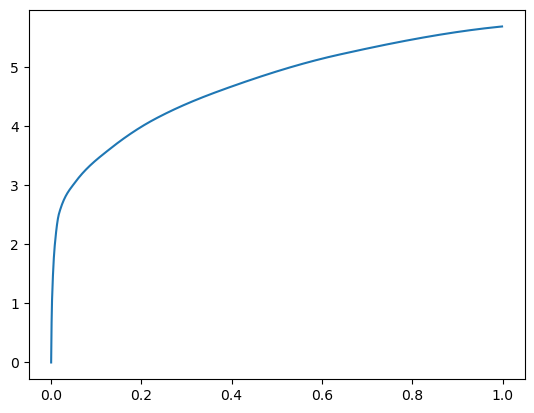

[0.00000000e+00 7.27653503e-04 1.91593170e-03 4.46033478e-03
 9.08184052e-03 2.00109482e-02 5.84115982e-02 1.31020546e-01
 2.33883858e-01 3.93483162e-01 6.15406990e-01 1.00000000e+00] betas
[0.         0.53744472 0.51348517 0.48985827 0.55062868 0.53684611
 0.51923812 0.45088829 0.47328393 0.53541161 0.50017295 0.52280122] r
-22484.25291812412 score post


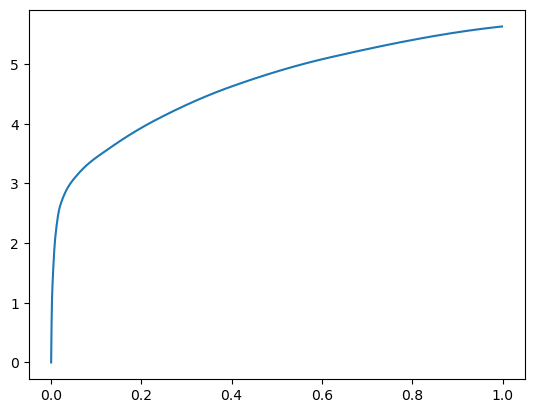

[0.00000000e+00 6.83784485e-04 1.82247162e-03 4.42409515e-03
 8.53443146e-03 1.76534653e-02 4.98437881e-02 1.28071785e-01
 2.39750862e-01 3.93237114e-01 6.21748924e-01 1.00000000e+00] betas
[0.         0.5135329  0.50487989 0.51755851 0.48107949 0.50034117
 0.45032643 0.46901484 0.48285017 0.49382593 0.55303114 0.48720002] r
-22480.269231963164 score post


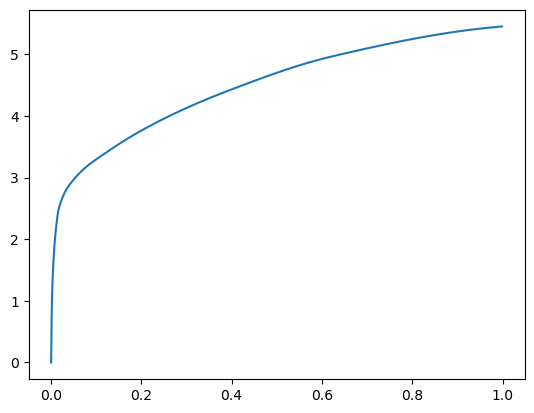

[0.00000000e+00 6.53266907e-04 1.73473358e-03 4.10366058e-03
 8.12435150e-03 1.63717270e-02 5.06353378e-02 1.34799004e-01
 2.52472878e-01 4.10719872e-01 6.16833687e-01 1.00000000e+00] betas
[0.         0.49443068 0.53012259 0.52518993 0.47840463 0.51225972
 0.53479032 0.51473658 0.54452898 0.54621202 0.46021105 0.45173079] r
-22486.71698678069 score post


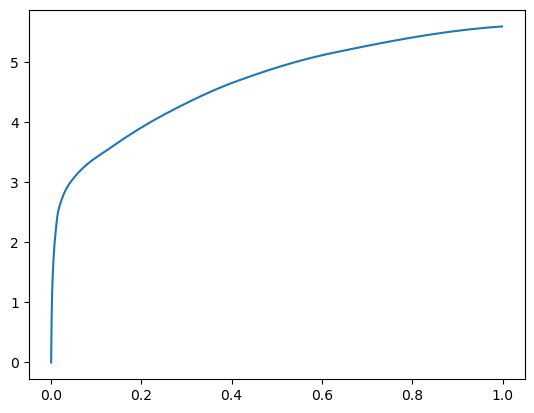

[0.00000000e+00 6.76155090e-04 1.71184540e-03 3.95107269e-03
 8.18920135e-03 1.64308548e-02 4.80031967e-02 1.28844261e-01
 2.35978127e-01 3.74930382e-01 5.83748817e-01 1.00000000e+00] betas
[0.         0.50387896 0.52630236 0.50743717 0.55501743 0.49534176
 0.49256242 0.56149939 0.52429879 0.43324384 0.44125505 0.56283404] r
-22481.990460408004 score post


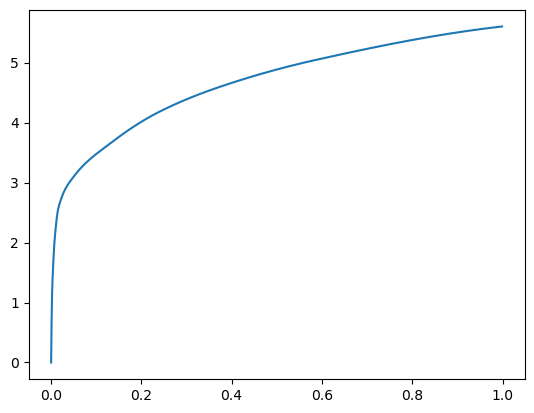

[0.00000000e+00 6.85691833e-04 1.67751312e-03 3.89575958e-03
 7.59601593e-03 1.52120590e-02 4.56285477e-02 1.15483284e-01
 2.13734627e-01 3.69183540e-01 6.15612984e-01 1.00000000e+00] betas
[0.         0.48045125 0.52401328 0.48717986 0.44638644 0.52311163
 0.553084   0.45520162 0.49386332 0.52348038 0.59356132 0.4786543 ] r
-22480.269231963164 score post


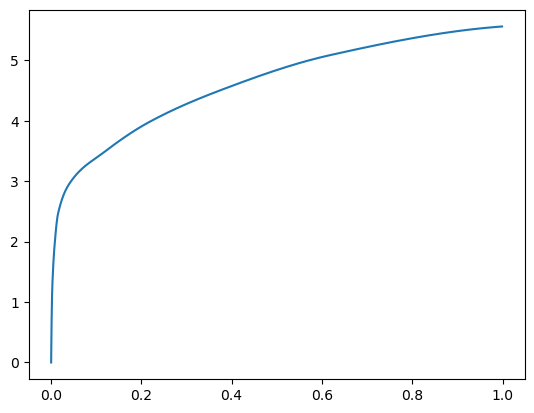

[0.00000000e+00 7.25746155e-04 1.69658661e-03 4.05025482e-03
 8.53061676e-03 1.73215866e-02 4.74119186e-02 1.27520561e-01
 2.33748436e-01 3.90917778e-01 6.00291252e-01 1.00000000e+00] betas
[0.         0.56238185 0.46220896 0.5233306  0.54945006 0.45582304
 0.50878486 0.51855245 0.53016847 0.52965405 0.4439296  0.5321377 ] r
-22480.269231963164 score post


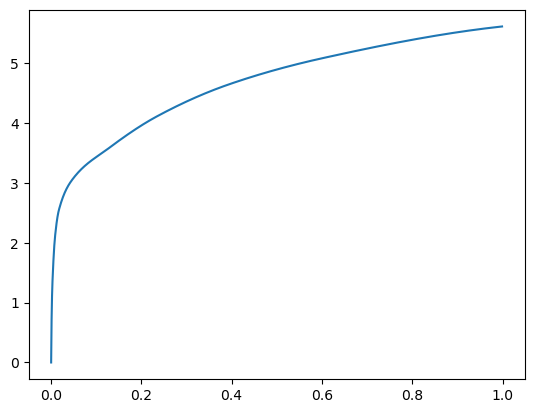

576180 steps_after


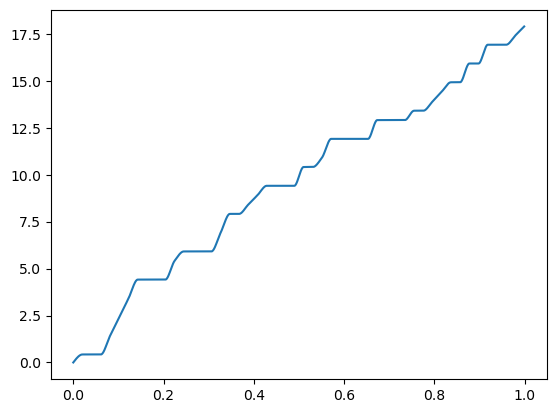

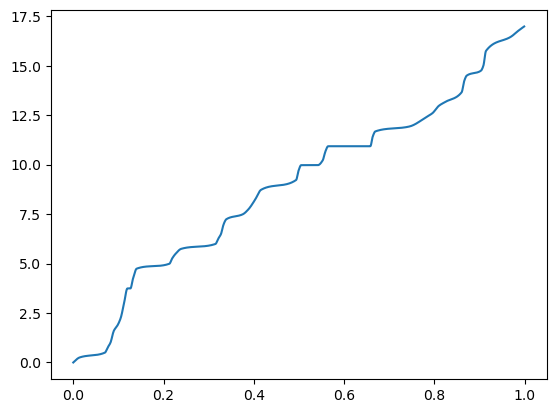

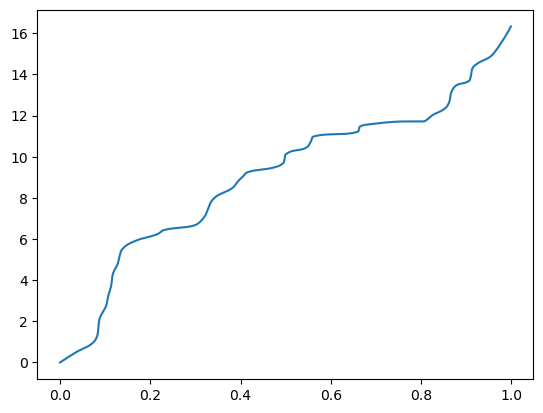

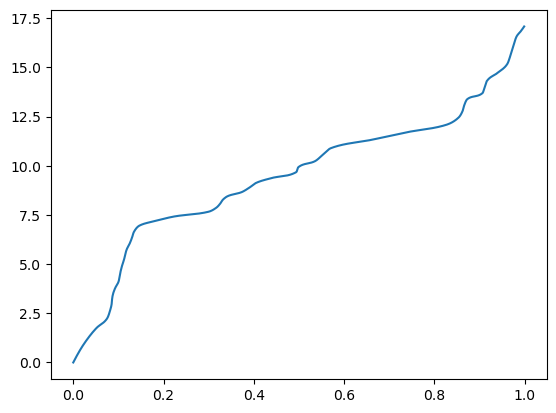

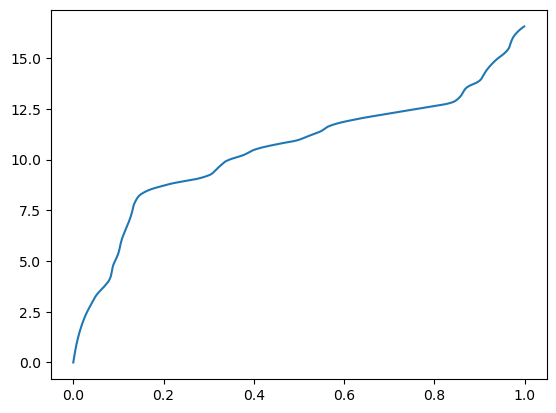

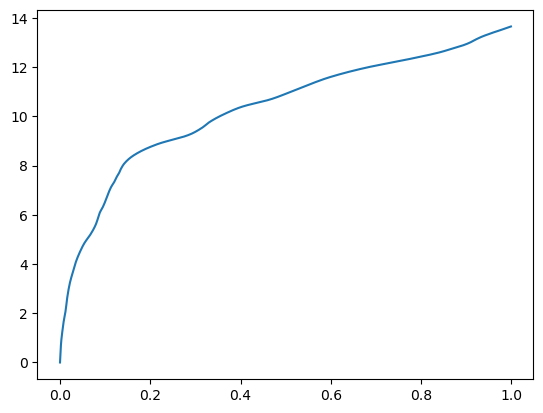

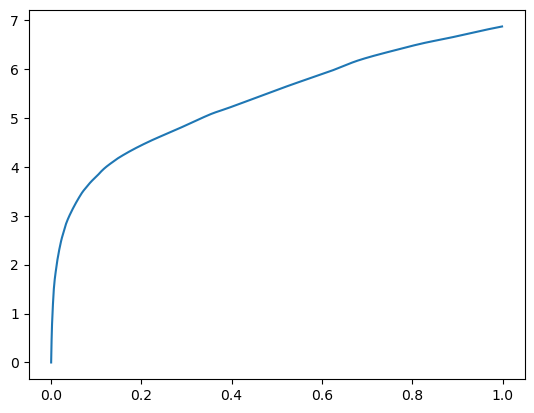

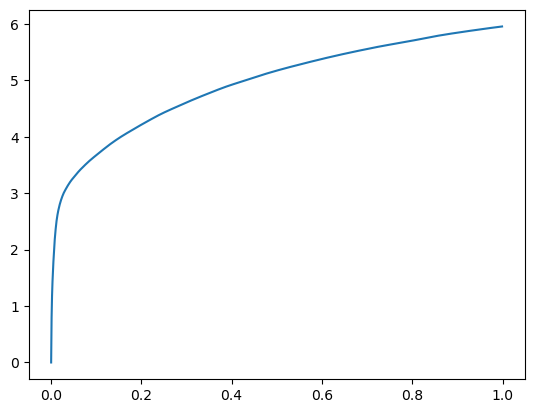

10478 steps
betas [0.00000000e+00 6.66618347e-04 2.02655792e-03 5.02109528e-03
 1.02243423e-02 2.64730453e-02 8.49294662e-02 1.90096855e-01
 3.47310066e-01 5.90260506e-01 1.00000000e+00]
n_chains 11
[0.00000000e+00 6.66618347e-04 2.02655792e-03 5.02109528e-03
 1.02243423e-02 2.64730453e-02 8.49294662e-02 1.90096855e-01
 3.47310066e-01 5.90260506e-01 1.00000000e+00] betas
[0.         0.00055704 0.         0.00659552 0.038982   0.
 0.         0.34454079 0.         0.         0.        ] r
-22481.990460408004 score post


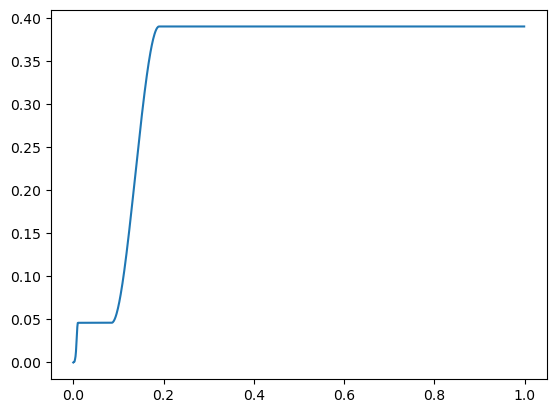

[0.         0.00869846 0.1047163  0.11566067 0.12460995 0.13280582
 0.14077282 0.14889622 0.15765476 0.16805363 1.        ] betas
[0.         0.9736298  0.89299351 0.06992933 0.05180238 0.04643057
 0.04481305 0.04381742 0.04504508 0.05076208 0.98261666] r
-22481.378721678564 score post


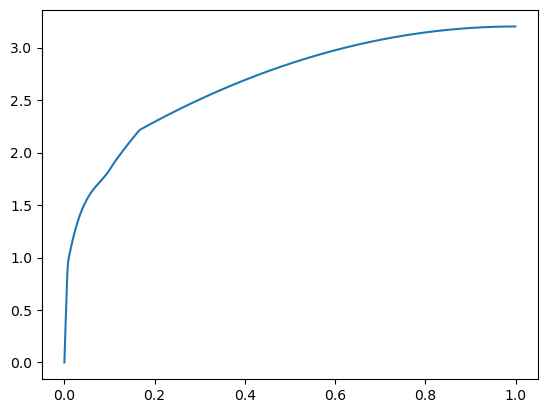

[0.         0.00238514 0.0047102  0.00827122 0.0251894  0.05638599
 0.11310673 0.17740536 0.32780743 0.52418041 1.        ] betas
[0.         0.8613235  0.42342354 0.4629717  0.59797147 0.36907899
 0.40647517 0.35903596 0.58270536 0.51284105 0.63857146] r
-22483.343010040644 score post


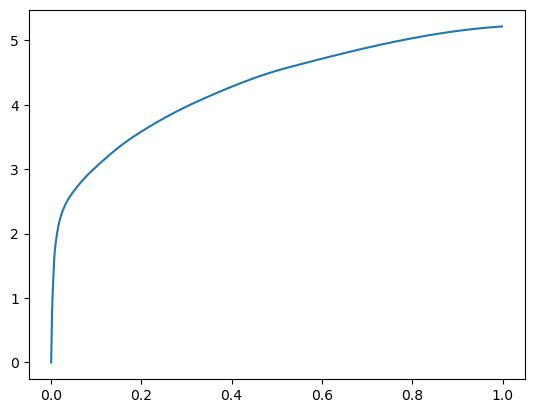

[0.         0.00126934 0.00323963 0.00654888 0.01512432 0.04467297
 0.11428356 0.21542645 0.36300564 0.58813953 1.        ] betas
[0.         0.72831066 0.51032612 0.46645054 0.56349255 0.54058464
 0.49474606 0.49862376 0.51870393 0.47166376 0.57357746] r
-22480.269231963164 score post


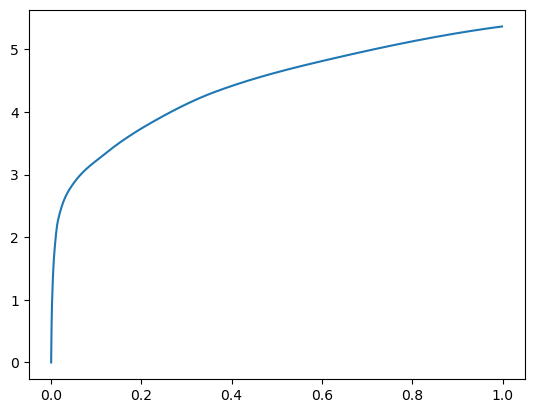

[0.00000000e+00 8.47816467e-04 2.44235992e-03 5.66005707e-03
 1.23472214e-02 3.42473984e-02 9.95931625e-02 2.04512596e-01
 3.52782249e-01 6.09900475e-01 1.00000000e+00] betas
[0.         0.59965575 0.59911304 0.5419111  0.5873363  0.51991372
 0.51527627 0.51366994 0.52459273 0.55468149 0.53431744] r
-22481.990460408004 score post


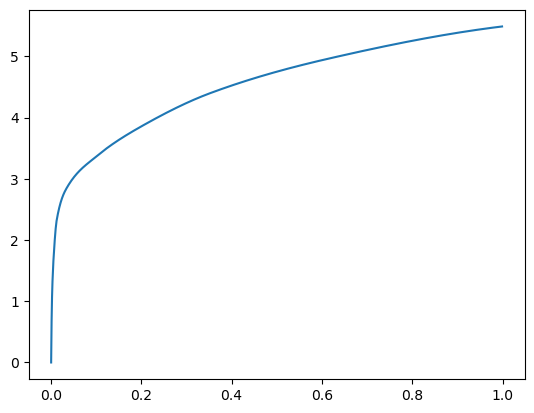

[0.00000000e+00 7.54356384e-04 2.07424164e-03 4.92000580e-03
 1.01480484e-02 2.73160934e-02 8.80670547e-02 1.96461678e-01
 3.49488258e-01 6.01300240e-01 1.00000000e+00] betas
[0.         0.58172069 0.56602347 0.50142076 0.54391847 0.61091606
 0.52446158 0.58123097 0.54014476 0.556568   0.51349668] r
-22481.378721678564 score post


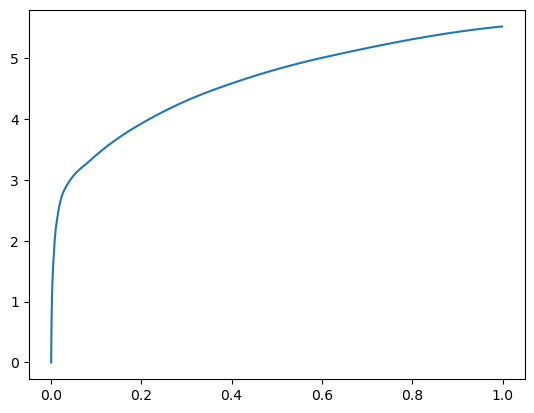

[0.00000000e+00 7.02857971e-04 1.92165375e-03 4.97150421e-03
 1.04055405e-02 2.48918533e-02 8.55779648e-02 1.86011314e-01
 3.37496758e-01 5.78774452e-01 1.00000000e+00] betas
[0.         0.55499908 0.5548253  0.5616116  0.57650604 0.49460767
 0.54007306 0.55998816 0.62411407 0.5051794  0.50043145] r
-22483.75060619476 score post


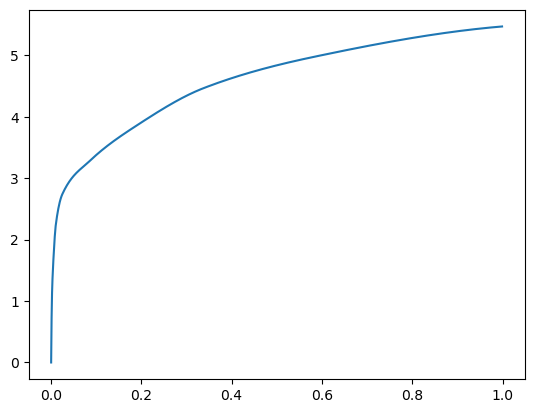

[0.00000000e+00 6.89506531e-04 1.86824799e-03 4.75597382e-03
 9.52053070e-03 2.45027542e-02 8.56885910e-02 1.83512688e-01
 3.09498787e-01 5.49473763e-01 1.00000000e+00] betas
[0.         0.5648738  0.57494078 0.54544833 0.48646907 0.57775494
 0.58908256 0.55246179 0.47433637 0.52403208 0.60606854] r
-22480.269231963164 score post


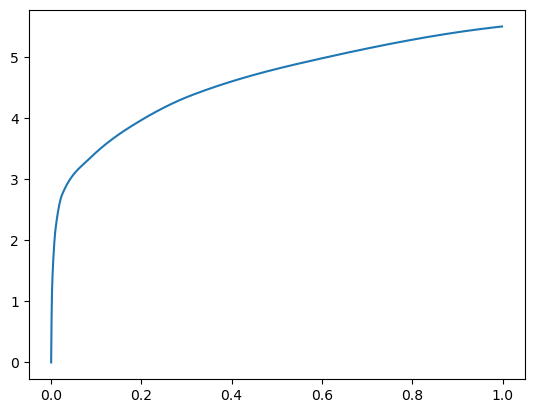

[0.00000000e+00 6.64710999e-04 1.74045563e-03 4.48894501e-03
 9.96112823e-03 2.44035721e-02 7.97986984e-02 1.73937798e-01
 3.20555687e-01 5.82877159e-01 1.00000000e+00] betas
[0.         0.48003397 0.48935684 0.54747826 0.5505002  0.52525093
 0.58180079 0.55334816 0.50420686 0.68663348 0.49380654] r
-22484.59972536877 score post


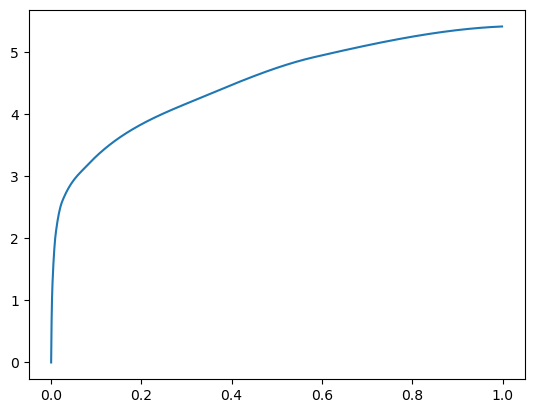

[0.00000000e+00 7.73429871e-04 2.15053558e-03 5.28812408e-03
 1.17502213e-02 3.11708450e-02 8.95376205e-02 1.88176155e-01
 3.52974892e-01 5.56820869e-01 1.00000000e+00] betas
[0.         0.54061819 0.55343164 0.51493938 0.59954847 0.56120389
 0.5154022  0.55057005 0.60755378 0.49677712 0.60644348] r
-22484.25291812412 score post


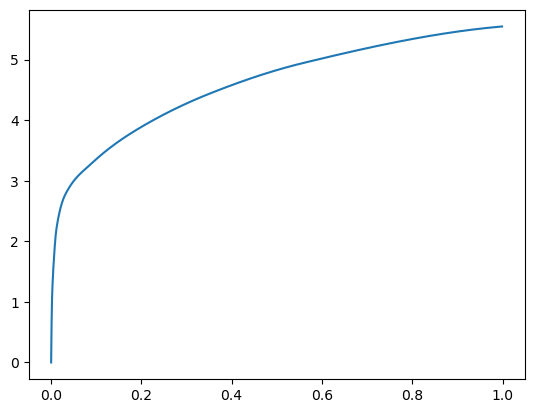

[0.00000000e+00 8.00132751e-04 2.21347809e-03 5.74016571e-03
 1.19600296e-02 3.14073563e-02 9.57632065e-02 1.98678017e-01
 3.50924492e-01 5.85534096e-01 1.00000000e+00] betas
[0.         0.58420101 0.56213765 0.54574128 0.5255105  0.52953659
 0.52479604 0.52035554 0.56881798 0.55952284 0.54563301] r
-22480.269231963164 score post


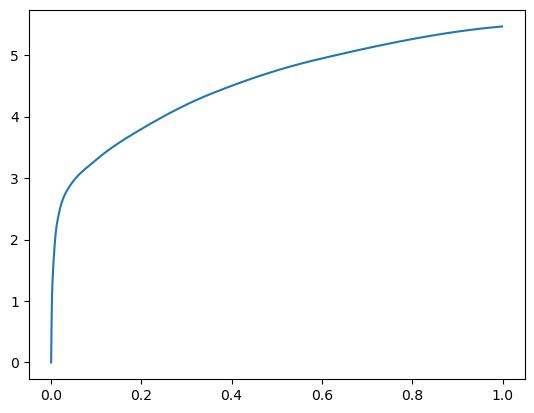

[0.00000000e+00 7.31468201e-04 2.01320648e-03 5.27858734e-03
 1.13401413e-02 3.04307938e-02 9.69991684e-02 2.06578255e-01
 3.54962349e-01 5.84965706e-01 1.00000000e+00] betas
[0.         0.55688569 0.59746825 0.53199372 0.57585743 0.58086608
 0.58625429 0.56059484 0.49823353 0.55877071 0.61743904] r
-22480.269231963164 score post


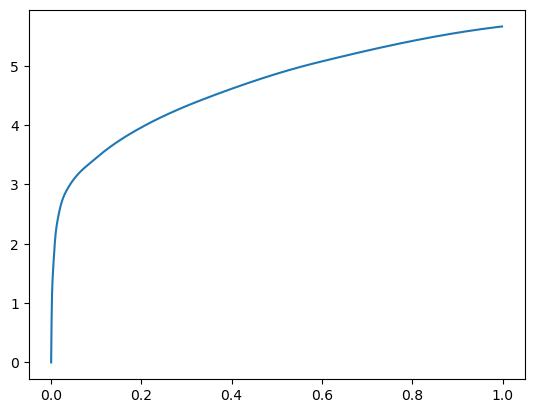

[0.00000000e+00 7.46726990e-04 1.93500519e-03 5.38349152e-03
 1.14107132e-02 2.97327042e-02 9.22689438e-02 2.00554848e-01
 3.70268822e-01 6.12166405e-01 1.00000000e+00] betas
[0.         0.56124567 0.4963595  0.58349065 0.58602393 0.55336715
 0.49308503 0.56038774 0.57488    0.54218921 0.48718545] r
-22485.310960374136 score post


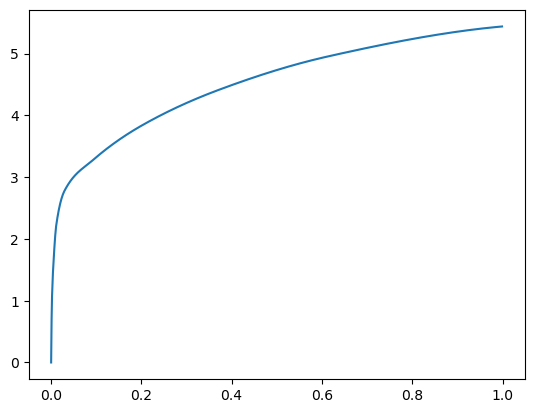

[0.00000000e+00 7.16209412e-04 2.05326080e-03 5.30719757e-03
 1.05390549e-02 2.60343552e-02 9.05752182e-02 1.94090843e-01
 3.49448204e-01 5.79588890e-01 1.00000000e+00] betas
[0.         0.51591914 0.51115995 0.56261236 0.51993833 0.55542264
 0.6161403  0.53212408 0.59827081 0.51354753 0.56132048] r
-22481.990460408004 score post


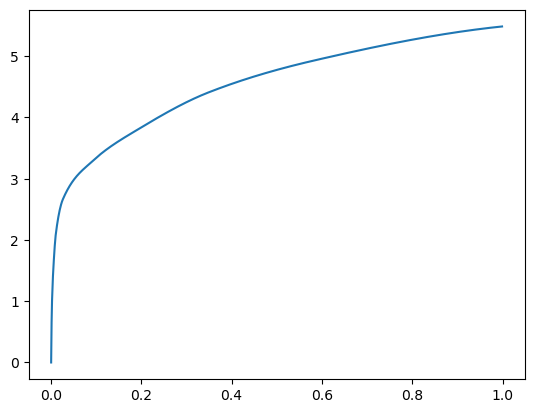

[0.00000000e+00 7.81059265e-04 2.34317780e-03 5.74779510e-03
 1.20897293e-02 3.08599472e-02 9.21449661e-02 2.00221062e-01
 3.41822624e-01 5.87002754e-01 1.00000000e+00] betas
[0.         0.56140539 0.58725939 0.56454951 0.54709265 0.52031471
 0.50972281 0.52832401 0.52445636 0.54635232 0.5937625 ] r
-22482.458794922564 score post


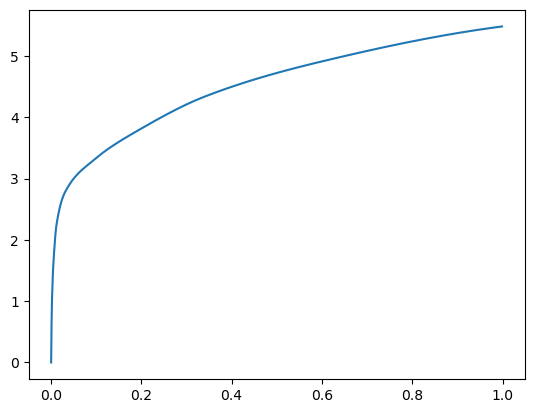

[0.00000000e+00 7.56263733e-04 2.14290619e-03 5.18512726e-03
 1.08728409e-02 2.83346176e-02 9.20820236e-02 2.04850197e-01
 3.57365608e-01 6.12702370e-01 1.00000000e+00] betas
[0.         0.54613803 0.59801878 0.50502043 0.54706048 0.54340129
 0.53726805 0.53736514 0.53360346 0.58920369 0.54578324] r
-22480.269231963164 score post


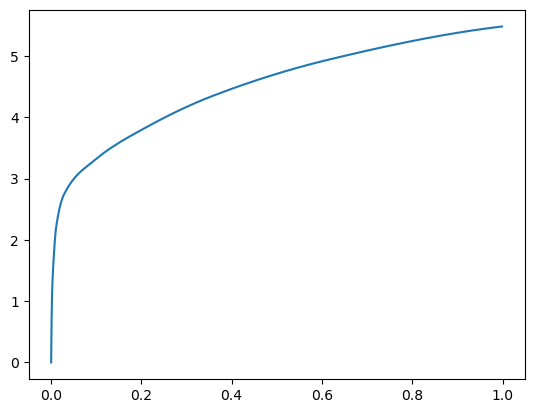

[0.00000000e+00 7.60078430e-04 1.97315216e-03 5.15079498e-03
 1.08137131e-02 2.84547806e-02 9.41457748e-02 2.10713387e-01
 3.71075630e-01 6.11298561e-01 1.00000000e+00] betas
[0.         0.56754099 0.57709212 0.56860466 0.53855656 0.55055725
 0.55102597 0.53587069 0.54650623 0.54435499 0.51599117] r
-22480.269231963164 score post


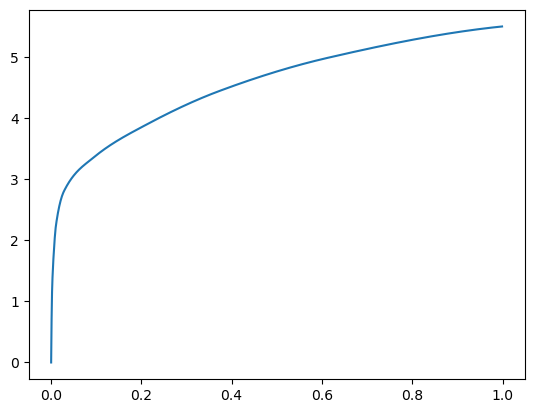

[0.00000000e+00 7.29560852e-04 1.82628632e-03 4.65297699e-03
 9.92107391e-03 2.53000259e-02 8.47291946e-02 2.00041771e-01
 3.57308388e-01 5.92179298e-01 1.00000000e+00] betas
[0.         0.52889033 0.50010121 0.52238334 0.52202646 0.58323791
 0.60674978 0.61536726 0.55007993 0.53744997 0.50420933] r
-22483.2822716802 score post


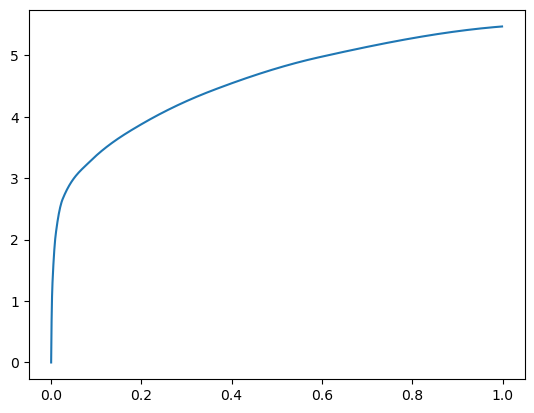

[0.00000000e+00 7.61985779e-04 2.06851959e-03 5.34725189e-03
 1.19638443e-02 2.98776627e-02 8.73594284e-02 1.88553810e-01
 3.39081764e-01 5.67393303e-01 1.00000000e+00] betas
[0.         0.52700827 0.57477399 0.55256909 0.57623374 0.57766786
 0.54072176 0.51966021 0.56352092 0.52588748 0.54199456] r
-22484.89423354312 score post


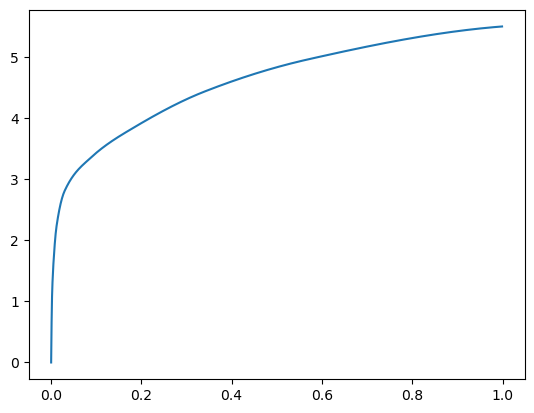

[0.00000000e+00 8.03947449e-04 2.06089020e-03 5.31101227e-03
 1.13992691e-02 2.67477036e-02 8.00504684e-02 1.84294701e-01
 3.28280449e-01 5.62647820e-01 1.00000000e+00] betas
[0.         0.60277291 0.53532713 0.55378588 0.60463071 0.4469106
 0.49971935 0.50557458 0.54012855 0.57812913 0.58174821] r
-22484.348467993714 score post


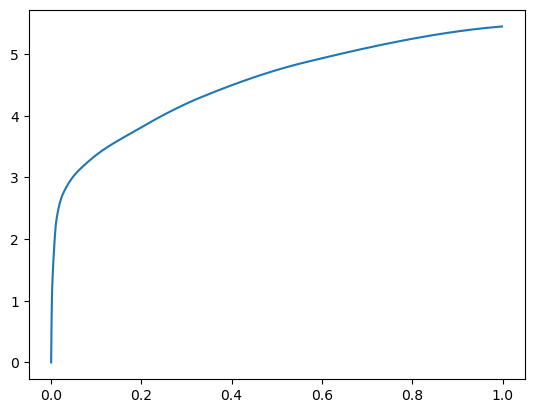

[0.00000000e+00 7.04765320e-04 1.89304352e-03 4.86660004e-03
 9.66548920e-03 2.55746841e-02 8.40597153e-02 1.99769020e-01
 3.51803780e-01 5.83437920e-01 1.00000000e+00] betas
[0.         0.54506306 0.53032088 0.56150964 0.5070715  0.55782591
 0.51680586 0.55721577 0.57810268 0.52382309 0.56023723] r
-22484.348661750126 score post


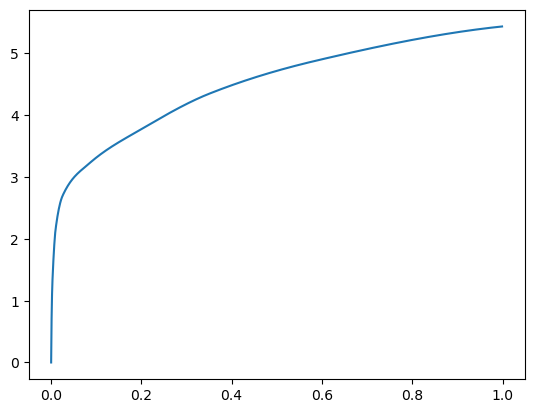

[0.00000000e+00 7.02857971e-04 1.93691254e-03 4.82654572e-03
 1.02148056e-02 2.66695023e-02 9.10940170e-02 2.06974983e-01
 3.50583076e-01 5.92972755e-01 1.00000000e+00] betas
[0.         0.50434001 0.5372837  0.53831123 0.51995592 0.5690613
 0.58792181 0.59211045 0.50659273 0.5204968  0.54645584] r
-22481.378721678564 score post


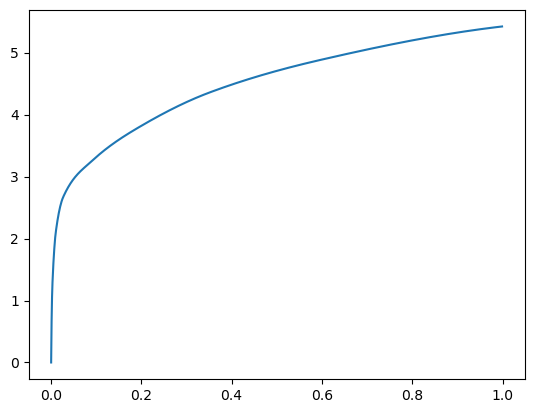

[0.00000000e+00 7.71522522e-04 2.09712982e-03 5.18894196e-03
 1.15060806e-02 2.93416977e-02 9.05942917e-02 1.94397926e-01
 3.44239235e-01 5.95469475e-01 1.00000000e+00] betas
[0.         0.54472717 0.55342387 0.50896511 0.55000768 0.51642262
 0.50126501 0.56904825 0.52663838 0.5947504  0.51118443] r
-22484.348661750126 score post


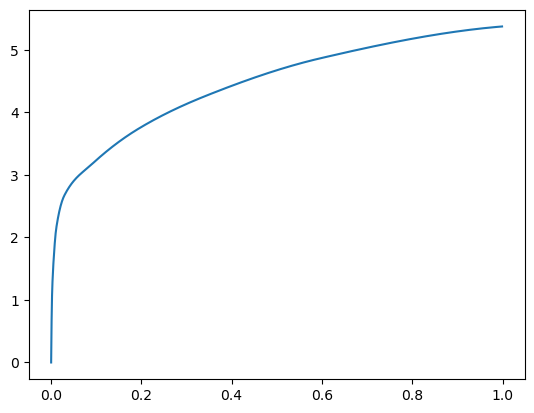

[0.00000000e+00 7.58171082e-04 2.01129913e-03 5.23853302e-03
 1.13706589e-02 3.03869247e-02 9.83457565e-02 1.98956490e-01
 3.54948997e-01 5.80250740e-01 1.00000000e+00] betas
[0.         0.60418011 0.52323748 0.58021588 0.55090092 0.49185635
 0.55401337 0.51453208 0.57515383 0.53919329 0.58827842] r
-22480.269231963164 score post


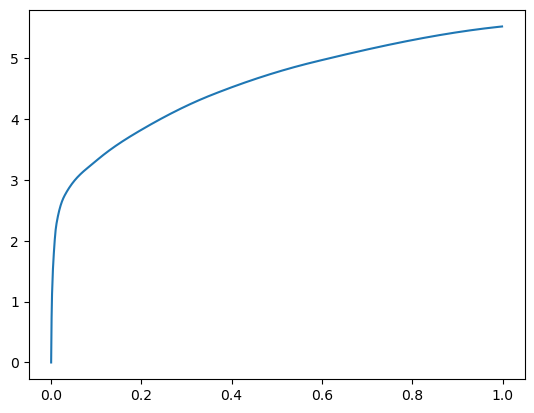

[0.00000000e+00 6.70433044e-04 1.92737579e-03 4.83798981e-03
 1.04265213e-02 3.11498642e-02 9.96885300e-02 2.09698677e-01
 3.62874031e-01 6.00249290e-01 1.00000000e+00] betas
[0.         0.51291904 0.54665147 0.50625037 0.57347939 0.56141367
 0.56397378 0.56475211 0.51466469 0.57742422 0.49153347] r
-22484.52742382129 score post


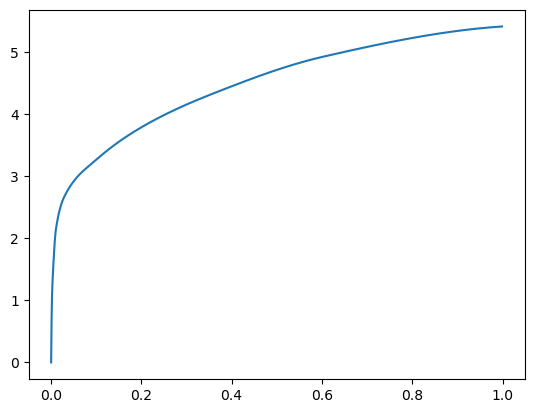

[0.00000000e+00 7.20024109e-04 2.01702118e-03 5.27858734e-03
 1.09720230e-02 3.15675735e-02 9.70392227e-02 2.00049400e-01
 3.58105659e-01 5.72625160e-01 1.00000000e+00] betas
[0.         0.54840592 0.55684919 0.52557634 0.56984775 0.59337498
 0.55330919 0.49713132 0.59529315 0.47033293 0.54533271] r
-22483.811344555204 score post


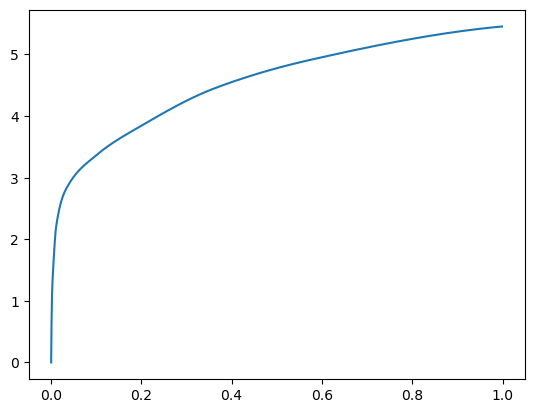

[0.00000000e+00 7.14302063e-04 1.96170807e-03 5.32436371e-03
 1.06306076e-02 2.74763107e-02 8.48932266e-02 1.94010735e-01
 3.33138466e-01 5.72497368e-01 1.00000000e+00] betas
[0.         0.55004696 0.54036325 0.60250606 0.47427661 0.54831622
 0.52264254 0.53558437 0.50236951 0.57133601 0.49575859] r
-22483.343010040644 score post


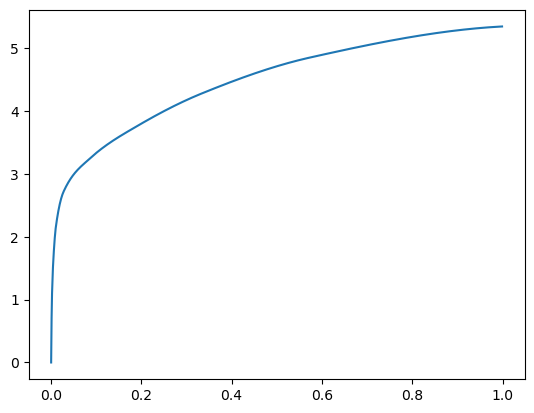

[0.00000000e+00 6.87599182e-04 1.88541412e-03 4.62436676e-03
 1.00965500e-02 2.50291824e-02 7.99074173e-02 1.85986519e-01
 3.32610130e-01 5.49901009e-01 1.00000000e+00] betas
[0.         0.51976981 0.6054229  0.54050996 0.55503712 0.48937496
 0.48226862 0.58356459 0.5809826  0.50537198 0.49020307] r
-22480.269231963164 score post


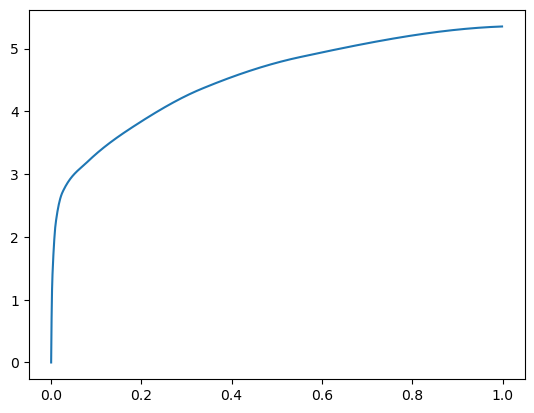

[0.00000000e+00 7.12394714e-04 1.72519684e-03 4.20284271e-03
 8.88919830e-03 2.30817795e-02 8.26845169e-02 1.79728508e-01
 3.09041023e-01 5.22749901e-01 1.00000000e+00] betas
[0.         0.54899248 0.4789236  0.50799079 0.56765172 0.58756928
 0.56846921 0.49699059 0.52284033 0.49525612 0.63714004] r
-22481.378721678564 score post


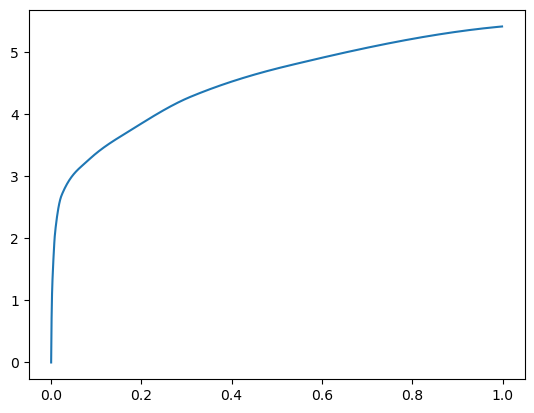

[0.00000000e+00 6.99043274e-04 1.91211700e-03 4.77123260e-03
 9.82379913e-03 2.39229202e-02 8.08305740e-02 1.86701775e-01
 3.26010704e-01 5.78150749e-01 1.00000000e+00] betas
[0.         0.51507571 0.52135335 0.50621673 0.51332047 0.55389989
 0.57589414 0.51497224 0.49791162 0.60349059 0.57082614] r
-22486.84644557857 score post


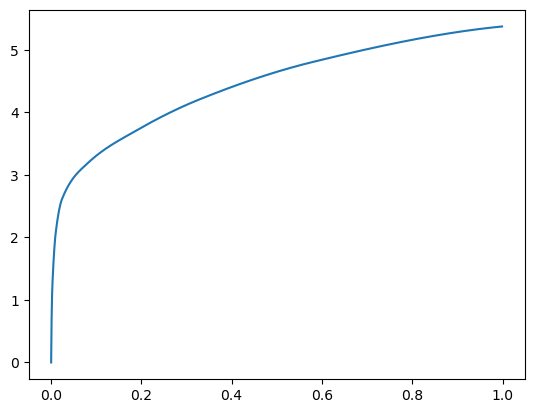

[0.00000000e+00 7.39097595e-04 2.05898285e-03 5.30338287e-03
 1.14202499e-02 2.83575058e-02 8.65545273e-02 2.01434135e-01
 3.60871315e-01 5.97186089e-01 1.00000000e+00] betas
[0.         0.58783872 0.5166172  0.56354102 0.57399355 0.54764336
 0.51475369 0.55295361 0.58993928 0.55619617 0.57675435] r
-22481.621781595804 score post


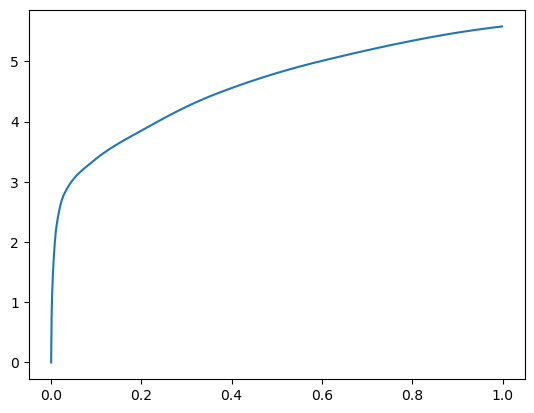

[0.00000000e+00 6.85691833e-04 2.10475922e-03 5.35106659e-03
 1.12352371e-02 2.83880234e-02 9.35163498e-02 2.13072777e-01
 3.66690636e-01 6.07512474e-01 1.00000000e+00] betas
[0.         0.48830645 0.62675853 0.53979358 0.54068074 0.51689659
 0.584815   0.6169024  0.54225479 0.50691759 0.5120747 ] r
-22480.269231963164 score post


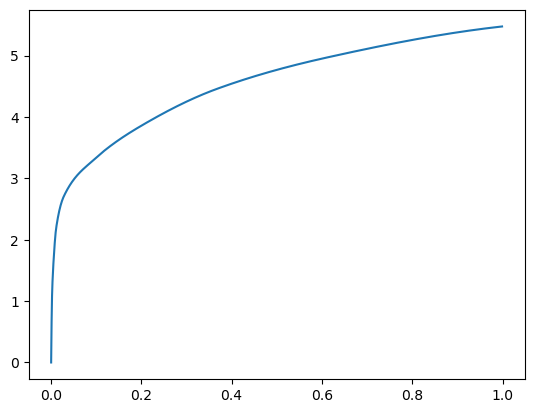

[0.00000000e+00 7.92503357e-04 2.03037262e-03 5.24997711e-03
 1.11284256e-02 3.00512314e-02 9.17177200e-02 1.94096565e-01
 3.40037346e-01 5.86312294e-01 1.00000000e+00] betas
[0.         0.62519024 0.52426892 0.53431308 0.54232754 0.58654095
 0.52049685 0.53615417 0.48955732 0.56610978 0.56909296] r
-22481.990460408004 score post


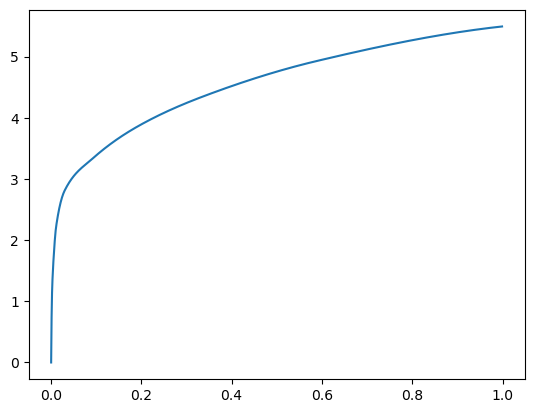

[0.00000000e+00 6.68525696e-04 1.85108185e-03 4.96006012e-03
 1.06134415e-02 2.62842178e-02 8.59689713e-02 1.88496590e-01
 3.53270531e-01 5.97540855e-01 1.00000000e+00] betas
[0.         0.51282779 0.54705404 0.56719873 0.58718838 0.51967922
 0.47763826 0.52946614 0.55255017 0.51971561 0.55579803] r
-22485.220960759736 score post


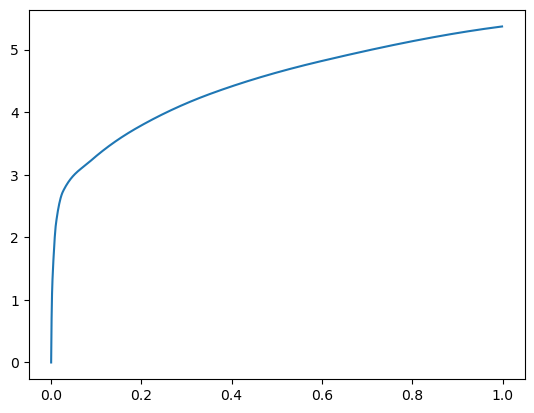

[0.00000000e+00 7.08580017e-04 1.90067291e-03 4.83989716e-03
 9.60445404e-03 2.34651566e-02 8.75196457e-02 1.92709923e-01
 3.53911400e-01 6.08654976e-01 1.00000000e+00] betas
[0.         0.57284404 0.5185618  0.55233016 0.53166175 0.56999864
 0.55434791 0.57687964 0.50953264 0.63853442 0.49397383] r
-22485.61210838894 score post


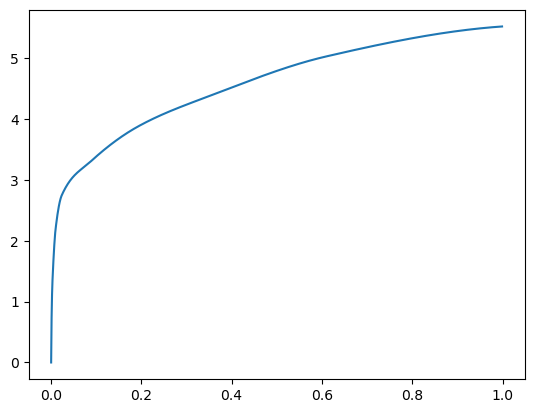

[0.00000000e+00 6.74247742e-04 1.94454193e-03 4.92382050e-03
 1.01041794e-02 2.43120193e-02 8.92000198e-02 1.89429283e-01
 3.64092827e-01 5.77624321e-01 1.00000000e+00] betas
[0.         0.50456018 0.60403112 0.54719354 0.52624884 0.49860449
 0.58302916 0.53435145 0.56326153 0.46023729 0.53299871] r
-22480.269231963164 score post


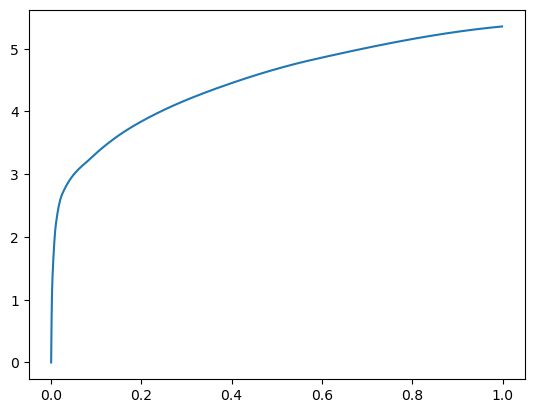

[0.00000000e+00 7.25746155e-04 1.82247162e-03 4.55760956e-03
 9.46903229e-03 2.41079330e-02 8.13894272e-02 1.77632332e-01
 3.34990501e-01 5.76130867e-01 1.00000000e+00] betas
[0.         0.5336695  0.51187777 0.53522245 0.52790969 0.51929466
 0.55094385 0.51819162 0.62468278 0.50582532 0.57127624] r
-22480.269231963164 score post


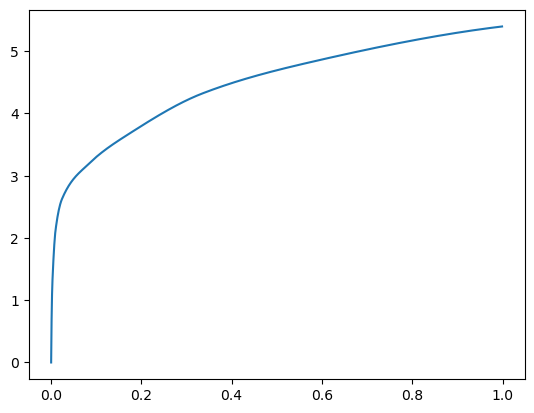

[0.00000000e+00 7.37190247e-04 1.94263458e-03 4.83226776e-03
 1.03693008e-02 2.85348892e-02 9.02223587e-02 1.95471764e-01
 3.34038734e-01 5.94965935e-01 1.00000000e+00] betas
[0.         0.57489702 0.486878   0.5467541  0.57115928 0.51095223
 0.53308753 0.50957367 0.52990463 0.66514417 0.52676711] r
-22483.215759872455 score post


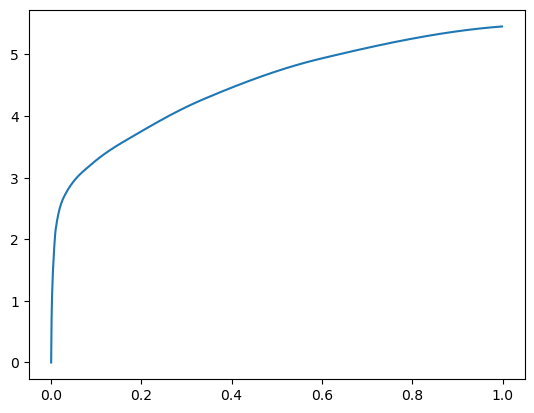

[0.00000000e+00 6.85691833e-04 2.05135345e-03 5.03635406e-03
 1.04169846e-02 3.11288834e-02 9.82084274e-02 2.15508461e-01
 3.66858482e-01 5.84568977e-01 1.00000000e+00] betas
[0.         0.5174135  0.55995821 0.54118503 0.54491474 0.58192713
 0.51116406 0.55297433 0.59570449 0.52208524 0.46909051] r
-22480.269231963164 score post


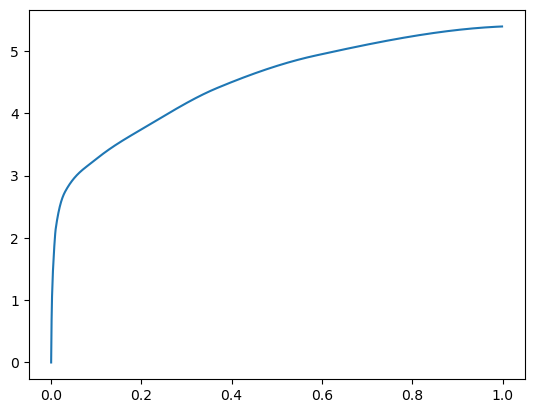

[0.00000000e+00 7.25746155e-04 2.05898285e-03 5.03826141e-03
 1.03197098e-02 2.79302597e-02 9.50078964e-02 2.08025932e-01
 3.39880943e-01 5.44680595e-01 1.00000000e+00] betas
[0.         0.54991049 0.53607957 0.54592654 0.51647446 0.58929388
 0.59051374 0.55858544 0.46699661 0.56395685 0.56580424] r
-22480.269231963164 score post


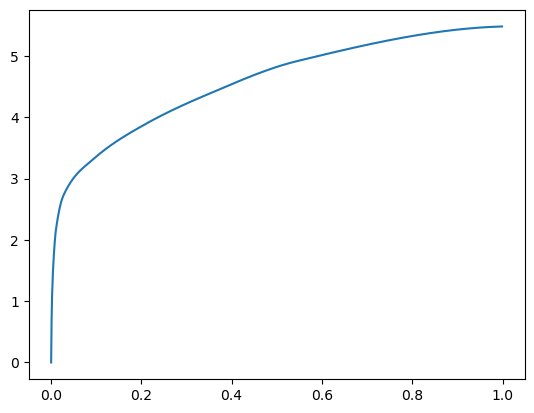

[0.00000000e+00 7.21931458e-04 2.09903717e-03 5.13935089e-03
 1.11608505e-02 2.81915665e-02 8.89806747e-02 1.96406364e-01
 3.50420952e-01 5.54392815e-01 1.00000000e+00] betas
[0.         0.5319901  0.53816807 0.51816453 0.59192232 0.50059971
 0.54614066 0.56816569 0.54193457 0.46604951 0.62956384] r
-22484.52742382129 score post


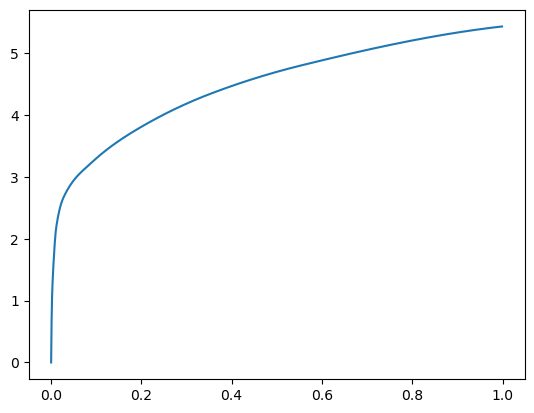

[0.00000000e+00 7.42912292e-04 2.16579437e-03 5.46360016e-03
 1.10197067e-02 3.05776596e-02 9.38291550e-02 1.98220253e-01
 3.53672981e-01 6.02948189e-01 1.00000000e+00] betas
[0.         0.56199968 0.58606757 0.56134495 0.54418102 0.54534492
 0.52288055 0.55473188 0.53598472 0.59402534 0.51057123] r
-22480.269231963164 score post


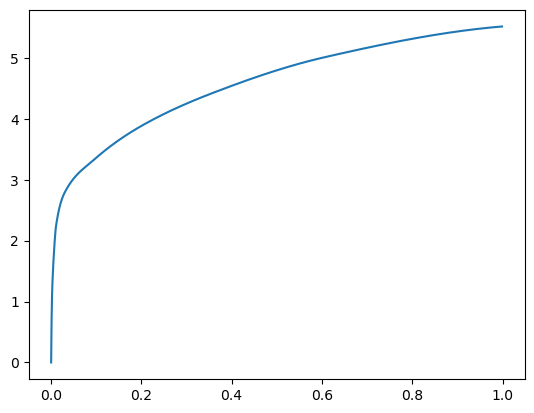

[0.00000000e+00 7.23838806e-04 2.00366974e-03 5.04016876e-03
 1.02148056e-02 2.79188156e-02 9.20591354e-02 1.94811821e-01
 3.54083061e-01 5.79939842e-01 1.00000000e+00] betas
[0.         0.53294498 0.56951677 0.52779643 0.49487023 0.56752236
 0.52432303 0.48259964 0.5837667  0.50357524 0.57819057] r
-22480.269231963164 score post


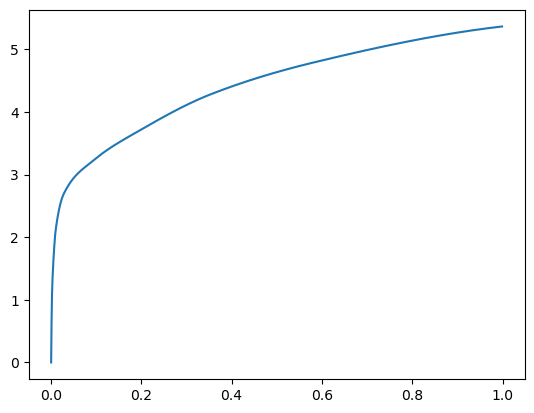

[0.00000000e+00 7.29560852e-04 1.90067291e-03 4.87613678e-03
 1.06153488e-02 2.72550583e-02 9.24024582e-02 2.08334923e-01
 3.57203484e-01 6.03997231e-01 1.00000000e+00] betas
[0.         0.52580473 0.49736062 0.60192955 0.58841771 0.53591936
 0.52575415 0.56150639 0.56305241 0.58718295 0.48567679] r
-22481.990460408004 score post


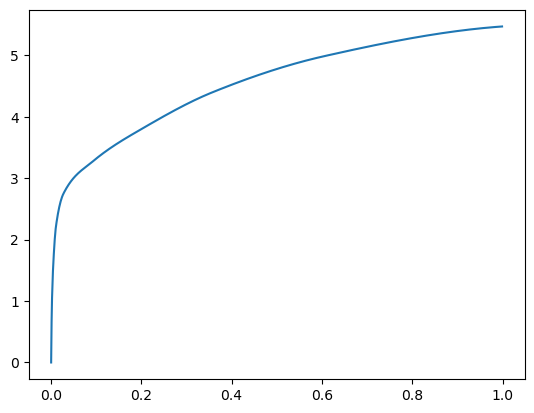

[0.00000000e+00 7.69615173e-04 2.15625763e-03 4.99439240e-03
 1.01919174e-02 2.64005661e-02 9.37585831e-02 2.06959724e-01
 3.50054741e-01 5.69312096e-01 1.00000000e+00] betas
[0.         0.58914072 0.5282629  0.5209431  0.54730415 0.56934055
 0.54071144 0.5788413  0.64748578 0.44564005 0.52054123] r
-22482.458794922564 score post


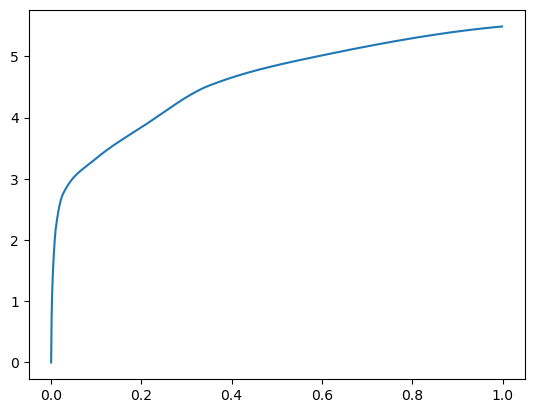

[0.00000000e+00 6.97135925e-04 2.08187103e-03 5.05352020e-03
 1.03597641e-02 2.57101059e-02 9.33218002e-02 2.00093269e-01
 3.13174248e-01 5.51293373e-01 1.00000000e+00] betas
[0.         0.5388146  0.53187446 0.45605065 0.51079283 0.5833436
 0.57645772 0.53292679 0.43181124 0.59827589 0.56983712] r
-22481.621781595804 score post


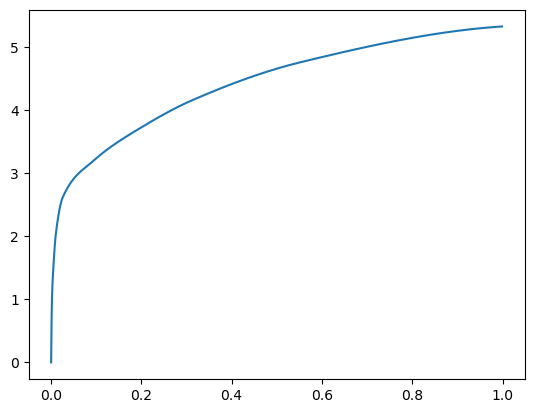

[0.00000000e+00 6.85691833e-04 2.06279755e-03 5.65814972e-03
 1.20325089e-02 2.85577774e-02 9.34419632e-02 2.00293541e-01
 3.46707344e-01 5.72472572e-01 1.00000000e+00] betas
[0.         0.52882509 0.52024548 0.56277263 0.54081987 0.48661801
 0.5111017  0.53836583 0.51475018 0.58647387 0.58894936] r
-22480.269231963164 score post


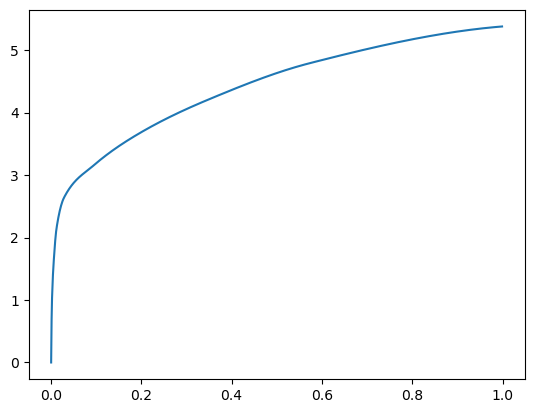

[0.00000000e+00 7.02857971e-04 2.17723846e-03 5.67340851e-03
 1.20096207e-02 3.22923660e-02 1.06110573e-01 2.19059944e-01
 3.79946709e-01 6.00113869e-01 1.00000000e+00] betas
[0.         0.51757439 0.61889586 0.53648225 0.54666661 0.52278744
 0.57269842 0.5577047  0.55962236 0.49004323 0.49280342] r
-22480.269231963164 score post


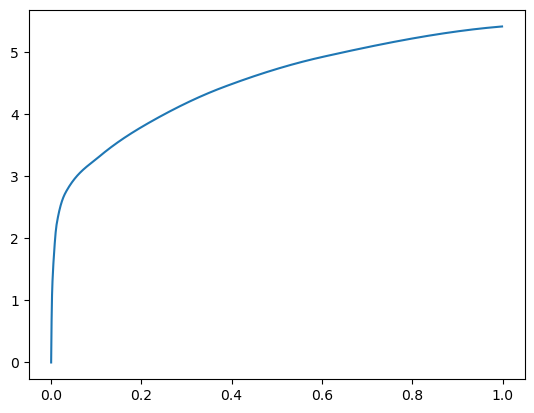

[0.00000000e+00 7.46726990e-04 1.97887421e-03 5.24616241e-03
 1.09930038e-02 2.98433304e-02 9.48877335e-02 1.99555397e-01
 3.45593452e-01 5.71728706e-01 1.00000000e+00] betas
[0.         0.57964569 0.51627853 0.53286072 0.5611109  0.57821318
 0.58031403 0.59516839 0.56566598 0.55201245 0.56351337] r
-22480.269231963164 score post


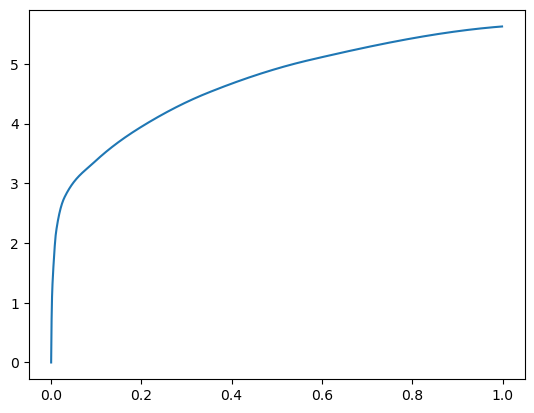

[0.00000000e+00 7.16209412e-04 2.09712982e-03 5.71918488e-03
 1.21984482e-02 3.28207016e-02 9.86623764e-02 1.98216438e-01
 3.42514992e-01 5.72316170e-01 1.00000000e+00] betas
[0.         0.48271632 0.67163249 0.55908374 0.56110123 0.55225123
 0.57608184 0.50055152 0.5282831  0.51070799 0.53188452] r
-22484.348467993714 score post


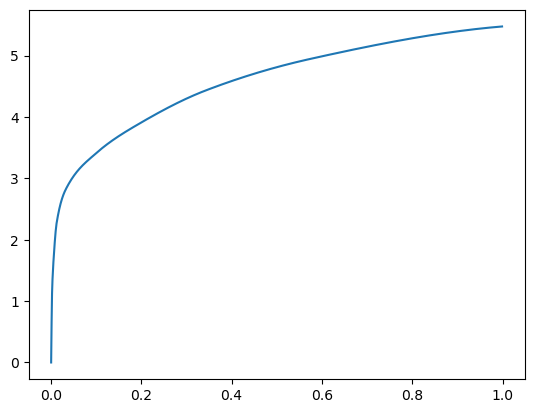

[0.00000000e+00 8.28742981e-04 1.90258026e-03 5.08594513e-03
 1.07126236e-02 2.74038315e-02 8.02736282e-02 1.81616783e-01
 3.24774742e-01 5.62975883e-01 1.00000000e+00] betas
[0.         0.58339743 0.49486566 0.57582154 0.51253511 0.57495365
 0.45183418 0.57476866 0.55164845 0.55077224 0.58442248] r
-22483.215759872455 score post


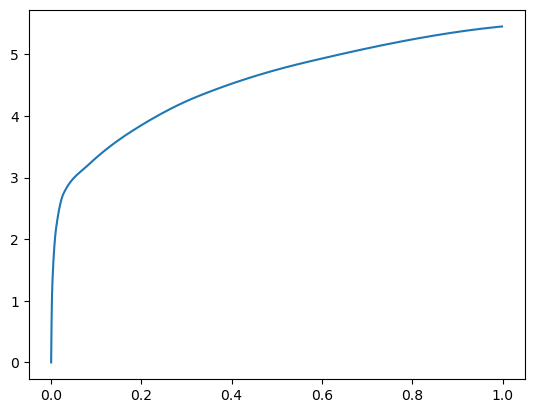

[0.00000000e+00 7.63893127e-04 1.94835663e-03 4.94670868e-03
 1.09987259e-02 2.65398026e-02 9.19981003e-02 1.92589760e-01
 3.39978218e-01 5.85465431e-01 1.00000000e+00] betas
[0.         0.5469315  0.50878947 0.5234264  0.53474712 0.51716517
 0.52203149 0.52145183 0.55811807 0.59187604 0.45682215] r
-22481.378721678564 score post


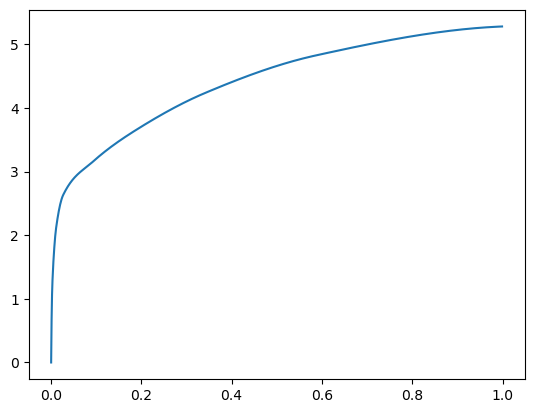

[0.00000000e+00 7.29560852e-04 1.95026398e-03 4.99057770e-03
 1.09720230e-02 2.71978378e-02 9.44795609e-02 1.97678566e-01
 3.37468147e-01 5.44478416e-01 1.00000000e+00] betas
[0.         0.56899608 0.51698933 0.52704811 0.61846613 0.52048812
 0.49044846 0.52026714 0.55008808 0.51408556 0.6203778 ] r
-22480.269231963164 score post


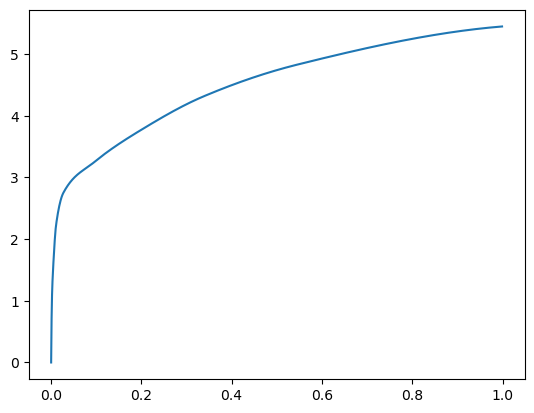

[0.00000000e+00 6.87599182e-04 1.96361542e-03 5.14888763e-03
 1.01346970e-02 2.53610611e-02 9.88130569e-02 2.09048271e-01
 3.52225304e-01 5.86304665e-01 1.00000000e+00] betas
[0.         0.49485511 0.55412852 0.52654857 0.54757671 0.55845817
 0.61674482 0.52504279 0.50009164 0.54687911 0.53829663] r
-22480.269231963164 score post


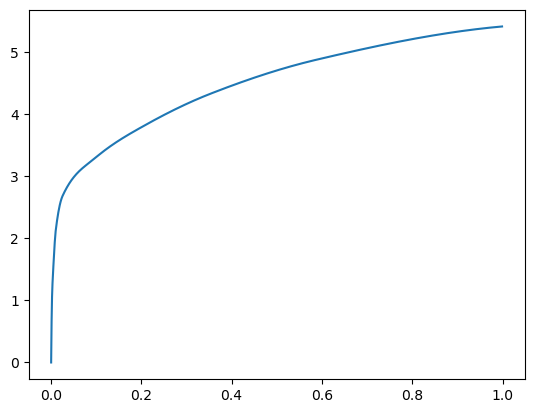

[0.00000000e+00 7.71522522e-04 2.09522247e-03 5.49983978e-03
 1.08194351e-02 2.68201828e-02 8.98046494e-02 1.99858665e-01
 3.53438377e-01 5.84815025e-01 1.00000000e+00] betas
[0.         0.56248633 0.56483647 0.58105895 0.48975042 0.52373894
 0.52407123 0.58449255 0.52679207 0.49050595 0.52892254] r
-22480.269231963164 score post


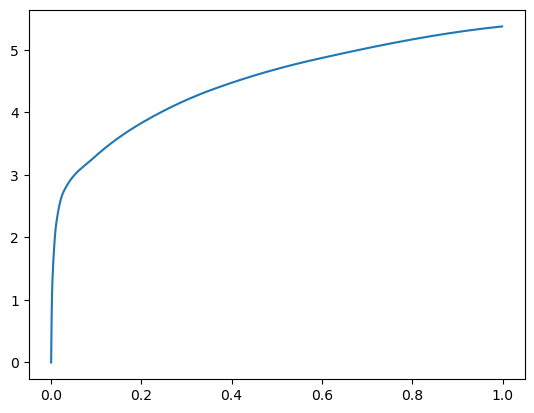

[0.00000000e+00 7.27653503e-04 1.91402435e-03 4.74262238e-03
 1.00221634e-02 2.48479843e-02 8.67185593e-02 1.84491158e-01
 3.33195686e-01 5.79483986e-01 1.00000000e+00] betas
[0.         0.52605162 0.53339211 0.55250266 0.53785642 0.55566449
 0.53433399 0.48827398 0.49511192 0.5631812  0.55339682] r
-22483.215759872455 score post


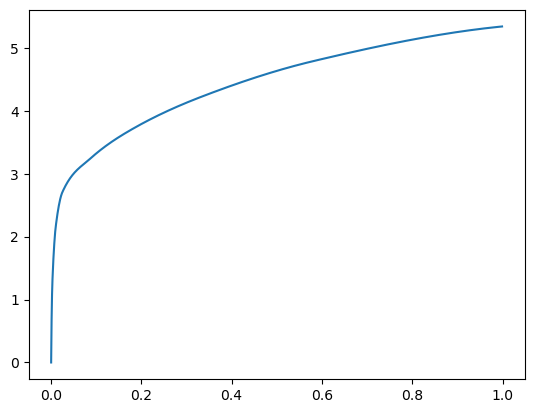

[0.00000000e+00 7.41004944e-04 1.94454193e-03 4.67014313e-03
 9.79518890e-03 2.29558945e-02 8.09335709e-02 1.86909676e-01
 3.51027489e-01 5.90868950e-01 1.00000000e+00] betas
[0.         0.50742412 0.4947499  0.49384655 0.57474357 0.55356495
 0.59232731 0.57220053 0.60414261 0.53948545 0.50624073] r
-22483.215759872455 score post


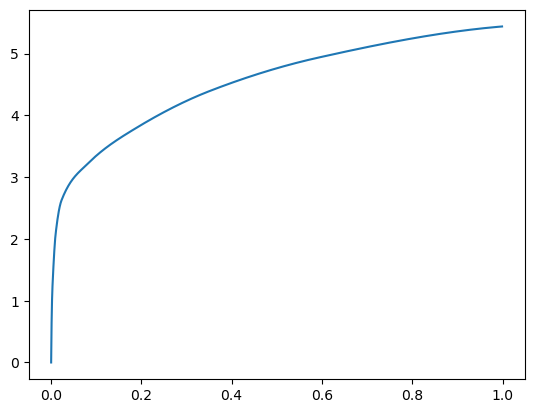

[0.00000000e+00 8.11576843e-04 2.28786469e-03 5.64670563e-03
 1.14698410e-02 2.83670425e-02 8.74814987e-02 1.91037178e-01
 3.36621284e-01 5.68686485e-01 1.00000000e+00] betas
[0.         0.56577377 0.59851958 0.54100135 0.53309    0.5661686
 0.51061419 0.54352299 0.53362607 0.57874296 0.56896511] r
-22486.069890194965 score post


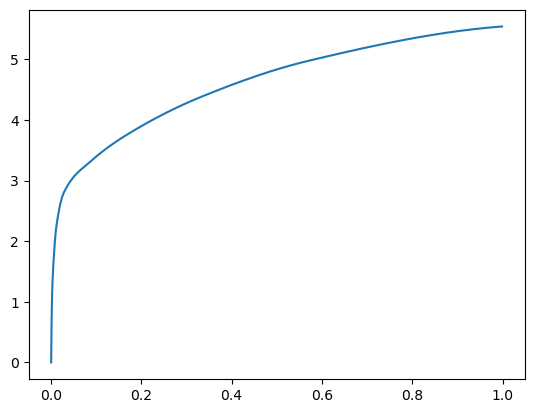

[0.00000000e+00 7.88688660e-04 2.07996368e-03 5.28621674e-03
 1.10731125e-02 2.63814926e-02 8.88109207e-02 1.95492744e-01
 3.49886894e-01 5.77105522e-01 1.00000000e+00] betas
[0.         0.54583271 0.52400721 0.55963148 0.58343981 0.49133417
 0.5931206  0.52543686 0.5133514  0.580326   0.52551266] r
-22481.990460408004 score post


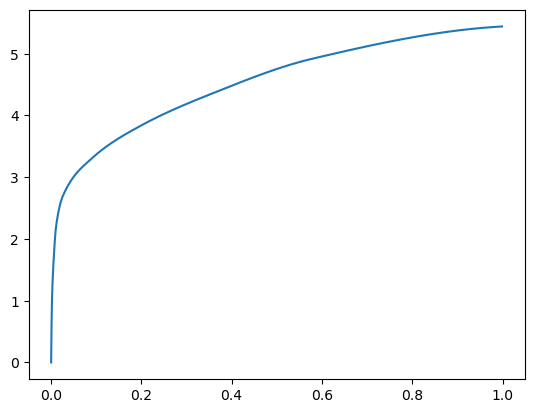

[0.00000000e+00 7.84873962e-04 2.15244293e-03 5.31101227e-03
 1.04665756e-02 2.74095535e-02 8.39319229e-02 1.92158699e-01
 3.55868340e-01 5.66666603e-01 1.00000000e+00] betas
[0.         0.52369789 0.55058583 0.50563605 0.53530465 0.53983901
 0.49316322 0.53192574 0.54809492 0.53670591 0.59314024] r
-22481.378721678564 score post


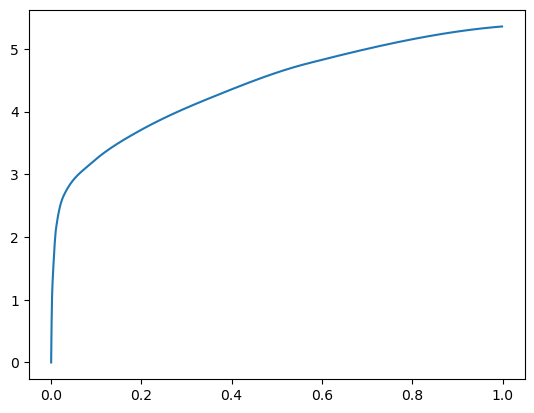

[0.00000000e+00 8.07762146e-04 2.14099884e-03 5.52654266e-03
 1.09949112e-02 2.90136337e-02 9.45711136e-02 2.10076332e-01
 3.75922203e-01 5.97975731e-01 1.00000000e+00] betas
[0.         0.57698903 0.52987214 0.56645911 0.50004932 0.5452014
 0.56399771 0.58653389 0.56654655 0.49712249 0.55697505] r
-22480.269231963164 score post


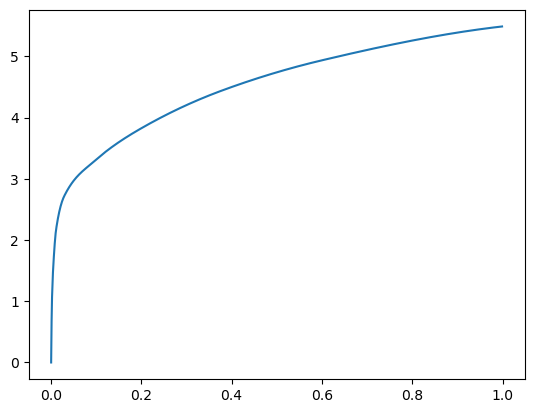

[0.00000000e+00 7.56263733e-04 2.10666656e-03 5.30910492e-03
 1.14507675e-02 3.08046341e-02 9.63029861e-02 2.03755379e-01
 3.60228539e-01 6.02549553e-01 1.00000000e+00] betas
[0.         0.59586821 0.55454691 0.53314095 0.51581795 0.51911466
 0.63677558 0.49797214 0.52564697 0.55583742 0.54063452] r
-22480.269231963164 score post


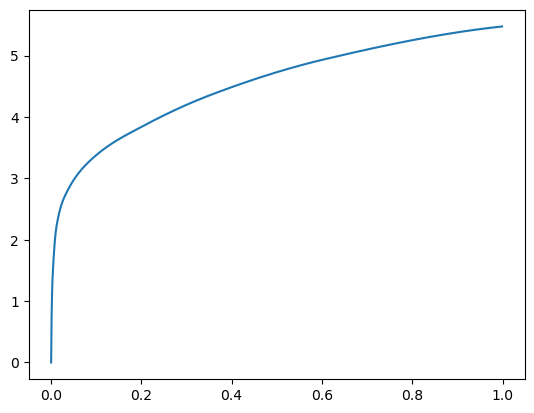

[0.00000000e+00 6.74247742e-04 1.90639496e-03 4.96196747e-03
 1.12504959e-02 3.20482254e-02 8.57439041e-02 1.98523521e-01
 3.60735893e-01 5.98614693e-01 1.00000000e+00] betas
[0.         0.51718526 0.60508155 0.54878719 0.5866731  0.54770636
 0.44901793 0.554495   0.55251766 0.56663003 0.52782159] r
-22480.269231963164 score post


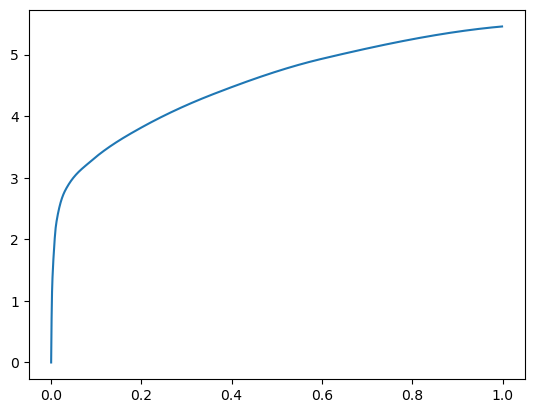

[0.00000000e+00 7.20024109e-04 1.80530548e-03 4.69493866e-03
 9.94586945e-03 2.70624161e-02 8.87594223e-02 2.01035500e-01
 3.61889839e-01 5.88587761e-01 1.00000000e+00] betas
[0.         0.5602684  0.50187721 0.54063    0.55866922 0.61504479
 0.6070563  0.56735139 0.5586306  0.50581751 0.62137108] r
-22480.269231963164 score post


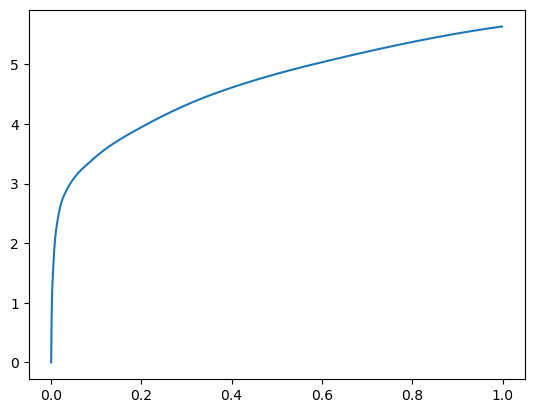

[0.00000000e+00 7.25746155e-04 2.04372406e-03 5.33962250e-03
 1.16033554e-02 2.95495987e-02 8.85400772e-02 1.99786186e-01
 3.61834526e-01 6.20284081e-01 1.00000000e+00] betas
[0.         0.55318542 0.56558991 0.53323298 0.56160383 0.57965106
 0.4751134  0.59475285 0.61008433 0.52425752 0.47493329] r
-22481.621781595804 score post


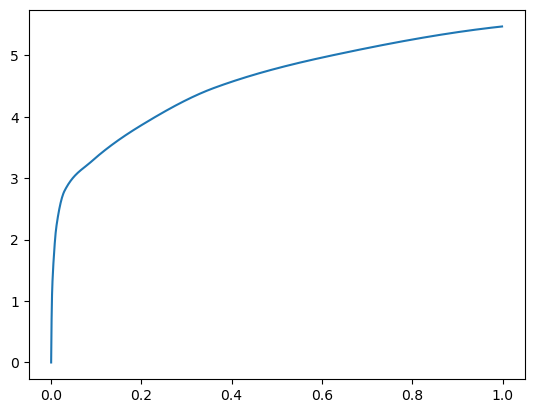

[0.00000000e+00 7.16209412e-04 1.95217133e-03 5.25379181e-03
 1.11532211e-02 2.62899399e-02 9.08479691e-02 1.92580223e-01
 3.29724312e-01 5.75640678e-01 1.00000000e+00] betas
[0.         0.52810904 0.56855883 0.5810535  0.53700154 0.56630982
 0.52361157 0.54737123 0.47829576 0.56469173 0.55760682] r
-22483.2822716802 score post


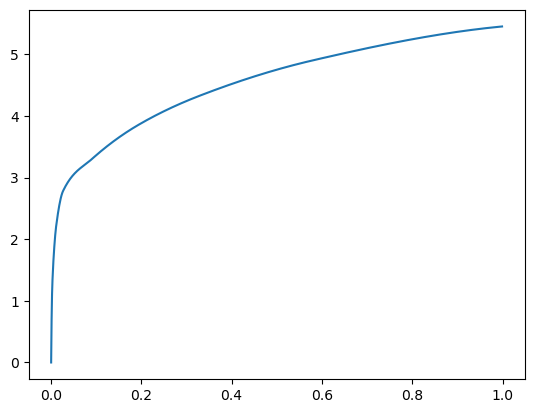

[0.00000000e+00 7.46726990e-04 1.92928314e-03 4.91809845e-03
 1.05905533e-02 2.35300064e-02 8.55684280e-02 1.84506416e-01
 3.41063499e-01 5.82861900e-01 1.00000000e+00] betas
[0.         0.55103033 0.51026881 0.54898903 0.56541889 0.45167585
 0.55132212 0.57739238 0.52415894 0.55021554 0.50021604] r
-22480.269231963164 score post


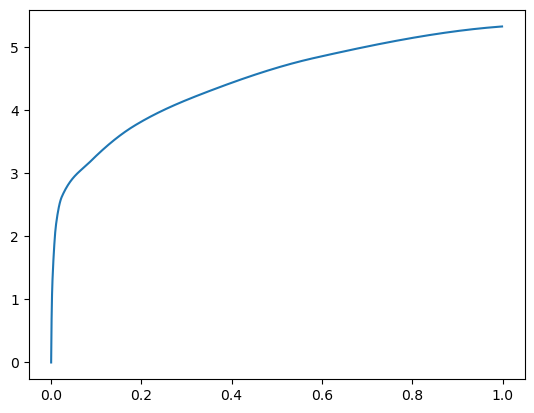

528428 steps_after


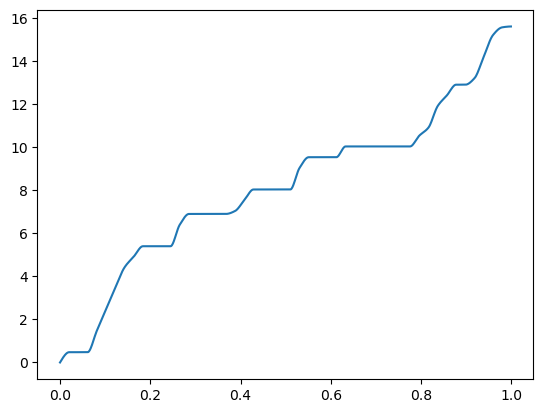

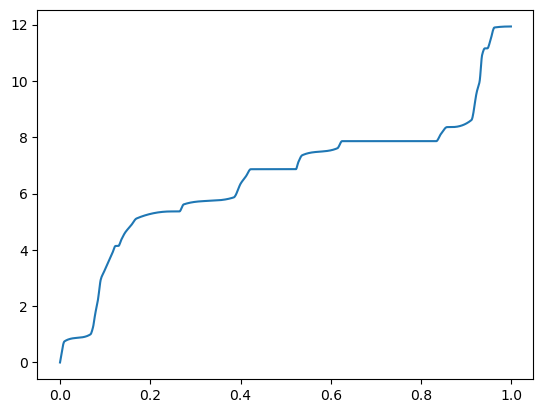

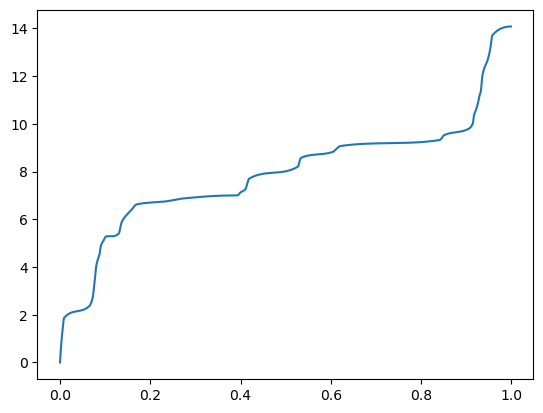

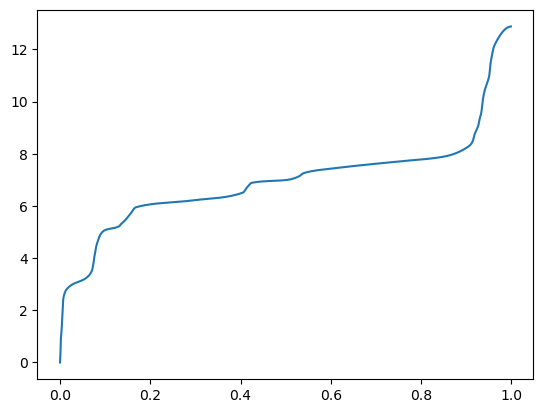

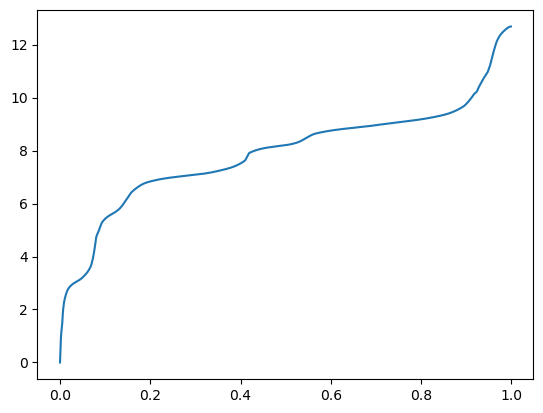

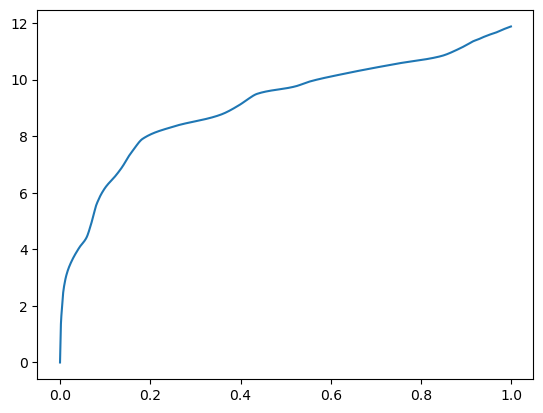

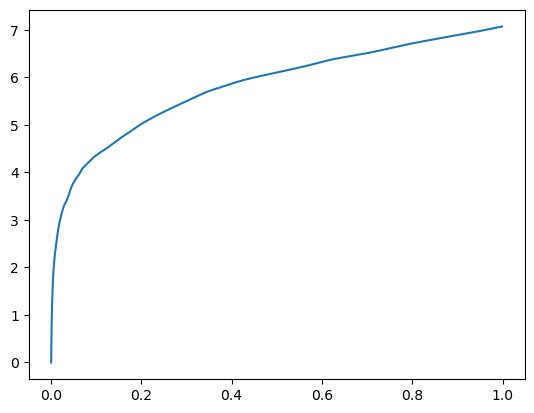

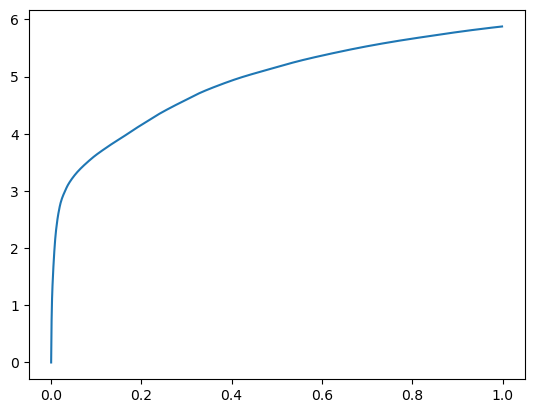

11396 steps
betas [0.00000000e+00 7.69615173e-04 2.25734711e-03 5.63716888e-03
 1.14393234e-02 2.74496078e-02 8.37049484e-02 1.91613197e-01
 3.26212883e-01 5.57707787e-01 1.00000000e+00]
n_chains 11
[0.00000000e+00 7.69615173e-04 2.25734711e-03 5.63716888e-03
 1.14393234e-02 2.74496078e-02 8.37049484e-02 1.91613197e-01
 3.26212883e-01 5.57707787e-01 1.00000000e+00] betas
[0.         0.         0.00626089 0.00808891 0.         0.
 0.26330245 0.         0.         0.         0.        ] r
-22481.621781595804 score post


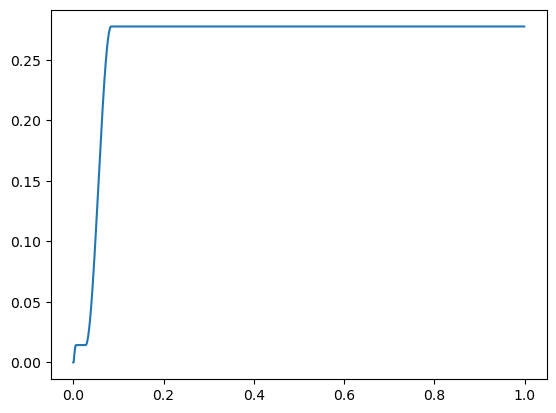

[0.         0.03514004 0.04152012 0.04631138 0.0505476  0.05455494
 0.05852032 0.06261158 0.06705761 0.07236958 1.        ] betas
[0.         0.99642945 0.09353609 0.06010383 0.04708693 0.0415866
 0.03824563 0.03712457 0.0396067  0.04480466 0.99427469] r
-22480.269231963164 score post


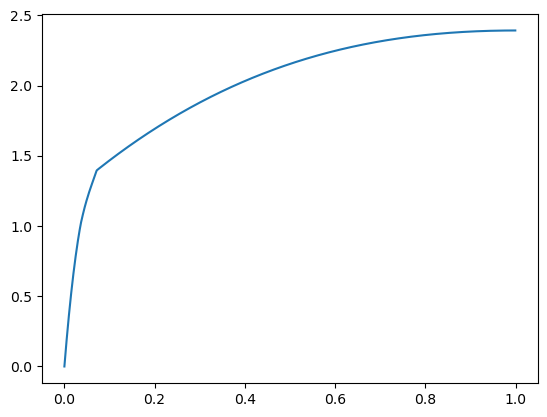

[0.         0.00635242 0.01360989 0.02219868 0.03302097 0.05047703
 0.08709049 0.1916647  0.32070827 0.49872875 1.        ] betas
[0.         0.95498804 0.59527571 0.28834948 0.19233311 0.21312383
 0.2932962  0.5369725  0.49984907 0.48640774 0.70156965] r
-22480.269231963164 score post


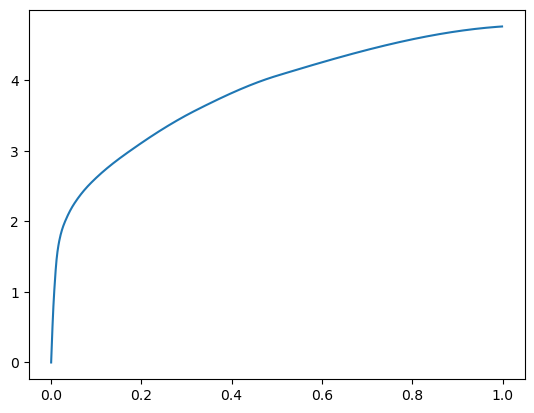

[0.         0.00278378 0.00632763 0.01156712 0.02530575 0.06564236
 0.14438915 0.25358486 0.3969965  0.61743641 1.        ] betas
[0.         0.90410331 0.53278827 0.47050683 0.4344645  0.46440267
 0.46995009 0.52486992 0.48698558 0.46352487 0.52688444] r
-22481.378721678564 score post


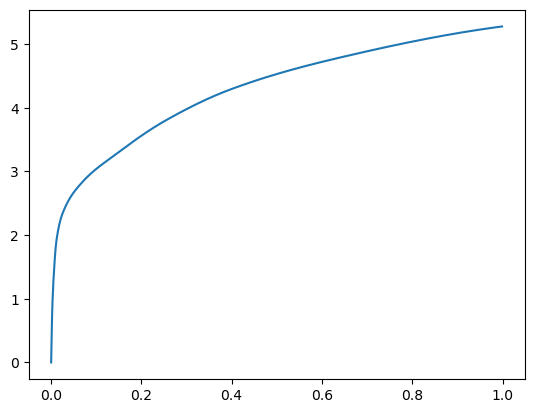

[0.         0.00141811 0.00357342 0.00764942 0.01635456 0.04681301
 0.12346172 0.22853184 0.37354183 0.61686802 1.        ] betas
[0.         0.82143454 0.55094845 0.54567171 0.5276783  0.49637765
 0.53305792 0.50347378 0.48642314 0.55904295 0.49541556] r
-22488.224033391914 score post


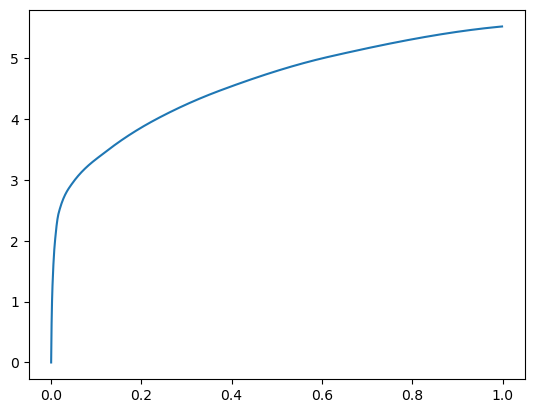

[0.00000000e+00 8.47816467e-04 2.32982635e-03 5.33771515e-03
 1.14088058e-02 3.12967300e-02 9.46893692e-02 2.00964928e-01
 3.56108665e-01 5.85181236e-01 1.00000000e+00] betas
[0.         0.58681294 0.56120689 0.5320412  0.58136786 0.51336592
 0.55173779 0.56381649 0.56224789 0.53858108 0.53927897] r
-22480.269231963164 score post


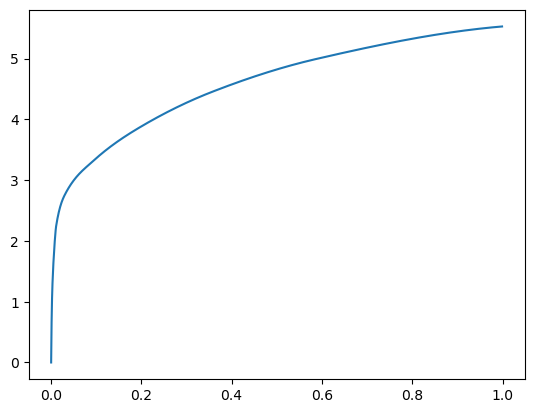

[0.00000000e+00 7.82966614e-04 2.17151642e-03 5.17559052e-03
 1.05123520e-02 3.06310654e-02 9.34572220e-02 1.96618080e-01
 3.46495628e-01 5.77298164e-01 1.00000000e+00] betas
[0.         0.60525643 0.59257734 0.54113277 0.51048759 0.5597329
 0.52253122 0.53353746 0.58000625 0.54176318 0.52932214] r
-22480.269231963164 score post


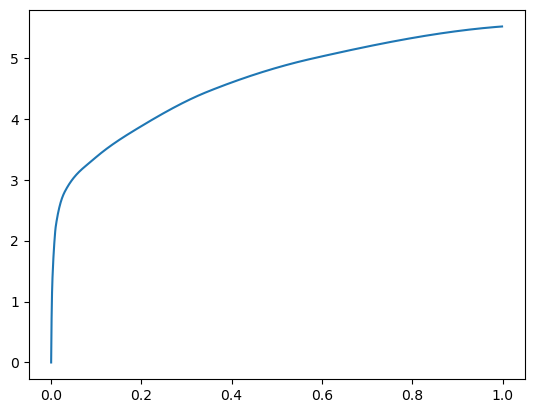

[0.00000000e+00 6.93321228e-04 1.86252594e-03 4.54616547e-03
 9.75513458e-03 2.73275375e-02 9.00316238e-02 1.95765495e-01
 3.35965157e-01 5.64345360e-01 1.00000000e+00] betas
[0.         0.55113674 0.49262355 0.48140622 0.5530454  0.59863793
 0.5800427  0.53994259 0.49724406 0.55712457 0.60178625] r
-22489.959403240897 score post


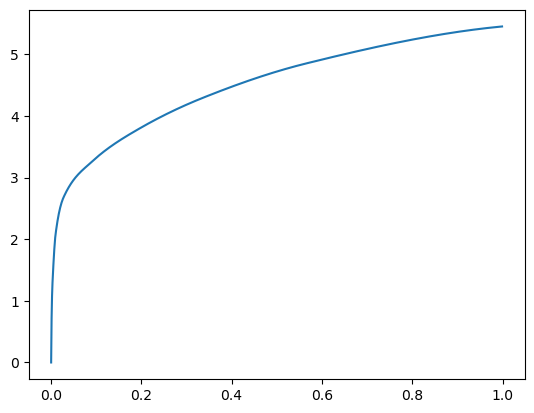

[0.00000000e+00 6.83784485e-04 2.04563141e-03 5.36823273e-03
 1.16662979e-02 3.04841995e-02 9.22574997e-02 2.00592995e-01
 3.59562874e-01 5.95688820e-01 1.00000000e+00] betas
[0.         0.53235946 0.54332542 0.54995987 0.59488041 0.51311761
 0.51961392 0.55808901 0.52662523 0.55098019 0.51912234] r
-22484.290199644343 score post


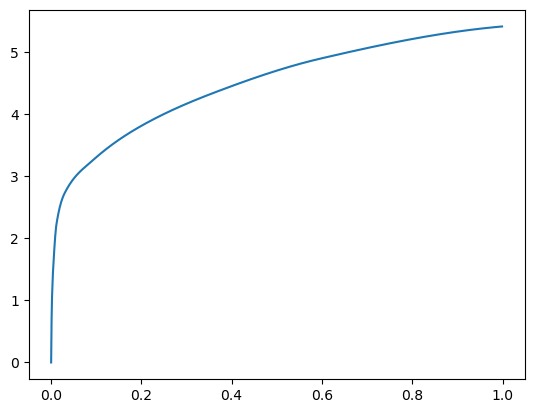

[0.00000000e+00 6.99043274e-04 2.07042694e-03 5.34152985e-03
 1.06573105e-02 2.85081863e-02 9.09624100e-02 1.94375038e-01
 3.55418205e-01 5.83247185e-01 1.00000000e+00] betas
[0.         0.58583601 0.56250197 0.57643238 0.51687161 0.54349151
 0.54328031 0.52803018 0.55998198 0.54308273 0.5946505 ] r
-22486.71698678069 score post


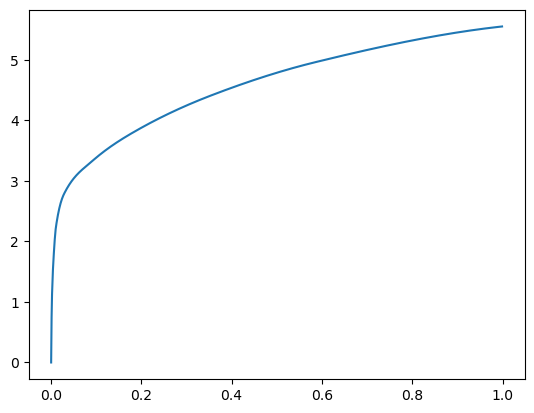

[0.00000000e+00 6.47544861e-04 1.93309784e-03 4.89330292e-03
 1.02968216e-02 2.79836655e-02 9.15842056e-02 2.01945305e-01
 3.64882469e-01 6.04807854e-01 1.00000000e+00] betas
[0.         0.53206741 0.57301632 0.51994933 0.60449029 0.56456745
 0.52837394 0.59374458 0.56313514 0.54193679 0.55316382] r
-22481.378721678564 score post


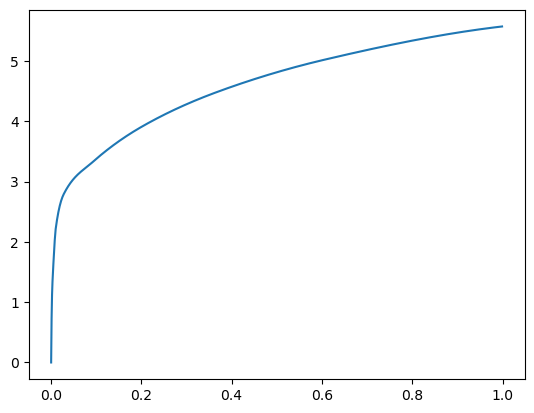

[0.00000000e+00 6.89506531e-04 1.96933746e-03 5.23281097e-03
 1.03006363e-02 2.75297165e-02 9.49411392e-02 1.98664665e-01
 3.57798576e-01 6.02385521e-01 1.00000000e+00] betas
[0.         0.53521961 0.6011748  0.58660809 0.51207476 0.56313273
 0.60037812 0.53674462 0.55531534 0.52562558 0.47464954] r
-22480.269231963164 score post


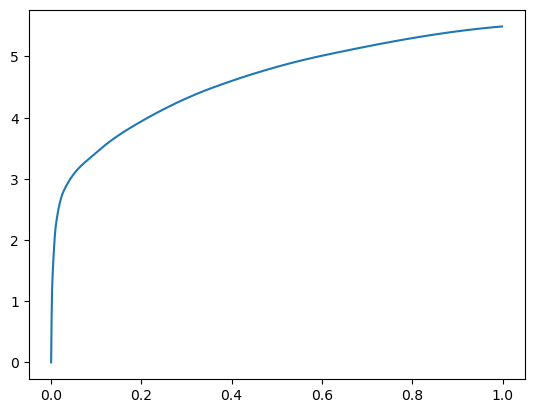

[0.00000000e+00 7.12394714e-04 1.84345245e-03 4.66442108e-03
 9.67502594e-03 2.45943069e-02 7.85856247e-02 1.77493095e-01
 3.23811531e-01 5.58039665e-01 1.00000000e+00] betas
[0.         0.57737993 0.56196804 0.52518907 0.50005689 0.56472978
 0.64545652 0.53599813 0.54606125 0.55876423 0.60965745] r
-22482.597739918583 score post


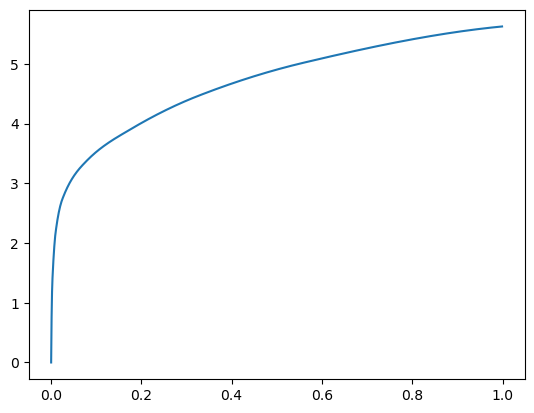

[0.00000000e+00 6.89506531e-04 1.79576874e-03 4.83798981e-03
 1.11799240e-02 2.89335251e-02 7.86352158e-02 1.83547020e-01
 3.38637352e-01 5.84431648e-01 1.00000000e+00] betas
[0.         0.55252949 0.45825316 0.55866243 0.57997039 0.60656122
 0.50424637 0.56239622 0.53828582 0.55319728 0.56102852] r
-22481.378721678564 score post


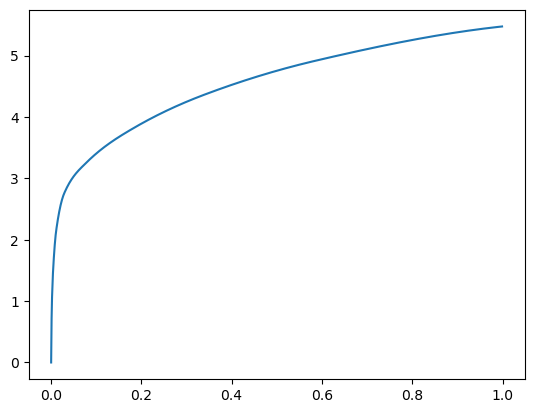

[0.00000000e+00 6.79969788e-04 2.12192535e-03 5.42736053e-03
 1.19524002e-02 2.79092789e-02 8.20913315e-02 1.85889244e-01
 3.45593452e-01 5.92284203e-01 1.00000000e+00] betas
[0.         0.5282391  0.55429647 0.56716982 0.58820895 0.49772648
 0.51923804 0.55804155 0.5626449  0.57519771 0.47185164] r
-22480.269231963164 score post


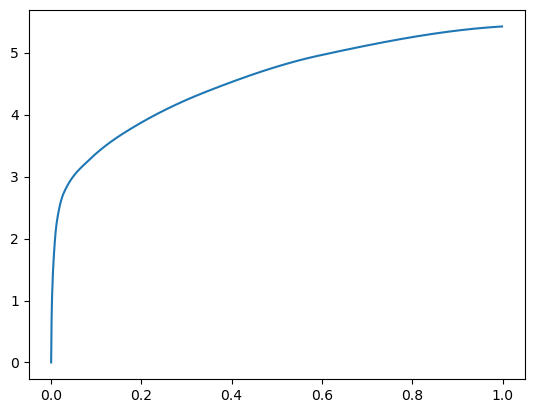

[0.00000000e+00 7.06672668e-04 2.12955475e-03 5.24234772e-03
 1.07698441e-02 2.64997482e-02 8.19063187e-02 1.81948662e-01
 3.32640648e-01 5.51886559e-01 1.00000000e+00] betas
[0.         0.50610243 0.58177313 0.53475171 0.49037939 0.50255121
 0.52827746 0.54922218 0.56602609 0.56974626 0.59750213] r
-22485.2760344757 score post


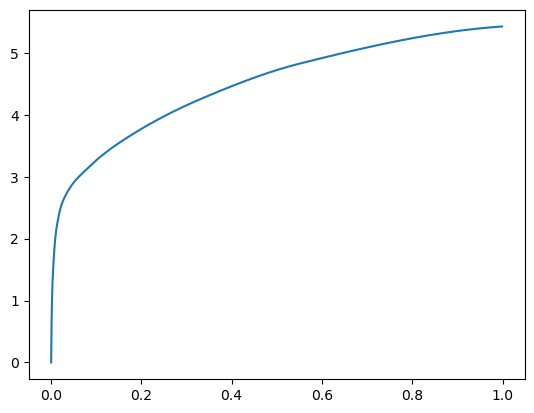

[0.00000000e+00 7.75337219e-04 2.12001801e-03 5.28621674e-03
 1.19390488e-02 3.29732895e-02 9.84125137e-02 2.06002235e-01
 3.59318733e-01 5.82058907e-01 1.00000000e+00] betas
[0.         0.55880817 0.56583462 0.573594   0.61288067 0.54495806
 0.52894218 0.55041107 0.50171012 0.5203731  0.59598662] r
-22482.458794922564 score post


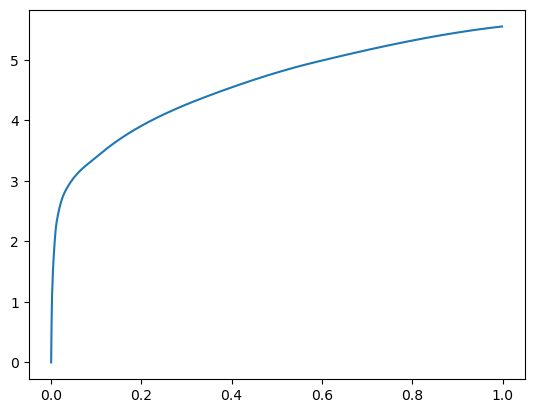

[0.00000000e+00 7.69615173e-04 2.06851959e-03 5.03635406e-03
 1.03921890e-02 2.78120041e-02 8.98466110e-02 1.94413185e-01
 3.61374855e-01 6.04571342e-01 1.00000000e+00] betas
[0.         0.58129224 0.57370749 0.52100287 0.5840393  0.57621255
 0.50829582 0.52210205 0.59263788 0.49051383 0.47748185] r
-22485.907070885154 score post


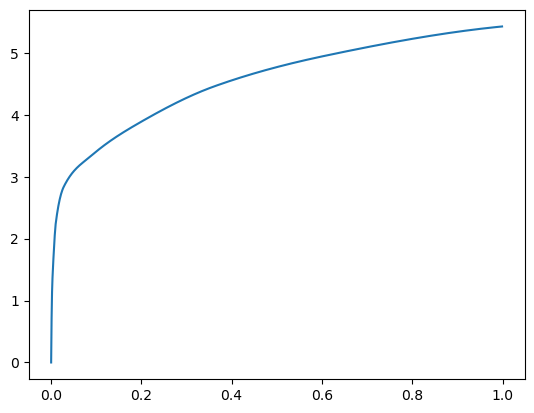

[0.00000000e+00 7.04765320e-04 1.83963776e-03 4.68540192e-03
 9.16385651e-03 2.17199326e-02 7.49368668e-02 1.78526878e-01
 3.20797920e-01 5.63883781e-01 1.00000000e+00] betas
[0.         0.57092577 0.53372387 0.53665812 0.49586769 0.53940084
 0.53979457 0.58006962 0.52027922 0.55106881 0.53430457] r
-22480.269231963164 score post


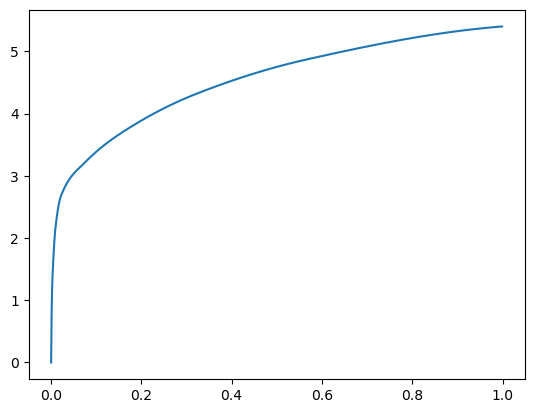

[0.00000000e+00 6.55174255e-04 1.75952911e-03 4.54044342e-03
 9.52243805e-03 2.30474472e-02 7.83166885e-02 1.75189018e-01
 3.22533607e-01 5.60297966e-01 1.00000000e+00] betas
[0.         0.53281734 0.55077881 0.55461901 0.55837688 0.49134959
 0.55453418 0.54096094 0.54845268 0.52491082 0.59387751] r
-22485.11013607975 score post


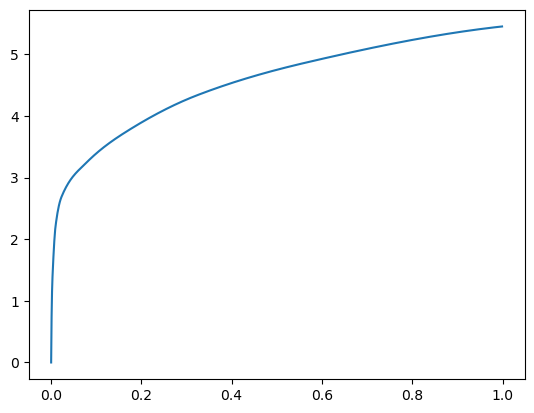

[0.00000000e+00 6.74247742e-04 1.78050995e-03 4.51946259e-03
 9.26303864e-03 2.52122879e-02 8.21599960e-02 1.82316780e-01
 3.32781792e-01 5.88929176e-01 1.00000000e+00] betas
[0.         0.54089628 0.50782691 0.55090787 0.49605024 0.64556497
 0.55930266 0.50257508 0.61278486 0.60542153 0.49386843] r
-22486.77251990861 score post


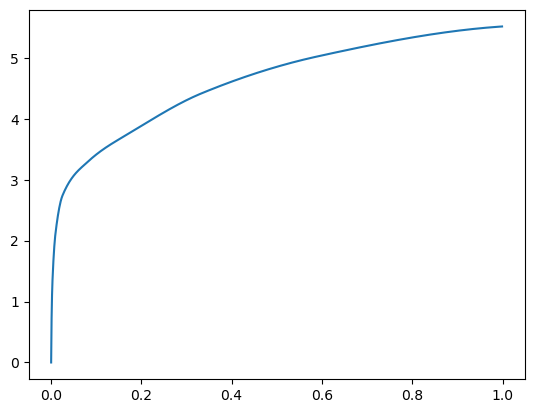

[0.00000000e+00 6.91413879e-04 1.96933746e-03 4.91428375e-03
 1.10788345e-02 2.61392593e-02 8.34188461e-02 1.95006371e-01
 3.31562996e-01 5.55653572e-01 1.00000000e+00] betas
[0.         0.51162669 0.52652795 0.52269649 0.55777224 0.47815494
 0.58281644 0.60599448 0.505912   0.51514633 0.59567904] r
-22483.343010040644 score post


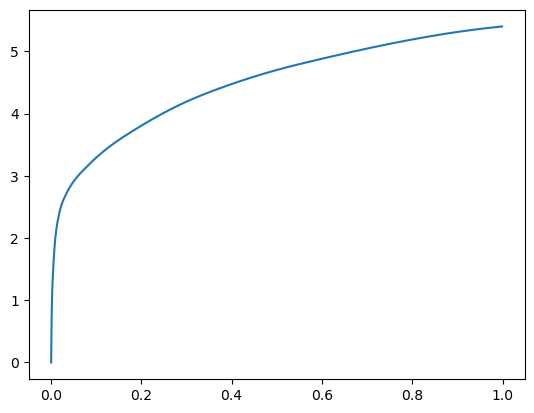

[0.00000000e+00 7.44819641e-04 2.13527679e-03 5.40256500e-03
 1.19409561e-02 3.26986313e-02 9.21125412e-02 1.94113731e-01
 3.42169762e-01 5.87693214e-01 1.00000000e+00] betas
[0.         0.52739167 0.6207243  0.56309499 0.5947833  0.59917321
 0.50340571 0.51399418 0.49648114 0.5940864  0.57108307] r
-22480.269231963164 score post


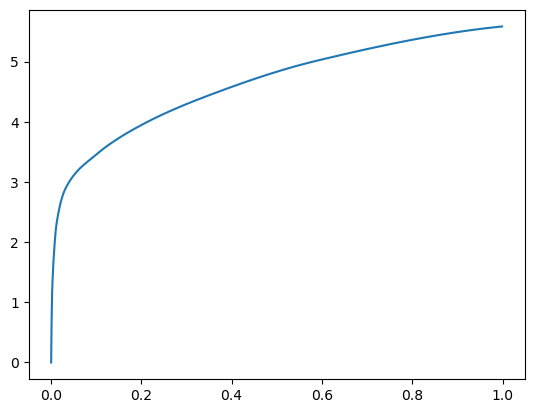

[0.00000000e+00 8.00132751e-04 2.02465057e-03 5.11264801e-03
 1.06935501e-02 2.63414383e-02 8.28504562e-02 1.90787315e-01
 3.59238625e-01 5.94727516e-01 1.00000000e+00] betas
[0.         0.57786072 0.52281671 0.5902288  0.50525877 0.48345363
 0.49135748 0.52217555 0.59532539 0.52846567 0.5285409 ] r
-22481.621781595804 score post


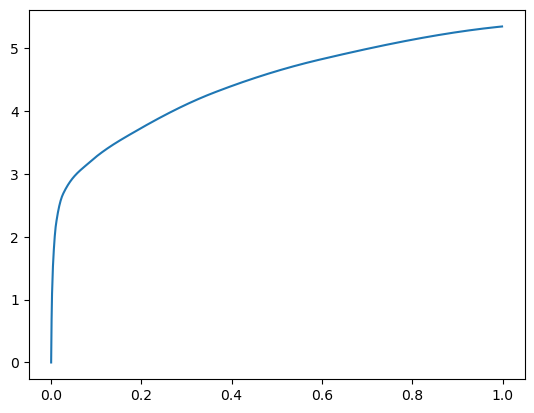

[0.00000000e+00 7.23838806e-04 1.91783905e-03 4.47368622e-03
 9.69028473e-03 2.58989334e-02 8.86335373e-02 2.02662468e-01
 3.54924202e-01 5.91189384e-01 1.00000000e+00] betas
[0.         0.53835917 0.53258893 0.53125956 0.57430453 0.5396474
 0.53063999 0.54567707 0.53439328 0.54304689 0.55624732] r
-22485.70121138277 score post


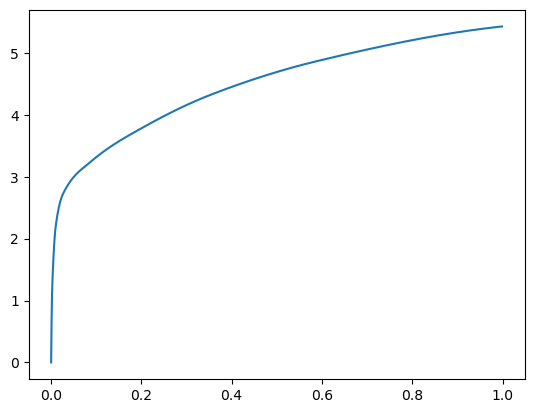

[0.00000000e+00 7.31468201e-04 1.96552277e-03 4.64725494e-03
 9.58538055e-03 2.56986618e-02 9.00564194e-02 2.04094887e-01
 3.59929085e-01 5.98998070e-01 1.00000000e+00] betas
[0.         0.51610788 0.58298106 0.4866807  0.52353349 0.57104563
 0.54301989 0.6001561  0.54303059 0.54725251 0.56250033] r
-22480.269231963164 score post


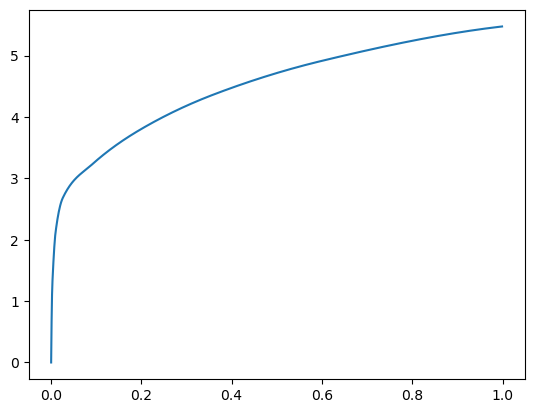

[0.00000000e+00 7.86781311e-04 1.95217133e-03 5.06687164e-03
 1.10368729e-02 2.96030045e-02 9.96828079e-02 2.06435204e-01
 3.65118980e-01 6.07392311e-01 1.00000000e+00] betas
[0.         0.57896276 0.46890643 0.5417912  0.55483153 0.5435138
 0.5549364  0.5021917  0.58226599 0.54628442 0.47375996] r
-22483.17300509828 score post


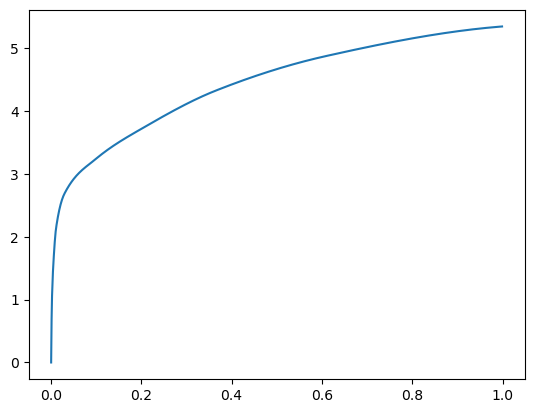

[0.00000000e+00 7.06672668e-04 2.03609467e-03 5.18321991e-03
 1.09262466e-02 2.86245346e-02 9.37852859e-02 2.05971718e-01
 3.48414421e-01 5.71784019e-01 1.00000000e+00] betas
[0.         0.55411393 0.54394216 0.52717455 0.55949451 0.56654483
 0.54924089 0.60854495 0.48312909 0.46942256 0.62028894] r
-22484.52742382129 score post


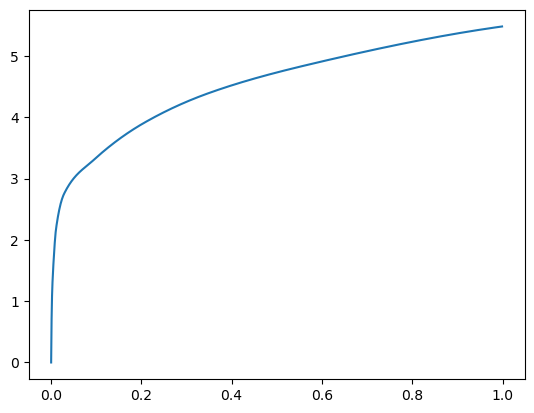

[0.00000000e+00 6.95228577e-04 2.03037262e-03 5.33580780e-03
 1.10788345e-02 2.79588699e-02 9.20743942e-02 1.89585686e-01
 3.45900536e-01 6.13440514e-01 1.00000000e+00] betas
[0.         0.61671253 0.5427299  0.55360805 0.57983627 0.52234642
 0.59088784 0.4918034  0.53162968 0.57492924 0.51735853] r
-22490.598108769063 score post


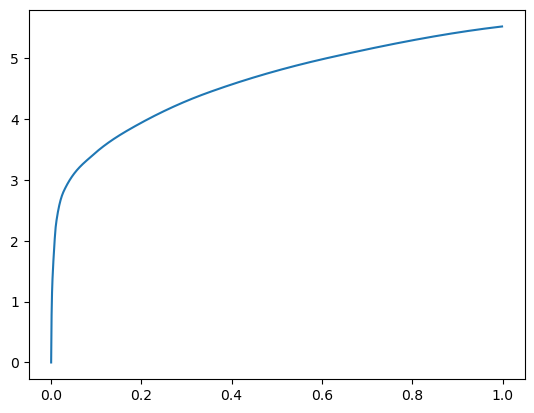

[0.00000000e+00 5.94139099e-04 1.82819366e-03 4.89711761e-03
 9.81044769e-03 2.48956680e-02 7.77978897e-02 1.81715965e-01
 3.41437340e-01 5.93014717e-01 1.00000000e+00] betas
[0.         0.46443917 0.56850609 0.54826567 0.54640157 0.59423103
 0.53116777 0.53061238 0.56262898 0.54093911 0.65744675] r
-22483.811344555204 score post


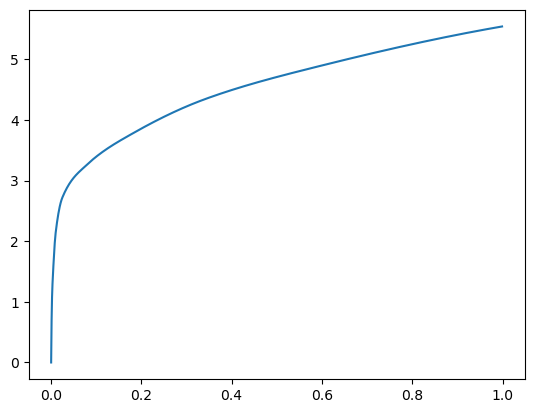

[0.00000000e+00 7.48634338e-04 2.12001801e-03 5.49221039e-03
 1.12962723e-02 2.78158188e-02 8.87784958e-02 2.05336571e-01
 3.75735283e-01 6.48959160e-01 1.00000000e+00] betas
[0.         0.54950892 0.52279122 0.53632539 0.55249257 0.52054481
 0.54310194 0.58190265 0.54585535 0.56563938 0.49285967] r
-22481.990460408004 score post


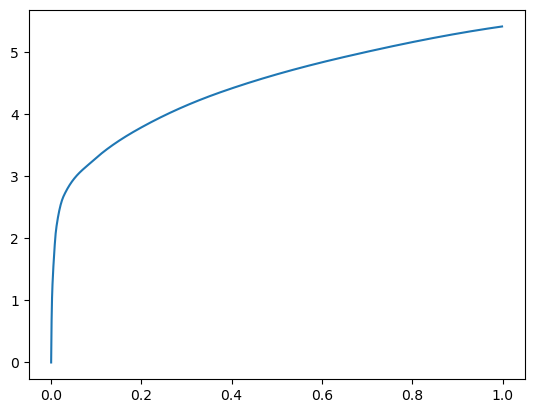

[0.00000000e+00 7.33375549e-04 2.16197968e-03 5.61237335e-03
 1.13611221e-02 2.93779373e-02 9.21239853e-02 2.00570107e-01
 3.66570473e-01 6.20854378e-01 1.00000000e+00] betas
[0.         0.53994007 0.55969204 0.57162692 0.51972141 0.57428511
 0.57805715 0.51270919 0.52924426 0.53933421 0.47046697] r
-22480.269231963164 score post


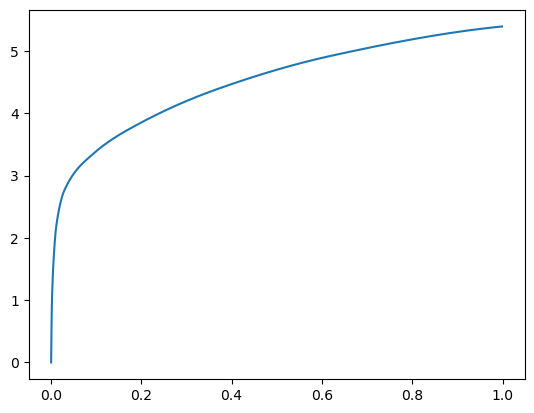

[0.00000000e+00 7.33375549e-04 2.08187103e-03 5.17940521e-03
 1.07755661e-02 2.57310867e-02 7.55319595e-02 1.80169106e-01
 3.40640068e-01 5.79926491e-01 1.00000000e+00] betas
[0.         0.54146212 0.53590847 0.50310643 0.5112408  0.62655089
 0.52325516 0.55005478 0.58975769 0.54242859 0.58302957] r
-22480.269231963164 score post


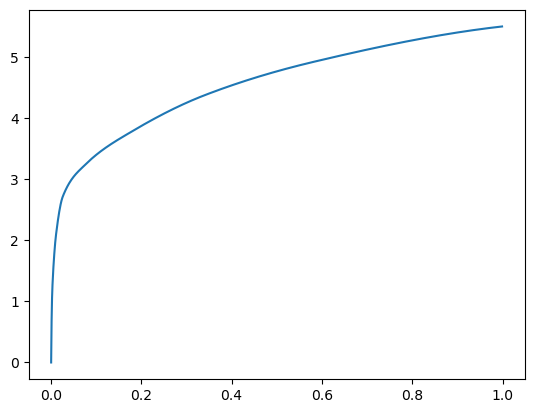

[0.00000000e+00 7.50541687e-04 2.18105316e-03 5.78975677e-03
 1.26581192e-02 2.76498795e-02 8.44278336e-02 1.94771767e-01
 3.49169731e-01 5.98391533e-01 1.00000000e+00] betas
[0.         0.55490904 0.55183615 0.55742872 0.55907943 0.51261045
 0.49771452 0.57737402 0.53608337 0.57167004 0.50450904] r
-22480.269231963164 score post


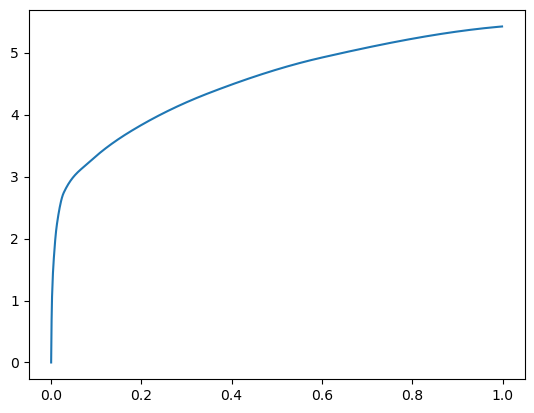

[0.00000000e+00 7.27653503e-04 2.09140778e-03 5.45597076e-03
 1.16815567e-02 2.62727737e-02 8.74738693e-02 1.91302299e-01
 3.46167564e-01 5.76489449e-01 1.00000000e+00] betas
[0.         0.53228825 0.56521964 0.59442547 0.58805221 0.47557578
 0.53559856 0.54147801 0.5350291  0.52112997 0.53690261] r
-22480.269231963164 score post


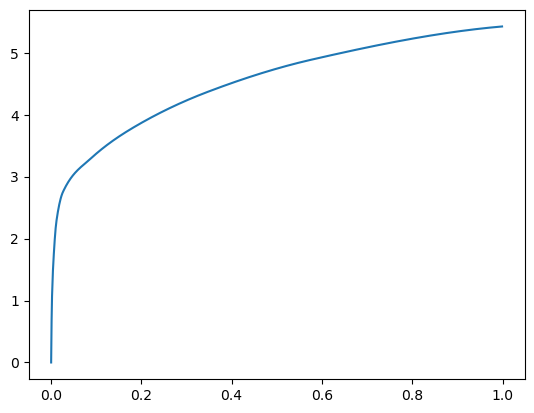

[0.00000000e+00 7.46726990e-04 2.04563141e-03 4.96006012e-03
 1.00030899e-02 2.39095688e-02 8.19520950e-02 1.83163643e-01
 3.36522102e-01 5.73119164e-01 1.00000000e+00] betas
[0.         0.51558169 0.54501854 0.51508105 0.52972331 0.50541297
 0.55842358 0.54075426 0.52635692 0.56173435 0.47897257] r
-22484.290199644343 score post


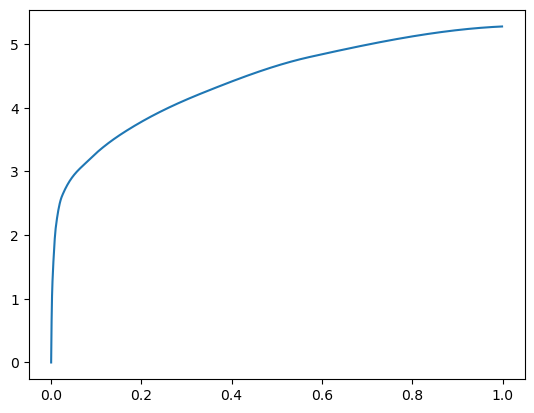

[0.00000000e+00 7.69615173e-04 2.02655792e-03 5.01537323e-03
 1.00965500e-02 2.55479813e-02 8.15248489e-02 1.79396629e-01
 3.31374168e-01 5.44596672e-01 1.00000000e+00] betas
[0.         0.55366165 0.53632031 0.49290419 0.54380912 0.53796975
 0.49258441 0.51967951 0.61330858 0.52992935 0.57382384] r
-22480.269231963164 score post


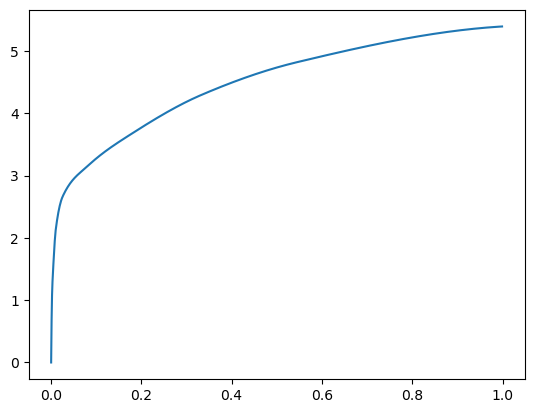

[0.00000000e+00 7.44819641e-04 1.98459625e-03 5.28240204e-03
 1.06439590e-02 2.76479721e-02 9.36861038e-02 2.00953484e-01
 3.39430809e-01 5.64440727e-01 1.00000000e+00] betas
[0.         0.53008786 0.55901439 0.57443391 0.52985466 0.55686843
 0.52272909 0.51826513 0.47516984 0.4965344  0.58031755] r
-22489.390301541433 score post


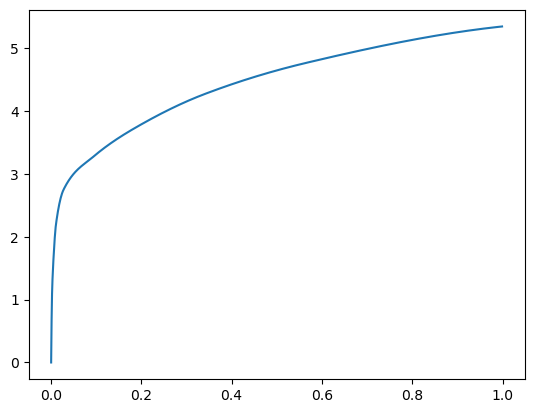

[0.00000000e+00 7.52449036e-04 1.91211700e-03 4.81319427e-03
 9.75894928e-03 2.34003067e-02 8.20093155e-02 1.88471794e-01
 3.42438698e-01 5.91576576e-01 1.00000000e+00] betas
[0.         0.5682093  0.53809424 0.54328564 0.52471342 0.5682805
 0.57127089 0.5195896  0.4783604  0.64905953 0.46517329] r
-22480.269231963164 score post


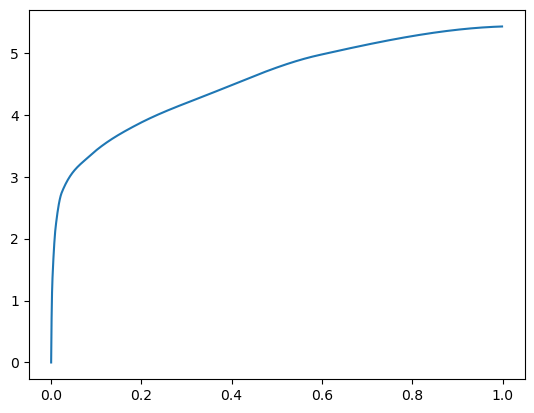

[0.00000000e+00 7.10487366e-04 1.84154510e-03 4.65679169e-03
 9.69982147e-03 2.19717026e-02 7.30352402e-02 1.79379463e-01
 3.52545738e-01 5.50702095e-01 1.00000000e+00] betas
[0.         0.5616541  0.51773391 0.49171676 0.57368832 0.51876104
 0.49628872 0.58224001 0.5749427  0.47380738 0.5756253 ] r
-22480.269231963164 score post


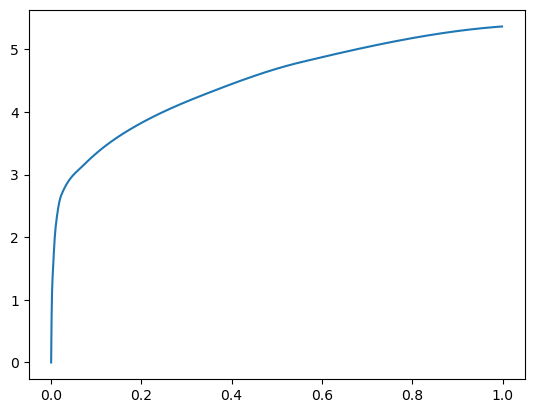

[0.00000000e+00 6.68525696e-04 1.81865692e-03 4.93335724e-03
 9.72652435e-03 2.30760574e-02 8.15343857e-02 1.82824135e-01
 3.44021797e-01 5.73254585e-01 1.00000000e+00] betas
[0.         0.51826235 0.51332246 0.58936445 0.44466847 0.50835312
 0.62090818 0.55312318 0.59419985 0.57910486 0.55905019] r
-22480.269231963164 score post


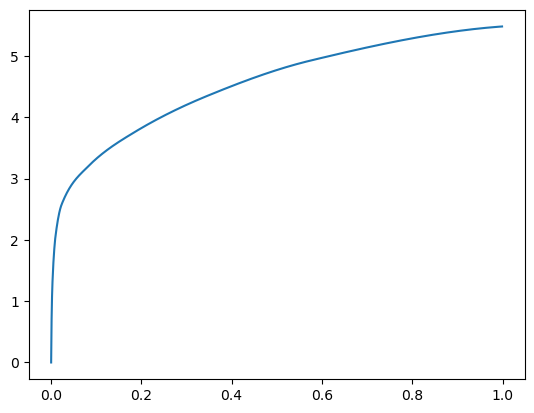

[0.00000000e+00 7.20024109e-04 2.05326080e-03 5.11646271e-03
 1.20573044e-02 3.30114365e-02 9.47561264e-02 2.03085899e-01
 3.57985497e-01 5.79443932e-01 1.00000000e+00] betas
[0.         0.50587173 0.56970205 0.57568147 0.56619298 0.55423086
 0.52897674 0.57395856 0.48360145 0.50464543 0.58881516] r
-22481.378721678564 score post


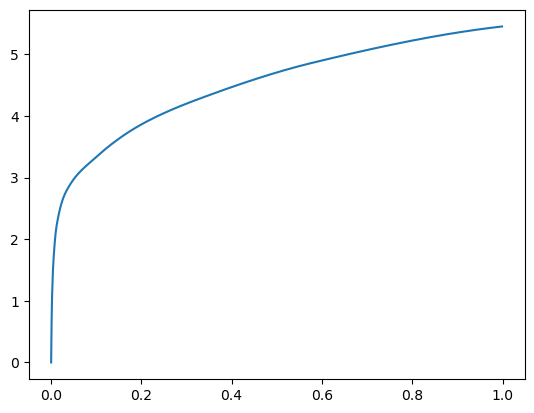

[0.00000000e+00 7.92503357e-04 2.10666656e-03 4.98676300e-03
 1.12886429e-02 3.00130844e-02 9.02490616e-02 1.89003944e-01
 3.59162331e-01 6.04144096e-01 1.00000000e+00] betas
[0.         0.54086228 0.54362853 0.50720571 0.5226426  0.59133636
 0.48547018 0.49086502 0.63194688 0.58342896 0.52977825] r
-22481.378721678564 score post


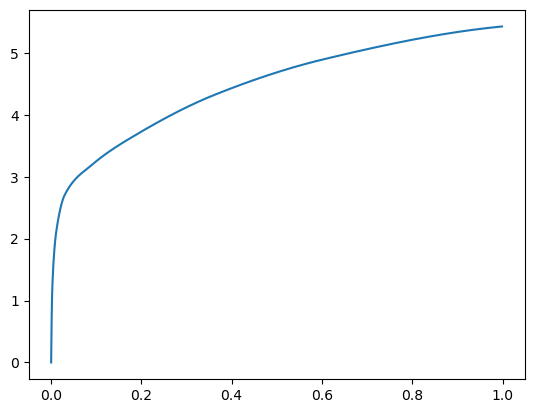

[0.00000000e+00 7.96318054e-04 2.11048126e-03 5.29956818e-03
 1.24597549e-02 3.05681229e-02 1.00989342e-01 2.16633797e-01
 3.68668556e-01 5.96846581e-01 1.00000000e+00] betas
[0.         0.57370816 0.50300583 0.52180238 0.64309283 0.47590023
 0.59396015 0.57222361 0.48661528 0.49895062 0.48623347] r
-22485.350609475372 score post


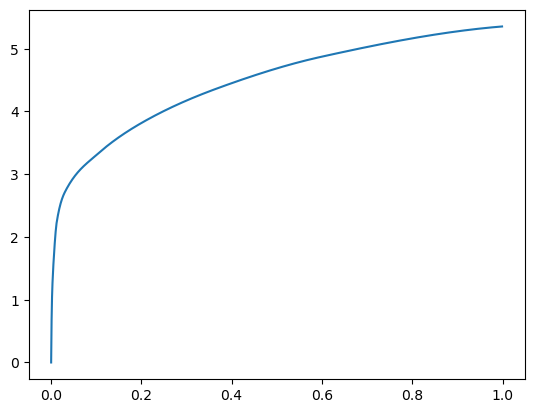

[0.00000000e+00 7.25746155e-04 2.08759308e-03 5.36632538e-03
 1.07412338e-02 2.79569626e-02 8.51259232e-02 1.84004784e-01
 3.37128639e-01 5.67646980e-01 1.00000000e+00] betas
[0.         0.51701004 0.5585264  0.54760895 0.51774966 0.56330307
 0.49995708 0.54012103 0.5574658  0.51974361 0.54257426] r
-22480.269231963164 score post


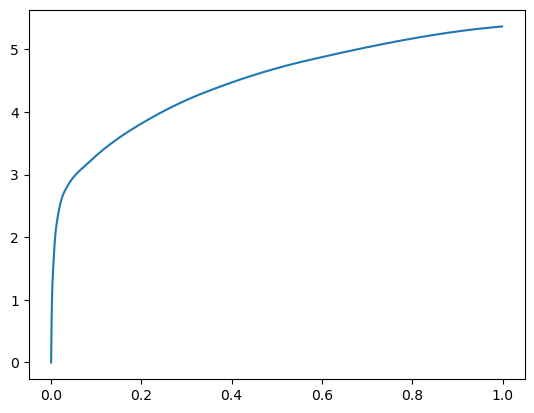

[0.00000000e+00 7.61985779e-04 2.07614899e-03 5.25569916e-03
 1.08289719e-02 2.66141891e-02 8.72163773e-02 1.86394691e-01
 3.33445549e-01 5.71364403e-01 1.00000000e+00] betas
[0.         0.56520576 0.49824595 0.55290173 0.52147589 0.51186327
 0.55584537 0.51070234 0.52662126 0.54764341 0.5929696 ] r
-22480.269231963164 score post


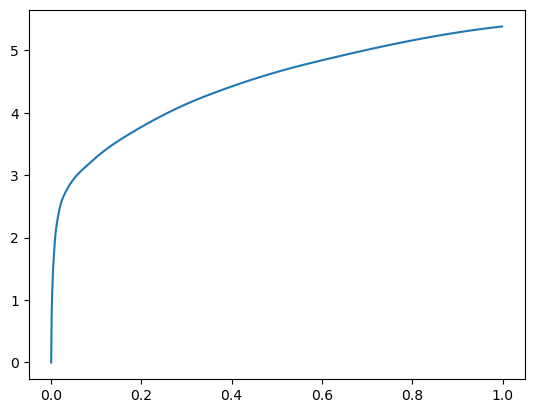

[0.00000000e+00 7.12394714e-04 2.12955475e-03 5.24616241e-03
 1.11303329e-02 2.93169022e-02 9.09013748e-02 1.98765755e-01
 3.56299400e-01 6.02473259e-01 1.00000000e+00] betas
[0.         0.50452076 0.61847618 0.50806568 0.52139539 0.57557802
 0.53398963 0.54422602 0.54793691 0.55993449 0.50566036] r
-22480.269231963164 score post


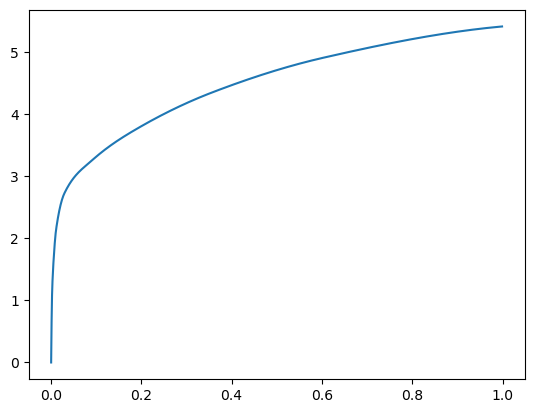

[0.00000000e+00 7.81059265e-04 1.98841095e-03 5.20229340e-03
 1.14374161e-02 2.81858444e-02 8.93354416e-02 1.95794106e-01
 3.49791527e-01 5.81444740e-01 1.00000000e+00] betas
[0.         0.54887223 0.47080313 0.59966769 0.58116866 0.51247775
 0.56391693 0.51336513 0.55248093 0.55807241 0.55458431] r
-22484.348467993714 score post


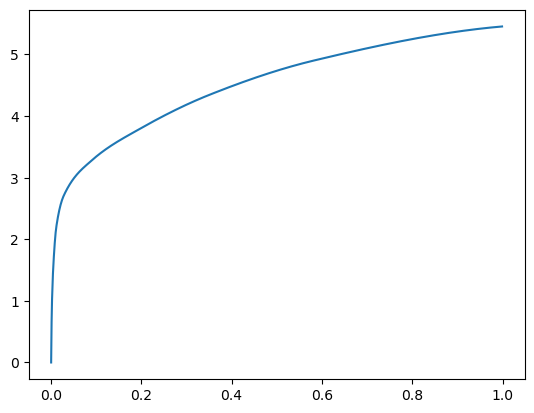

[0.00000000e+00 7.75337219e-04 2.26497650e-03 5.33771515e-03
 1.10902786e-02 2.91280746e-02 8.87727737e-02 2.02696800e-01
 3.57207298e-01 5.86592674e-01 1.00000000e+00] betas
[0.         0.54251142 0.55869138 0.52871809 0.49515992 0.55607852
 0.50861772 0.59957454 0.57691368 0.50160801 0.56151919] r
-22480.269231963164 score post


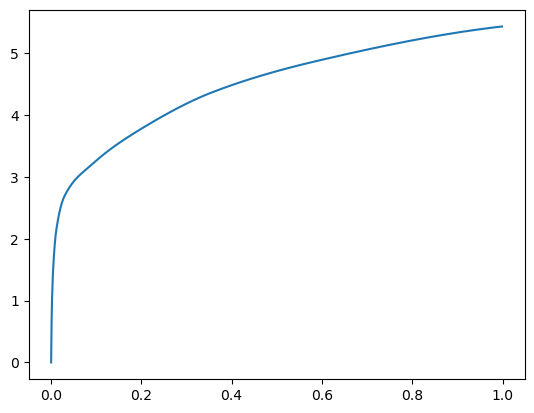

[0.00000000e+00 7.75337219e-04 2.20394135e-03 5.32817841e-03
 1.20573044e-02 3.14493179e-02 9.92155075e-02 2.05248833e-01
 3.49268913e-01 5.97464561e-01 1.00000000e+00] betas
[0.         0.52278707 0.6174392  0.53753478 0.57541562 0.51206793
 0.56095772 0.55107565 0.556529   0.60302775 0.5205069 ] r
-22480.269231963164 score post


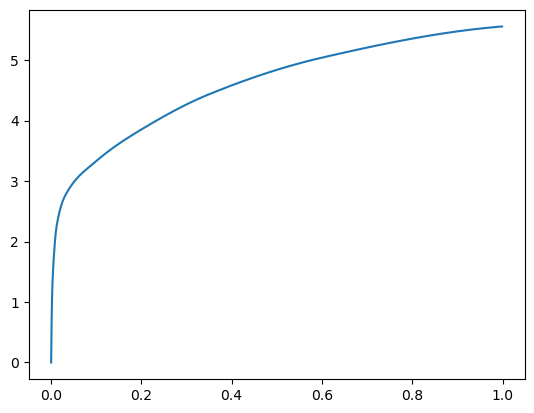

[0.00000000e+00 8.36372375e-04 2.10094452e-03 5.24044037e-03
 1.14355087e-02 3.24201584e-02 1.00481987e-01 2.08132744e-01
 3.53241920e-01 5.77797890e-01 1.00000000e+00] betas
[0.         0.60929986 0.49101426 0.55812491 0.5852116  0.59519334
 0.57038963 0.57099483 0.47659083 0.51162313 0.59149523] r
-22486.71698678069 score post


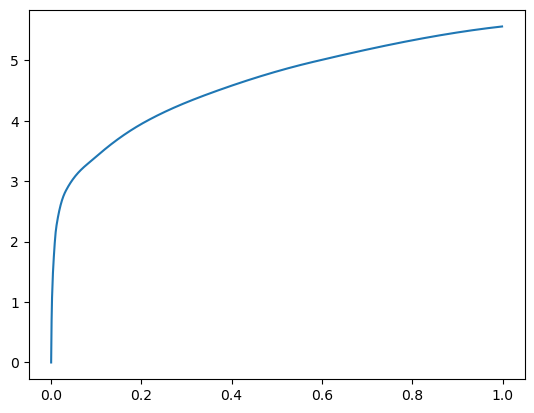

[0.00000000e+00 7.39097595e-04 2.14672089e-03 5.31482697e-03
 1.10559464e-02 2.87237167e-02 8.88929367e-02 1.87682152e-01
 3.49995613e-01 5.97865105e-01 1.00000000e+00] betas
[0.         0.57165026 0.56283103 0.53841887 0.55068275 0.56820407
 0.55408876 0.53724143 0.61863254 0.51802896 0.54415387] r
-22480.269231963164 score post


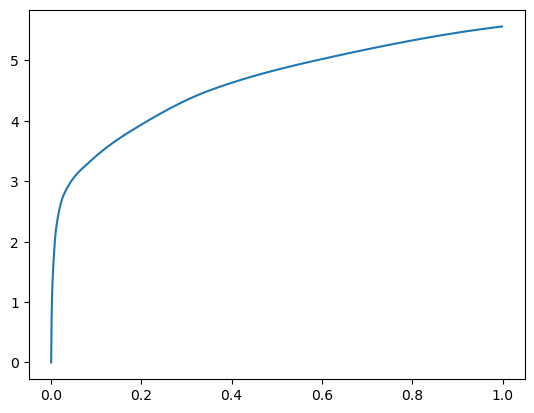

[0.00000000e+00 7.12394714e-04 2.06279755e-03 5.28621674e-03
 1.10940933e-02 2.81229019e-02 8.78114700e-02 1.90245628e-01
 3.32545280e-01 5.90563774e-01 1.00000000e+00] betas
[0.         0.5154426  0.57454718 0.59211471 0.53884873 0.56278951
 0.51136392 0.53665911 0.54290532 0.56273089 0.53267598] r
-22490.397410968886 score post


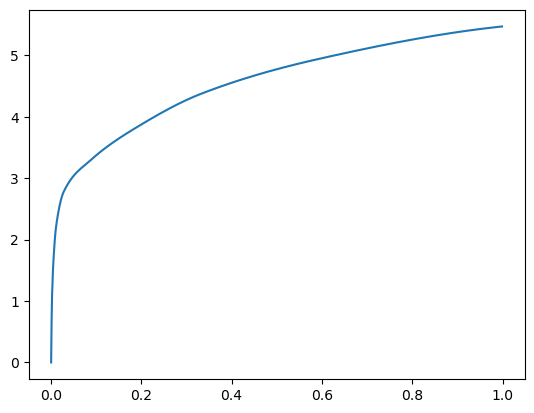

[0.00000000e+00 7.69615173e-04 2.07805634e-03 4.96959686e-03
 1.05199814e-02 2.53934860e-02 8.58182907e-02 1.89637184e-01
 3.33033562e-01 5.82001686e-01 1.00000000e+00] betas
[0.         0.5563641  0.56466005 0.50298966 0.54997752 0.55110109
 0.53103904 0.51717122 0.50784891 0.58215445 0.5706672 ] r
-22481.378721678564 score post


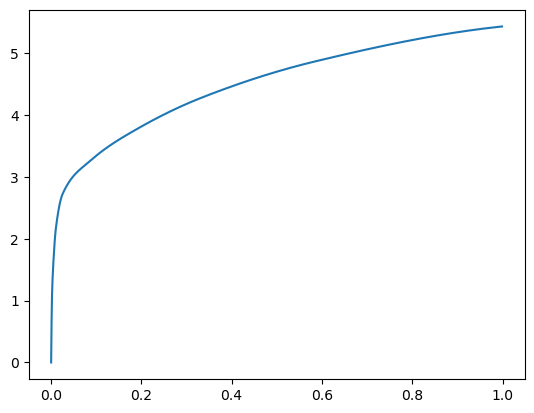

[0.00000000e+00 7.46726990e-04 1.95598602e-03 5.01728058e-03
 1.05123520e-02 2.49128342e-02 8.64725113e-02 1.96988106e-01
 3.56419563e-01 5.97533226e-01 1.00000000e+00] betas
[0.         0.55889279 0.56025872 0.56820651 0.53048121 0.52612447
 0.57355538 0.55628685 0.54811932 0.50104954 0.61508359] r
-22487.42243982761 score post


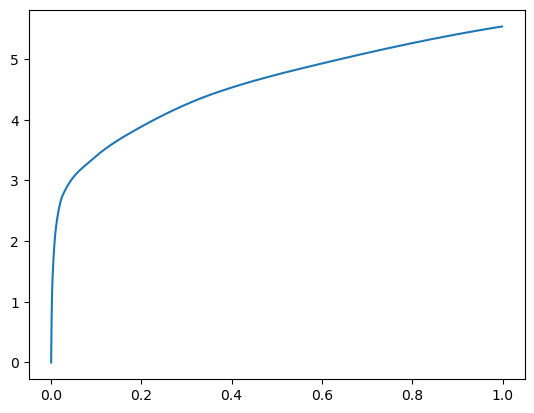

[0.00000000e+00 7.37190247e-04 1.91593170e-03 4.82082367e-03
 1.04665756e-02 2.64215469e-02 8.72640610e-02 1.97674751e-01
 3.59667778e-01 6.32174492e-01 1.00000000e+00] betas
[0.         0.5768326  0.5310126  0.53886515 0.58569289 0.62393473
 0.59652707 0.54962667 0.59380451 0.55448916 0.48416818] r
-22480.269231963164 score post


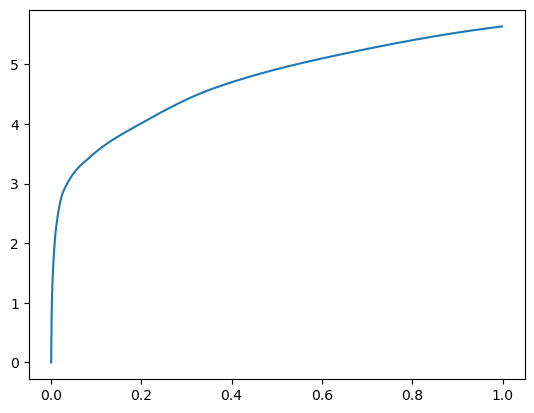

[0.00000000e+00 7.14302063e-04 1.98459625e-03 5.14316559e-03
 1.08213425e-02 2.45008469e-02 7.64112473e-02 1.83955193e-01
 3.29457283e-01 5.84280968e-01 1.00000000e+00] betas
[0.         0.55388619 0.50641175 0.55759122 0.57239687 0.45088662
 0.50202834 0.561438   0.57227276 0.56571445 0.52409477] r
-22480.269231963164 score post


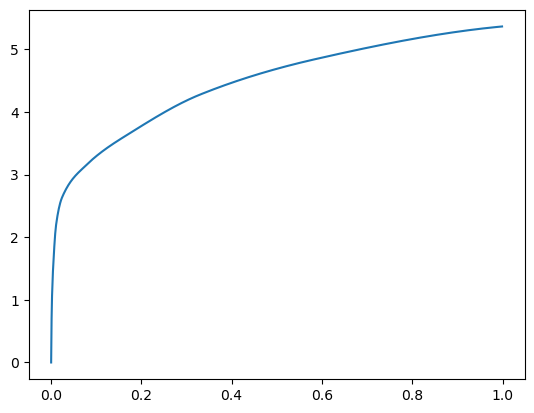

[0.00000000e+00 6.83784485e-04 2.03609467e-03 5.08403778e-03
 1.01079941e-02 2.71100998e-02 8.78305435e-02 1.95515633e-01
 3.35146904e-01 5.76695442e-01 1.00000000e+00] betas
[0.         0.51330252 0.5940442  0.55164048 0.5246455  0.56885637
 0.52450253 0.57364781 0.51656559 0.56848427 0.49633676] r
-22484.4517533122 score post


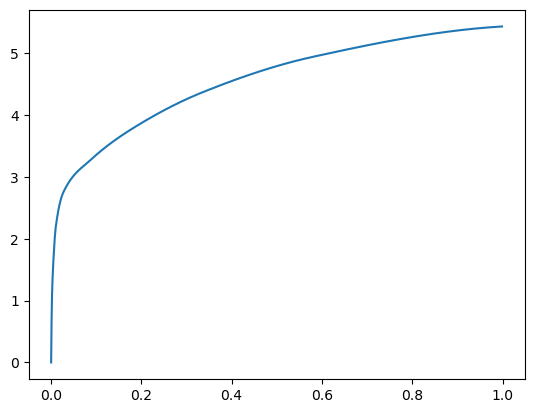

[0.00000000e+00 7.37190247e-04 1.96170807e-03 4.86850739e-03
 9.92298126e-03 2.49891281e-02 8.51430893e-02 1.84679985e-01
 3.27898979e-01 5.49351692e-01 1.00000000e+00] betas
[0.         0.55588146 0.50162978 0.52865139 0.52421344 0.5089728
 0.55966878 0.51200753 0.52959339 0.5695005  0.60624591] r
-22483.17300509828 score post


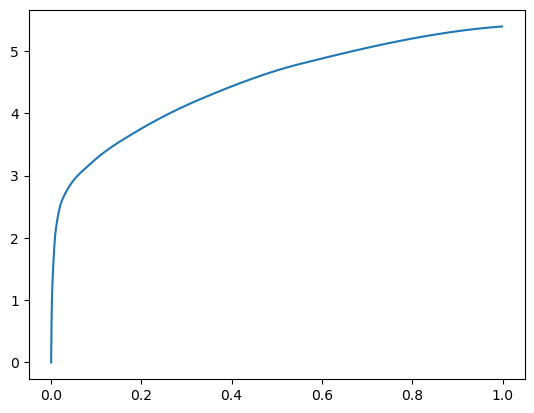

[0.00000000e+00 7.08580017e-04 2.04372406e-03 5.11264801e-03
 1.08137131e-02 3.00779343e-02 9.40942764e-02 2.05014229e-01
 3.59734535e-01 5.86007118e-01 1.00000000e+00] betas
[0.         0.51095779 0.57545264 0.49919328 0.53101248 0.57044492
 0.53744881 0.56122465 0.52590712 0.5552357  0.55567354] r
-22480.269231963164 score post


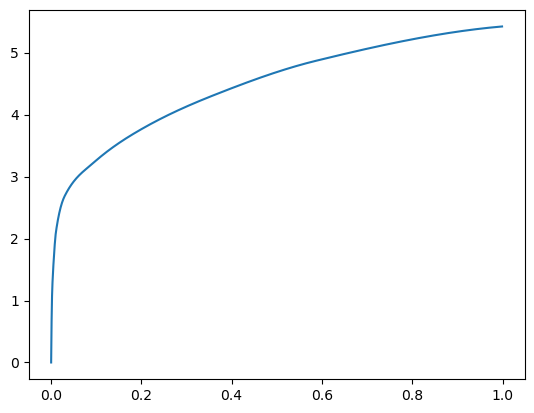

[0.00000000e+00 7.65800476e-04 2.03609467e-03 5.45406342e-03
 1.19009018e-02 3.17754745e-02 9.86413956e-02 2.07467079e-01
 3.68927956e-01 5.93531609e-01 1.00000000e+00] betas
[0.         0.6167409  0.53890415 0.58124705 0.56865494 0.59726796
 0.51595931 0.51174129 0.56613795 0.50750992 0.50699921] r
-22480.269231963164 score post


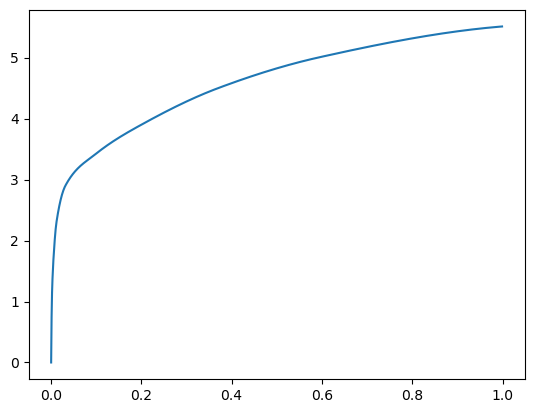

[0.00000000e+00 6.58988953e-04 1.84917450e-03 4.77886200e-03
 1.02300644e-02 2.41765976e-02 7.85856247e-02 1.89639091e-01
 3.39104652e-01 5.68039894e-01 1.00000000e+00] betas
[0.         0.45312046 0.55876387 0.5805126  0.55387257 0.50698178
 0.47919631 0.65121074 0.48797164 0.58971283 0.54750218] r
-22485.11013607975 score post


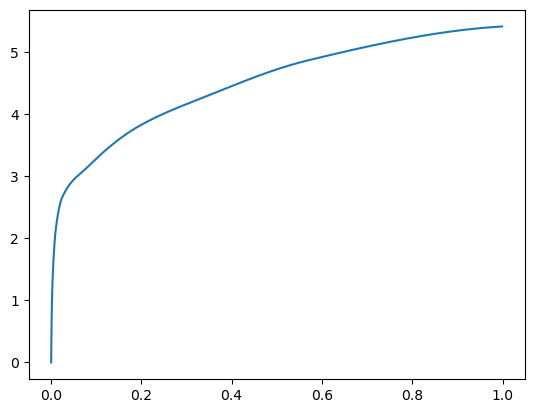

[0.00000000e+00 8.15391541e-04 2.09522247e-03 4.99820709e-03
 1.05333328e-02 2.75125504e-02 9.46054459e-02 1.90236092e-01
 3.58134270e-01 5.71801186e-01 1.00000000e+00] betas
[0.         0.63977562 0.5414851  0.54916132 0.53227077 0.5716023
 0.61565973 0.54308958 0.59562006 0.53827378 0.58091235] r
-22480.269231963164 score post


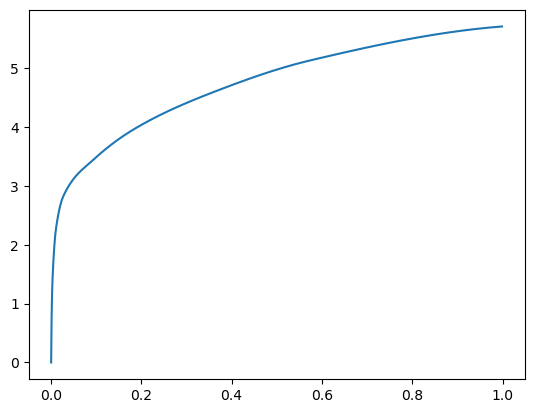

[0.00000000e+00 7.00950623e-04 1.95980072e-03 4.86278534e-03
 1.09128952e-02 2.87351608e-02 9.09833908e-02 1.90785408e-01
 3.50617409e-01 5.77359200e-01 1.00000000e+00] betas
[0.         0.55786213 0.55466712 0.51627362 0.60851843 0.54972024
 0.52685443 0.50330789 0.57434493 0.5412602  0.59461571] r
-22480.269231963164 score post


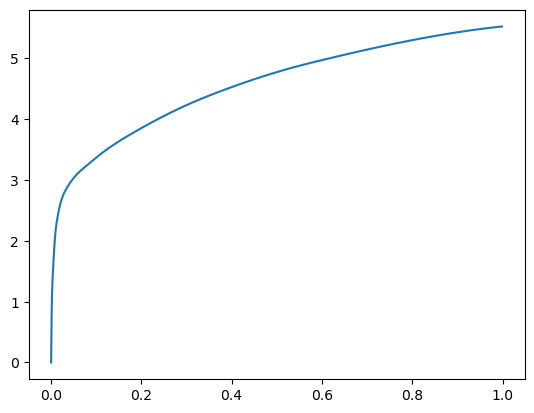

[0.00000000e+00 6.91413879e-04 1.93309784e-03 5.08594513e-03
 1.04475021e-02 2.72588730e-02 9.13801193e-02 2.03156471e-01
 3.61166954e-01 6.00533485e-01 1.00000000e+00] betas
[0.         0.54690609 0.57111886 0.57221996 0.51431539 0.56498983
 0.59191549 0.57183167 0.55882529 0.55360999 0.56173735] r
-22481.378721678564 score post


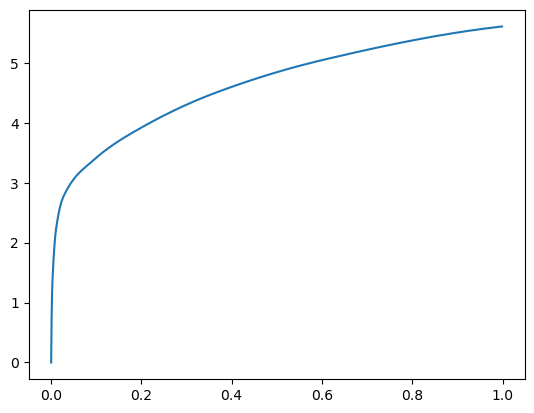

[0.00000000e+00 7.14302063e-04 1.94644928e-03 5.02490997e-03
 1.11684799e-02 2.94084549e-02 9.18264389e-02 2.01249123e-01
 3.59007835e-01 6.01088524e-01 1.00000000e+00] betas
[0.         0.50008953 0.56681907 0.56127795 0.61297736 0.54878428
 0.55398778 0.56094031 0.55159547 0.52053867 0.54375323] r
-22484.25291812412 score post


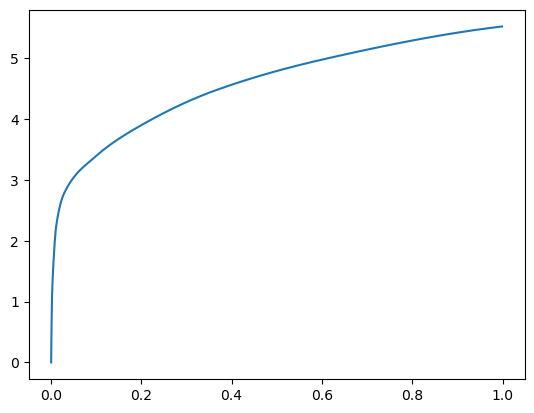

[0.00000000e+00 8.05854797e-04 2.08377838e-03 5.23662567e-03
 1.05886459e-02 2.75812149e-02 8.70122910e-02 1.91727638e-01
 3.44702721e-01 5.96211433e-01 1.00000000e+00] betas
[0.         0.60878359 0.55596561 0.5878719  0.53276474 0.51806564
 0.50019488 0.59432189 0.56070006 0.52836601 0.52055416] r
-22485.36256805768 score post


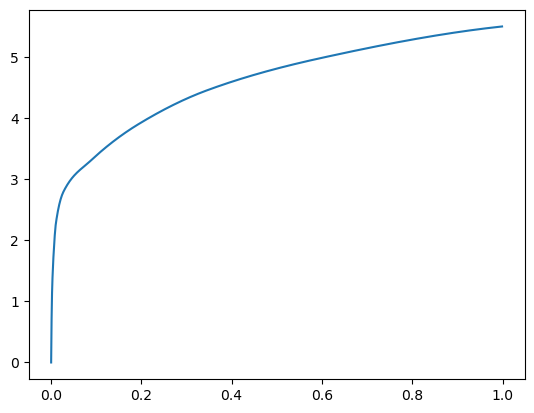

530062 steps_after


In [53]:
import dill
file_name = 'test_pt200k.dil'
g = globals()

with open(file_name,'rb') as file:
    list_of_variable_names = dill.load(file)  # Get the names of stored objects
    for variable_name in list_of_variable_names:
        g[variable_name] = dill.load(file)    # Get the objects themselves

#pt_noRev0=pt_structure_mcmc(8, 3, 200000, cache, 1000, 50, 0,1001)
#pt_noRev1=pt_structure_mcmc(8, 3, 200000, cache, 1000, 50, 0,2001)
#pt_noRev2=pt_structure_mcmc(8, 3, 200000, cache, 1000, 50, 0,3001)
#pt_noRev3=pt_structure_mcmc(8, 3, 200000, cache, 1000, 50, 0,4001)
#pt_noRev4=pt_structure_mcmc(8, 3, 200000, cache, 1000, 50, 0,5001)

nopt_1Rev0=structure_mcmc(8, 3, 200000,cache,1,1001)
nopt_1Rev1=structure_mcmc(8, 3, 200000,cache,1,2001)
nopt_1Rev2=structure_mcmc(8, 3, 200000,cache,1,3001)
nopt_1Rev3=structure_mcmc(8, 3, 200000,cache,1,4001)
nopt_1Rev4=structure_mcmc(8, 3, 200000,cache,1,5001)

nopt_01Rev0=structure_mcmc(8, 3, 200000,cache,.1,1001)
nopt_01Rev1=structure_mcmc(8, 3, 200000,cache,.1,2001)
nopt_01Rev2=structure_mcmc(8, 3, 200000,cache,.1,3001)
nopt_01Rev3=structure_mcmc(8, 3, 200000,cache,.1,4001)
nopt_01Rev4=structure_mcmc(8, 3, 200000,cache,.1,5001)

#pt_01Rev0=pt_structure_mcmc(8, 3, 200000, cache, 1000, 50, 0.1,1001)
#pt_01Rev1=pt_structure_mcmc(8, 3, 200000, cache, 1000, 50, 0.1,2001)
#pt_01Rev2=pt_structure_mcmc(8, 3, 200000, cache, 1000, 50, 0.1,3001)
#pt_01Rev3=pt_structure_mcmc(8, 3, 200000, cache, 1000, 50, 0.1,4001)
#pt_01Rev4=pt_structure_mcmc(8, 3, 200000, cache, 1000, 50, 0.1,5001)
#
#pt_005Rev0=pt_structure_mcmc(8, 3, 200000, cache, 1000, 50, 0.05,1001)
#pt_005Rev1=pt_structure_mcmc(8, 3, 200000, cache, 1000, 50, 0.05,2001)
#pt_005Rev2=pt_structure_mcmc(8, 3, 200000, cache, 1000, 50, 0.05,3001)
#pt_005Rev3=pt_structure_mcmc(8, 3, 200000, cache, 1000, 50, 0.05,4001)
#pt_005Rev4=pt_structure_mcmc(8, 3, 200000, cache, 1000, 50, 0.05,5001)


import numpy as np
#a = 6
b = 3.5
#c = np.linspace(2,5,11)

""" Test the dump part """

import dill
file_name = 'test_pt200k.dil'
list_of_variable_names = ('pt_noRev0', 'pt_noRev1', 'pt_noRev2','pt_noRev3','pt_noRev4',
                         'pt_01Rev0', 'pt_01Rev1', 'pt_01Rev2','pt_01Rev3','pt_01Rev4',
                         'nopt_01Rev0', 'nopt_01Rev1', 'nopt_01Rev2','nopt_01Rev3','nopt_01Rev4',
                         'nopt_1Rev0', 'nopt_1Rev1', 'nopt_1Rev2','nopt_1Rev3','nopt_1Rev4',
                         'pt_005Rev0', 'pt_005Rev1', 'pt_005Rev2','pt_005Rev3','pt_005Rev4')

with open(file_name,'wb') as file:
    dill.dump(list_of_variable_names, file)  # Store all the names first
    for variable_name in list_of_variable_names:
        dill.dump(eval(variable_name), file) # Store the objects themselves
        

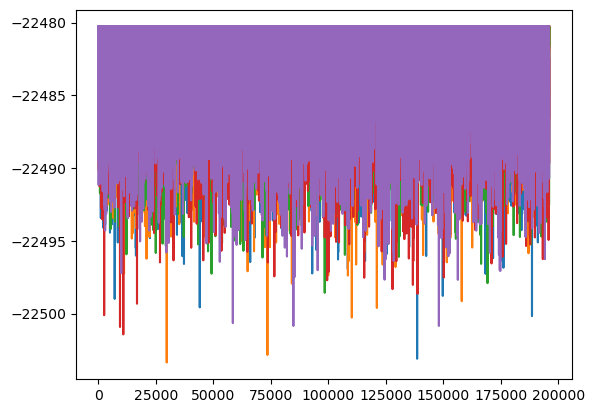

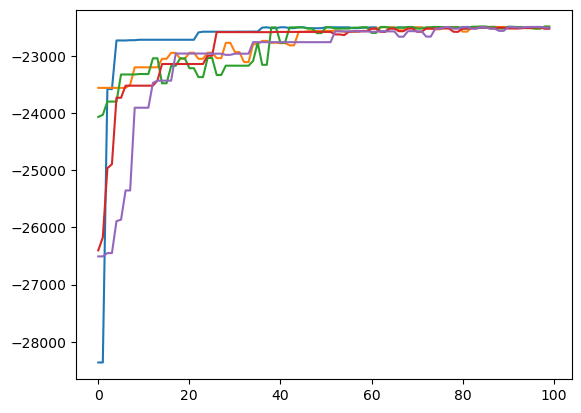

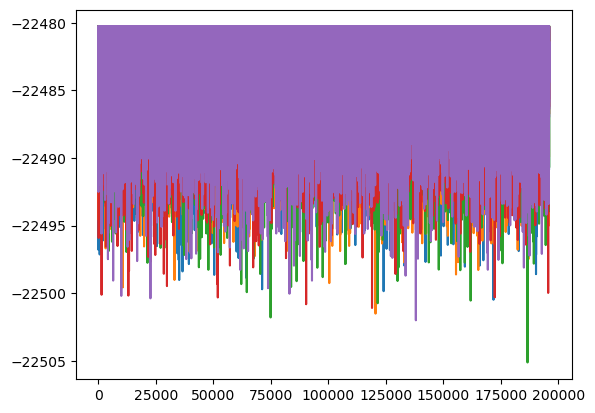

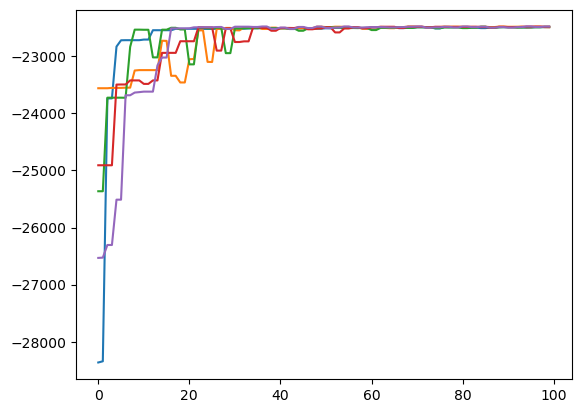

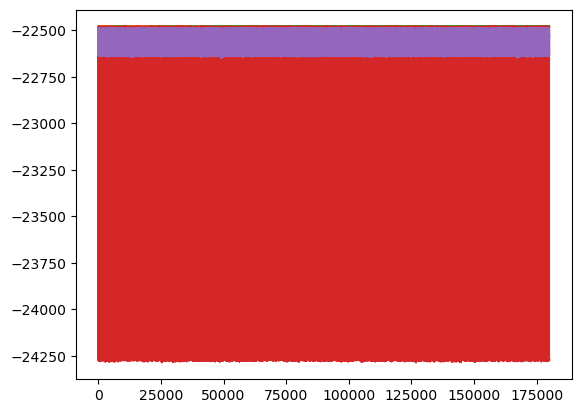

...

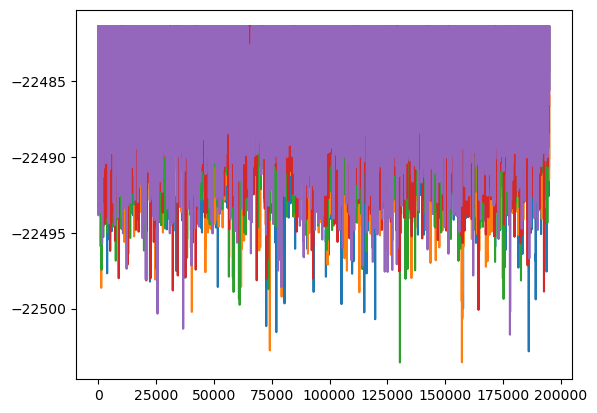

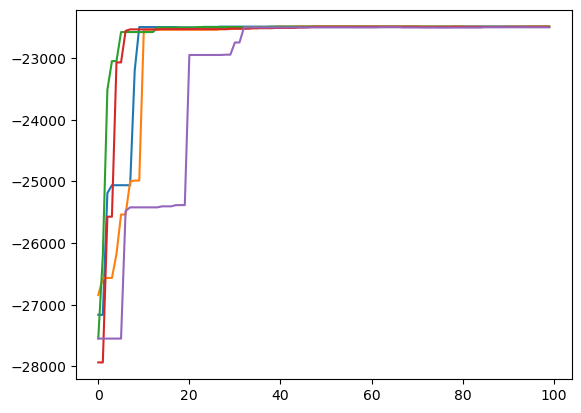

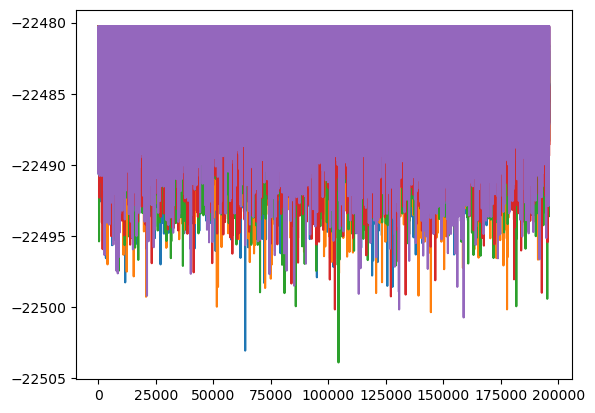

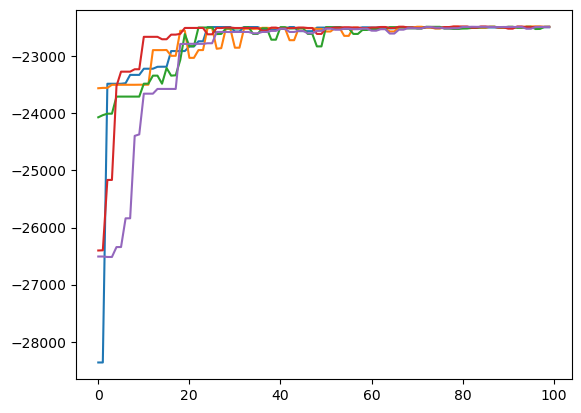

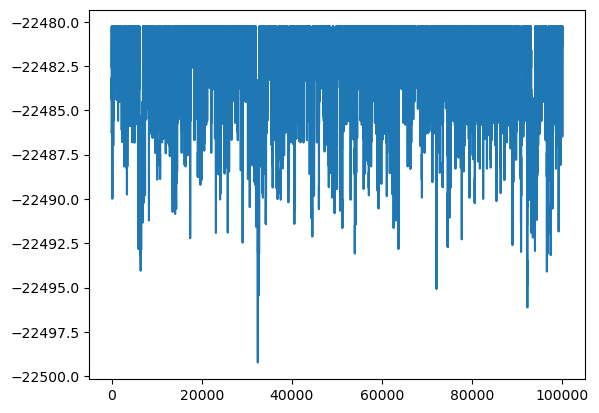

In [74]:
test=[pt_noRev0, pt_noRev1, pt_noRev2,pt_noRev3,pt_noRev4,
                         pt_01Rev0, pt_01Rev1, pt_01Rev2,pt_01Rev3,pt_01Rev4,
                         nopt_01Rev0, nopt_01Rev1, nopt_01Rev2,nopt_01Rev3,nopt_01Rev4,
                         nopt_1Rev0, nopt_1Rev1, nopt_1Rev2,nopt_1Rev3,nopt_1Rev4,
     pt_005Rev0, pt_005Rev1, pt_005Rev2,pt_005Rev3,pt_005Rev4]

for i in range (5):
    plt.plot(test[i][0][5000:])
plt.show()
for i in range (5):
    plt.plot(test[i][0][0:100])
plt.show()    
for i in range (5,10):
    plt.plot(test[i][0][5000:])
plt.show()
for i in range (5,10):
    plt.plot(test[i][0][0:100])
plt.show()
for i in range (10,15):
    plt.plot(test[i][2][20000:])
plt.show()
for i in range (10,15):
    plt.plot(test[i][2][0:100])
plt.show()    
for i in range (15,20):
    plt.plot(test[i][2][5000:])
plt.show()
for i in range (15,20):
    plt.plot(test[i][2][0:100])
plt.show()
for i in range (20,25):
    plt.plot(test[i][0][5000:])
plt.show()
for i in range (20,25):
    plt.plot(test[i][0][0:100])
plt.show()

plt.plot(test[11][2][100000:])

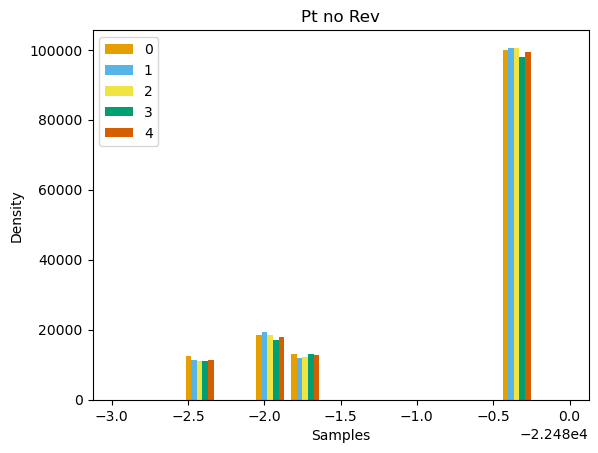

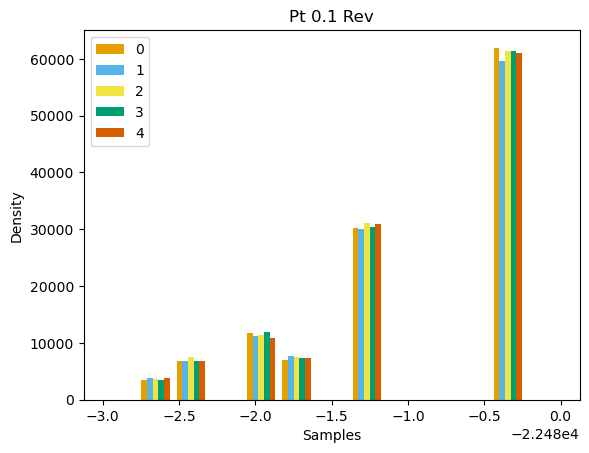

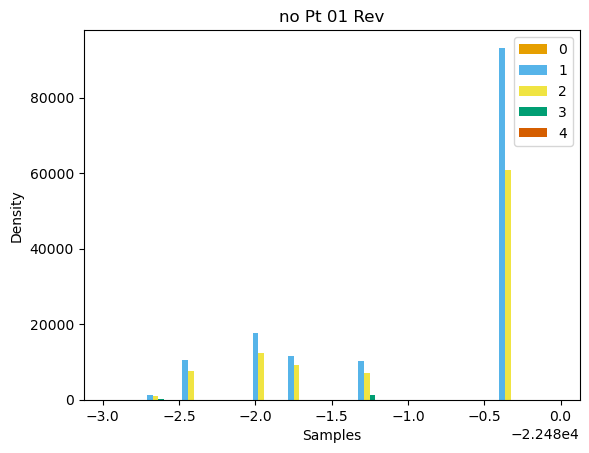

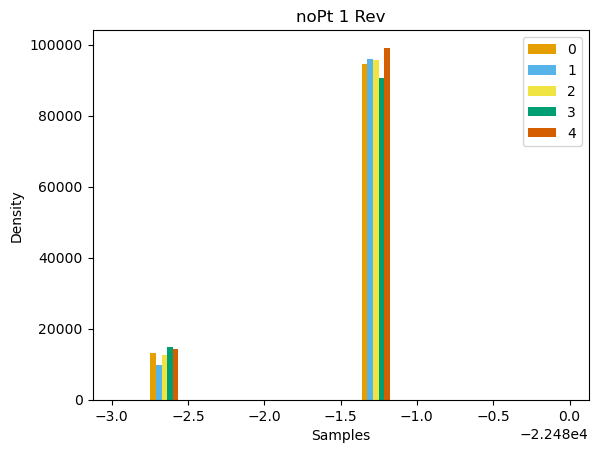

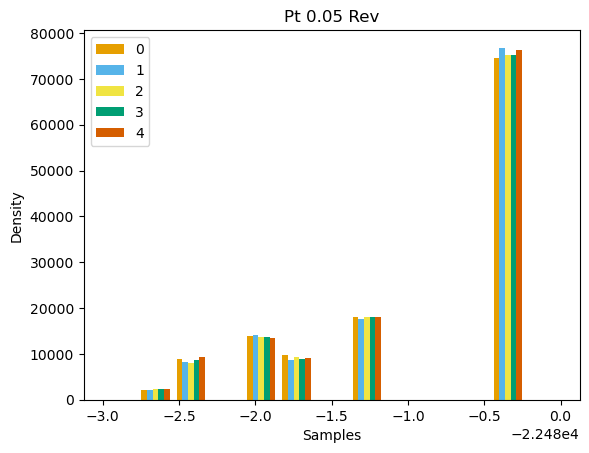

In [57]:
# Make a separate list for each airline
x1 = test[0][0][5000:]
x2 = test[1][0][5000:]
x3 = test[2][0][5000:]
x4 = test[3][0][5000:]
x5 = test[4][0][5000:]

# Assign colors for each airline and the names
colors = ['#E69F00', '#56B4E9', '#F0E442', '#009E73', '#D55E00']
names = ['0', '1', '2',
         '3', '4']
         
# Make the histogram using a list of lists
# Normalize the flights and assign colors and names
plt.hist([x1, x2, x3, x4, x5],range=[-22483, -22480], bins = int(200/15), 
         color = colors, label=names)

# Plot formatting
plt.legend()
plt.xlabel('Samples')
plt.ylabel('Density')
plt.title('Pt no Rev')
plt.show()

# Make a separate list for each airline
x1 = test[5][0][5000:]
x2 = test[6][0][5000:]
x3 = test[7][0][5000:]
x4 = test[8][0][5000:]
x5 = test[9][0][5000:]

# Assign colors for each airline and the names
colors = ['#E69F00', '#56B4E9', '#F0E442', '#009E73', '#D55E00']
names = ['0', '1', '2',
         '3', '4']
         
# Make the histogram using a list of lists
# Normalize the flights and assign colors and names
plt.hist([x1, x2, x3, x4, x5], range=[-22483, -22480], bins = int(200/15), 
         color = colors, label=names)

# Plot formatting
plt.legend()
plt.xlabel('Samples')
plt.ylabel('Density')
plt.title('Pt 0.1 Rev')
plt.show()


# Make a separate list for each airline
x1 = test[10][2][5000:]
x2 = test[11][2][5000:]
x3 = test[12][2][5000:]
x4 = test[13][2][5000:]
x5 = test[14][2][5000:]

# Assign colors for each airline and the names
colors = ['#E69F00', '#56B4E9', '#F0E442', '#009E73', '#D55E00']
names = ['0', '1', '2',
         '3', '4']
         
# Make the histogram using a list of lists
# Normalize the flights and assign colors and names
plt.hist([x1, x2, x3, x4, x5],range=[-22483, -22480], bins = int(200/15), 
         color = colors, label=names)

# Plot formatting
plt.legend()
plt.xlabel('Samples')
plt.ylabel('Density')
plt.title('no Pt 01 Rev')
plt.show()

# Make a separate list for each airline
x1 = test[15][2][5000:]
x2 = test[16][2][5000:]
x3 = test[17][2][5000:]
x4 = test[18][2][5000:]
x5 = test[19][2][5000:]

# Assign colors for each airline and the names
colors = ['#E69F00', '#56B4E9', '#F0E442', '#009E73', '#D55E00']
names = ['0', '1', '2',
         '3', '4']
         
# Make the histogram using a list of lists
# Normalize the flights and assign colors and names
plt.hist([x1, x2, x3, x4, x5], range=[-22483, -22480], bins = int(200/15), 
         color = colors, label=names)

# Plot formatting
plt.legend()
plt.xlabel('Samples')
plt.ylabel('Density')
plt.title('noPt 1 Rev')
plt.show()

# Make a separate list for each airline
x1 = test[20][2][5000:]
x2 = test[21][2][5000:]
x3 = test[22][2][5000:]
x4 = test[23][2][5000:]
x5 = test[24][2][5000:]

# Assign colors for each airline and the names
colors = ['#E69F00', '#56B4E9', '#F0E442', '#009E73', '#D55E00']
names = ['0', '1', '2',
         '3', '4']
         
# Make the histogram using a list of lists
# Normalize the flights and assign colors and names
plt.hist([x1, x2, x3, x4, x5], range=[-22483, -22480], bins = int(200/15), 
         color = colors, label=names)

# Plot formatting
plt.legend()
plt.xlabel('Samples')
plt.ylabel('Density')
plt.title('Pt 0.05 Rev')
plt.show()



In [73]:
def dag_mean (x,start=0):
    dim=(len(x[1][:,0,0]))
    dag=np.zeros((len(x[1][:,0,0]),len(x[1][:,0,0])))
    t=int(len(x[2])-1)
    #print(t)
    for i in range(start,t):
        #print(i)
        dag += x[1][:,:,i]
    return dag/(len(x[2])-start) 


def score(dag):
    prior=1
    loglik=0

    for i in range(n_variables):
        prior= prior*(1/math.comb((n_variables-1),int(np.sum(dag[:,i]))))
        loglik+= cache[i][tuple(np.where(dag[:,i]==1)[0])]
    return loglik+ np.log(prior)

mdags=np.zeros((8,8,25))

for i in range(len(test)):
    mdags[:,:,i]=dag_mean(test[i],15000)

mdags_pt_noRev=np.zeros((8,8))
for i in range(5):
    mdags_pt_noRev+=mdags[:,:,i]
mdags_pt_noRev=mdags_pt_noRev/5
diff=0
for i in range(5):
    diff+=np.sum(np.abs(mdags[:,:,i]-mdags_pt_noRev))
print(diff,'pt no rev')

mdags_pt_01Rev=np.zeros((8,8))
for i in range(5,10):
    mdags_pt_01Rev+=mdags[:,:,i]
mdags_pt_01Rev=mdags_pt_01Rev/5
diff=0
for i in range(5,10):
    diff+=np.sum(np.abs(mdags[:,:,i]-mdags_pt_01Rev))
print(diff,'pt 0.1 rev')

mdags_nopt_01Rev=np.zeros((8,8))
for i in range(10,15):
    mdags_nopt_01Rev+=mdags[:,:,i]
mdags_nopt_01Rev=mdags_nopt_01Rev/5
diff=0
for i in range(10,15):
    diff+=np.sum(np.abs(mdags[:,:,i]-mdags_nopt_01Rev))
print(diff,'no pt 0.1 rev')

mdags_nopt_1Rev=np.zeros((8,8))
for i in range(15,20):
    mdags_nopt_1Rev+=mdags[:,:,i]
mdags_nopt_1Rev=mdags_nopt_1Rev/5
diff=0
for i in range(15,20):
    diff+=np.sum(np.abs(mdags[:,:,i]-mdags_nopt_1Rev))
print(diff,'no pt 1 rev')


mdags_nopt_1Rev=np.zeros((8,8))
for i in range(20,25):
    mdags_nopt_1Rev+=mdags[:,:,i]
mdags_nopt_1Rev=mdags_nopt_1Rev/5
diff=0
for i in range(20,25):
    diff+=np.sum(np.abs(mdags[:,:,i]-mdags_nopt_1Rev))
print(diff,'pt 0.05 rev')




0.3233686486486488 pt no rev
0.3227156756756759 pt 0.1 rev
35.076322162162164 no pt 0.1 rev
0.5872302702702704 no pt 1 rev
0.40167135135135146 pt 0.05 rev


In [23]:
import arviz as az

chains=np.zeros((2,10000))
chains[0,:]=a[1]
chains[1,:]=c[1]
chains=chains[:,2000:10000]
print(np.shape(chains))
print(az.summary(chains))
rhat=az.rhat(chains)
rhat

(2, 8000)
        mean   sd     hdi_3%   hdi_97%  mcse_mean  mcse_sd  ess_bulk  \
x -22501.741  6.1 -22513.497 -22491.36      0.708    0.503      77.0   

   ess_tail  r_hat  
x     145.0   1.03  


1.0313432049480278

In [54]:
import numpy as np
#a = 6
b = 3.5
#c = np.linspace(2,5,11)

""" Test the dump part """

import dill
file_name = 'dill_dump_test_file.dil'
list_of_variable_names = ('a', 'b', 'c')

with open(file_name,'wb') as file:
    dill.dump(list_of_variable_names, file)  # Store all the names first
    for variable_name in list_of_variable_names:
        dill.dump(eval(variable_name), file) # Store the objects themselves
        
#   Clear all the variables here     


In [ ]:
import dill
file_name = 'dill_dump_test_file.dil'
g = globals()

with open(file_name,'rb') as file:
    list_of_variable_names = dill.load(file)  # Get the names of stored objects
    for variable_name in list_of_variable_names:
        g[variable_name] = dill.load(file)    # Get the objects themselves